# Compare PCA Models
This notebook will generate a figure and datafile of all correlated components across fish and stimulus groups

In [1]:
# list of stimuli by fish
# list of matching fish-stimulus pairs
# figure showing correlation of components by fish-stimulus

In [2]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pickle
import scipy.stats as stats

In [3]:
n_components = 10
data_dir = '../data/'
input_data_dir = data_dir + 'pca_models_pickled/'
meta_data_dir = data_dir + 'data_meta_pickled/'
output_data_dir = data_dir + 'results/'

In [4]:
def load_all_files():
    file_path_list = list(
        filter(
            lambda path: '_PCA_model_num_comp_'+ str(n_components) + '_transformed.pickle' in path if True else False,
            os.listdir(path = input_data_dir)
    ))
    component_geography_dict = open_file(meta_data_dir + 'component_geographical_dist_dict.pickle')
    ret_dict = {
        "file_name": [],
        "path": []
    }
    for path in file_path_list:
        file_name = path.split('_PCA_model')[0]
        ret_dict["file_name"].append(file_name)
        ret_dict["path"].append(path)
    return pd.DataFrame(ret_dict), component_geography_dict

In [5]:
def open_file(file_path):
    with open(file_path, "rb") as input_file:
        return pickle.load(input_file)

In [6]:
def pickle_file(file, n_components):
    with open(output_data_dir + 'component_correlation_df_num_comp_' + str(n_components) + '.pickle', 'wb') as pickle_file:
        pickle.dump(file, pickle_file, protocol=pickle.HIGHEST_PROTOCOL)

In [7]:
def load_file_data(file_path_list):
    ret_list = []
    for path in file_path_list:
        ret_list.append(open_file(path))
    return np.reshape(ret_list, (-1, 1))

In [8]:
def fetch_component(comp_index_name, file_df):
    ret_array = comp_index_name.split('_component_')
    old_index, comp_num = ret_array[0], ret_array[1]
    component = file_df.loc[old_index].at['file_data'][:,int(comp_num)]
    return component

In [9]:
def scale_component_functions(comp_1, comp_2):
    if comp_1.size == comp_2.size:
        return comp_1, comp_2
    elif comp_1.size > comp_2.size:
        return scale_component_functions(comp_2, comp_1)
    while comp_1.size < comp_2.size:
        comp_1 = np.concatenate((comp_1, comp_1), axis=None)
    comp_1 = comp_1[0:comp_2.size]
    return comp_1, comp_2

In [10]:
def transform_stim_period_strings(name):
    if '_stim_period_' in name:
        split = name.split('_stim_period_')
        return split[0] + split[1][split[1].find('_'):]
    else:
        return name

In [11]:
def correlate_component_geographies(comp_1, comp_2):
    return comp_1.combine(comp_2, np.minimum).sum().sum()

In [12]:
def correlate_two_components(comp_1, comp_2, col, row, comp_1_geo, comp_2_geo):
    comp_1, comp_2 = scale_component_functions(comp_1, comp_2)
    geo_corr = correlate_component_geographies(comp_1_geo, comp_2_geo)
    corr = stats.spearmanr(comp_1, comp_2)
    if np.abs(corr.correlation) > .75:
        print(col, ' ', row, ' ', corr, ' ', geo_corr)
        plt.scatter(comp_1, comp_2)
        plt.show()
    return (corr.correlation, geo_corr)

In [13]:
def correlate_all_models(file_df, component_geography_dict):
    original_index = file_df.index
    new_index = []
    for index in original_index:
        new_index = new_index + list(map(lambda num: index + '_component_' + str(num), range(0,10)))
    analysis_df = pd.DataFrame(np.full((len(new_index), len(new_index)), {}), index=new_index, columns=new_index)
    for col in analysis_df.columns:
        comp_1 = fetch_component(col, file_df)
        for row in analysis_df.index:
            if col == row:
                break;
            else:
                
                comp_2 = fetch_component(row, file_df)
                analysis_df.at[row, col] = correlate_two_components(
                    comp_1,
                    comp_2,
                    col,
                    row,
                    component_geography_dict[transform_stim_period_strings(col)],
                    component_geography_dict[transform_stim_period_strings(row)]
                )
    return analysis_df

subject_10_stimulus_11_component_0   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=0.7655488749767557, pvalue=1.237236204815639e-43)   12.273248233115059


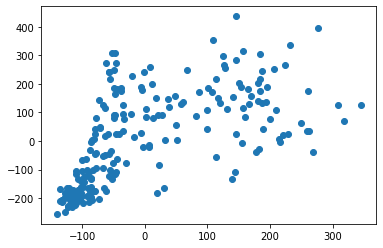

subject_10_stimulus_12_component_0   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=0.8176081774792492, pvalue=3.57938758661198e-54)   5.612652990902709


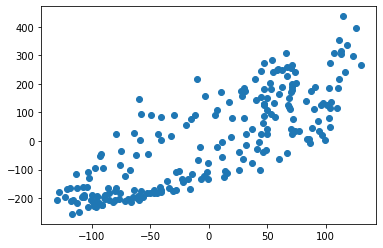

subject_10_stimulus_12_component_1   subject_10_stimulus_10_component_1   SpearmanrResult(correlation=-0.8655325335422032, pvalue=2.1431729594765032e-67)   2.4781055235624283


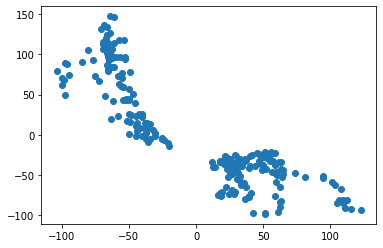

subject_10_stimulus_12_component_4   subject_10_stimulus_10_component_4   SpearmanrResult(correlation=-0.7604402044369811, pvalue=9.51828611178616e-43)   4.9381027694614525


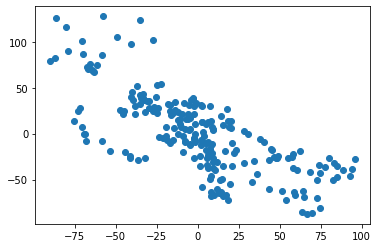

subject_10_stimulus_12_component_4   subject_10_stimulus_11_component_4   SpearmanrResult(correlation=0.7676439595859418, pvalue=5.278415108614688e-44)   4.10277336810344


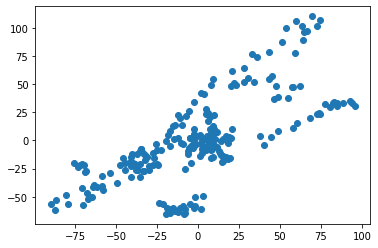

subject_10_stimulus_12_component_9   subject_10_stimulus_11_component_8   SpearmanrResult(correlation=0.7763240788220643, pvalue=1.4037684928027932e-45)   6.051621877668204


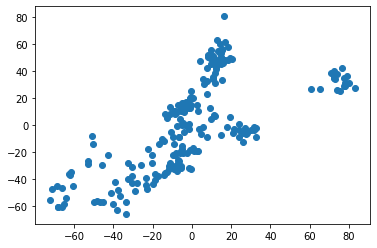

subject_10_stimulus_15_component_0   subject_10_stimulus_14_component_0   SpearmanrResult(correlation=0.8908067542213884, pvalue=1.3760702628687601e-14)   1.6203312156036378


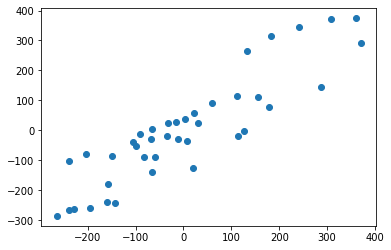

subject_10_stimulus_15_component_1   subject_10_stimulus_14_component_1   SpearmanrResult(correlation=0.851969981238274, pvalue=3.136498186033501e-12)   7.154106749939346


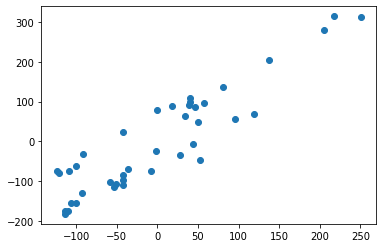

subject_10_stimulus_15_component_6   subject_10_stimulus_14_component_5   SpearmanrResult(correlation=-0.8433395872420263, pvalue=8.503724696118514e-12)   5.942555731845582


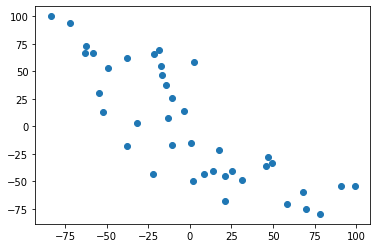

subject_10_stimulus_15_component_7   subject_10_stimulus_14_component_6   SpearmanrResult(correlation=0.7607879924953096, pvalue=1.2180122261694741e-08)   6.076354293764468


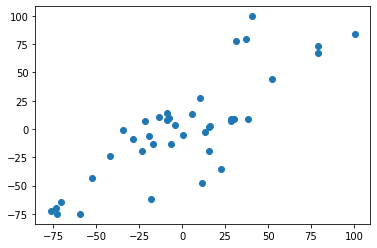

subject_10_stimulus_22_component_4   subject_10_stimulus_21_component_5   SpearmanrResult(correlation=0.7848828836837193, pvalue=1.434007828634005e-32)   8.911697967980375


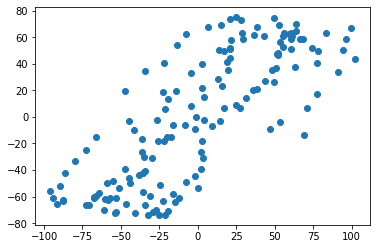

subject_10_stimulus_22_component_5   subject_10_stimulus_21_component_4   SpearmanrResult(correlation=-0.8060144895328681, pvalue=1.5866591588087423e-35)   8.536685304616272


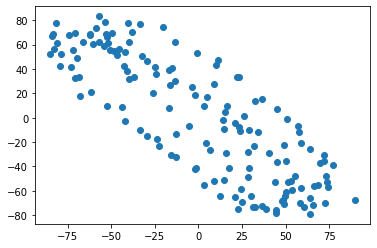

subject_10_stim_period_0_component_3   subject_10_stim_period_0_component_0   SpearmanrResult(correlation=0.7740732626103427, pvalue=5.693632463526547e-42)   6.470105403109077


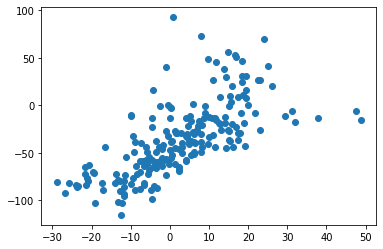

subject_10_stim_period_0_component_6   subject_10_stimulus_0_component_0   SpearmanrResult(correlation=-0.866067806432918, pvalue=9.761602304319842e-63)   2.925532105460889


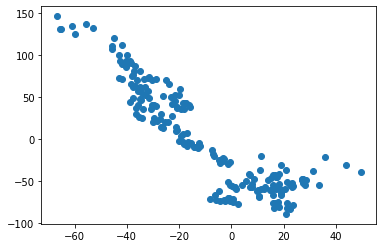

subject_10_stim_period_0_component_6   subject_10_stim_period_0_component_2   SpearmanrResult(correlation=0.7737863185644317, pvalue=6.369825692544791e-42)   2.012599559475289


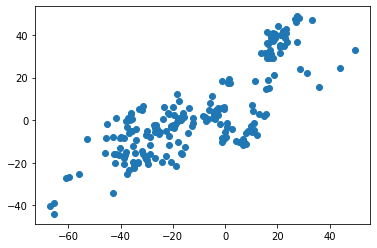

subject_10_stim_period_10_component_0   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=0.9988515915993756, pvalue=1.1702848072729299e-289)   12.13832089393052


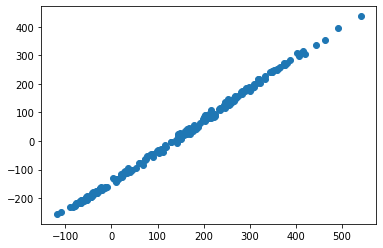

subject_10_stim_period_10_component_0   subject_10_stimulus_11_component_0   SpearmanrResult(correlation=0.771825112840423, pvalue=9.38497725817729e-45)   15.029940936455734


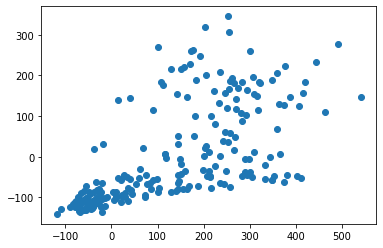

subject_10_stim_period_10_component_0   subject_10_stimulus_12_component_0   SpearmanrResult(correlation=0.8254430501005843, pvalue=4.730428489643026e-56)   5.979867917037947


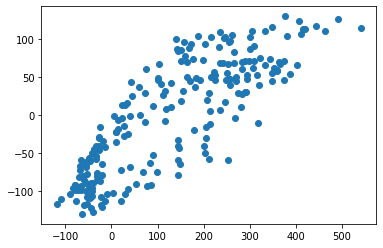

subject_10_stim_period_10_component_1   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=-0.9597020223934002, pvalue=3.7540243975418676e-122)   9.094650959422715


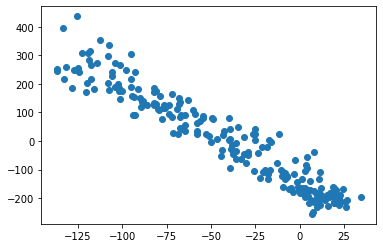

subject_10_stim_period_10_component_1   subject_10_stimulus_12_component_0   SpearmanrResult(correlation=-0.7703701616675025, pvalue=1.7188741353498362e-44)   5.475595637481479


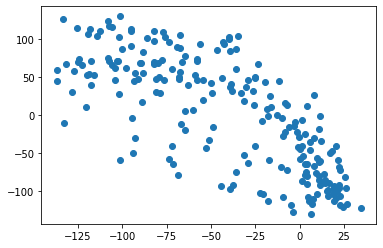

subject_10_stim_period_10_component_1   subject_10_stim_period_10_component_0   SpearmanrResult(correlation=-0.9520959298558008, pvalue=3.7892114600419515e-114)   9.791836993387717


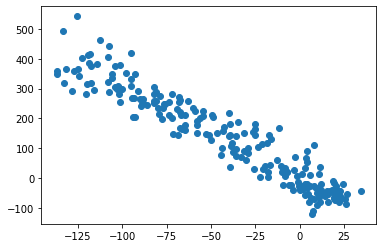

subject_10_stim_period_10_component_6   subject_10_stimulus_10_component_2   SpearmanrResult(correlation=-0.8406214253111916, pvalue=5.659635561966064e-60)   2.654369581708616


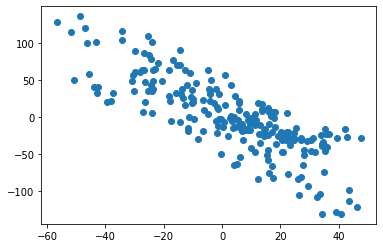

subject_10_stim_period_10_component_8   subject_10_stimulus_10_component_1   SpearmanrResult(correlation=0.874714165769766, pvalue=1.625473844463244e-70)   3.1408462745168446


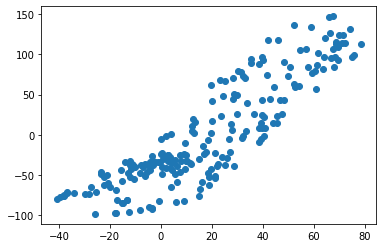

subject_10_stim_period_10_component_9   subject_10_stimulus_11_component_1   SpearmanrResult(correlation=-0.7634887272276474, pvalue=2.8345489452942656e-43)   5.657996010454425


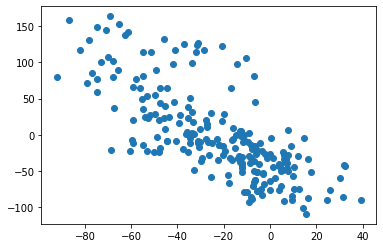

subject_10_stim_period_11_component_0   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=0.7510512050399237, pvalue=3.5530311289515847e-41)   12.13832089393052


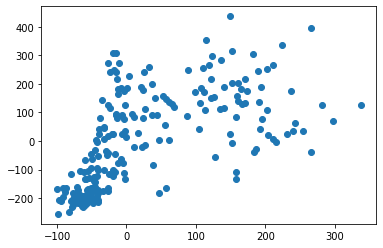

subject_10_stim_period_11_component_0   subject_10_stimulus_11_component_0   SpearmanrResult(correlation=0.9874362543178015, pvalue=1.136579253813068e-176)   15.029940936455734


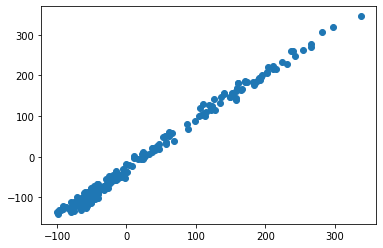

subject_10_stim_period_11_component_0   subject_10_stim_period_10_component_0   SpearmanrResult(correlation=0.7597099113618051, pvalue=1.26887158335537e-42)   15.859238051453733


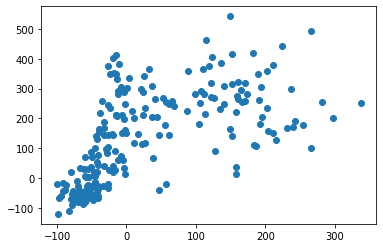

subject_10_stim_period_11_component_1   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=-0.7889892540980373, pvalue=5.216687638690717e-48)   9.094650959422715


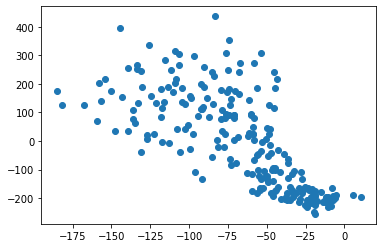

subject_10_stim_period_11_component_1   subject_10_stimulus_11_component_0   SpearmanrResult(correlation=-0.943117156815787, pvalue=3.138729636829161e-106)   10.009220798795472


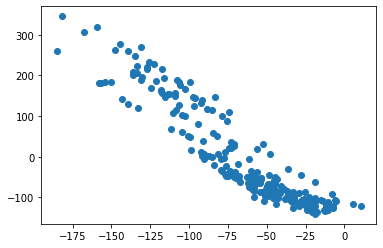

subject_10_stim_period_11_component_1   subject_10_stim_period_10_component_0   SpearmanrResult(correlation=-0.7959371812715891, pvalue=2.052096789794976e-49)   9.791836993387717


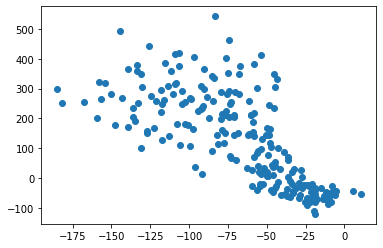

subject_10_stim_period_11_component_1   subject_10_stim_period_11_component_0   SpearmanrResult(correlation=-0.9315429131706326, pvalue=9.702711569887925e-98)   9.791836993387717


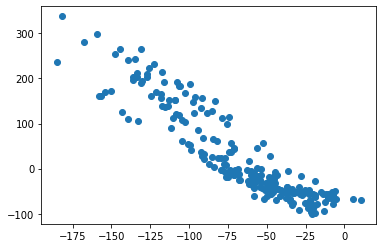

subject_10_stim_period_11_component_2   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=0.8166998191172243, pvalue=5.831663695914561e-54)   4.004096627457056


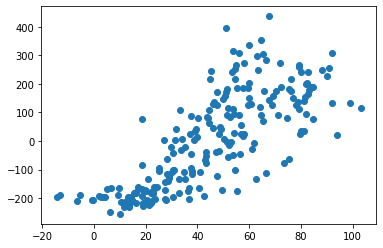

subject_10_stim_period_11_component_2   subject_10_stimulus_11_component_1   SpearmanrResult(correlation=0.7560167471529277, pvalue=5.346628043198712e-42)   3.7407214448145005


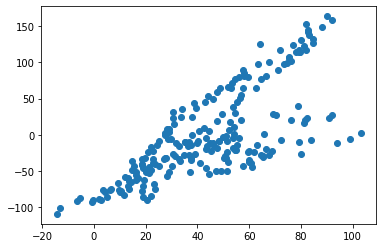

subject_10_stim_period_11_component_2   subject_10_stim_period_10_component_0   SpearmanrResult(correlation=0.8140175698596327, pvalue=2.4262859282928813e-53)   4.025525198885627


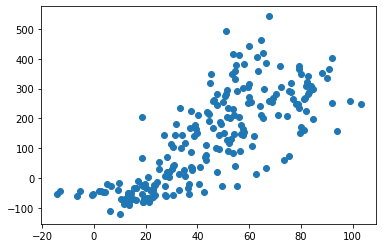

subject_10_stim_period_11_component_2   subject_10_stim_period_10_component_1   SpearmanrResult(correlation=-0.807846142576199, pvalue=5.918247499545834e-52)   3.9150199022661085


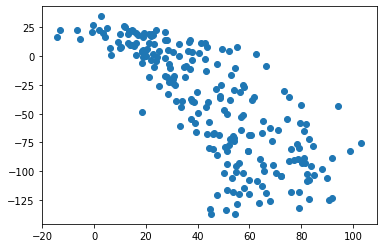

subject_10_stim_period_11_component_2   subject_10_stim_period_11_component_1   SpearmanrResult(correlation=-0.7614004045913796, pvalue=6.5119444969213234e-43)   3.9150199022661085


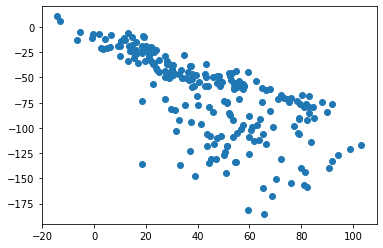

subject_10_stim_period_11_component_3   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=-0.8437984255873054, pvalue=7.579742358607983e-61)   5.8056385140643


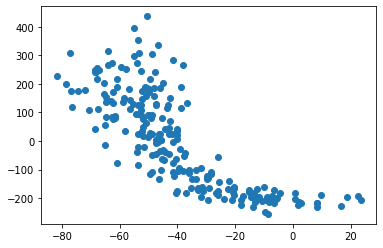

subject_10_stim_period_11_component_3   subject_10_stim_period_10_component_0   SpearmanrResult(correlation=-0.8401627381482336, pvalue=7.538176928295164e-60)   6.470105403109077


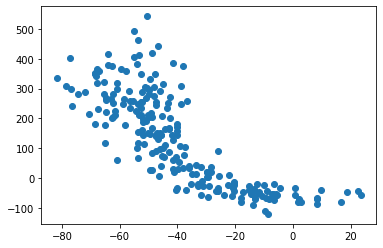

subject_10_stim_period_11_component_3   subject_10_stim_period_10_component_1   SpearmanrResult(correlation=0.8134135002789312, pvalue=3.3342517820054426e-53)   5.880558449364322


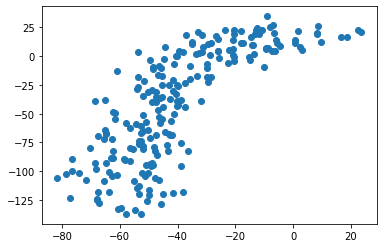

subject_10_stim_period_11_component_4   subject_10_stimulus_11_component_1   SpearmanrResult(correlation=0.8757329696894564, pvalue=7.0742384426726235e-71)   5.622327965894255


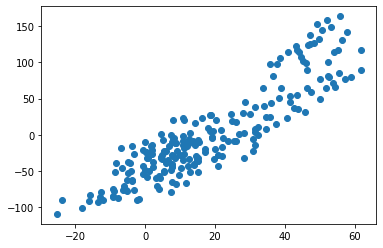

subject_10_stim_period_11_component_5   subject_10_stimulus_10_component_1   SpearmanrResult(correlation=-0.8123687754630543, pvalue=5.762126035370978e-53)   1.7819788077036958


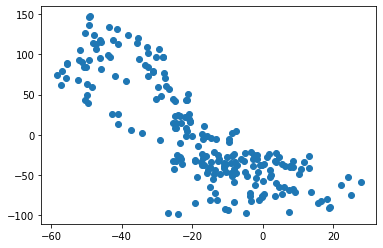

subject_10_stim_period_11_component_5   subject_10_stimulus_12_component_1   SpearmanrResult(correlation=0.7680868688120904, pvalue=4.403481947582432e-44)   1.8915341109968238


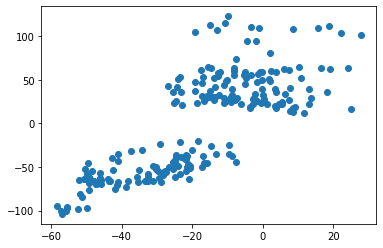

subject_10_stim_period_11_component_7   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=-0.8430106557423238, pvalue=1.2530402165210198e-60)   1.7697400065420448


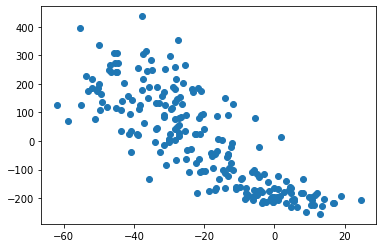

subject_10_stim_period_11_component_7   subject_10_stimulus_11_component_0   SpearmanrResult(correlation=-0.7683348078190947, pvalue=3.977952266369206e-44)   1.7697400065420448


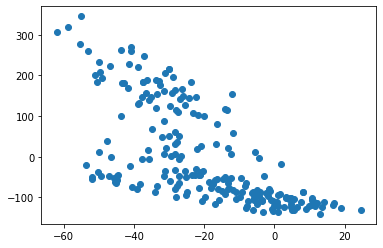

subject_10_stim_period_11_component_7   subject_10_stimulus_12_component_0   SpearmanrResult(correlation=-0.7807655680339, pvalue=2.0588693265301594e-46)   1.5059089154705148


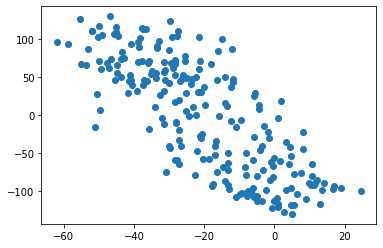

subject_10_stim_period_11_component_7   subject_10_stim_period_10_component_0   SpearmanrResult(correlation=-0.8430455926024015, pvalue=1.225486870852311e-60)   1.7697400065420448


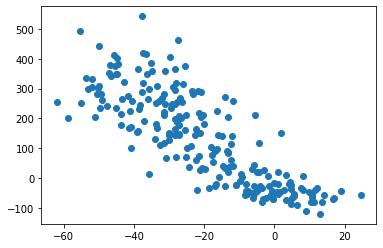

subject_10_stim_period_11_component_7   subject_10_stim_period_10_component_1   SpearmanrResult(correlation=0.7800059730760779, pvalue=2.8680081997912496e-46)   1.7697400065420448


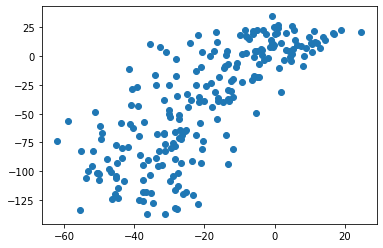

subject_10_stim_period_11_component_7   subject_10_stim_period_11_component_0   SpearmanrResult(correlation=-0.7540253461284888, pvalue=1.1489487979451613e-41)   1.7697400065420448


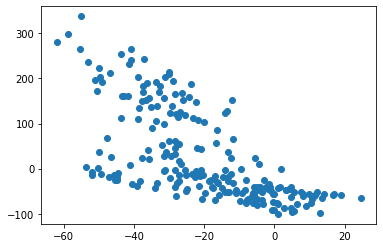

subject_10_stim_period_11_component_7   subject_10_stim_period_11_component_1   SpearmanrResult(correlation=0.7505542000304288, pvalue=4.2840665652872167e-41)   1.7697400065420448


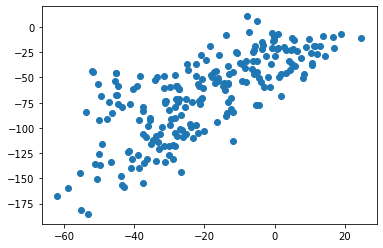

subject_10_stim_period_11_component_7   subject_10_stim_period_11_component_3   SpearmanrResult(correlation=0.7869527732541431, pvalue=1.3160018418874234e-47)   1.7491920613365652


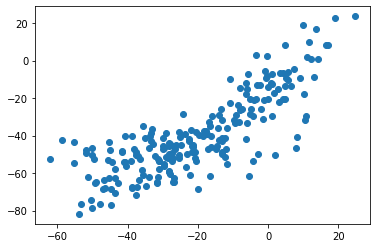

subject_10_stim_period_11_component_8   subject_10_stimulus_10_component_1   SpearmanrResult(correlation=0.8350529406129727, pvalue=1.7294306153858375e-58)   3.1408462745168446


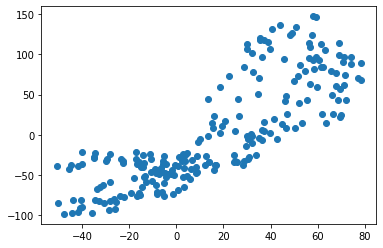

subject_10_stim_period_11_component_8   subject_10_stimulus_12_component_1   SpearmanrResult(correlation=-0.8270862095197309, pvalue=1.8574669875075331e-56)   2.8559964490128316


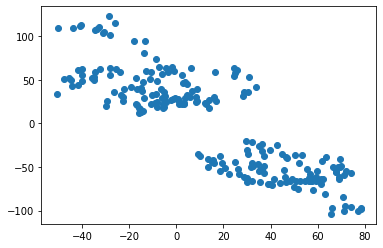

subject_10_stim_period_11_component_8   subject_10_stim_period_11_component_5   SpearmanrResult(correlation=-0.7964353132765702, pvalue=1.6194262080767033e-49)   2.0785952021235086


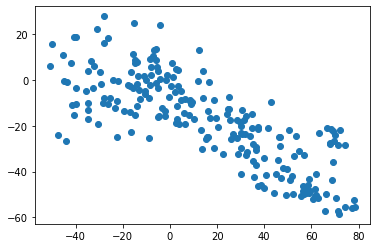

subject_10_stim_period_11_component_9   subject_10_stimulus_12_component_0   SpearmanrResult(correlation=0.7634594253450014, pvalue=2.8679941226562448e-43)   4.804235416363067


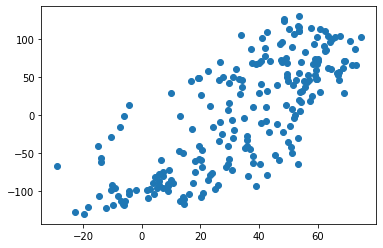

subject_10_stim_period_11_component_9   subject_10_stim_period_10_component_0   SpearmanrResult(correlation=0.7503096420098837, pvalue=4.696448285551647e-41)   9.091549291759812


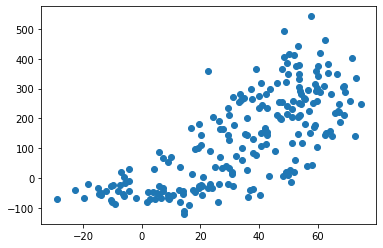

subject_10_stim_period_12_component_0   subject_10_stimulus_12_component_0   SpearmanrResult(correlation=0.7550261181203969, pvalue=7.829653100649458e-42)   5.979867917037947


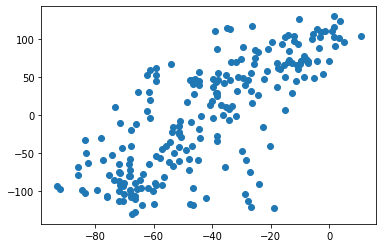

subject_10_stim_period_12_component_1   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=0.7589818722776015, pvalue=1.6882946737087028e-42)   9.094650959422715


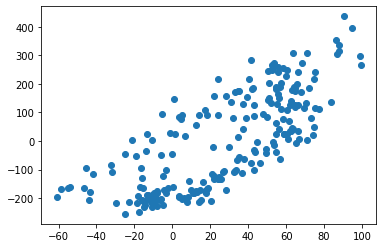

subject_10_stim_period_12_component_1   subject_10_stimulus_12_component_0   SpearmanrResult(correlation=0.9760119010723362, pvalue=2.5308574408453667e-146)   5.475595637481479


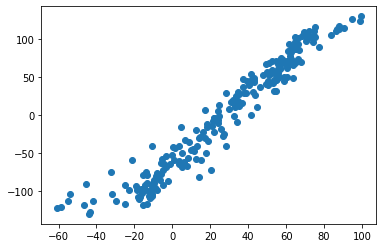

subject_10_stim_period_12_component_1   subject_10_stim_period_10_component_0   SpearmanrResult(correlation=0.7664662493026715, pvalue=8.52982525483994e-44)   9.791836993387717


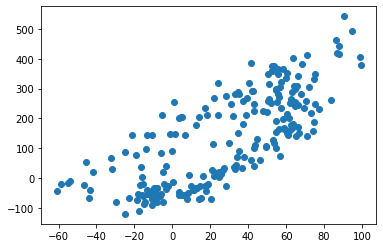

subject_10_stim_period_12_component_1   subject_10_stim_period_11_component_7   SpearmanrResult(correlation=-0.7518479908487966, pvalue=2.6298316011624807e-41)   1.7697400065420448


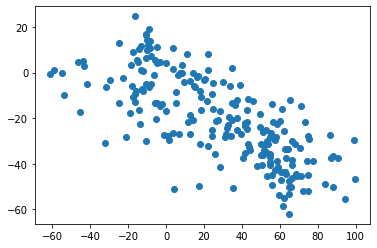

subject_10_stim_period_12_component_2   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=-0.7594676073322325, pvalue=1.3955524816898624e-42)   4.004096627457056


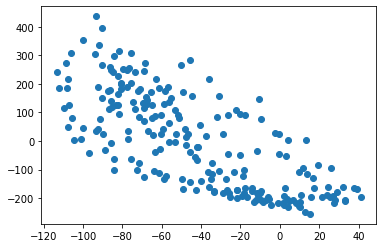

subject_10_stim_period_12_component_2   subject_10_stimulus_12_component_0   SpearmanrResult(correlation=-0.9489245645571189, pvalue=3.447774396284613e-111)   2.296428954724445


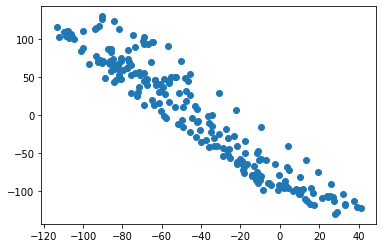

subject_10_stim_period_12_component_2   subject_10_stim_period_10_component_0   SpearmanrResult(correlation=-0.7650608859311517, pvalue=1.5068398764015594e-43)   4.025525198885627


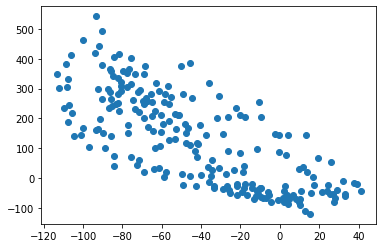

subject_10_stim_period_12_component_2   subject_10_stim_period_10_component_3   SpearmanrResult(correlation=0.8065523517578311, pvalue=1.1393408506008733e-51)   3.7839897978227657


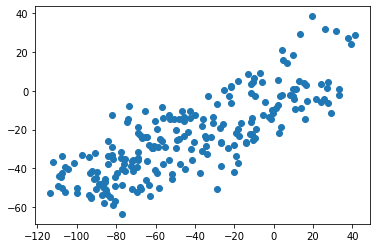

subject_10_stim_period_12_component_2   subject_10_stim_period_12_component_1   SpearmanrResult(correlation=-0.9177112975662532, pvalue=2.315227364119562e-89)   3.9150199022661085


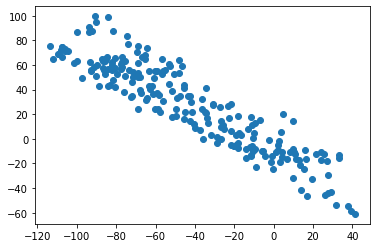

subject_10_stim_period_12_component_6   subject_10_stimulus_10_component_0   SpearmanrResult(correlation=0.8427796216676152, pvalue=1.4513164726560736e-60)   2.9108562641535025


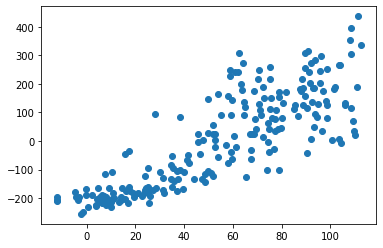

subject_10_stim_period_12_component_6   subject_10_stimulus_11_component_0   SpearmanrResult(correlation=0.7995165189363417, pvalue=3.6883513028271513e-50)   2.925532105460889


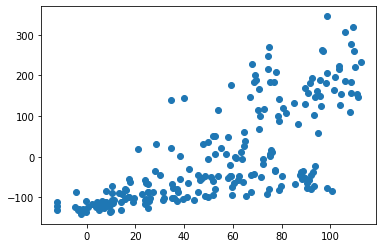

subject_10_stim_period_12_component_6   subject_10_stimulus_12_component_0   SpearmanrResult(correlation=0.9198616049542722, pvalue=1.456077581534715e-90)   2.556550510841032


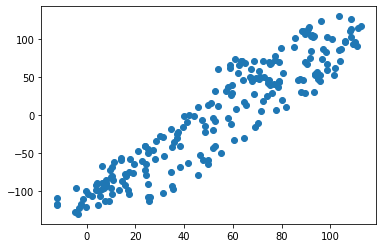

subject_10_stim_period_12_component_6   subject_10_stim_period_10_component_0   SpearmanrResult(correlation=0.850348523354164, pvalue=1.0383156641002545e-62)   2.925532105460889


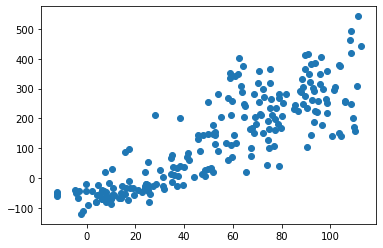

subject_10_stim_period_12_component_6   subject_10_stim_period_10_component_1   SpearmanrResult(correlation=-0.8157272220124757, pvalue=9.80542930265432e-54)   2.925532105460889


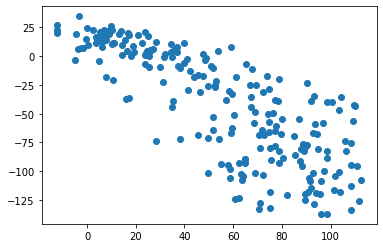

subject_10_stim_period_12_component_6   subject_10_stim_period_11_component_0   SpearmanrResult(correlation=0.803724720082496, pvalue=4.6874881305614193e-51)   2.925532105460889


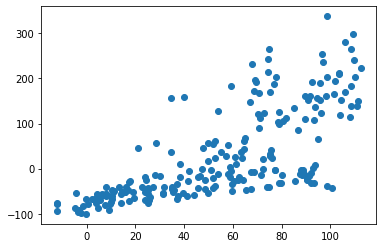

subject_10_stim_period_12_component_6   subject_10_stim_period_11_component_1   SpearmanrResult(correlation=-0.8122200120588517, pvalue=6.227196419793224e-53)   2.925532105460889


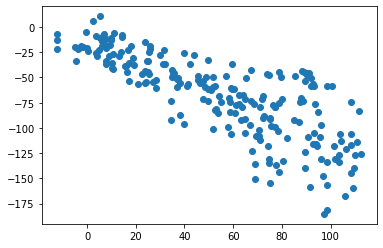

subject_10_stim_period_12_component_6   subject_10_stim_period_11_component_7   SpearmanrResult(correlation=-0.7511154437826476, pvalue=3.468026146208636e-41)   1.4514906236998413


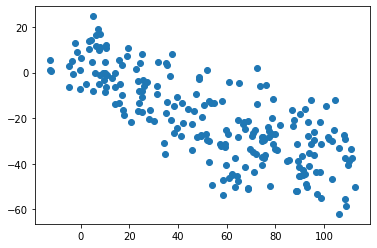

subject_10_stim_period_12_component_6   subject_10_stim_period_11_component_9   SpearmanrResult(correlation=0.8067946557874035, pvalue=1.0081915009462134e-51)   2.925532105460889


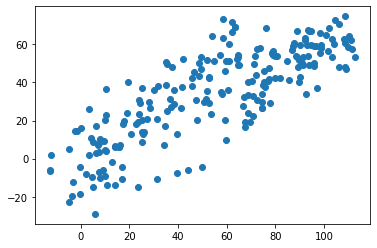

subject_10_stim_period_12_component_6   subject_10_stim_period_12_component_1   SpearmanrResult(correlation=0.8625595194491246, pvalue=1.9599906274993853e-66)   2.925532105460889


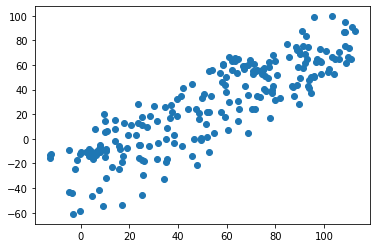

subject_10_stim_period_12_component_6   subject_10_stim_period_12_component_2   SpearmanrResult(correlation=-0.852419941058136, pvalue=2.5611641169269196e-63)   2.012599559475289


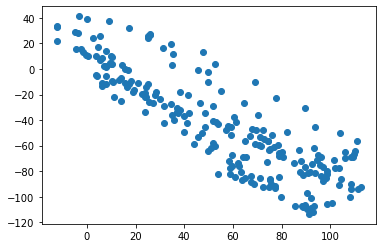

subject_10_stim_period_12_component_7   subject_10_stimulus_12_component_0   SpearmanrResult(correlation=-0.7790266139984109, pvalue=4.388693252561085e-46)   1.5059089154705148


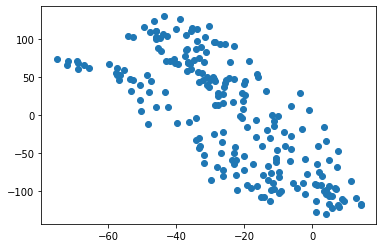

subject_10_stim_period_12_component_7   subject_10_stim_period_10_component_9   SpearmanrResult(correlation=0.7646653105154313, pvalue=1.7673223662710199e-43)   1.7697400065420448


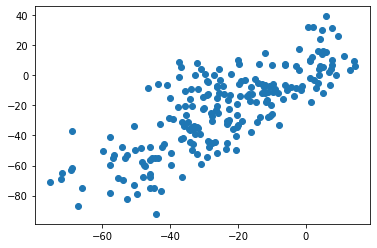

subject_10_stim_period_12_component_7   subject_10_stim_period_12_component_1   SpearmanrResult(correlation=-0.7652085223398679, pvalue=1.41966937222485e-43)   1.7697400065420448


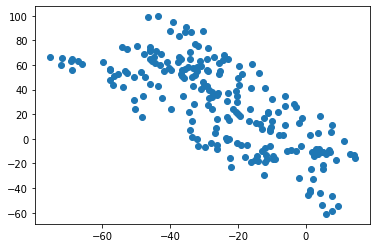

subject_10_stim_period_12_component_7   subject_10_stim_period_12_component_2   SpearmanrResult(correlation=0.8506618280993785, pvalue=8.413505006033734e-63)   1.5868001292513179


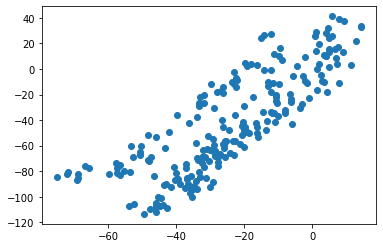

subject_10_stim_period_13_component_0   subject_10_stimulus_13_component_1   SpearmanrResult(correlation=0.934704859354401, pvalue=8.500721529895234e-92)   14.791922211871702


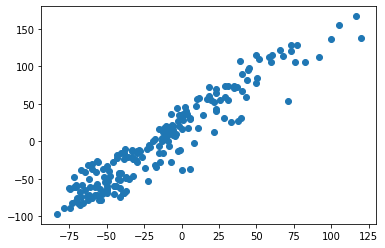

subject_10_stim_period_13_component_1   subject_10_stimulus_13_component_0   SpearmanrResult(correlation=-0.8072025862978915, pvalue=1.131258138302326e-47)   4.631554816508229


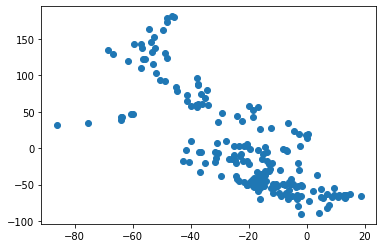

subject_10_stim_period_13_component_2   subject_10_stimulus_13_component_0   SpearmanrResult(correlation=0.8785412546107195, pvalue=4.279958290162835e-66)   3.595457503416328


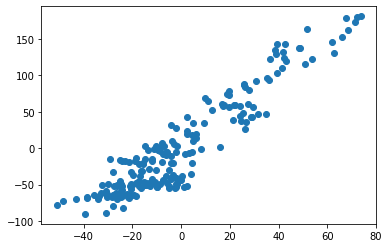

subject_10_stim_period_13_component_6   subject_10_stimulus_13_component_0   SpearmanrResult(correlation=0.9625508025399996, pvalue=2.4753148062338624e-115)   2.1137288527025317


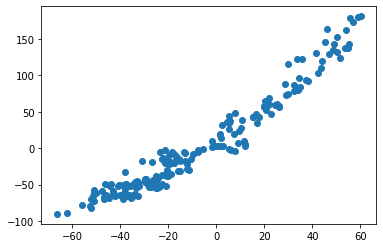

subject_10_stim_period_13_component_6   subject_10_stim_period_13_component_2   SpearmanrResult(correlation=0.9011284114956604, pvalue=1.5991737087146232e-74)   2.012599559475289


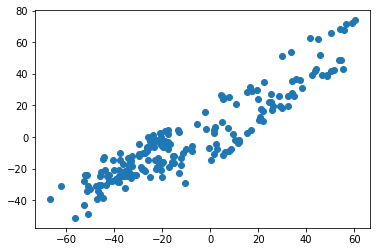

subject_10_stim_period_14_component_0   subject_10_stimulus_14_component_0   SpearmanrResult(correlation=0.9288930581613509, pvalue=5.580826792635759e-18)   2.4999786763980465


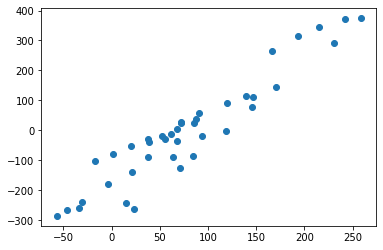

subject_10_stim_period_14_component_0   subject_10_stimulus_15_component_0   SpearmanrResult(correlation=0.9418386491557225, pvalue=1.3738763409092858e-19)   2.2201084382653855


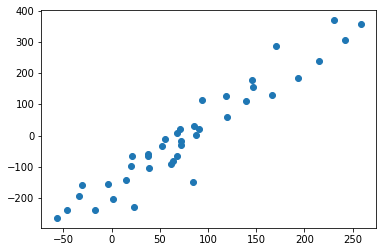

subject_10_stim_period_14_component_1   subject_10_stimulus_14_component_0   SpearmanrResult(correlation=0.8746716697936211, pvalue=1.6314933382173038e-13)   2.4999786763980465


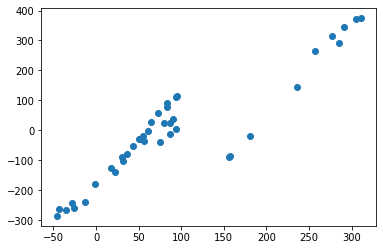

subject_10_stim_period_14_component_1   subject_10_stimulus_15_component_0   SpearmanrResult(correlation=0.7744840525328331, pvalue=4.52833818489711e-09)   2.2201084382653855


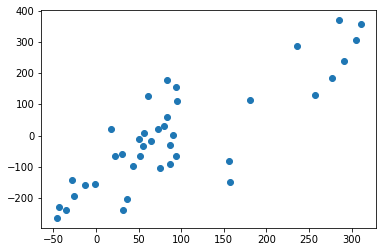

subject_10_stim_period_14_component_1   subject_10_stim_period_14_component_0   SpearmanrResult(correlation=0.8909943714821764, pvalue=1.3340843278136696e-14)   9.791836993387717


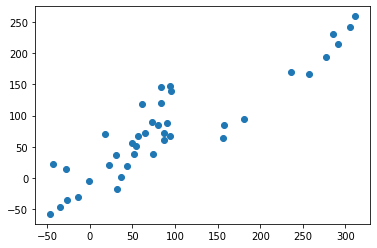

subject_10_stim_period_14_component_2   subject_10_stimulus_14_component_0   SpearmanrResult(correlation=0.9330206378986868, pvalue=1.8581112977952484e-18)   1.9197981671996966


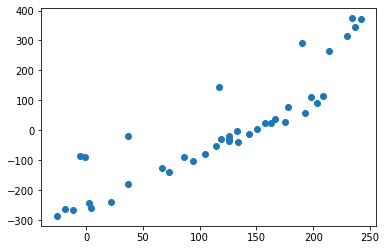

subject_10_stim_period_14_component_2   subject_10_stimulus_15_component_0   SpearmanrResult(correlation=0.7849906191369608, pvalue=2.0210209226829914e-09)   1.323431681543567


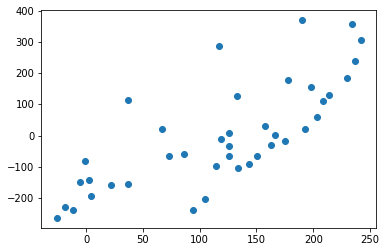

subject_10_stim_period_14_component_2   subject_10_stim_period_14_component_0   SpearmanrResult(correlation=0.801688555347092, pvalue=5.091652755396939e-10)   4.025525198885627


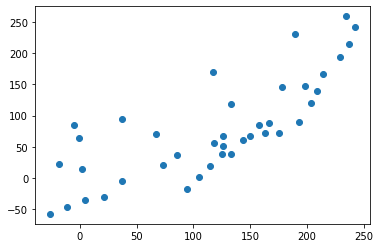

subject_10_stim_period_14_component_4   subject_10_stimulus_14_component_0   SpearmanrResult(correlation=0.7540337711069419, pvalue=1.9375714723696376e-08)   2.4060392824586527


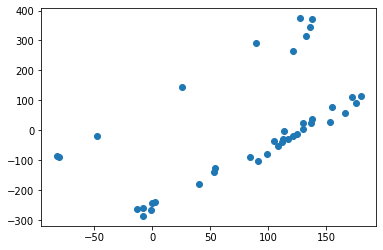

subject_10_stim_period_14_component_4   subject_10_stim_period_14_component_2   SpearmanrResult(correlation=0.8947467166979364, pvalue=7.092098653405043e-15)   3.969581142941571


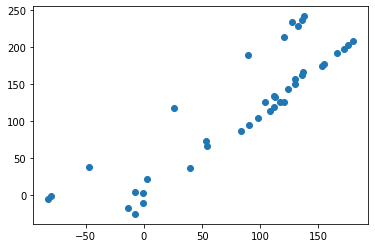

subject_10_stim_period_14_component_5   subject_10_stimulus_14_component_0   SpearmanrResult(correlation=0.9078799249530958, pvalue=6.339826795208684e-16)   1.5806849892923822


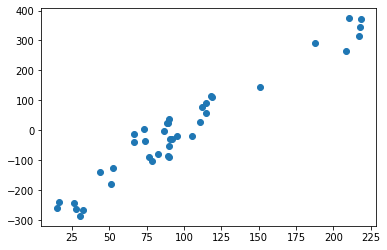

subject_10_stim_period_14_component_5   subject_10_stimulus_15_component_0   SpearmanrResult(correlation=0.831332082551595, pvalue=3.096551163986111e-11)   1.3426988278105871


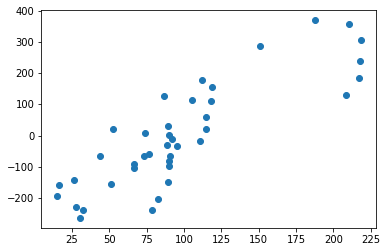

subject_10_stim_period_14_component_5   subject_10_stim_period_14_component_0   SpearmanrResult(correlation=0.8645403377110695, pvalue=6.517204569334017e-13)   2.1702250480445793


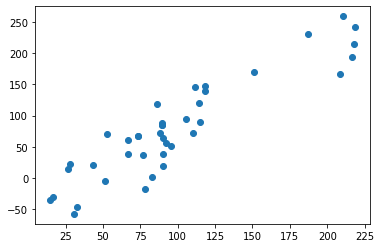

subject_10_stim_period_14_component_5   subject_10_stim_period_14_component_1   SpearmanrResult(correlation=0.8318949343339589, pvalue=2.921179699448429e-11)   2.1702250480445793


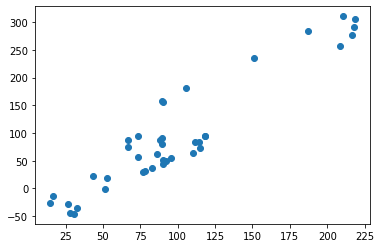

subject_10_stim_period_14_component_5   subject_10_stim_period_14_component_2   SpearmanrResult(correlation=0.7938086303939964, pvalue=9.91277274573402e-10)   1.7171083207612972


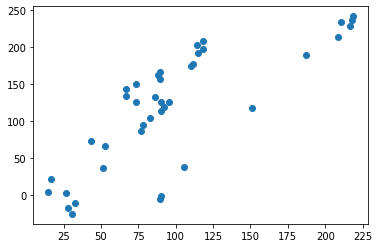

subject_10_stim_period_14_component_6   subject_10_stim_period_14_component_4   SpearmanrResult(correlation=0.8455909943714822, pvalue=6.5940900105374965e-12)   2.727426044854828


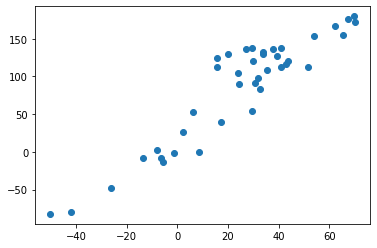

subject_10_stim_period_14_component_7   subject_10_stimulus_14_component_1   SpearmanrResult(correlation=-0.7921200750469044, pvalue=1.1391457223924432e-09)   1.7365723046786907


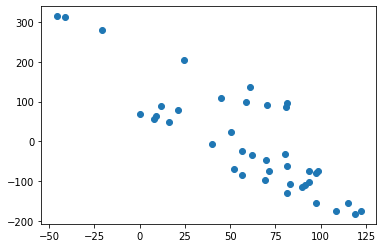

subject_10_stim_period_14_component_7   subject_10_stimulus_15_component_1   SpearmanrResult(correlation=-0.8210131332082553, pvalue=8.695289486536656e-11)   1.7697400065420448


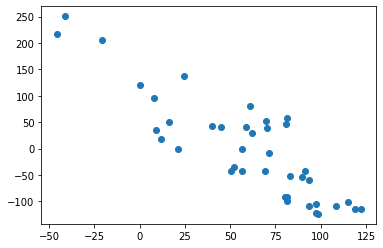

subject_10_stim_period_14_component_7   subject_10_stim_period_14_component_4   SpearmanrResult(correlation=0.8463414634146341, pvalue=6.05267351144322e-12)   1.7586288954309337


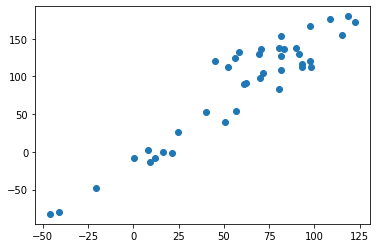

subject_10_stim_period_14_component_7   subject_10_stim_period_14_component_6   SpearmanrResult(correlation=0.9330206378986868, pvalue=1.8581112977952484e-18)   1.4514906236998413


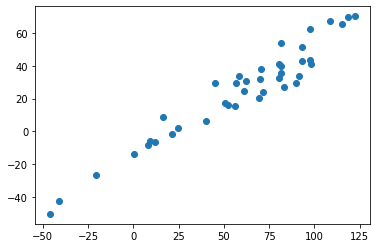

subject_10_stim_period_14_component_8   subject_10_stim_period_14_component_5   SpearmanrResult(correlation=0.777298311444653, pvalue=3.663872372078415e-09)   2.0785952021235086


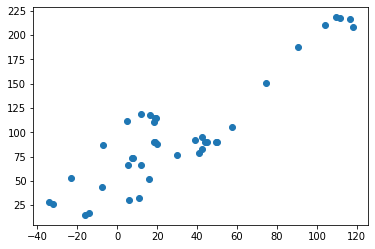

subject_10_stim_period_14_component_9   subject_10_stimulus_14_component_1   SpearmanrResult(correlation=0.8658536585365855, pvalue=5.481035892696237e-13)   6.211665696622191


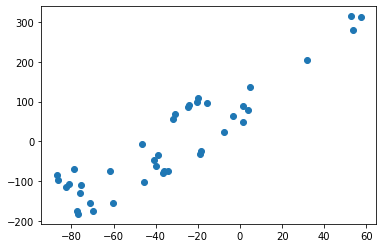

subject_10_stim_period_15_component_0   subject_10_stimulus_15_component_0   SpearmanrResult(correlation=0.8542213883677299, pvalue=2.3929624701415447e-12)   2.2201084382653855


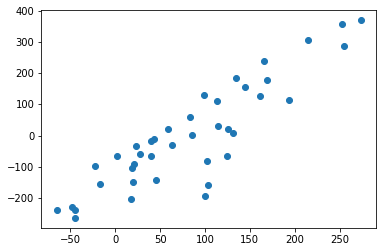

subject_10_stim_period_15_component_0   subject_10_stim_period_14_component_0   SpearmanrResult(correlation=0.7617260787992497, pvalue=1.1405945526619773e-08)   15.859238051453733


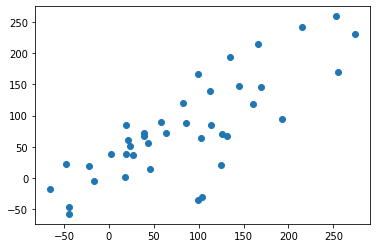

subject_10_stim_period_15_component_1   subject_10_stimulus_14_component_0   SpearmanrResult(correlation=0.9251407129455911, pvalue=1.4342616177191697e-17)   2.4999786763980465


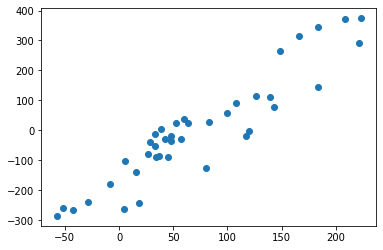

subject_10_stim_period_15_component_1   subject_10_stimulus_15_component_0   SpearmanrResult(correlation=0.9697936210131334, pvalue=6.881707439789767e-25)   2.2201084382653855


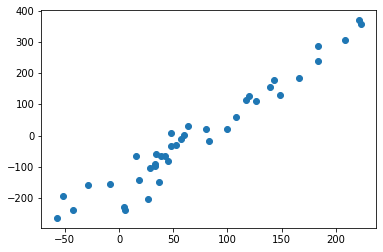

subject_10_stim_period_15_component_1   subject_10_stim_period_14_component_0   SpearmanrResult(correlation=0.9697936210131334, pvalue=6.881707439789767e-25)   9.791836993387717


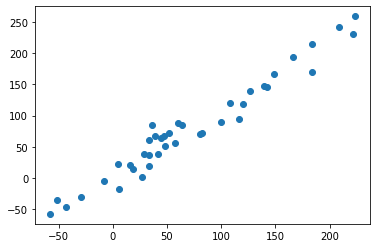

subject_10_stim_period_15_component_1   subject_10_stim_period_14_component_1   SpearmanrResult(correlation=0.8318949343339589, pvalue=2.921179699448429e-11)   10.113689508414078


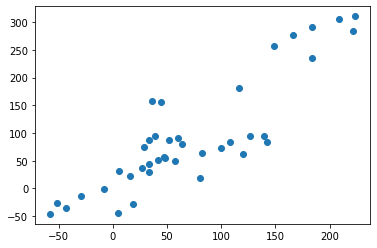

subject_10_stim_period_15_component_1   subject_10_stim_period_14_component_2   SpearmanrResult(correlation=0.8039399624765479, pvalue=4.186193402324043e-10)   3.9150199022661085


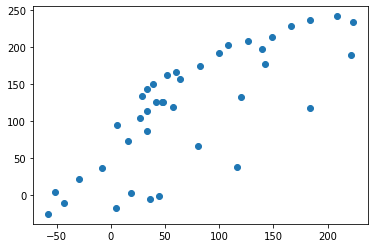

subject_10_stim_period_15_component_1   subject_10_stim_period_14_component_5   SpearmanrResult(correlation=0.9061913696060038, pvalue=8.81888008797611e-16)   2.1702250480445793


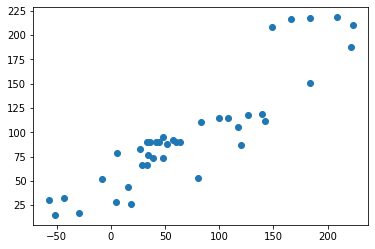

subject_10_stim_period_15_component_1   subject_10_stim_period_15_component_0   SpearmanrResult(correlation=0.7694183864915572, pvalue=6.580789763276205e-09)   9.791836993387717


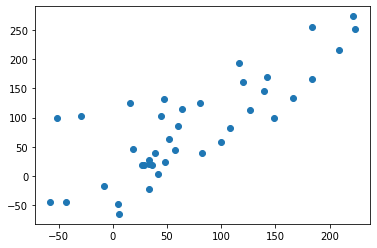

subject_10_stim_period_15_component_2   subject_10_stim_period_14_component_6   SpearmanrResult(correlation=0.8076923076923078, pvalue=3.0035417717789866e-10)   2.012599559475289


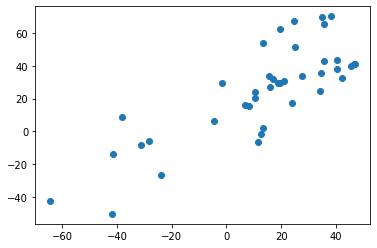

subject_10_stim_period_15_component_2   subject_10_stim_period_14_component_7   SpearmanrResult(correlation=0.7682926829268295, pvalue=7.141659235565743e-09)   1.5868001292513179


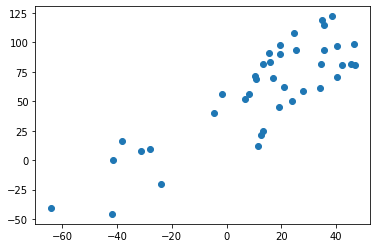

subject_10_stim_period_15_component_3   subject_10_stim_period_15_component_0   SpearmanrResult(correlation=0.8748592870544092, pvalue=1.58840728978285e-13)   6.470105403109077


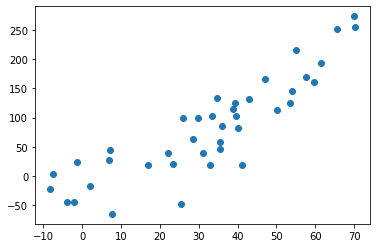

subject_10_stim_period_15_component_4   subject_10_stimulus_14_component_0   SpearmanrResult(correlation=0.8971857410881803, pvalue=4.643179142879038e-15)   2.4060392824586527


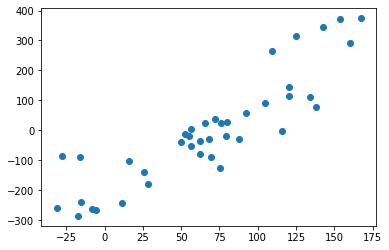

subject_10_stim_period_15_component_4   subject_10_stimulus_15_component_0   SpearmanrResult(correlation=0.9082551594746718, pvalue=5.886420140184763e-16)   2.093340761497709


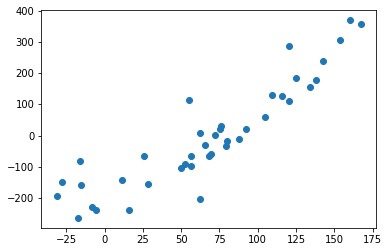

subject_10_stim_period_15_component_4   subject_10_stim_period_14_component_0   SpearmanrResult(correlation=0.8484052532833022, pvalue=4.770895961385292e-12)   11.182642206614581


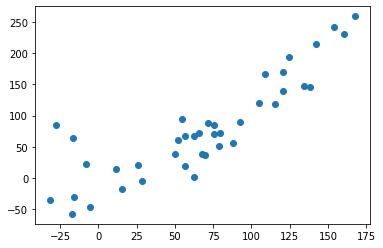

subject_10_stim_period_15_component_4   subject_10_stim_period_14_component_2   SpearmanrResult(correlation=0.8641651031894936, pvalue=6.84546526486666e-13)   3.969581142941571


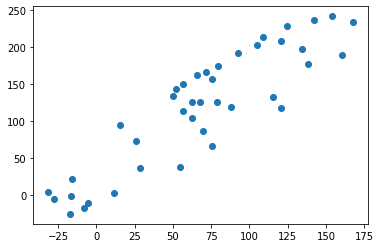

subject_10_stim_period_15_component_4   subject_10_stim_period_14_component_5   SpearmanrResult(correlation=0.8459662288930584, pvalue=6.317942646085984e-12)   2.1535583813779127


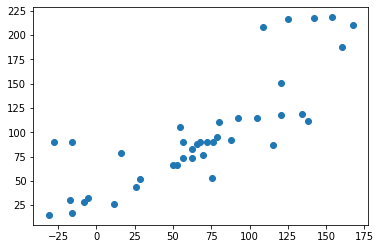

subject_10_stim_period_15_component_4   subject_10_stim_period_14_component_6   SpearmanrResult(correlation=0.7598499061913697, pvalue=1.3002991578522027e-08)   2.727426044854828


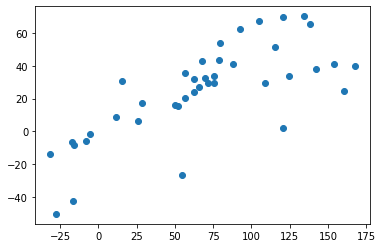

subject_10_stim_period_15_component_4   subject_10_stim_period_15_component_1   SpearmanrResult(correlation=0.9159474671669795, pvalue=1.1940251005880511e-16)   8.4789130629138


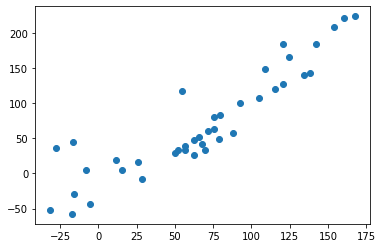

subject_10_stim_period_15_component_4   subject_10_stim_period_15_component_2   SpearmanrResult(correlation=0.7632270168855536, pvalue=1.0261916733925279e-08)   3.969581142941571


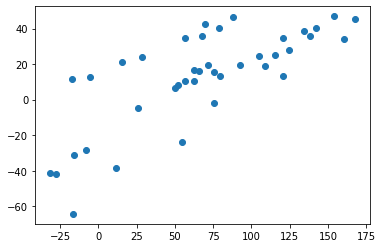

subject_10_stim_period_15_component_5   subject_10_stimulus_15_component_0   SpearmanrResult(correlation=0.8424015009380864, pvalue=9.443285220362985e-12)   1.3426988278105871


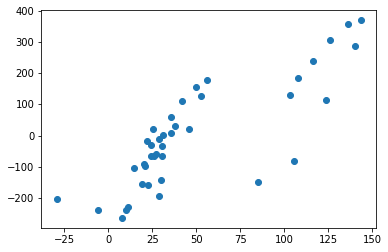

subject_10_stim_period_15_component_5   subject_10_stim_period_14_component_0   SpearmanrResult(correlation=0.8281425891181992, pvalue=4.2916925569303775e-11)   2.1702250480445793


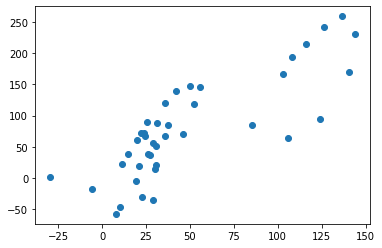

subject_10_stim_period_15_component_5   subject_10_stim_period_14_component_1   SpearmanrResult(correlation=0.7562851782363977, pvalue=1.662550449949889e-08)   2.1702250480445793


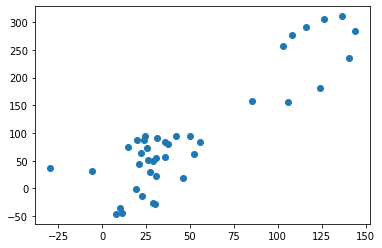

subject_10_stim_period_15_component_5   subject_10_stim_period_15_component_0   SpearmanrResult(correlation=0.8716697936210133, pvalue=2.489277456829834e-13)   2.1702250480445793


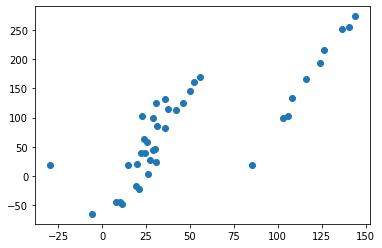

subject_10_stim_period_15_component_5   subject_10_stim_period_15_component_1   SpearmanrResult(correlation=0.8187617260787995, pvalue=1.0797687529085769e-10)   2.1702250480445793


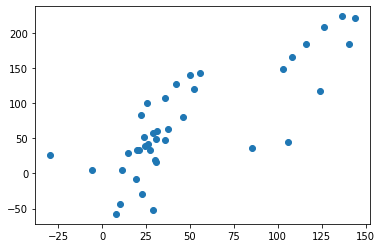

subject_10_stim_period_15_component_6   subject_10_stim_period_15_component_2   SpearmanrResult(correlation=0.8607879924953097, pvalue=1.0584562844716865e-12)   2.012599559475289


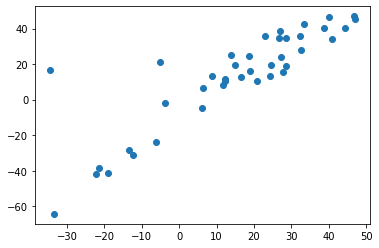

subject_10_stim_period_15_component_7   subject_10_stimulus_14_component_0   SpearmanrResult(correlation=0.902439024390244, pvalue=1.7967276186878004e-15)   1.4371104952178528


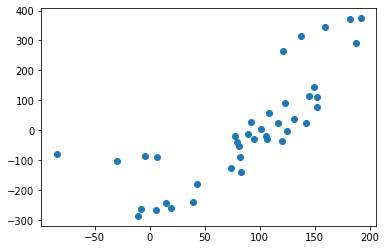

subject_10_stim_period_15_component_7   subject_10_stimulus_15_component_0   SpearmanrResult(correlation=0.9172607879924954, pvalue=8.956382297740686e-17)   1.1251271675421202


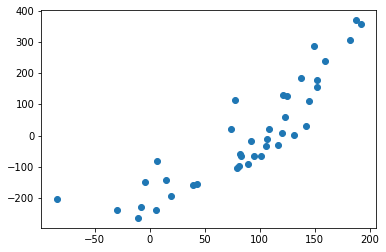

subject_10_stim_period_15_component_7   subject_10_stim_period_14_component_0   SpearmanrResult(correlation=0.8590994371482178, pvalue=1.310580384808964e-12)   1.7697400065420448


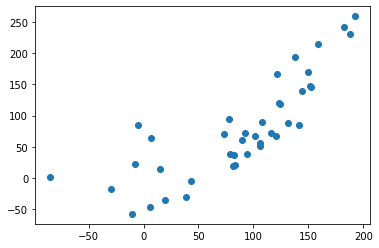

subject_10_stim_period_15_component_7   subject_10_stim_period_14_component_2   SpearmanrResult(correlation=0.8651031894934335, pvalue=6.052427503000715e-13)   1.5868001292513179


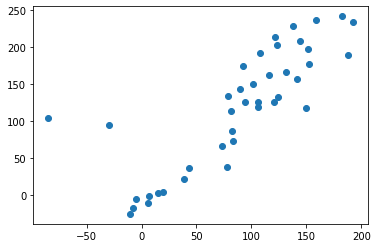

subject_10_stim_period_15_component_7   subject_10_stim_period_14_component_5   SpearmanrResult(correlation=0.7664165103189494, pvalue=8.176421941316939e-09)   1.365788720257334


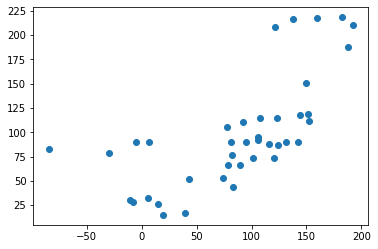

subject_10_stim_period_15_component_7   subject_10_stim_period_15_component_1   SpearmanrResult(correlation=0.8694183864915574, pvalue=3.393930459715473e-13)   1.7697400065420448


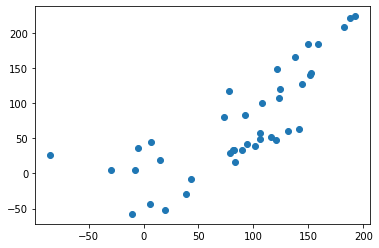

subject_10_stim_period_15_component_7   subject_10_stim_period_15_component_4   SpearmanrResult(correlation=0.9005628517823641, pvalue=2.5372790933070795e-15)   1.7586288954309337


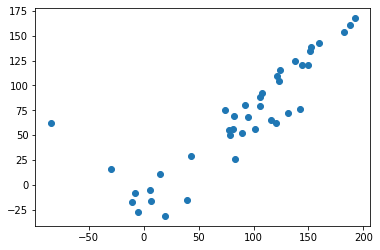

subject_10_stim_period_15_component_7   subject_10_stim_period_15_component_6   SpearmanrResult(correlation=0.751969981238274, pvalue=2.2262988430905723e-08)   1.4514906236998413


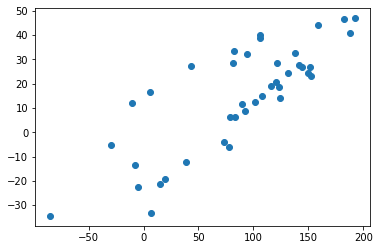

subject_10_stim_period_15_component_8   subject_10_stimulus_14_component_0   SpearmanrResult(correlation=-0.8093808630393998, pvalue=2.580615228012484e-10)   2.1619541575983168


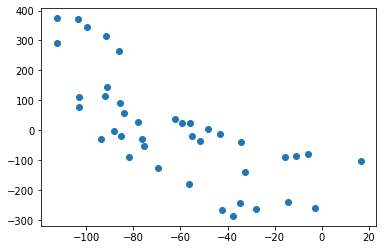

subject_10_stim_period_15_component_8   subject_10_stimulus_15_component_0   SpearmanrResult(correlation=-0.8697936210131333, pvalue=3.2243188827050526e-13)   1.8946961508028894


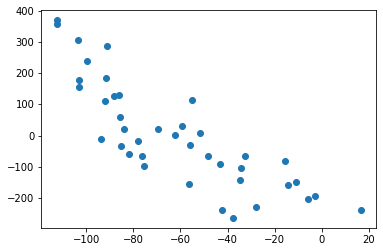

subject_10_stim_period_15_component_8   subject_10_stim_period_14_component_0   SpearmanrResult(correlation=-0.7844277673545967, pvalue=2.1126579073787982e-09)   4.455583093616614


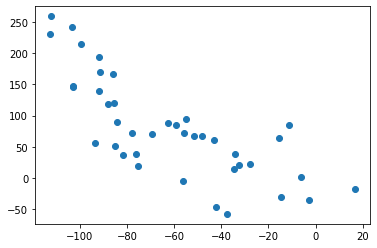

subject_10_stim_period_15_component_8   subject_10_stim_period_14_component_2   SpearmanrResult(correlation=-0.7596622889305817, pvalue=1.3173653876119514e-08)   2.978465081929116


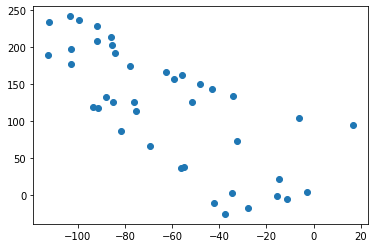

subject_10_stim_period_15_component_8   subject_10_stim_period_14_component_5   SpearmanrResult(correlation=-0.8090056285178236, pvalue=2.669476244073247e-10)   2.0785952021235086


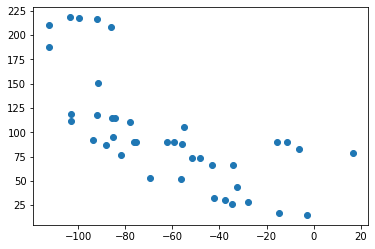

subject_10_stim_period_15_component_8   subject_10_stim_period_15_component_1   SpearmanrResult(correlation=-0.8592870544090058, pvalue=1.2800086235259685e-12)   4.439077058050393


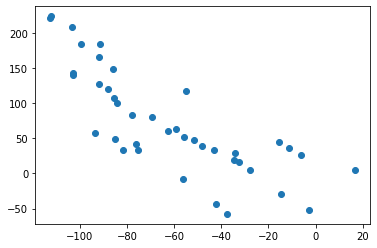

subject_10_stim_period_15_component_8   subject_10_stim_period_15_component_2   SpearmanrResult(correlation=-0.7998123827392122, pvalue=5.982790447715034e-10)   2.978465081929116


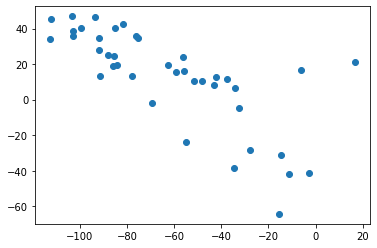

subject_10_stim_period_15_component_8   subject_10_stim_period_15_component_4   SpearmanrResult(correlation=-0.9382739212007506, pvalue=4.122786482308793e-19)   4.402456067386139


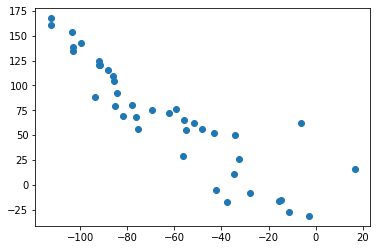

subject_10_stim_period_15_component_8   subject_10_stim_period_15_component_6   SpearmanrResult(correlation=-0.8288930581613511, pvalue=3.976830002060954e-11)   2.64441250419353


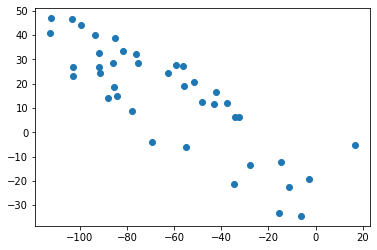

subject_10_stim_period_15_component_8   subject_10_stim_period_15_component_7   SpearmanrResult(correlation=-0.877673545966229, pvalue=1.0576575245141738e-13)   1.7444134694283142


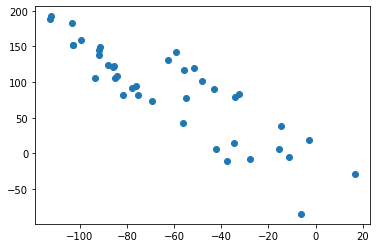

subject_10_stim_period_15_component_9   subject_10_stimulus_14_component_0   SpearmanrResult(correlation=0.7727954971857413, pvalue=5.134655237459959e-09)   2.4999786763980465


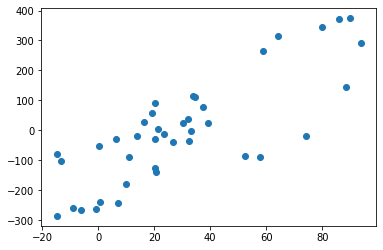

subject_10_stim_period_15_component_9   subject_10_stimulus_15_component_0   SpearmanrResult(correlation=0.8427767354596625, pvalue=9.056346361792913e-12)   2.2201084382653855


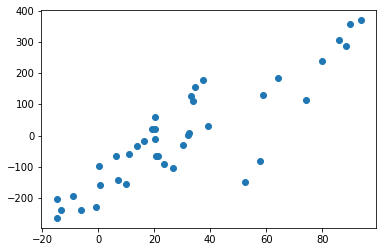

subject_10_stim_period_15_component_9   subject_10_stim_period_14_component_0   SpearmanrResult(correlation=0.8947467166979364, pvalue=7.092098653405043e-15)   9.091549291759812


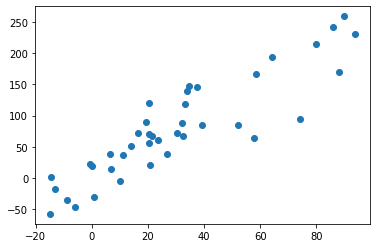

subject_10_stim_period_15_component_9   subject_10_stim_period_14_component_1   SpearmanrResult(correlation=0.9095684803001878, pvalue=4.528592607933813e-16)   8.27349258168713


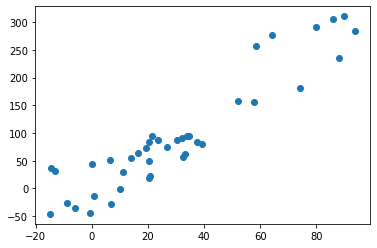

subject_10_stim_period_15_component_9   subject_10_stim_period_15_component_0   SpearmanrResult(correlation=0.7994371482176361, pvalue=6.17766760727099e-10)   9.091549291759812


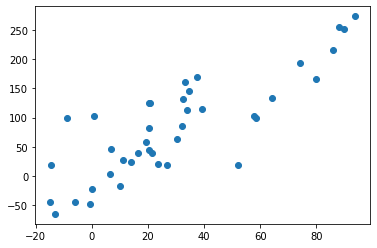

subject_10_stim_period_15_component_9   subject_10_stim_period_15_component_1   SpearmanrResult(correlation=0.8348968105065667, pvalue=2.1327026362311397e-11)   8.27349258168713


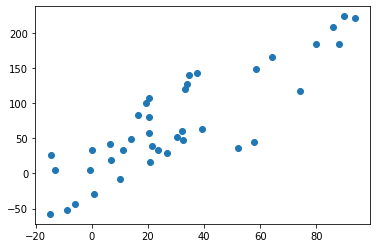

subject_10_stim_period_15_component_9   subject_10_stim_period_15_component_5   SpearmanrResult(correlation=0.8859287054409005, pvalue=3.021304488960427e-14)   2.1702250480445793


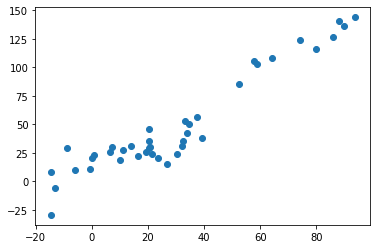

subject_10_stim_period_16_component_0   subject_10_stimulus_16_component_0   SpearmanrResult(correlation=0.9147178871548618, pvalue=1.6113755149398293e-20)   6.263627913365015


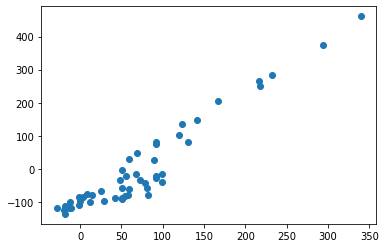

subject_10_stim_period_16_component_3   subject_10_stimulus_16_component_0   SpearmanrResult(correlation=0.918079231692677, pvalue=6.38007571695107e-21)   5.017469908300383


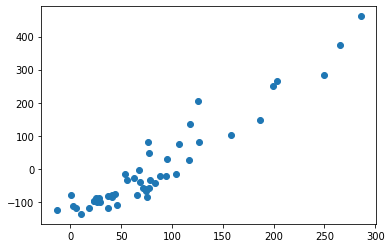

subject_10_stim_period_16_component_3   subject_10_stim_period_16_component_0   SpearmanrResult(correlation=0.8549819927971188, pvalue=2.7430753379884308e-15)   6.470105403109077


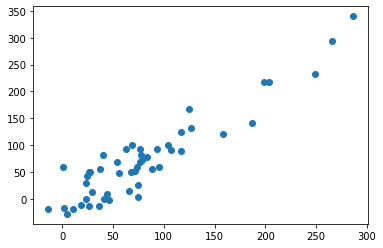

subject_10_stim_period_16_component_5   subject_10_stim_period_16_component_2   SpearmanrResult(correlation=-0.7999519807923169, pvalue=3.1967994962159278e-12)   1.7171083207612972


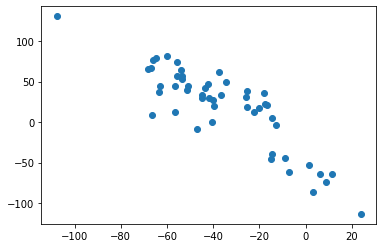

subject_10_stim_period_1_component_1   subject_10_stimulus_21_component_0   SpearmanrResult(correlation=-0.8687219090625776, pvalue=6.2505759399502226e-93)   0.5061348227917923


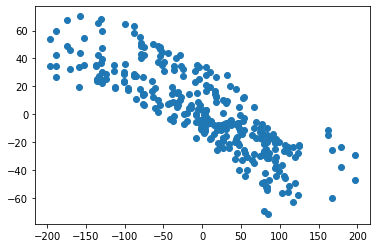

subject_10_stim_period_1_component_4   subject_10_stimulus_1_component_1   SpearmanrResult(correlation=-0.803963599595551, pvalue=3.1228537298870543e-69)   10.63779539108489


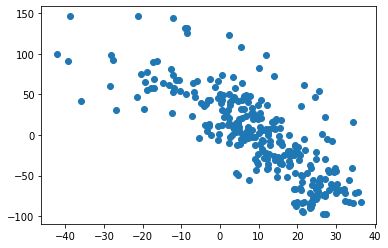

subject_10_stim_period_1_component_5   subject_10_stimulus_1_component_0   SpearmanrResult(correlation=-0.8088996544406047, pvalue=1.043584753715785e-70)   1.926587766774762


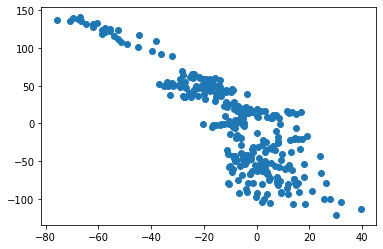

subject_10_stim_period_1_component_5   subject_10_stim_period_1_component_2   SpearmanrResult(correlation=-0.757231080345337, pvalue=4.544027735086969e-57)   1.7171083207612972


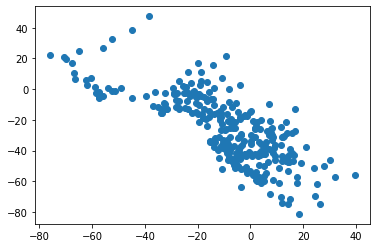

subject_10_stim_period_1_component_6   subject_10_stimulus_1_component_0   SpearmanrResult(correlation=0.8324199157768419, pvalue=2.204700784508413e-78)   2.236717824757308


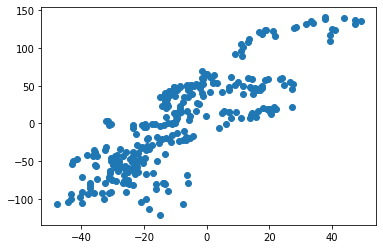

subject_10_stim_period_1_component_7   subject_10_stimulus_1_component_2   SpearmanrResult(correlation=0.7562532917032412, pvalue=7.6222653348398e-57)   1.7697400065420448


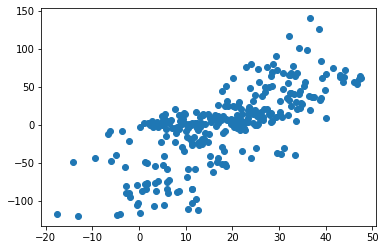

subject_10_stim_period_1_component_9   subject_10_stimulus_1_component_0   SpearmanrResult(correlation=-0.8154930610340114, pvalue=9.51499218749741e-73)   3.6260160997174893


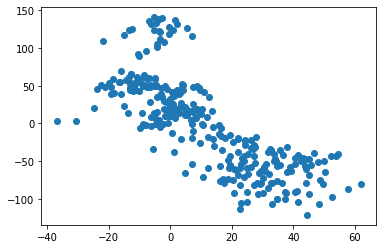

subject_10_stim_period_21_component_0   subject_10_stimulus_21_component_0   SpearmanrResult(correlation=-0.9757109204853549, pvalue=1.700428720375579e-99)   0.5061348227917923


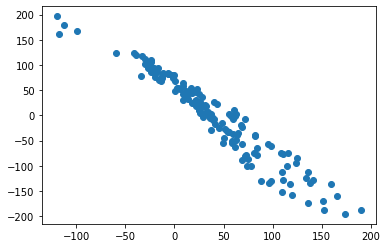

subject_10_stim_period_21_component_0   subject_10_stim_period_1_component_1   SpearmanrResult(correlation=0.7892290342494583, pvalue=4.585894482341252e-65)   9.791836993387717


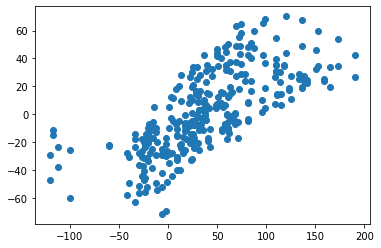

subject_10_stim_period_21_component_1   subject_10_stimulus_1_component_1   SpearmanrResult(correlation=0.8078731076985327, pvalue=2.1331267430817204e-70)   9.931602195235005


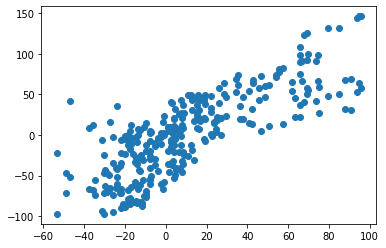

subject_10_stim_period_21_component_1   subject_10_stimulus_21_component_0   SpearmanrResult(correlation=-0.806537179430197, pvalue=1.326771540188374e-35)   0.5061348227917923


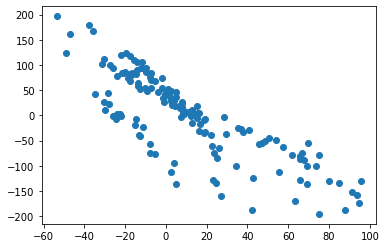

subject_10_stim_period_21_component_1   subject_10_stimulus_22_component_0   SpearmanrResult(correlation=0.7697604337970577, pvalue=1.1877896044214804e-30)   9.74738601765079


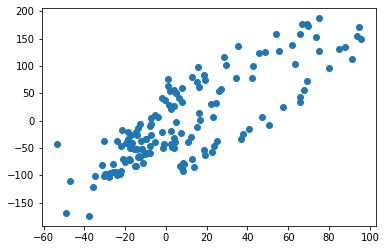

subject_10_stim_period_21_component_1   subject_10_stim_period_1_component_1   SpearmanrResult(correlation=0.8705539599531346, pvalue=8.892074421399927e-94)   10.113689508414078


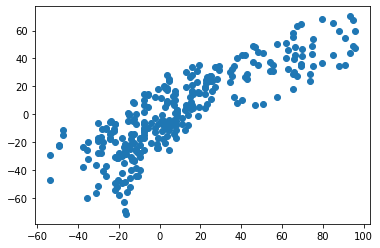

subject_10_stim_period_21_component_3   subject_10_stimulus_21_component_7   SpearmanrResult(correlation=-0.7687861682741456, pvalue=1.5605783137058662e-30)   4.346380548629264


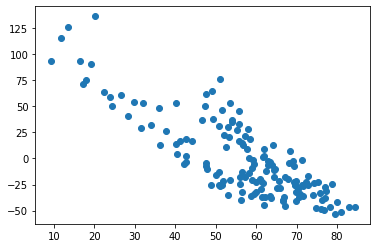

subject_10_stim_period_21_component_8   subject_10_stimulus_22_component_0   SpearmanrResult(correlation=-0.7580123561047157, pvalue=2.928192027598935e-29)   4.4962261596004645


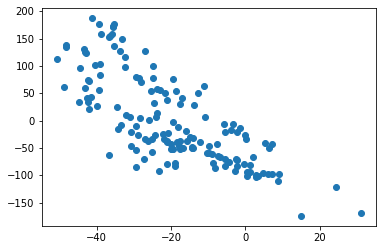

subject_10_stim_period_21_component_8   subject_10_stim_period_1_component_1   SpearmanrResult(correlation=-0.7509159699923522, pvalue=1.2297889836842125e-55)   4.439077058050393


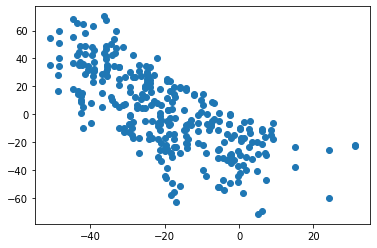

subject_10_stim_period_21_component_8   subject_10_stim_period_21_component_1   SpearmanrResult(correlation=-0.8452020089781769, pvalue=4.1480940616120124e-42)   4.439077058050393


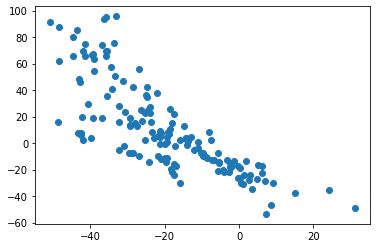

subject_10_stim_period_21_component_8   subject_10_stim_period_21_component_5   SpearmanrResult(correlation=0.7835708253700165, pvalue=2.1332979575042892e-32)   2.0785952021235086


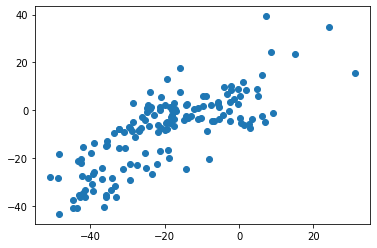

subject_10_stim_period_21_component_9   subject_10_stimulus_21_component_1   SpearmanrResult(correlation=-0.8021032045868705, pvalue=5.948642995043442e-35)   7.760050605569098


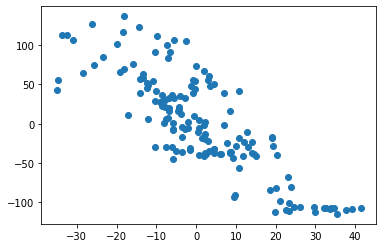

subject_10_stim_period_22_component_0   subject_10_stimulus_22_component_0   SpearmanrResult(correlation=0.9671914307302547, pvalue=5.728928497871511e-90)   12.015544531967409


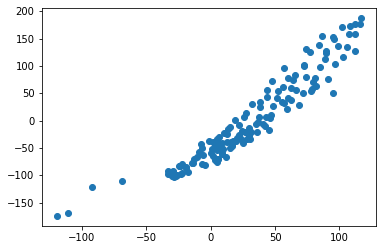

subject_10_stim_period_22_component_1   subject_10_stimulus_22_component_0   SpearmanrResult(correlation=0.86537712787235, pvalue=2.947348791101319e-46)   9.74738601765079


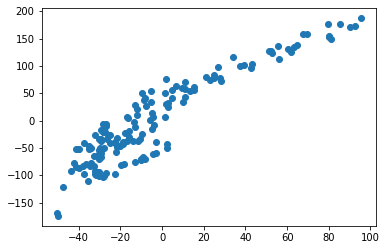

subject_10_stim_period_22_component_1   subject_10_stim_period_22_component_0   SpearmanrResult(correlation=0.8270892039646208, pvalue=7.349433657961096e-39)   9.791836993387717


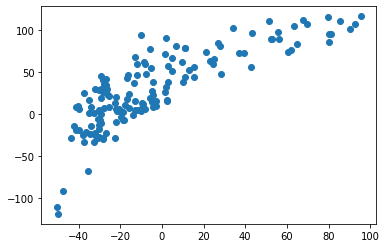

subject_10_stim_period_22_component_2   subject_10_stimulus_22_component_1   SpearmanrResult(correlation=-0.8704155740255122, pvalue=2.1269414315181973e-47)   3.3544236219520007


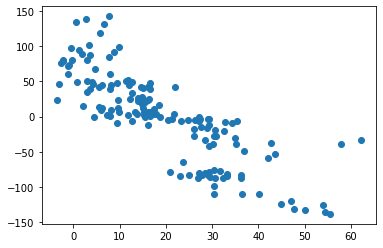

subject_10_stim_period_22_component_5   subject_10_stim_period_22_component_1   SpearmanrResult(correlation=-0.8929303524601093, pvalue=3.6965764455914172e-53)   2.1702250480445793


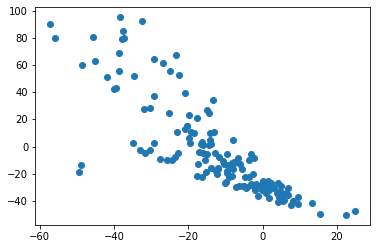

subject_10_stim_period_22_component_6   subject_10_stimulus_21_component_1   SpearmanrResult(correlation=-0.7759367082981465, pvalue=2.0390251609435455e-31)   2.805506327943913


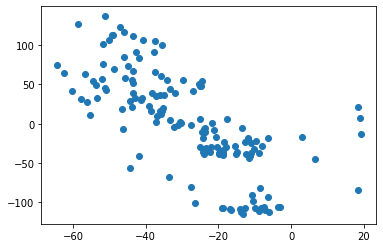

subject_10_stim_period_22_component_6   subject_10_stimulus_22_component_0   SpearmanrResult(correlation=-0.8461264945108673, pvalue=2.760395434485899e-42)   2.925532105460889


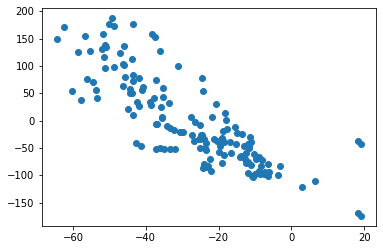

subject_10_stim_period_22_component_6   subject_10_stim_period_22_component_0   SpearmanrResult(correlation=-0.8778043468598605, pvalue=3.664975223188094e-49)   2.925532105460889


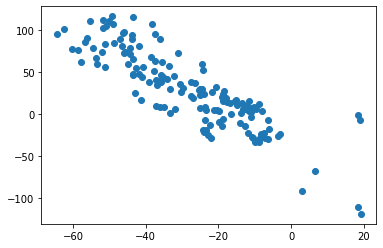

subject_10_stim_period_22_component_7   subject_10_stim_period_22_component_4   SpearmanrResult(correlation=-0.7757020312013868, pvalue=2.1824614594825185e-31)   1.7586288954309337


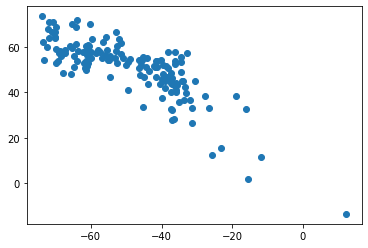

subject_10_stim_period_23_component_0   subject_10_stimulus_23_component_1   SpearmanrResult(correlation=-0.8712307807695194, pvalue=4.2096051729160057e-63)   0.7206639865185773


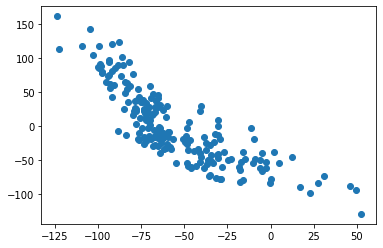

subject_10_stim_period_23_component_9   subject_10_stimulus_12_component_6   SpearmanrResult(correlation=0.759902965153898, pvalue=1.1761276438423994e-42)   9.251918349531891


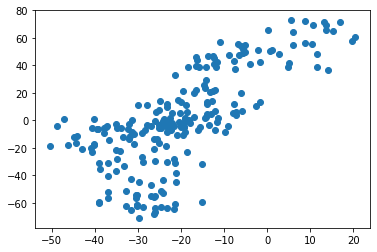

subject_10_stim_period_2_component_0   subject_10_stimulus_2_component_0   SpearmanrResult(correlation=0.8296954410604561, pvalue=1.9590834418814257e-77)   13.290732944184082


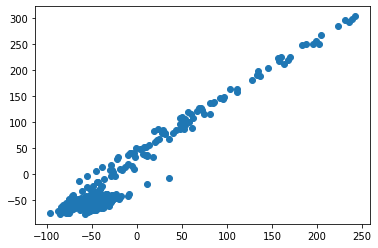

subject_10_stim_period_2_component_5   subject_10_stimulus_1_component_0   SpearmanrResult(correlation=-0.7502327803642262, pvalue=1.7466706281793282e-55)   1.926587766774762


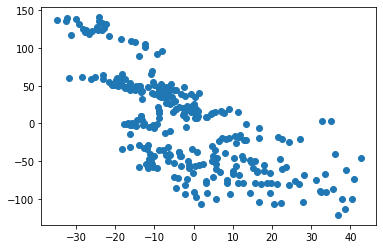

subject_10_stim_period_2_component_8   subject_10_stim_period_2_component_4   SpearmanrResult(correlation=0.7537457082856476, pvalue=2.840292774484449e-56)   4.402456067386139


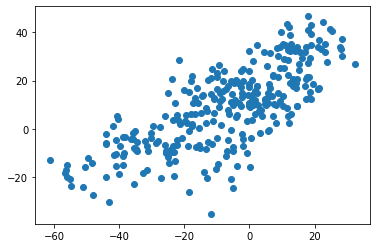

subject_10_stim_period_2_component_9   subject_10_stimulus_2_component_1   SpearmanrResult(correlation=0.8004604495605506, pvalue=3.2869525657532986e-68)   5.489458608365977


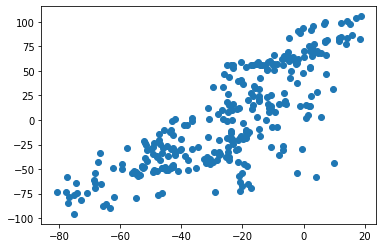

subject_10_stim_period_3_component_0   subject_10_stimulus_3_component_0   SpearmanrResult(correlation=0.8342988476565292, pvalue=2.199090930578067e-203)   8.887464172375878


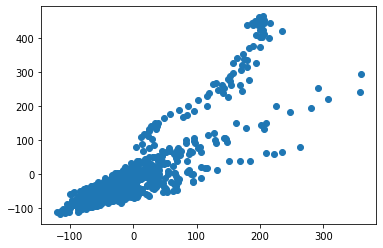

subject_10_stim_period_4_component_0   subject_10_stimulus_4_component_0   SpearmanrResult(correlation=0.897460289596752, pvalue=1.9716172601470796e-257)   7.809854519425552


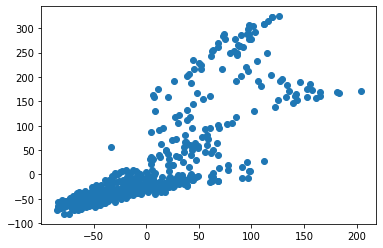

subject_10_stim_period_4_component_1   subject_10_stimulus_4_component_0   SpearmanrResult(correlation=0.7821702973964071, pvalue=1.1346058069012474e-149)   7.513477560317508


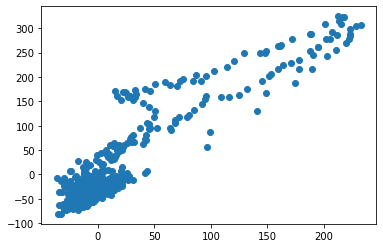

subject_10_stim_period_4_component_5   subject_10_stim_period_4_component_1   SpearmanrResult(correlation=-0.7522788752807521, pvalue=3.0421225325067215e-132)   2.1702250480445793


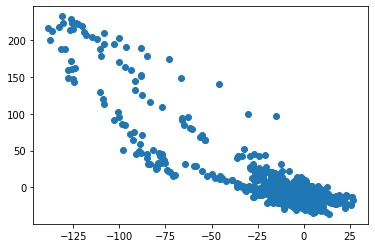

subject_10_stim_period_4_component_9   subject_10_stimulus_4_component_2   SpearmanrResult(correlation=0.7917280254527239, pvalue=7.725755703382495e-156)   5.362442906595389


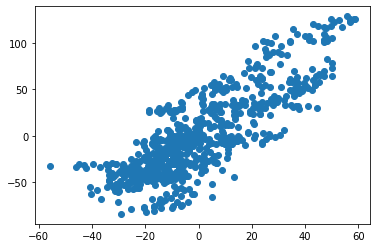

subject_10_stim_period_9_component_0   subject_10_stimulus_9_component_0   SpearmanrResult(correlation=0.9043024379838028, pvalue=2.433741846343148e-234)   13.319421233866596


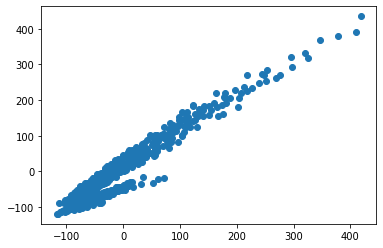

subject_10_stim_period_9_component_2   subject_10_stimulus_9_component_1   SpearmanrResult(correlation=-0.8225001706683446, pvalue=4.842780932594499e-156)   1.6892124879048556


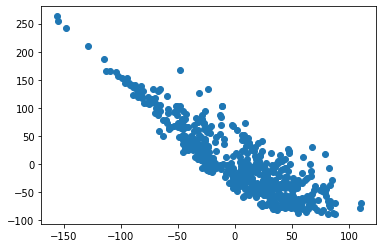

subject_10_stim_period_9_component_2   subject_10_stim_period_9_component_1   SpearmanrResult(correlation=-0.7943953835442602, pvalue=4.2166165020294146e-138)   3.9150199022661085


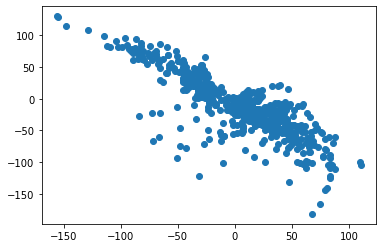

subject_12_stimulus_11_component_0   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.897158095915374, pvalue=2.2016909664666168e-54)   13.25259778061886


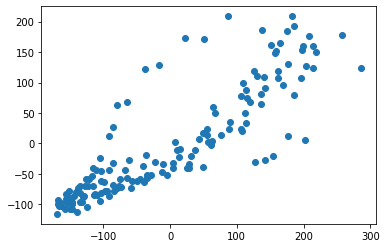

subject_12_stimulus_11_component_3   subject_10_stimulus_23_component_6   SpearmanrResult(correlation=0.7680456021301071, pvalue=3.4904907176195668e-40)   2.96827343040243


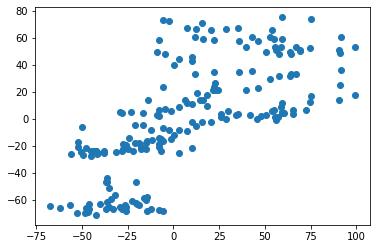

subject_12_stimulus_12_component_0   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8461798302146762, pvalue=2.6960711464814344e-42)   12.441290217598187


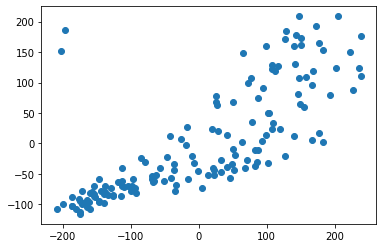

subject_12_stimulus_12_component_0   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8552646784301524, pvalue=4.2410035584456047e-44)   11.75346741236551


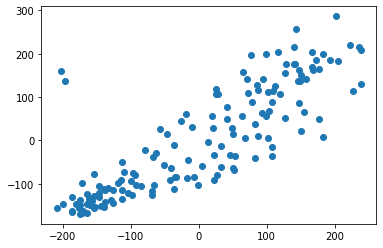

subject_12_stimulus_12_component_2   subject_10_stimulus_23_component_6   SpearmanrResult(correlation=0.7846573288960734, pvalue=5.506080520644813e-43)   4.290496163704159


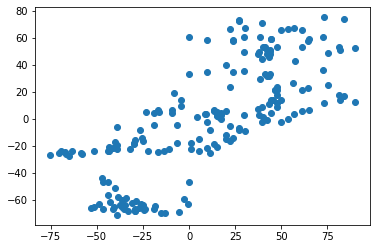

subject_12_stimulus_12_component_2   subject_12_stimulus_11_component_3   SpearmanrResult(correlation=0.8291337392773013, pvalue=3.3027510454581203e-39)   3.5282047093021442


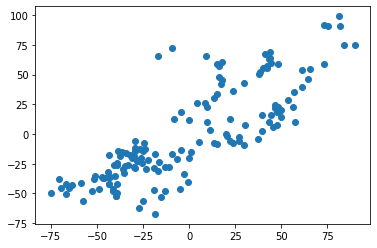

subject_12_stimulus_15_component_0   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8930769230769231, pvalue=1.9182888939284534e-09)   2.914850183478674


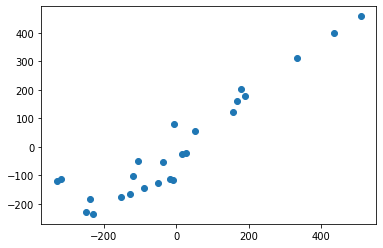

subject_12_stimulus_15_component_1   subject_12_stimulus_14_component_1   SpearmanrResult(correlation=0.7969230769230768, pvalue=1.8647589388808114e-06)   3.965214705015597


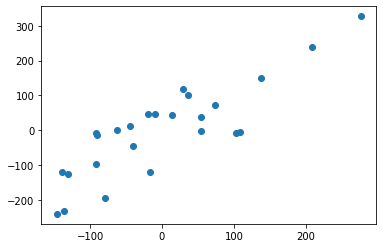

subject_12_stimulus_15_component_4   subject_12_stimulus_14_component_3   SpearmanrResult(correlation=0.786923076923077, pvalue=3.07378762355214e-06)   4.974028633556141


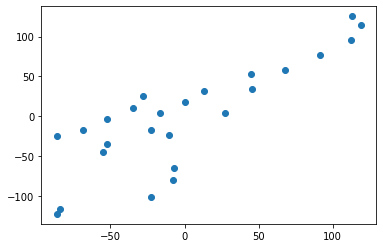

subject_12_stimulus_9_component_0   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8951491177385663, pvalue=8.5390667346994e-54)   11.453663399987464


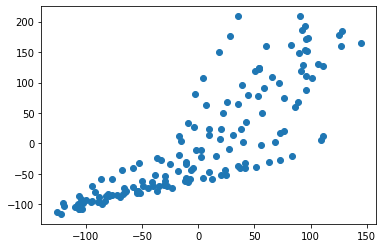

subject_12_stimulus_9_component_0   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8905053557935909, pvalue=1.7681734908579088e-52)   11.266727369782783


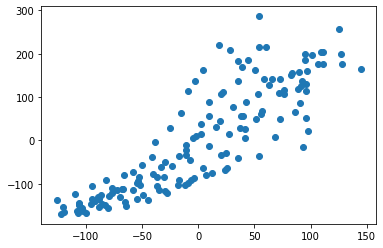

subject_12_stimulus_9_component_0   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.8058118138583937, pvalue=1.7003715931377977e-35)   10.287845708012796


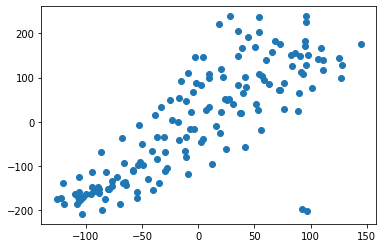

subject_12_stimulus_9_component_3   subject_12_stimulus_10_component_6   SpearmanrResult(correlation=0.7694297524334415, pvalue=1.3032905332493877e-30)   3.776139386074691


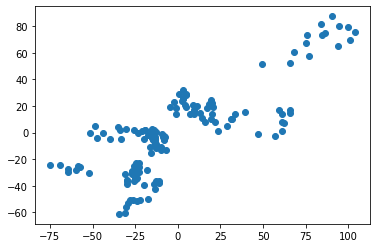

subject_12_stimulus_9_component_9   subject_12_stimulus_10_component_9   SpearmanrResult(correlation=-0.8103524601093383, pvalue=3.535627953219206e-36)   5.522693105619551


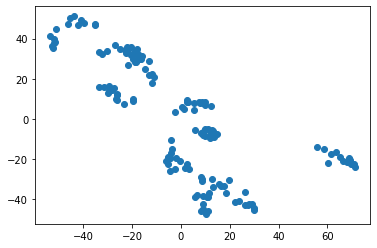

subject_12_stim_period_0_component_0   subject_12_stimulus_0_component_0   SpearmanrResult(correlation=-0.9899794799179196, pvalue=0.0)   1.9308548995919554


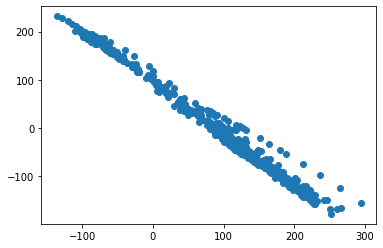

subject_12_stim_period_0_component_1   subject_12_stimulus_0_component_1   SpearmanrResult(correlation=0.8600434401737607, pvalue=1.2074021446495517e-147)   6.830465962981603


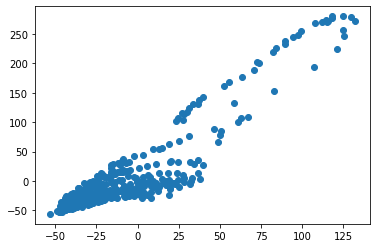

subject_12_stim_period_0_component_4   subject_12_stim_period_0_component_3   SpearmanrResult(correlation=-0.7754863979455917, pvalue=1.5936799939812325e-101)   1.4627471022553562


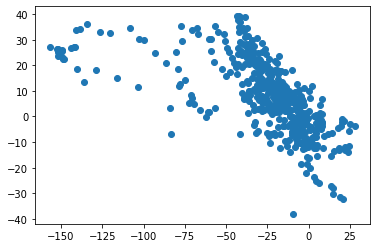

subject_12_stim_period_0_component_9   subject_12_stim_period_0_component_1   SpearmanrResult(correlation=0.8505131940527761, pvalue=4.5181625270513794e-141)   6.735755225367628


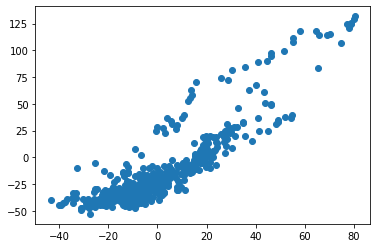

subject_12_stim_period_10_component_0   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.9961456064713987, pvalue=2.470030779160814e-158)   14.931576235516724


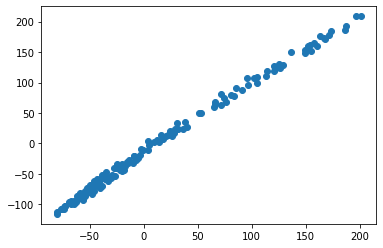

subject_12_stim_period_10_component_0   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.874038846170941, pvalue=2.997650111518581e-48)   13.493315427629101


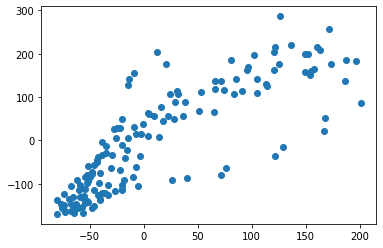

subject_12_stim_period_10_component_0   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.8355340237343883, pvalue=2.5171998760666424e-40)   12.709326284413729


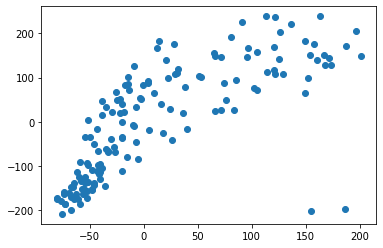

subject_12_stim_period_10_component_0   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.8865051780079115, pvalue=2.1603727833150827e-51)   11.884652003316845


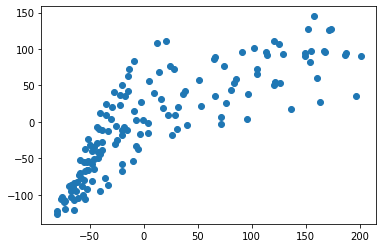

subject_12_stim_period_10_component_1   subject_12_stimulus_10_component_1   SpearmanrResult(correlation=0.7943659718209698, pvalue=7.461437169880815e-34)   5.763452530074861


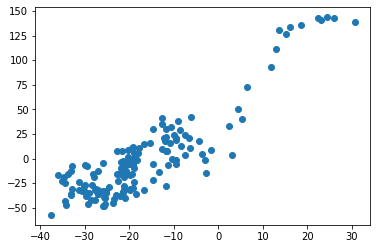

subject_12_stim_period_10_component_3   subject_12_stimulus_10_component_1   SpearmanrResult(correlation=0.7726192275212231, pvalue=5.290499387356812e-31)   6.879215759142115


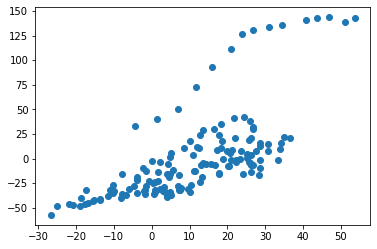

subject_12_stim_period_10_component_3   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8033761500511133, pvalue=3.8819181262584963e-35)   6.262751307355187


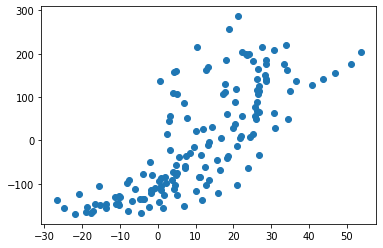

subject_12_stim_period_10_component_3   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.8432214765100671, pvalue=9.838021743543622e-42)   5.758178572081894


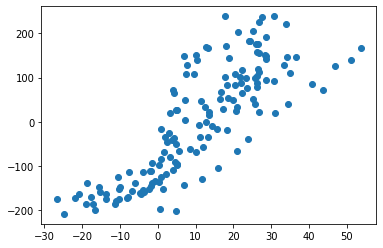

subject_12_stim_period_10_component_3   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.7580728032356995, pvalue=2.881654226512788e-29)   6.326846068429051


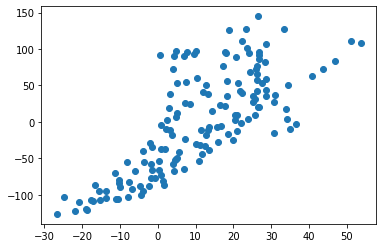

subject_12_stim_period_10_component_5   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.9675896706520292, pvalue=2.354603470169861e-90)   5.196668468539744


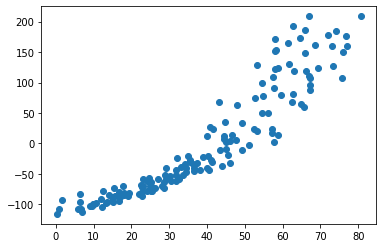

subject_12_stim_period_10_component_5   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.9179732432552559, pvalue=2.604743364298101e-61)   5.222594959312963


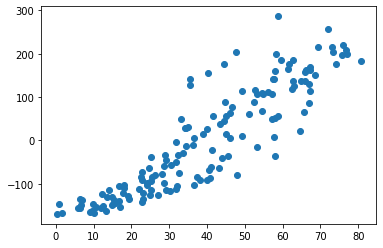

subject_12_stim_period_10_component_5   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.875866482954798, pvalue=1.090174482848234e-48)   4.9570392952481726


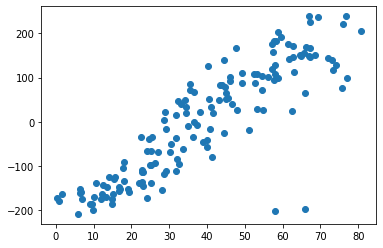

subject_12_stim_period_10_component_5   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.883017022978799, pvalue=1.7765771227797667e-50)   5.234643152084048


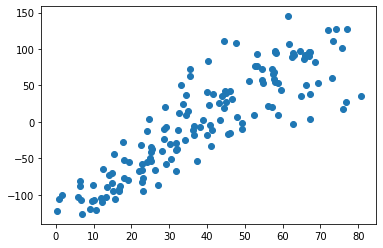

subject_12_stim_period_10_component_5   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.9585439352860128, pvalue=1.3765471798579307e-82)   5.234643152084048


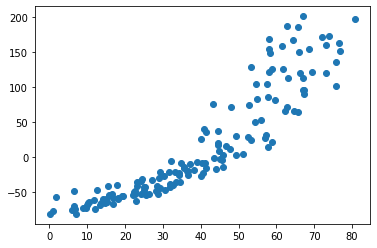

subject_12_stim_period_10_component_9   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=-0.8114511756078049, pvalue=2.4024708845269162e-36)   11.040448802413042


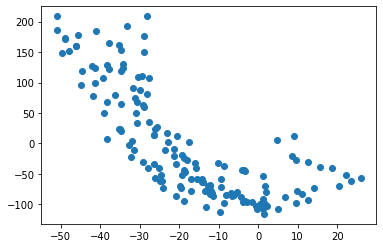

subject_12_stim_period_10_component_9   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=-0.7913827281212498, pvalue=1.9223729812997313e-33)   12.075283754013729


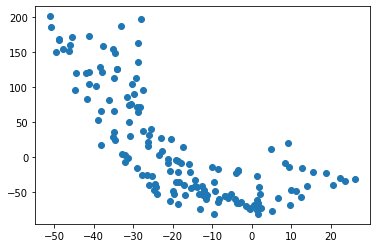

subject_12_stim_period_10_component_9   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.813609493755278, pvalue=1.1163318696006764e-36)   5.195721449827498


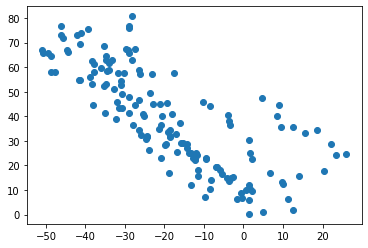

subject_12_stim_period_11_component_0   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8909960442686342, pvalue=1.2920648170499407e-52)   14.931576235516724


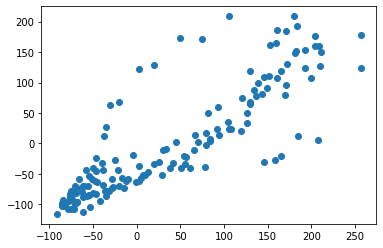

subject_12_stim_period_11_component_0   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.9967927463442819, pvalue=3.1329842775028904e-164)   13.493315427629101


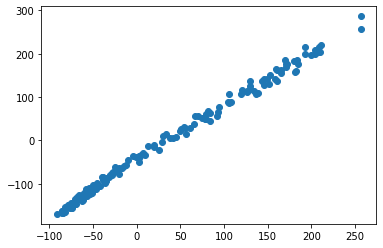

subject_12_stim_period_11_component_0   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.8372478776834528, pvalue=1.2398859650813374e-40)   12.709326284413729


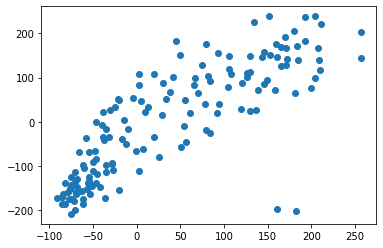

subject_12_stim_period_11_component_0   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.8907933685941598, pvalue=1.4710804990666487e-52)   11.884652003316845


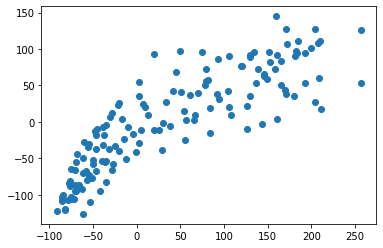

subject_12_stim_period_11_component_0   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.8680190230676919, pvalue=7.527640507503456e-47)   17.843122470352377


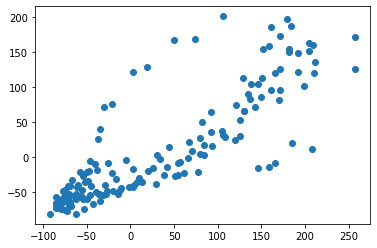

subject_12_stim_period_11_component_0   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.781014267300769, pvalue=4.5892600638274545e-32)   6.80951709246243


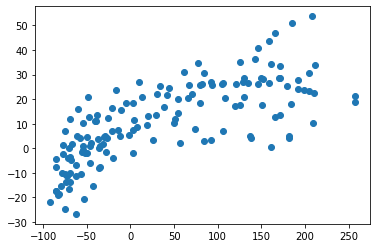

subject_12_stim_period_11_component_0   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.9107231432508112, pvalue=1.045702740049132e-58)   5.234643152084048


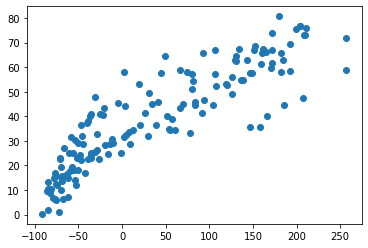

subject_12_stim_period_11_component_1   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.828038579492422, pvalue=5.075976989460465e-39)   6.437746760406727


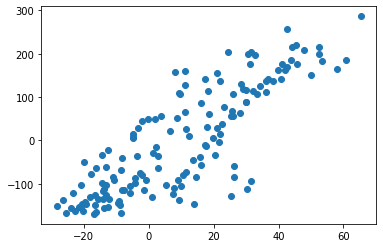

subject_12_stim_period_11_component_1   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.8170229787990578, pvalue=3.2540697801110886e-37)   6.972429079211206


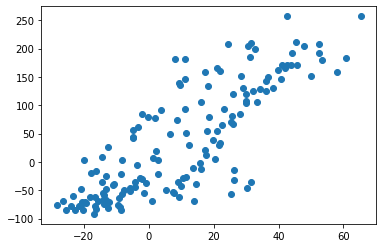

subject_12_stim_period_11_component_2   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.9157189208409262, pvalue=1.7796579542889874e-60)   4.729460820794367


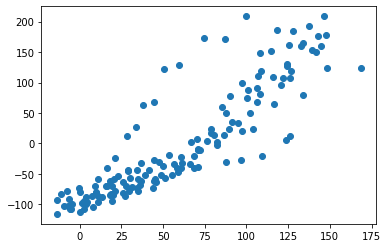

subject_12_stim_period_11_component_2   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.9922876572292102, pvalue=4.199833315849022e-136)   4.686634276522041


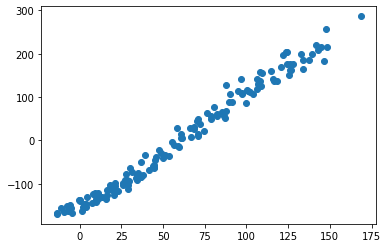

subject_12_stim_period_11_component_2   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.8739001733410374, pvalue=3.234685572697807e-48)   4.500706655521503


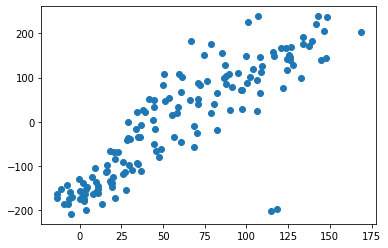

subject_12_stim_period_11_component_2   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.889811991644073, pvalue=2.7474907472880098e-52)   4.753557206336536


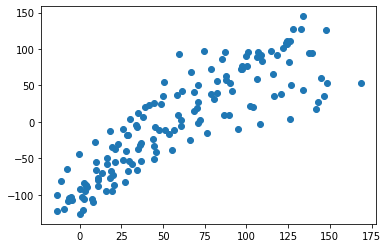

subject_12_stim_period_11_component_2   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.8936379394639763, pvalue=2.3247685859326856e-53)   4.774827047606378


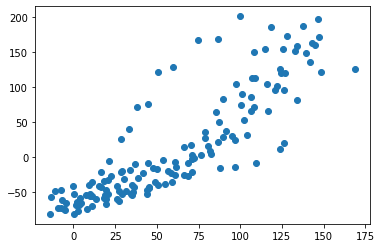

subject_12_stim_period_11_component_2   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.794262856126939, pvalue=7.711561687043657e-34)   4.271486326962424


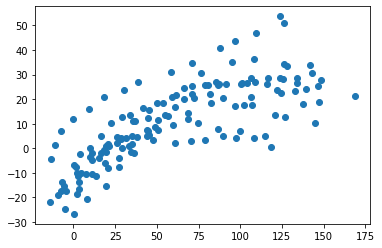

subject_12_stim_period_11_component_2   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.9380025778923509, pvalue=5.537933622841428e-70)   3.8755807080126914


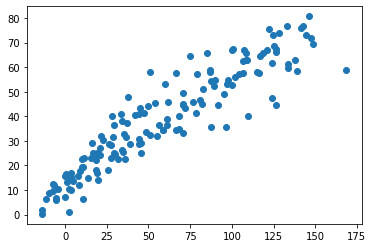

subject_12_stim_period_11_component_2   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.9851620072003201, pvalue=3.4765007552377584e-115)   4.774827047606378


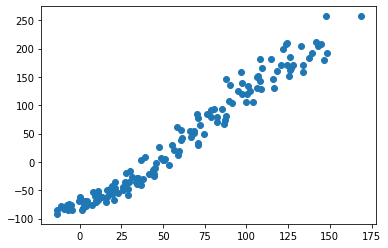

subject_12_stim_period_11_component_2   subject_12_stim_period_11_component_1   SpearmanrResult(correlation=0.8376781190275123, pvalue=1.036616014285254e-40)   3.9576875339877207


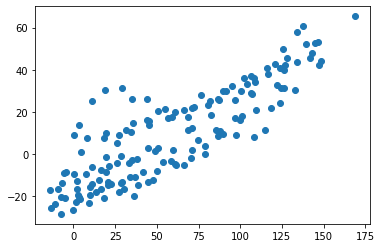

subject_12_stim_period_11_component_3   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8753615716254056, pvalue=1.4439281620328424e-48)   6.516007559951657


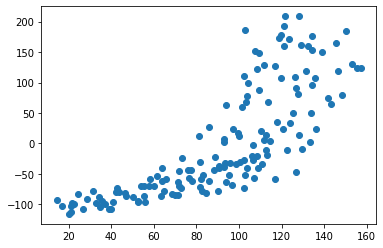

subject_12_stim_period_11_component_3   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.9125578914618427, pvalue=2.410134425815371e-59)   6.262751307355187


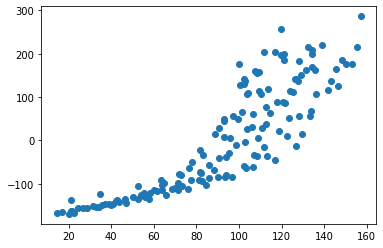

subject_12_stim_period_11_component_3   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.8738681719187521, pvalue=3.2919536330955494e-48)   5.758178572081894


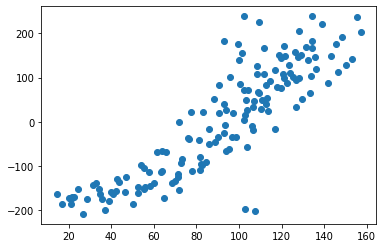

subject_12_stim_period_11_component_3   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.804304191297391, pvalue=2.838204946133415e-35)   6.326846068429051


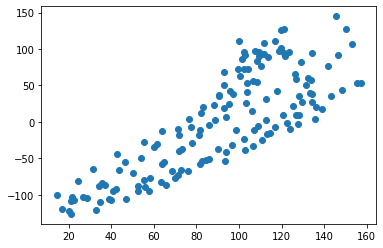

subject_12_stim_period_11_component_3   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.8498386594959777, pvalue=5.234071156568199e-43)   6.80951709246243


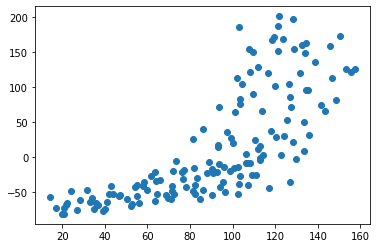

subject_12_stim_period_11_component_3   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.7987572781012491, pvalue=1.8000989248625345e-34)   7.196902859306155


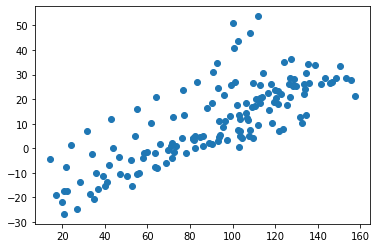

subject_12_stim_period_11_component_3   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8929481310280458, pvalue=3.653896225071861e-53)   4.030031027858057


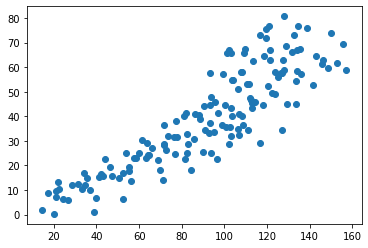

subject_12_stim_period_11_component_3   subject_12_stim_period_10_component_9   SpearmanrResult(correlation=-0.756451397839904, pvalue=4.4214796222258324e-29)   6.652726867336754


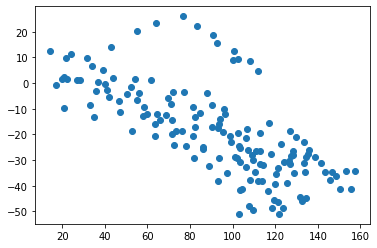

subject_12_stim_period_11_component_3   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.8906902529001288, pvalue=1.5713183404190607e-52)   6.80951709246243


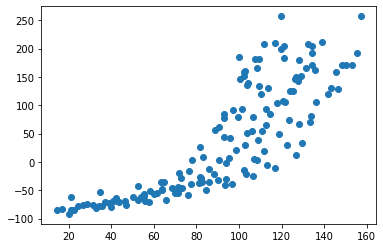

subject_12_stim_period_11_component_3   subject_12_stim_period_11_component_1   SpearmanrResult(correlation=0.8408391484065959, pvalue=2.7366924803718003e-41)   4.812024012546823


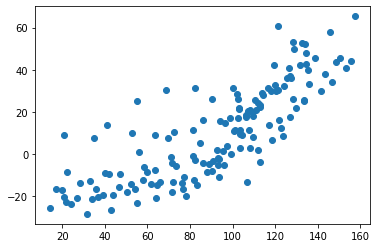

subject_12_stim_period_11_component_3   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.9312716120716477, pvalue=8.851997360412153e-67)   4.271486326962424


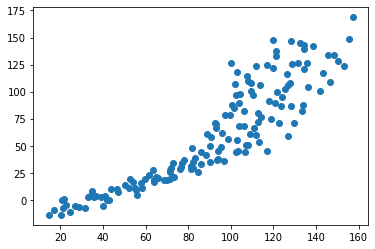

subject_12_stim_period_11_component_4   subject_12_stimulus_11_component_2   SpearmanrResult(correlation=-0.7789092848571049, pvalue=8.557167623184748e-32)   1.4334411041840291


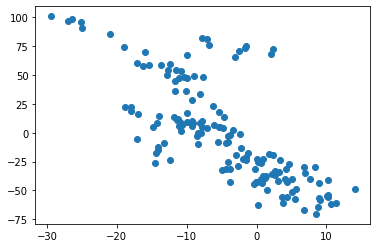

subject_12_stim_period_11_component_5   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.7906253611271612, pvalue=2.4384664846454488e-33)   5.196668468539744


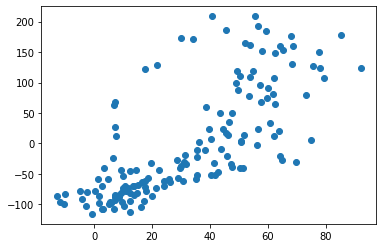

subject_12_stim_period_11_component_5   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.9452064536201609, pvalue=7.756083208674402e-74)   5.222594959312963


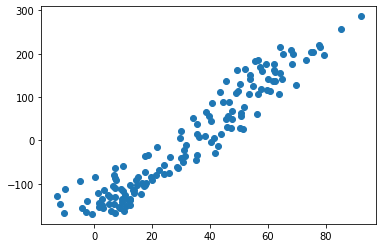

subject_12_stim_period_11_component_5   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.7780381350282236, pvalue=1.1052110101459327e-31)   4.9570392952481726


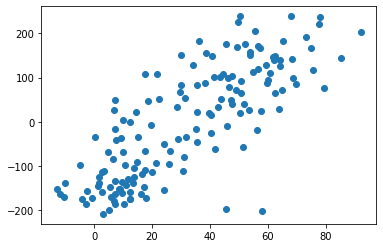

subject_12_stim_period_11_component_5   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.8324938886172719, pvalue=8.666376953551055e-40)   5.234643152084048


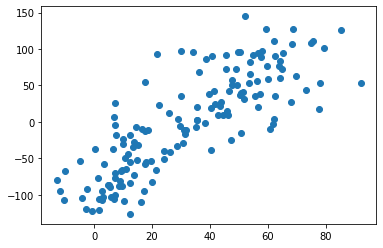

subject_12_stim_period_11_component_5   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.7650953375705586, pvalue=4.336687231306813e-30)   5.234643152084048


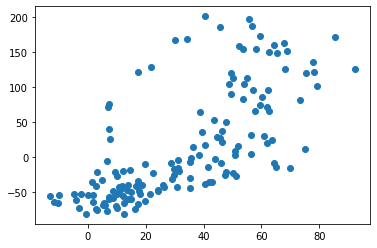

subject_12_stim_period_11_component_5   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.818313702831237, pvalue=2.028017545167376e-37)   4.030031027858057


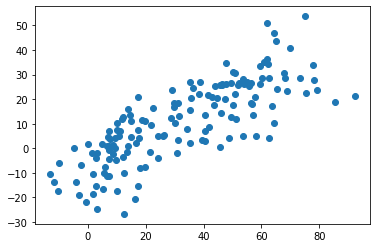

subject_12_stim_period_11_component_5   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8235441575181119, pvalue=2.870105050655279e-38)   5.234643152084048


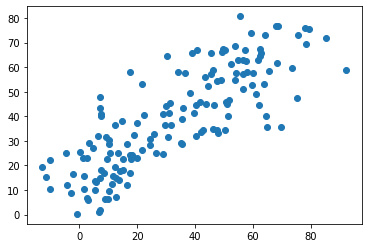

subject_12_stim_period_11_component_5   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.9389092848571048, pvalue=1.9252341602331994e-70)   5.234643152084048


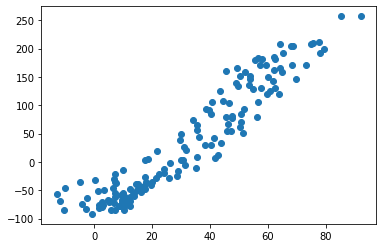

subject_12_stim_period_11_component_5   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.9248108804835771, pvalue=5.366867149355395e-64)   3.8755807080126914


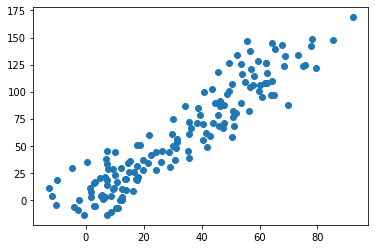

subject_12_stim_period_11_component_5   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=0.8425316680741367, pvalue=1.3253168414250008e-41)   4.030031027858057


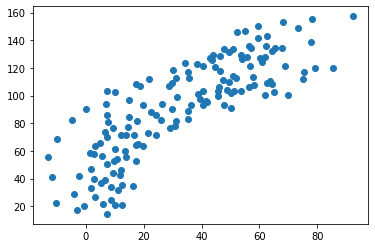

subject_12_stim_period_11_component_8   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=-0.7767509667096315, pvalue=1.6095532510148276e-31)   4.311341470668168


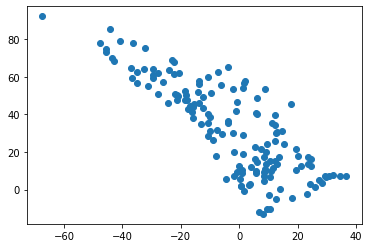

subject_12_stim_period_11_component_9   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=-0.7875958931508067, pvalue=6.251791328032695e-33)   11.040448802413042


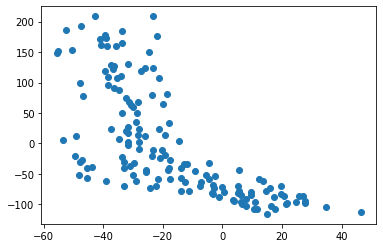

subject_12_stim_period_11_component_9   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=-0.7615218454153518, pvalue=1.1461232592752948e-29)   10.807766099512687


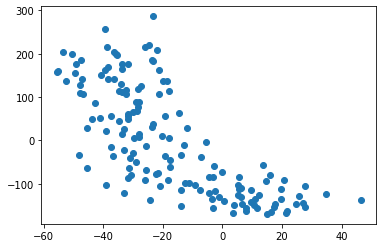

subject_12_stim_period_11_component_9   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=-0.8916182941464066, pvalue=8.661142709475054e-53)   10.50395812844763


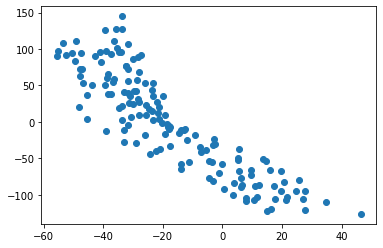

subject_12_stim_period_11_component_9   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=-0.7896582070314236, pvalue=3.29902027526884e-33)   12.075283754013729


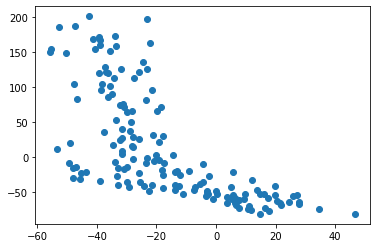

subject_12_stim_period_11_component_9   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=-0.7720823147695454, pvalue=6.163870605929251e-31)   12.075283754013729


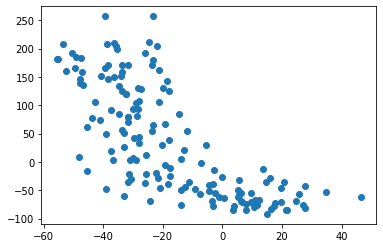

subject_12_stim_period_12_component_0   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8416854082403664, pvalue=1.906492918294346e-41)   14.931576235516724


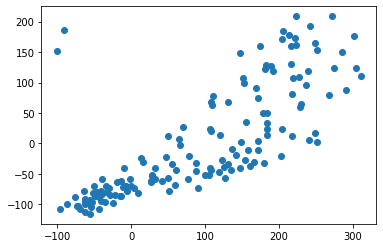

subject_12_stim_period_12_component_0   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8509124849993334, pvalue=3.2085143221674452e-43)   13.493315427629101


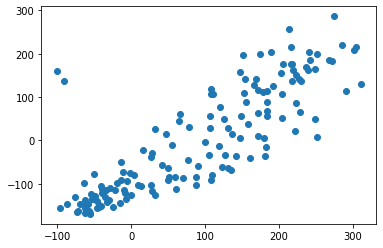

subject_12_stim_period_12_component_0   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.9992390772923242, pvalue=1.9933898882202415e-210)   12.709326284413729


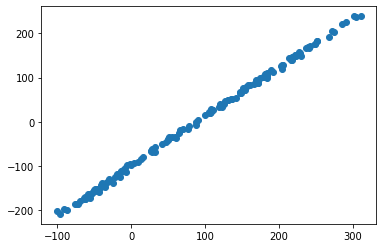

subject_12_stim_period_12_component_0   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.7998702164540646, pvalue=1.2484081348725884e-34)   11.884652003316845


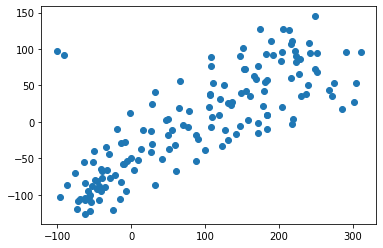

subject_12_stim_period_12_component_0   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.8312813902840126, pvalue=1.409222464667997e-39)   17.843122470352377


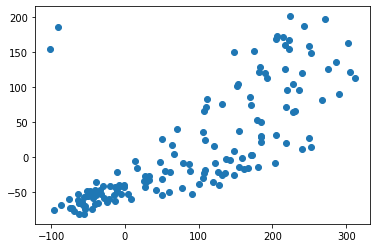

subject_12_stim_period_12_component_0   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.8410204897995467, pvalue=2.533159087553177e-41)   6.80951709246243


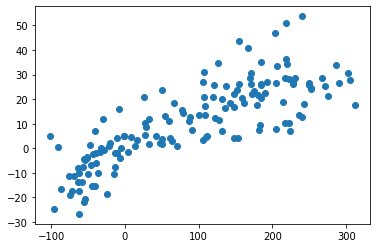

subject_12_stim_period_12_component_0   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8722432108093694, pvalue=7.975448431674904e-48)   5.234643152084048


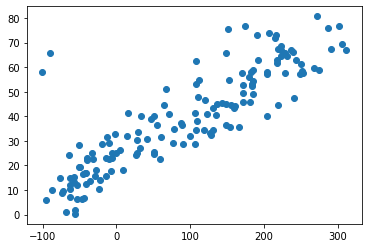

subject_12_stim_period_12_component_0   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.8322663229476865, pvalue=9.497166097340727e-40)   17.843122470352377


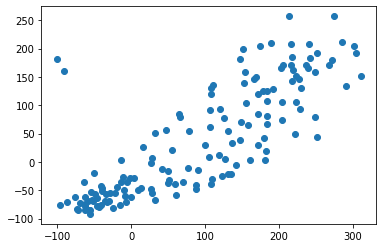

subject_12_stim_period_12_component_0   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.8705080225787813, pvalue=2.0247089552218156e-47)   4.774827047606378


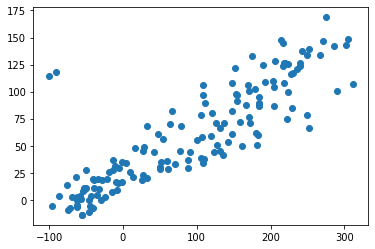

subject_12_stim_period_12_component_0   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=0.8716351837859461, pvalue=1.1071413733765775e-47)   6.80951709246243


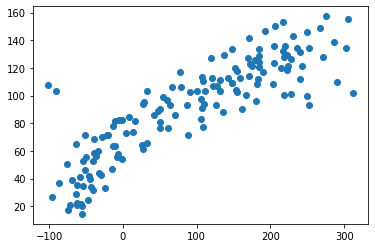

subject_12_stim_period_12_component_0   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=0.7738423929952442, pvalue=3.7294550192285006e-31)   5.234643152084048


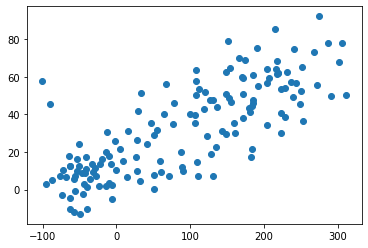

subject_12_stim_period_12_component_5   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8541126272278768, pvalue=7.292487362248817e-44)   5.196668468539744


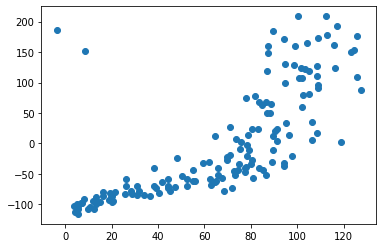

subject_12_stim_period_12_component_5   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8627245655362461, pvalue=1.1274128767636148e-45)   5.222594959312963


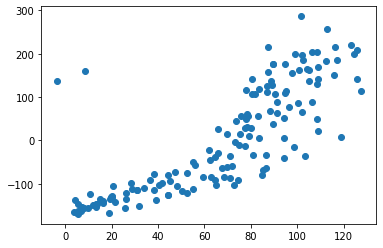

subject_12_stim_period_12_component_5   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.9652322325436687, pvalue=3.89890122792392e-88)   4.9570392952481726


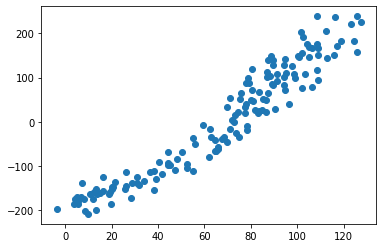

subject_12_stim_period_12_component_5   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.8369705320236456, pvalue=1.3912029543120076e-40)   5.234643152084048


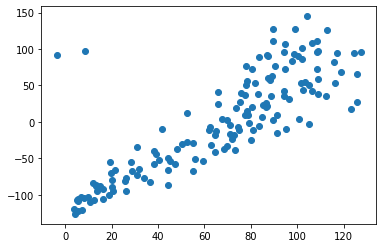

subject_12_stim_period_12_component_5   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.8424356638072804, pvalue=1.3812786828521778e-41)   5.234643152084048


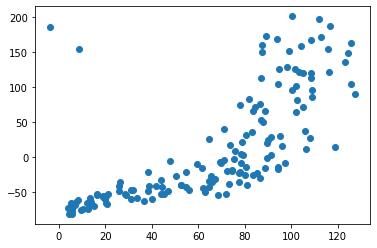

subject_12_stim_period_12_component_5   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.8266802969020844, pvalue=8.613553038951738e-39)   4.030031027858057


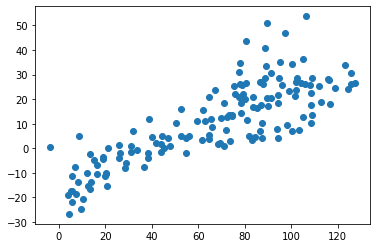

subject_12_stim_period_12_component_5   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8752157873683275, pvalue=1.5656206207859804e-48)   5.234643152084048


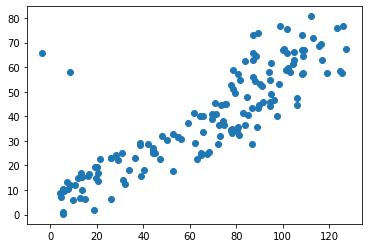

subject_12_stim_period_12_component_5   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.8525125561136051, pvalue=1.5363581994176035e-43)   5.234643152084048


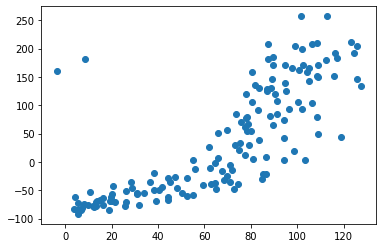

subject_12_stim_period_12_component_5   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.8690359571536513, pvalue=4.416359338360002e-47)   3.8755807080126914


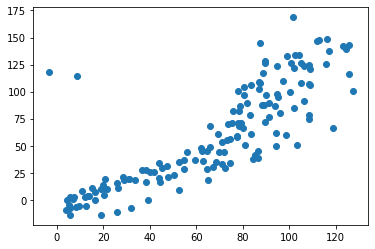

subject_12_stim_period_12_component_5   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=0.841141384061514, pvalue=2.40582142995749e-41)   4.030031027858057


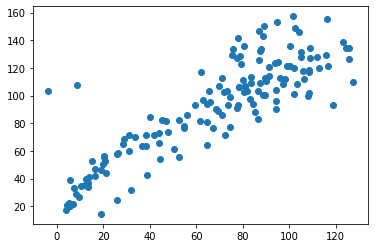

subject_12_stim_period_12_component_5   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=0.7879692430774702, pvalue=5.571537493536586e-33)   5.234643152084048


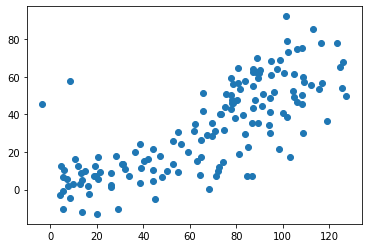

subject_12_stim_period_12_component_5   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=0.9588781723632162, pvalue=7.655378951953215e-83)   5.234643152084048


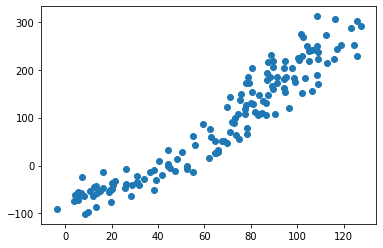

subject_12_stim_period_12_component_6   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=-0.7744859771545403, pvalue=3.100018877764628e-31)   2.9834486289341493


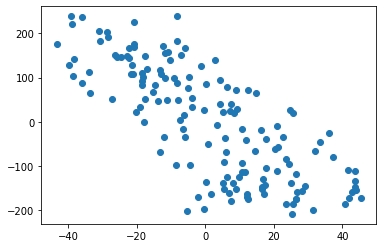

subject_12_stim_period_12_component_6   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=-0.7743153029023514, pvalue=3.2559682610707553e-31)   3.256128722336447


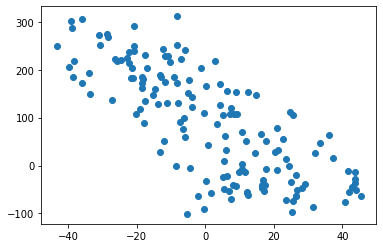

subject_12_stim_period_12_component_7   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8563029467976355, pvalue=2.591541224993881e-44)   3.078269688708536


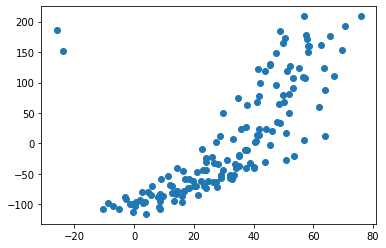

subject_12_stim_period_12_component_7   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8832303657940354, pvalue=1.5647984877904911e-50)   3.0273248152455396


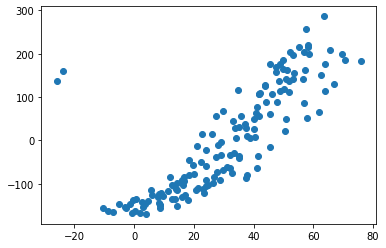

subject_12_stim_period_12_component_7   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.9294795324236633, pvalue=5.5625960161698e-66)   2.9014447859720285


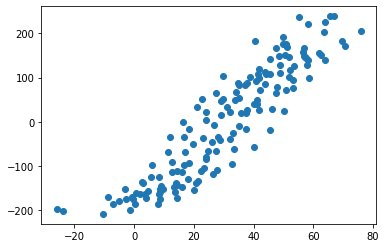

subject_12_stim_period_12_component_7   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.8389866216276279, pvalue=5.993911347294939e-41)   3.0607615073153616


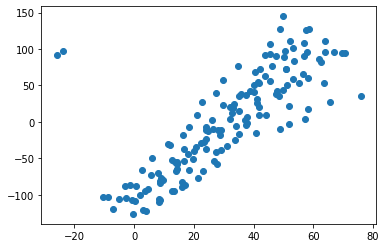

subject_12_stim_period_12_component_7   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.8444339748433264, pvalue=5.8065041906082e-42)   3.16429119408488


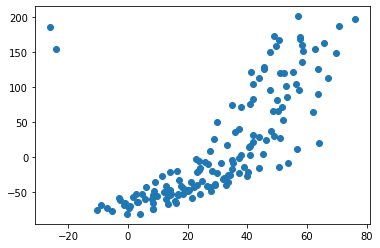

subject_12_stim_period_12_component_7   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.7983448153251256, pvalue=2.0603804862612863e-34)   2.879151464003711


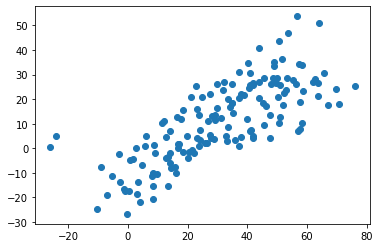

subject_12_stim_period_12_component_7   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8727943464153964, pvalue=5.915671845425448e-48)   2.7440963323111696


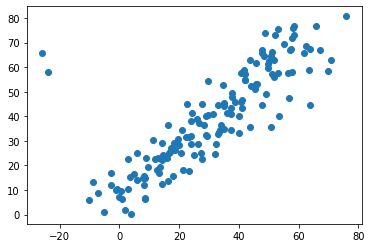

subject_12_stim_period_12_component_7   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.8725205564691764, pvalue=6.863354812152238e-48)   3.16429119408488


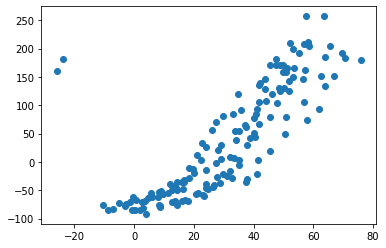

subject_12_stim_period_12_component_7   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.8821138717276324, pvalue=3.0322542447112397e-50)   2.63018723723544


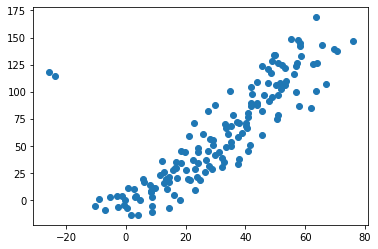

subject_12_stim_period_12_component_7   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=0.8257309213742833, pvalue=1.2431457252825727e-38)   2.879151464003711


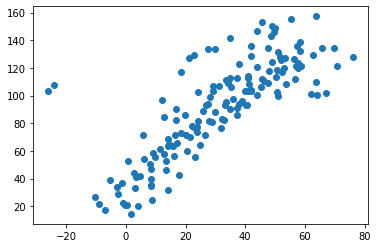

subject_12_stim_period_12_component_7   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=0.8185234899328859, pvalue=1.8773288690457997e-37)   2.7440963323111696


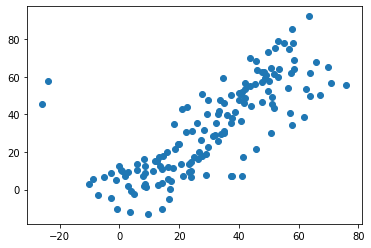

subject_12_stim_period_12_component_7   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=0.9253015689586204, pvalue=3.367172881875462e-64)   3.16429119408488


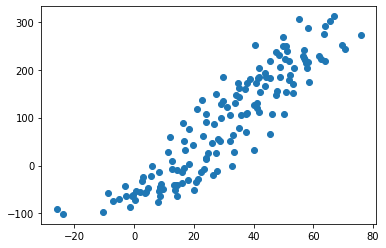

subject_12_stim_period_12_component_7   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=0.9433894839770658, pvalue=8.106671561711152e-73)   2.7440963323111696


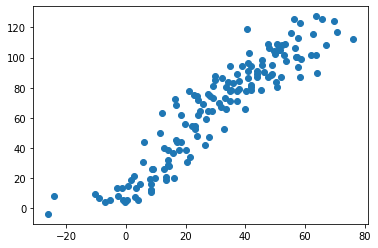

subject_12_stim_period_12_component_9   subject_12_stimulus_12_component_1   SpearmanrResult(correlation=0.7517400773367705, pvalue=1.505400727394387e-28)   11.08655480066585


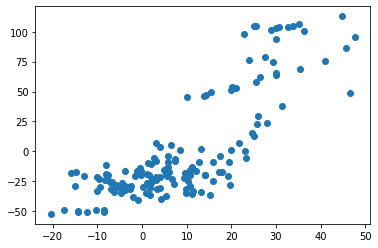

subject_12_stim_period_14_component_0   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.826923076923077, pvalue=3.4730186458766747e-07)   7.328155066117448


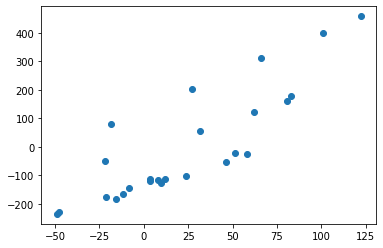

subject_12_stim_period_14_component_0   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.8369230769230769, pvalue=1.8453240094832215e-07)   3.0717305704523294


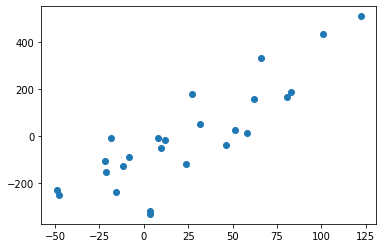

subject_12_stim_period_14_component_1   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.9823076923076923, pvalue=3.093634431899088e-18)   6.078320428691907


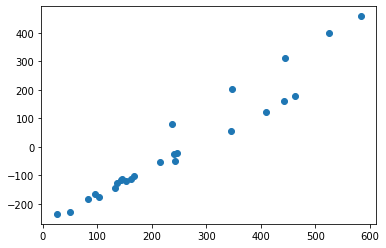

subject_12_stim_period_14_component_1   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.8653846153846154, pvalue=2.354599919958928e-08)   2.641137027448077


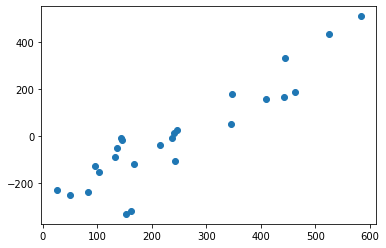

subject_12_stim_period_14_component_1   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.8523076923076923, pvalue=6.393614621948476e-08)   6.972429079211206


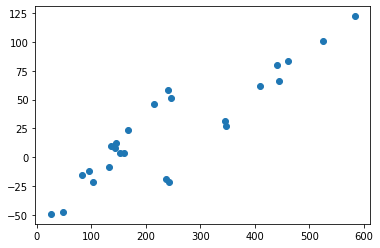

subject_12_stim_period_14_component_2   subject_12_stimulus_14_component_1   SpearmanrResult(correlation=0.9876923076923078, pvalue=4.890432519510537e-20)   3.3661902383055007


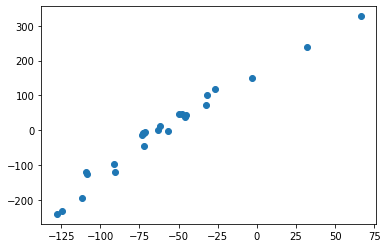

subject_12_stim_period_14_component_2   subject_12_stimulus_15_component_1   SpearmanrResult(correlation=0.8369230769230769, pvalue=1.8453240094832215e-07)   4.198150353394297


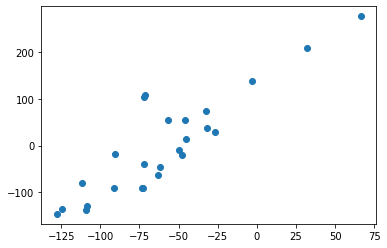

subject_12_stim_period_14_component_3   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=-0.9730769230769231, pvalue=3.696837580231582e-16)   5.131555522496118


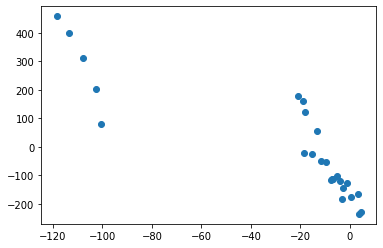

subject_12_stim_period_14_component_3   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=-0.8853846153846154, pvalue=4.101516052437055e-09)   2.7491326746789433


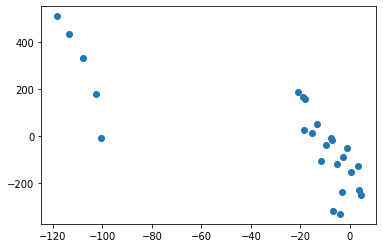

subject_12_stim_period_14_component_3   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=-0.7746153846153846, pvalue=5.4910313522294255e-06)   6.80951709246243


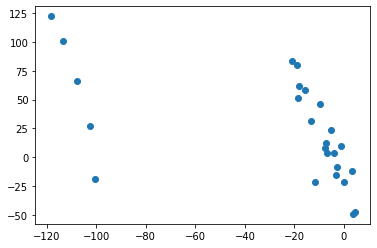

subject_12_stim_period_14_component_3   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=-0.9407692307692307, pvalue=2.7329920722149496e-12)   4.812024012546823


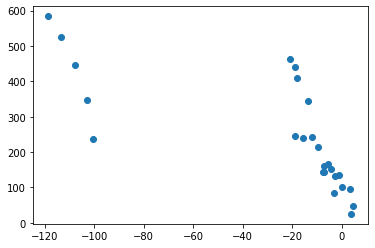

subject_12_stim_period_14_component_4   subject_12_stimulus_14_component_1   SpearmanrResult(correlation=-0.9184615384615386, pvalue=9.655105588969898e-11)   1.4783486804521164


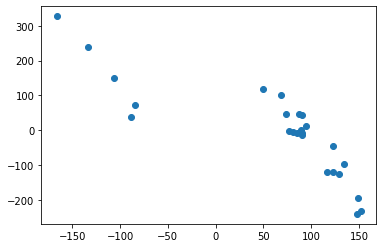

subject_12_stim_period_14_component_4   subject_12_stimulus_15_component_1   SpearmanrResult(correlation=-0.8015384615384615, pvalue=1.4668761990802731e-06)   1.5878894862946822


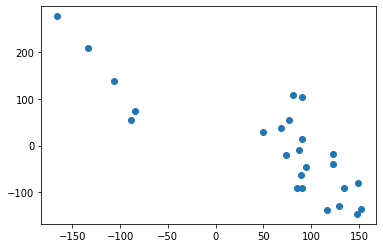

subject_12_stim_period_14_component_4   subject_12_stim_period_14_component_2   SpearmanrResult(correlation=-0.9207692307692308, pvalue=7.020721162428648e-11)   1.5850995356569526


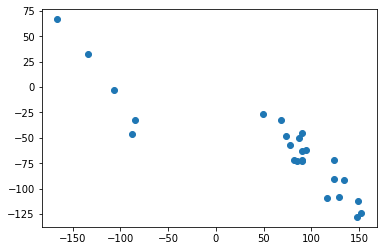

subject_12_stim_period_14_component_5   subject_10_stimulus_15_component_6   SpearmanrResult(correlation=0.8362358327013637, pvalue=1.849720815447402e-11)   4.720250911651845


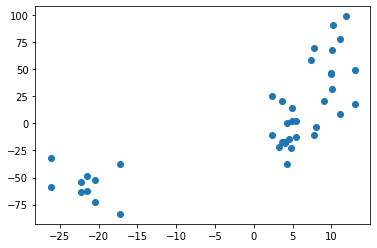

subject_12_stim_period_14_component_6   subject_12_stim_period_14_component_5   SpearmanrResult(correlation=-0.83, pvalue=2.871341041256128e-07)   2.6278652564503915


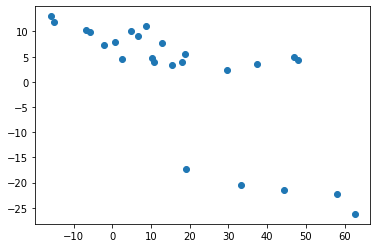

subject_12_stim_period_14_component_7   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=-0.86, pvalue=3.595829136085254e-08)   3.0503505237471025


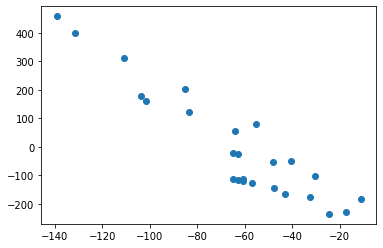

subject_12_stim_period_14_component_7   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=-0.8638461538461538, pvalue=2.662233307673707e-08)   2.1568166695129696


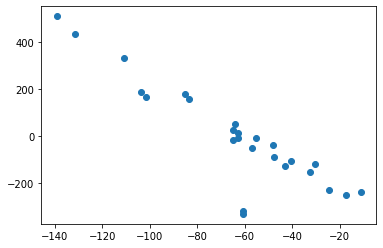

subject_12_stim_period_14_component_7   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=-0.8723076923076923, pvalue=1.329260964941849e-08)   3.16429119408488


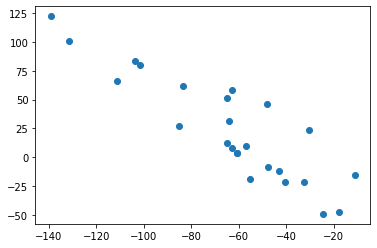

subject_12_stim_period_14_component_7   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=-0.8584615384615385, pvalue=4.0452809239794703e-08)   3.0127378488894623


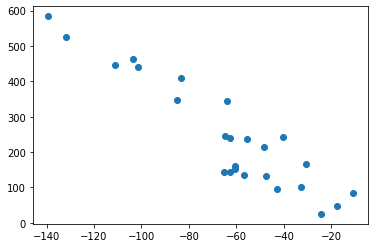

subject_12_stim_period_14_component_7   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=0.8376923076923077, pvalue=1.7546593840860256e-07)   2.879151464003711


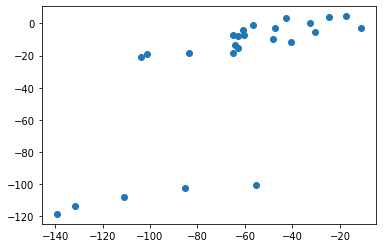

subject_12_stim_period_14_component_8   subject_12_stimulus_14_component_1   SpearmanrResult(correlation=-0.76, pvalue=1.0457350812684749e-05)   3.392177022685619


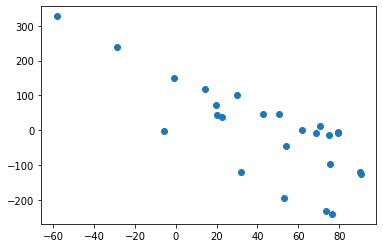

subject_12_stim_period_14_component_8   subject_12_stim_period_14_component_2   SpearmanrResult(correlation=-0.8046153846153845, pvalue=1.2456660325798921e-06)   3.7383024862278473


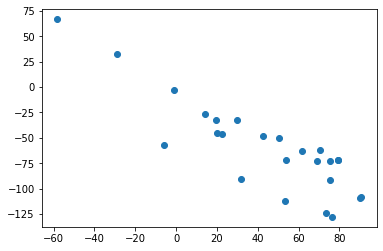

subject_12_stim_period_14_component_9   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=-0.9053846153846155, pvalue=5.001934833117573e-10)   7.181235416705963


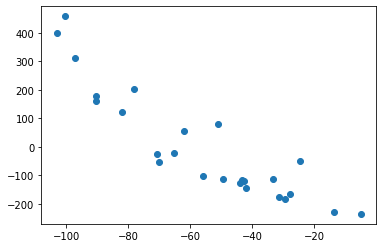

subject_12_stim_period_14_component_9   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=-0.8984615384615385, pvalue=1.0880989719535454e-09)   3.0717305704523294


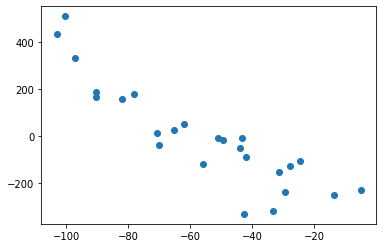

subject_12_stim_period_14_component_9   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=-0.953076923076923, pvalue=1.9939273914438468e-13)   12.075283754013729


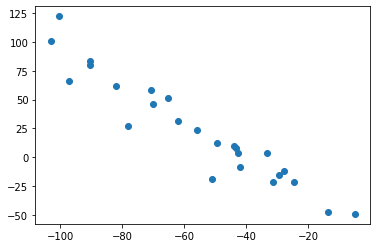

subject_12_stim_period_14_component_9   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=-0.8953846153846154, pvalue=1.5101230393747547e-09)   6.735755225367628


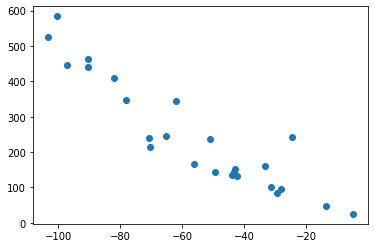

subject_12_stim_period_14_component_9   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=0.8730769230769231, pvalue=1.2449140740702674e-08)   6.652726867336754


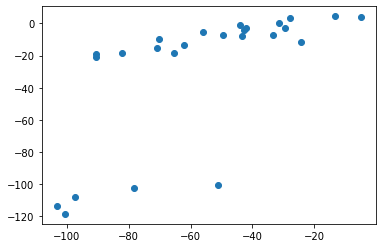

subject_12_stim_period_14_component_9   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=0.8761538461538461, pvalue=9.536583197871728e-09)   3.0693402824439264


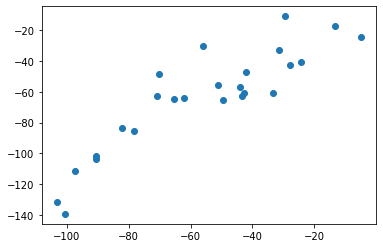

subject_12_stim_period_15_component_0   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8207692307692308, pvalue=5.026212792756227e-07)   7.328155066117448


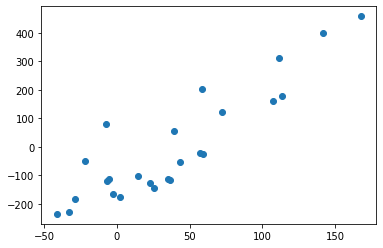

subject_12_stim_period_15_component_0   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.9007692307692308, pvalue=8.45101260996435e-10)   3.0717305704523294


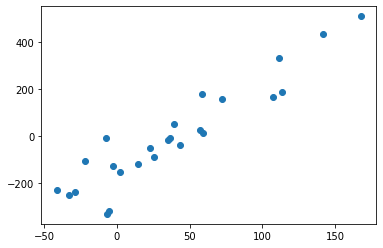

subject_12_stim_period_15_component_0   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.9576923076923078, pvalue=6.200951959732595e-14)   17.843122470352377


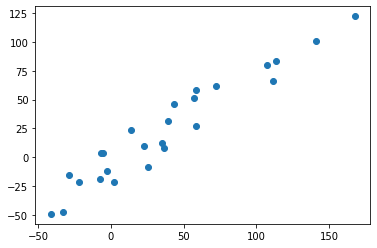

subject_12_stim_period_15_component_0   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.8338461538461539, pvalue=2.2515669455692338e-07)   6.972429079211206


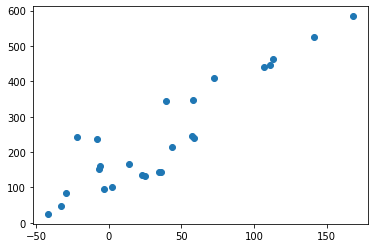

subject_12_stim_period_15_component_0   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.7784615384615384, pvalue=4.5984072840034945e-06)   6.80951709246243


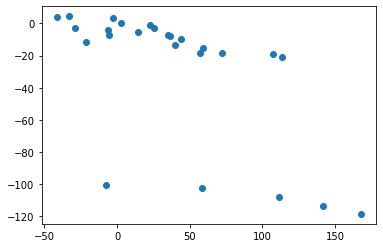

subject_12_stim_period_15_component_0   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.8930769230769231, pvalue=1.9182888939284534e-09)   3.16429119408488


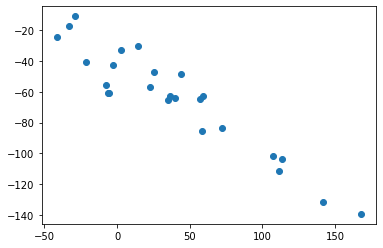

subject_12_stim_period_15_component_0   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.936923076923077, pvalue=5.5280036127825306e-12)   12.075283754013729


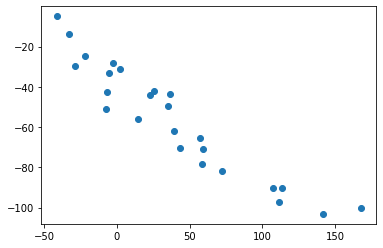

subject_12_stim_period_15_component_1   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8884615384615385, pvalue=3.0466176521302457e-09)   6.078320428691907


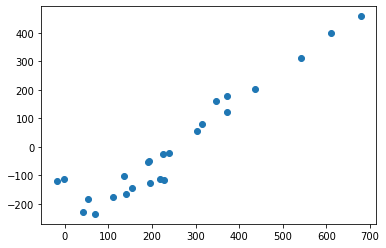

subject_12_stim_period_15_component_1   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.9853846153846154, pvalue=3.4895134823707405e-19)   2.641137027448077


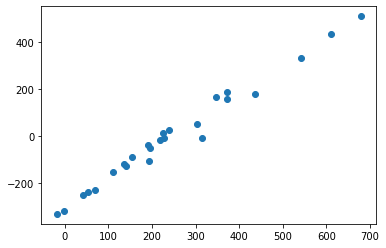

subject_12_stim_period_15_component_1   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.7676923076923077, pvalue=7.493148839559231e-06)   6.972429079211206


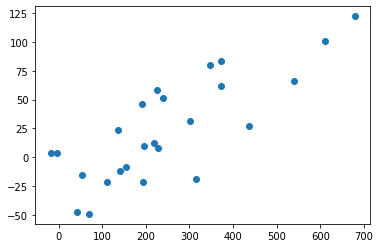

subject_12_stim_period_15_component_1   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.846923076923077, pvalue=9.386851568389248e-08)   7.161988121146546


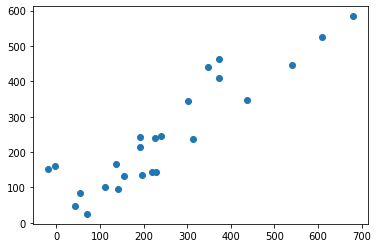

subject_12_stim_period_15_component_1   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.8869230769230768, pvalue=3.538707348743778e-09)   4.812024012546823


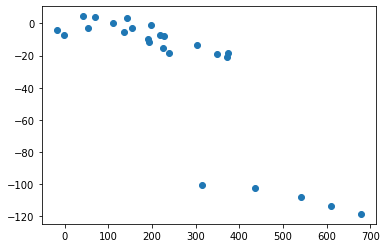

subject_12_stim_period_15_component_1   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.8438461538461538, pvalue=1.1614540388721356e-07)   3.0127378488894623


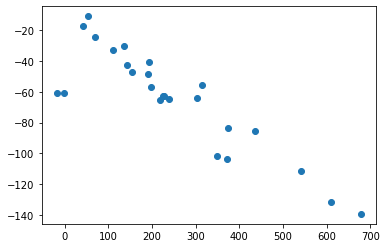

subject_12_stim_period_15_component_1   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.8538461538461539, pvalue=5.713374375102196e-08)   6.735755225367628


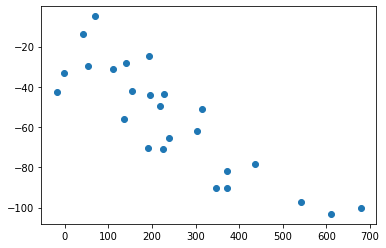

subject_12_stim_period_15_component_1   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.8415384615384615, pvalue=1.3585646020796046e-07)   6.972429079211206


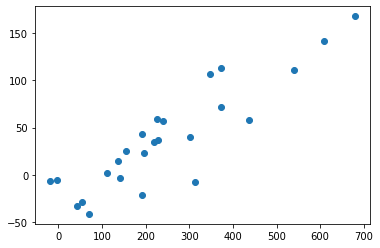

subject_12_stim_period_15_component_2   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=-0.783076923076923, pvalue=3.699462541181756e-06)   4.357129943701222


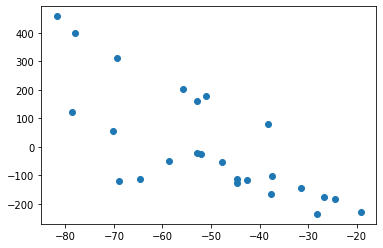

subject_12_stim_period_15_component_2   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=-0.823076923076923, pvalue=4.382860434521219e-07)   3.9576875339877207


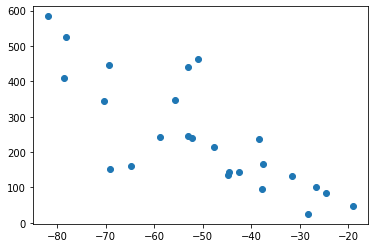

subject_12_stim_period_15_component_2   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=0.7853846153846153, pvalue=3.3117206719816753e-06)   2.63018723723544


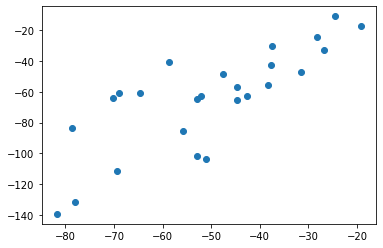

subject_12_stim_period_15_component_3   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.7784615384615384, pvalue=4.5984072840034945e-06)   6.80951709246243


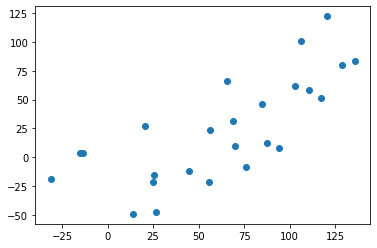

subject_12_stim_period_15_component_3   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.8069230769230769, pvalue=1.0998676057003308e-06)   6.80951709246243


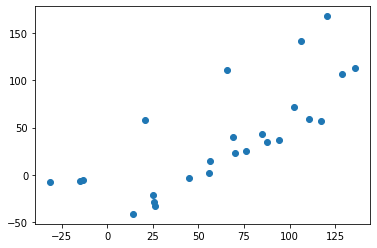

subject_12_stim_period_15_component_4   subject_12_stimulus_15_component_1   SpearmanrResult(correlation=-0.7553846153846154, pvalue=1.2698733030244949e-05)   1.5878894862946822


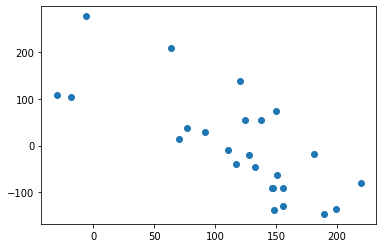

subject_12_stim_period_15_component_4   subject_12_stim_period_15_component_3   SpearmanrResult(correlation=0.8669230769230768, pvalue=2.079377727186629e-08)   1.4627471022553562


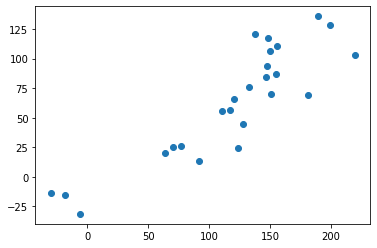

subject_12_stim_period_15_component_5   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=-0.8946153846153846, pvalue=1.6364835035463243e-09)   2.7454225734649214


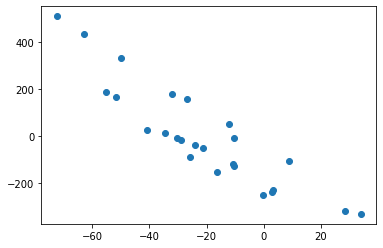

subject_12_stim_period_15_component_5   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=-0.8430769230769231, pvalue=1.224094685396982e-07)   5.234643152084048


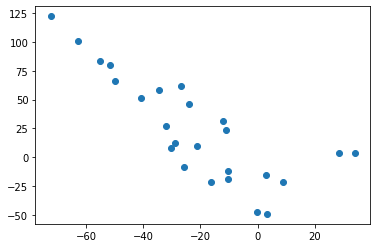

subject_12_stim_period_15_component_5   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=0.8061538461538461, pvalue=1.1466737691746186e-06)   2.7440963323111696


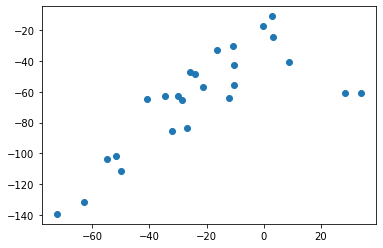

subject_12_stim_period_15_component_5   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=0.8484615384615384, pvalue=8.424100542796248e-08)   5.195721449827498


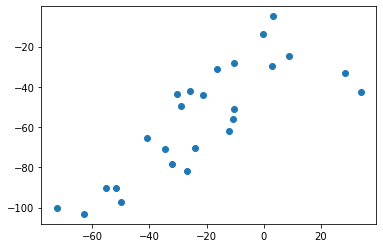

subject_12_stim_period_15_component_5   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=-0.9276923076923077, pvalue=2.5394251541543267e-11)   5.234643152084048


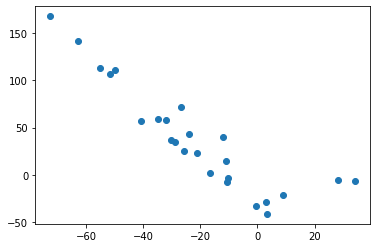

subject_12_stim_period_15_component_5   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=-0.8400000000000001, pvalue=1.506164347046491e-07)   4.5266962933212564


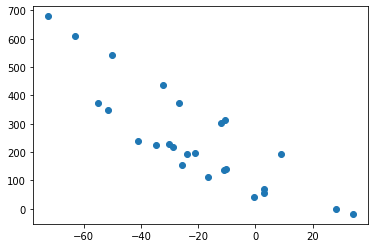

subject_12_stim_period_15_component_5   subject_12_stim_period_15_component_3   SpearmanrResult(correlation=-0.8446153846153847, pvalue=1.1017098747805242e-07)   4.030031027858057


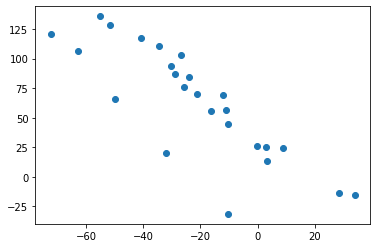

subject_12_stim_period_15_component_6   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=-0.8038461538461538, pvalue=1.2979714272849486e-06)   3.230350521587901


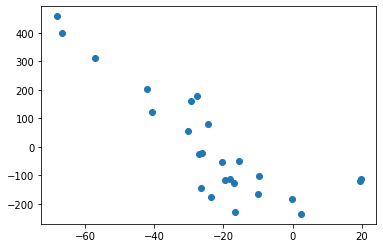

subject_12_stim_period_15_component_6   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=-0.9292307692307692, pvalue=1.9982726883233866e-11)   1.920974642553755


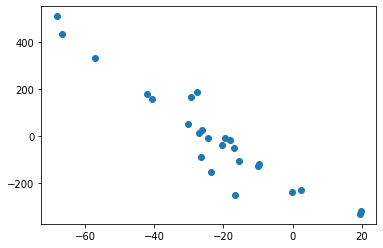

subject_12_stim_period_15_component_6   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=-0.7807692307692308, pvalue=4.127172330952985e-06)   3.1774230582034098


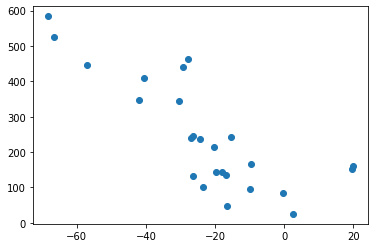

subject_12_stim_period_15_component_6   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=0.786923076923077, pvalue=3.07378762355214e-06)   2.782859014343479


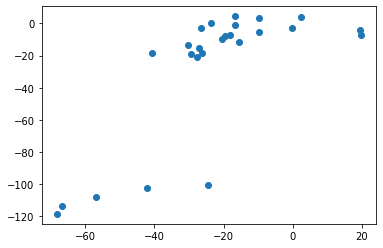

subject_12_stim_period_15_component_6   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=0.78, pvalue=4.279231351800207e-06)   2.3378819128808606


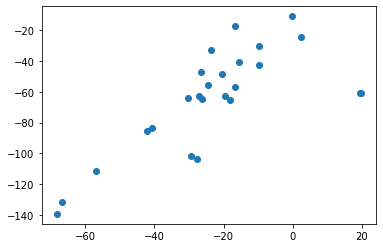

subject_12_stim_period_15_component_6   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=0.8338461538461539, pvalue=2.2515669455692338e-07)   3.205362259087023


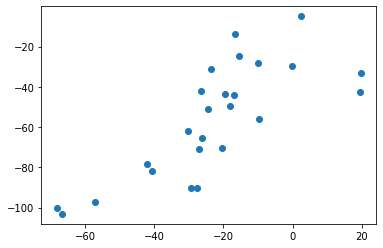

subject_12_stim_period_15_component_6   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=-0.8607692307692307, pvalue=3.3884258165716964e-08)   3.256128722336447


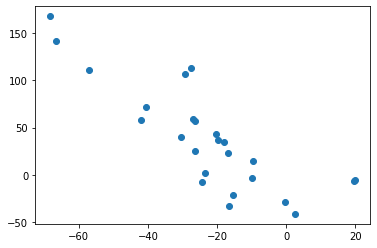

subject_12_stim_period_15_component_6   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=-0.9115384615384616, pvalue=2.380628845796495e-10)   3.1774230582034098


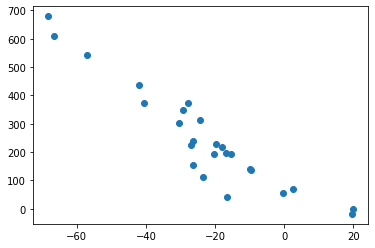

subject_12_stim_period_15_component_6   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=0.8515384615384616, pvalue=6.760339474777838e-08)   2.6278652564503915


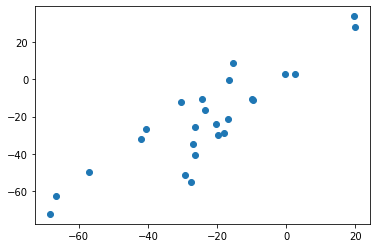

subject_12_stim_period_15_component_7   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.8292307692307692, pvalue=3.0122595252117507e-07)   3.16429119408488


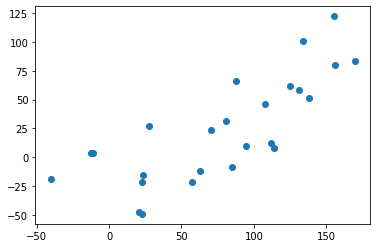

subject_12_stim_period_15_component_7   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.8561538461538462, pvalue=4.814666025093789e-08)   3.16429119408488


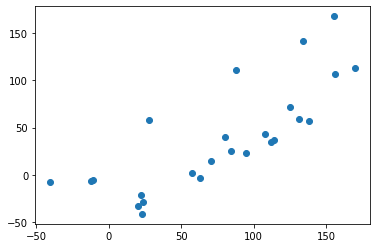

subject_12_stim_period_15_component_7   subject_12_stim_period_15_component_3   SpearmanrResult(correlation=0.9830769230769232, pvalue=1.8624534207767788e-18)   2.879151464003711


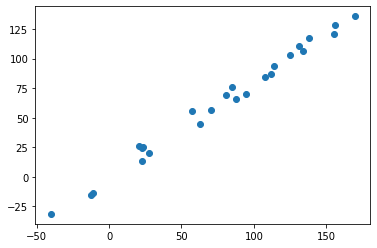

subject_12_stim_period_15_component_7   subject_12_stim_period_15_component_4   SpearmanrResult(correlation=0.8538461538461539, pvalue=5.713374375102196e-08)   1.3532923080698414


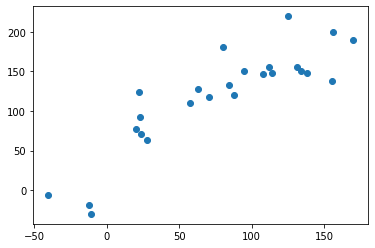

subject_12_stim_period_15_component_7   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=-0.8846153846153847, pvalue=4.412192429584122e-09)   2.7440963323111696


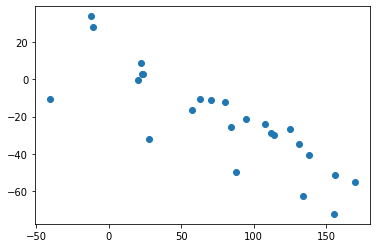

subject_12_stim_period_15_component_8   subject_12_stimulus_14_component_1   SpearmanrResult(correlation=-0.7861538461538461, pvalue=3.1907766589855138e-06)   3.392177022685619


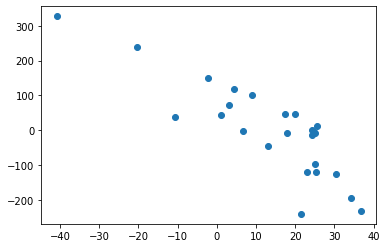

subject_12_stim_period_15_component_8   subject_12_stim_period_14_component_2   SpearmanrResult(correlation=-0.8369230769230769, pvalue=1.8453240094832215e-07)   3.7383024862278473


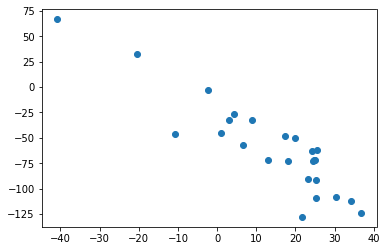

subject_12_stim_period_15_component_8   subject_12_stim_period_14_component_4   SpearmanrResult(correlation=0.8400000000000001, pvalue=1.506164347046491e-07)   1.5592934271813816


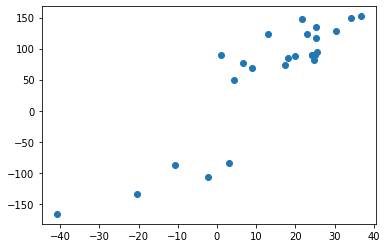

subject_12_stim_period_15_component_8   subject_12_stim_period_14_component_8   SpearmanrResult(correlation=0.8415384615384615, pvalue=1.3585646020796046e-07)   5.992217227509176


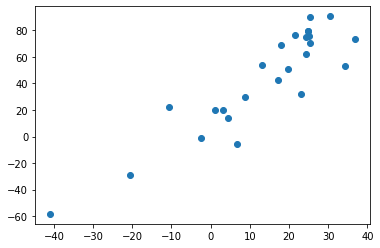

subject_12_stim_period_15_component_9   subject_12_stim_period_15_component_3   SpearmanrResult(correlation=0.8815384615384615, pvalue=5.878925294329137e-09)   6.652726867336754


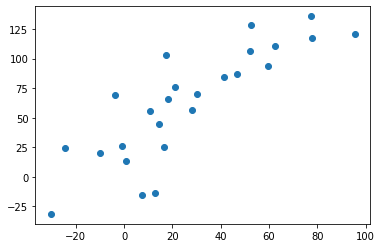

subject_12_stim_period_15_component_9   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=0.8876923076923076, pvalue=3.284344821185417e-09)   3.0693402824439264


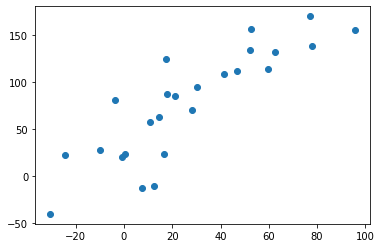

subject_12_stim_period_1_component_0   subject_12_stimulus_1_component_0   SpearmanrResult(correlation=0.9852690863579475, pvalue=0.0)   13.96125874890513


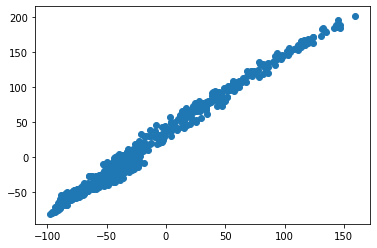

subject_12_stim_period_1_component_3   subject_12_stimulus_1_component_2   SpearmanrResult(correlation=-0.8044210928454577, pvalue=1.1516691303104933e-182)   5.2006731790731235


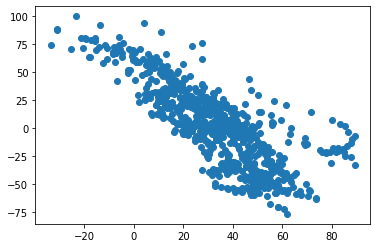

subject_12_stim_period_1_component_4   subject_12_stim_period_1_component_1   SpearmanrResult(correlation=-0.7723557536808652, pvalue=1.9047684937203783e-159)   1.5940410049062375


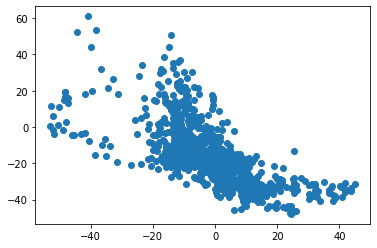

subject_12_stim_period_1_component_6   subject_12_stimulus_1_component_1   SpearmanrResult(correlation=-0.842003815630962, pvalue=4.3269166539313575e-216)   3.286294700577675


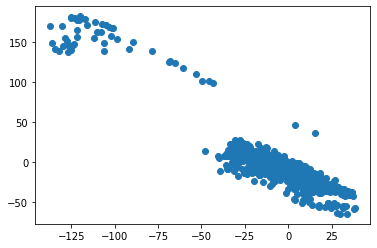

subject_12_stim_period_2_component_0   subject_12_stimulus_2_component_0   SpearmanrResult(correlation=0.9941548424294415, pvalue=0.0)   14.752792620432114


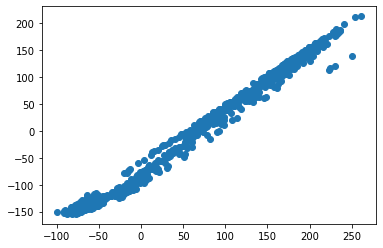

subject_12_stim_period_2_component_2   subject_12_stimulus_2_component_0   SpearmanrResult(correlation=0.8343075145429916, pvalue=1.4336655716618613e-208)   4.736112188168627


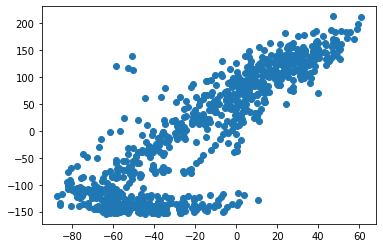

subject_12_stim_period_2_component_2   subject_12_stim_period_2_component_0   SpearmanrResult(correlation=0.7897207886262323, pvalue=1.6220689251149935e-171)   4.774827047606378


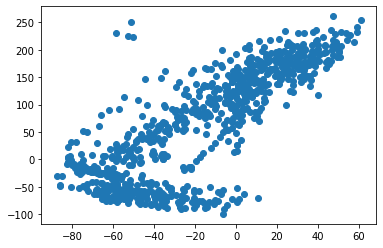

subject_12_stim_period_2_component_3   subject_12_stimulus_2_component_0   SpearmanrResult(correlation=-0.7826532697707341, pvalue=1.8057886157730516e-166)   6.3048045895782


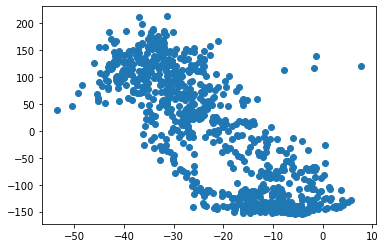

subject_12_stim_period_2_component_3   subject_12_stim_period_2_component_0   SpearmanrResult(correlation=-0.7603688130762706, pvalue=1.007019757900716e-151)   6.80951709246243


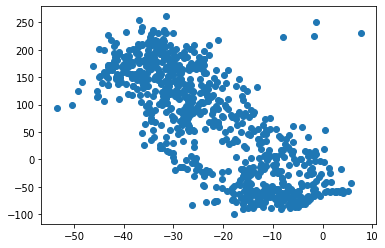

subject_12_stim_period_2_component_4   subject_12_stimulus_2_component_0   SpearmanrResult(correlation=0.8335406383447476, pvalue=7.665576587505648e-208)   1.6353648557528102


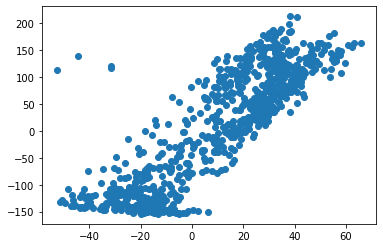

subject_12_stim_period_2_component_4   subject_12_stim_period_2_component_0   SpearmanrResult(correlation=0.8029062545410227, pvalue=1.793032739145734e-181)   1.6353648557528102


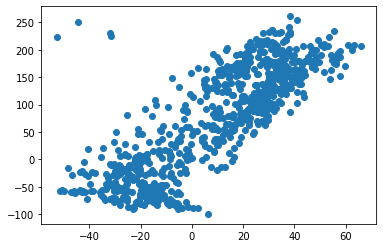

subject_12_stim_period_2_component_4   subject_12_stim_period_2_component_2   SpearmanrResult(correlation=0.8341351548986796, pvalue=2.0913004549245805e-208)   1.5850995356569526


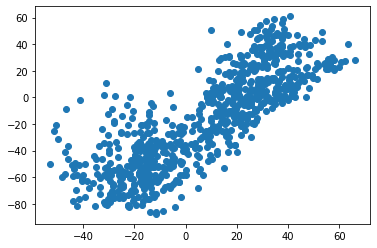

subject_12_stim_period_2_component_4   subject_12_stim_period_2_component_3   SpearmanrResult(correlation=-0.7978660826032541, pvalue=1.4021017506974095e-177)   1.4627471022553562


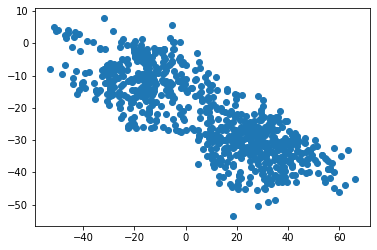

subject_12_stim_period_3_component_0   subject_12_stimulus_3_component_0   SpearmanrResult(correlation=0.9046447813805271, pvalue=0.0)   15.128288001596472


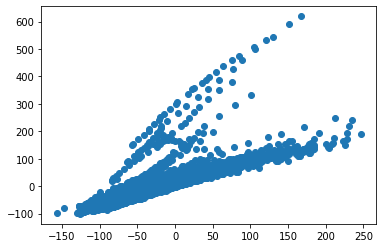

subject_12_stim_period_3_component_0   subject_12_stimulus_3_component_1   SpearmanrResult(correlation=-0.7593445670177639, pvalue=0.0)   2.109033898217255


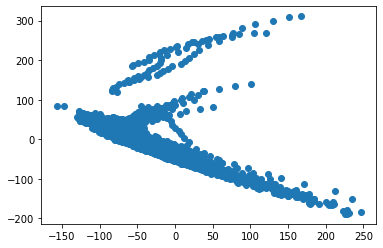

subject_12_stim_period_4_component_0   subject_12_stimulus_4_component_0   SpearmanrResult(correlation=0.9771277365179115, pvalue=0.0)   13.847067701617497


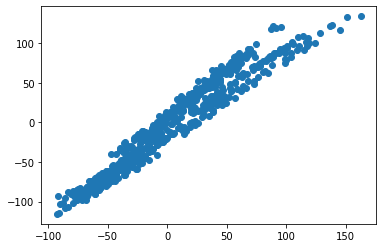

subject_12_stim_period_4_component_9   subject_12_stimulus_4_component_1   SpearmanrResult(correlation=0.788658236470304, pvalue=6.739203453340688e-137)   8.317746639585017


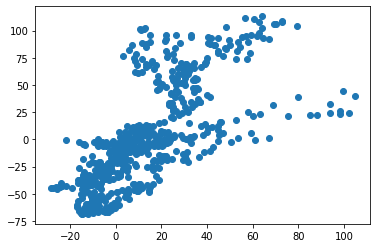

subject_12_stim_period_9_component_0   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.801740521800969, pvalue=6.71407770171385e-35)   14.931576235516724


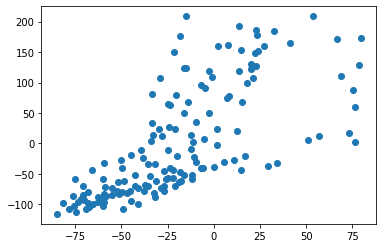

subject_12_stim_period_9_component_0   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.7856829192408552, pvalue=1.1240219657047603e-32)   13.493315427629101


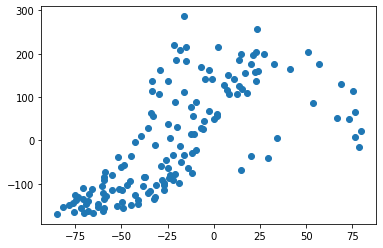

subject_12_stim_period_9_component_0   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.9540566247388773, pvalue=2.3445499032420894e-79)   11.884652003316845


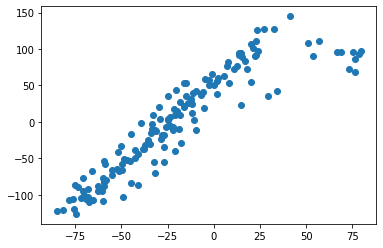

subject_12_stim_period_9_component_0   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.7933134805991378, pvalue=1.0437602708242868e-33)   17.843122470352377


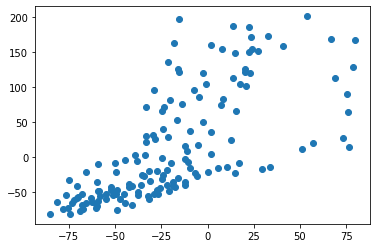

subject_12_stim_period_9_component_0   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.7989635094893106, pvalue=1.6823628126744821e-34)   5.234643152084048


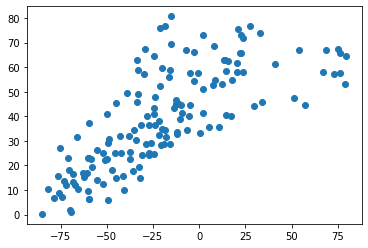

subject_12_stim_period_9_component_0   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.796982977021201, pvalue=3.2109530933706427e-34)   17.843122470352377


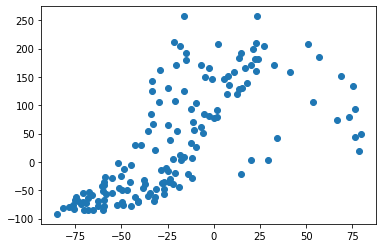

subject_12_stim_period_9_component_0   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.7817751900084449, pvalue=3.657555305999404e-32)   4.774827047606378


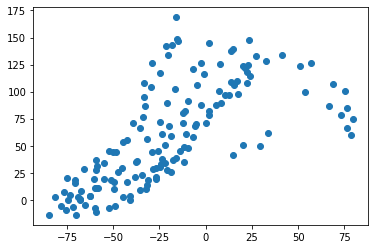

subject_12_stim_period_9_component_0   subject_12_stim_period_11_component_9   SpearmanrResult(correlation=-0.8828641272945464, pvalue=1.9454710256746524e-50)   12.075283754013729


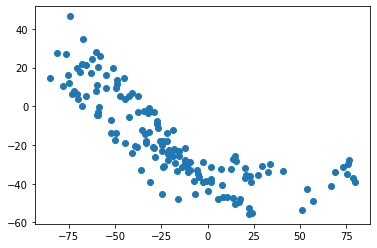

subject_12_stim_period_9_component_0   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=0.7699879994666431, pvalue=1.1142070371768349e-30)   5.234643152084048


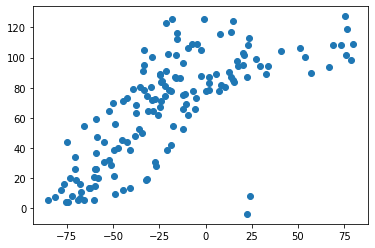

subject_12_stim_period_9_component_0   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=0.7525187786123829, pvalue=1.2317791636453437e-28)   3.16429119408488


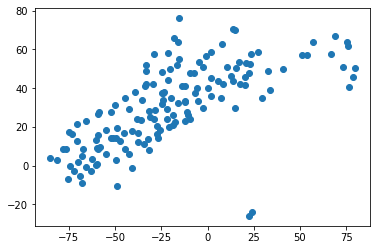

subject_12_stim_period_9_component_1   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=0.7534965998488822, pvalue=9.564830372920872e-29)   6.972429079211206


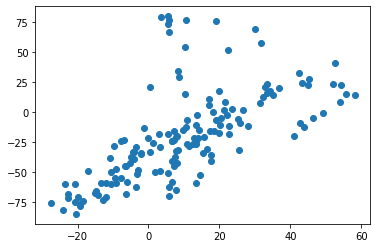

subject_12_stim_period_9_component_2   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8464500644473087, pvalue=2.3921538029191184e-42)   4.729460820794367


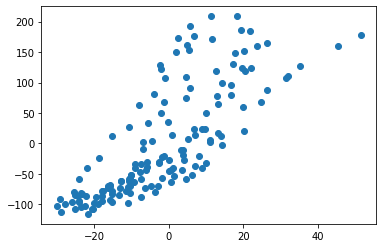

subject_12_stim_period_9_component_2   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8494973109915996, pvalue=6.110167432389371e-43)   4.686634276522041


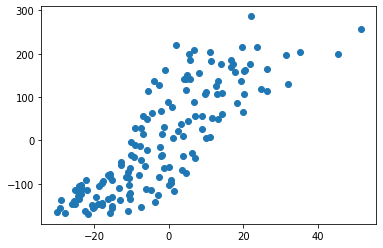

subject_12_stim_period_9_component_2   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.7803209031512512, pvalue=5.638996012894508e-32)   4.500706655521503


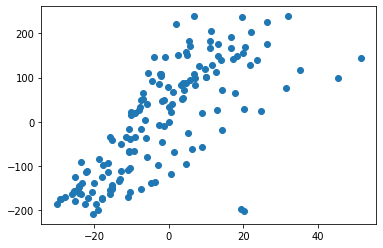

subject_12_stim_period_9_component_2   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.8915009555980267, pvalue=9.341415683687662e-53)   4.753557206336536


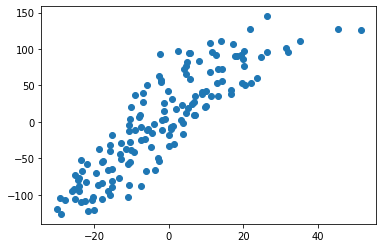

subject_12_stim_period_9_component_2   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.846361171607627, pvalue=2.488206417614331e-42)   4.774827047606378


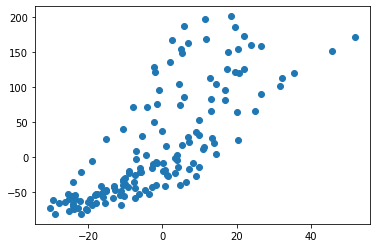

subject_12_stim_period_9_component_2   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8854846882083648, pvalue=4.0300180388101735e-51)   3.8755807080126914


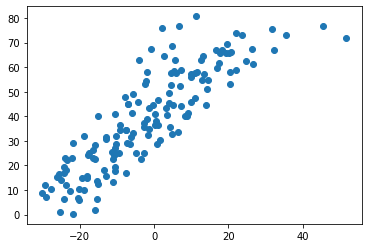

subject_12_stim_period_9_component_2   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.843193030801369, pvalue=9.95993944502621e-42)   4.774827047606378


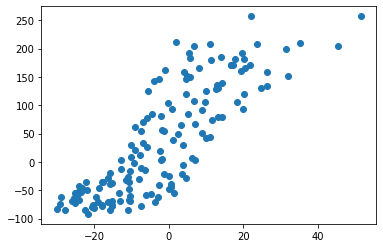

subject_12_stim_period_9_component_2   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.8671620960931599, pvalue=1.1757748164898751e-46)   4.774827047606378


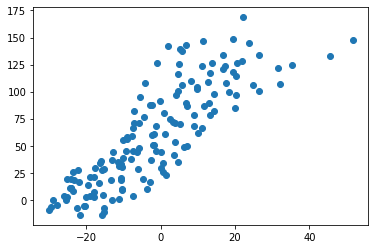

subject_12_stim_period_9_component_2   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=0.7696430952486778, pvalue=1.227574416605688e-30)   4.271486326962424


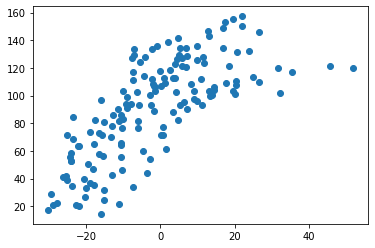

subject_12_stim_period_9_component_2   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=0.8110422685452687, pvalue=2.774848135175539e-36)   3.8755807080126914


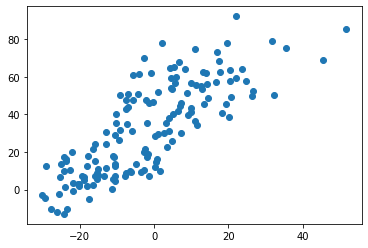

subject_12_stim_period_9_component_2   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=0.7781554735766034, pvalue=1.0678445248147012e-31)   4.774827047606378


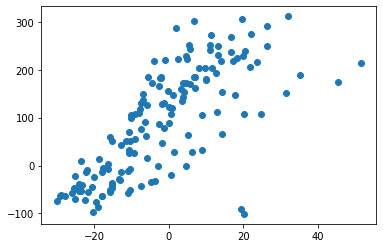

subject_12_stim_period_9_component_2   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=0.7802675674474422, pvalue=5.728880758843037e-32)   3.8755807080126914


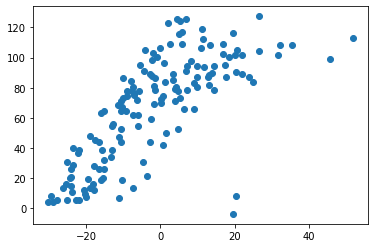

subject_12_stim_period_9_component_2   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=0.8028214587314993, pvalue=4.6772352130360654e-35)   2.63018723723544


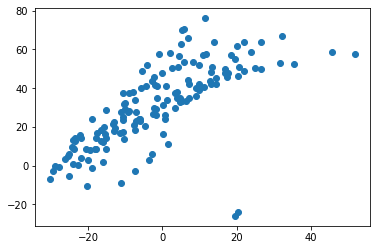

subject_12_stim_period_9_component_2   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=0.8292973021023157, pvalue=3.096610856764535e-39)   4.774827047606378


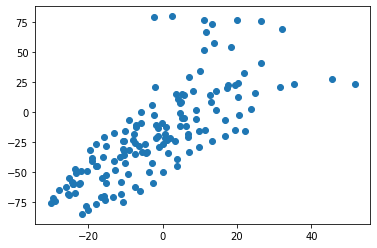

subject_12_stim_period_9_component_3   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8362985021556515, pvalue=1.8372894183982864e-40)   6.516007559951657


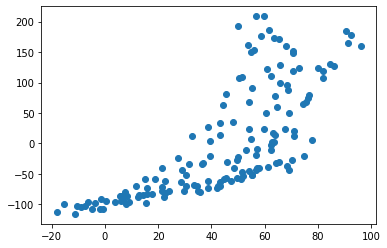

subject_12_stim_period_9_component_3   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8548415485132673, pvalue=5.178048373342309e-44)   6.262751307355187


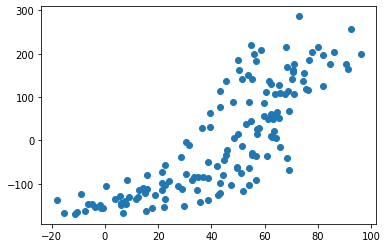

subject_12_stim_period_9_component_3   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.8006418063025023, pvalue=9.67332185680673e-35)   5.758178572081894


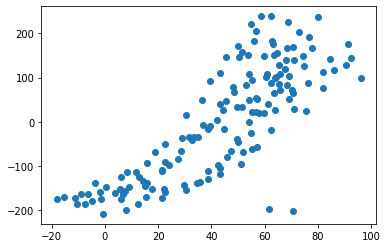

subject_12_stim_period_9_component_3   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.9358798168807503, pvalue=6.18100292807766e-69)   6.326846068429051


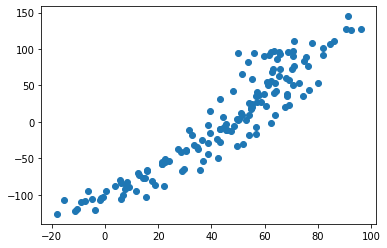

subject_12_stim_period_9_component_3   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.8350646695408686, pvalue=3.0515658685278176e-40)   6.80951709246243


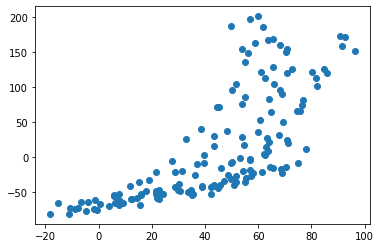

subject_12_stim_period_9_component_3   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.777675452242322, pvalue=1.2290147440510022e-31)   7.196902859306155


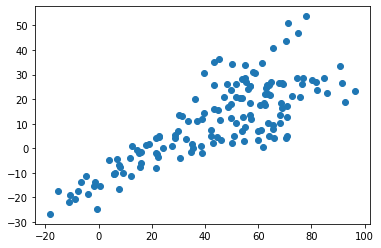

subject_12_stim_period_9_component_3   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8606480288012801, pvalue=3.160572201107283e-45)   4.030031027858057


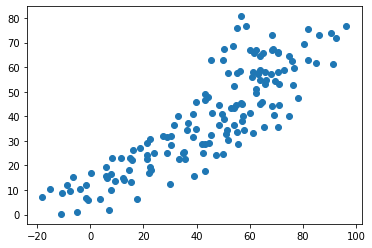

subject_12_stim_period_9_component_3   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.8488039468420818, pvalue=8.357361322078008e-43)   6.80951709246243


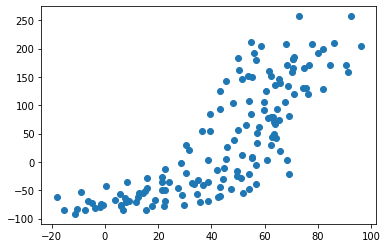

subject_12_stim_period_9_component_3   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.8583972621005378, pvalue=9.48232008594582e-45)   4.271486326962424


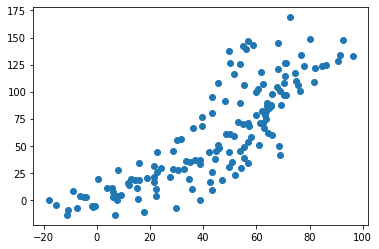

subject_12_stim_period_9_component_3   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=0.8011467176318947, pvalue=8.18125044670113e-35)   7.196902859306155


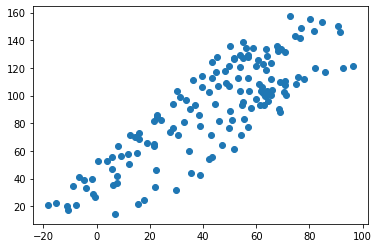

subject_12_stim_period_9_component_3   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=0.8255709142628562, pvalue=1.32215398809649e-38)   4.030031027858057


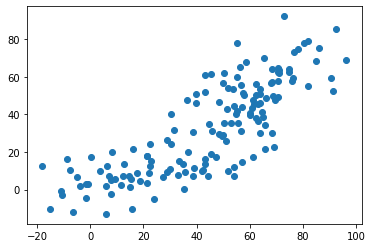

subject_12_stim_period_9_component_3   subject_12_stim_period_11_component_9   SpearmanrResult(correlation=-0.8137054980221343, pvalue=1.0786654890090682e-36)   6.652726867336754


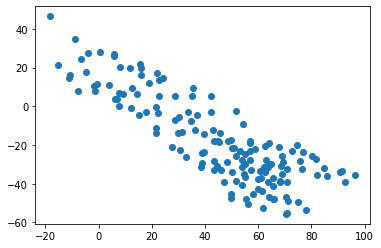

subject_12_stim_period_9_component_3   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=0.7987217209653763, pvalue=1.8212009570526412e-34)   6.80951709246243


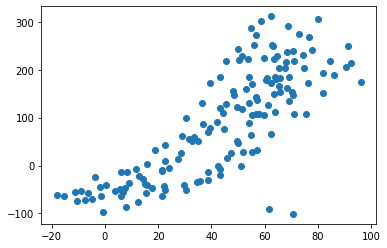

subject_12_stim_period_9_component_3   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=0.7901204497977689, pvalue=2.8558326533895443e-33)   4.030031027858057


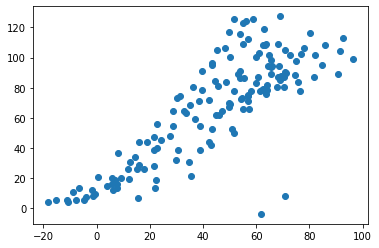

subject_12_stim_period_9_component_3   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=0.7851780079114627, pvalue=1.3109444396160508e-32)   2.879151464003711


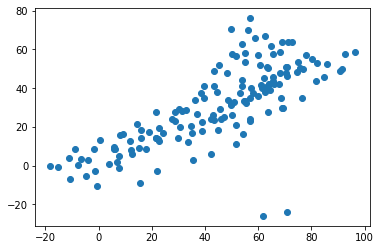

subject_12_stim_period_9_component_3   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=0.8751091159607094, pvalue=1.6610071720163477e-48)   6.80951709246243


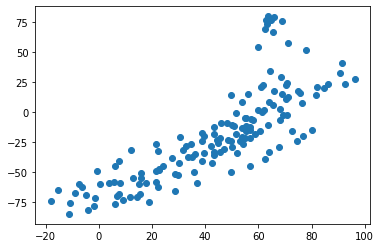

subject_12_stim_period_9_component_3   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=0.9181119160851595, pvalue=2.3101831173928776e-61)   4.271486326962424


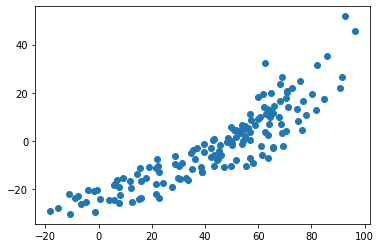

subject_12_stim_period_9_component_4   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=-0.8527258989288413, pvalue=1.3917628204635857e-43)   1.6353648557528102


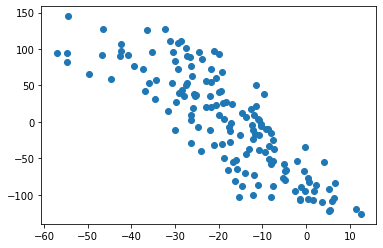

subject_12_stim_period_9_component_4   subject_12_stim_period_11_component_9   SpearmanrResult(correlation=0.7845735366016268, pvalue=1.57518253344221e-32)   1.6353648557528102


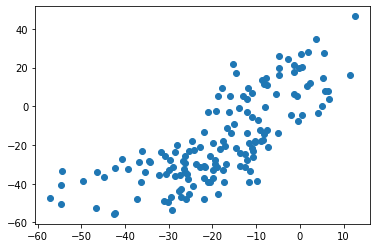

subject_12_stim_period_9_component_4   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=-0.8203973509933775, pvalue=9.377713667476437e-38)   1.6353648557528102


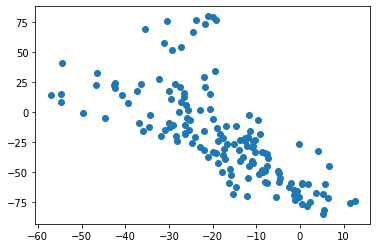

subject_12_stim_period_9_component_4   subject_12_stim_period_9_component_1   SpearmanrResult(correlation=-0.831693853060136, pvalue=1.1949317282941691e-39)   1.5940410049062375


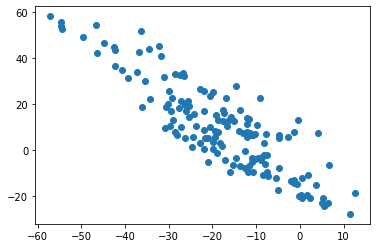

subject_12_stim_period_9_component_4   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=-0.7924138850615584, pvalue=1.3884578387024952e-33)   1.4627471022553562


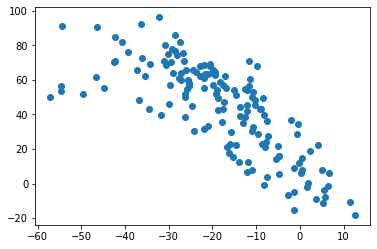

subject_12_stim_period_9_component_5   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8063736166051825, pvalue=1.403239980950757e-35)   5.196668468539744


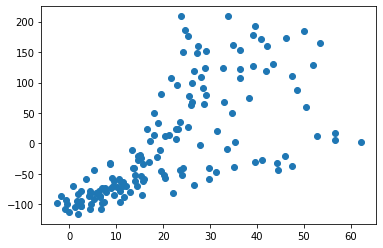

subject_12_stim_period_9_component_5   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.7966771856526959, pvalue=3.5456716066118414e-34)   5.222594959312963


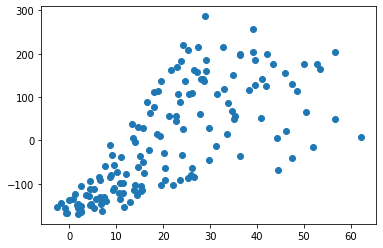

subject_12_stim_period_9_component_5   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.7993795279790213, pvalue=1.4674237458530068e-34)   4.9570392952481726


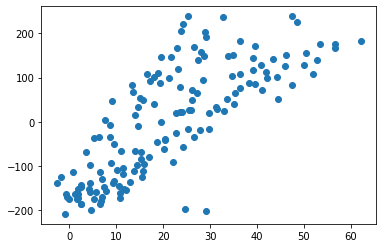

subject_12_stim_period_9_component_5   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.9283310369349749, pvalue=1.7613690501184235e-65)   5.234643152084048


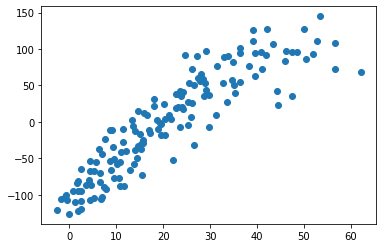

subject_12_stim_period_9_component_5   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.7928725721143163, pvalue=1.200656553008887e-33)   5.234643152084048


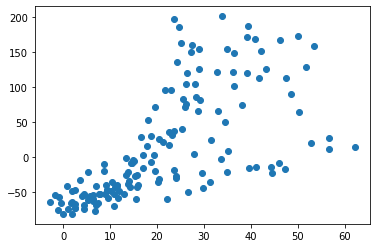

subject_12_stim_period_9_component_5   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.7614436197164318, pvalue=1.1705442966922541e-29)   4.030031027858057


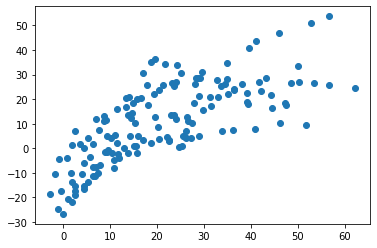

subject_12_stim_period_9_component_5   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8050046668740833, pvalue=2.238241231721139e-35)   5.234643152084048


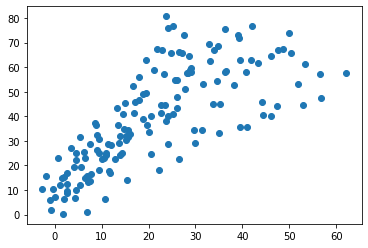

subject_12_stim_period_9_component_5   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.7942415218454154, pvalue=7.764331047637783e-34)   5.234643152084048


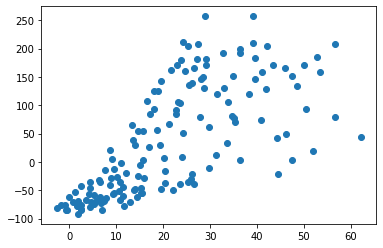

subject_12_stim_period_9_component_5   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.8008551491177386, pvalue=9.012788630713514e-35)   3.8755807080126914


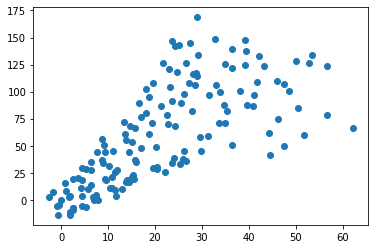

subject_12_stim_period_9_component_5   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=0.7591466287390551, pvalue=2.1662041685766627e-29)   5.234643152084048


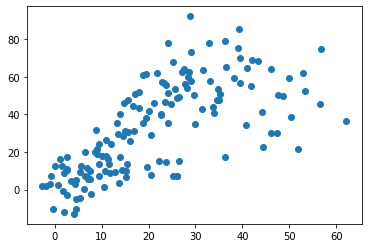

subject_12_stim_period_9_component_5   subject_12_stim_period_11_component_9   SpearmanrResult(correlation=-0.8187617227432331, pvalue=1.719530238852764e-37)   5.195721449827498


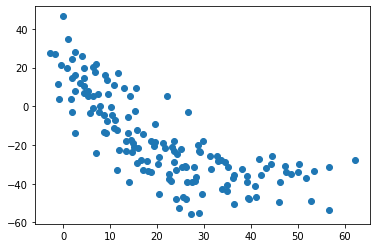

subject_12_stim_period_9_component_5   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=0.7964460642695231, pvalue=3.8211885872793266e-34)   5.234643152084048


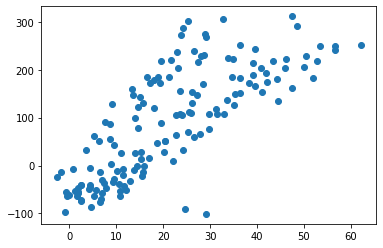

subject_12_stim_period_9_component_5   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=0.8041335170452021, pvalue=3.006840289193608e-35)   5.234643152084048


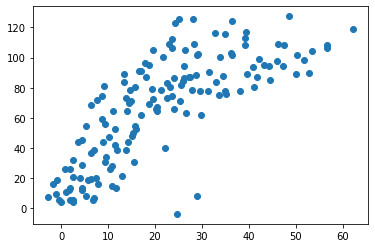

subject_12_stim_period_9_component_5   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=0.7727294546424286, pvalue=5.126857626513411e-31)   2.7440963323111696


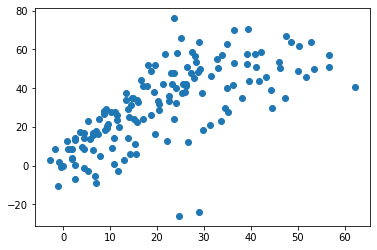

subject_12_stim_period_9_component_5   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=0.904937997244322, pvalue=8.760247326994966e-57)   5.234643152084048


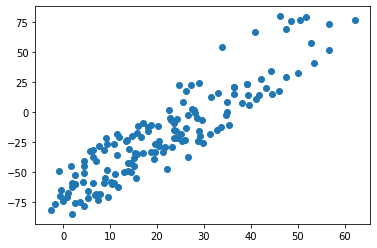

subject_12_stim_period_9_component_5   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=0.7847904351304502, pvalue=1.474842037364698e-32)   3.8755807080126914


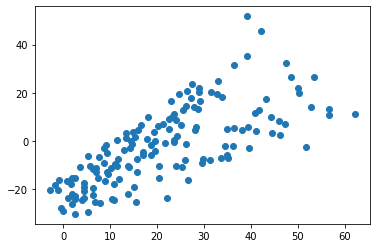

subject_12_stim_period_9_component_5   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=0.8920769811991643, pvalue=6.439425031341517e-53)   4.030031027858057


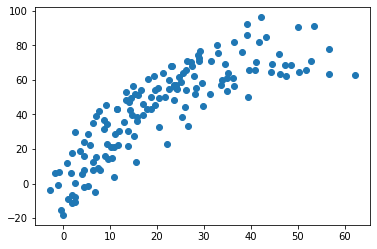

subject_12_stim_period_9_component_5   subject_12_stim_period_9_component_4   SpearmanrResult(correlation=-0.805552246766523, pvalue=1.8577630360426497e-35)   1.609633697147636


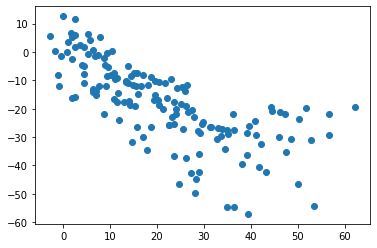

subject_12_stim_period_9_component_6   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.7604906884750434, pvalue=1.51234013674528e-29)   3.256128722336447


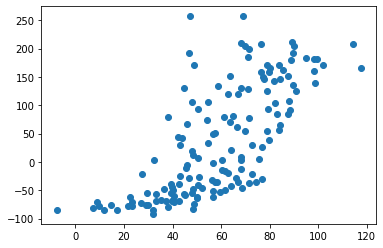

subject_12_stim_period_9_component_8   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8375252233432597, pvalue=1.1047880874697521e-40)   5.954242543964872


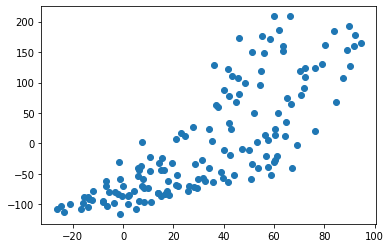

subject_12_stim_period_9_component_8   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8868856393617495, pvalue=1.70966809332229e-51)   5.9554776767134


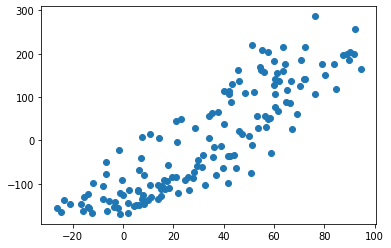

subject_12_stim_period_9_component_8   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.7532405884705987, pvalue=1.0220898282390738e-28)   5.755072222753523


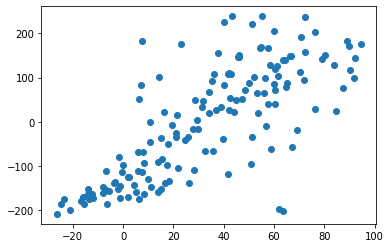

subject_12_stim_period_9_component_8   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.8684634872661007, pvalue=5.96588777246432e-47)   5.868659257266642


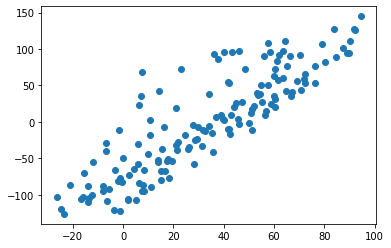

subject_12_stim_period_9_component_8   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.8225734477087872, pvalue=4.1457028272604553e-38)   5.992217227509176


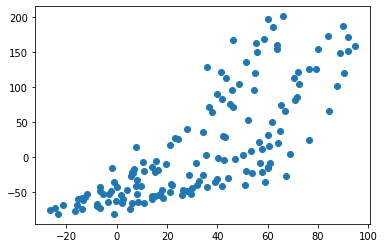

subject_12_stim_period_9_component_8   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.7697177652340104, pvalue=1.2021080958351187e-30)   4.253612666116302


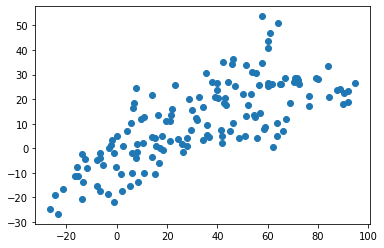

subject_12_stim_period_9_component_8   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8223921063158364, pvalue=4.439401245737562e-38)   4.311341470668168


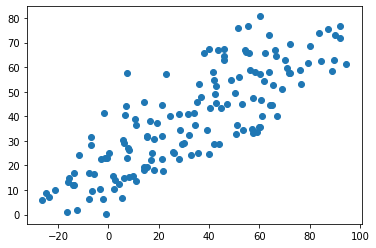

subject_12_stim_period_9_component_8   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.8675461131605849, pvalue=9.631714261374902e-47)   5.992217227509176


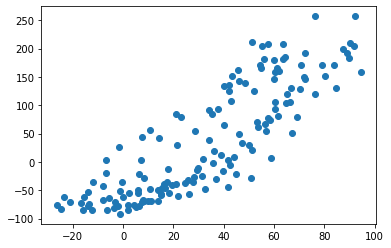

subject_12_stim_period_9_component_8   subject_12_stim_period_11_component_1   SpearmanrResult(correlation=0.7873292146317614, pvalue=6.78700479997194e-33)   4.510259268977354


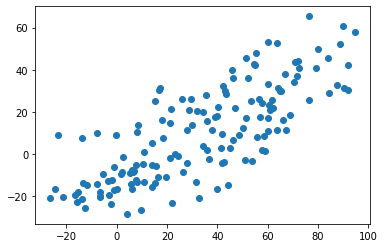

subject_12_stim_period_9_component_8   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.8875861149384418, pvalue=1.108834729480576e-51)   3.7383024862278473


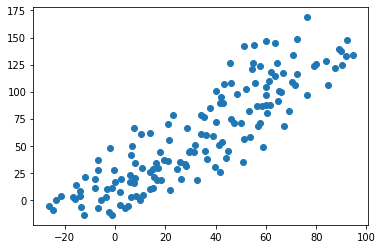

subject_12_stim_period_9_component_8   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=0.8660456020267567, pvalue=2.092368318854869e-46)   4.253612666116302


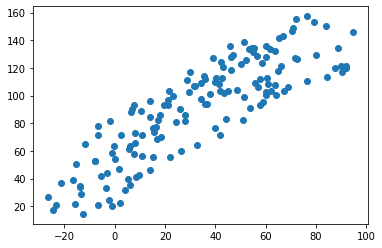

subject_12_stim_period_9_component_8   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=0.8359500422240989, pvalue=2.1212546800620794e-40)   4.311341470668168


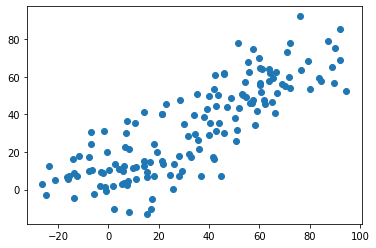

subject_12_stim_period_9_component_8   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=0.7608711498288814, pvalue=1.3654951102349736e-29)   4.311341470668168


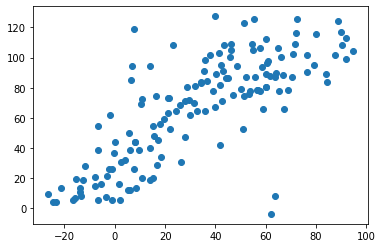

subject_12_stim_period_9_component_8   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=0.8190781812525002, pvalue=1.5299319131749872e-37)   2.751409546599643


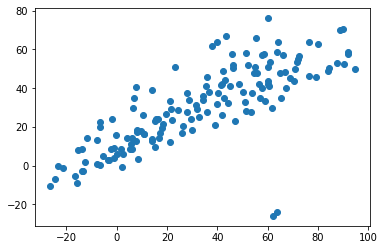

subject_12_stim_period_9_component_8   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=0.8014276190052892, pvalue=7.451644530104734e-35)   3.7383024862278473


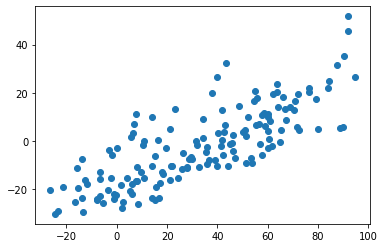

subject_12_stim_period_9_component_8   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=0.8133037023867727, pvalue=1.2451339159913142e-36)   4.253612666116302


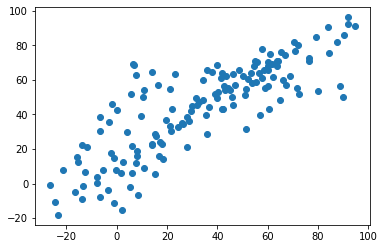

subject_13_stimulus_0_component_1   subject_10_stimulus_1_component_0   SpearmanrResult(correlation=-0.7726398270240162, pvalue=9.341523516551122e-61)   2.651704897830209


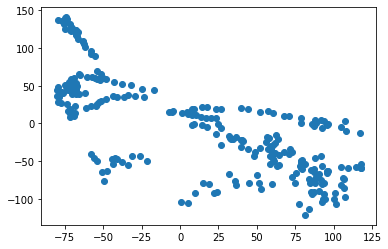

subject_13_stimulus_10_component_1   subject_12_stim_period_14_component_8   SpearmanrResult(correlation=-0.7974055492259144, pvalue=4.198560165131854e-12)   2.89168781064254


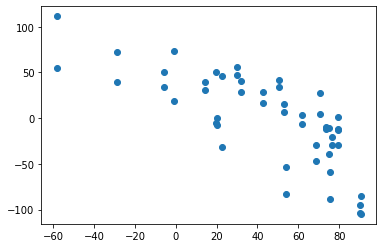

subject_13_stimulus_10_component_7   subject_10_stim_period_14_component_8   SpearmanrResult(correlation=0.7613352765174695, pvalue=1.375667586338461e-10)   3.0065762501588513


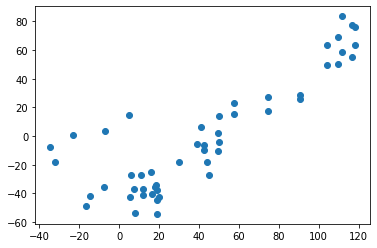

subject_13_stimulus_11_component_0   subject_13_stimulus_10_component_2   SpearmanrResult(correlation=0.8752460984393757, pvalue=9.397455611049116e-17)   6.3171300650541005


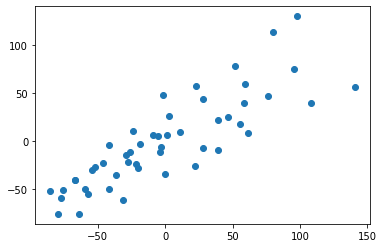

subject_13_stimulus_11_component_1   subject_13_stimulus_10_component_0   SpearmanrResult(correlation=0.7986074429771908, pvalue=3.693461508463864e-12)   6.98989572177105


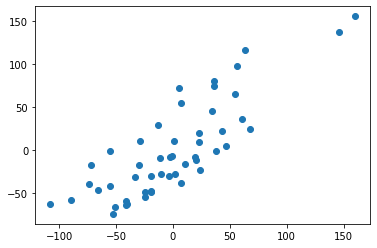

subject_13_stimulus_11_component_6   subject_12_stimulus_14_component_3   SpearmanrResult(correlation=0.7760722120448885, pvalue=3.574680216154401e-11)   4.336627487693791


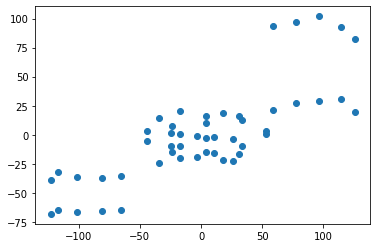

subject_13_stimulus_12_component_0   subject_13_stimulus_11_component_1   SpearmanrResult(correlation=0.7561584633853542, pvalue=2.1590906555953343e-10)   6.812776770421445


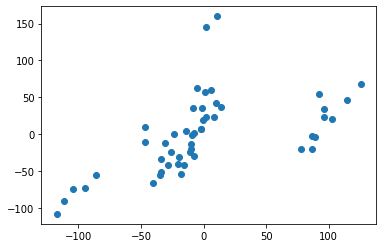

subject_13_stimulus_12_component_1   subject_12_stim_period_15_component_4   SpearmanrResult(correlation=0.7558920282249991, pvalue=2.2090985087098913e-10)   1.1059282173537697


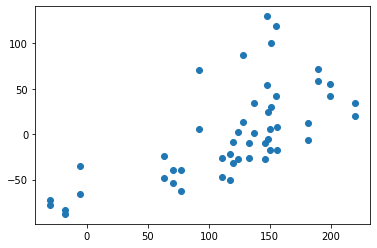

subject_13_stimulus_12_component_2   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=0.7545466826370066, pvalue=2.4787662099416885e-10)   2.428570902899471


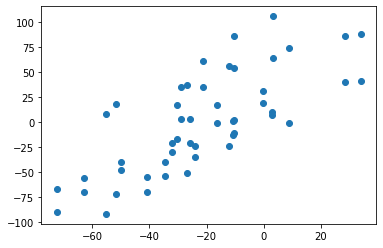

subject_13_stimulus_12_component_3   subject_13_stimulus_10_component_6   SpearmanrResult(correlation=0.7811284513805522, pvalue=2.1987455493156642e-11)   7.554601888688179


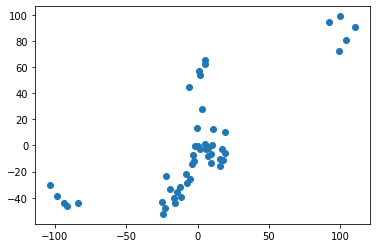

subject_13_stimulus_14_component_5   subject_10_stimulus_13_component_4   SpearmanrResult(correlation=-0.7884712828950212, pvalue=4.344384579616418e-44)   4.003826353532794


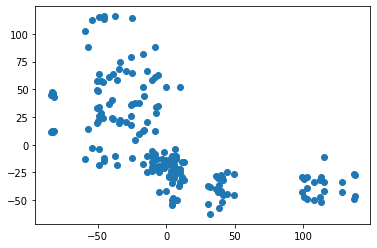

subject_13_stimulus_15_component_0   subject_13_stimulus_14_component_0   SpearmanrResult(correlation=0.8691509150915091, pvalue=9.93268452784802e-32)   3.025493102681155


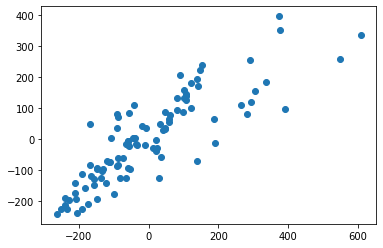

subject_13_stimulus_15_component_1   subject_13_stimulus_14_component_1   SpearmanrResult(correlation=0.851101110111011, pvalue=3.5429010340232664e-29)   7.720793923070762


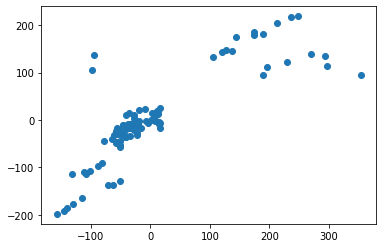

subject_13_stimulus_15_component_6   subject_10_stimulus_13_component_4   SpearmanrResult(correlation=-0.7875802249231747, pvalue=6.299841036063185e-44)   4.031401479850475


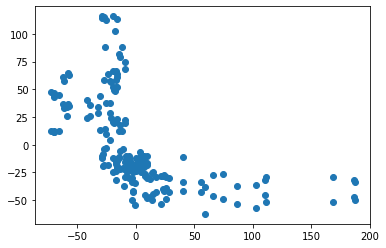

subject_13_stimulus_15_component_6   subject_13_stimulus_14_component_5   SpearmanrResult(correlation=0.8344554455445544, pvalue=4.174677985139966e-27)   7.412059858754308


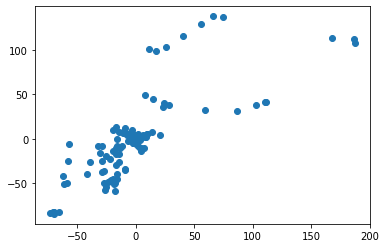

subject_13_stimulus_15_component_7   subject_13_stimulus_14_component_6   SpearmanrResult(correlation=-0.7536873687368737, pvalue=1.4497351099948724e-19)   8.110625835580311


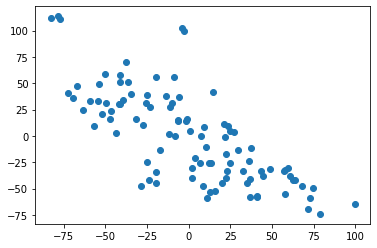

subject_13_stimulus_15_component_8   subject_13_stimulus_14_component_4   SpearmanrResult(correlation=0.8568376837683767, pvalue=5.974368186921716e-30)   3.9849621554579437


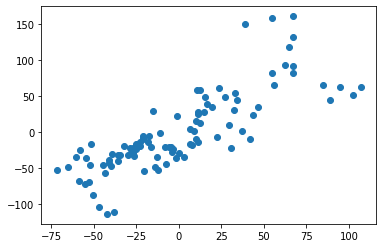

subject_13_stimulus_9_component_0   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=-0.7655016395678037, pvalue=9.492048844243989e-11)   1.6811124351390632


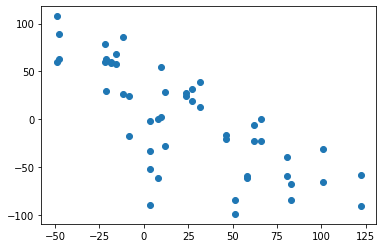

subject_13_stimulus_9_component_1   subject_13_stimulus_10_component_0   SpearmanrResult(correlation=0.765282112845138, pvalue=9.681295464218799e-11)   7.059343645132849


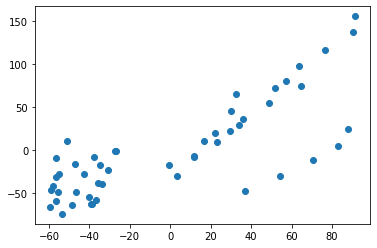

subject_13_stimulus_9_component_1   subject_13_stimulus_12_component_4   SpearmanrResult(correlation=0.8204081632653061, pvalue=3.0749011358666314e-13)   7.4093748164443


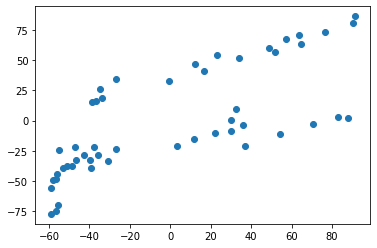

subject_13_stimulus_9_component_7   subject_10_stimulus_14_component_3   SpearmanrResult(correlation=0.8187800428233739, pvalue=3.744422499844682e-13)   5.263353443742762


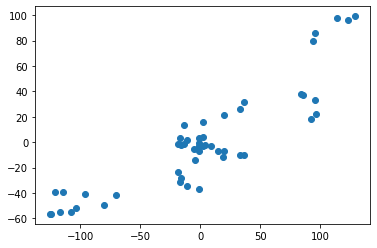

subject_13_stim_period_0_component_0   subject_13_stimulus_0_component_0   SpearmanrResult(correlation=-0.991667009606899, pvalue=1.4908514853954191e-240)   0.6668327703132277


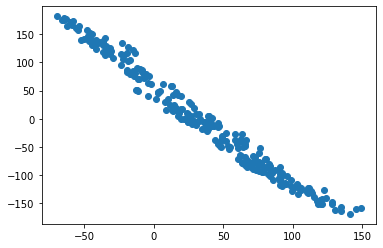

subject_13_stim_period_0_component_1   subject_13_stimulus_0_component_0   SpearmanrResult(correlation=-0.9956499936746579, pvalue=2.8727515744931445e-278)   0.6668327703132277


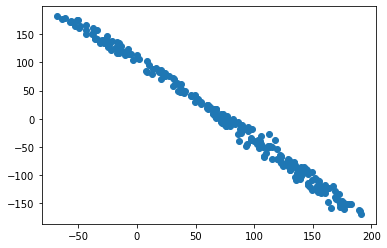

subject_13_stim_period_0_component_1   subject_13_stim_period_0_component_0   SpearmanrResult(correlation=0.9829115168475103, pvalue=5.197740423112767e-199)   5.781258524483096


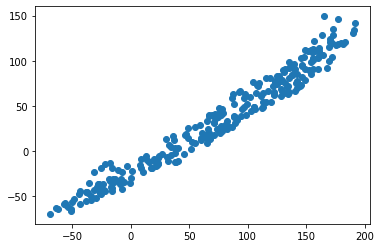

subject_13_stim_period_0_component_2   subject_13_stimulus_0_component_5   SpearmanrResult(correlation=0.762253102084924, pvalue=1.5023018043940183e-52)   6.974487555628098


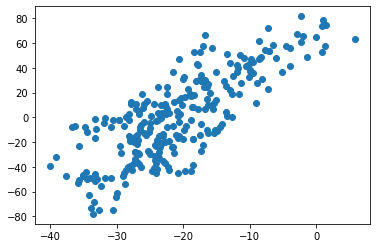

subject_13_stim_period_0_component_6   subject_13_stimulus_0_component_1   SpearmanrResult(correlation=0.8923253024351804, pvalue=1.4361537058379826e-94)   6.381477936980745


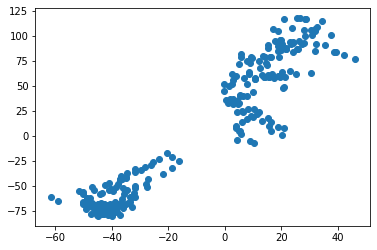

subject_13_stim_period_0_component_7   subject_13_stimulus_0_component_2   SpearmanrResult(correlation=0.7747885582945047, pvalue=2.6914562153339672e-55)   7.494791475598562


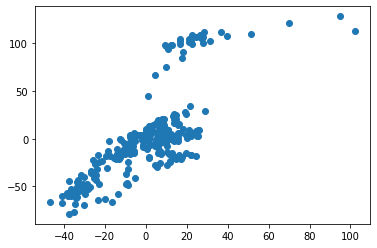

subject_13_stim_period_10_component_0   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.7762644042717446, pvalue=3.5100596504126926e-11)   2.0958219811818677


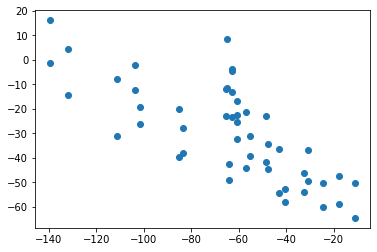

subject_13_stim_period_10_component_0   subject_13_stimulus_10_component_0   SpearmanrResult(correlation=0.77968787515006, pvalue=2.5285497501250525e-11)   5.227889415091173


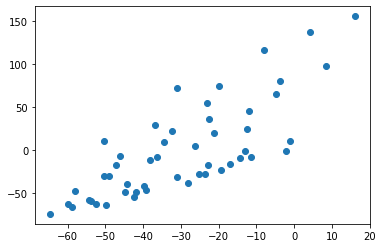

subject_13_stim_period_10_component_0   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.7500120048019208, pvalue=3.6350723493699216e-10)   2.5021627602553704


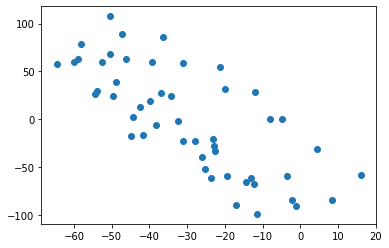

subject_13_stim_period_10_component_6   subject_13_stimulus_10_component_0   SpearmanrResult(correlation=0.897719087635054, pvalue=1.0386881735669835e-18)   6.767657713585586


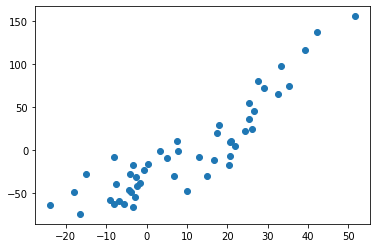

subject_13_stim_period_10_component_6   subject_13_stimulus_11_component_1   SpearmanrResult(correlation=0.7655702280912365, pvalue=9.433641621115883e-11)   6.652180024832326


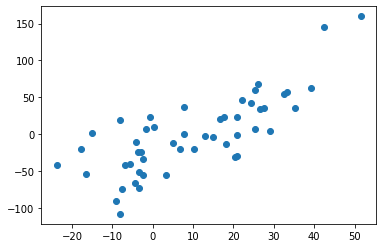

subject_13_stim_period_10_component_6   subject_13_stimulus_9_component_1   SpearmanrResult(correlation=0.8345258103241295, pvalue=5.105117172358973e-14)   6.917183665288944


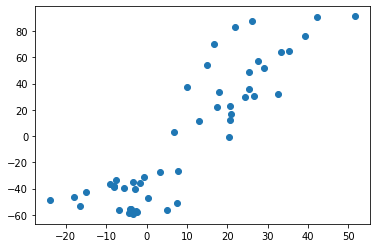

subject_13_stim_period_10_component_7   subject_13_stim_period_10_component_6   SpearmanrResult(correlation=-0.7615366146458583, pvalue=1.3514526943652205e-10)   7.763707607761023


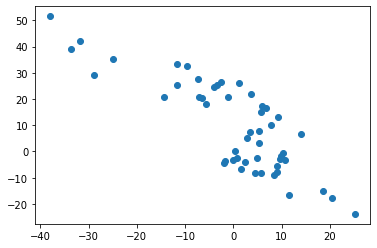

subject_13_stim_period_10_component_9   subject_13_stimulus_10_component_0   SpearmanrResult(correlation=-0.9144297719087635, pvalue=1.7414553762736242e-20)   3.688010434462916


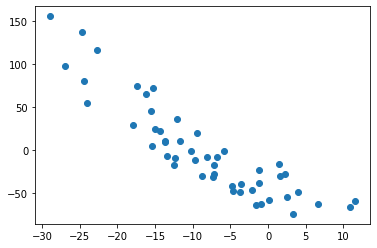

subject_13_stim_period_10_component_9   subject_13_stimulus_12_component_4   SpearmanrResult(correlation=-0.775750300120048, pvalue=3.685444595600344e-11)   3.755389550021443


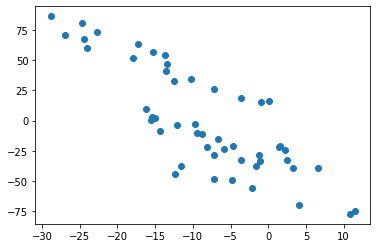

subject_13_stim_period_10_component_9   subject_13_stimulus_9_component_1   SpearmanrResult(correlation=-0.7767106842737095, pvalue=3.364244238888896e-11)   3.6894508909793355


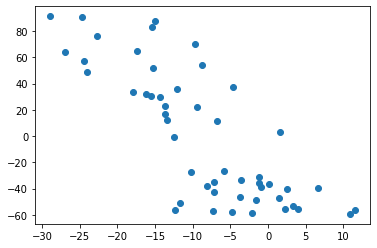

subject_13_stim_period_10_component_9   subject_13_stim_period_10_component_6   SpearmanrResult(correlation=-0.8546938775510203, pvalue=2.8671134004946035e-15)   3.646212096024734


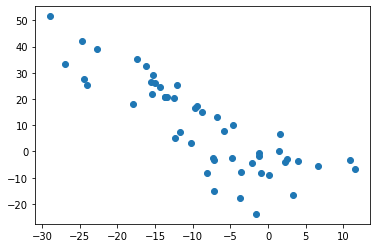

subject_13_stim_period_11_component_0   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.817970117499516, pvalue=4.1269340739626496e-13)   2.0958219811818677


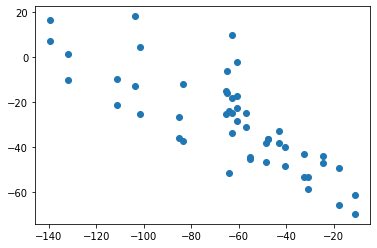

subject_13_stim_period_11_component_0   subject_13_stimulus_10_component_2   SpearmanrResult(correlation=0.7708523409363746, pvalue=5.827518401904913e-11)   5.783315500125127


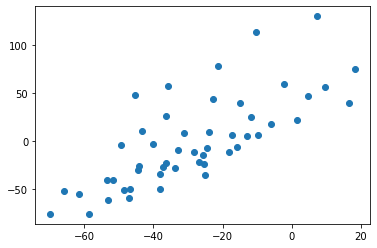

subject_13_stim_period_11_component_0   subject_13_stimulus_11_component_0   SpearmanrResult(correlation=0.8272268907563025, pvalue=1.3181280694654356e-13)   4.857843173919781


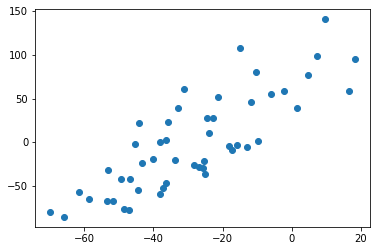

subject_13_stim_period_11_component_0   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.818295318127251, pvalue=3.9690939660058947e-13)   2.5021627602553704


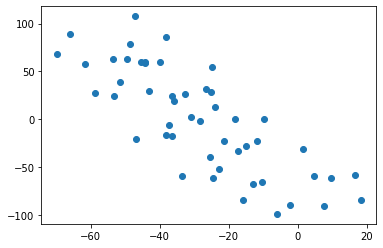

subject_13_stim_period_11_component_0   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.815222088835534, pvalue=5.720245707122966e-13)   6.13017570854833


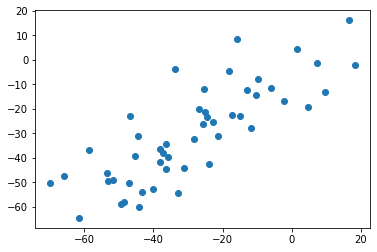

subject_13_stim_period_11_component_3   subject_13_stimulus_11_component_0   SpearmanrResult(correlation=0.815126050420168, pvalue=5.785320528987719e-13)   6.540045642280786


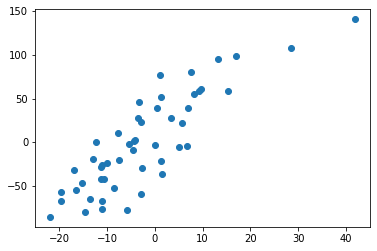

subject_13_stim_period_11_component_3   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.7995678271308523, pvalue=3.3318323166972648e-12)   6.006328413565834


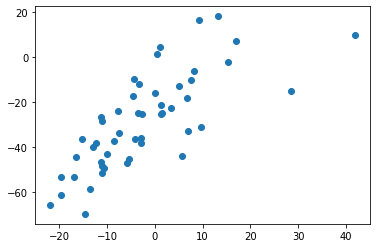

subject_13_stim_period_11_component_3   subject_13_stim_period_11_component_2   SpearmanrResult(correlation=-0.8298199279711884, pvalue=9.45881311925649e-14)   6.0824575835577805


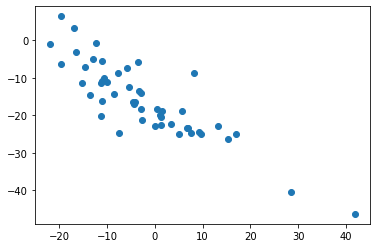

subject_13_stim_period_11_component_6   subject_13_stimulus_11_component_3   SpearmanrResult(correlation=0.7682593037214885, pvalue=7.393766899062619e-11)   6.318184143340152


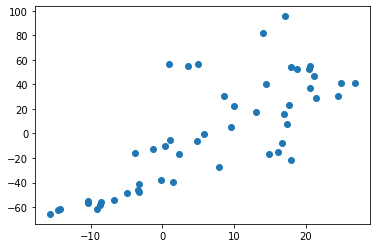

subject_13_stim_period_11_component_9   subject_13_stimulus_12_component_0   SpearmanrResult(correlation=-0.8441296518607444, pvalue=1.3631028468920465e-14)   3.635101104693714


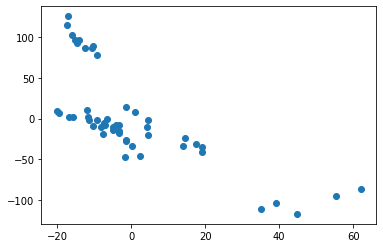

subject_13_stim_period_12_component_0   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=0.7945226658230731, pvalue=5.690115059526181e-12)   2.0958219811818677


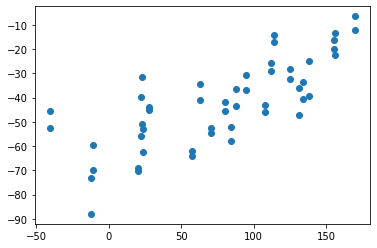

subject_13_stim_period_12_component_0   subject_13_stimulus_12_component_1   SpearmanrResult(correlation=0.8239615846338535, pvalue=1.9864926931322843e-13)   5.545082447128068


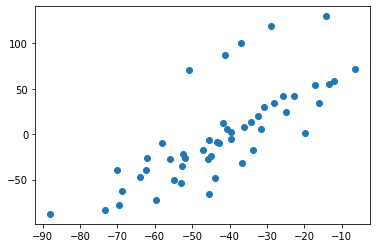

subject_13_stim_period_12_component_1   subject_13_stimulus_11_component_4   SpearmanrResult(correlation=-0.7582713085234093, pvalue=1.79871775934061e-10)   6.2748842873886685


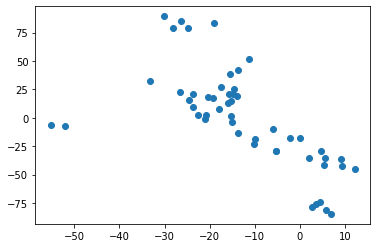

subject_13_stim_period_12_component_1   subject_13_stimulus_12_component_0   SpearmanrResult(correlation=0.7609603841536614, pvalue=1.4218521798052765e-10)   7.599732229018601


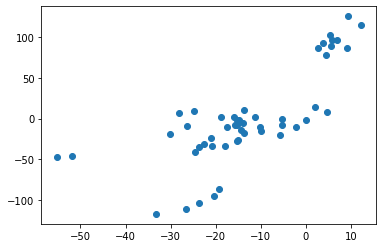

subject_13_stim_period_12_component_5   subject_13_stimulus_12_component_1   SpearmanrResult(correlation=-0.8358703481392556, pvalue=4.2652479808128626e-14)   7.004842421010882


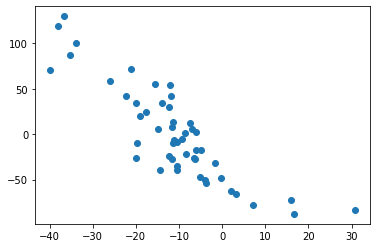

subject_13_stim_period_12_component_6   subject_13_stimulus_12_component_0   SpearmanrResult(correlation=0.8090756302521008, pvalue=1.164742128055993e-12)   6.504249262077963


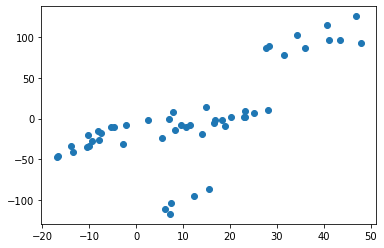

subject_13_stim_period_12_component_6   subject_13_stimulus_9_component_1   SpearmanrResult(correlation=0.8437454981992797, pvalue=1.4394644307396936e-14)   6.917183665288944


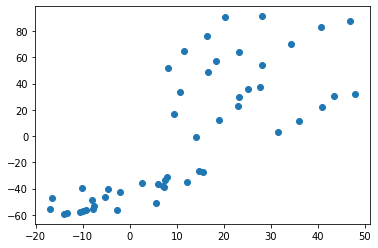

subject_13_stim_period_12_component_6   subject_13_stim_period_11_component_6   SpearmanrResult(correlation=0.8731332533013205, pvalue=1.3718424124621627e-16)   7.95743233363091


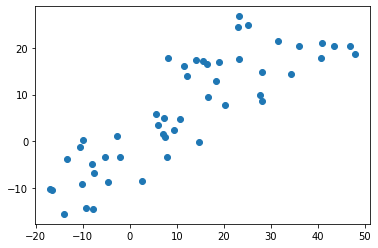

subject_13_stim_period_12_component_6   subject_13_stim_period_11_component_9   SpearmanrResult(correlation=-0.7586554621848739, pvalue=1.7396302303459205e-10)   3.646212096024734


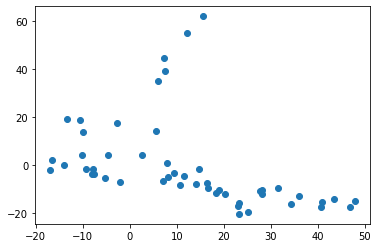

subject_13_stim_period_12_component_8   subject_13_stim_period_12_component_7   SpearmanrResult(correlation=0.7769987995198078, pvalue=3.2731717605565287e-11)   7.198615640281581


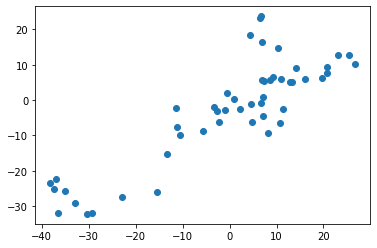

subject_13_stim_period_12_component_9   subject_13_stimulus_12_component_0   SpearmanrResult(correlation=-0.87015606242497, pvalue=2.3115588562684337e-16)   3.635101104693714


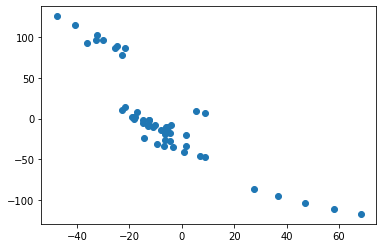

subject_13_stim_period_12_component_9   subject_13_stim_period_12_component_1   SpearmanrResult(correlation=-0.7754621848739495, pvalue=3.787326596669229e-11)   3.7961817140355896


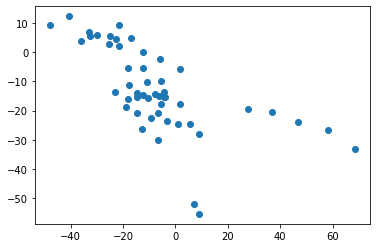

subject_13_stim_period_14_component_0   subject_13_stimulus_14_component_0   SpearmanrResult(correlation=0.9827302730273025, pvalue=1.2750796603660555e-73)   4.926180609986694


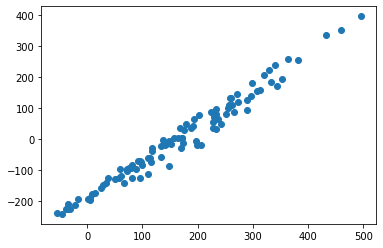

subject_13_stim_period_14_component_0   subject_13_stimulus_15_component_0   SpearmanrResult(correlation=0.8557815781578156, pvalue=8.33902617804516e-30)   2.9868172417716696


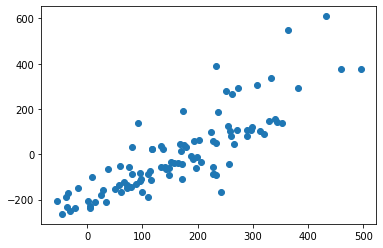

subject_13_stim_period_14_component_1   subject_13_stimulus_14_component_1   SpearmanrResult(correlation=0.8771677167716769, pvalue=5.4803575357831294e-33)   7.715305054113749


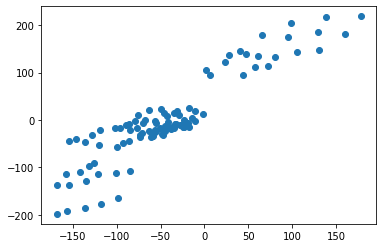

subject_13_stim_period_14_component_1   subject_13_stimulus_15_component_1   SpearmanrResult(correlation=0.7845784578457846, pvalue=4.616626281279474e-22)   8.6659082467661


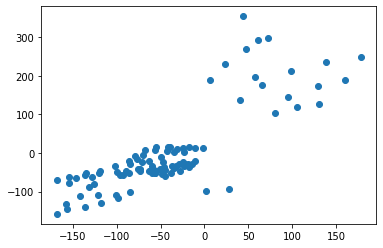

subject_13_stim_period_14_component_1   subject_13_stimulus_9_component_1   SpearmanrResult(correlation=-0.7988957329230553, pvalue=2.3080070910843784e-23)   7.669459298786193


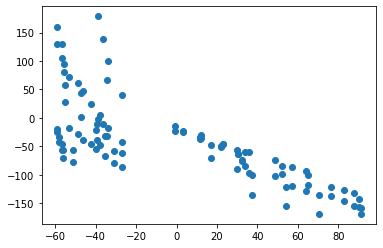

subject_13_stim_period_14_component_1   subject_13_stim_period_10_component_6   SpearmanrResult(correlation=-0.7837959578093618, pvalue=5.402199164994066e-22)   7.228196312634035


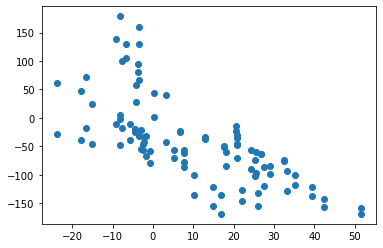

subject_13_stim_period_14_component_1   subject_13_stim_period_10_component_9   SpearmanrResult(correlation=0.7515318914297053, pvalue=2.0976477317215188e-19)   3.7961817140355896


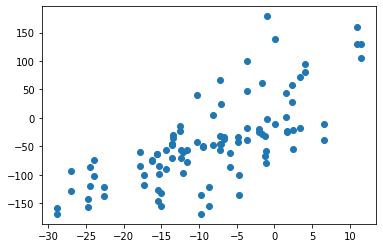

subject_13_stim_period_14_component_2   subject_13_stimulus_14_component_0   SpearmanrResult(correlation=0.907038703870387, pvalue=1.352335908456349e-38)   6.103698539719668


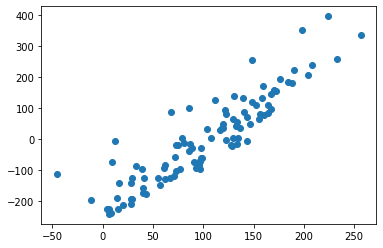

subject_13_stim_period_14_component_2   subject_13_stimulus_15_component_0   SpearmanrResult(correlation=0.7824182418241823, pvalue=7.11284106682755e-22)   2.7293088523418225


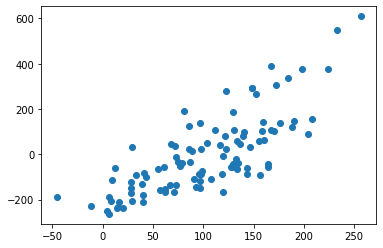

subject_13_stim_period_14_component_2   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.7665836545398577, pvalue=1.4644377168586832e-20)   4.439939013138064


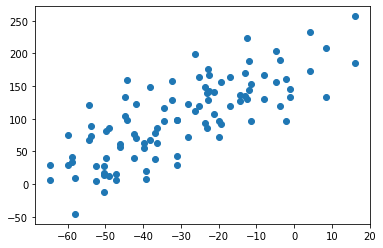

subject_13_stim_period_14_component_2   subject_13_stim_period_14_component_0   SpearmanrResult(correlation=0.8481368136813681, pvalue=8.634143384456872e-29)   4.439939013138064


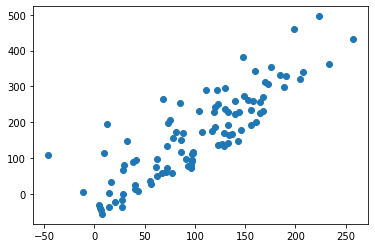

subject_13_stim_period_15_component_0   subject_13_stimulus_14_component_0   SpearmanrResult(correlation=0.8615181518151815, pvalue=1.3188794437106865e-30)   4.926180609986694


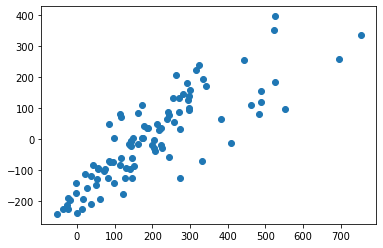

subject_13_stim_period_15_component_0   subject_13_stimulus_15_component_0   SpearmanrResult(correlation=0.9897989798979897, pvalue=9.43560536954329e-85)   2.9868172417716696


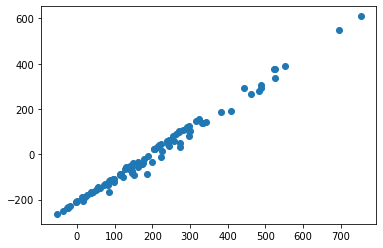

subject_13_stim_period_15_component_0   subject_13_stim_period_14_component_0   SpearmanrResult(correlation=0.8651665166516651, pvalue=3.9077336449561324e-31)   6.13017570854833


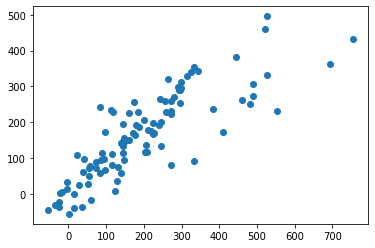

subject_13_stim_period_15_component_0   subject_13_stim_period_14_component_2   SpearmanrResult(correlation=0.7633723372337233, pvalue=2.6271989370332594e-20)   4.439939013138064


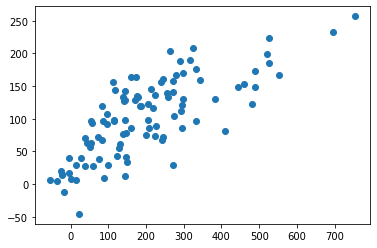

subject_13_stim_period_15_component_1   subject_13_stimulus_14_component_1   SpearmanrResult(correlation=0.8152895289528952, pvalue=5.472381488004569e-25)   7.715305054113749


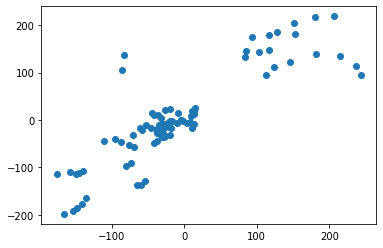

subject_13_stim_period_15_component_1   subject_13_stimulus_15_component_1   SpearmanrResult(correlation=0.9656285628562855, pvalue=3.761430655525062e-59)   8.6659082467661


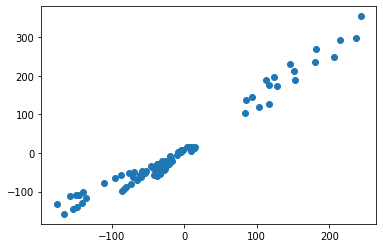

subject_13_stim_period_15_component_1   subject_13_stim_period_14_component_1   SpearmanrResult(correlation=0.8237743774377437, pvalue=6.797438191433011e-26)   10.42723798197723


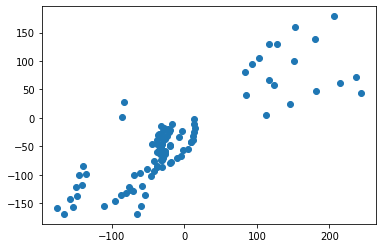

subject_13_stim_period_15_component_2   subject_13_stimulus_14_component_0   SpearmanrResult(correlation=-0.8146774677467745, pvalue=6.334544509612552e-25)   6.103698539719668


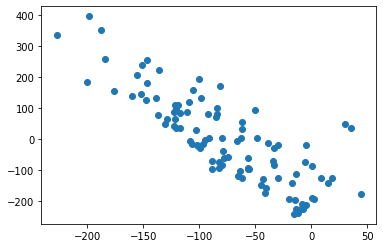

subject_13_stim_period_15_component_2   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=-0.7662715765168402, pvalue=1.550655171736207e-20)   4.439939013138064


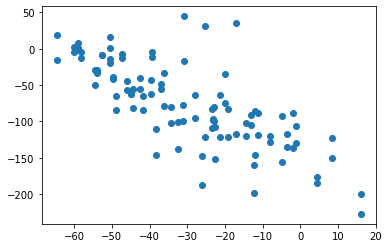

subject_13_stim_period_15_component_2   subject_13_stim_period_14_component_2   SpearmanrResult(correlation=-0.8490489048904889, pvalue=6.577625683588577e-29)   7.987014260818152


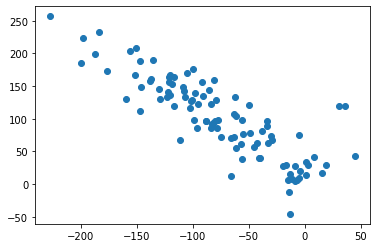

subject_13_stim_period_15_component_6   subject_13_stim_period_14_component_6   SpearmanrResult(correlation=0.9006660666066605, pvalue=2.9772786777311185e-37)   7.95743233363091


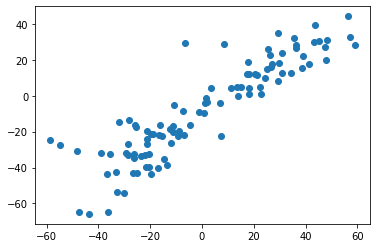

subject_13_stim_period_15_component_7   subject_13_stimulus_15_component_2   SpearmanrResult(correlation=0.7599279927992798, pvalue=4.867532561946018e-20)   8.644946597250492


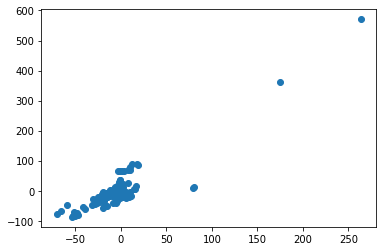

subject_13_stim_period_1_component_1   subject_13_stimulus_1_component_0   SpearmanrResult(correlation=0.9341661700919753, pvalue=3.9163640481774104e-198)   8.572285229288589


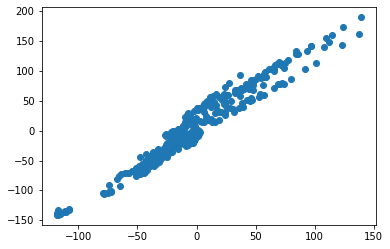

subject_13_stim_period_1_component_9   subject_13_stimulus_1_component_1   SpearmanrResult(correlation=0.79483548233955, pvalue=4.5908760538491436e-97)   2.812252885847864


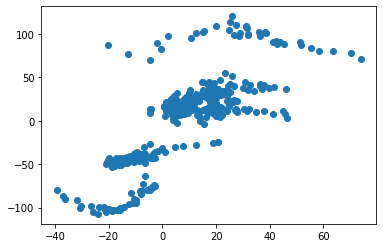

subject_13_stim_period_2_component_0   subject_13_stimulus_2_component_0   SpearmanrResult(correlation=0.8844971494499643, pvalue=4.070029282250656e-147)   5.513981729308452


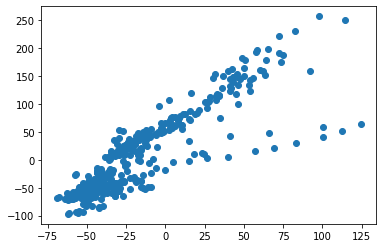

subject_13_stim_period_2_component_1   subject_13_stimulus_2_component_0   SpearmanrResult(correlation=0.8676781294418783, pvalue=4.9516012836206635e-135)   9.65590675474671


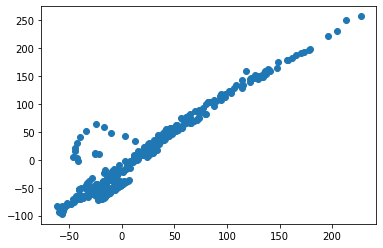

subject_13_stim_period_2_component_4   subject_13_stimulus_2_component_0   SpearmanrResult(correlation=-0.8177727251596434, pvalue=3.813589165330372e-107)   4.5916232812575295


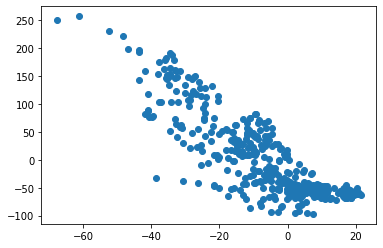

subject_13_stim_period_2_component_4   subject_13_stim_period_2_component_0   SpearmanrResult(correlation=-0.8105916212001469, pvalue=7.66923681337159e-104)   3.9605111991534665


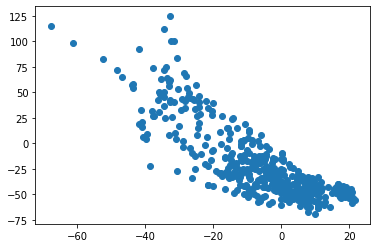

subject_13_stim_period_2_component_7   subject_13_stim_period_1_component_6   SpearmanrResult(correlation=-0.7591829691081237, pvalue=1.0291863643114663e-83)   7.763707607761023


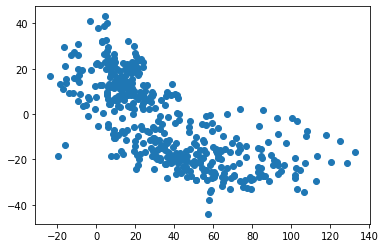

subject_13_stim_period_3_component_0   subject_13_stimulus_3_component_0   SpearmanrResult(correlation=0.9932772594732289, pvalue=0.0)   4.764574187478685


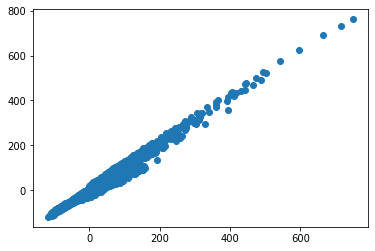

subject_13_stim_period_3_component_1   subject_13_stimulus_3_component_1   SpearmanrResult(correlation=0.8475360098590227, pvalue=0.0)   8.696942246961498


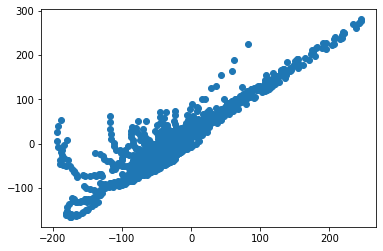

subject_13_stim_period_3_component_2   subject_13_stimulus_3_component_2   SpearmanrResult(correlation=0.9074360850114417, pvalue=0.0)   7.475945199699295


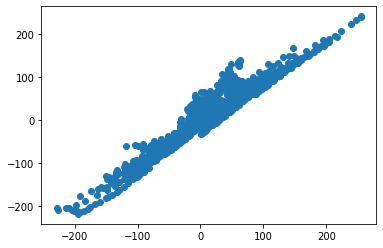

subject_13_stim_period_3_component_3   subject_13_stimulus_3_component_3   SpearmanrResult(correlation=0.9343365242684689, pvalue=0.0)   10.387009341022988


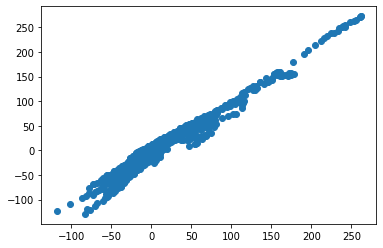

subject_13_stim_period_3_component_5   subject_13_stimulus_3_component_5   SpearmanrResult(correlation=0.7855179704590074, pvalue=0.0)   7.058451397820012


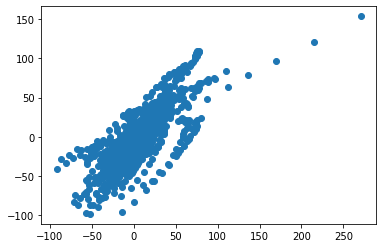

subject_13_stim_period_3_component_6   subject_13_stimulus_3_component_4   SpearmanrResult(correlation=-0.8825549069969717, pvalue=0.0)   6.075997596662784


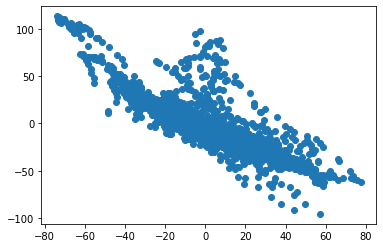

subject_13_stim_period_4_component_0   subject_13_stimulus_4_component_0   SpearmanrResult(correlation=0.9431050993785411, pvalue=0.0)   5.619742606986497


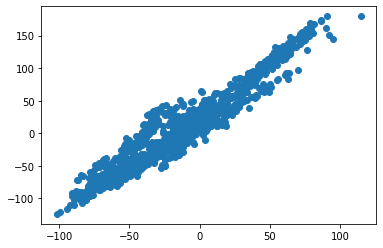

subject_13_stim_period_4_component_1   subject_13_stimulus_4_component_0   SpearmanrResult(correlation=0.9328123422307933, pvalue=0.0)   9.62512671991135


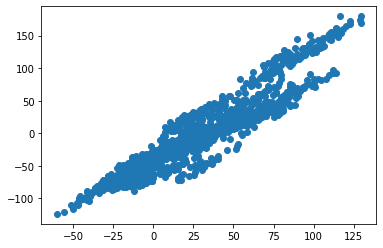

subject_13_stim_period_4_component_1   subject_13_stim_period_4_component_0   SpearmanrResult(correlation=0.8246354059968097, pvalue=1.0277277384730762e-298)   5.781258524483096


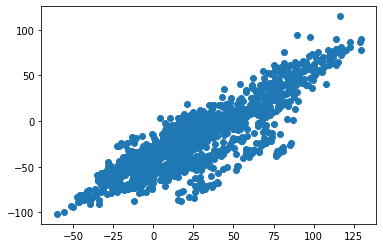

subject_13_stim_period_9_component_0   subject_12_stim_period_15_component_9   SpearmanrResult(correlation=0.7703064452392058, pvalue=6.128574419881941e-11)   3.703306690877546


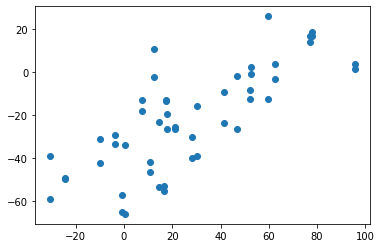

subject_13_stim_period_9_component_0   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.9374789915966386, pvalue=1.213998495610375e-23)   2.5021627602553704


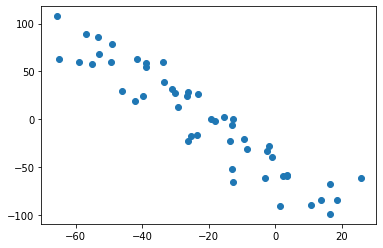

subject_13_stim_period_9_component_0   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.7931332533013205, pvalue=6.576646762818652e-12)   6.13017570854833


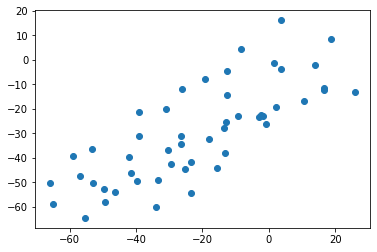

subject_13_stim_period_9_component_0   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.8144537815126051, pvalue=6.260908374008791e-13)   6.13017570854833


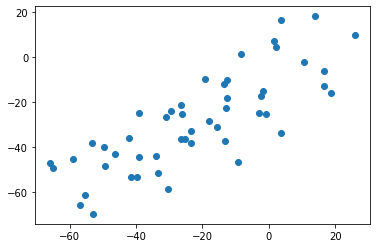

subject_13_stim_period_9_component_0   subject_13_stim_period_14_component_2   SpearmanrResult(correlation=0.7901095362750238, pvalue=1.4917590753087267e-22)   4.439939013138064


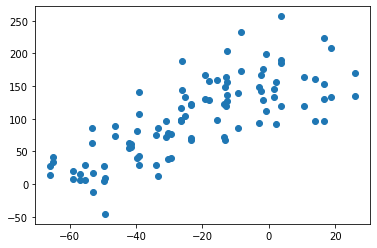

subject_13_stim_period_9_component_0   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=-0.7538124615979104, pvalue=1.4188179240468134e-19)   4.439939013138064


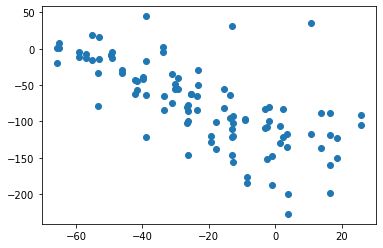

subject_13_stim_period_9_component_3   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=0.8476830732292917, pvalue=8.17521532326923e-15)   6.006328413565834


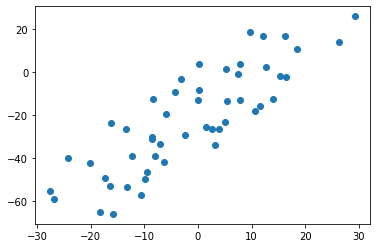

subject_13_stim_period_9_component_5   subject_13_stimulus_11_component_0   SpearmanrResult(correlation=-0.790252100840336, pvalue=8.849015569436863e-12)   5.705516339039251


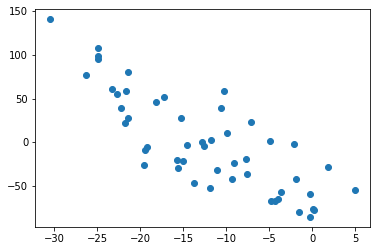

subject_13_stim_period_9_component_5   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=0.7702761104441777, pvalue=6.145727852216548e-11)   2.593182890695588


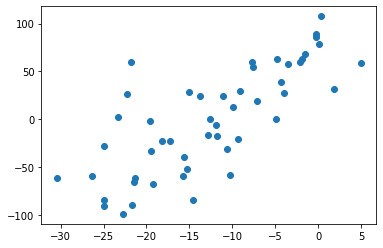

subject_13_stim_period_9_component_5   subject_13_stim_period_11_component_5   SpearmanrResult(correlation=0.8456662665066026, pvalue=1.0944586592447938e-14)   8.049200880693686


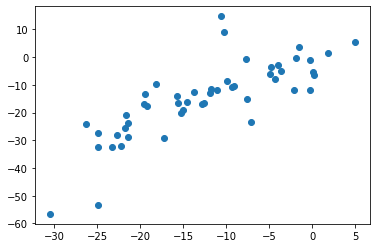

subject_13_stim_period_9_component_5   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=-0.7740216086434574, pvalue=4.337976533728288e-11)   5.218118773066444


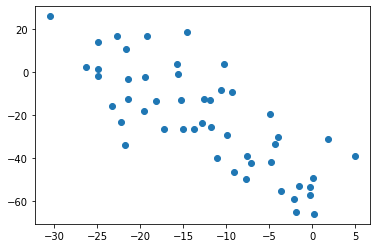

subject_13_stim_period_9_component_5   subject_13_stim_period_9_component_3   SpearmanrResult(correlation=-0.779015606242497, pvalue=2.6979988966243638e-11)   7.912691401019224


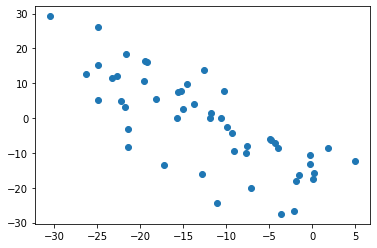

subject_13_stim_period_9_component_6   subject_13_stimulus_10_component_0   SpearmanrResult(correlation=0.8715966386554621, pvalue=1.7987147276099185e-16)   6.767657713585586


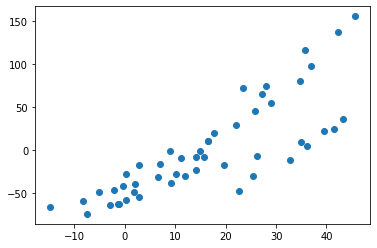

subject_13_stim_period_9_component_6   subject_13_stimulus_11_component_1   SpearmanrResult(correlation=0.8458583433373349, pvalue=1.0646590501488458e-14)   6.652180024832326


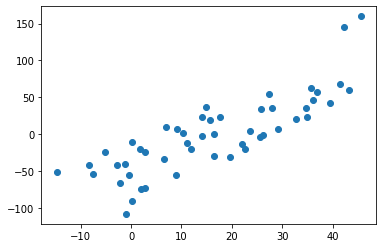

subject_13_stim_period_9_component_6   subject_13_stimulus_9_component_1   SpearmanrResult(correlation=0.8973349339735894, pvalue=1.1314262188109336e-18)   6.917183665288944


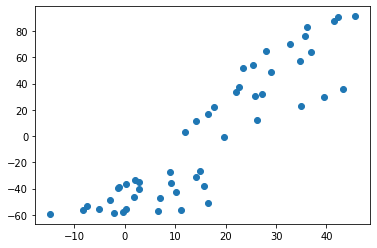

subject_13_stim_period_9_component_6   subject_13_stim_period_10_component_6   SpearmanrResult(correlation=0.8936854741896758, pvalue=2.507957070573933e-18)   7.95743233363091


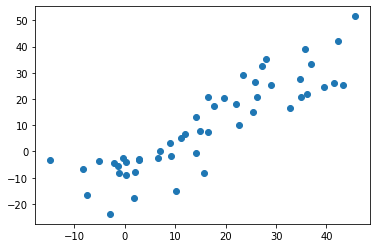

subject_13_stim_period_9_component_6   subject_13_stim_period_10_component_9   SpearmanrResult(correlation=-0.8718847539015606, pvalue=1.710080832094357e-16)   3.646212096024734


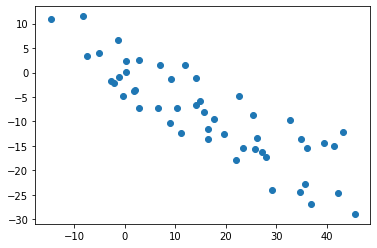

subject_13_stim_period_9_component_6   subject_13_stim_period_11_component_6   SpearmanrResult(correlation=0.7696038415366147, pvalue=6.537734339924735e-11)   7.95743233363091


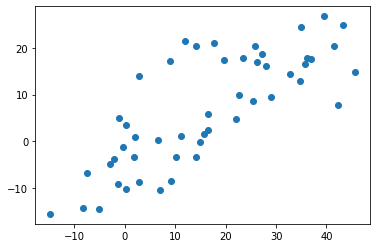

subject_13_stim_period_9_component_6   subject_13_stim_period_11_component_9   SpearmanrResult(correlation=-0.7754621848739495, pvalue=3.787326596669229e-11)   3.646212096024734


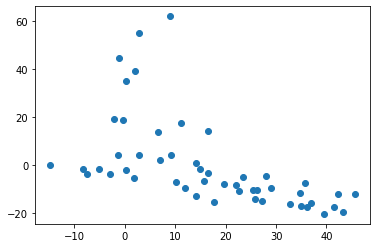

subject_13_stim_period_9_component_6   subject_13_stim_period_12_component_6   SpearmanrResult(correlation=0.7987034813925569, pvalue=3.655689883841239e-12)   7.95743233363091


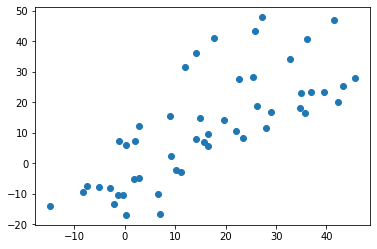

subject_13_stim_period_9_component_6   subject_13_stim_period_14_component_1   SpearmanrResult(correlation=-0.8356009096302686, pvalue=3.0589241250311614e-27)   7.228196312634035


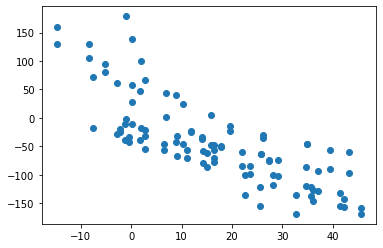

subject_13_stim_period_9_component_6   subject_13_stim_period_15_component_1   SpearmanrResult(correlation=-0.7871567980572427, pvalue=2.7379796062201293e-22)   7.228196312634035


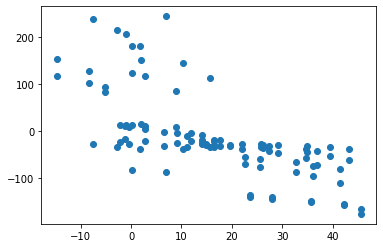

subject_13_stim_period_9_component_7   subject_13_stim_period_9_component_2   SpearmanrResult(correlation=-0.796686674669868, pvalue=4.531252613718845e-12)   5.9802537820804265


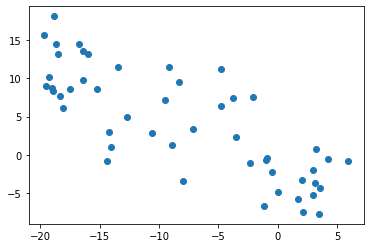

subject_13_stim_period_9_component_8   subject_13_stimulus_11_component_0   SpearmanrResult(correlation=0.7591356542617046, pvalue=1.66834795813293e-10)   5.582680614659807


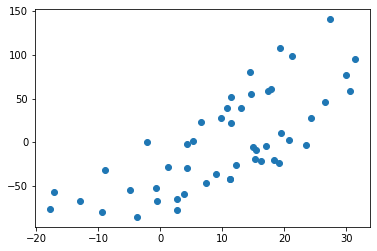

subject_13_stim_period_9_component_8   subject_13_stim_period_10_component_5   SpearmanrResult(correlation=-0.8380792316926771, pvalue=3.16349042403847e-14)   6.204840675091518


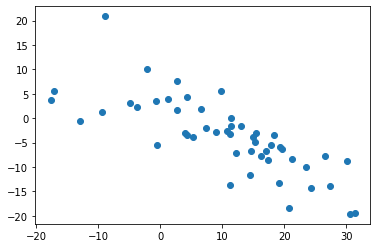

subject_14_stimulus_10_component_0   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.7758348241001052, pvalue=3.6560510805044644e-11)   2.1445539514690215


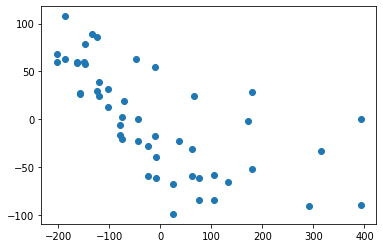

subject_14_stimulus_10_component_0   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.7846265618430193, pvalue=1.5590952189393426e-11)   4.824485372991303


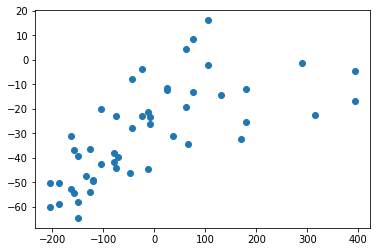

subject_14_stimulus_10_component_0   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.7859237034772198, pvalue=1.370272750923281e-11)   4.824485372991303


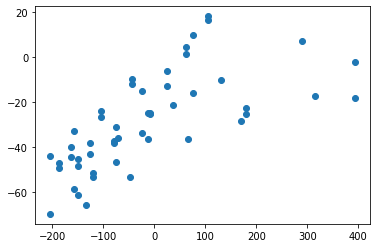

subject_14_stimulus_10_component_0   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=-0.800492431942992, pvalue=1.6279568770391525e-23)   6.09668787868191


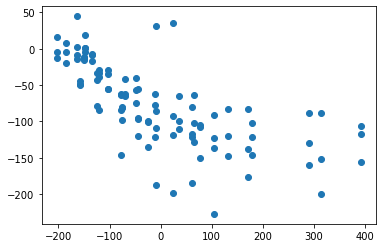

subject_14_stimulus_10_component_0   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=0.7577709257867955, pvalue=1.8785292824852984e-10)   4.824485372991303


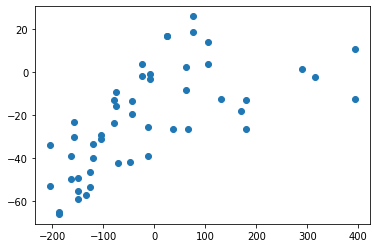

subject_14_stimulus_10_component_1   subject_13_stim_period_9_component_2   SpearmanrResult(correlation=-0.7675235091846728, pvalue=7.906038522291091e-11)   1.5624394960788313


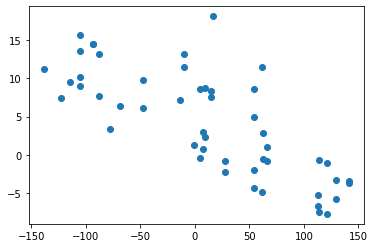

subject_14_stimulus_10_component_3   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=-0.7964386319434099, pvalue=1.4087630123696922e-07)   6.783976178845963


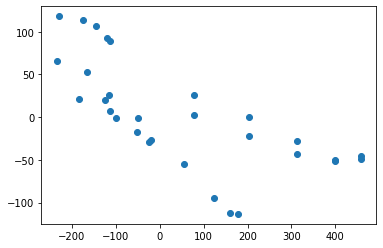

subject_14_stimulus_10_component_3   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=-0.8227046348973849, pvalue=2.423028459273616e-08)   2.9460571954931014


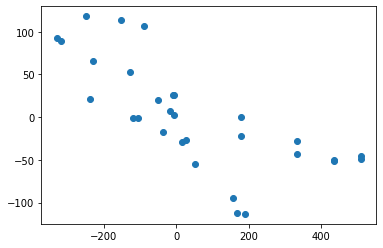

subject_14_stimulus_10_component_3   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=-0.8543128757403038, pvalue=1.905955791895059e-09)   9.653035874245077


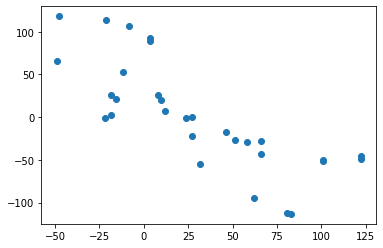

subject_14_stimulus_10_component_3   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=-0.8654425380089372, pvalue=6.732393036433495e-10)   6.344863488343009


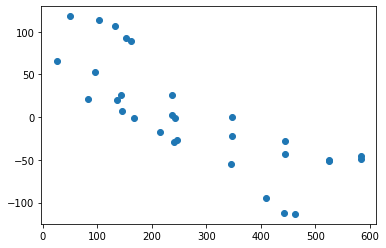

subject_14_stimulus_10_component_3   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=0.8382861620734716, pvalue=7.402878909111785e-09)   9.267888596742296


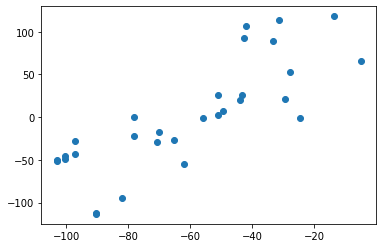

subject_14_stimulus_10_component_3   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=-0.8053423617583166, pvalue=7.990955346606552e-08)   9.653035874245077


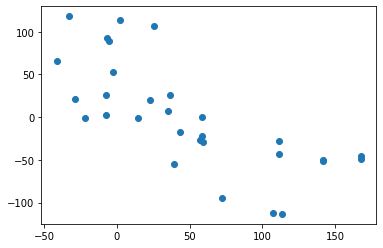

subject_14_stimulus_10_component_3   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=-0.7710630019709257, pvalue=6.155960813614393e-07)   6.344863488343009


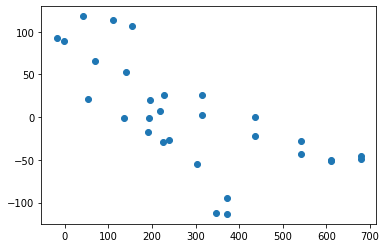

subject_14_stimulus_10_component_5   subject_12_stim_period_14_component_4   SpearmanrResult(correlation=0.7826378507303043, pvalue=3.2183609988294975e-07)   1.5763625079021384


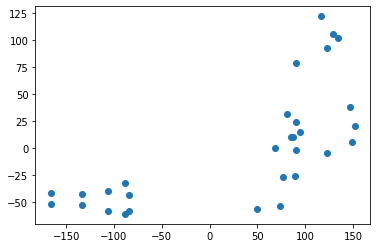

subject_14_stimulus_10_component_5   subject_12_stim_period_14_component_8   SpearmanrResult(correlation=0.7759600533691243, pvalue=4.7005224040303636e-07)   4.71069297422945


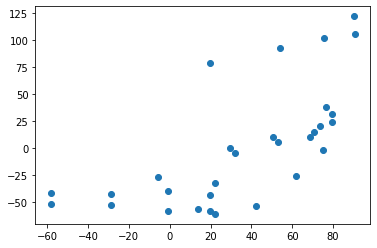

subject_14_stimulus_11_component_0   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.8036513058112924, pvalue=2.1363890440671894e-12)   4.487940559862054


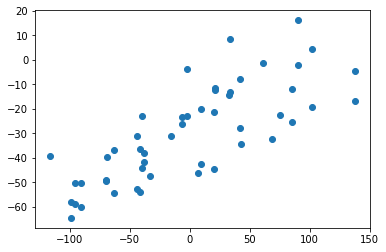

subject_14_stimulus_11_component_0   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.8193611322699421, pvalue=3.490986511123584e-13)   4.487940559862054


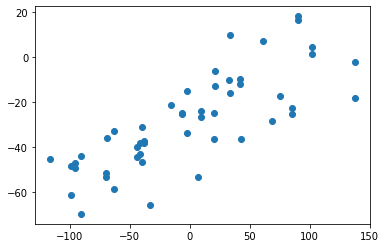

subject_14_stimulus_11_component_0   subject_13_stim_period_9_component_3   SpearmanrResult(correlation=0.7563296573043505, pvalue=2.127525185855436e-10)   9.825956966471285


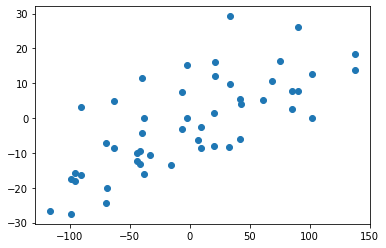

subject_14_stimulus_11_component_0   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=0.8941045606229142, pvalue=2.8279288578362313e-11)   11.811443167855412


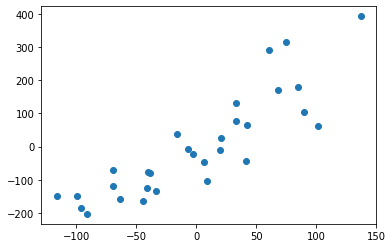

subject_14_stimulus_11_component_1   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=-0.8805788786942789, pvalue=1.3958248852798782e-10)   6.8941949422948055


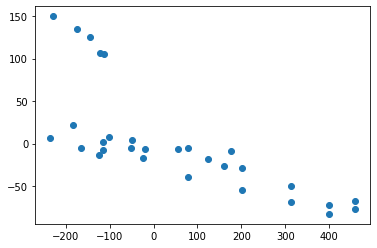

subject_14_stimulus_11_component_1   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=-0.9121871195371978, pvalue=2.3054924085881784e-12)   2.9724859391632243


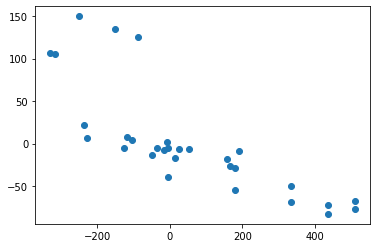

subject_14_stimulus_11_component_1   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=-0.7853089696747764, pvalue=2.7556575537590076e-07)   12.387874049342782


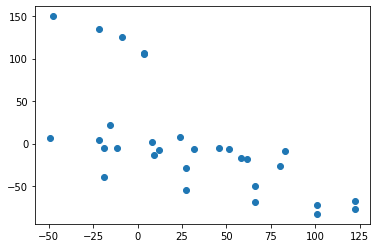

subject_14_stimulus_11_component_1   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=-0.8351698566382543, pvalue=9.475668436424616e-09)   6.384745507306038


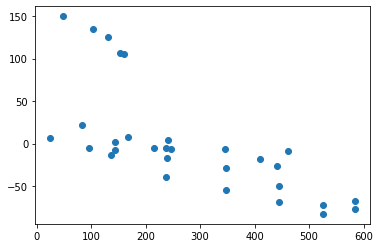

subject_14_stimulus_11_component_1   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=0.8707847758978814, pvalue=3.9517734925697535e-10)   6.175919546278887


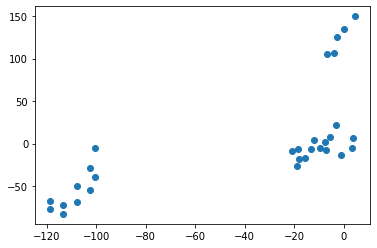

subject_14_stimulus_11_component_1   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=0.8552032487217945, pvalue=1.759322055266246e-09)   2.841812753652653


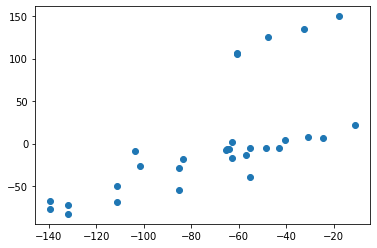

subject_14_stimulus_11_component_1   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=0.8747914543145894, pvalue=2.608896633597275e-10)   10.653440905936694


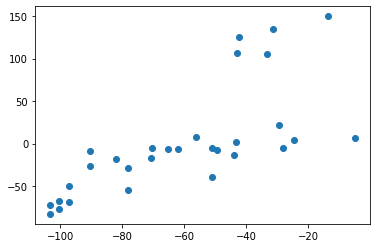

subject_14_stimulus_11_component_1   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=-0.8048971752675713, pvalue=8.226327577985423e-08)   12.387874049342782


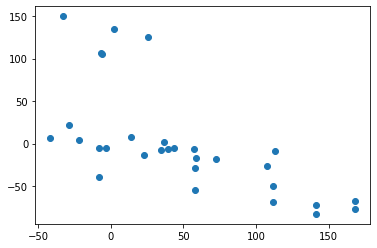

subject_14_stimulus_11_component_1   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=-0.9228715953150858, pvalue=4.0101442891270183e-13)   6.384745507306038


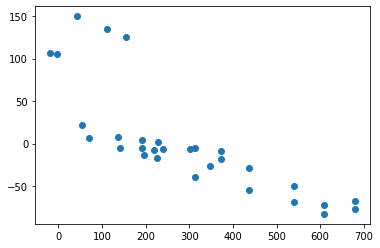

subject_14_stimulus_11_component_1   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=0.7942126994896831, pvalue=1.6163002796934484e-07)   5.097682942621349


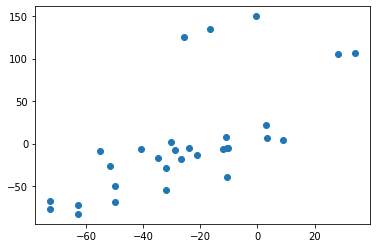

subject_14_stimulus_11_component_1   subject_12_stim_period_15_component_6   SpearmanrResult(correlation=0.8329439241845277, pvalue=1.1267936620461151e-08)   2.9554178410759655


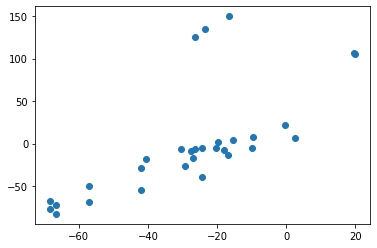

subject_14_stimulus_11_component_2   subject_10_stimulus_22_component_0   SpearmanrResult(correlation=-0.7553254066099877, pvalue=5.940599464374149e-29)   3.4457830675803316


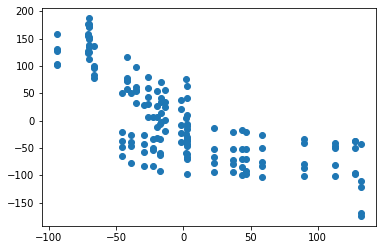

subject_14_stimulus_11_component_2   subject_10_stim_period_1_component_1   SpearmanrResult(correlation=-0.7625479895498364, pvalue=2.611968997986656e-58)   3.4457830675803316


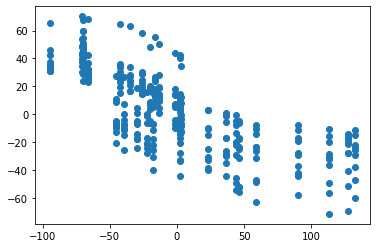

subject_14_stimulus_11_component_2   subject_10_stim_period_21_component_1   SpearmanrResult(correlation=-0.7873794868622385, pvalue=6.6827796570727e-33)   3.4457830675803316


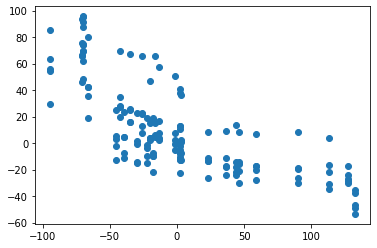

subject_14_stimulus_11_component_2   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.7709077452897721, pvalue=8.597809543704008e-31)   3.0569155597657804


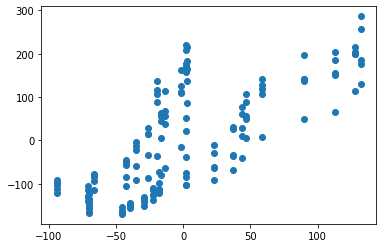

subject_14_stimulus_11_component_2   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.7667987039255825, pvalue=2.7122052889912888e-30)   3.017638915957024


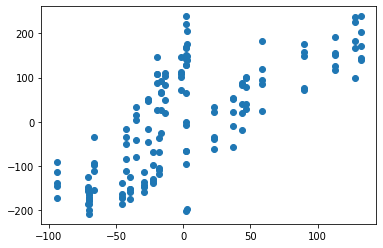

subject_14_stimulus_11_component_2   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.818668680626783, pvalue=1.7795426828523418e-37)   3.0579031165502957


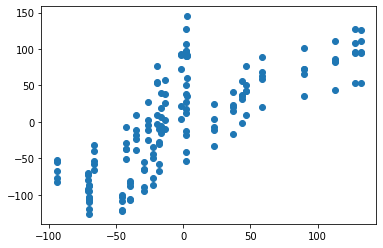

subject_14_stimulus_11_component_2   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.791452952110721, pvalue=1.8803548022182722e-33)   2.7183163912756356


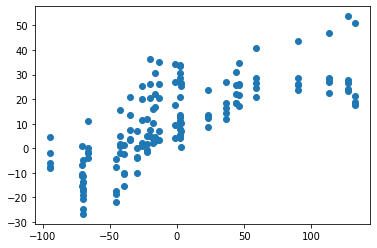

subject_14_stimulus_11_component_2   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.7557167438827677, pvalue=5.362058982746705e-29)   2.8886093182309733


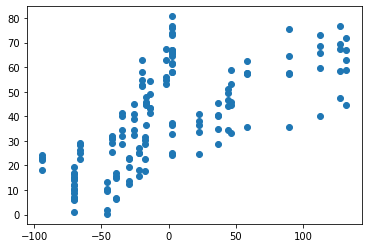

subject_14_stimulus_11_component_2   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.7549874335107687, pvalue=6.489236248229906e-29)   3.066069715161974


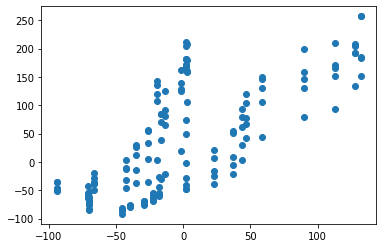

subject_14_stimulus_11_component_2   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.7709966855790404, pvalue=8.384430783364743e-31)   2.7232086155844915


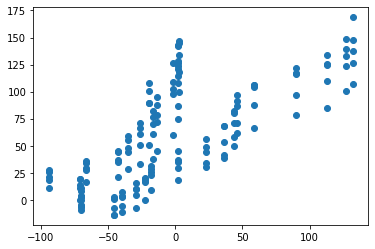

subject_14_stimulus_11_component_2   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=0.7704096796698704, pvalue=9.895021440507367e-31)   2.8886093182309733


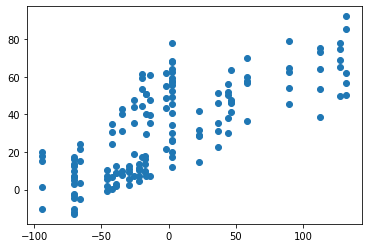

subject_14_stimulus_11_component_2   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=0.7667453397520215, pvalue=2.752547116727323e-30)   3.066069715161974


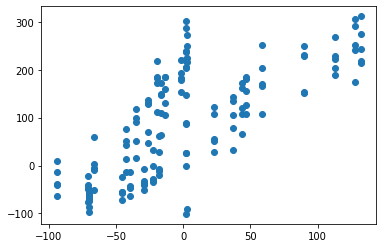

subject_14_stimulus_11_component_2   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=0.7804599323571743, pvalue=5.411156256563095e-32)   2.8886093182309733


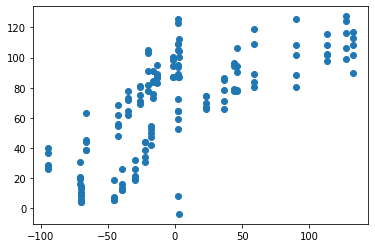

subject_14_stimulus_11_component_2   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=0.8140971497583988, pvalue=9.375313472765242e-37)   2.3352131729833157


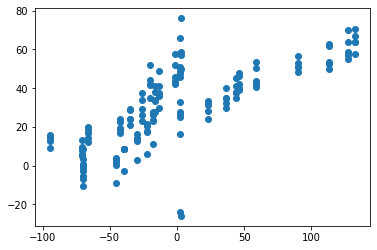

subject_14_stimulus_11_component_2   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=0.8426114064977759, pvalue=1.2805371547367385e-41)   2.7232086155844915


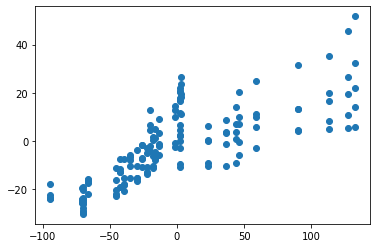

subject_14_stimulus_11_component_2   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=0.8140082094691304, pvalue=9.678954259980666e-37)   2.7183163912756356


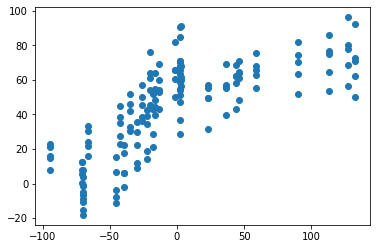

subject_14_stimulus_11_component_2   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=0.7979100171115905, pvalue=2.3748011381058965e-34)   2.7702438257804824


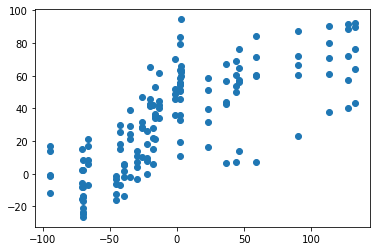

subject_14_stimulus_11_component_4   subject_12_stimulus_14_component_1   SpearmanrResult(correlation=-0.9081804411204896, pvalue=4.198080555873737e-12)   3.384924522214713


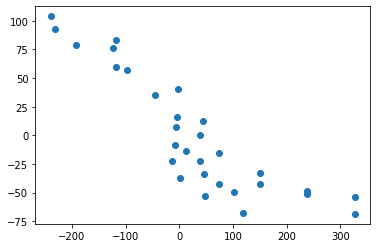

subject_14_stimulus_11_component_4   subject_12_stim_period_14_component_2   SpearmanrResult(correlation=-0.8685588434441548, pvalue=4.947879793809636e-10)   4.000523761123623


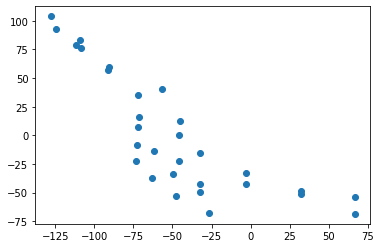

subject_14_stimulus_11_component_4   subject_12_stim_period_14_component_4   SpearmanrResult(correlation=0.8253757538418568, pvalue=1.9938100721417513e-08)   1.5553284238759284


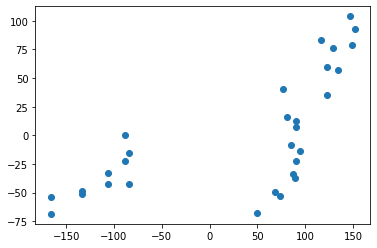

subject_14_stimulus_11_component_4   subject_13_stimulus_10_component_1   SpearmanrResult(correlation=-0.7787173610649952, pvalue=2.77656535338169e-11)   3.8844754146161735


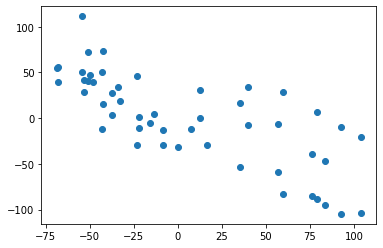

subject_14_stimulus_11_component_5   subject_13_stimulus_10_component_9   SpearmanrResult(correlation=0.8551526329173246, pvalue=2.672037597662582e-15)   4.222091917518261


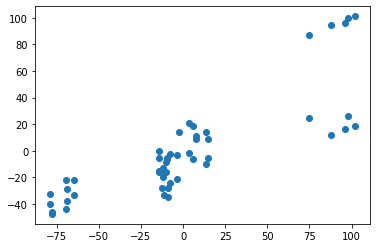

subject_14_stimulus_11_component_5   subject_14_stimulus_10_component_2   SpearmanrResult(correlation=0.7917686318131256, pvalue=1.875980690808134e-07)   4.559612583669417


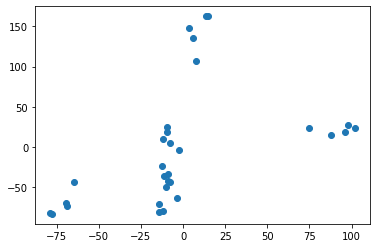

subject_14_stimulus_11_component_7   subject_14_stimulus_10_component_8   SpearmanrResult(correlation=0.7650723025583982, pvalue=8.487708184692093e-07)   7.93748549760513


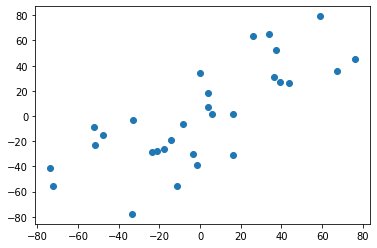

subject_14_stimulus_11_component_9   subject_12_stimulus_14_component_8   SpearmanrResult(correlation=0.7632722383828822, pvalue=9.330686140698474e-07)   5.11476700474798


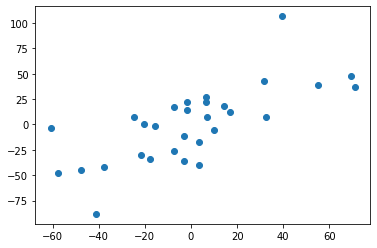

subject_14_stimulus_12_component_2   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=-0.8549806554764218, pvalue=1.7949764560301459e-09)   4.758358581425588


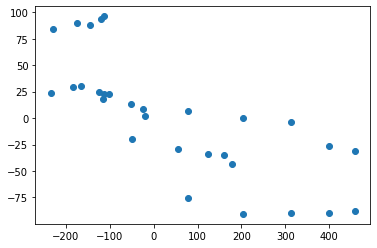

subject_14_stimulus_12_component_2   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=-0.8629940123098379, pvalue=8.530102692175085e-10)   2.8140335279657047


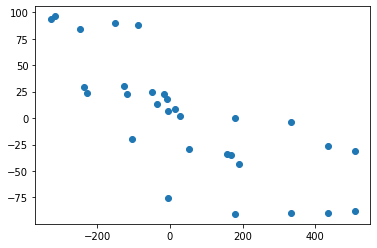

subject_14_stimulus_12_component_2   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=-0.8398443147910803, pvalue=6.5305511665838164e-09)   4.398189957662886


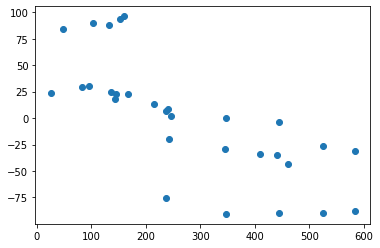

subject_14_stimulus_12_component_2   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=0.8460769256615149, pvalue=3.9016099539010745e-09)   4.574277369153634


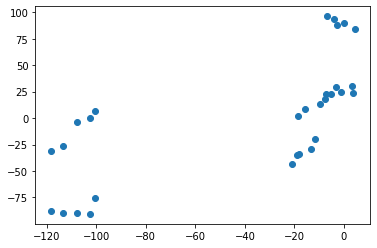

subject_14_stimulus_12_component_2   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=0.7748470871422609, pvalue=5.000628534514467e-07)   5.651687101783159


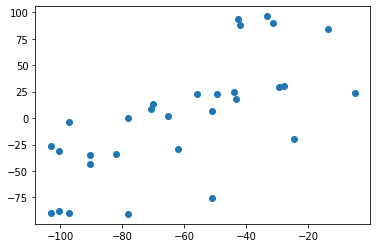

subject_14_stimulus_12_component_2   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=-0.8741236745784714, pvalue=2.7985690851800837e-10)   4.398189957662886


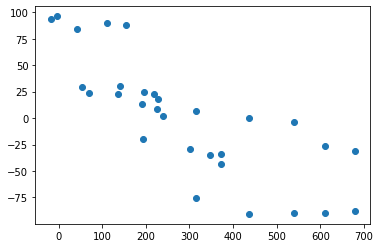

subject_14_stimulus_12_component_2   subject_12_stim_period_15_component_6   SpearmanrResult(correlation=0.7850863764294037, pvalue=2.791764050872604e-07)   2.535473584905936


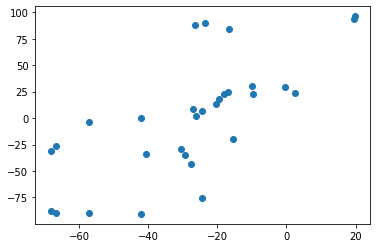

subject_14_stimulus_12_component_2   subject_14_stimulus_10_component_3   SpearmanrResult(correlation=0.8269187986651836, pvalue=1.7787676215196204e-08)   7.057346662753068


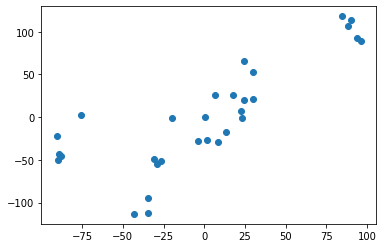

subject_14_stimulus_12_component_3   subject_12_stimulus_15_component_4   SpearmanrResult(correlation=0.8899277949999309, pvalue=4.7328358953580746e-11)   4.901692673414679


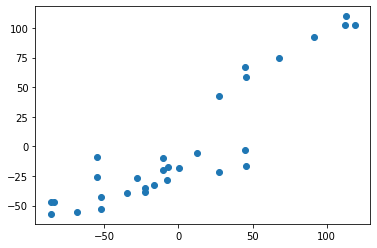

subject_14_stimulus_12_component_6   subject_12_stimulus_14_component_1   SpearmanrResult(correlation=-0.8100168199111426, pvalue=5.864857605080145e-08)   3.115062740861304


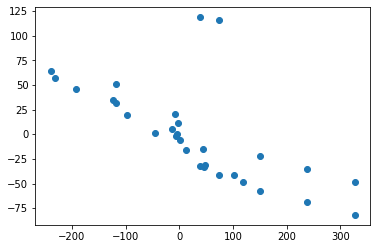

subject_14_stimulus_12_component_6   subject_12_stim_period_14_component_2   SpearmanrResult(correlation=-0.7855315629201491, pvalue=2.719976666057536e-07)   3.3503178056851395


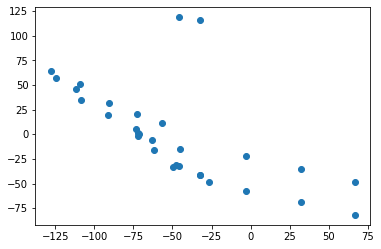

subject_14_stimulus_12_component_6   subject_13_stimulus_10_component_1   SpearmanrResult(correlation=-0.7864041263047015, pvalue=1.3060023694645135e-11)   3.5327385204222903


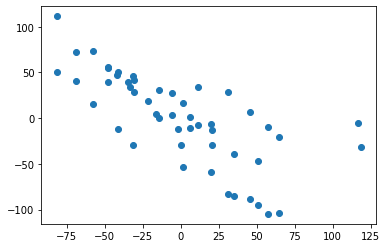

subject_14_stimulus_12_component_6   subject_14_stimulus_11_component_4   SpearmanrResult(correlation=0.850055617352614, pvalue=2.7748862781578192e-09)   5.2339595498352764


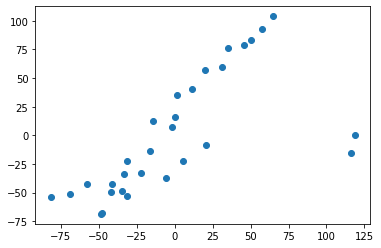

subject_14_stimulus_14_component_2   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=-0.8602534968759691, pvalue=1.1328579159326155e-12)   3.9200195937686626


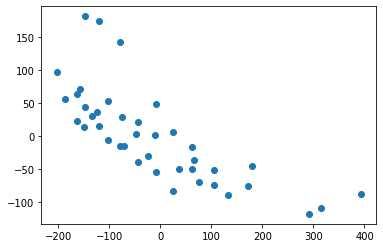

subject_14_stimulus_14_component_2   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=-0.7560770424212095, pvalue=1.686361823412707e-08)   3.9866862604353295


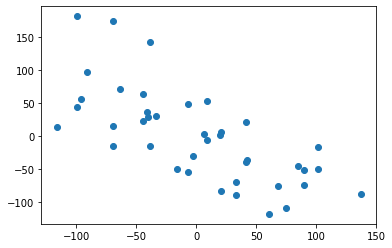

subject_14_stimulus_14_component_3   subject_10_stimulus_14_component_6   SpearmanrResult(correlation=0.7848030018761728, pvalue=2.051146149253828e-09)   9.829886087834275


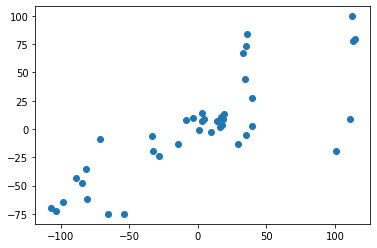

subject_14_stimulus_14_component_3   subject_10_stimulus_15_component_7   SpearmanrResult(correlation=0.7679174484052533, pvalue=7.338301306280613e-09)   5.903361564615672


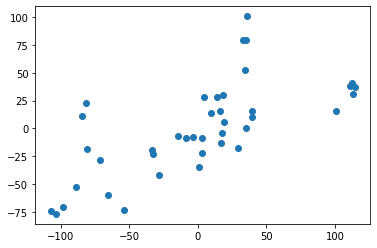

subject_14_stimulus_14_component_4   subject_10_stimulus_14_component_3   SpearmanrResult(correlation=-0.8317073170731708, pvalue=2.978575313121176e-11)   3.8477866501353204


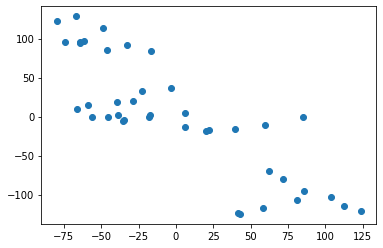

subject_14_stimulus_14_component_4   subject_10_stimulus_15_component_3   SpearmanrResult(correlation=-0.8204502814258914, pvalue=9.181587667666964e-11)   3.853805486403809


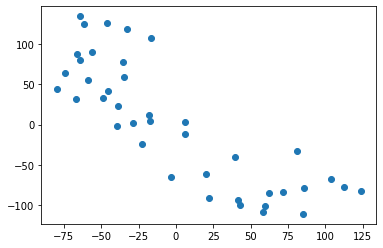

subject_14_stimulus_15_component_0   subject_14_stimulus_14_component_0   SpearmanrResult(correlation=0.8960600375234522, pvalue=5.653079120712615e-15)   4.523291389775058


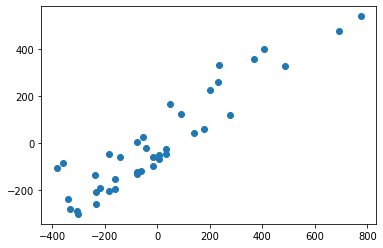

subject_14_stimulus_15_component_1   subject_14_stimulus_14_component_1   SpearmanrResult(correlation=0.7669793621013133, pvalue=7.852195302896422e-09)   7.208787644341855


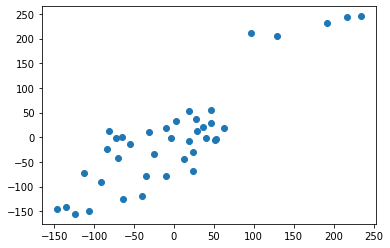

subject_14_stimulus_15_component_2   subject_14_stimulus_14_component_2   SpearmanrResult(correlation=0.8103189493433397, pvalue=2.370417550518703e-10)   2.328166182791816


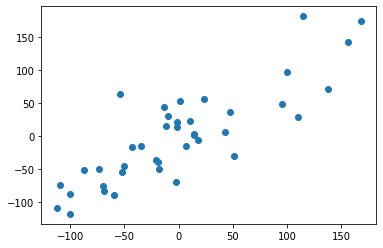

subject_14_stimulus_15_component_5   subject_10_stimulus_14_component_3   SpearmanrResult(correlation=0.8360225140712947, pvalue=1.8923099893489595e-11)   4.953626911047406


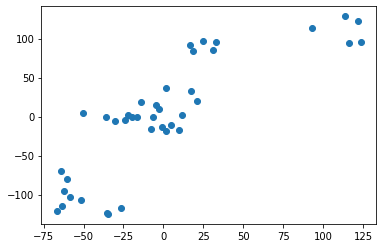

subject_14_stimulus_15_component_5   subject_13_stimulus_9_component_7   SpearmanrResult(correlation=0.79908743898941, pvalue=3.5083068271686464e-12)   4.482569832476958


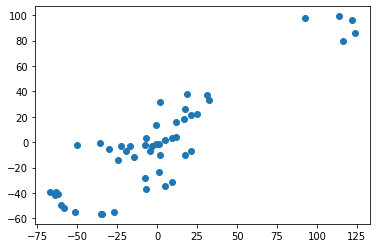

subject_14_stimulus_15_component_6   subject_13_stimulus_11_component_6   SpearmanrResult(correlation=0.8166186594757436, pvalue=4.849000318001536e-13)   6.64440013125799


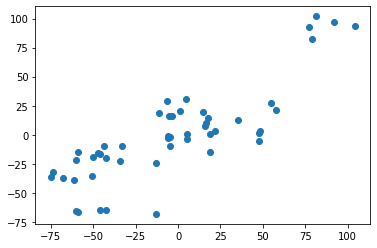

subject_14_stimulus_15_component_7   subject_14_stimulus_14_component_6   SpearmanrResult(correlation=-0.7872420262664166, pvalue=1.6902947909028362e-09)   5.947948905302888


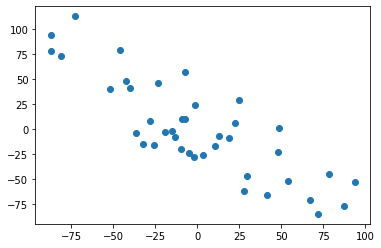

subject_14_stimulus_9_component_1   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=-0.8772399800136887, pvalue=2.0100235085215374e-10)   6.084412679507016


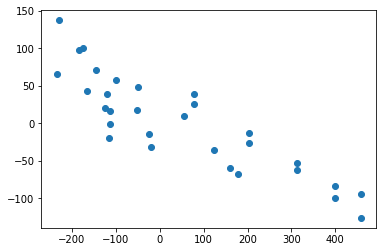

subject_14_stimulus_9_component_1   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=-0.8994993045509556, pvalue=1.4074817913800989e-11)   2.8879659385733056


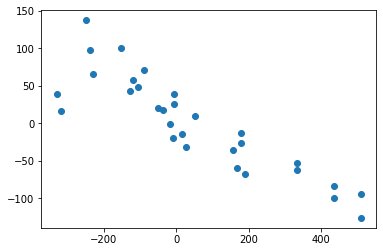

subject_14_stimulus_9_component_1   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=-0.9222038155789678, pvalue=4.5056118226586516e-13)   7.247518784039128


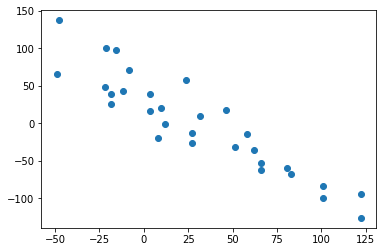

subject_14_stimulus_9_component_1   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=-0.8954926261342475, pvalue=2.3718018901606372e-11)   5.758672553166299


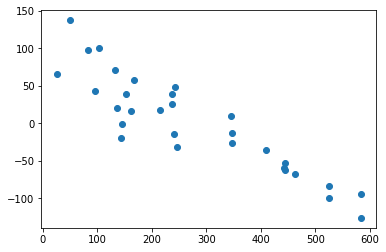

subject_14_stimulus_9_component_1   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=0.8523095365319499, pvalue=2.277769083291878e-09)   5.278230280418202


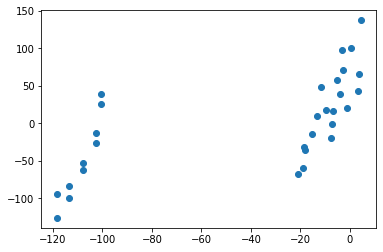

subject_14_stimulus_9_component_1   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=0.9627157862367937, pvalue=1.955256259197756e-17)   2.850735171814202


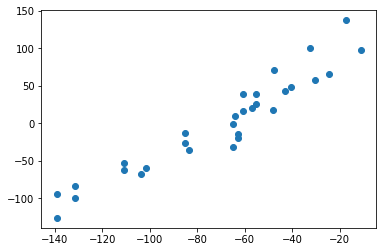

subject_14_stimulus_9_component_1   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=0.9075126613843717, pvalue=4.626751456959738e-12)   7.1215901953651155


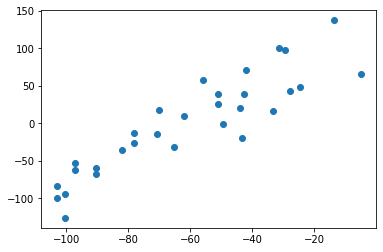

subject_14_stimulus_9_component_1   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=-0.9204230696159864, pvalue=6.116431484421884e-13)   7.247518784039128


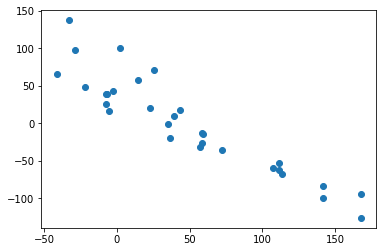

subject_14_stimulus_9_component_1   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=-0.869671809671018, pvalue=4.4241322632063197e-10)   5.758672553166299


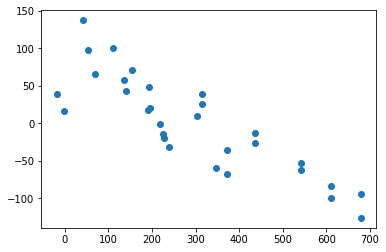

subject_14_stimulus_9_component_1   subject_12_stim_period_15_component_2   SpearmanrResult(correlation=0.8015582765869812, pvalue=1.0203587549095738e-07)   4.291638464549713


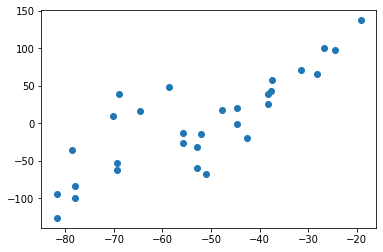

subject_14_stimulus_9_component_1   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=0.8705621826525087, pvalue=4.0423621833756033e-10)   4.824729130126884


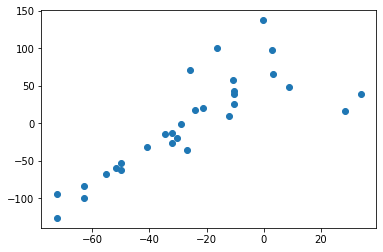

subject_14_stimulus_9_component_1   subject_12_stim_period_15_component_6   SpearmanrResult(correlation=0.7993323441332546, pvalue=1.1753009633170325e-07)   2.9822836535917814


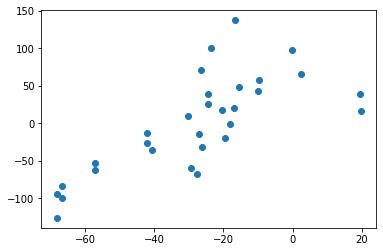

subject_14_stimulus_9_component_1   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=-0.7530329490957394, pvalue=1.5747565678731218e-06)   2.850735171814202


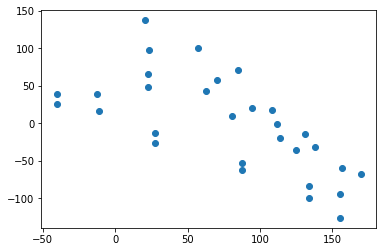

subject_14_stimulus_9_component_1   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=0.8191689631389495, pvalue=3.57294004564043e-13)   2.1445539514690215


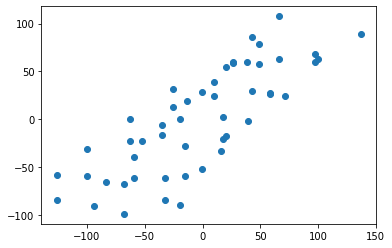

subject_14_stimulus_9_component_1   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=-0.7590680674209959, pvalue=1.6782112874317859e-10)   4.3797097104276705


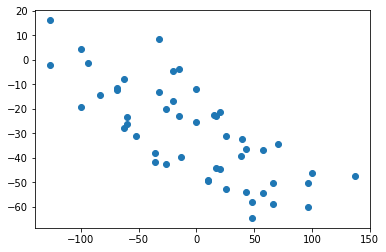

subject_14_stimulus_9_component_1   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=-0.8340620707908805, pvalue=5.4296063002401667e-14)   4.3797097104276705


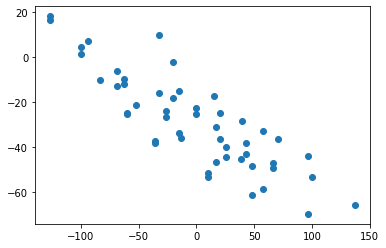

subject_14_stimulus_9_component_1   subject_13_stim_period_11_component_1   SpearmanrResult(correlation=-0.7554168539321354, pvalue=2.3010115860720705e-10)   6.409963132059037


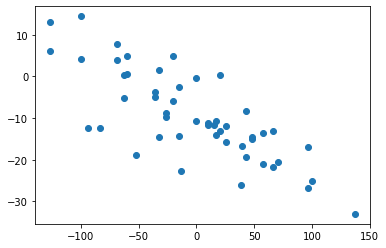

subject_14_stimulus_9_component_1   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=-0.7561374881733579, pvalue=2.1629884342102697e-10)   4.3797097104276705


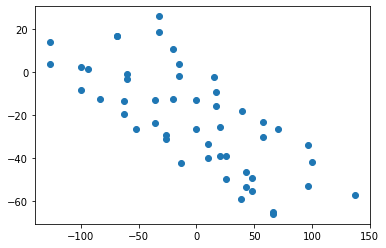

subject_14_stimulus_9_component_1   subject_14_stimulus_10_component_3   SpearmanrResult(correlation=0.8202447163515018, pvalue=2.8913981205927435e-08)   9.283686136632948


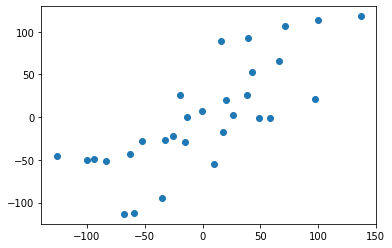

subject_14_stimulus_9_component_1   subject_14_stimulus_11_component_1   SpearmanrResult(correlation=0.8496106785317018, pvalue=2.8840678651351376e-09)   9.422866220880023


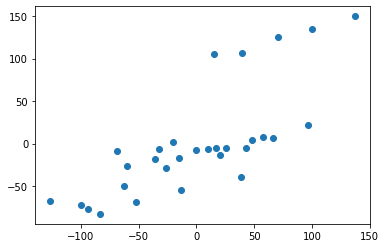

subject_14_stimulus_9_component_1   subject_14_stimulus_12_component_2   SpearmanrResult(correlation=0.7601779755283649, pvalue=1.09590752663524e-06)   6.632518321537554


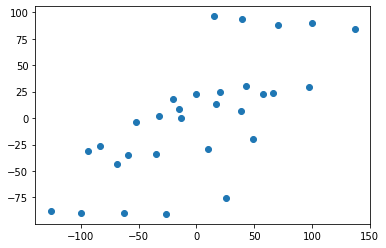

subject_14_stimulus_9_component_2   subject_12_stimulus_15_component_4   SpearmanrResult(correlation=-0.7516973896235034, pvalue=1.682909066058116e-06)   4.7462291079859655


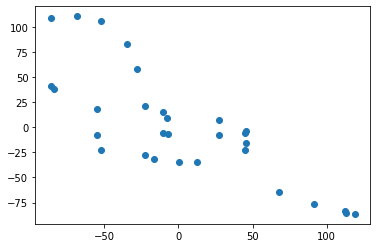

subject_14_stimulus_9_component_3   subject_14_stimulus_10_component_1   SpearmanrResult(correlation=0.7784204671857619, pvalue=4.0943561467168264e-07)   2.055350746758947


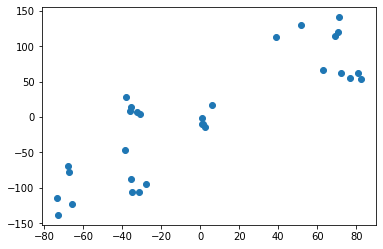

subject_14_stimulus_9_component_3   subject_14_stimulus_11_component_3   SpearmanrResult(correlation=0.785539488320356, pvalue=2.7187140432533034e-07)   6.205037643449503


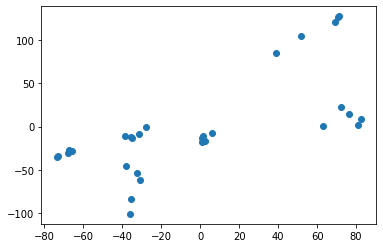

subject_14_stimulus_9_component_4   subject_13_stim_period_11_component_1   SpearmanrResult(correlation=-0.866394527080395, pvalue=4.3890016192749205e-16)   5.083888417723831


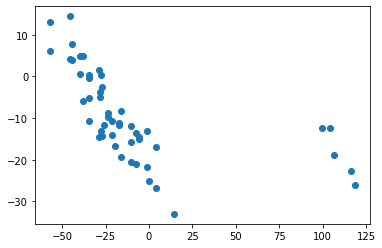

subject_14_stimulus_9_component_5   subject_14_stimulus_10_component_2   SpearmanrResult(correlation=-0.7957730812013347, pvalue=1.4681133721352516e-07)   4.706087071277334


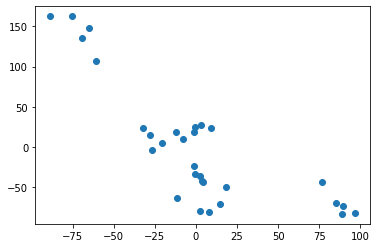

subject_14_stim_period_0_component_0   subject_14_stimulus_0_component_0   SpearmanrResult(correlation=0.9872257053291535, pvalue=6.08604658450178e-140)   14.815625264514436


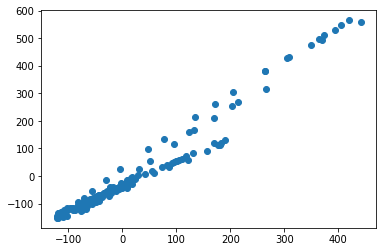

subject_14_stim_period_0_component_1   subject_14_stimulus_0_component_0   SpearmanrResult(correlation=-0.8466995073891627, pvalue=2.794967737799625e-49)   2.5843589564783493


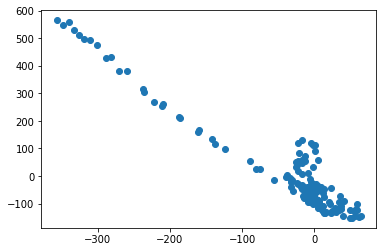

subject_14_stim_period_0_component_1   subject_14_stim_period_0_component_0   SpearmanrResult(correlation=-0.7792655620241828, pvalue=6.020095192666462e-37)   2.6638326406888755


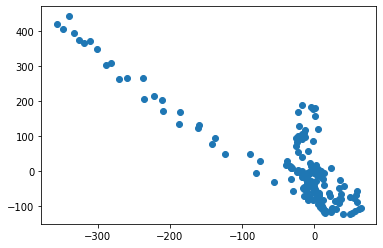

subject_14_stim_period_0_component_2   subject_10_stimulus_13_component_3   SpearmanrResult(correlation=0.7545668138132252, pvalue=1.913783535223323e-38)   5.798749562812939


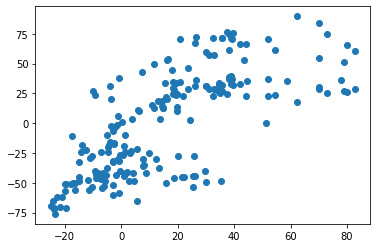

subject_14_stim_period_0_component_4   subject_14_stimulus_0_component_1   SpearmanrResult(correlation=0.7566390506045678, pvalue=9.490909679996392e-34)   5.878012100117193


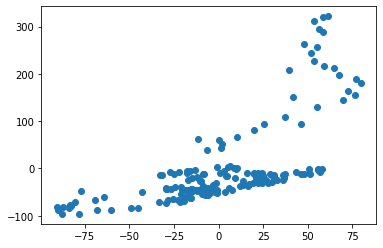

subject_14_stim_period_0_component_8   subject_14_stim_period_0_component_7   SpearmanrResult(correlation=-0.8642386923421407, pvalue=1.6917068761691947e-53)   2.274906291794631


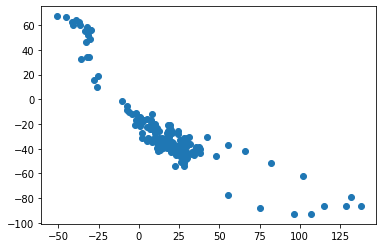

subject_14_stim_period_10_component_0   subject_13_stimulus_12_component_9   SpearmanrResult(correlation=0.7586356868762625, pvalue=1.742626595771229e-10)   7.350306226122681


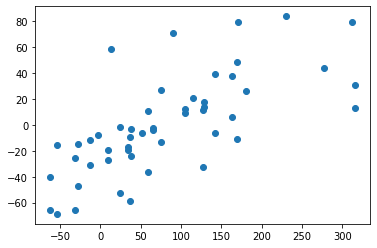

subject_14_stim_period_10_component_0   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.7611338855791671, pvalue=1.400298590583875e-10)   2.1445539514690215


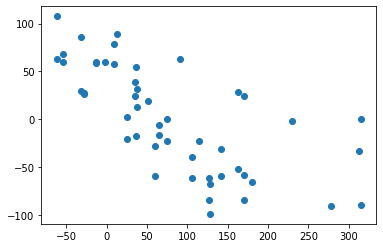

subject_14_stim_period_10_component_0   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.7571463761110694, pvalue=1.9828429074283235e-10)   4.839239936502133


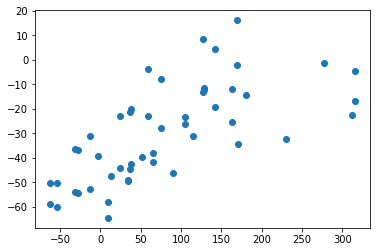

subject_14_stim_period_10_component_0   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.7640164225440569, pvalue=1.0843875735268033e-10)   4.839239936502133


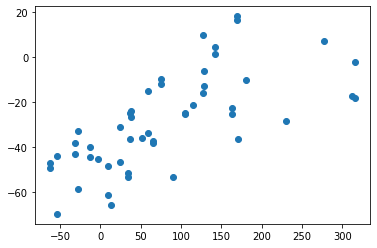

subject_14_stim_period_10_component_0   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=-0.7565923294726765, pvalue=8.758451895019089e-20)   6.628234082135191


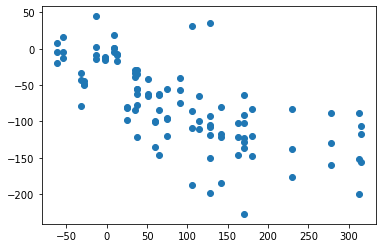

subject_14_stim_period_10_component_0   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=0.9652947719688543, pvalue=7.28260844892818e-18)   14.296194110937915


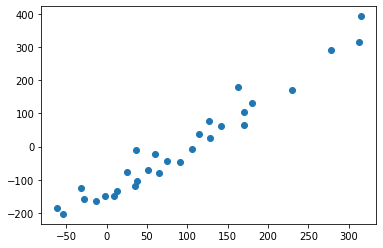

subject_14_stim_period_10_component_0   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=0.8803114571746384, pvalue=1.437763334130354e-10)   12.089148772808823


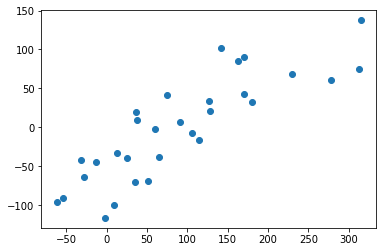

subject_14_stim_period_10_component_0   subject_14_stimulus_14_component_2   SpearmanrResult(correlation=-0.8394182059850172, pvalue=1.3119825782881552e-11)   3.9866862604353295


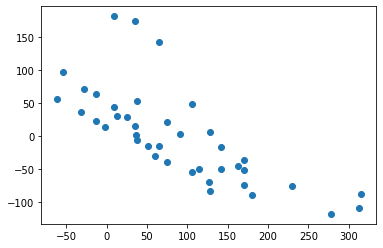

subject_14_stim_period_10_component_1   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=-0.8112419864855023, pvalue=9.092154830539827e-13)   1.8891897387104104


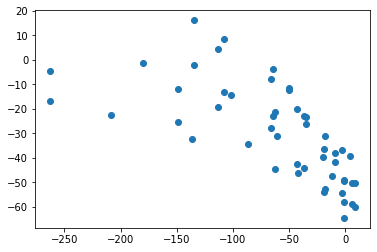

subject_14_stim_period_10_component_1   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=-0.8167668490015412, pvalue=4.764330845374331e-13)   1.8891897387104104


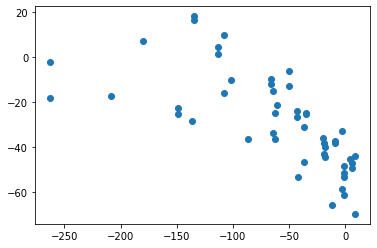

subject_14_stim_period_10_component_1   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=0.7675793627769266, pvalue=1.2193950294979772e-20)   1.6768991797871267


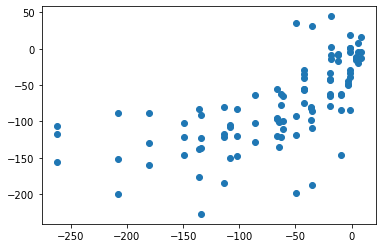

subject_14_stim_period_10_component_1   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=-0.950166852057842, pvalue=1.0505097466160646e-15)   2.5973414126187


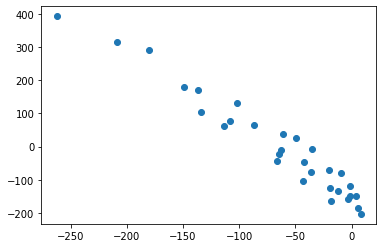

subject_14_stim_period_10_component_1   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=-0.9519466073414905, pvalue=6.383705900097279e-16)   2.6638326406888755


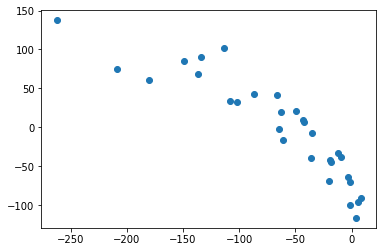

subject_14_stim_period_10_component_1   subject_14_stimulus_14_component_2   SpearmanrResult(correlation=0.8244017801176644, pvalue=6.240813092899022e-11)   2.3236649049437546


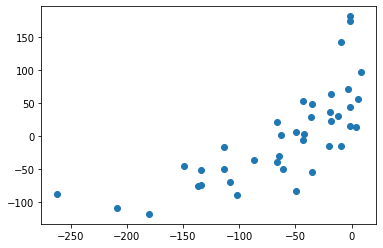

subject_14_stim_period_10_component_1   subject_14_stim_period_10_component_0   SpearmanrResult(correlation=-0.903448275862069, pvalue=8.233638768359261e-12)   2.6638326406888755


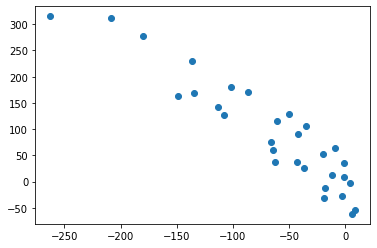

subject_14_stim_period_10_component_2   subject_13_stimulus_11_component_2   SpearmanrResult(correlation=-0.8022100373288475, pvalue=2.502137775089698e-12)   6.769269899792322


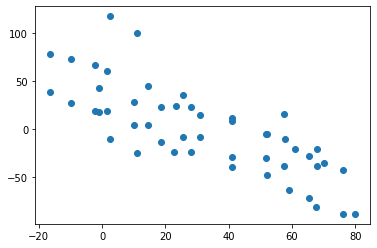

subject_14_stim_period_10_component_3   subject_12_stimulus_14_component_3   SpearmanrResult(correlation=0.792209360281329, pvalue=1.8265149562343322e-07)   2.259841596067617


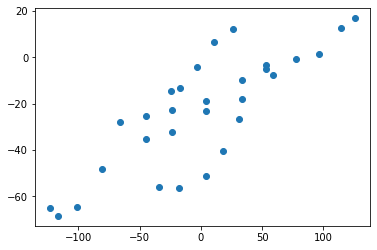

subject_14_stim_period_10_component_3   subject_14_stimulus_10_component_1   SpearmanrResult(correlation=0.8260289210233593, pvalue=1.9000369492778636e-08)   1.3486356070059524


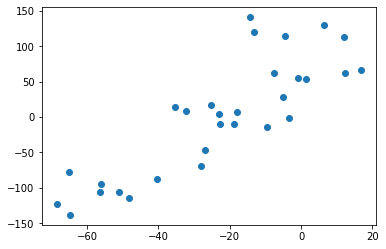

subject_14_stim_period_10_component_3   subject_14_stimulus_9_component_3   SpearmanrResult(correlation=0.7748609566184649, pvalue=4.996783934529809e-07)   2.835793774712391


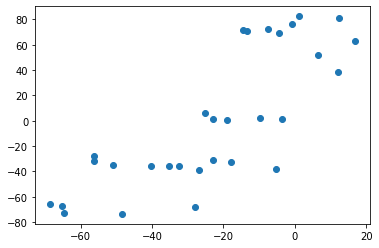

subject_14_stim_period_10_component_4   subject_10_stimulus_15_component_4   SpearmanrResult(correlation=-0.7528860519243971, pvalue=2.0935261003078792e-08)   3.232195726896725


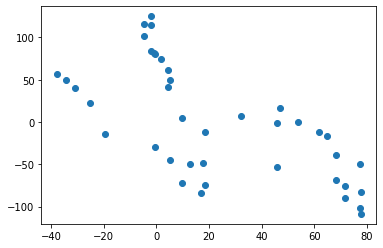

subject_14_stim_period_10_component_4   subject_14_stimulus_10_component_2   SpearmanrResult(correlation=0.8647385984427142, pvalue=7.209803534076485e-10)   5.849077251253925


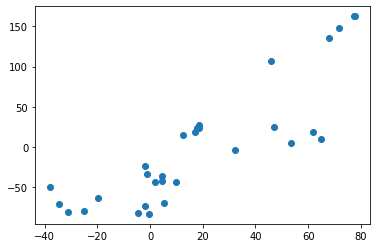

subject_14_stim_period_10_component_4   subject_14_stimulus_11_component_3   SpearmanrResult(correlation=-0.803781979977753, pvalue=8.843975291003268e-08)   8.65396621394341


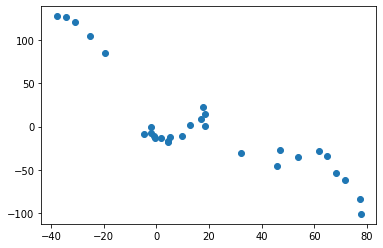

subject_14_stim_period_10_component_5   subject_12_stimulus_14_component_2   SpearmanrResult(correlation=-0.8287146525224469, pvalue=1.5553243526686928e-08)   1.9146499235839596


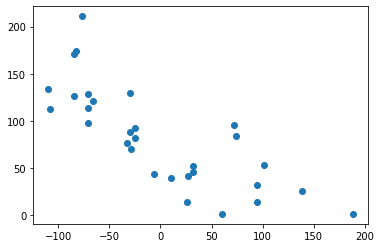

subject_14_stim_period_10_component_5   subject_12_stim_period_15_component_9   SpearmanrResult(correlation=0.8046745820221987, pvalue=8.3463706207571e-08)   1.9589044716591997


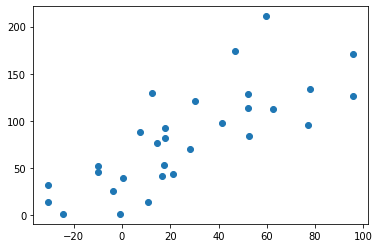

subject_14_stim_period_10_component_5   subject_13_stimulus_15_component_4   SpearmanrResult(correlation=-0.7905920942824955, pvalue=1.349570260646988e-22)   2.0058528267871325


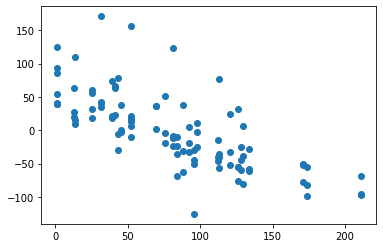

subject_14_stim_period_10_component_5   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.7610378010136707, pvalue=1.4121964559212946e-10)   1.4894796530612182


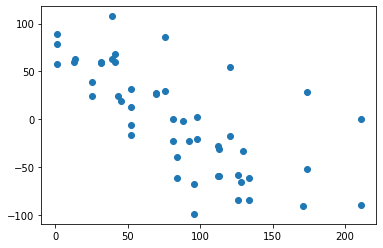

subject_14_stim_period_10_component_5   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.7832813779260707, pvalue=1.7807817506421883e-11)   2.0599544294309458


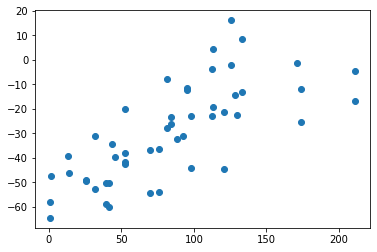

subject_14_stim_period_10_component_5   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.7956282445923488, pvalue=5.066870144514549e-12)   2.0599544294309458


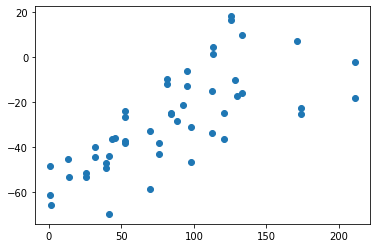

subject_14_stim_period_10_component_5   subject_13_stim_period_11_component_2   SpearmanrResult(correlation=-0.7975018936195275, pvalue=4.155773087707164e-12)   1.8200100447407408


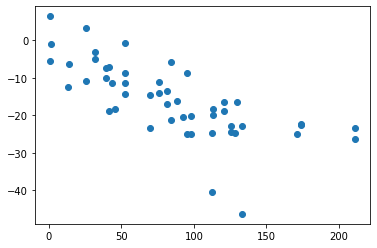

subject_14_stim_period_10_component_5   subject_13_stim_period_11_component_3   SpearmanrResult(correlation=0.7538795008841943, pvalue=2.62375594314207e-10)   2.1977649728738413


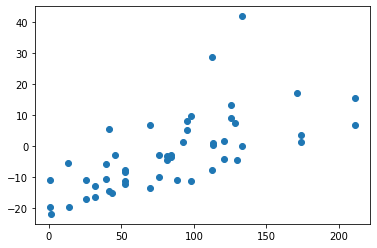

subject_14_stim_period_10_component_5   subject_13_stim_period_14_component_2   SpearmanrResult(correlation=0.7887068874750995, pvalue=1.9929868076396688e-22)   1.8200100447407408


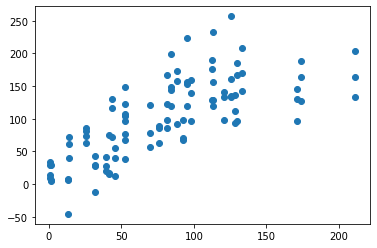

subject_14_stim_period_10_component_5   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=-0.7539626460916592, pvalue=1.3825454669368584e-19)   1.8200100447407408


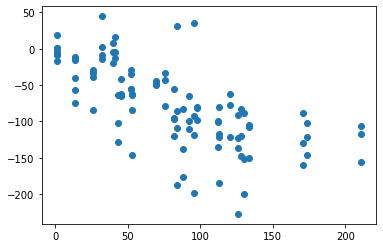

subject_14_stim_period_10_component_5   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=0.7841941812982858, pvalue=1.6273311255427787e-11)   2.0599544294309458


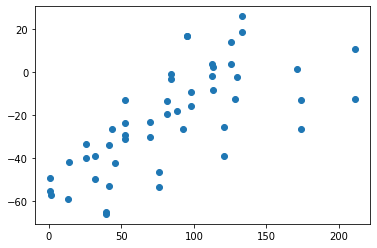

subject_14_stim_period_10_component_5   subject_13_stim_period_9_component_8   SpearmanrResult(correlation=0.7697334541910883, pvalue=6.460362348005078e-11)   1.9601881429213424


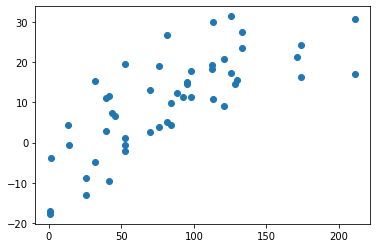

subject_14_stim_period_10_component_5   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=0.8233592880978865, pvalue=2.3106603701257954e-08)   2.819668413083713


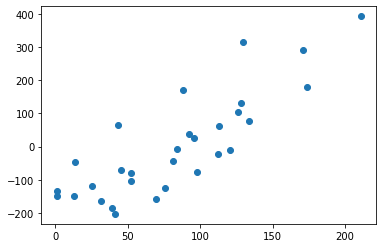

subject_14_stim_period_10_component_5   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=0.7677419354838709, pvalue=7.364349103813663e-07)   2.819668413083713


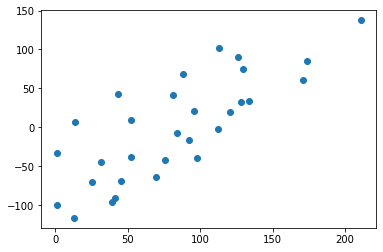

subject_14_stim_period_10_component_5   subject_14_stim_period_10_component_1   SpearmanrResult(correlation=-0.8371523915461624, pvalue=8.103332385136863e-09)   1.6652941319611294


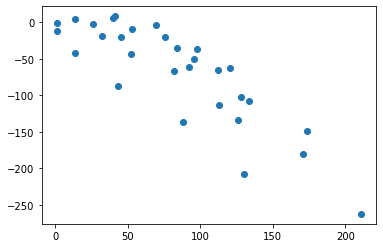

subject_14_stim_period_10_component_6   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=0.9159065628476083, pvalue=1.2876647542715103e-12)   9.70913525806661


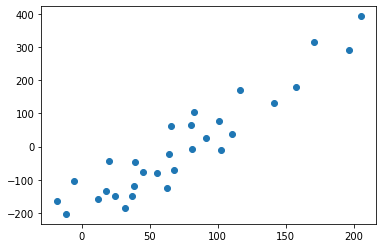

subject_14_stim_period_10_component_6   subject_14_stimulus_14_component_2   SpearmanrResult(correlation=-0.7692164150551433, pvalue=6.678297396727161e-09)   3.9247339795676583


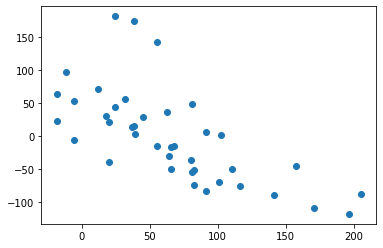

subject_14_stim_period_10_component_6   subject_14_stim_period_10_component_0   SpearmanrResult(correlation=0.8335928809788653, pvalue=1.0715777460387836e-08)   9.883199312350381


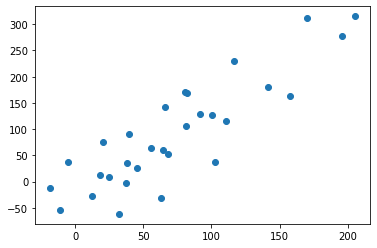

subject_14_stim_period_10_component_6   subject_14_stim_period_10_component_1   SpearmanrResult(correlation=-0.7988876529477197, pvalue=1.208714308578998e-07)   2.566404411023804


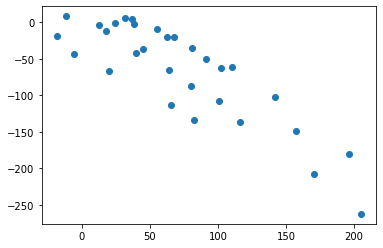

subject_14_stim_period_10_component_6   subject_14_stim_period_10_component_2   SpearmanrResult(correlation=0.8144605116796441, pvalue=4.3362061221556765e-08)   8.835896847350973


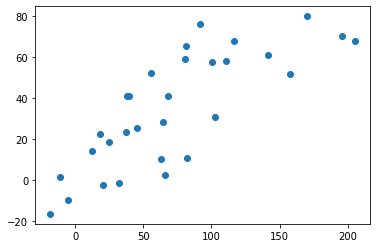

subject_14_stim_period_10_component_6   subject_14_stim_period_10_component_5   SpearmanrResult(correlation=0.8055617352614016, pvalue=7.877246749345719e-08)   2.6535011865232963


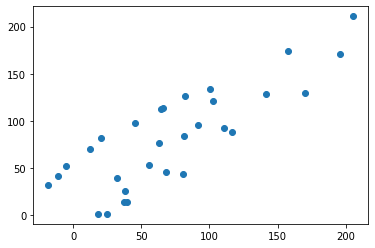

subject_14_stim_period_10_component_7   subject_14_stim_period_10_component_5   SpearmanrResult(correlation=0.7637374860956618, pvalue=9.105822170396005e-07)   1.601664336228016


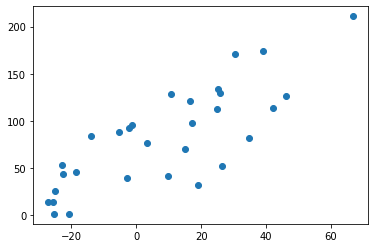

subject_14_stim_period_11_component_0   subject_12_stimulus_14_component_3   SpearmanrResult(correlation=-0.7688370695171989, pvalue=6.943967403720783e-07)   5.60015751358228


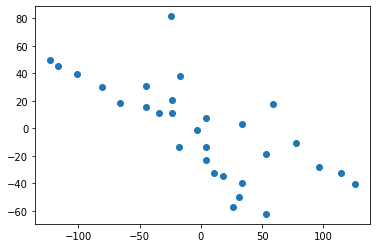

subject_14_stim_period_11_component_0   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=0.8309232480533927, pvalue=1.3158311116458195e-08)   14.296194110937915


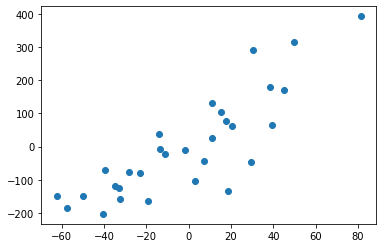

subject_14_stim_period_11_component_0   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=0.9199110122358174, pvalue=6.669581415126386e-13)   12.089148772808823


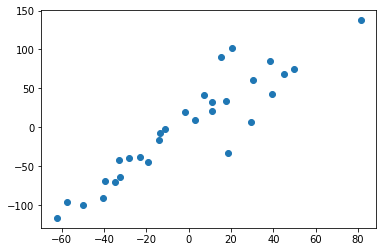

subject_14_stim_period_11_component_0   subject_14_stim_period_10_component_0   SpearmanrResult(correlation=0.8509454949944383, pvalue=2.567810126584772e-09)   17.69136508377818


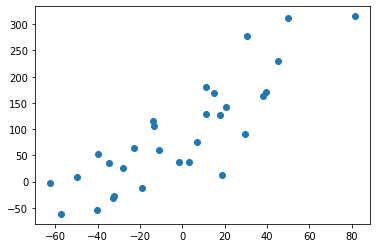

subject_14_stim_period_11_component_0   subject_14_stim_period_10_component_1   SpearmanrResult(correlation=-0.8771968854282535, pvalue=2.0193665667066368e-10)   2.6638326406888755


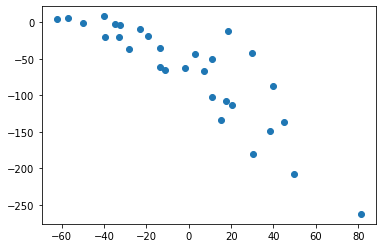

subject_14_stim_period_11_component_1   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=-0.8153503893214683, pvalue=4.0778353814216634e-08)   2.5973414126187


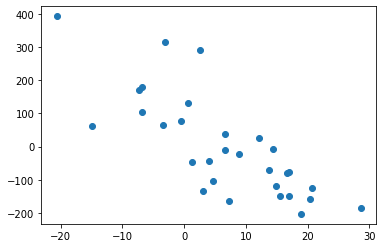

subject_14_stim_period_11_component_1   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=-0.8972191323692991, pvalue=1.899149691033417e-11)   2.6638326406888755


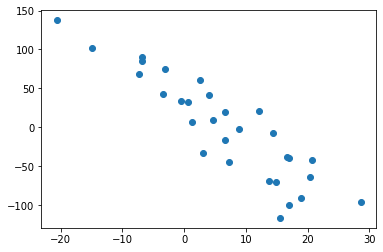

subject_14_stim_period_11_component_1   subject_14_stim_period_10_component_0   SpearmanrResult(correlation=-0.8416017797552835, pvalue=5.660291682411409e-09)   2.6638326406888755


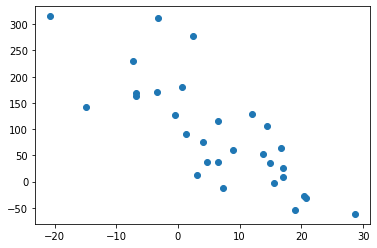

subject_14_stim_period_11_component_1   subject_14_stim_period_10_component_1   SpearmanrResult(correlation=0.8669632925472748, pvalue=5.798530562913077e-10)   2.6638326406888755


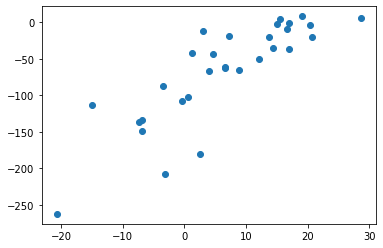

subject_14_stim_period_11_component_1   subject_14_stim_period_11_component_0   SpearmanrResult(correlation=-0.9074527252502781, pvalue=4.66713632795927e-12)   2.6638326406888755


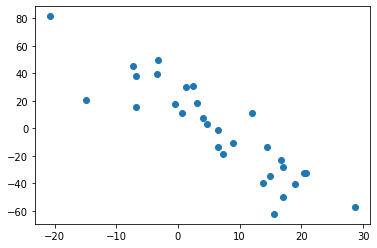

subject_14_stim_period_11_component_3   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=-0.7974058090540309, pvalue=4.198444214612051e-12)   1.8544384362140196


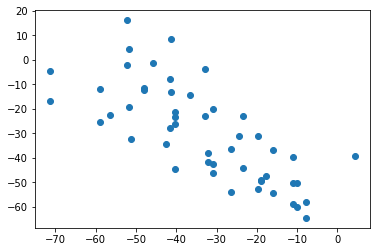

subject_14_stim_period_11_component_3   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=-0.8076388152793901, pvalue=1.3703168531537365e-12)   1.8544384362140196


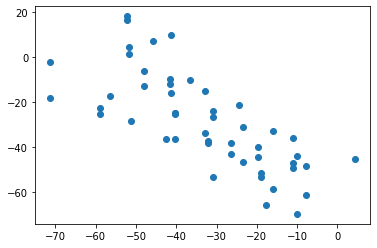

subject_14_stim_period_11_component_3   subject_13_stim_period_14_component_2   SpearmanrResult(correlation=-0.7939782619238054, pvalue=6.632552663726329e-23)   1.7178093855354628


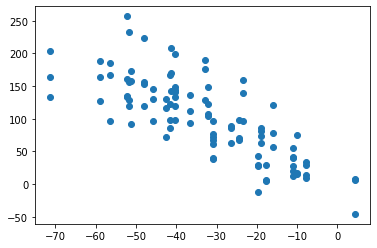

subject_14_stim_period_11_component_3   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=0.7570966523128717, pvalue=8.018982750275398e-20)   1.7178093855354628


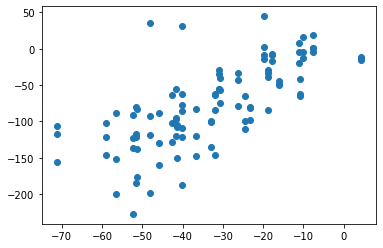

subject_14_stim_period_11_component_3   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=-0.7639203379785606, pvalue=1.0937320773375513e-10)   1.8544384362140196


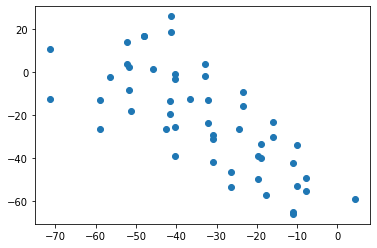

subject_14_stim_period_11_component_3   subject_13_stim_period_9_component_3   SpearmanrResult(correlation=-0.7797742912854548, pvalue=2.5075134365362346e-11)   1.8794994279209876


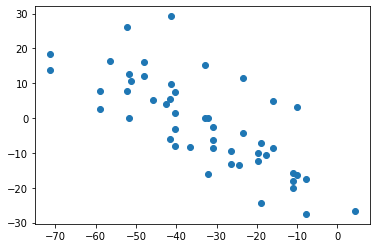

subject_14_stim_period_11_component_3   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=-0.8883203559510566, pvalue=5.738764358101427e-11)   3.553439744997648


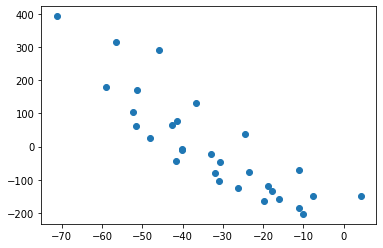

subject_14_stim_period_11_component_3   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=-0.9612903225806452, pvalue=3.277237201194177e-17)   3.156670890699071


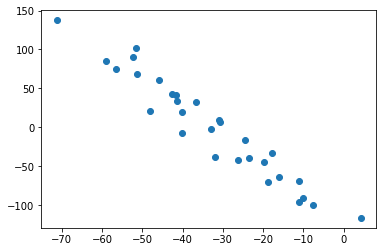

subject_14_stim_period_11_component_3   subject_14_stim_period_10_component_0   SpearmanrResult(correlation=-0.8647385984427142, pvalue=7.209803534076485e-10)   3.553439744997648


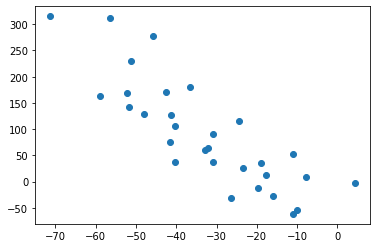

subject_14_stim_period_11_component_3   subject_14_stim_period_10_component_1   SpearmanrResult(correlation=0.9127919911012237, pvalue=2.100850903015918e-12)   1.0386613412710406


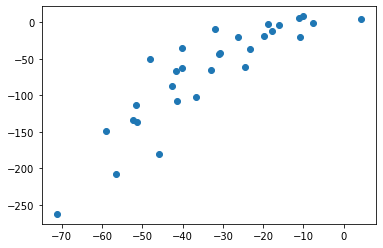

subject_14_stim_period_11_component_3   subject_14_stim_period_10_component_5   SpearmanrResult(correlation=-0.7922135706340377, pvalue=1.826048187712237e-07)   1.4630265734270331


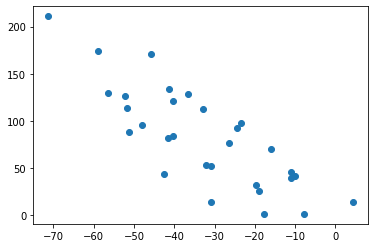

subject_14_stim_period_11_component_3   subject_14_stim_period_11_component_0   SpearmanrResult(correlation=-0.8580645161290322, pvalue=1.3553145506632673e-09)   3.553439744997648


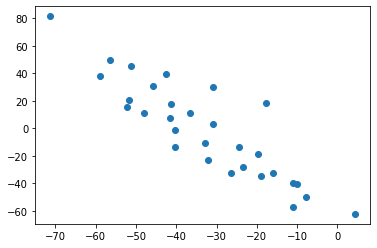

subject_14_stim_period_11_component_3   subject_14_stim_period_11_component_1   SpearmanrResult(correlation=0.793103448275862, pvalue=1.729798038741194e-07)   1.0386613412710406


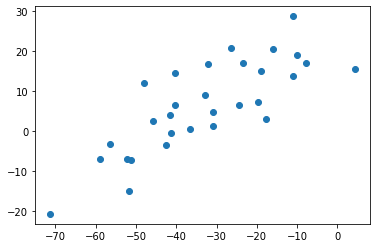

subject_14_stim_period_11_component_5   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8026712428138446, pvalue=9.500937011457694e-08)   1.9555526659999107


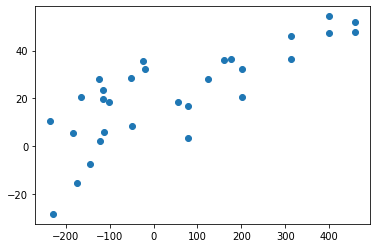

subject_14_stim_period_11_component_5   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.8672232839719186, pvalue=5.65134046694492e-10)   1.5628915340035474


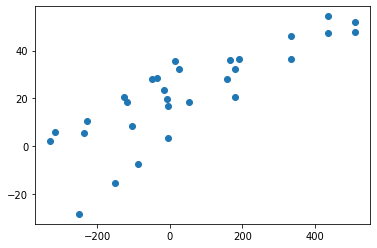

subject_14_stim_period_11_component_5   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.9157486114631603, pvalue=1.3206268875802024e-12)   1.9658164003102587


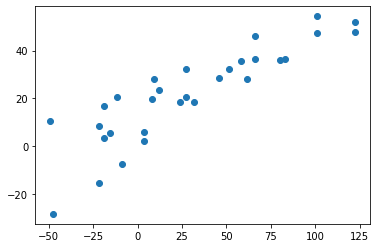

subject_14_stim_period_11_component_5   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.8200335159529127, pvalue=2.9352387805754237e-08)   1.960234564927099


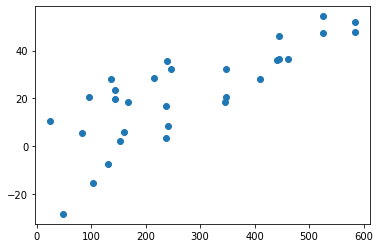

subject_14_stim_period_11_component_5   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.7657207640819815, pvalue=8.201396380975389e-07)   1.778042099192095


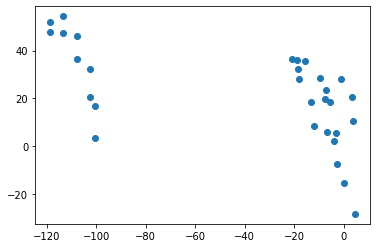

subject_14_stim_period_11_component_5   subject_12_stim_period_14_component_6   SpearmanrResult(correlation=0.7528103558503667, pvalue=1.592332542091114e-06)   1.7110510784914186


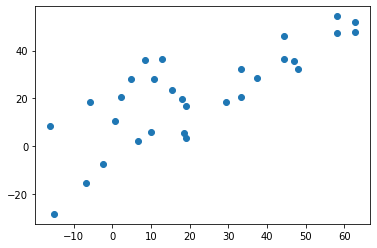

subject_14_stim_period_11_component_5   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.8547580622310492, pvalue=1.831292751378757e-09)   1.6859950165398179


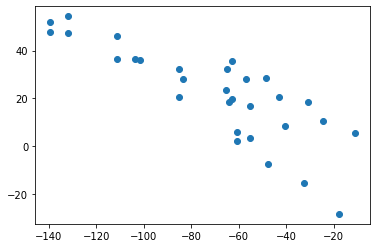

subject_14_stim_period_11_component_5   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.8845855571109869, pvalue=8.881117218746631e-11)   1.9589044716591997


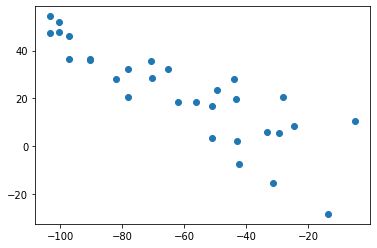

subject_14_stim_period_11_component_5   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.9046189491945271, pvalue=6.99263808916305e-12)   1.9658164003102587


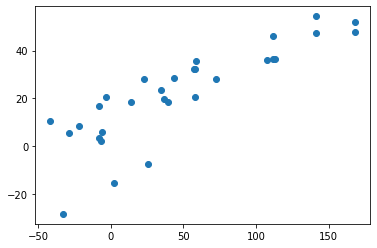

subject_14_stim_period_11_component_5   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.8218142619158941, pvalue=2.5838811497620054e-08)   1.960234564927099


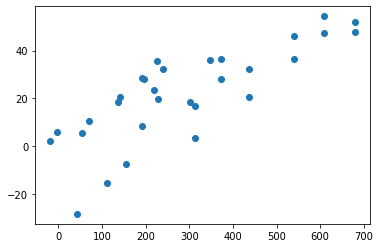

subject_14_stim_period_11_component_5   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=-0.8796885057127881, pvalue=1.5399916950874186e-10)   1.9087178747381697


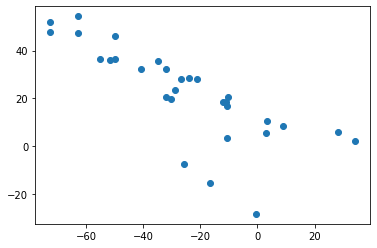

subject_14_stim_period_11_component_5   subject_12_stim_period_15_component_6   SpearmanrResult(correlation=-0.7537007288318575, pvalue=1.5230785729064128e-06)   1.7110510784914186


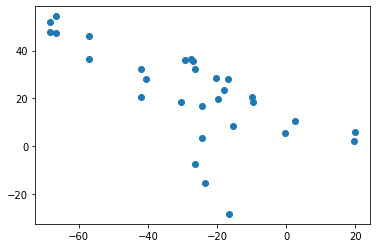

subject_14_stim_period_11_component_5   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=0.7986645643971365, pvalue=1.2258010294809404e-07)   1.6859950165398179


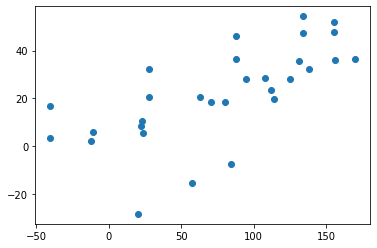

subject_14_stim_period_11_component_5   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.7659381138539835, pvalue=9.126119004553002e-11)   1.4894796530612182


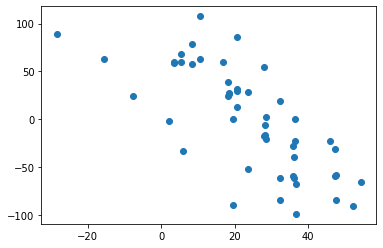

subject_14_stim_period_11_component_5   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.7597887016622183, pvalue=1.5758250695559668e-10)   2.0599544294309458


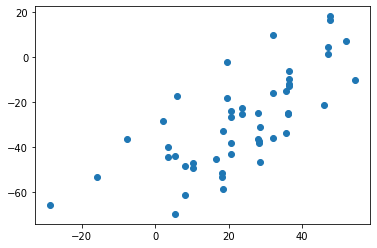

subject_14_stim_period_11_component_5   subject_14_stimulus_10_component_3   SpearmanrResult(correlation=-0.8046718576195773, pvalue=8.34784972336776e-08)   2.6436072501168093


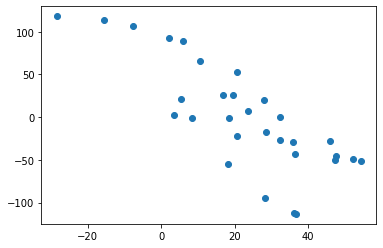

subject_14_stim_period_11_component_5   subject_14_stimulus_11_component_1   SpearmanrResult(correlation=-0.8949944382647386, pvalue=2.527072091250072e-11)   2.5423067837246958


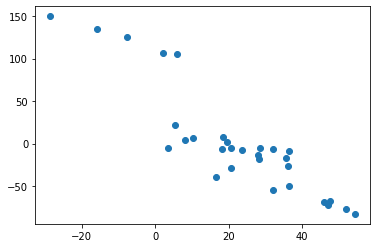

subject_14_stim_period_11_component_5   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.9052280311457174, pvalue=6.417487471339162e-12)   2.60912449149612


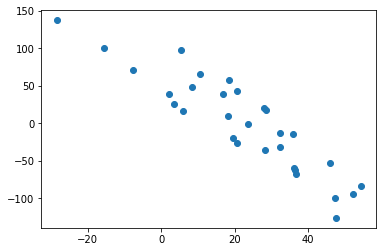

subject_14_stim_period_11_component_7   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.8543128757403038, pvalue=1.905955791895059e-09)   1.7389131540438862


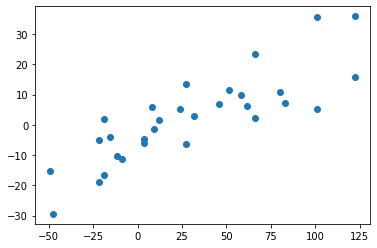

subject_14_stim_period_11_component_7   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.7590429667208015, pvalue=1.1618255341342434e-06)   1.7284247895732208


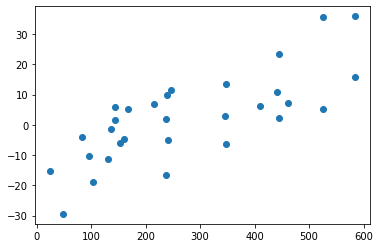

subject_14_stim_period_11_component_7   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.8040068022860807, pvalue=8.716155189483653e-08)   1.7389131540438862


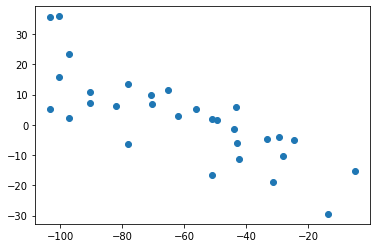

subject_14_stim_period_11_component_7   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.8080134807027886, pvalue=6.703109056179433e-08)   1.7389131540438862


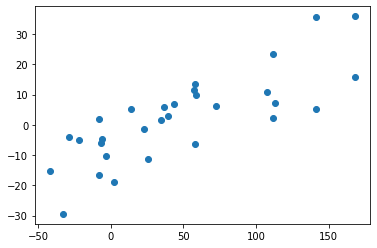

subject_14_stim_period_11_component_7   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=-0.7666111370634723, pvalue=7.82255753170437e-07)   1.6490214030480754


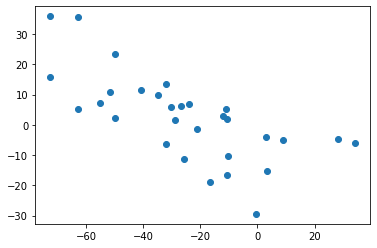

subject_14_stim_period_11_component_7   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.7910161854485253, pvalue=8.182935088579992e-12)   1.3440054619295236


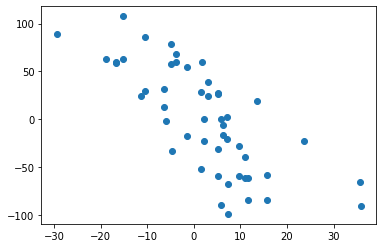

subject_14_stim_period_11_component_7   subject_14_stimulus_11_component_1   SpearmanrResult(correlation=-0.7503893214682981, pvalue=1.7953168056388611e-06)   2.274906291794631


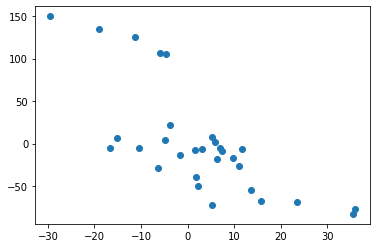

subject_14_stim_period_11_component_7   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.7908787541713014, pvalue=1.979596351724319e-07)   2.274906291794631


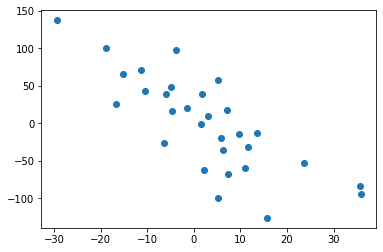

subject_14_stim_period_11_component_7   subject_14_stim_period_11_component_5   SpearmanrResult(correlation=0.8696329254727476, pvalue=4.4415362112600256e-10)   1.601664336228016


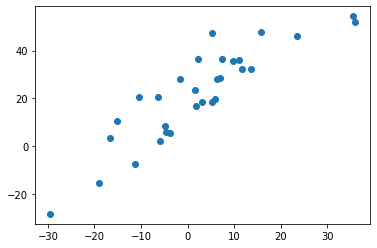

subject_14_stim_period_11_component_8   subject_12_stim_period_14_component_8   SpearmanrResult(correlation=0.7826378507303043, pvalue=3.2183609988294975e-07)   4.923630539363727


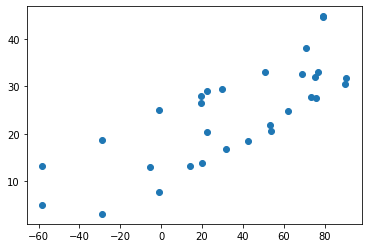

subject_14_stim_period_11_component_8   subject_14_stimulus_9_component_0   SpearmanrResult(correlation=0.8745272525027808, pvalue=2.6824791546951216e-10)   11.536793257000628


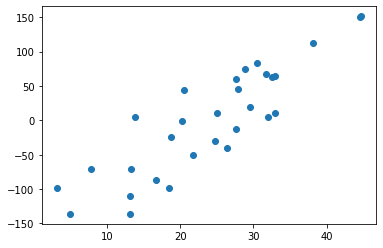

subject_14_stim_period_11_component_8   subject_14_stim_period_10_component_2   SpearmanrResult(correlation=0.796662958843159, pvalue=1.3892570347034688e-07)   8.861649425498783


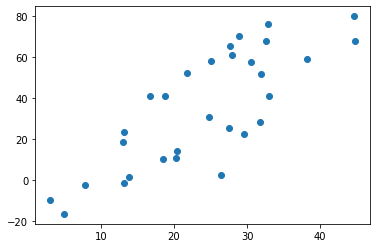

subject_14_stim_period_11_component_8   subject_14_stim_period_11_component_0   SpearmanrResult(correlation=0.7668520578420467, pvalue=7.722818965214995e-07)   10.74462626357017


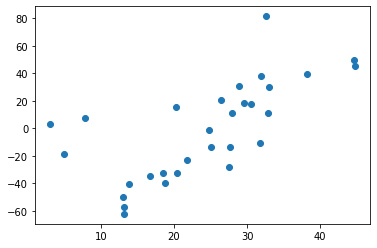

subject_14_stim_period_11_component_8   subject_14_stim_period_11_component_2   SpearmanrResult(correlation=0.7521690767519467, pvalue=1.6439666079850616e-06)   8.861649425498783


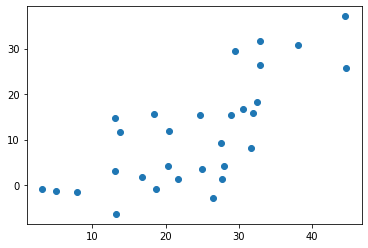

subject_14_stim_period_11_component_9   subject_13_stimulus_15_component_4   SpearmanrResult(correlation=0.7577390635497867, pvalue=7.164516856577084e-20)   3.9656382673751622


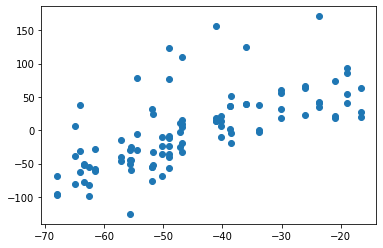

subject_14_stim_period_11_component_9   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=0.769877581039333, pvalue=6.375343168771094e-11)   1.840458646386667


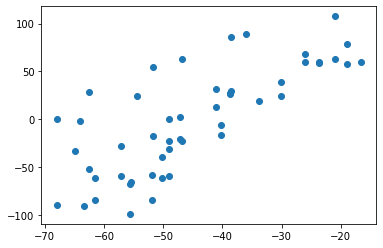

subject_14_stim_period_11_component_9   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=-0.7825127014021, pvalue=1.9205298723107414e-11)   2.9019780698064155


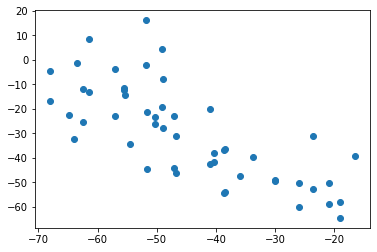

subject_14_stim_period_11_component_9   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=-0.7509489216365561, pvalue=3.360842253492969e-10)   2.9019780698064155


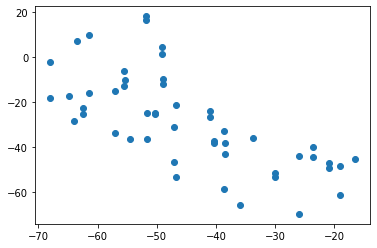

subject_14_stim_period_11_component_9   subject_13_stim_period_14_component_2   SpearmanrResult(correlation=-0.801206889299935, pvalue=1.3911234236174937e-23)   3.04152855913899


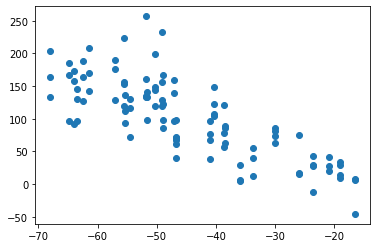

subject_14_stim_period_11_component_9   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=0.7834054938097155, pvalue=5.841430461906558e-22)   3.04152855913899


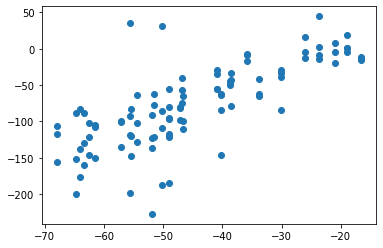

subject_14_stim_period_11_component_9   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=-0.813788227471155, pvalue=6.768128834745929e-13)   2.9019780698064155


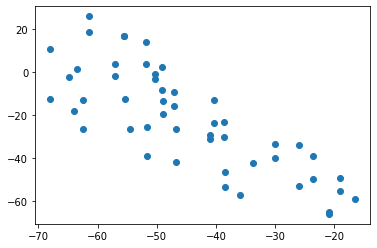

subject_14_stim_period_11_component_9   subject_13_stim_period_9_component_3   SpearmanrResult(correlation=-0.8206102316213943, pvalue=3.000219590959321e-13)   3.9985065198174334


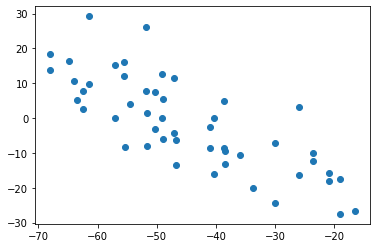

subject_14_stim_period_11_component_9   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=-0.9261401557285873, pvalue=2.2324629676411924e-13)   4.537569477332493


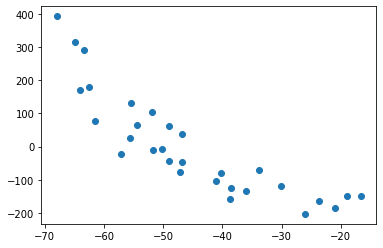

subject_14_stim_period_11_component_9   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=-0.8869855394883204, pvalue=6.719839067389324e-11)   4.569298372219283


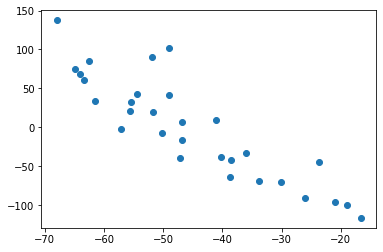

subject_14_stim_period_11_component_9   subject_14_stimulus_14_component_2   SpearmanrResult(correlation=0.7973722135564295, pvalue=7.360581544567843e-10)   3.0517189908877


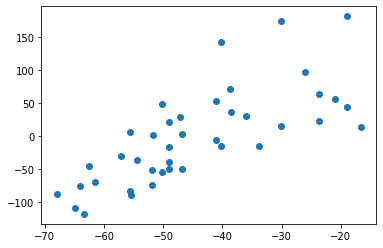

subject_14_stim_period_11_component_9   subject_14_stim_period_10_component_0   SpearmanrResult(correlation=-0.874972191323693, pvalue=2.5596336829806026e-10)   4.569013471934383


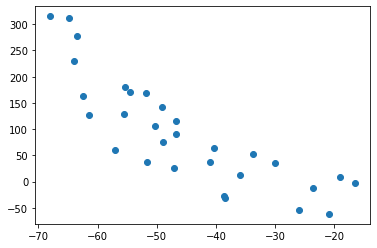

subject_14_stim_period_11_component_9   subject_14_stim_period_10_component_1   SpearmanrResult(correlation=0.9243604004449388, pvalue=3.081110330729481e-13)   1.9978948221128139


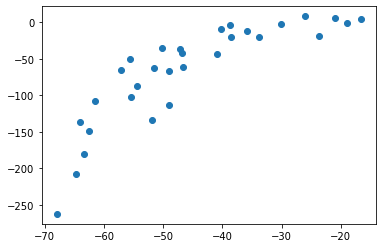

subject_14_stim_period_11_component_9   subject_14_stim_period_10_component_5   SpearmanrResult(correlation=-0.8553948832035595, pvalue=1.7291483629560142e-09)   1.8792010415426559


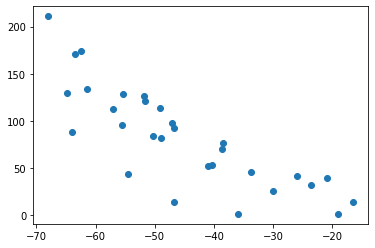

subject_14_stim_period_11_component_9   subject_14_stim_period_10_component_6   SpearmanrResult(correlation=-0.8233592880978865, pvalue=2.3106603701257954e-08)   4.403907579867733


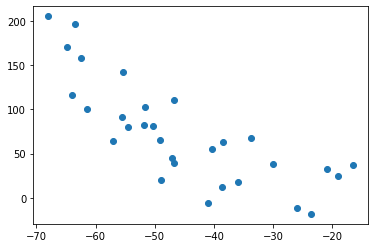

subject_14_stim_period_11_component_9   subject_14_stim_period_11_component_0   SpearmanrResult(correlation=-0.8482758620689654, pvalue=3.2356884704942855e-09)   4.569013471934383


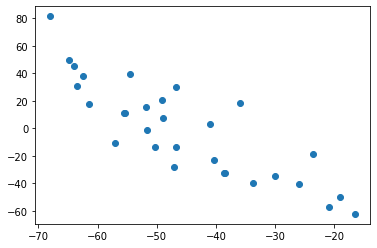

subject_14_stim_period_11_component_9   subject_14_stim_period_11_component_3   SpearmanrResult(correlation=0.9043381535038933, pvalue=7.273475740758801e-12)   1.8055860301499456


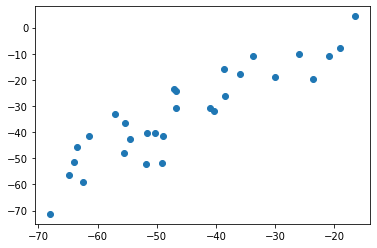

subject_14_stim_period_11_component_9   subject_14_stim_period_11_component_8   SpearmanrResult(correlation=-0.785539488320356, pvalue=2.7187140432533034e-07)   4.541580663778683


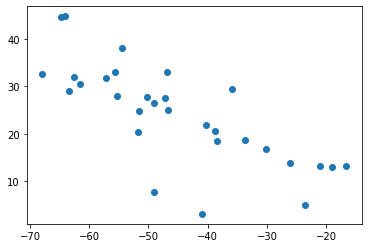

subject_14_stim_period_12_component_0   subject_14_stimulus_12_component_0   SpearmanrResult(correlation=0.9292547274749722, pvalue=1.2453933891519399e-13)   12.429768954007987


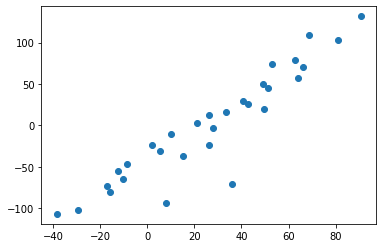

subject_14_stim_period_12_component_1   subject_12_stimulus_14_component_2   SpearmanrResult(correlation=0.8069005144759253, pvalue=7.214722732123053e-08)   1.8122629082240023


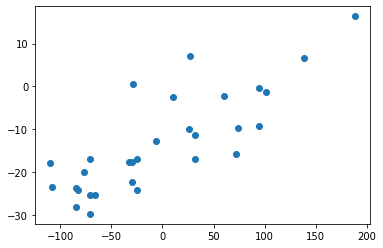

subject_14_stim_period_12_component_1   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=-0.7917686318131256, pvalue=1.875980690808134e-07)   2.5973414126187


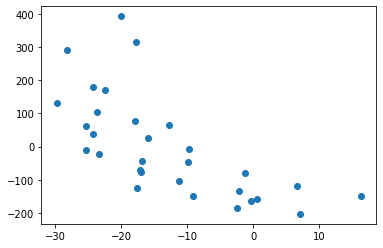

subject_14_stim_period_12_component_1   subject_14_stimulus_14_component_2   SpearmanrResult(correlation=0.7562647477445515, pvalue=1.6648738373640164e-08)   2.3236649049437546


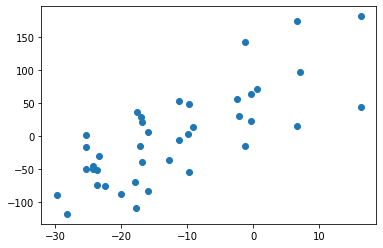

subject_14_stim_period_12_component_1   subject_14_stim_period_10_component_1   SpearmanrResult(correlation=0.8189098998887653, pvalue=3.178865362889628e-08)   2.6638326406888755


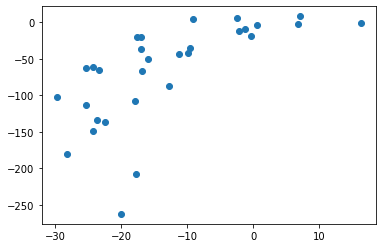

subject_14_stim_period_12_component_1   subject_14_stim_period_10_component_5   SpearmanrResult(correlation=-0.8238042269187986, pvalue=2.2370311120748505e-08)   1.6652941319611294


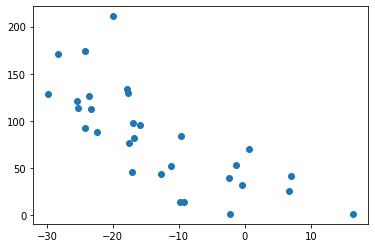

subject_14_stim_period_12_component_1   subject_14_stim_period_10_component_6   SpearmanrResult(correlation=-0.7935483870967741, pvalue=1.6834276517994303e-07)   2.566404411023804


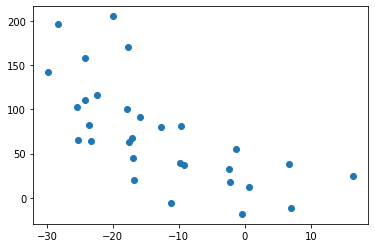

subject_14_stim_period_12_component_2   subject_14_stimulus_12_component_0   SpearmanrResult(correlation=0.8598442714126807, pvalue=1.1489911489309453e-09)   10.229088454462438


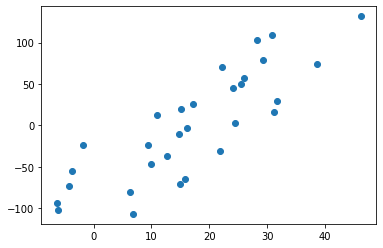

subject_14_stim_period_12_component_2   subject_14_stim_period_12_component_0   SpearmanrResult(correlation=0.8122358175750835, pvalue=5.048900521444922e-08)   11.013428081235524


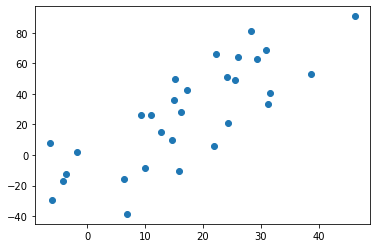

subject_14_stim_period_12_component_3   subject_14_stimulus_12_component_1   SpearmanrResult(correlation=-0.7508342602892103, pvalue=1.756340208530266e-06)   3.1300014269240144


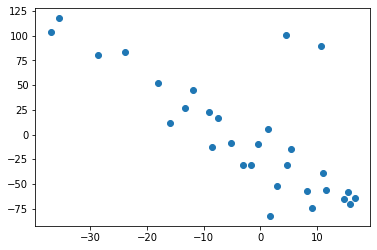

subject_14_stim_period_12_component_4   subject_14_stimulus_9_component_2   SpearmanrResult(correlation=0.8046718576195773, pvalue=8.34784972336776e-08)   7.446156123912181


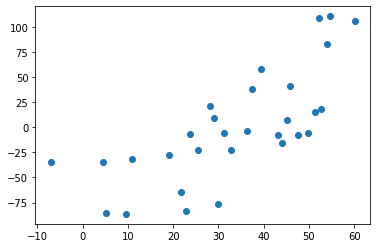

subject_14_stim_period_12_component_4   subject_14_stim_period_12_component_1   SpearmanrResult(correlation=-0.7779755283648498, pvalue=4.198406501585536e-07)   2.6638326406888755


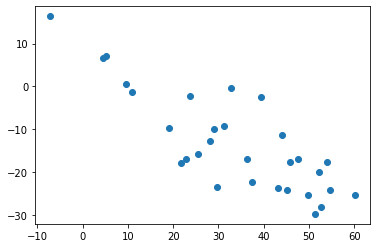

subject_14_stim_period_12_component_5   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=0.7858276189117234, pvalue=1.3834811676091885e-11)   2.0599544294309458


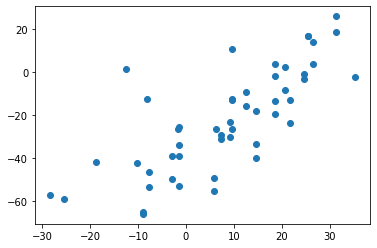

subject_14_stim_period_12_component_5   subject_14_stimulus_12_component_1   SpearmanrResult(correlation=-0.7802002224694105, pvalue=3.701188779155901e-07)   2.7640712116844126


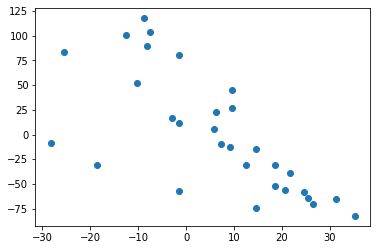

subject_14_stim_period_12_component_5   subject_14_stimulus_9_component_4   SpearmanrResult(correlation=-0.8184649610678532, pvalue=3.2803438024001056e-08)   2.737040074924143


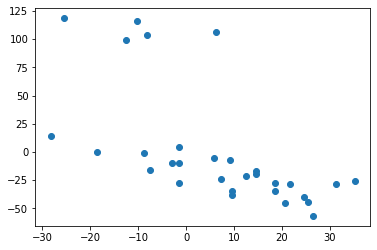

subject_14_stim_period_12_component_7   subject_14_stimulus_12_component_0   SpearmanrResult(correlation=-0.8335928809788653, pvalue=1.0715777460387836e-08)   2.274906291794631


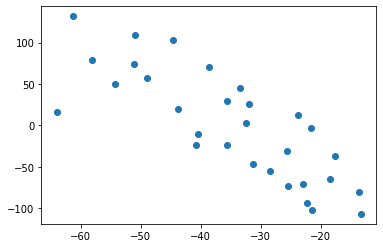

subject_14_stim_period_12_component_9   subject_14_stimulus_12_component_0   SpearmanrResult(correlation=-0.8812013348164627, pvalue=1.3025286362129406e-10)   4.53408870677706


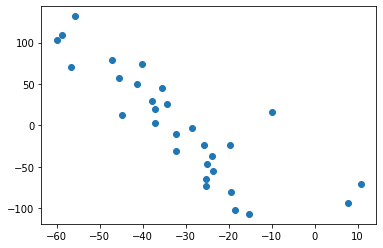

subject_14_stim_period_12_component_9   subject_14_stim_period_12_component_0   SpearmanrResult(correlation=-0.7784204671857619, pvalue=4.0943561467168264e-07)   4.569013471934383


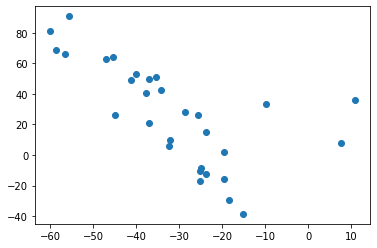

subject_14_stim_period_14_component_0   subject_14_stimulus_14_component_0   SpearmanrResult(correlation=0.9911819887429645, pvalue=5.727889472391681e-35)   4.704139304910868


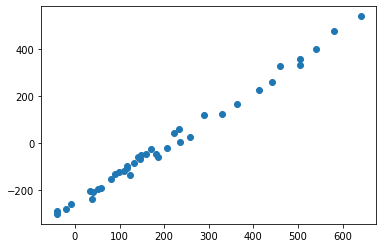

subject_14_stim_period_14_component_0   subject_14_stimulus_15_component_0   SpearmanrResult(correlation=0.8639774859287056, pvalue=7.015361339926934e-13)   11.31737996588658


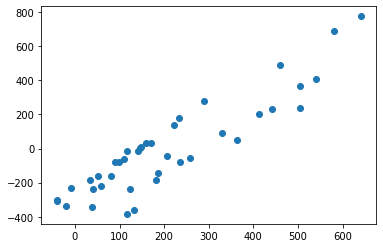

subject_14_stim_period_14_component_1   subject_13_stimulus_10_component_7   SpearmanrResult(correlation=0.8474063644942094, pvalue=8.511191023826233e-15)   2.1186234591031297


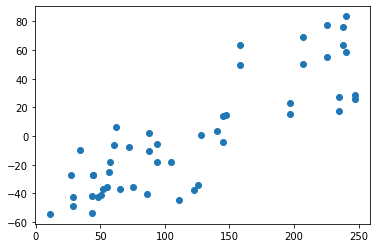

subject_14_stim_period_14_component_1   subject_14_stimulus_14_component_0   SpearmanrResult(correlation=0.8833020637898689, pvalue=4.54729397260497e-14)   1.4987109422697862


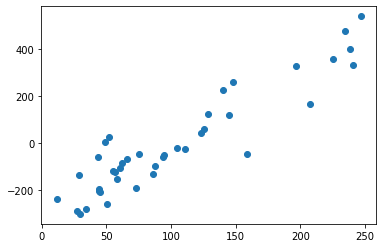

subject_14_stim_period_14_component_1   subject_14_stimulus_15_component_0   SpearmanrResult(correlation=0.84859287054409, pvalue=4.667981389528952e-12)   2.571875825574166


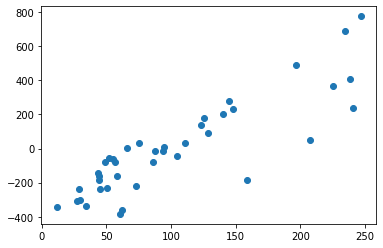

subject_14_stim_period_14_component_1   subject_14_stim_period_14_component_0   SpearmanrResult(correlation=0.8418386491557224, pvalue=1.0052870391682519e-11)   2.6638326406888755


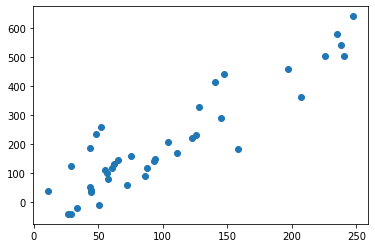

subject_14_stim_period_14_component_2   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.761699320446662, pvalue=1.142737848346772e-08)   6.3793699396712755


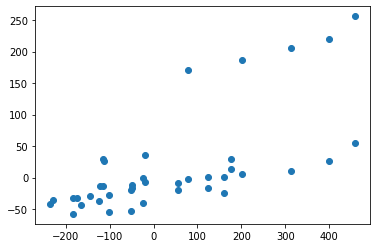

subject_14_stim_period_14_component_2   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.8046939333089458, pvalue=3.9182873165442436e-10)   5.6201414842313095


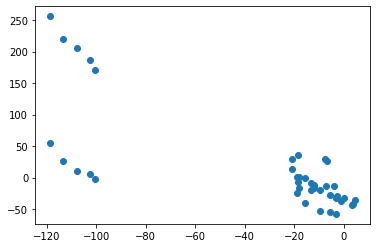

subject_14_stim_period_14_component_2   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.7598218264352083, pvalue=1.3028402126976482e-08)   2.7557474520345204


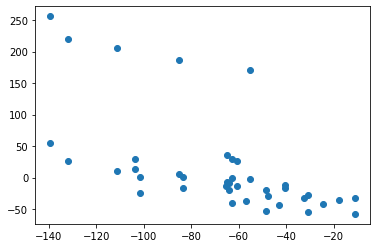

subject_14_stim_period_14_component_2   subject_13_stimulus_11_component_0   SpearmanrResult(correlation=0.7529779275732992, pvalue=2.83244174581327e-10)   5.239805237782793


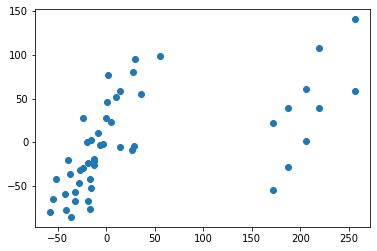

subject_14_stim_period_14_component_3   subject_13_stim_period_14_component_2   SpearmanrResult(correlation=0.7681512950986806, pvalue=1.097199155758971e-20)   1.7178093855354628


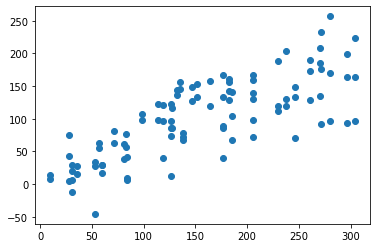

subject_14_stim_period_14_component_3   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=0.7849664011182261, pvalue=1.5073743929109868e-11)   1.8544384362140196


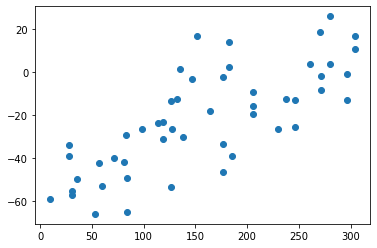

subject_14_stim_period_14_component_3   subject_14_stimulus_14_component_0   SpearmanrResult(correlation=0.8879924953095686, pvalue=2.175782017689057e-14)   3.0507431517664516


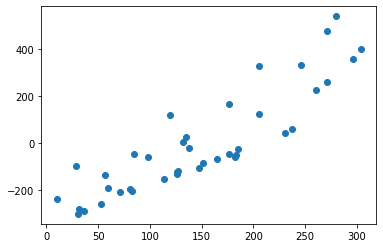

subject_14_stim_period_14_component_3   subject_14_stimulus_15_component_0   SpearmanrResult(correlation=0.8240150093808631, pvalue=6.483897249411193e-11)   3.3254747641498437


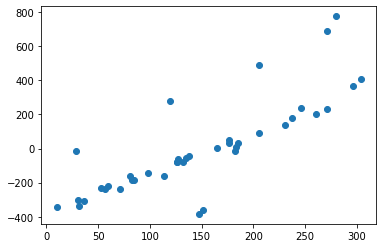

subject_14_stim_period_14_component_3   subject_14_stimulus_9_component_4   SpearmanrResult(correlation=-0.7589864749330091, pvalue=1.3805830322326732e-08)   2.814111787053347


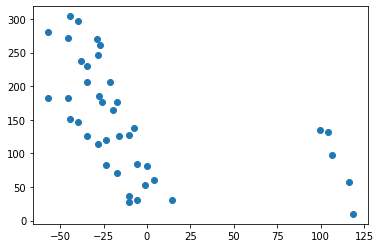

subject_14_stim_period_14_component_3   subject_14_stim_period_10_component_5   SpearmanrResult(correlation=0.7503520300592814, pvalue=2.480109608148999e-08)   1.4630265734270331


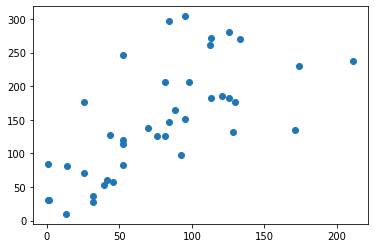

subject_14_stim_period_14_component_3   subject_14_stim_period_14_component_0   SpearmanrResult(correlation=0.8504690431519701, pvalue=3.747270091991889e-12)   3.553439744997648


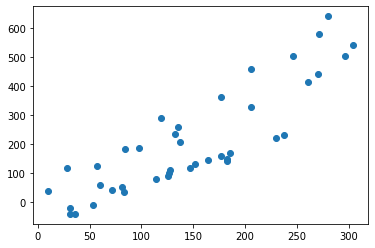

subject_14_stim_period_14_component_3   subject_14_stim_period_14_component_1   SpearmanrResult(correlation=0.8136960600375236, pvalue=1.7389636788846941e-10)   1.0386613412710406


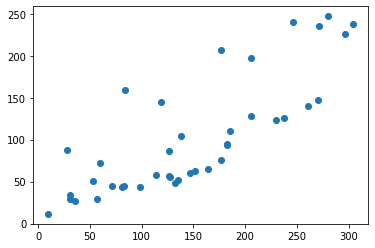

subject_14_stim_period_14_component_4   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=0.7630221393848602, pvalue=1.0411514910934558e-08)   14.02067476165607


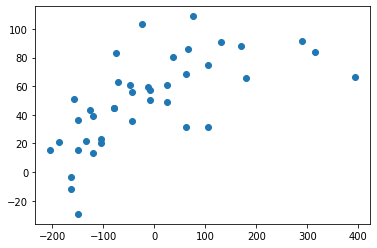

subject_14_stim_period_14_component_4   subject_14_stimulus_9_component_0   SpearmanrResult(correlation=0.8163304512139623, pvalue=1.3597234524654819e-10)   17.283012026400044


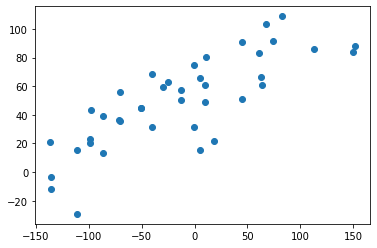

subject_14_stim_period_14_component_4   subject_14_stim_period_10_component_6   SpearmanrResult(correlation=0.7611450861514409, pvalue=1.1879831057573323e-08)   9.89823408379354


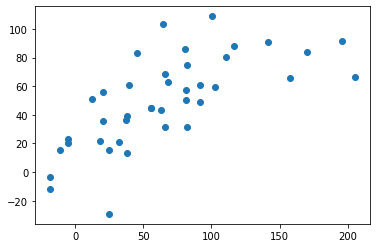

subject_14_stim_period_14_component_4   subject_14_stim_period_11_component_9   SpearmanrResult(correlation=-0.7789770918689224, pvalue=3.22424247491975e-09)   4.576705779626691


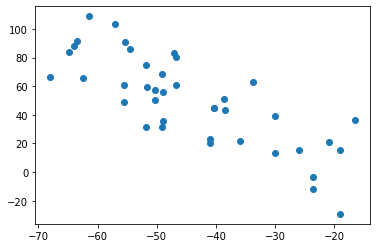

subject_14_stim_period_14_component_5   subject_13_stim_period_12_component_7   SpearmanrResult(correlation=-0.8351585255243049, pvalue=4.6920043164454573e-14)   2.1977649728738413


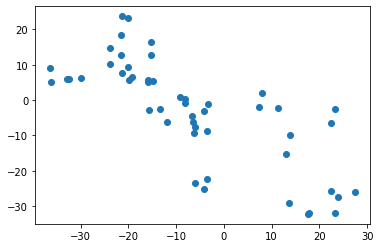

subject_14_stim_period_14_component_8   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.863365621166866, pvalue=7.597371814232592e-13)   8.267617664905089


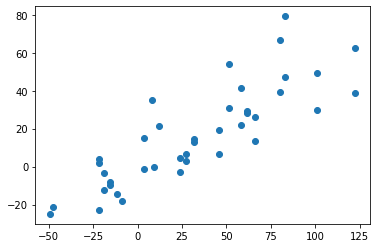

subject_14_stim_period_14_component_8   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.7644216867632695, pvalue=9.428705630996004e-09)   5.578161560867885


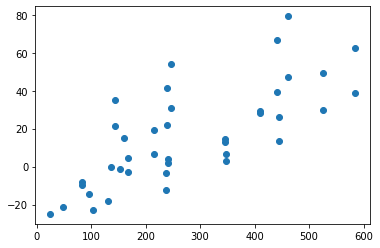

subject_14_stim_period_14_component_8   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.7946493403476699, pvalue=9.245336809911944e-10)   2.9117502934526


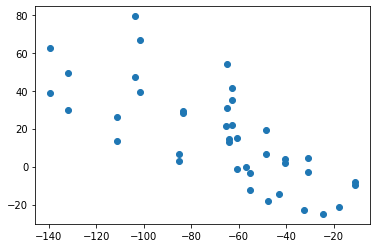

subject_14_stim_period_14_component_8   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.7719316628090832, pvalue=5.473317644271561e-09)   8.121764752706301


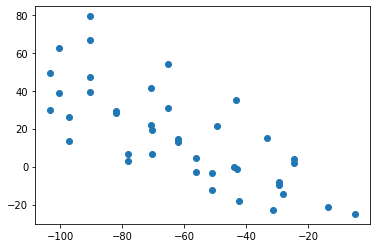

subject_14_stim_period_14_component_8   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.830697225367576, pvalue=3.3061795774570474e-11)   8.267617664905089


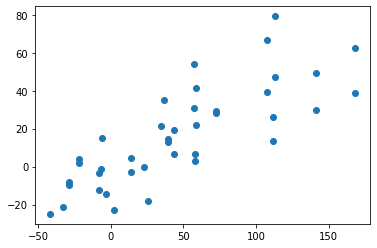

subject_14_stim_period_14_component_8   subject_12_stim_period_15_component_3   SpearmanrResult(correlation=0.8308849747687214, pvalue=3.2428400246869073e-11)   6.204964592228597


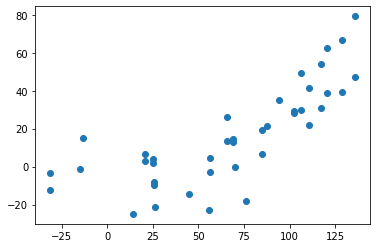

subject_14_stim_period_14_component_8   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=-0.7984043283705767, pvalue=6.745134429458352e-10)   4.748289552296804


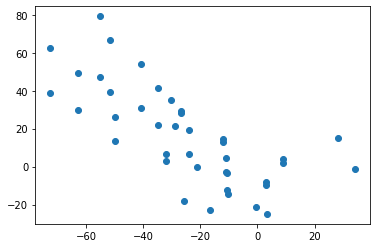

subject_14_stim_period_14_component_8   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=0.8579208885336509, pvalue=1.5188712687635807e-12)   2.9117502934526


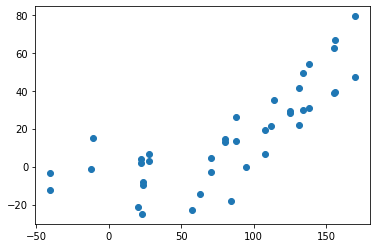

subject_14_stim_period_14_component_8   subject_12_stim_period_15_component_9   SpearmanrResult(correlation=0.7507159804796593, pvalue=2.4207761050802797e-08)   8.121764752706301


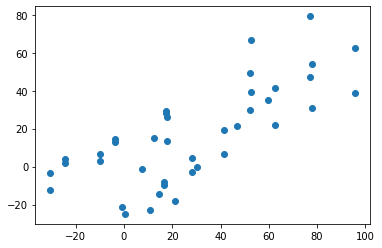

subject_14_stim_period_14_component_8   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.8608549719905749, pvalue=1.0901020176483419e-15)   2.1445539514690215


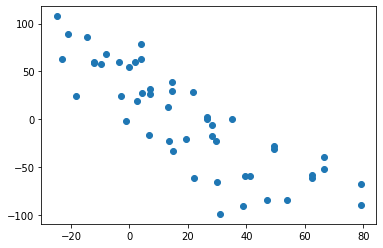

subject_14_stim_period_14_component_8   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.7823727411010699, pvalue=1.9470672652287714e-11)   4.342254178525911


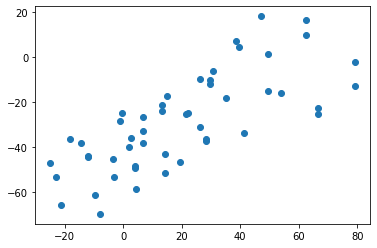

subject_14_stim_period_14_component_8   subject_13_stim_period_14_component_2   SpearmanrResult(correlation=0.7652941521128634, pvalue=1.85386644550981e-20)   4.767510613573999


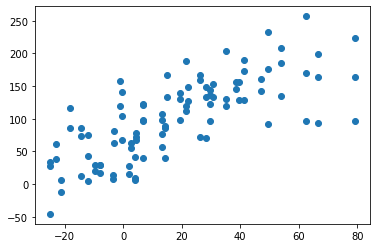

subject_14_stim_period_14_component_8   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=0.8775696698789152, pvalue=6.149805073908638e-17)   4.342254178525911


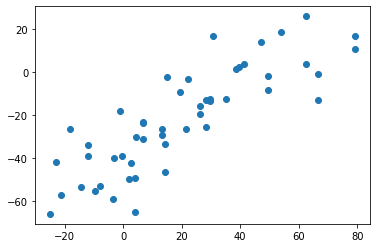

subject_14_stim_period_14_component_8   subject_14_stimulus_14_component_0   SpearmanrResult(correlation=0.7720450281425892, pvalue=5.427716199148713e-09)   3.89863448407273


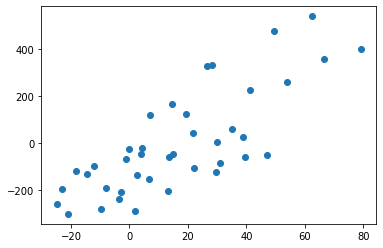

subject_14_stim_period_14_component_8   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.868418678441342, pvalue=3.887665479552107e-13)   8.5053338980571


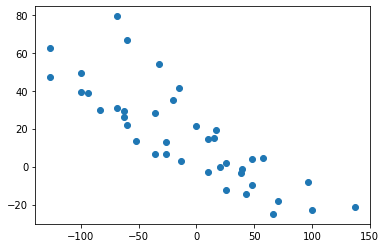

subject_14_stim_period_14_component_8   subject_14_stim_period_11_component_5   SpearmanrResult(correlation=0.8152980719355817, pvalue=1.498031115732551e-10)   2.7752805861927206


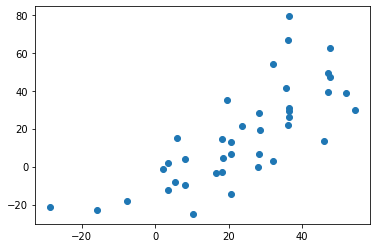

subject_14_stim_period_14_component_8   subject_14_stim_period_11_component_7   SpearmanrResult(correlation=0.7687471517467884, pvalue=6.910069456874307e-09)   2.274906291794631


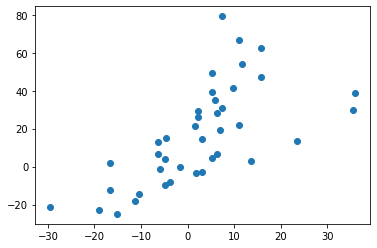

subject_14_stim_period_14_component_8   subject_14_stim_period_14_component_0   SpearmanrResult(correlation=0.7607879924953096, pvalue=1.2180122261694741e-08)   10.74462626357017


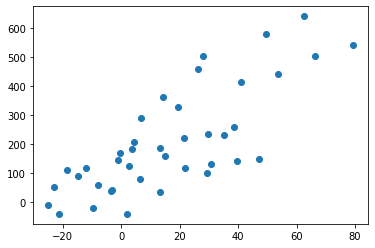

subject_14_stim_period_14_component_8   subject_14_stim_period_14_component_3   SpearmanrResult(correlation=0.8155722326454035, pvalue=1.460071217221159e-10)   2.8056534433208076


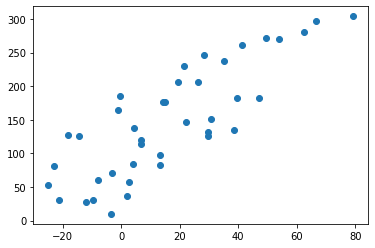

subject_14_stim_period_15_component_0   subject_14_stimulus_14_component_0   SpearmanrResult(correlation=0.8953095684803002, pvalue=6.437607383616436e-15)   4.704139304910868


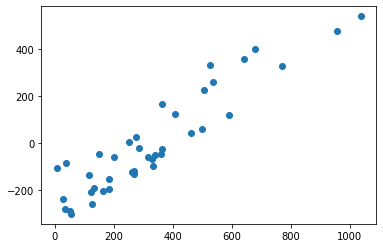

subject_14_stim_period_15_component_0   subject_14_stimulus_15_component_0   SpearmanrResult(correlation=0.9975609756097563, pvalue=1.5024719649981928e-45)   11.31737996588658


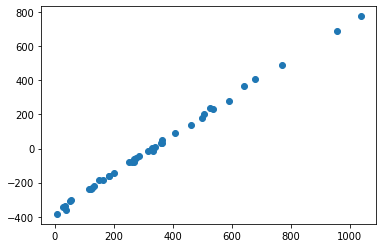

subject_14_stim_period_15_component_0   subject_14_stim_period_14_component_0   SpearmanrResult(correlation=0.8617260787992497, pvalue=9.38852717560407e-13)   17.69136508377818


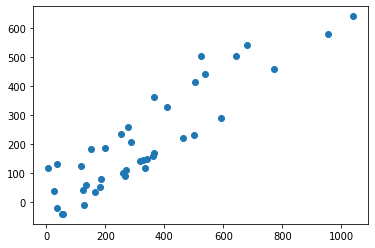

subject_14_stim_period_15_component_0   subject_14_stim_period_14_component_1   SpearmanrResult(correlation=0.8559099437148219, pvalue=1.9476426117074263e-12)   2.6638326406888755


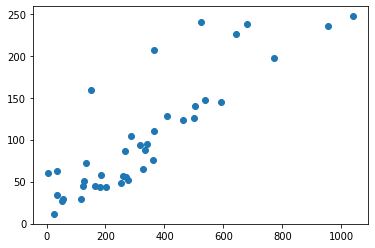

subject_14_stim_period_15_component_0   subject_14_stim_period_14_component_3   SpearmanrResult(correlation=0.8238273921200752, pvalue=6.604981971481066e-11)   3.553439744997648


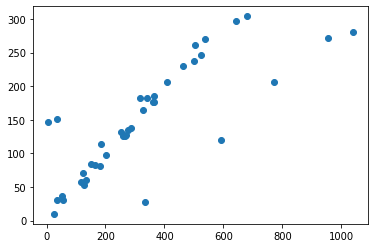

subject_14_stim_period_15_component_1   subject_14_stimulus_14_component_0   SpearmanrResult(correlation=0.9001876172607881, pvalue=2.7163676993060478e-15)   1.4987109422697862


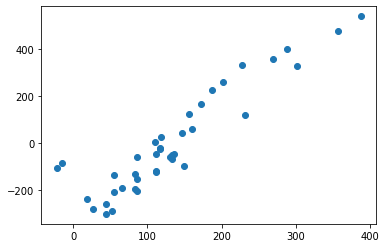

subject_14_stim_period_15_component_1   subject_14_stimulus_15_component_0   SpearmanrResult(correlation=0.980112570356473, pvalue=2.6765392983126494e-28)   2.571875825574166


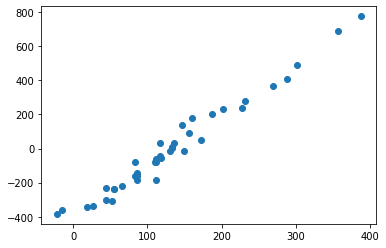

subject_14_stim_period_15_component_1   subject_14_stim_period_14_component_0   SpearmanrResult(correlation=0.8735459662288932, pvalue=1.913983139297332e-13)   2.6638326406888755


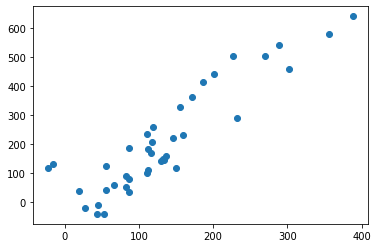

subject_14_stim_period_15_component_1   subject_14_stim_period_14_component_1   SpearmanrResult(correlation=0.8637898686679175, pvalue=7.189213047140106e-13)   2.6638326406888755


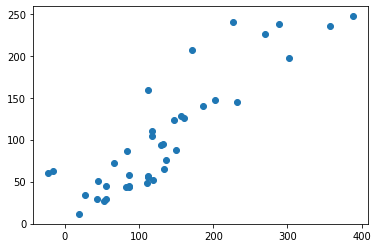

subject_14_stim_period_15_component_1   subject_14_stim_period_14_component_3   SpearmanrResult(correlation=0.7795497185741089, pvalue=3.085905853113248e-09)   1.0386613412710406


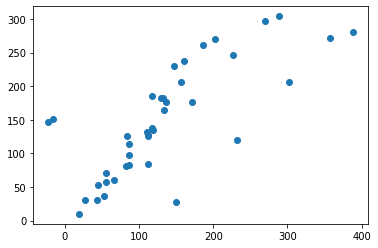

subject_14_stim_period_15_component_1   subject_14_stim_period_15_component_0   SpearmanrResult(correlation=0.9759849906191371, pvalue=9.295453584243507e-27)   2.6638326406888755


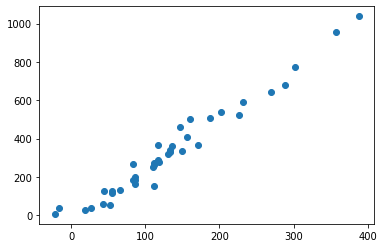

subject_14_stim_period_15_component_2   subject_14_stimulus_14_component_0   SpearmanrResult(correlation=-0.751782363977486, pvalue=2.254440123536404e-08)   4.645307798398551


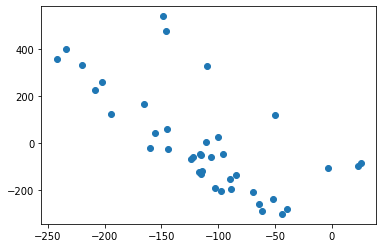

subject_14_stim_period_15_component_2   subject_14_stimulus_15_component_0   SpearmanrResult(correlation=-0.7791744840525331, pvalue=3.1759156773151088e-09)   9.464423033710734


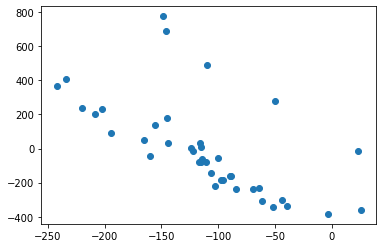

subject_14_stim_period_15_component_2   subject_14_stim_period_14_component_3   SpearmanrResult(correlation=-0.8262664165103191, pvalue=5.184027509484314e-11)   3.451057937082243


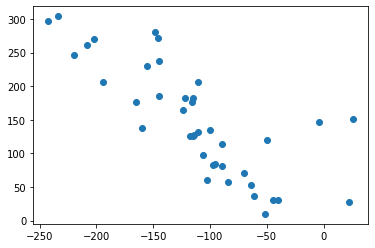

subject_14_stim_period_15_component_2   subject_14_stim_period_14_component_7   SpearmanrResult(correlation=-0.7881801125703566, pvalue=1.5680178815707544e-09)   2.274906291794631


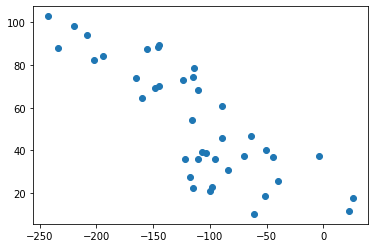

subject_14_stim_period_15_component_2   subject_14_stim_period_15_component_0   SpearmanrResult(correlation=-0.7677298311444654, pvalue=7.438503053500968e-09)   11.013428081235524


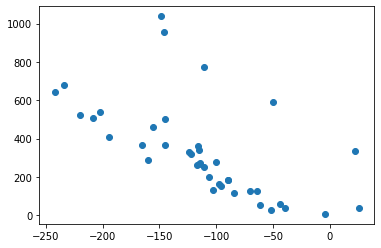

subject_14_stim_period_15_component_3   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=-0.8449555130236034, pvalue=7.08774633731937e-12)   3.553439744997648


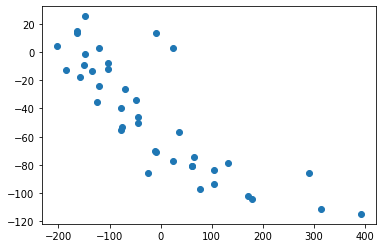

subject_14_stim_period_15_component_3   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=-0.7766307753271486, pvalue=3.8537330593236434e-09)   3.156670890699071


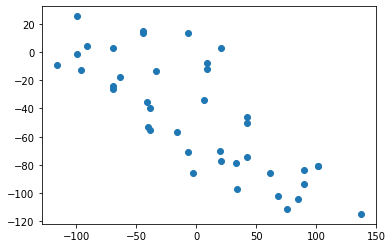

subject_14_stim_period_15_component_3   subject_14_stim_period_10_component_0   SpearmanrResult(correlation=-0.7721258475669427, pvalue=5.395422899563196e-09)   3.553439744997648


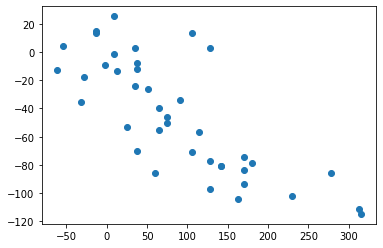

subject_14_stim_period_15_component_3   subject_14_stim_period_10_component_1   SpearmanrResult(correlation=0.8286251498928574, pvalue=4.086660754518664e-11)   1.0386613412710406


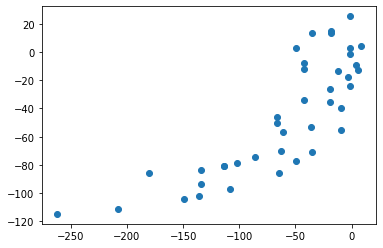

subject_14_stim_period_15_component_3   subject_14_stim_period_10_component_5   SpearmanrResult(correlation=-0.8111685548220597, pvalue=2.193972134730552e-10)   1.4630265734270331


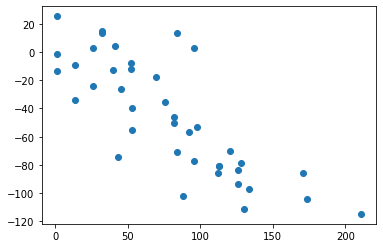

subject_14_stim_period_15_component_3   subject_14_stim_period_10_component_6   SpearmanrResult(correlation=-0.763115992046531, pvalue=1.0342734956400205e-08)   3.38568691033486


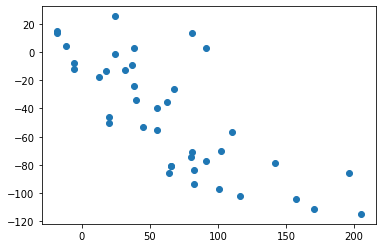

subject_14_stim_period_15_component_3   subject_14_stim_period_11_component_3   SpearmanrResult(correlation=0.7672455091600531, pvalue=7.70309082883157e-09)   3.553439744997648


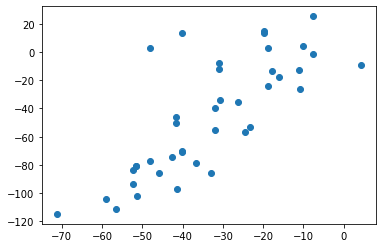

subject_14_stim_period_15_component_3   subject_14_stim_period_11_component_9   SpearmanrResult(correlation=0.8156734825822657, pvalue=1.4462813507468098e-10)   1.8055860301499456


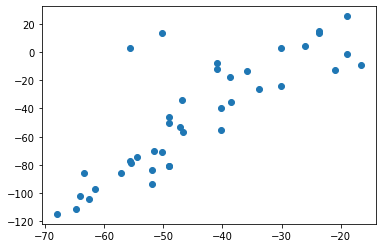

subject_14_stim_period_15_component_3   subject_14_stim_period_12_component_1   SpearmanrResult(correlation=0.7792586498539353, pvalue=3.1555158456806347e-09)   1.0386613412710406


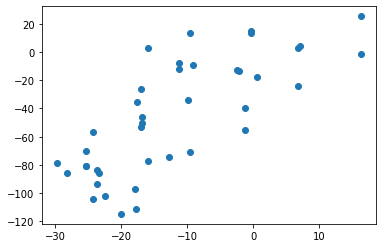

subject_14_stim_period_15_component_3   subject_14_stim_period_14_component_4   SpearmanrResult(correlation=-0.7744840525328331, pvalue=4.52833818489711e-09)   3.553439744997648


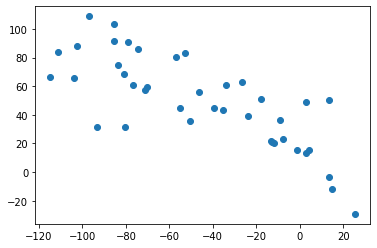

subject_14_stim_period_15_component_4   subject_14_stimulus_15_component_0   SpearmanrResult(correlation=-0.7848030018761728, pvalue=2.051146149253828e-09)   11.392689122022436


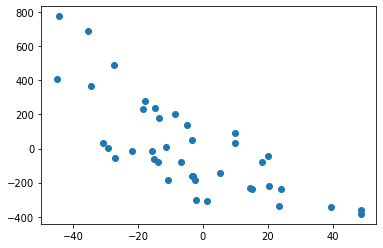

subject_14_stim_period_15_component_4   subject_14_stim_period_15_component_0   SpearmanrResult(correlation=-0.7729831144465292, pvalue=5.0637307367773385e-09)   15.183307470077715


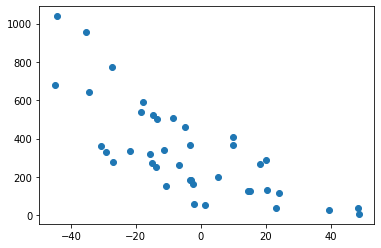

subject_14_stim_period_15_component_4   subject_14_stim_period_15_component_1   SpearmanrResult(correlation=-0.8202626641651034, pvalue=9.349265983810076e-11)   2.6638326406888755


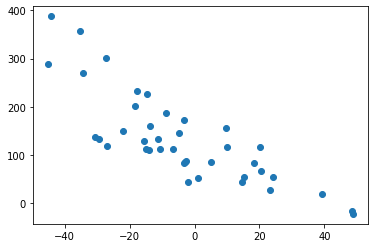

subject_14_stim_period_15_component_5   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.7678011759838856, pvalue=7.4002502841634366e-09)   1.9658164003102587


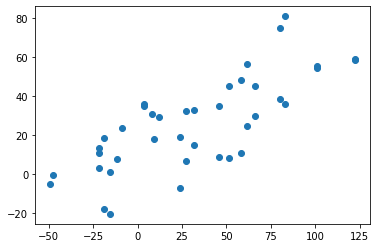

subject_14_stim_period_15_component_5   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.7721194122102285, pvalue=5.397987720683063e-09)   1.6859950165398179


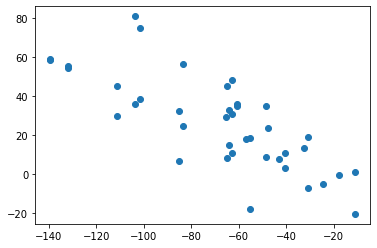

subject_14_stim_period_15_component_5   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.7709929158033565, pvalue=5.8648873858322105e-09)   1.9658164003102587


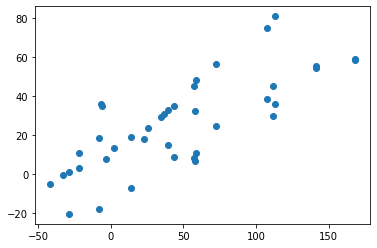

subject_14_stim_period_15_component_5   subject_13_stim_period_11_component_2   SpearmanrResult(correlation=-0.7539385423944682, pvalue=2.610609141942095e-10)   1.8200100447407408


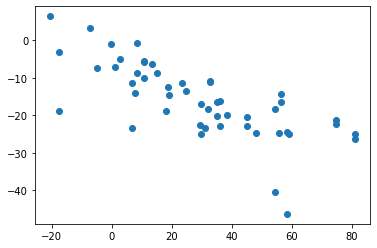

subject_14_stim_period_15_component_5   subject_14_stimulus_14_component_0   SpearmanrResult(correlation=0.7649155722326455, pvalue=9.103024212912347e-09)   1.9420690185414948


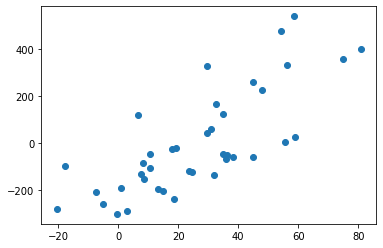

subject_14_stim_period_15_component_5   subject_14_stim_period_14_component_0   SpearmanrResult(correlation=0.7894934333958725, pvalue=1.410651661629555e-09)   2.819668413083713


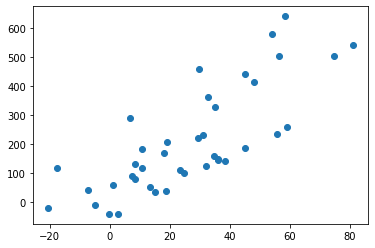

subject_14_stim_period_15_component_5   subject_14_stim_period_14_component_3   SpearmanrResult(correlation=0.7632270168855536, pvalue=1.0261916733925279e-08)   1.4630265734270331


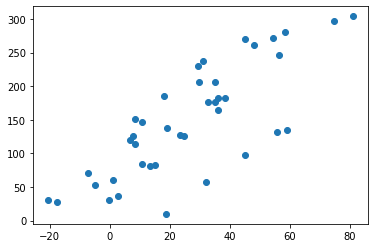

subject_14_stim_period_15_component_5   subject_14_stim_period_14_component_8   SpearmanrResult(correlation=0.7821763602251409, pvalue=2.5193970750993e-09)   2.7752805861927206


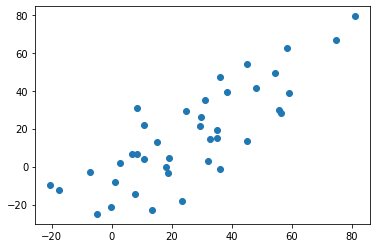

subject_14_stim_period_15_component_5   subject_14_stim_period_15_component_2   SpearmanrResult(correlation=-0.7534709193245779, pvalue=2.012650139368558e-08)   2.6395841376035873


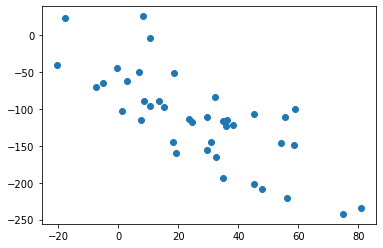

subject_14_stim_period_15_component_6   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=0.762262568650098, pvalue=1.0984045205649095e-08)   5.358796930735872


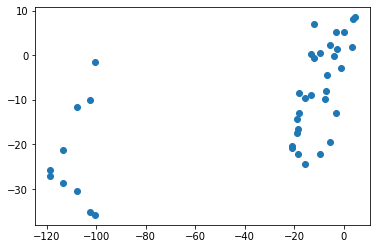

subject_14_stim_period_15_component_6   subject_14_stim_period_11_component_7   SpearmanrResult(correlation=-0.8181136517857105, pvalue=1.1485849054618662e-10)   2.264153603622588


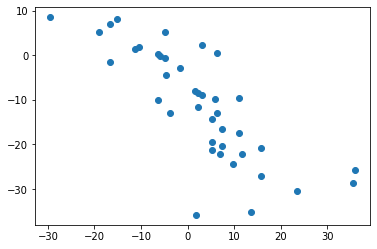

subject_14_stim_period_15_component_7   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=-0.7518251897878965, pvalue=3.122141789927062e-10)   1.628987613636622


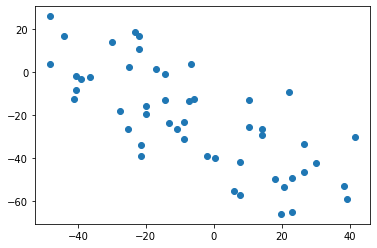

subject_14_stim_period_15_component_7   subject_13_stim_period_9_component_3   SpearmanrResult(correlation=-0.7733909925231399, pvalue=4.602134181302484e-11)   1.7786156839296874


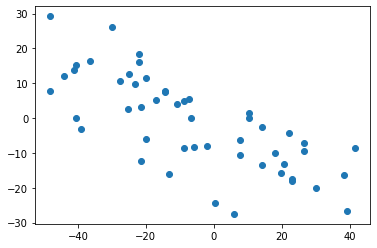

subject_14_stim_period_15_component_7   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=-0.7515721146610037, pvalue=2.2863689902575378e-08)   2.274906291794631


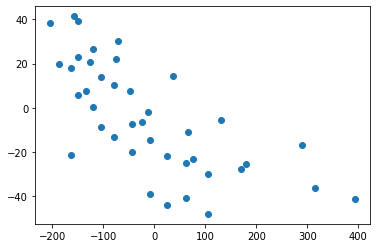

subject_14_stim_period_15_component_7   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=-0.815016513950569, pvalue=1.537975118197235e-10)   2.274906291794631


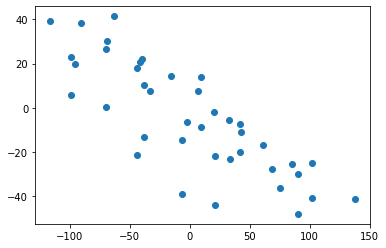

subject_14_stim_period_15_component_7   subject_14_stimulus_15_component_2   SpearmanrResult(correlation=0.7611632270168857, pvalue=1.186476137544592e-08)   1.5640391508779943


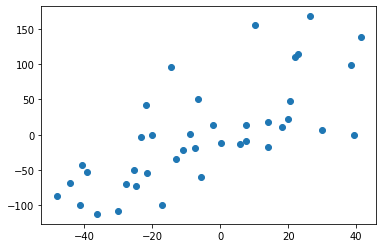

subject_14_stim_period_15_component_7   subject_14_stim_period_10_component_0   SpearmanrResult(correlation=-0.7750352800787423, pvalue=4.3453287384969575e-09)   2.274906291794631


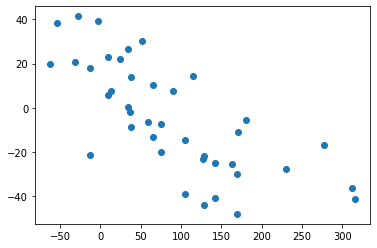

subject_14_stim_period_15_component_7   subject_14_stim_period_11_component_3   SpearmanrResult(correlation=0.8801502611502113, pvalue=7.33317761513087e-14)   1.0859313774777615


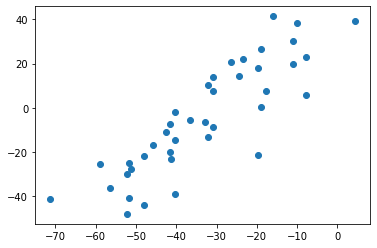

subject_14_stim_period_15_component_8   subject_14_stim_period_15_component_2   SpearmanrResult(correlation=0.7876172607879927, pvalue=1.6403533860747906e-09)   8.861649425498783


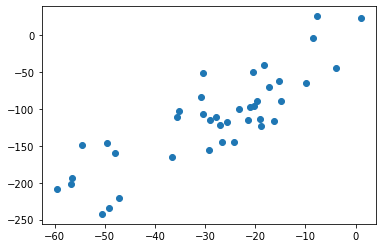

subject_14_stim_period_1_component_0   subject_14_stimulus_1_component_0   SpearmanrResult(correlation=0.9566253213508824, pvalue=0.0)   14.088282252695077


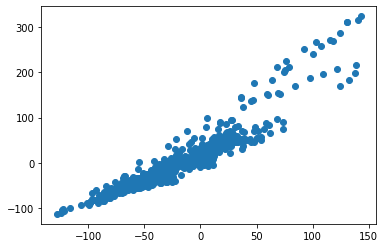

subject_14_stim_period_1_component_1   subject_14_stimulus_1_component_0   SpearmanrResult(correlation=-0.830481138259615, pvalue=2.8747041312256524e-164)   2.5997300765863116


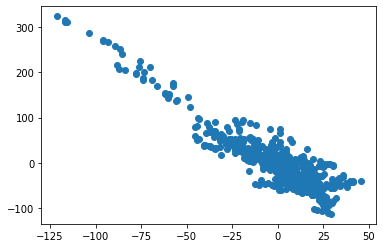

subject_14_stim_period_1_component_2   subject_14_stimulus_1_component_2   SpearmanrResult(correlation=0.8777785407190937, pvalue=4.450086892840788e-206)   10.14742003802316


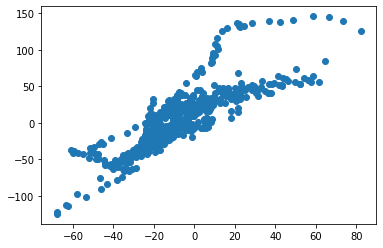

subject_14_stim_period_1_component_3   subject_14_stimulus_1_component_0   SpearmanrResult(correlation=-0.8296758842184675, pvalue=1.1339458951767474e-163)   3.4105020640355104


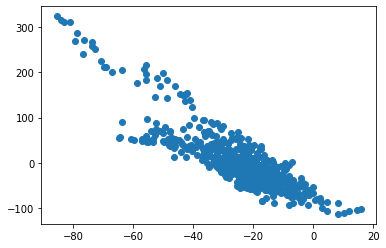

subject_14_stim_period_1_component_3   subject_14_stim_period_1_component_0   SpearmanrResult(correlation=-0.8827781561966705, pvalue=1.6903321324914626e-211)   3.553439744997648


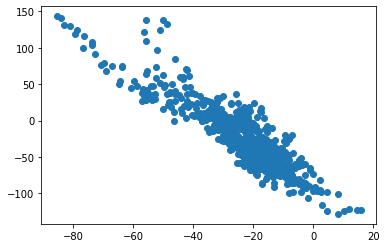

subject_14_stim_period_1_component_4   subject_14_stimulus_1_component_0   SpearmanrResult(correlation=0.8237237517669722, pvalue=2.3174860346064366e-159)   17.132640521828307


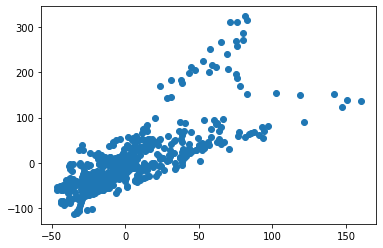

subject_14_stim_period_1_component_4   subject_14_stim_period_1_component_1   SpearmanrResult(correlation=-0.7746485739711281, pvalue=4.3559922285971054e-129)   2.6638326406888755


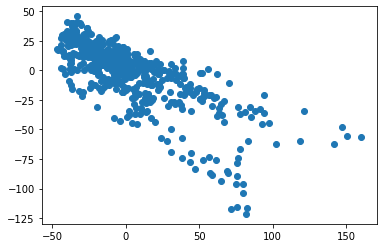

subject_14_stim_period_2_component_0   subject_14_stimulus_2_component_0   SpearmanrResult(correlation=0.9778723367244552, pvalue=0.0)   17.213710571608807


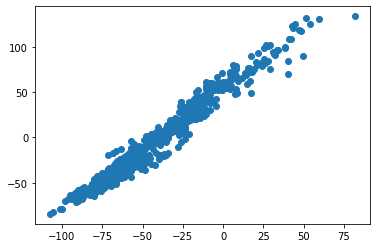

subject_14_stim_period_2_component_4   subject_14_stimulus_2_component_1   SpearmanrResult(correlation=-0.7928211494656972, pvalue=2.4675467072095315e-139)   5.619638289146754


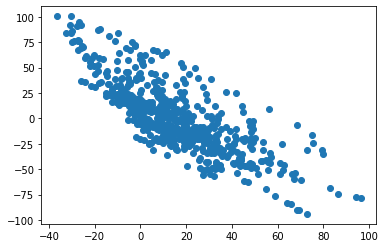

subject_14_stim_period_2_component_4   subject_14_stim_period_2_component_1   SpearmanrResult(correlation=-0.8269710436304777, pvalue=1.0810616429837183e-161)   2.6638326406888755


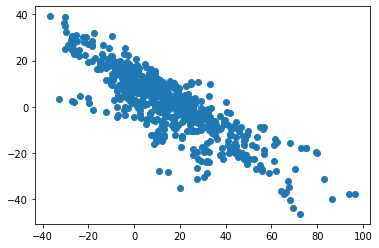

subject_14_stim_period_3_component_0   subject_14_stimulus_3_component_0   SpearmanrResult(correlation=0.9980470728667363, pvalue=0.0)   15.898670452464138


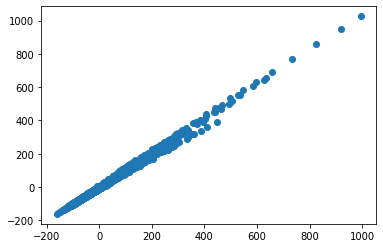

subject_14_stim_period_3_component_3   subject_14_stimulus_3_component_3   SpearmanrResult(correlation=0.8006604282231514, pvalue=0.0)   2.4549308699969656


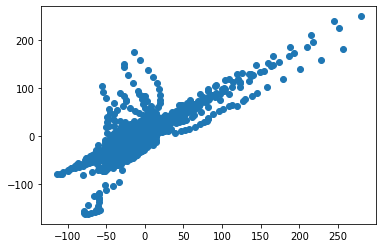

subject_14_stim_period_3_component_5   subject_14_stimulus_3_component_4   SpearmanrResult(correlation=0.7602530897468001, pvalue=0.0)   1.4336961678174813


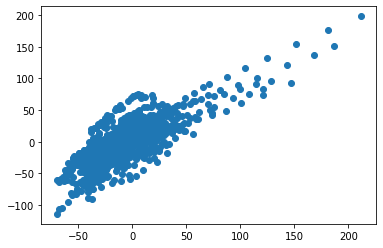

subject_14_stim_period_4_component_0   subject_14_stimulus_4_component_0   SpearmanrResult(correlation=0.9809570758283034, pvalue=0.0)   15.000889313184349


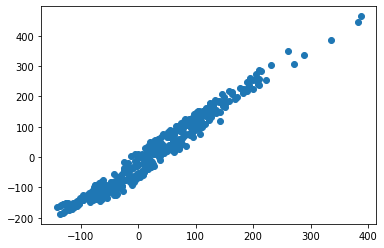

subject_14_stim_period_4_component_1   subject_14_stimulus_4_component_0   SpearmanrResult(correlation=-0.9703845535382142, pvalue=2.07663425153661e-309)   2.6283940441976474


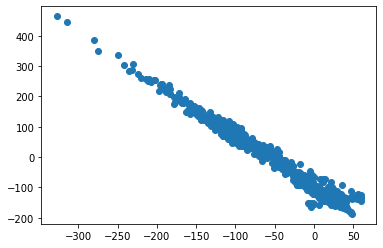

subject_14_stim_period_4_component_1   subject_14_stim_period_4_component_0   SpearmanrResult(correlation=-0.9253597974391897, pvalue=6.31456641813302e-212)   2.6638326406888755


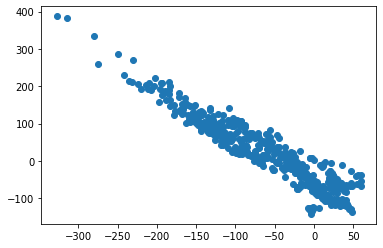

subject_14_stim_period_4_component_4   subject_14_stimulus_4_component_1   SpearmanrResult(correlation=0.8422564890259561, pvalue=9.759010128772671e-136)   19.395677661421498


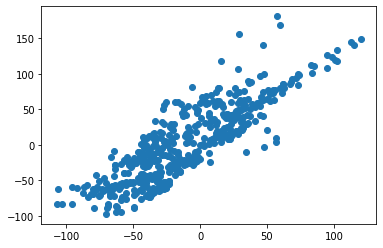

subject_14_stim_period_4_component_4   subject_14_stim_period_4_component_3   SpearmanrResult(correlation=-0.831813567254269, pvalue=2.051544150318508e-129)   3.553439744997648


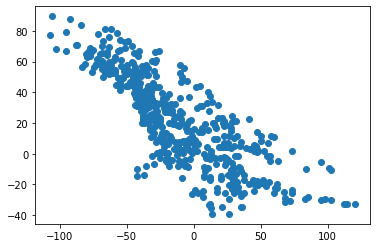

subject_14_stim_period_9_component_0   subject_14_stimulus_9_component_0   SpearmanrResult(correlation=0.9719688542825362, pvalue=3.8155860628438806e-19)   14.620227836999412


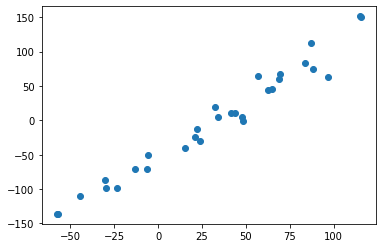

subject_14_stim_period_9_component_0   subject_14_stim_period_11_component_8   SpearmanrResult(correlation=0.8318131256952168, pvalue=1.2292678852637056e-08)   10.74462626357017


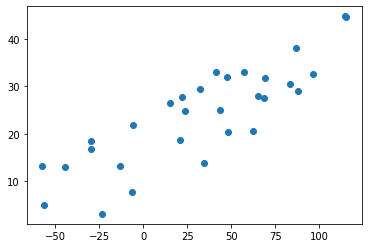

subject_14_stim_period_9_component_0   subject_14_stim_period_11_component_9   SpearmanrResult(correlation=-0.8166852057842046, pvalue=3.716568462936411e-08)   4.569013471934383


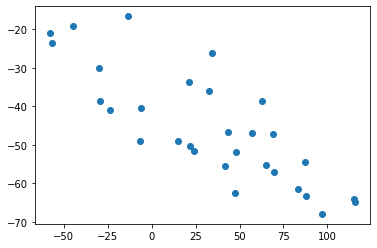

subject_14_stim_period_9_component_0   subject_14_stim_period_14_component_4   SpearmanrResult(correlation=0.8296575291712378, pvalue=3.678440162395602e-11)   15.183307470077715


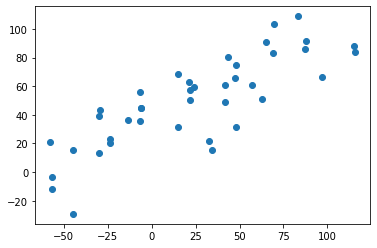

subject_14_stim_period_9_component_1   subject_14_stimulus_11_component_2   SpearmanrResult(correlation=-0.7601779755283649, pvalue=1.09590752663524e-06)   2.293645474320282


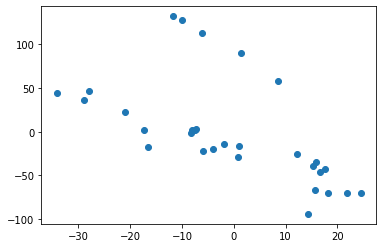

subject_14_stim_period_9_component_1   subject_14_stimulus_9_component_0   SpearmanrResult(correlation=-0.9337041156840934, pvalue=5.157534283157095e-14)   2.6638326406888755


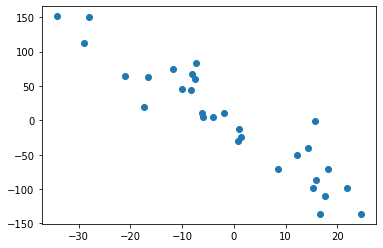

subject_14_stim_period_9_component_1   subject_14_stim_period_11_component_8   SpearmanrResult(correlation=-0.8718576195773081, pvalue=3.5407504895164856e-10)   2.6638326406888755


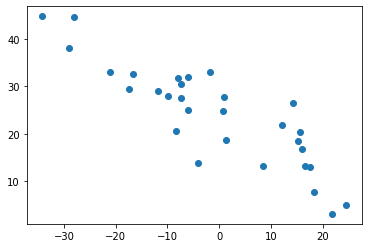

subject_14_stim_period_9_component_1   subject_14_stim_period_9_component_0   SpearmanrResult(correlation=-0.8838709677419355, pvalue=9.638580004262775e-11)   2.6638326406888755


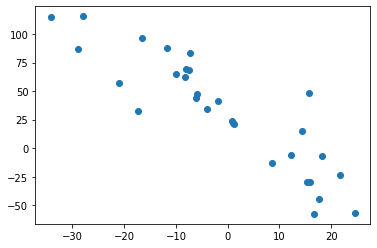

subject_14_stim_period_9_component_2   subject_12_stim_period_15_component_9   SpearmanrResult(correlation=0.772843747933907, pvalue=5.585062941840358e-07)   8.3230612676996


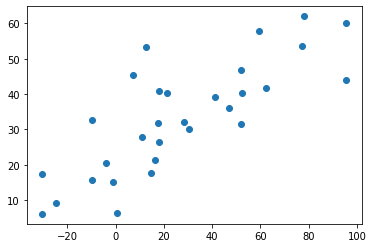

subject_14_stim_period_9_component_2   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.8341581553563767, pvalue=5.360804892761204e-14)   2.1445539514690215


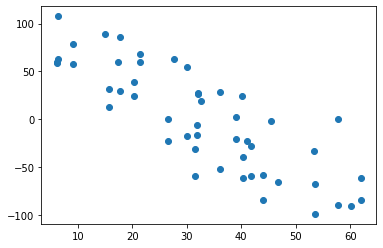

subject_14_stim_period_9_component_2   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=0.8566419436825176, pvalue=2.1221055418494076e-15)   4.693563505950335


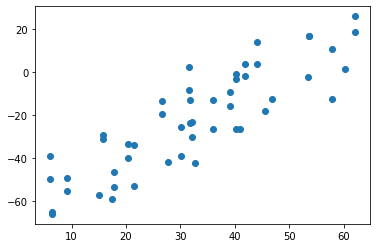

subject_14_stim_period_9_component_2   subject_13_stim_period_9_component_5   SpearmanrResult(correlation=-0.7556570653458763, pvalue=2.2541051705489435e-10)   5.981079301085439


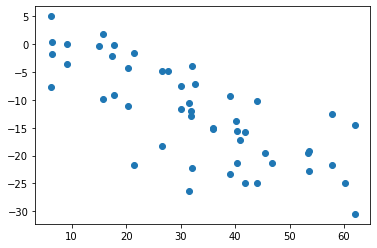

subject_14_stim_period_9_component_2   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=0.8456062291434927, pvalue=4.059555310007682e-09)   10.651256644617781


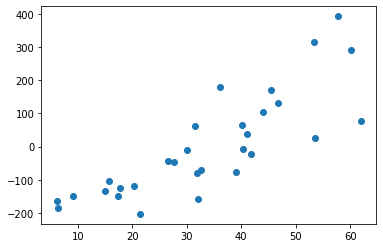

subject_14_stim_period_9_component_2   subject_14_stimulus_14_component_2   SpearmanrResult(correlation=-0.7528860519243971, pvalue=2.0935261003078792e-08)   3.840303570598361


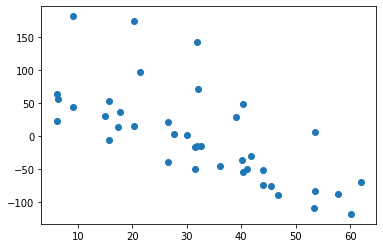

subject_14_stim_period_9_component_2   subject_14_stimulus_9_component_0   SpearmanrResult(correlation=0.7837597330367074, pvalue=3.016037963142437e-07)   10.94794671018176


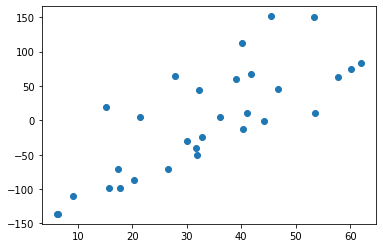

subject_14_stim_period_9_component_2   subject_14_stim_period_10_component_0   SpearmanrResult(correlation=0.8135706340378197, pvalue=4.609451116515685e-08)   11.013428081235524


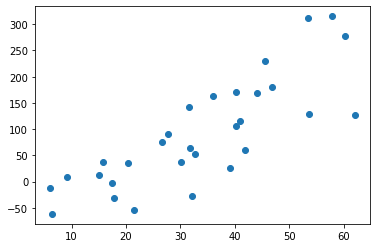

subject_14_stim_period_9_component_2   subject_14_stim_period_10_component_1   SpearmanrResult(correlation=-0.7526140155728587, pvalue=1.6079829668601585e-06)   2.5795001915288402


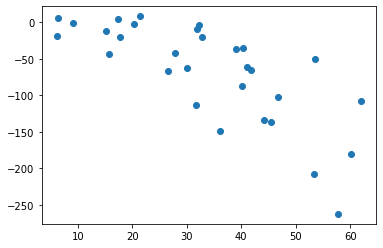

subject_14_stim_period_9_component_2   subject_14_stim_period_10_component_2   SpearmanrResult(correlation=0.7908787541713014, pvalue=1.979596351724319e-07)   11.302510412438846


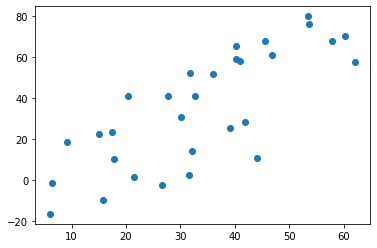

subject_14_stim_period_9_component_2   subject_14_stim_period_10_component_5   SpearmanrResult(correlation=0.803337041156841, pvalue=9.101995132888013e-08)   2.6395841376035873


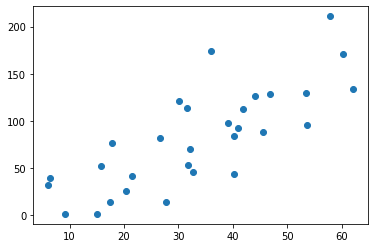

subject_14_stim_period_9_component_2   subject_14_stim_period_10_component_6   SpearmanrResult(correlation=0.8327030033370411, pvalue=1.1479465111069946e-08)   8.835896847350973


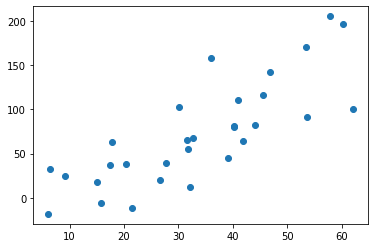

subject_14_stim_period_9_component_2   subject_14_stim_period_11_component_9   SpearmanrResult(correlation=-0.8647385984427142, pvalue=7.209803534076485e-10)   4.303481906341893


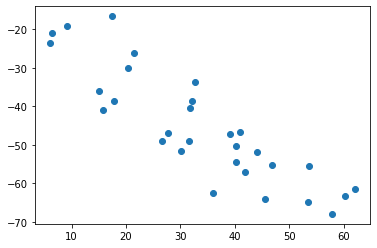

subject_14_stim_period_9_component_2   subject_14_stim_period_14_component_4   SpearmanrResult(correlation=0.8227124322075873, pvalue=7.369376725481882e-11)   11.162142318770222


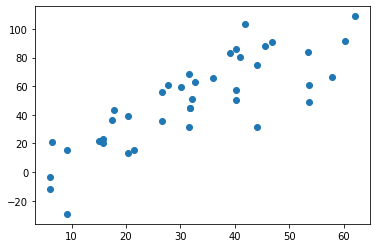

subject_14_stim_period_9_component_2   subject_14_stim_period_9_component_0   SpearmanrResult(correlation=0.8407119021134594, pvalue=6.086690684238773e-09)   11.013428081235524


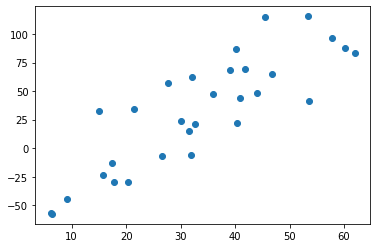

subject_14_stim_period_9_component_3   subject_12_stim_period_14_component_8   SpearmanrResult(correlation=-0.7757374601237516, pvalue=4.759199549475897e-07)   2.7094420949333413


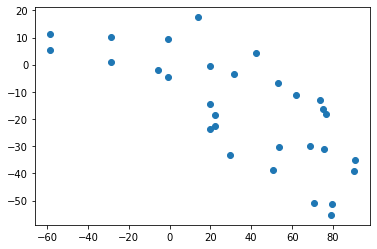

subject_14_stim_period_9_component_3   subject_14_stimulus_9_component_0   SpearmanrResult(correlation=-0.9265850945494994, pvalue=2.0571113896740805e-13)   3.553439744997648


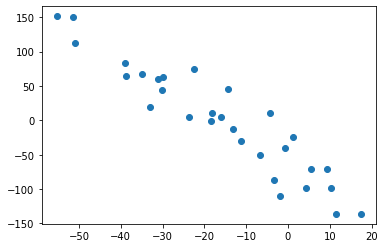

subject_14_stim_period_9_component_3   subject_14_stim_period_11_component_8   SpearmanrResult(correlation=-0.8358175750834261, pvalue=9.005531599829514e-09)   2.8056534433208076


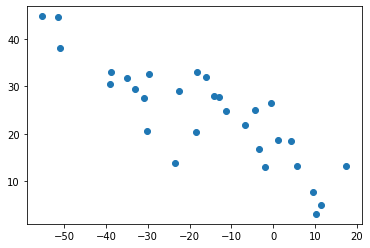

subject_14_stim_period_9_component_3   subject_14_stim_period_12_component_6   SpearmanrResult(correlation=-0.7846496106785317, pvalue=2.8638655502680977e-07)   3.38568691033486


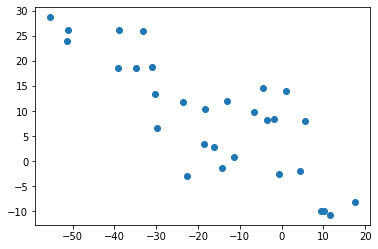

subject_14_stim_period_9_component_3   subject_14_stim_period_9_component_0   SpearmanrResult(correlation=-0.8860956618464961, pvalue=7.45725152858135e-11)   3.553439744997648


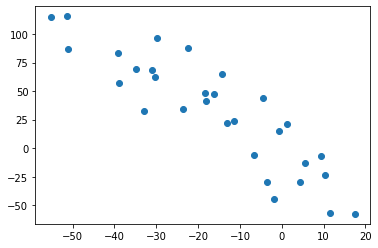

subject_14_stim_period_9_component_3   subject_14_stim_period_9_component_1   SpearmanrResult(correlation=0.8834260289210233, pvalue=1.0139781799831235e-10)   1.0386613412710406


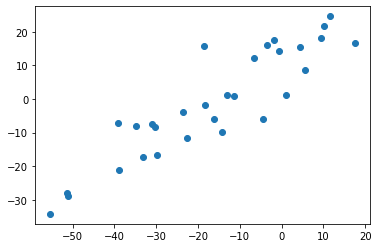

subject_14_stim_period_9_component_4   subject_14_stimulus_11_component_2   SpearmanrResult(correlation=0.7810901001112347, pvalue=3.517777024987029e-07)   4.1990947899628335


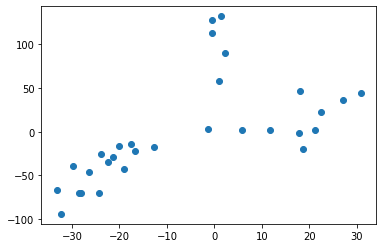

subject_14_stim_period_9_component_4   subject_14_stim_period_12_component_6   SpearmanrResult(correlation=0.8015572858731924, pvalue=1.0204233589958416e-07)   9.89823408379354


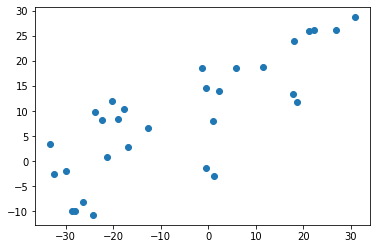

subject_14_stim_period_9_component_4   subject_14_stim_period_9_component_1   SpearmanrResult(correlation=-0.8447163515016683, pvalue=4.374279356031413e-09)   2.6638326406888755


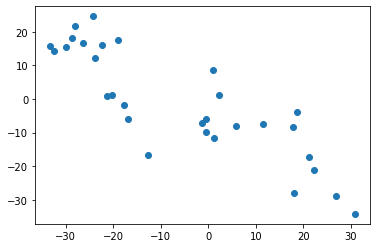

subject_14_stim_period_9_component_5   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.7543685085679754, pvalue=1.4729427313964538e-06)   1.9555526659999107


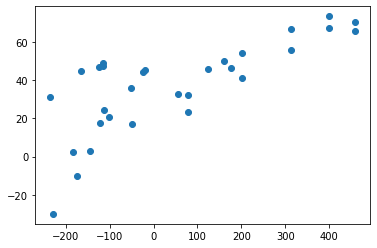

subject_14_stim_period_9_component_5   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.8385087553188444, pvalue=7.272051906554228e-09)   1.5628915340035474


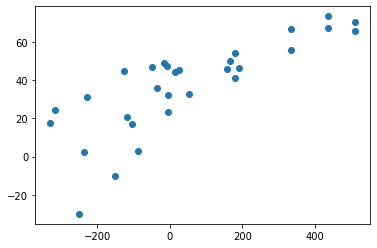

subject_14_stim_period_9_component_5   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.8238176011242481, pvalue=2.234851521901161e-08)   1.9658164003102587


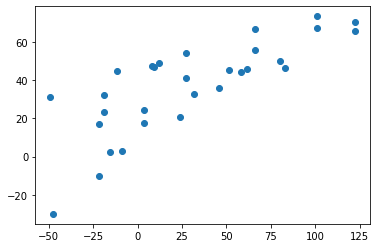

subject_14_stim_period_9_component_5   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.8839177773748688, pvalue=9.587198649927922e-11)   1.6859950165398179


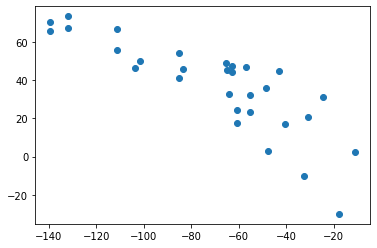

subject_14_stim_period_9_component_5   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.8140234983278507, pvalue=4.468489362222888e-08)   1.9589044716591997


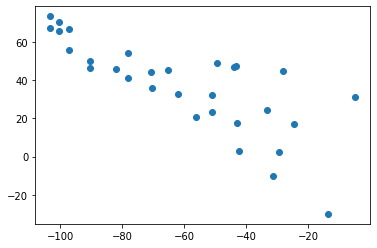

subject_14_stim_period_9_component_5   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.8429606202262976, pvalue=5.061749271547984e-09)   1.9658164003102587


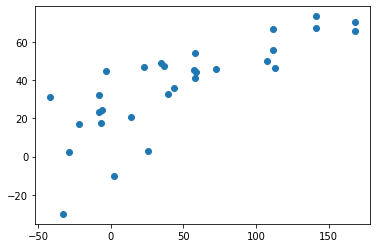

subject_14_stim_period_9_component_5   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.8287146525224469, pvalue=1.5553243526686928e-08)   1.960234564927099


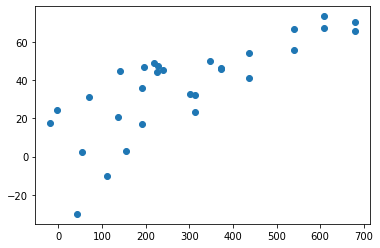

subject_14_stim_period_9_component_5   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=-0.8336117039206457, pvalue=1.0700138349270496e-08)   1.9087178747381697


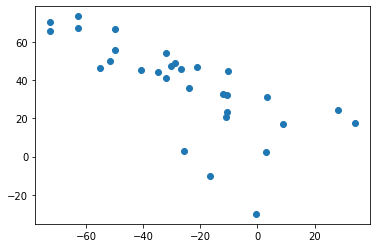

subject_14_stim_period_9_component_5   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.7988951198192241, pvalue=3.5814104700583257e-12)   2.0599544294309458


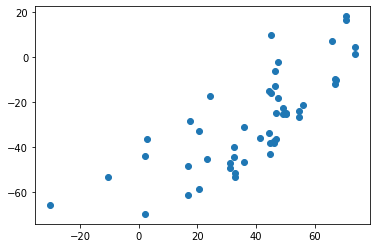

subject_14_stim_period_9_component_5   subject_14_stimulus_11_component_1   SpearmanrResult(correlation=-0.8549499443826475, pvalue=1.7999473889701663e-09)   2.5423067837246958


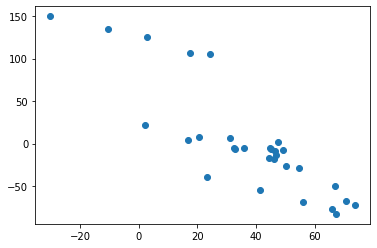

subject_14_stim_period_9_component_5   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.9163515016685205, pvalue=1.1988494312026782e-12)   2.60912449149612


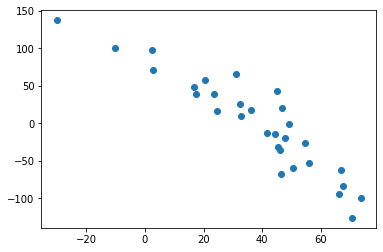

subject_14_stim_period_9_component_5   subject_14_stim_period_11_component_5   SpearmanrResult(correlation=0.8887652947719689, pvalue=5.442257163898149e-11)   2.819668413083713


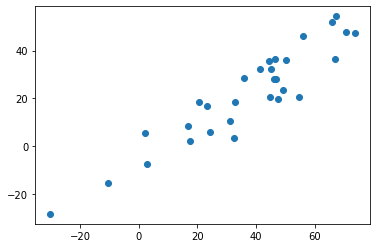

subject_14_stim_period_9_component_6   subject_12_stimulus_14_component_3   SpearmanrResult(correlation=-0.7661659505727269, pvalue=8.009943310556151e-07)   5.073334612272724


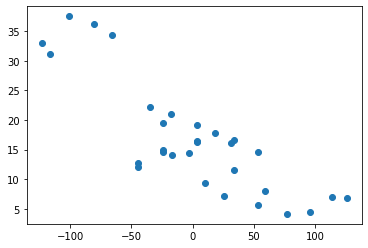

subject_14_stim_period_9_component_6   subject_14_stimulus_9_component_3   SpearmanrResult(correlation=-0.7601779755283649, pvalue=1.09590752663524e-06)   6.0836157061622345


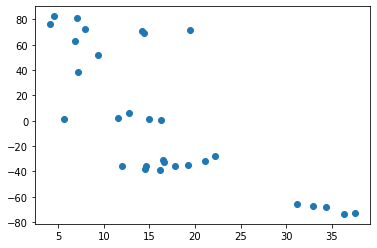

subject_14_stim_period_9_component_6   subject_14_stim_period_10_component_3   SpearmanrResult(correlation=-0.850055617352614, pvalue=2.7748862781578192e-09)   3.38568691033486


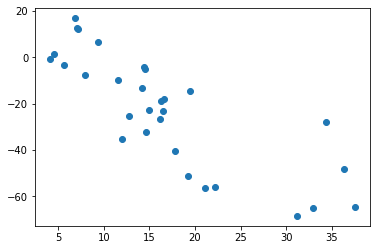

subject_14_stim_period_9_component_8   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=0.7530589543937708, pvalue=1.572714703088762e-06)   11.06991097625065


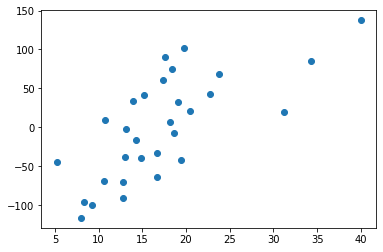

subject_14_stim_period_9_component_8   subject_14_stim_period_11_component_3   SpearmanrResult(correlation=-0.7704115684093437, pvalue=6.377712788708153e-07)   2.8056534433208076


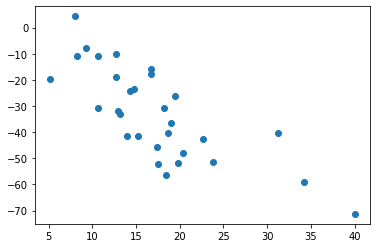

subject_14_stim_period_9_component_9   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=-0.8227240920623136, pvalue=2.315491521208878e-13)   2.9019780698064155


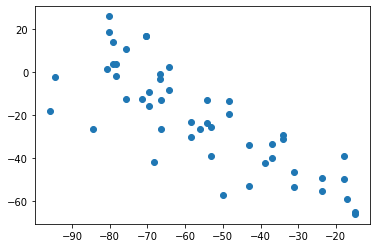

subject_14_stim_period_9_component_9   subject_13_stim_period_9_component_3   SpearmanrResult(correlation=-0.7967812593783048, pvalue=4.486094174715894e-12)   3.9985065198174334


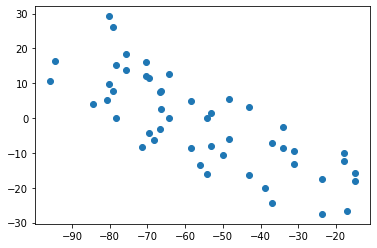

subject_14_stim_period_9_component_9   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=-0.8304783092324804, pvalue=1.3611728930321104e-08)   4.537569477332493


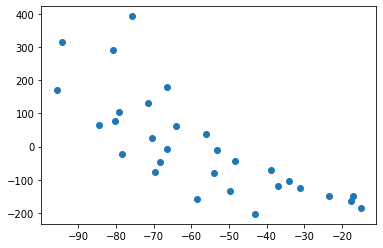

subject_14_stim_period_9_component_9   subject_14_stimulus_11_component_0   SpearmanrResult(correlation=-0.7579532814238041, pvalue=1.2284749348924812e-06)   4.569298372219283


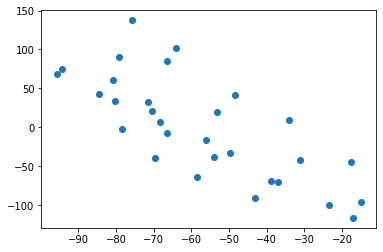

subject_14_stim_period_9_component_9   subject_14_stimulus_9_component_0   SpearmanrResult(correlation=-0.9016685205784205, pvalue=1.0513524697040207e-11)   4.576705779626691


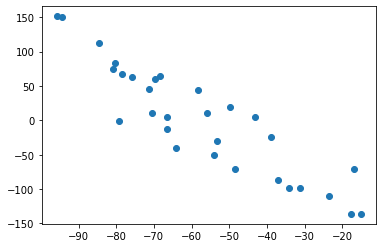

subject_14_stim_period_9_component_9   subject_14_stim_period_10_component_0   SpearmanrResult(correlation=-0.8295884315906562, pvalue=1.4561742417216858e-08)   4.569013471934383


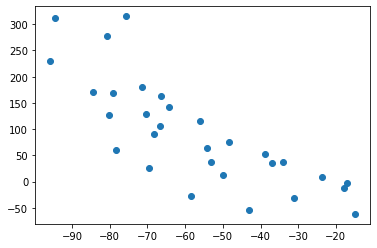

subject_14_stim_period_9_component_9   subject_14_stim_period_10_component_1   SpearmanrResult(correlation=0.7908787541713014, pvalue=1.979596351724319e-07)   1.9978948221128139


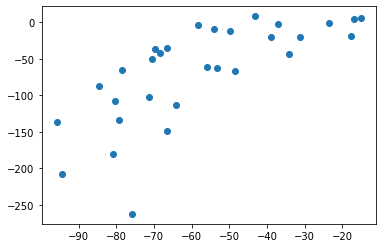

subject_14_stim_period_9_component_9   subject_14_stim_period_11_component_0   SpearmanrResult(correlation=-0.7833147942157953, pvalue=3.094851505771751e-07)   4.569013471934383


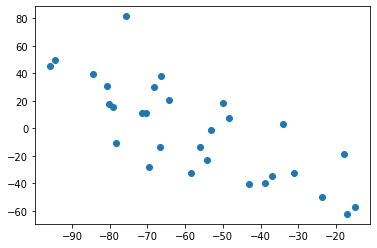

subject_14_stim_period_9_component_9   subject_14_stim_period_11_component_8   SpearmanrResult(correlation=-0.8513904338153503, pvalue=2.469677643745385e-09)   4.541580663778683


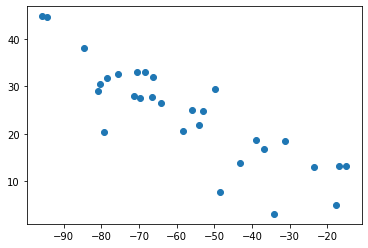

subject_14_stim_period_9_component_9   subject_14_stim_period_11_component_9   SpearmanrResult(correlation=0.8958843159065628, pvalue=2.25594808000537e-11)   4.576705779626691


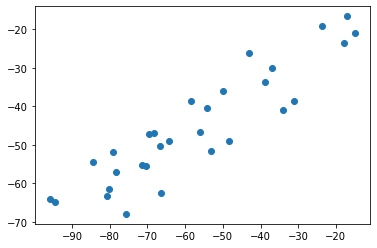

subject_14_stim_period_9_component_9   subject_14_stim_period_14_component_4   SpearmanrResult(correlation=-0.8108869968370468, pvalue=2.2510369074878398e-10)   4.576705779626691


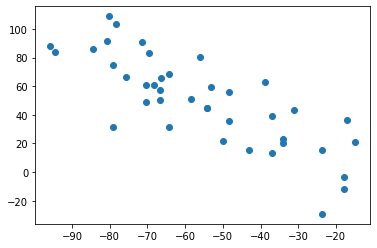

subject_14_stim_period_9_component_9   subject_14_stim_period_15_component_3   SpearmanrResult(correlation=0.7721258475669427, pvalue=5.395422899563196e-09)   1.8055860301499456


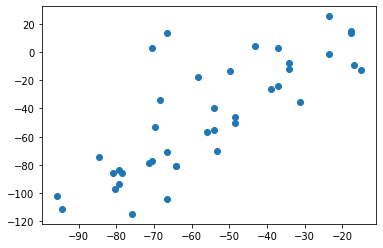

subject_14_stim_period_9_component_9   subject_14_stim_period_9_component_0   SpearmanrResult(correlation=-0.9261401557285873, pvalue=2.2324629676411924e-13)   4.569013471934383


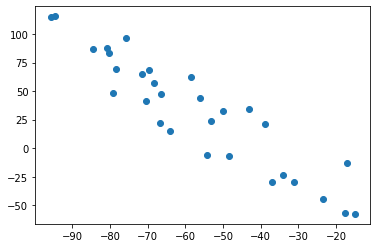

subject_14_stim_period_9_component_9   subject_14_stim_period_9_component_1   SpearmanrResult(correlation=0.7517241379310345, pvalue=1.6806785652410066e-06)   1.9978948221128139


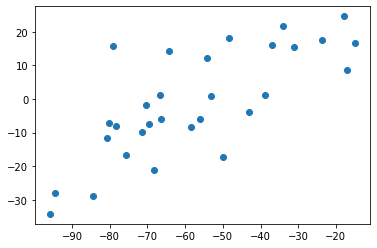

subject_14_stim_period_9_component_9   subject_14_stim_period_9_component_2   SpearmanrResult(correlation=-0.8896551724137931, pvalue=4.8911052440599985e-11)   4.303481906341893


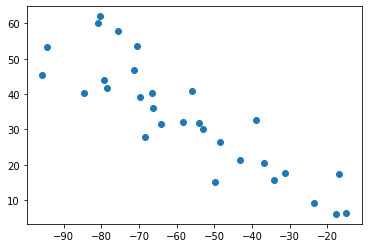

subject_14_stim_period_9_component_9   subject_14_stim_period_9_component_3   SpearmanrResult(correlation=0.8300333704115684, pvalue=1.4079404405444866e-08)   1.8055860301499456


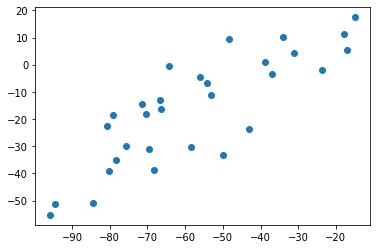

subject_15_stimulus_0_component_0   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.7955848114698072, pvalue=2.2706787749672823e-73)   10.162099871177775


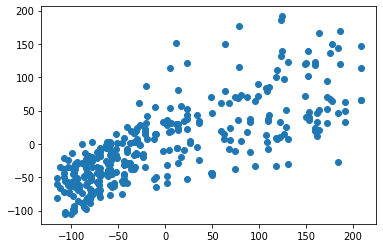

subject_15_stimulus_0_component_0   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.7840252450722756, pvalue=6.612636133665701e-70)   9.630319453780874


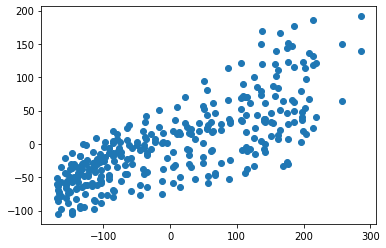

subject_15_stimulus_0_component_0   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.7864505601124371, pvalue=1.2925893415046747e-70)   10.977204680684537


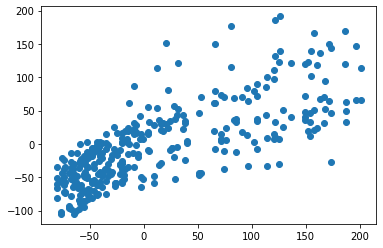

subject_15_stimulus_0_component_0   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.7913365865020342, pvalue=4.516306872726136e-72)   3.7382314619963006


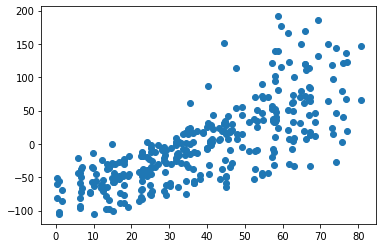

subject_15_stimulus_0_component_0   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.785191653641088, pvalue=3.0240265358310526e-70)   10.977204680684537


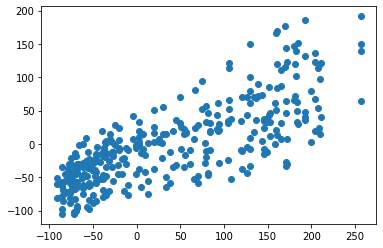

subject_15_stimulus_0_component_0   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.7876333311261026, pvalue=5.785931864334867e-71)   3.46208484009959


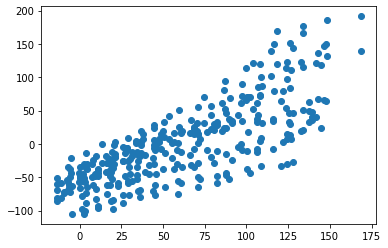

subject_15_stimulus_0_component_0   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=0.7541988455972336, pvalue=7.077558758568706e-62)   1.8385207449272798


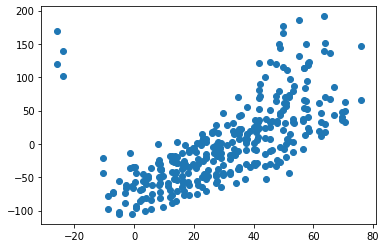

subject_15_stimulus_10_component_0   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.7968475401003031, pvalue=5.351190656244779e-54)   10.20218501890144


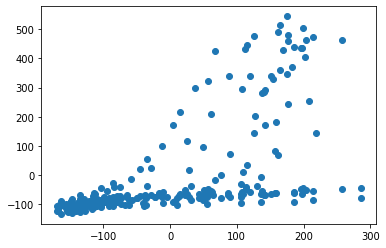

subject_15_stimulus_10_component_0   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.7771870925540004, pvalue=8.80313697916666e-50)   9.019471054656417


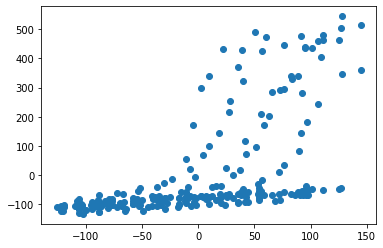

subject_15_stimulus_10_component_0   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.7973953033642434, pvalue=4.021347666081045e-54)   11.978117021855912


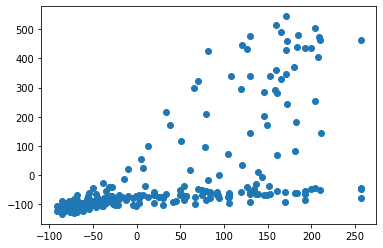

subject_15_stimulus_10_component_0   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.7821256428052772, pvalue=8.45212346889118e-51)   3.46208484009959


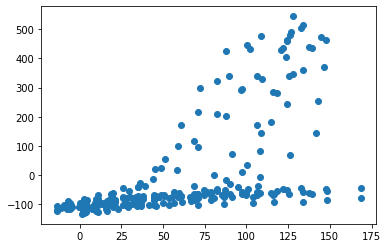

subject_15_stimulus_10_component_0   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=0.7575978281893825, pvalue=5.466246585011287e-46)   4.030982100719548


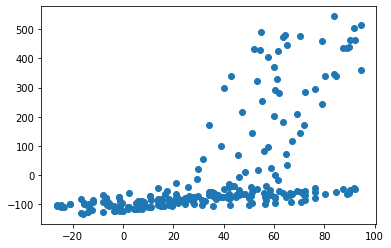

subject_15_stimulus_11_component_0   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8073075614138485, pvalue=1.953919215592395e-56)   2.5585611814479705


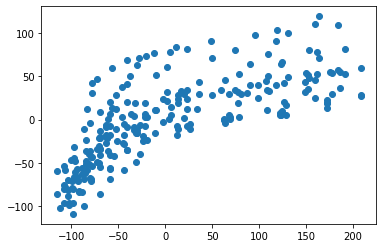

subject_15_stimulus_11_component_0   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8815672454875384, pvalue=1.5080646777641134e-79)   2.4901122005539675


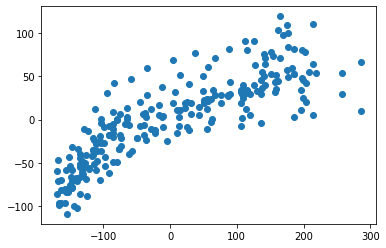

subject_15_stimulus_11_component_0   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.7945553548412952, pvalue=1.7521500508269113e-53)   2.271026718226365


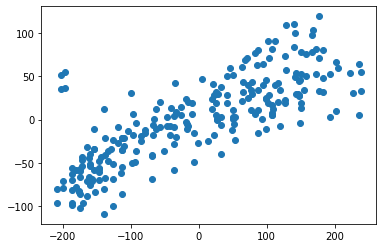

subject_15_stimulus_11_component_0   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.8591619050084639, pvalue=3.3490832891180375e-71)   2.600360600341551


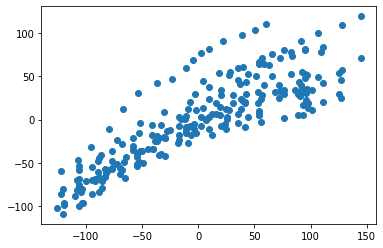

subject_15_stimulus_11_component_0   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.7929580736912953, pvalue=3.96887028867418e-53)   2.752504494731096


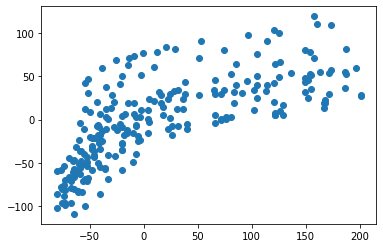

subject_15_stimulus_11_component_0   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=0.7907939313505619, pvalue=1.1880146129906403e-52)   2.1970067068477723


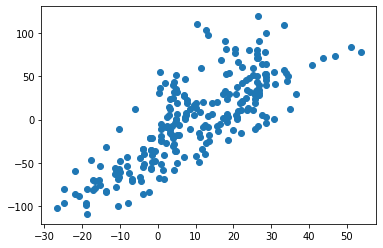

subject_15_stimulus_11_component_0   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8108658524105058, pvalue=2.675467310025117e-57)   2.0726030480494977


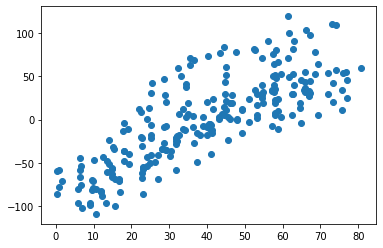

subject_15_stimulus_11_component_0   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.8777554729170767, pvalue=5.159780733020395e-78)   2.752504494731096


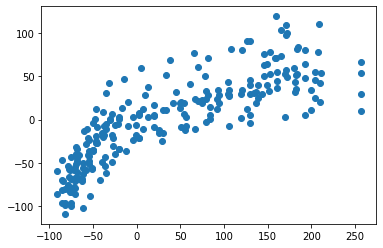

subject_15_stimulus_11_component_0   subject_12_stim_period_11_component_1   SpearmanrResult(correlation=0.7913868351687412, pvalue=8.809131431399372e-53)   2.4253721287208796


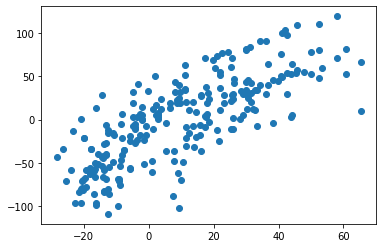

subject_15_stimulus_11_component_0   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.8810055928222937, pvalue=2.5572676677059527e-79)   2.048813860024625


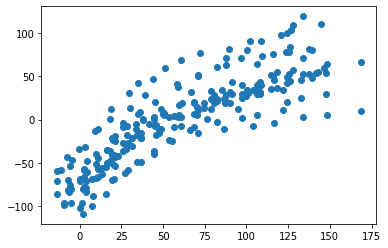

subject_15_stimulus_11_component_0   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=0.8382496751696069, pvalue=1.2757602042708196e-64)   2.1970067068477723


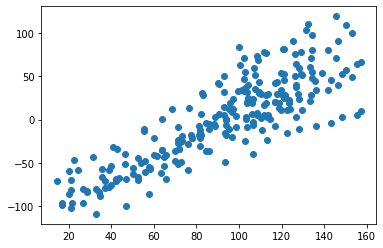

subject_15_stimulus_11_component_0   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=0.7922419014365399, pvalue=5.713031064941098e-53)   2.0726030480494977


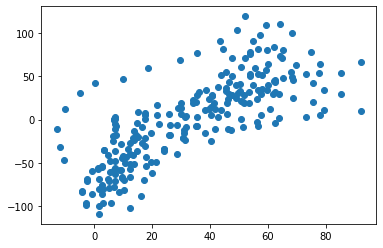

subject_15_stimulus_11_component_0   subject_12_stim_period_11_component_9   SpearmanrResult(correlation=-0.7743922845852913, pvalue=3.22895211171108e-49)   2.7925097680955027


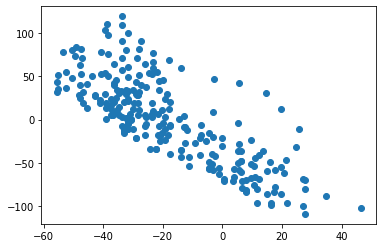

subject_15_stimulus_11_component_0   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=0.7870012567068937, pvalue=7.867574441795787e-52)   2.752504494731096


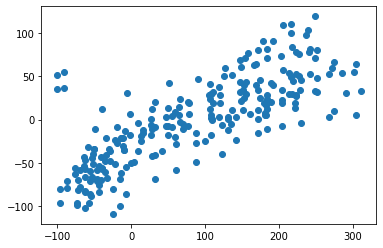

subject_15_stimulus_11_component_0   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=0.8038794835544195, pvalue=1.2763049719606402e-55)   2.0726030480494977


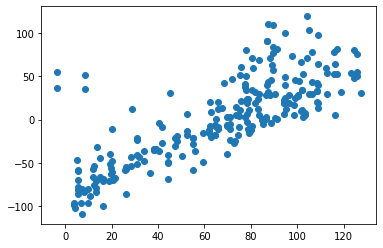

subject_15_stimulus_11_component_0   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=0.7760737702306989, pvalue=1.4806614207446429e-49)   1.4115017770189557


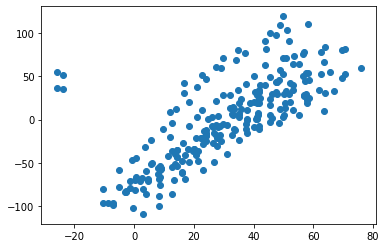

subject_15_stimulus_11_component_0   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=0.7846678372877633, pvalue=2.469885877399084e-51)   2.752504494731096


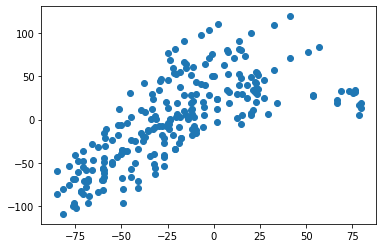

subject_15_stimulus_11_component_0   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=0.7626687617968413, pvalue=6.181807112058624e-47)   2.048813860024625


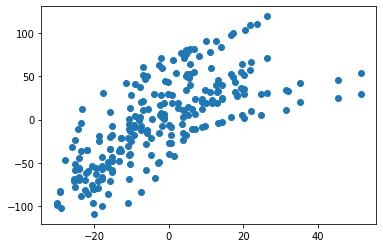

subject_15_stimulus_11_component_0   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=0.8065688188819736, pvalue=2.9371460402906218e-56)   2.1970067068477723


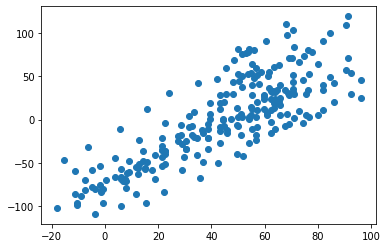

subject_15_stimulus_11_component_0   subject_12_stim_period_9_component_4   SpearmanrResult(correlation=-0.7610011655527381, pvalue=1.2735043409662634e-46)   0.8916663807893626


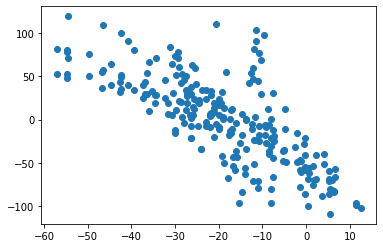

subject_15_stimulus_11_component_0   subject_12_stim_period_9_component_5   SpearmanrResult(correlation=0.7815991476870843, pvalue=1.0882305341949448e-50)   2.0726030480494977


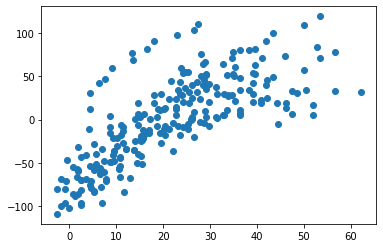

subject_15_stimulus_11_component_0   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=0.8270600262437927, pvalue=1.7904523716025714e-61)   1.8932456992191302


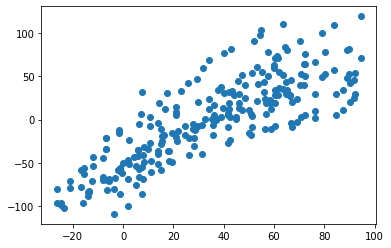

subject_15_stimulus_11_component_0   subject_15_stimulus_10_component_0   SpearmanrResult(correlation=0.8942186496293336, pvalue=4.7881303947017847e-85)   3.318979818855567


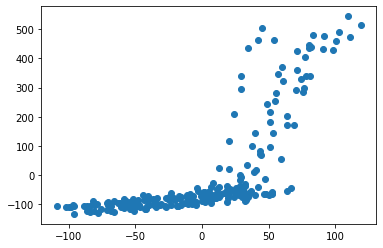

subject_15_stimulus_11_component_3   subject_15_stimulus_10_component_2   SpearmanrResult(correlation=-0.8576746124064653, pvalue=1.0646708063529561e-70)   3.8702765444616176


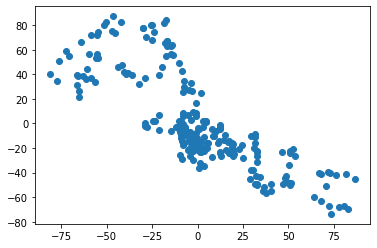

subject_15_stimulus_12_component_0   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=-0.8964879348387328, pvalue=4.1705744367219374e-86)   2.738838684028277


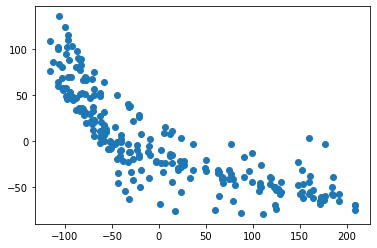

subject_15_stimulus_12_component_0   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=-0.8170475040785217, pvalue=7.6366229043686235e-59)   2.6614416053783136


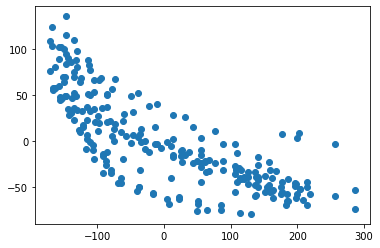

subject_15_stimulus_12_component_0   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=-0.8337720794241181, pvalue=2.473023141980483e-63)   2.377249179229776


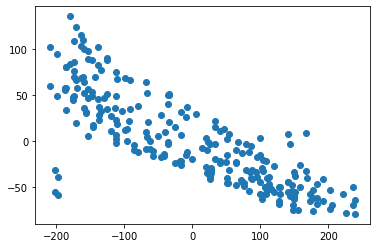

subject_15_stimulus_12_component_0   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=-0.851336095461046, pvalue=1.2753091797938674e-68)   2.798710392078484


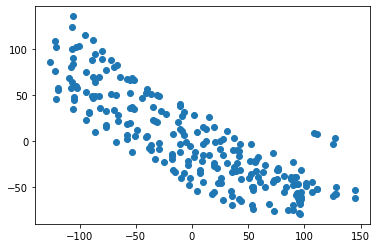

subject_15_stimulus_12_component_0   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=-0.8913627457574289, pvalue=9.557710870140288e-84)   3.047115243832591


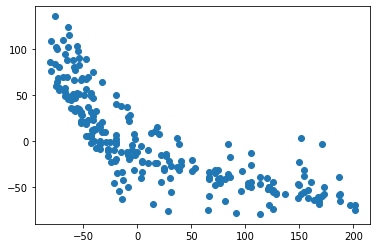

subject_15_stimulus_12_component_0   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.8980105604567218, pvalue=7.853918366133051e-87)   2.165388176506317


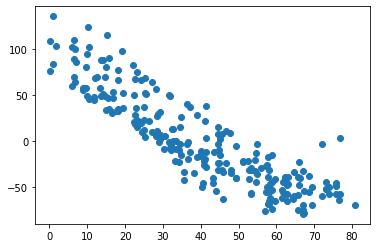

subject_15_stimulus_12_component_0   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=-0.8125004613265112, pvalue=1.0581964806876363e-57)   3.047115243832591


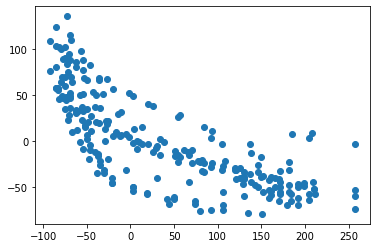

subject_15_stimulus_12_component_0   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=-0.8369041394182484, pvalue=3.138711451083287e-64)   2.225849349291191


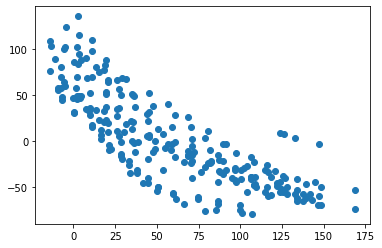

subject_15_stimulus_12_component_0   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=-0.7962837172161049, pvalue=7.174139774249763e-54)   2.4432955590489334


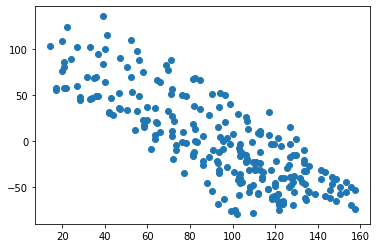

subject_15_stimulus_12_component_0   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=-0.8301452095085208, pvalue=2.5601617583573192e-62)   3.047115243832591


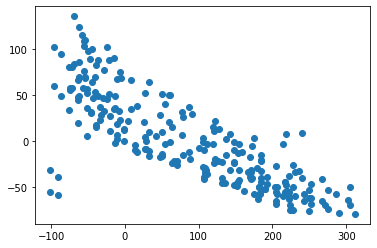

subject_15_stimulus_12_component_0   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=-0.8271850308555317, pvalue=1.65601438050808e-61)   2.165388176506317


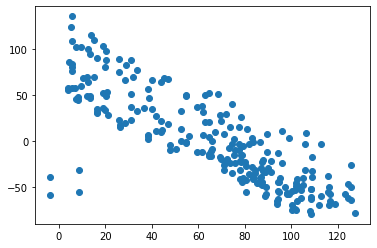

subject_15_stimulus_12_component_0   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=-0.8148321445704784, pvalue=2.7737108796411266e-58)   1.4553378108486146


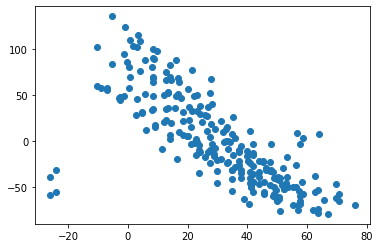

subject_15_stimulus_12_component_0   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=-0.7895760044736869, pvalue=2.1893692536644158e-52)   3.047115243832591


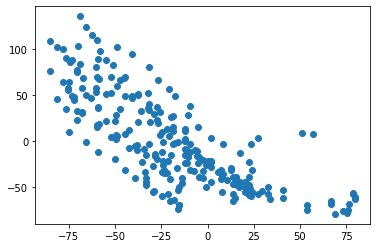

subject_15_stimulus_12_component_0   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=-0.8083926708907506, pvalue=1.070277832823142e-56)   2.225849349291191


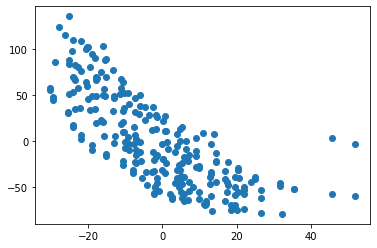

subject_15_stimulus_12_component_0   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=-0.8280782929769175, pvalue=9.463107120217004e-62)   2.4432955590489334


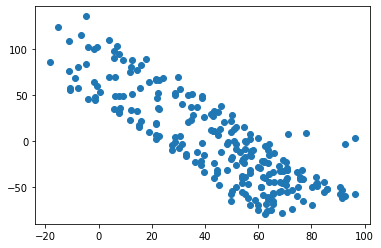

subject_15_stimulus_12_component_0   subject_12_stim_period_9_component_5   SpearmanrResult(correlation=-0.836307763249743, pvalue=4.665603499211706e-64)   2.165388176506317


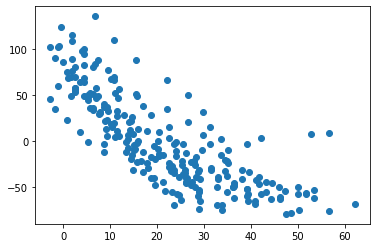

subject_15_stimulus_14_component_0   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8773575155980476, pvalue=6.39483427689511e-17)   3.3869378641585373


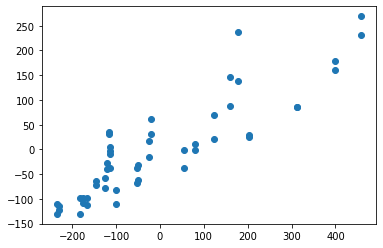

subject_15_stimulus_14_component_0   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.8360361868239884, pvalue=4.171261761025741e-14)   2.358860931517821


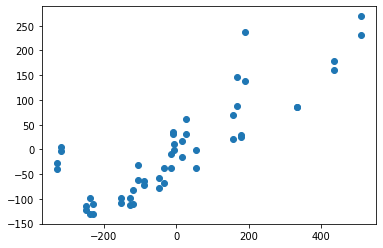

subject_15_stimulus_14_component_0   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.8049010460733019, pvalue=1.8608482543859894e-12)   4.351429047092977


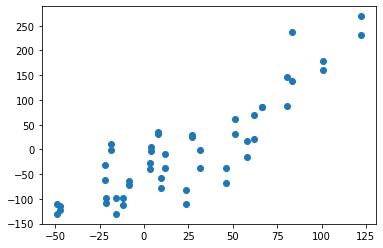

subject_15_stimulus_14_component_0   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.8756277855563427, pvalue=8.770277999476378e-17)   2.946399868949525


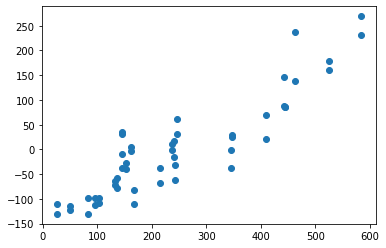

subject_15_stimulus_14_component_0   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.8921563170659664, pvalue=3.471025865265495e-18)   3.0970581025434174


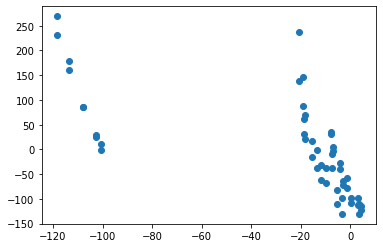

subject_15_stimulus_14_component_0   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.9223304966823724, pvalue=1.864426154001224e-21)   1.718363672616234


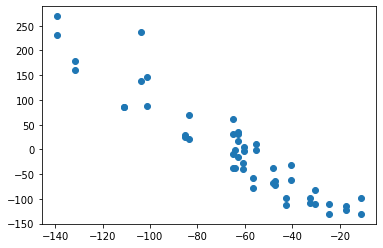

subject_15_stimulus_14_component_0   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.8308469966988741, pvalue=8.280992033682619e-14)   4.351429047092977


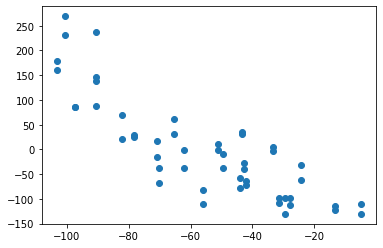

subject_15_stimulus_14_component_0   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.8241202687589109, pvalue=1.9476685378845993e-13)   4.351429047092977


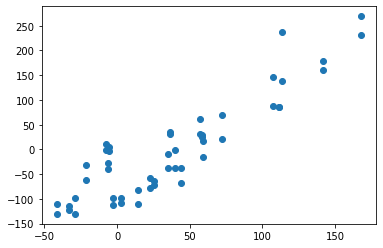

subject_15_stimulus_14_component_0   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.8291172666571691, pvalue=1.0354478683433069e-13)   2.946399868949525


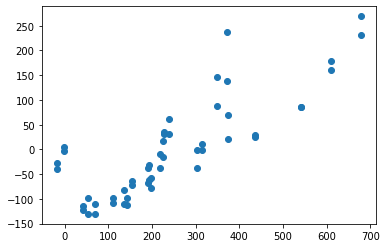

subject_15_stimulus_14_component_0   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=-0.7645406784335231, pvalue=1.0347169545196039e-10)   2.952855290179956


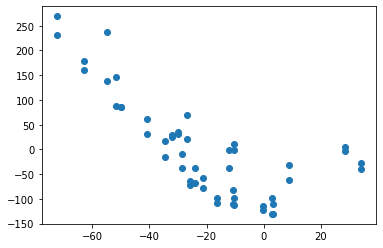

subject_15_stimulus_14_component_0   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.7819927971188475, pvalue=2.0208683079567404e-11)   2.025795598463909


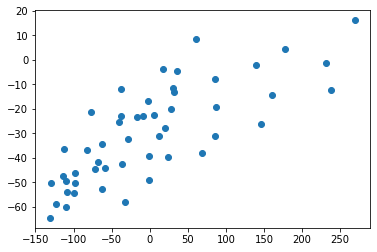

subject_15_stimulus_14_component_0   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.767875150060024, pvalue=7.657171351250162e-11)   2.025795598463909


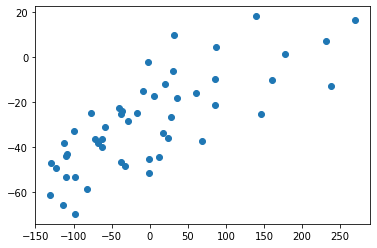

subject_15_stimulus_14_component_0   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.8622148484813047, pvalue=8.751147785494787e-16)   3.738325465167673


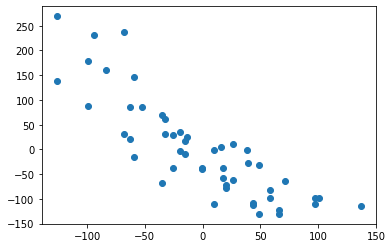

subject_15_stimulus_14_component_1   subject_12_stimulus_14_component_1   SpearmanrResult(correlation=0.8935016626539591, pvalue=2.608546600815542e-18)   2.482808178363978


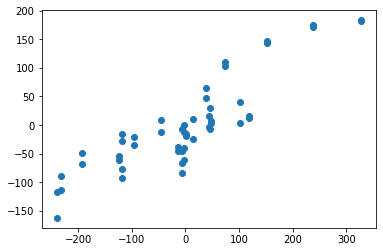

subject_15_stimulus_14_component_1   subject_12_stimulus_15_component_1   SpearmanrResult(correlation=0.7991352792676192, pvalue=3.4903428789345455e-12)   3.672531156146743


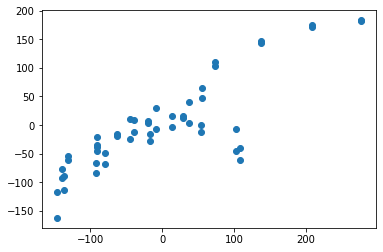

subject_15_stimulus_14_component_1   subject_12_stim_period_14_component_2   SpearmanrResult(correlation=0.919255421052675, pvalue=4.570354289983136e-21)   3.1172041665334898


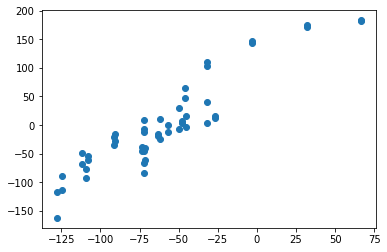

subject_15_stimulus_14_component_1   subject_12_stim_period_14_component_4   SpearmanrResult(correlation=-0.8054776227538702, pvalue=1.7454138528230452e-12)   1.2100966953905754


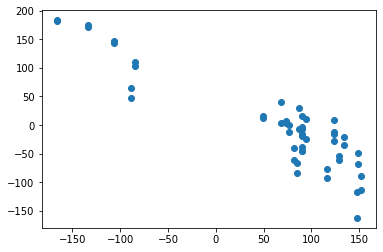

subject_15_stimulus_14_component_1   subject_12_stim_period_14_component_8   SpearmanrResult(correlation=-0.8204686164486451, pvalue=3.0523755102113485e-13)   3.28740657593535


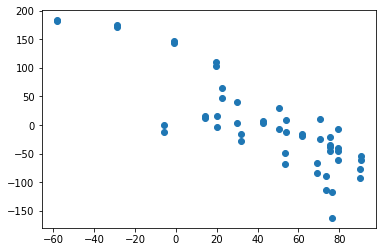

subject_15_stimulus_14_component_1   subject_12_stim_period_15_component_8   SpearmanrResult(correlation=-0.8100902361984164, pvalue=1.0375845489178136e-12)   3.28740657593535


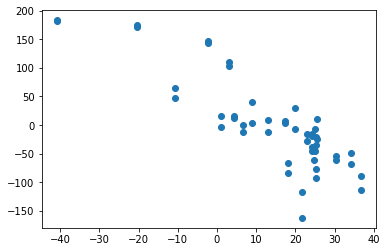

subject_15_stimulus_14_component_3   subject_10_stimulus_15_component_2   SpearmanrResult(correlation=0.7566762946347999, pvalue=2.0649407481023981e-10)   4.68926396875505


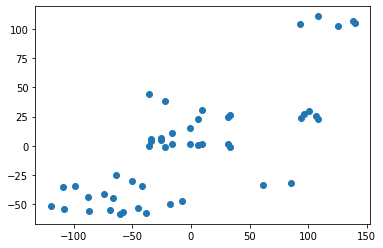

subject_15_stimulus_14_component_8   subject_12_stimulus_14_component_4   SpearmanrResult(correlation=0.8537178716947487, pvalue=3.328165652971132e-15)   4.715270337428981


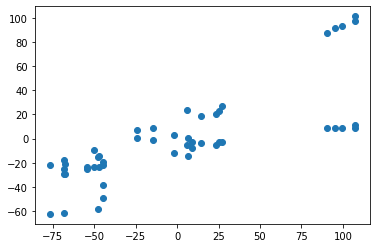

subject_15_stimulus_14_component_9   subject_13_stimulus_11_component_4   SpearmanrResult(correlation=0.776422569027611, pvalue=3.457710756190443e-11)   2.4104019156360437


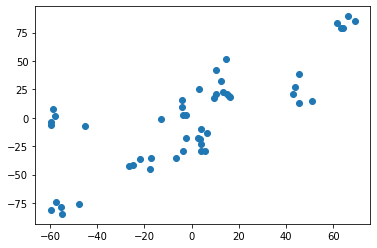

subject_15_stimulus_14_component_9   subject_14_stimulus_14_component_6   SpearmanrResult(correlation=-0.8142651531638797, pvalue=6.400875044327658e-13)   3.2219258419199535


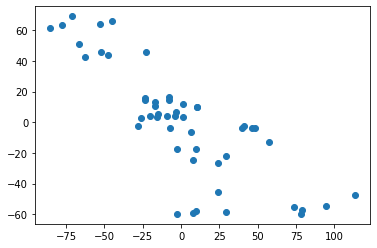

subject_15_stimulus_15_component_0   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8650572130792578, pvalue=5.487077504371342e-16)   3.163664795148173


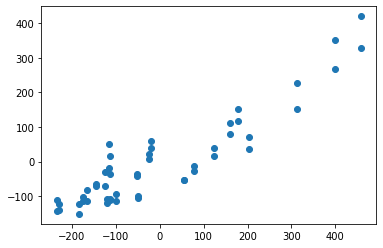

subject_15_stimulus_15_component_0   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.9413575271411253, pvalue=2.727853911184867e-24)   1.9543250834538752


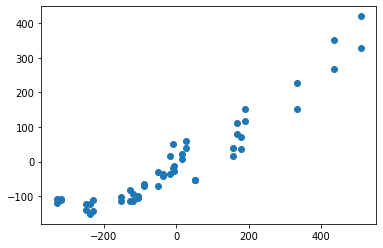

subject_15_stimulus_15_component_0   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.8496818349307708, pvalue=6.097047002968099e-15)   3.6640908654934607


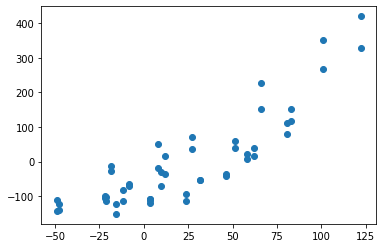

subject_15_stimulus_15_component_0   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.8393034546805419, pvalue=2.675486113319742e-14)   2.875009258926524


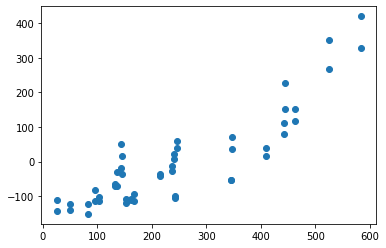

subject_15_stimulus_15_component_0   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.8717839410192211, pvalue=1.7406102346032779e-16)   2.919547178561434


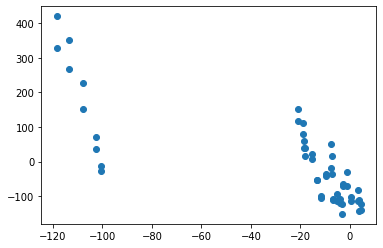

subject_15_stimulus_15_component_0   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.9071473107607414, pvalue=1.1371531750655654e-19)   1.6957351104788239


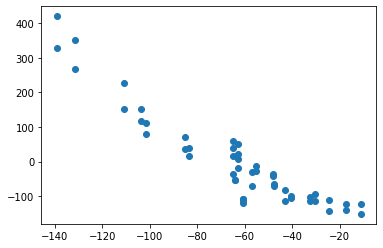

subject_15_stimulus_15_component_0   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.8936938548808152, pvalue=2.503460125112525e-18)   3.786271774981352


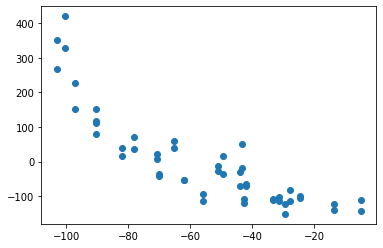

subject_15_stimulus_15_component_0   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.9075316952144535, pvalue=1.0339656741876317e-19)   3.6640908654934607


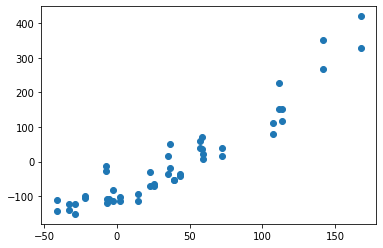

subject_15_stimulus_15_component_0   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.9248289956315017, pvalue=8.753034515841311e-22)   2.875009258926524


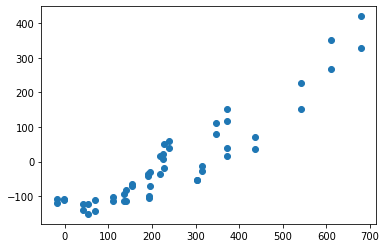

subject_15_stimulus_15_component_0   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=-0.9090692330293023, pvalue=7.03776698783894e-20)   2.4727657452697613


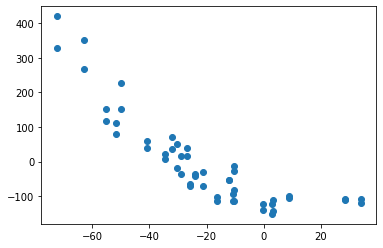

subject_15_stimulus_15_component_0   subject_12_stim_period_15_component_6   SpearmanrResult(correlation=-0.8456457981667928, pvalue=1.097680554829043e-14)   1.3891611250598221


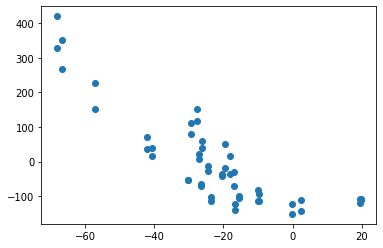

subject_15_stimulus_15_component_0   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=0.7599280649889771, pvalue=1.5567182614774032e-10)   1.6957351104788239


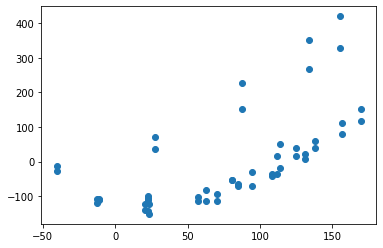

subject_15_stimulus_15_component_0   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.769315726290516, pvalue=6.712874525688718e-11)   1.9125245912299407


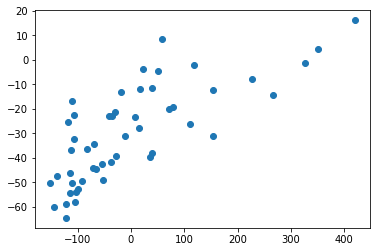

subject_15_stimulus_15_component_0   subject_14_stimulus_11_component_1   SpearmanrResult(correlation=-0.8376652419969927, pvalue=3.346852647116392e-14)   3.477313614675601


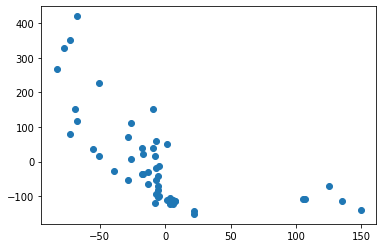

subject_15_stimulus_15_component_0   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.8721596010101745, pvalue=1.6294172140842748e-16)   3.1734476034252035


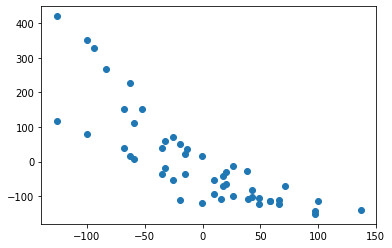

subject_15_stimulus_15_component_0   subject_14_stim_period_11_component_5   SpearmanrResult(correlation=0.8225799652140691, pvalue=2.3570097090220884e-13)   1.1781988798438616


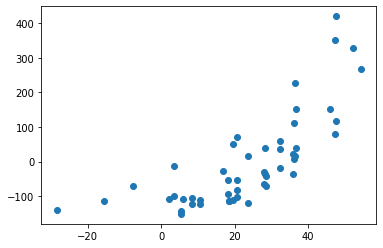

subject_15_stimulus_15_component_0   subject_14_stim_period_9_component_5   SpearmanrResult(correlation=0.7930820036066962, pvalue=6.611726783220437e-12)   1.1781988798438616


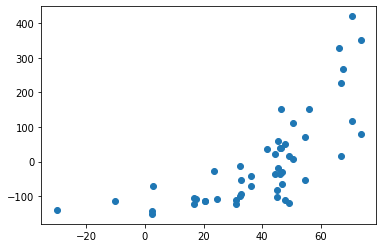

subject_15_stimulus_15_component_0   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.8909963985594237, pvalue=4.4270142901204965e-18)   2.6315402854638346


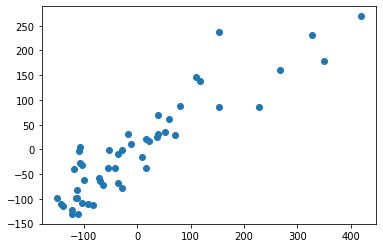

subject_15_stimulus_15_component_1   subject_12_stimulus_14_component_1   SpearmanrResult(correlation=0.7541622981832944, pvalue=2.5613477921304897e-10)   2.036154213169757


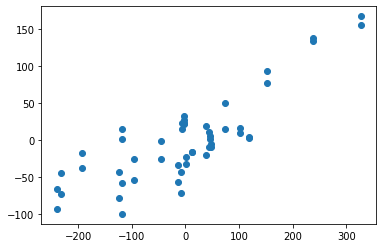

subject_15_stimulus_15_component_1   subject_12_stimulus_15_component_1   SpearmanrResult(correlation=0.9515437151644981, pvalue=3.142011472191545e-26)   2.702081821018731


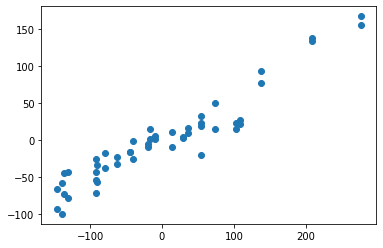

subject_15_stimulus_15_component_1   subject_12_stim_period_14_component_2   SpearmanrResult(correlation=0.7914475901933756, pvalue=7.828136926248571e-12)   2.442961453620539


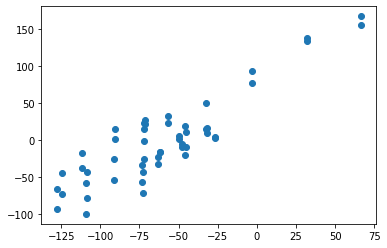

subject_15_stimulus_15_component_1   subject_15_stimulus_14_component_1   SpearmanrResult(correlation=0.7535654261704682, pvalue=2.694748527623485e-10)   2.903940883918663


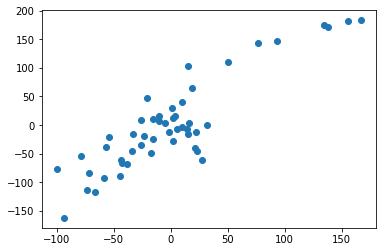

subject_15_stimulus_15_component_2   subject_12_stimulus_15_component_3   SpearmanrResult(correlation=0.7507028380998848, pvalue=3.4309140735064465e-10)   3.7731583893857126


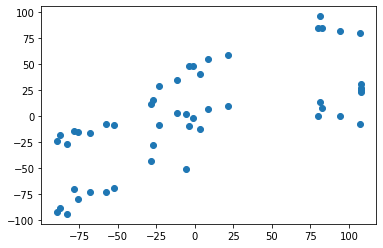

subject_15_stimulus_15_component_3   subject_14_stimulus_14_component_3   SpearmanrResult(correlation=0.8021133756760923, pvalue=2.528680741328695e-12)   3.9743390676365036


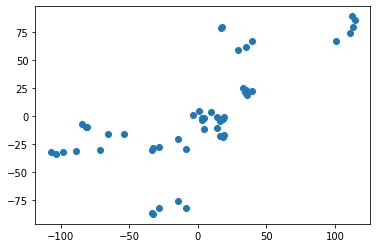

subject_15_stimulus_15_component_8   subject_13_stimulus_10_component_3   SpearmanrResult(correlation=0.7571188475390156, pvalue=1.9875643935770473e-10)   3.183663563332313


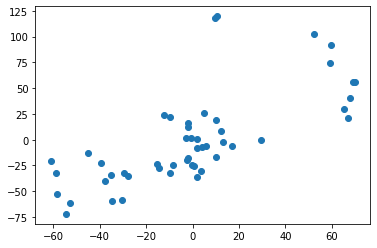

subject_15_stimulus_4_component_6   subject_12_stimulus_4_component_4   SpearmanrResult(correlation=0.7949375082112432, pvalue=1.3554293606240407e-140)   3.890353694699347


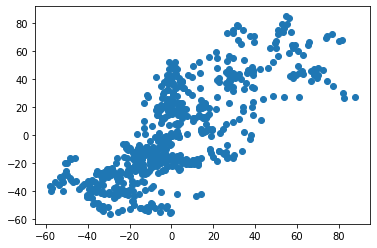

subject_15_stimulus_9_component_0   subject_15_stimulus_11_component_1   SpearmanrResult(correlation=0.8801645861907322, pvalue=5.611145276936752e-79)   6.142492116140053


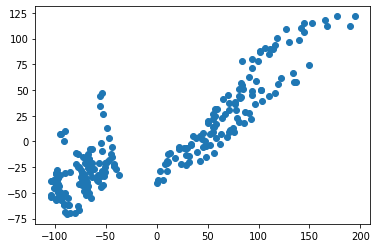

subject_15_stimulus_9_component_1   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=-0.7912205963968797, pvalue=9.580626942788565e-53)   6.087702754905537


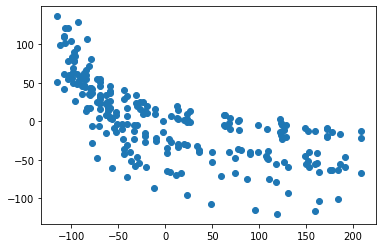

subject_15_stimulus_9_component_1   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=-0.8467530270744026, pvalue=3.540082956464706e-67)   6.113126164922542


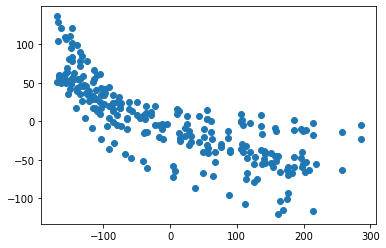

subject_15_stimulus_9_component_1   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=-0.7988892820920421, pvalue=1.836569629358828e-54)   5.657680248391557


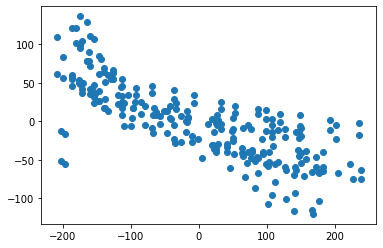

subject_15_stimulus_9_component_1   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=-0.835993949589023, pvalue=5.7440580435018735e-64)   6.252041908229495


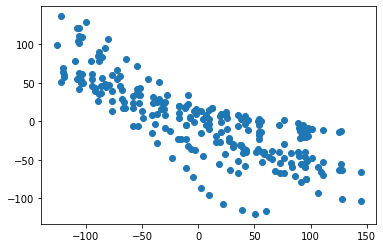

subject_15_stimulus_9_component_1   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=-0.7786715223184024, pvalue=4.380329400379698e-50)   6.559415191651527


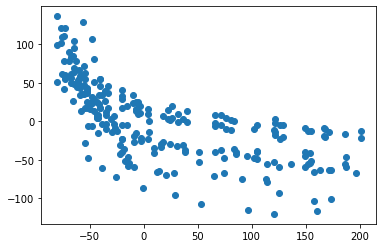

subject_15_stimulus_9_component_1   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=-0.7835267361618531, pvalue=4.299259550628728e-51)   3.9733121653273704


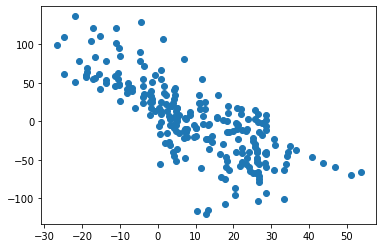

subject_15_stimulus_9_component_1   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.8081448318862262, pvalue=1.2284275409320774e-56)   3.5558295193032152


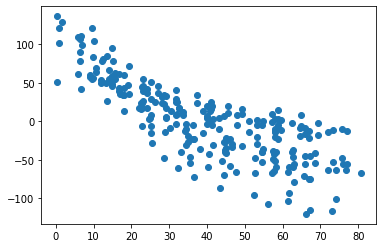

subject_15_stimulus_9_component_1   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=-0.8460585570091852, pvalue=5.80231842684544e-67)   6.559415191651527


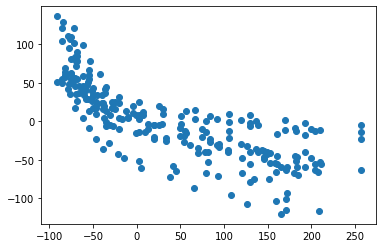

subject_15_stimulus_9_component_1   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=-0.8472860328494568, pvalue=2.4187607204905283e-67)   3.414383321930546


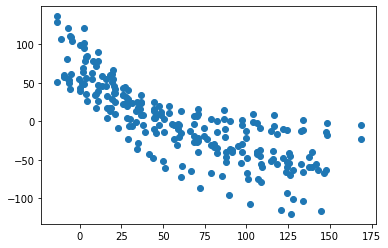

subject_15_stimulus_9_component_1   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=-0.7879939148563637, pvalue=4.8148625758837556e-52)   3.9733121653273704


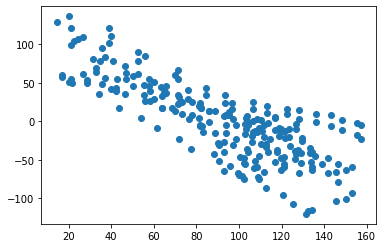

subject_15_stimulus_9_component_1   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=-0.7531428027210132, pvalue=3.5502216676493205e-45)   3.5558295193032152


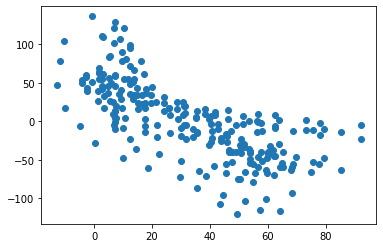

subject_15_stimulus_9_component_1   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=-0.7921095180803579, pvalue=6.110001448844673e-53)   6.559415191651527


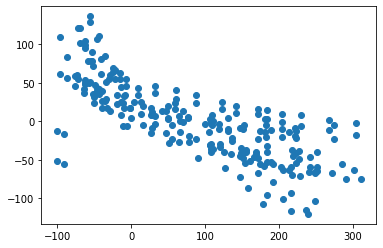

subject_15_stimulus_9_component_1   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=-0.8167805671472038, pvalue=8.928920077544944e-59)   3.5558295193032152


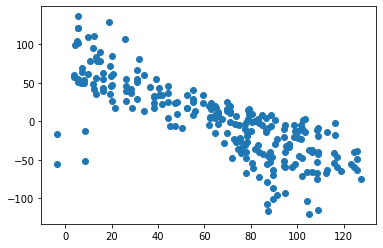

subject_15_stimulus_9_component_1   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=-0.7621223006642733, pvalue=7.838949273629853e-47)   1.7853765207304242


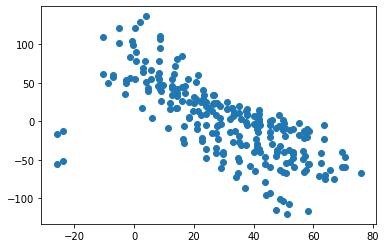

subject_15_stimulus_9_component_1   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=-0.7887222403372605, pvalue=3.35262440108017e-52)   6.559415191651527


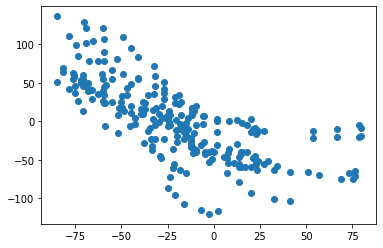

subject_15_stimulus_9_component_1   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=-0.763003409559518, pvalue=5.343360217528404e-47)   3.414383321930546


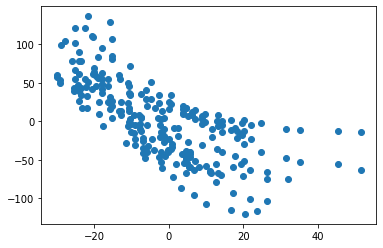

subject_15_stimulus_9_component_1   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=-0.7887291850379126, pvalue=3.3410501542515624e-52)   3.9733121653273704


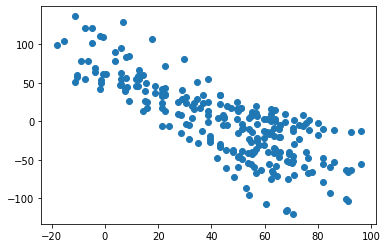

subject_15_stimulus_9_component_1   subject_12_stim_period_9_component_5   SpearmanrResult(correlation=-0.7863497569769616, pvalue=1.0843918522564642e-51)   3.5558295193032152


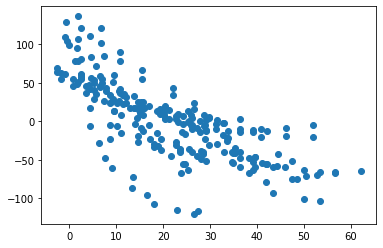

subject_15_stimulus_9_component_1   subject_15_stimulus_10_component_0   SpearmanrResult(correlation=-0.777910206774423, pvalue=6.269968508908563e-50)   6.990929568721327


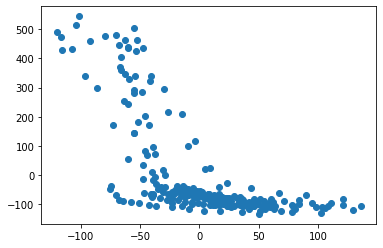

subject_15_stimulus_9_component_1   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=-0.8956639872220001, pvalue=1.0183126830914353e-85)   2.8259013837062135


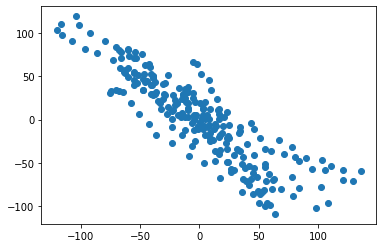

subject_15_stimulus_9_component_1   subject_15_stimulus_12_component_0   SpearmanrResult(correlation=0.7655271792913071, pvalue=1.7661544093246612e-47)   3.1293901753911375


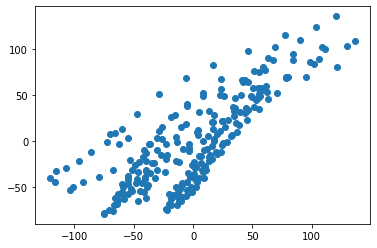

subject_15_stim_period_0_component_0   subject_15_stimulus_0_component_0   SpearmanrResult(correlation=0.9089087553187314, pvalue=1.2240847557946854e-126)   15.199337826402516


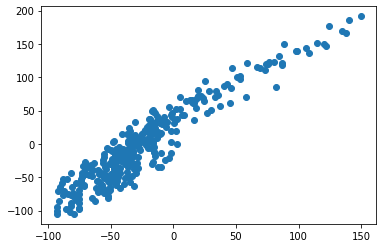

subject_15_stim_period_0_component_1   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=-0.8566015370730014, pvalue=2.841725820524274e-96)   3.2919237108479162


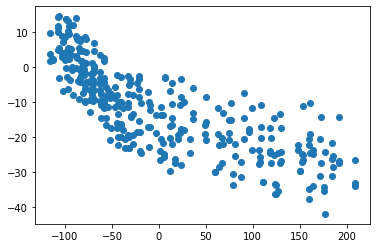

subject_15_stim_period_0_component_1   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=-0.8228414722843007, pvalue=1.6669726125171354e-82)   3.2919237108479162


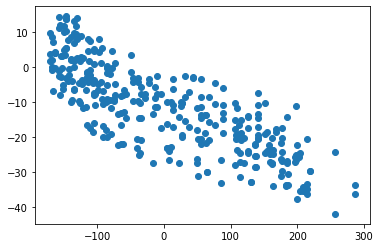

subject_15_stim_period_0_component_1   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=-0.8346468092820745, pvalue=5.80585627281855e-87)   3.230557431530756


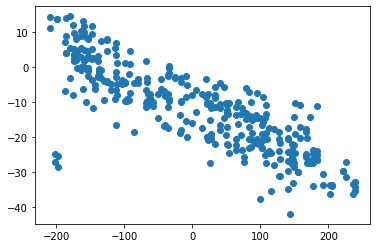

subject_15_stim_period_0_component_1   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=-0.8213628415534959, pvalue=5.713491507448008e-82)   3.2919237108479162


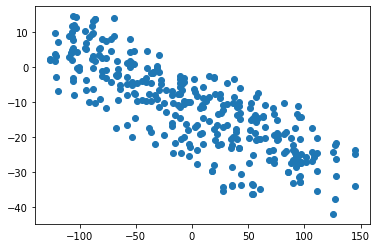

subject_15_stim_period_0_component_1   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=-0.8549566104740979, pvalue=1.598243930926299e-95)   3.2919237108479162


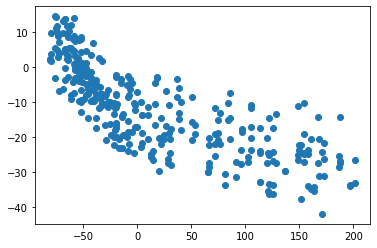

subject_15_stim_period_0_component_1   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=-0.75150822520124, pvalue=3.2922942095680086e-61)   2.7891209172035367


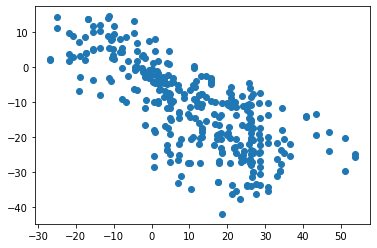

subject_15_stim_period_0_component_1   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.8726340616094513, pvalue=4.106279606612858e-104)   2.6409439863920894


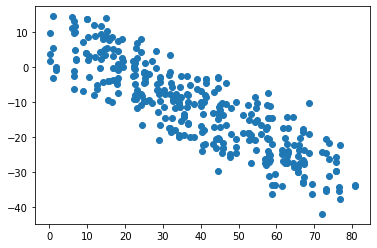

subject_15_stim_period_0_component_1   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=-0.8169990776894134, pvalue=2.0291166170004524e-80)   3.2919237108479162


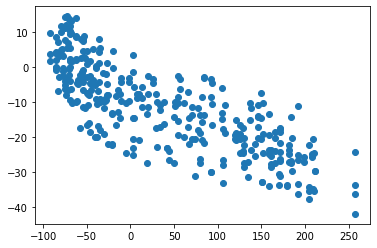

subject_15_stim_period_0_component_1   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=-0.8353390408775936, pvalue=3.101558544506316e-87)   2.7644270770848585


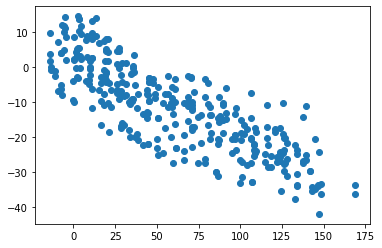

subject_15_stim_period_0_component_1   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=-0.7729189851826634, pvalue=8.980268088231745e-67)   2.7891209172035367


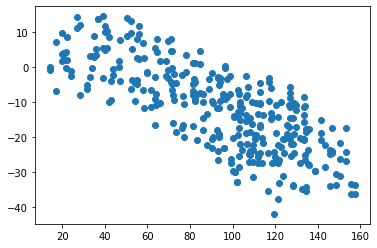

subject_15_stim_period_0_component_1   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=-0.7600404053735059, pvalue=2.3455394863615906e-63)   2.6409439863920894


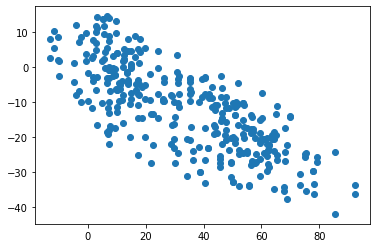

subject_15_stim_period_0_component_1   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=-0.8332947370532966, pvalue=1.9592009174913052e-86)   3.2919237108479162


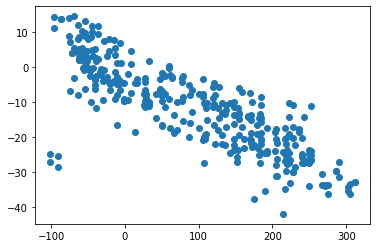

subject_15_stim_period_0_component_1   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=-0.8022117685990273, pvalue=1.8521884634906965e-75)   2.6409439863920894


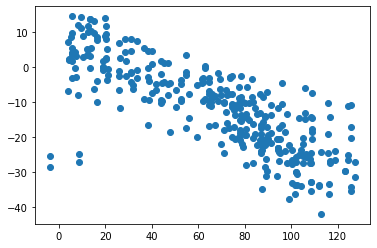

subject_15_stim_period_0_component_1   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=-0.8033781771678398, pvalue=7.795978335672812e-76)   1.6481190748977765


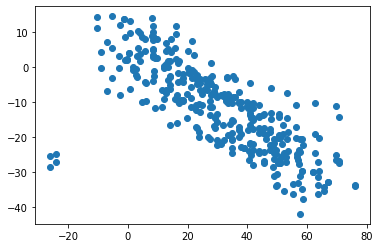

subject_15_stim_period_0_component_1   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=-0.8166123897069671, pvalue=2.77135591400897e-80)   2.7644270770848585


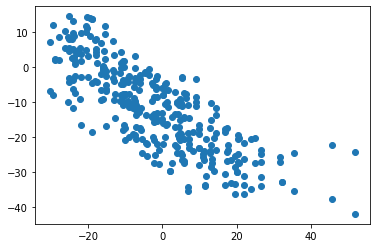

subject_15_stim_period_0_component_1   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=-0.8273378053444378, pvalue=3.664582301760259e-84)   2.7891209172035367


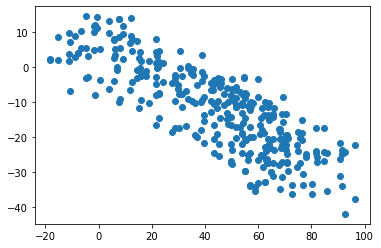

subject_15_stim_period_0_component_1   subject_12_stim_period_9_component_5   SpearmanrResult(correlation=-0.7762933220243036, pvalue=1.0484273657376442e-67)   2.6409439863920894


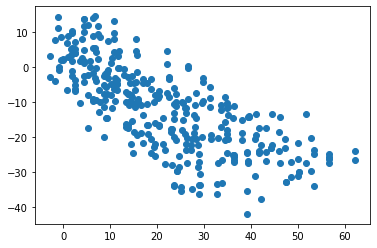

subject_15_stim_period_0_component_1   subject_14_stimulus_11_component_2   SpearmanrResult(correlation=-0.7522139347132691, pvalue=2.2040638721062188e-61)   1.8389809396386188


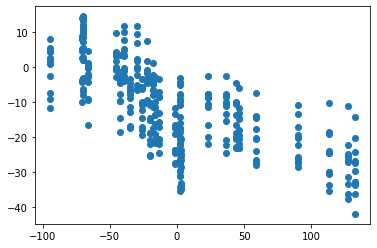

subject_15_stim_period_0_component_1   subject_15_stimulus_12_component_0   SpearmanrResult(correlation=0.871483788050109, pvalue=1.6240920659604797e-103)   1.9154663607505542


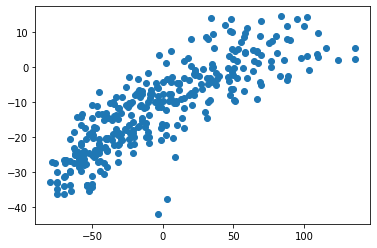

subject_15_stim_period_0_component_1   subject_15_stimulus_9_component_1   SpearmanrResult(correlation=0.7591530036611903, pvalue=3.960370093585035e-63)   3.3208347753867744


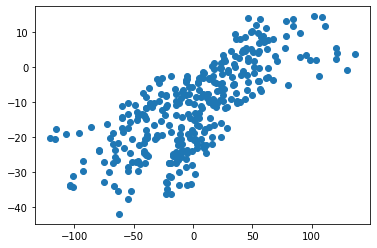

subject_15_stim_period_0_component_4   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=-0.8624434307767196, pvalue=5.1529421825743165e-99)   4.656323466640281


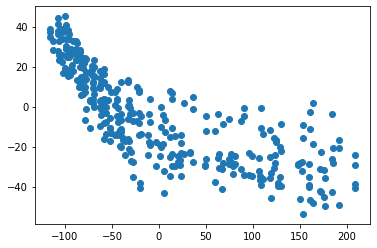

subject_15_stim_period_0_component_4   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=-0.8597863700890472, pvalue=9.42667725562512e-98)   4.655762299412446


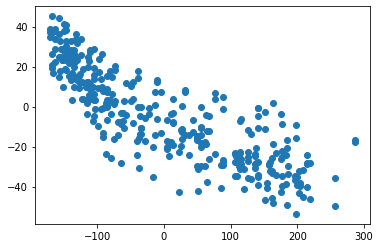

subject_15_stim_period_0_component_4   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=-0.8165003570488405, pvalue=3.03289111750764e-80)   4.574067949590763


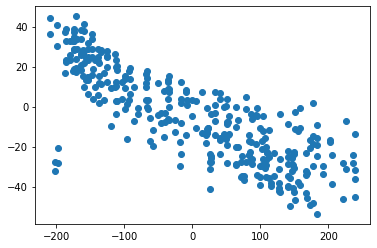

subject_15_stim_period_0_component_4   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=-0.8625643125121648, pvalue=4.508163579960211e-99)   4.64249389576373


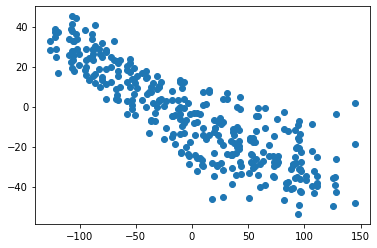

subject_15_stim_period_0_component_4   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=-0.8550138790310837, pvalue=1.505516557919176e-95)   4.655762299412446


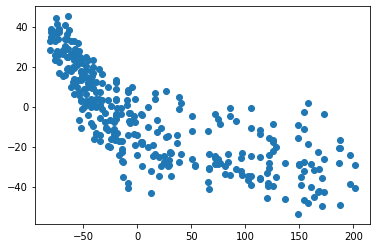

subject_15_stim_period_0_component_4   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.8729287525805297, pvalue=2.880881991352472e-104)   3.133050419221698


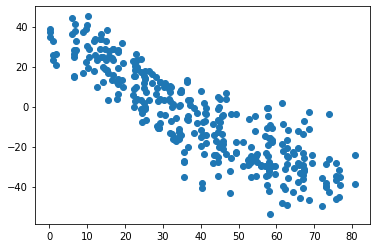

subject_15_stim_period_0_component_4   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=-0.8602411792704735, pvalue=5.756277169912655e-98)   4.655762299412446


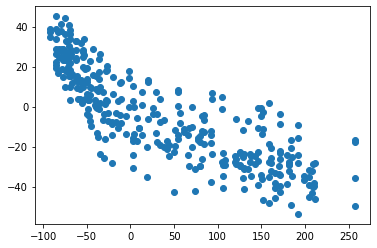

subject_15_stim_period_0_component_4   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=-0.8623068544513133, pvalue=5.9921400384449765e-99)   2.9699116157548757


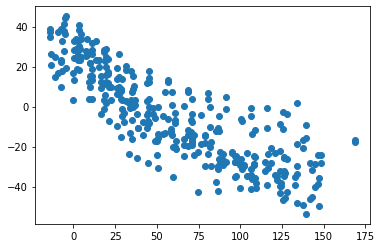

subject_15_stim_period_0_component_4   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=-0.7892285025355548, pvalue=1.940962567360962e-71)   3.1731085479830687


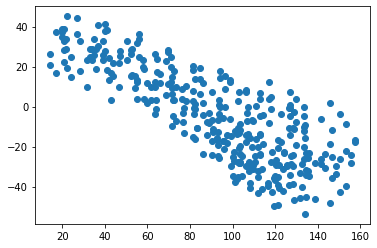

subject_15_stim_period_0_component_4   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=-0.795038172240736, pvalue=3.349468804355417e-73)   3.133050419221698


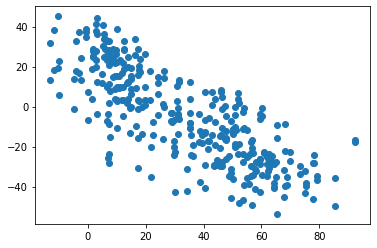

subject_15_stim_period_0_component_4   subject_12_stim_period_11_component_9   SpearmanrResult(correlation=0.7792090095188886, pvalue=1.5897716546524254e-68)   4.590126461790123


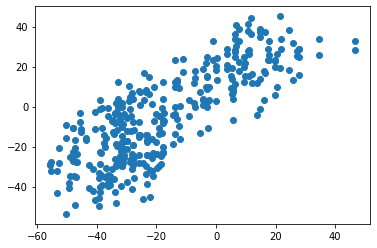

subject_15_stim_period_0_component_4   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=-0.8122544695731893, pvalue=8.844328794548473e-79)   4.655762299412446


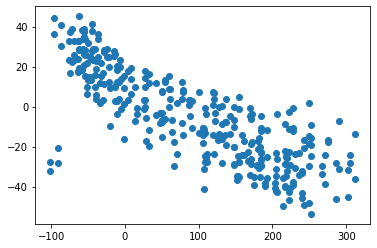

subject_15_stim_period_0_component_4   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=-0.8161039851704608, pvalue=4.170671374752625e-80)   3.133050419221698


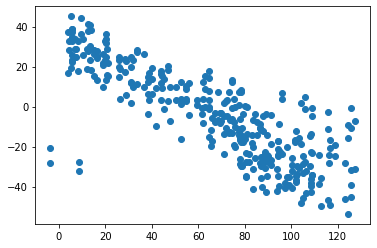

subject_15_stim_period_0_component_4   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=-0.8314539620073251, pvalue=1.0084052957907302e-85)   1.6955622136919384


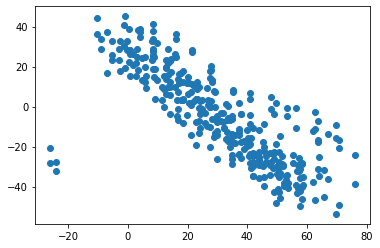

subject_15_stim_period_0_component_4   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=-0.8036862252367575, pvalue=6.197208843353687e-76)   4.655762299412446


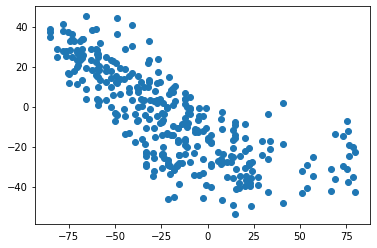

subject_15_stim_period_0_component_4   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=-0.8341928349192631, pvalue=8.744830165790225e-87)   2.9699116157548757


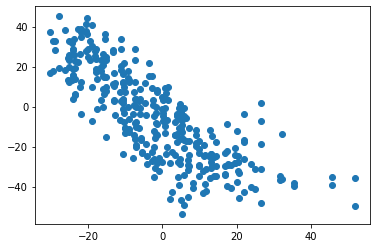

subject_15_stim_period_0_component_4   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=-0.8579901743571142, pvalue=6.502131517167107e-97)   3.1731085479830687


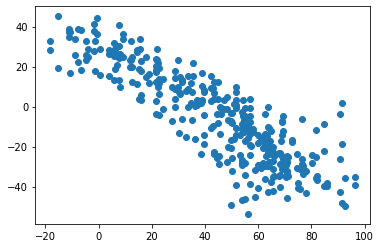

subject_15_stim_period_0_component_4   subject_12_stim_period_9_component_5   SpearmanrResult(correlation=-0.7883803268227626, pvalue=3.4733618498633515e-71)   3.133050419221698


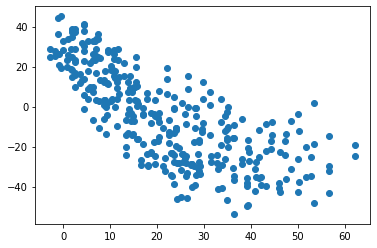

subject_15_stim_period_0_component_4   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=-0.7835296967424396, pvalue=9.206506709637507e-70)   3.313413237672461


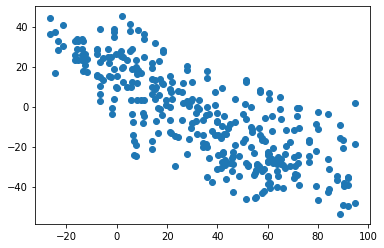

subject_15_stim_period_0_component_4   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=-0.7802155474892133, pvalue=8.234230614644936e-69)   1.8307165546220787


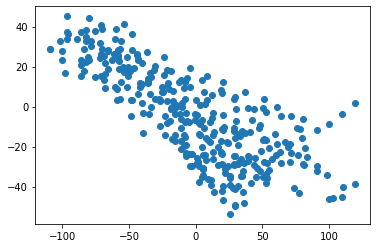

subject_15_stim_period_0_component_4   subject_15_stimulus_12_component_0   SpearmanrResult(correlation=0.8320651484523757, pvalue=5.865952513828205e-86)   1.9429657817208543


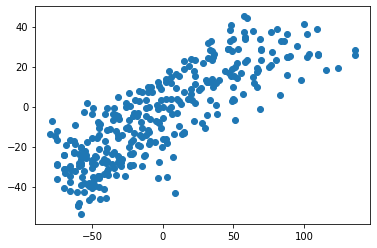

subject_15_stim_period_0_component_4   subject_15_stim_period_0_component_1   SpearmanrResult(correlation=0.829370834860325, pvalue=6.28855605045919e-85)   3.0060370970534507


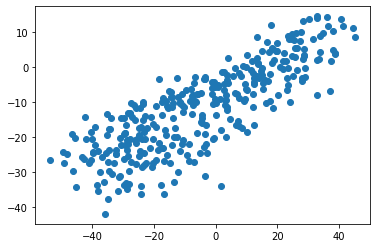

subject_15_stim_period_0_component_6   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8197008846548474, pvalue=2.250749580636691e-81)   3.1002562548065056


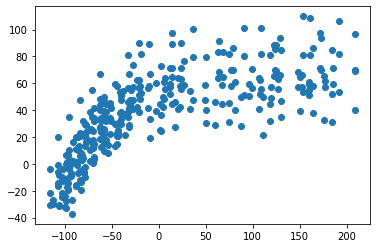

subject_15_stim_period_0_component_6   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.7602658063995432, pvalue=2.0525872552688424e-63)   3.1002562548065056


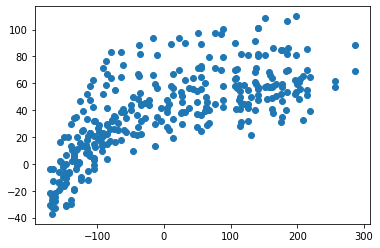

subject_15_stim_period_0_component_6   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.8092442806113916, pvalue=9.178358352603021e-78)   3.1002562548065056


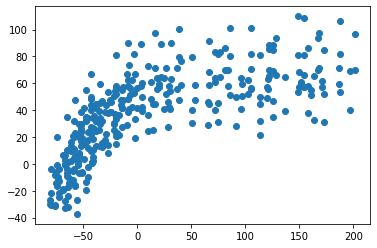

subject_15_stim_period_0_component_6   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.7783910542399576, pvalue=2.7065064338959488e-68)   2.681120501116906


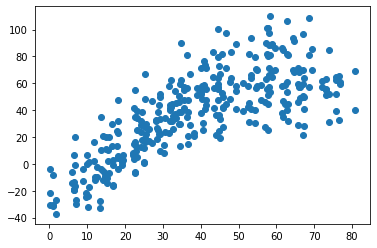

subject_15_stim_period_0_component_6   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.7535478540412933, pvalue=1.028495644201744e-61)   3.1002562548065056


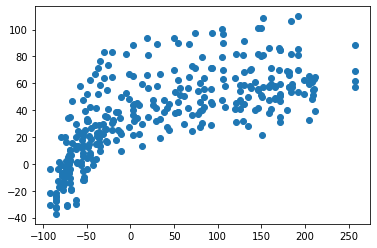

subject_15_stim_period_0_component_6   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.7680312891558365, pvalue=1.8886749402894049e-65)   2.45991644566301


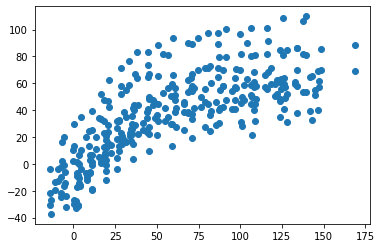

subject_15_stim_period_0_component_6   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=0.7568443857880198, pvalue=1.5310005521525063e-62)   2.268223995032806


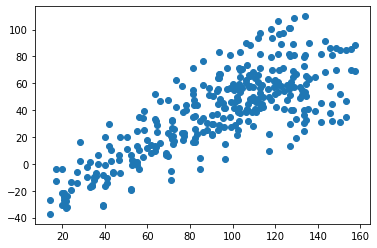

subject_15_stim_period_0_component_6   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=0.7518257902023682, pvalue=2.748836162792621e-61)   2.621331757149763


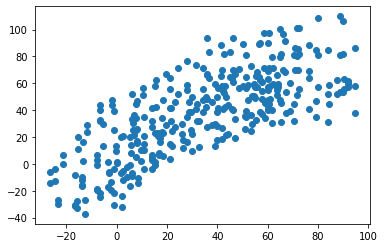

subject_15_stim_period_0_component_6   subject_15_stimulus_0_component_0   SpearmanrResult(correlation=0.8287063325566892, pvalue=1.1216531914792777e-84)   3.2556656059636575


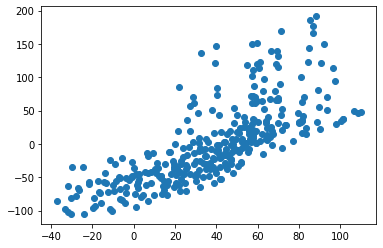

subject_15_stim_period_0_component_7   subject_15_stimulus_0_component_1   SpearmanrResult(correlation=0.8564100680447019, pvalue=3.4783216690171358e-96)   2.04466142534176


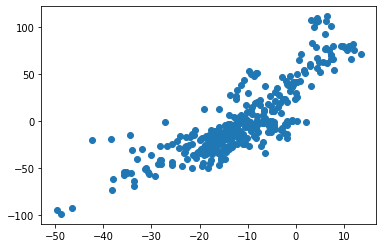

subject_15_stim_period_10_component_0   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.7885755335359832, pvalue=3.6066122857555845e-52)   10.480182008445658


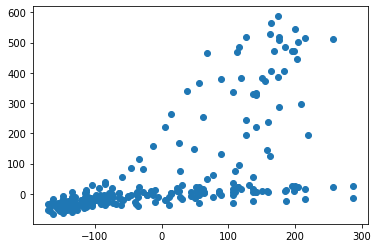

subject_15_stim_period_10_component_0   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.7762096259372071, pvalue=1.389855007513555e-49)   9.031399818097277


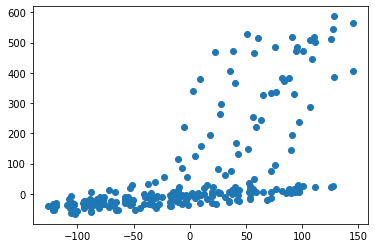

subject_15_stim_period_10_component_0   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.7892309396600321, pvalue=2.60147873634116e-52)   12.738704229100335


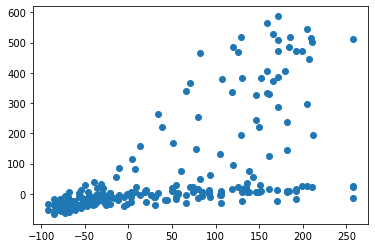

subject_15_stim_period_10_component_0   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.7752833764877235, pvalue=2.1378910628779674e-49)   3.46208484009959


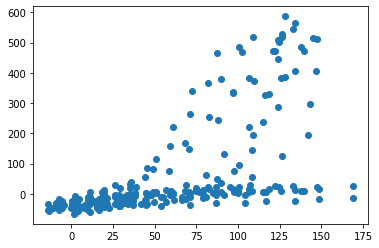

subject_15_stim_period_10_component_0   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=0.7534014928203067, pvalue=3.188211584673867e-45)   4.030982100719548


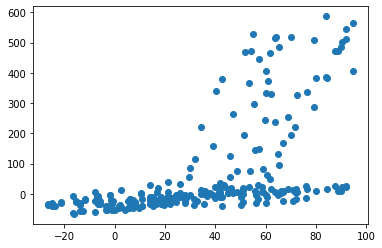

subject_15_stim_period_10_component_0   subject_15_stimulus_10_component_0   SpearmanrResult(correlation=0.9972108890779351, pvalue=2.987266190915157e-270)   16.824685992535933


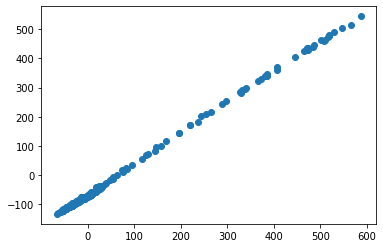

subject_15_stim_period_10_component_0   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=0.8901369815448184, pvalue=3.367421914753665e-83)   3.318979818855567


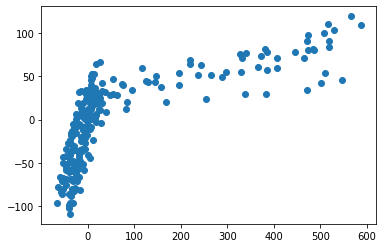

subject_15_stim_period_10_component_0   subject_15_stimulus_9_component_1   SpearmanrResult(correlation=-0.7745151825552526, pvalue=3.0507915871744224e-49)   6.990929568721327


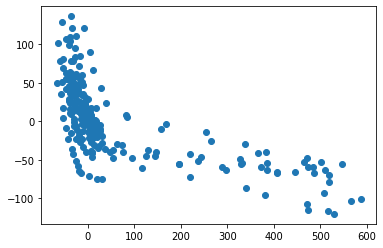

subject_15_stim_period_10_component_2   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.7603817850633224, pvalue=1.663144407937909e-46)   3.407808005652088


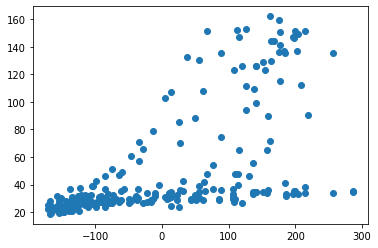

subject_15_stim_period_10_component_2   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.7511158182181601, pvalue=8.208227087967968e-45)   3.4303983670978706


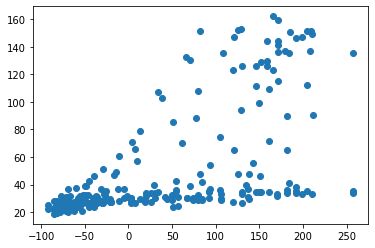

subject_15_stim_period_10_component_2   subject_15_stimulus_10_component_0   SpearmanrResult(correlation=0.7929625514331845, pvalue=3.9598234568251193e-53)   3.675917022440573


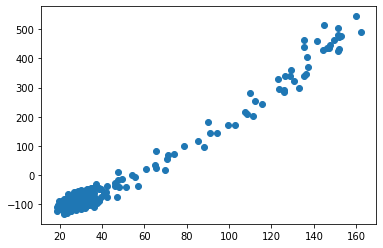

subject_15_stim_period_10_component_2   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=0.8285074393652666, pvalue=7.223973967064416e-62)   2.2170418864620585


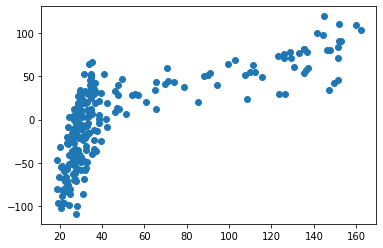

subject_15_stim_period_10_component_2   subject_15_stimulus_9_component_1   SpearmanrResult(correlation=-0.7849606764006318, pvalue=2.141240374800302e-51)   3.5535095016071097


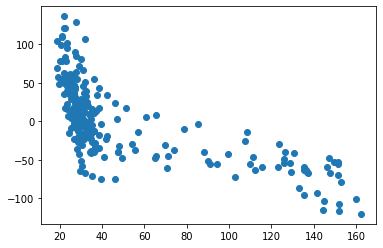

subject_15_stim_period_10_component_2   subject_15_stim_period_10_component_0   SpearmanrResult(correlation=0.7691696036389519, pvalue=3.4863137373074355e-48)   3.675917022440573


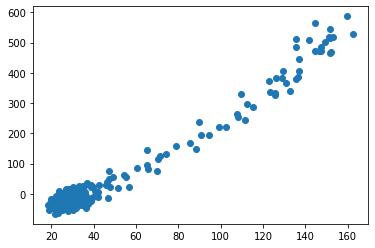

subject_15_stim_period_10_component_3   subject_15_stimulus_10_component_0   SpearmanrResult(correlation=0.7705793503359432, pvalue=1.8456479085626797e-48)   2.2243768864288214


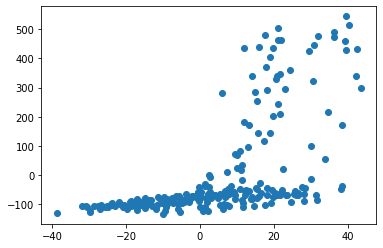

subject_15_stim_period_10_component_3   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=0.8473671417906559, pvalue=2.2822592179575218e-67)   1.8344879023167215


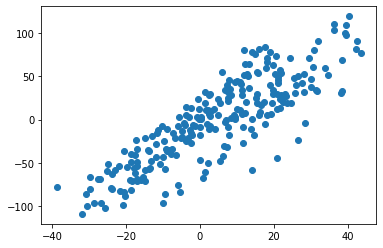

subject_15_stim_period_10_component_3   subject_15_stimulus_9_component_1   SpearmanrResult(correlation=-0.7997916630497056, pvalue=1.1403230374960207e-54)   2.144174645921238


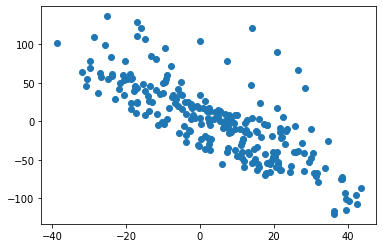

subject_15_stim_period_10_component_3   subject_15_stim_period_10_component_0   SpearmanrResult(correlation=0.7817748572023817, pvalue=1.0002897308828279e-50)   2.2243768864288214


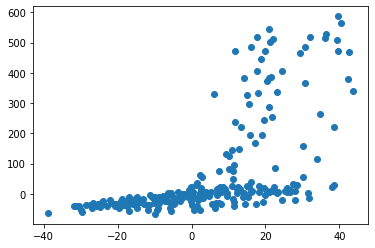

subject_15_stim_period_10_component_4   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=-0.8234105860510755, pvalue=1.701261370390945e-60)   4.656323466640281


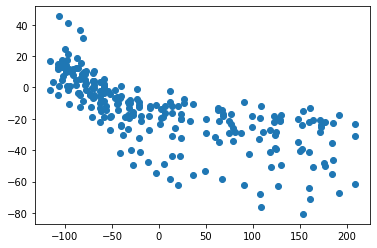

subject_15_stim_period_10_component_4   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=-0.8675484991335449, pvalue=3.8056853554419785e-74)   4.655762299412446


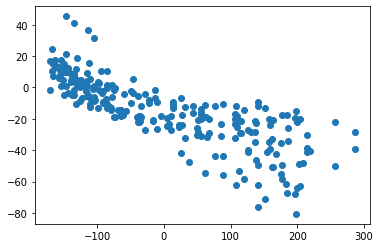

subject_15_stim_period_10_component_4   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=-0.7919276537320291, pvalue=6.70017409262262e-53)   4.574067949590763


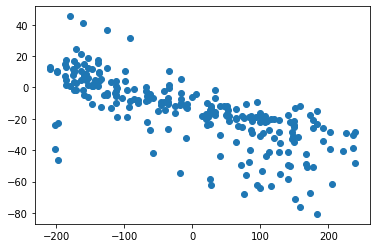

subject_15_stim_period_10_component_4   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=-0.8212186649077333, pvalue=6.416455870251272e-60)   4.64249389576373


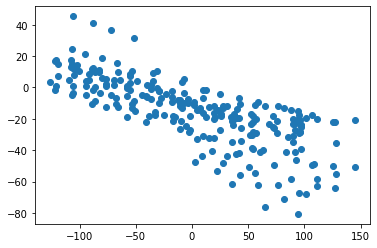

subject_15_stim_period_10_component_4   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=-0.8135117833589839, pvalue=5.934076960782659e-58)   4.655762299412446


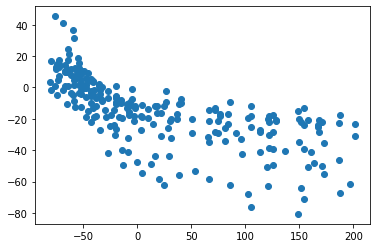

subject_15_stim_period_10_component_4   subject_12_stim_period_10_component_3   SpearmanrResult(correlation=-0.768467586841406, pvalue=4.7773099354674866e-48)   3.1731085479830687


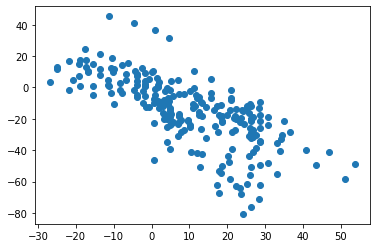

subject_15_stim_period_10_component_4   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.8419867922080577, pvalue=1.0017482447311816e-65)   3.133050419221698


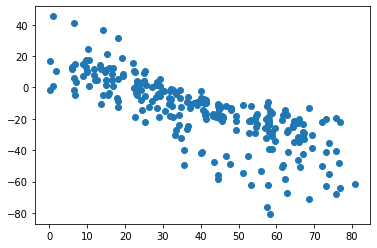

subject_15_stim_period_10_component_4   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=-0.8601150651729748, pvalue=1.584836682409142e-71)   4.655762299412446


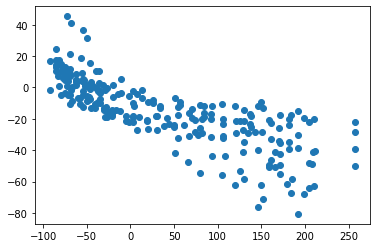

subject_15_stim_period_10_component_4   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=-0.8672307790787079, pvalue=4.961572808512313e-74)   2.9699116157548757


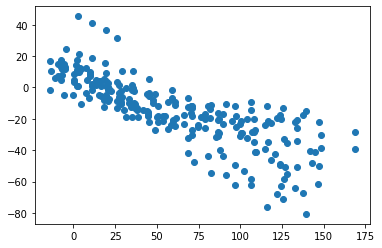

subject_15_stim_period_10_component_4   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=-0.8001649367930883, pvalue=9.356207961397915e-55)   3.1731085479830687


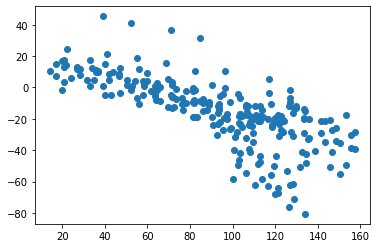

subject_15_stim_period_10_component_4   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=-0.8136862689628697, pvalue=5.368537416180244e-58)   3.133050419221698


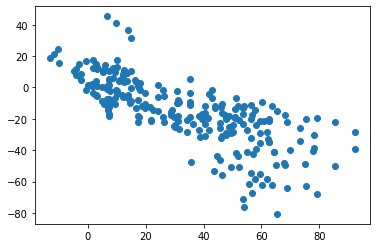

subject_15_stim_period_10_component_4   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=-0.7889995943195565, pvalue=2.9198361198746972e-52)   4.655762299412446


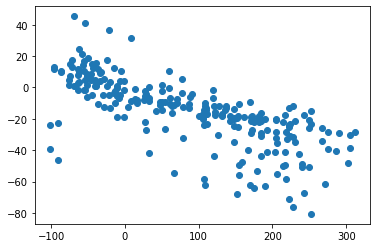

subject_15_stim_period_10_component_4   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=-0.7940206128910778, pvalue=2.3056902877025514e-53)   3.133050419221698


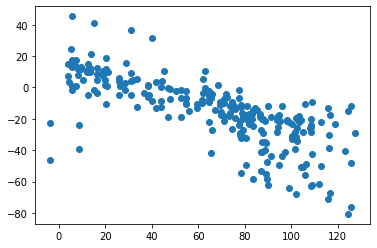

subject_15_stim_period_10_component_4   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=-0.8149554130070545, pvalue=2.5827975816159365e-58)   1.6955622136919384


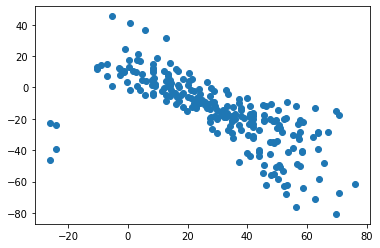

subject_15_stim_period_10_component_4   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=-0.8081548148934137, pvalue=1.221631827851488e-56)   2.9699116157548757


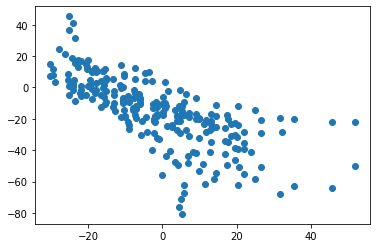

subject_15_stim_period_10_component_4   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=-0.8115594543881417, pvalue=1.8069600654865562e-57)   3.1731085479830687


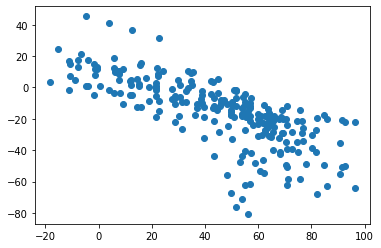

subject_15_stim_period_10_component_4   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=-0.8016450261195827, pvalue=4.2518609780475106e-55)   3.313413237672461


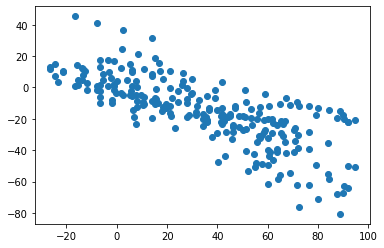

subject_15_stim_period_10_component_4   subject_14_stimulus_11_component_2   SpearmanrResult(correlation=-0.7810241322096475, pvalue=1.4329884481559909e-50)   1.962480157509738


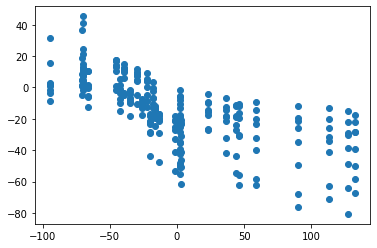

subject_15_stim_period_10_component_4   subject_15_stimulus_0_component_0   SpearmanrResult(correlation=-0.7611027816022745, pvalue=1.249075564692271e-63)   4.728956320101579


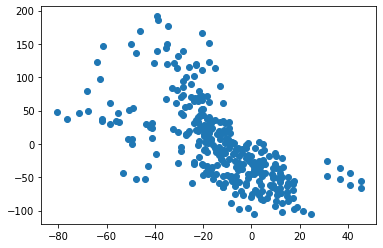

subject_15_stim_period_10_component_4   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=-0.8261115644368824, pvalue=3.230587931562077e-61)   1.8307165546220787


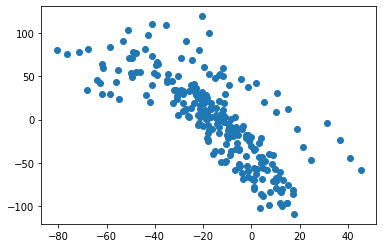

subject_15_stim_period_10_component_4   subject_15_stimulus_9_component_1   SpearmanrResult(correlation=0.7992013750238718, pvalue=1.5579090406941602e-54)   4.335206772178758


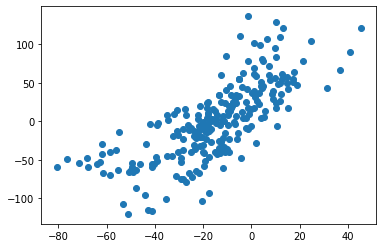

subject_15_stim_period_10_component_4   subject_15_stim_period_0_component_1   SpearmanrResult(correlation=0.7530361973031188, pvalue=1.3785545001769046e-61)   3.0060370970534507


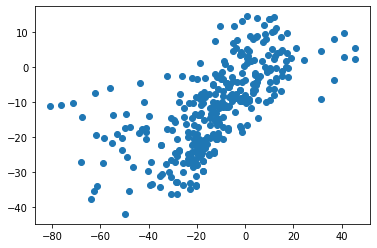

subject_15_stim_period_10_component_4   subject_15_stim_period_0_component_4   SpearmanrResult(correlation=0.7915302033816086, pvalue=3.9469082801899306e-72)   4.74145632010158


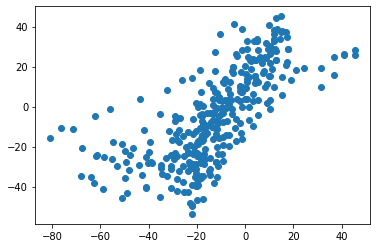

subject_15_stim_period_10_component_4   subject_15_stim_period_10_component_2   SpearmanrResult(correlation=-0.7558021840656954, pvalue=1.1676300116240337e-45)   2.9019931223158366


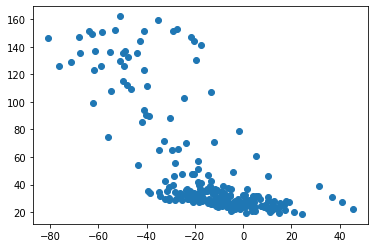

subject_15_stim_period_10_component_5   subject_15_stimulus_10_component_2   SpearmanrResult(correlation=-0.7989817531554365, pvalue=1.7492257113426016e-54)   2.2832763242573644


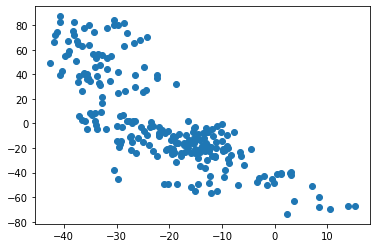

subject_15_stim_period_10_component_7   subject_15_stimulus_10_component_1   SpearmanrResult(correlation=-0.9273815517630511, pvalue=1.3224758007045736e-103)   1.9080609774420672


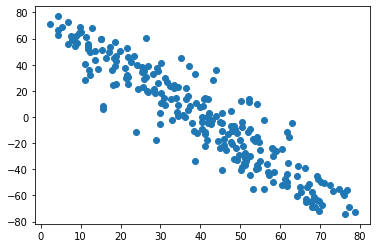

subject_15_stim_period_10_component_9   subject_15_stim_period_10_component_5   SpearmanrResult(correlation=0.7670428306046978, pvalue=9.023487041828318e-48)   2.5149265339666704


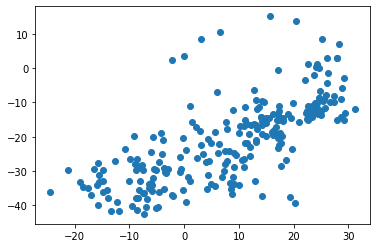

subject_15_stim_period_11_component_2   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=-0.7822389282346658, pvalue=8.004053320207356e-51)   3.4115284429568624


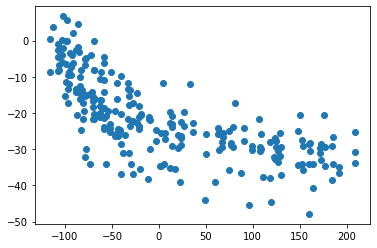

subject_15_stim_period_11_component_2   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=-0.7954286509483061, pvalue=1.11710037190853e-53)   3.407808005652088


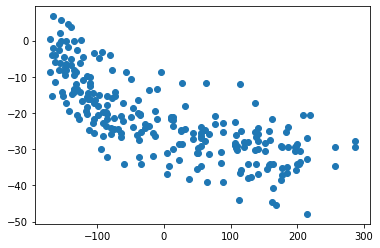

subject_15_stim_period_11_component_2   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=-0.7623675354060533, pvalue=7.047014282378563e-47)   3.2859036412862888


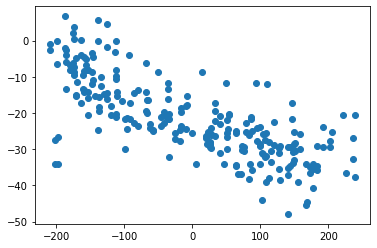

subject_15_stim_period_11_component_2   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=-0.8738742533400933, pvalue=1.6708879083034408e-76)   3.412589725122562


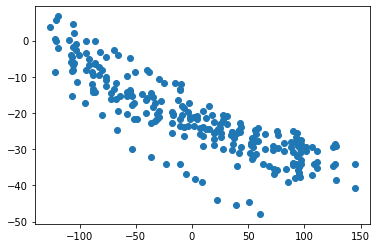

subject_15_stim_period_11_component_2   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=-0.7772057564370031, pvalue=8.726511899679521e-50)   3.4303983670978706


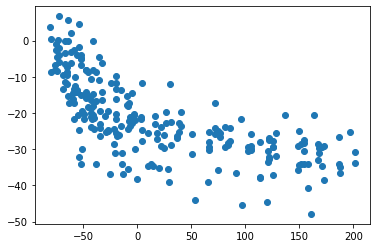

subject_15_stim_period_11_component_2   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.7939589786727898, pvalue=2.379691433787783e-53)   2.8404577907314428


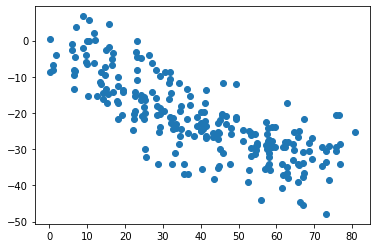

subject_15_stim_period_11_component_2   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=-0.7960666953207244, pvalue=8.029150484718629e-54)   3.4303983670978706


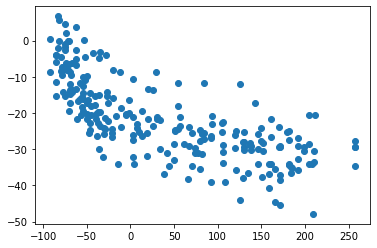

subject_15_stim_period_11_component_2   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=-0.8054559306024629, pvalue=5.40954847805339e-56)   2.746422614470818


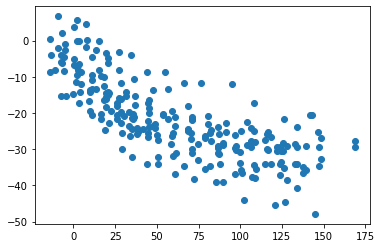

subject_15_stim_period_11_component_2   subject_12_stim_period_11_component_9   SpearmanrResult(correlation=0.7779662011584161, pvalue=6.10703547415068e-50)   3.4303983670978706


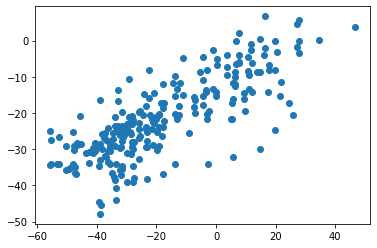

subject_15_stim_period_11_component_2   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=-0.7565799955000482, pvalue=8.411602051787405e-46)   3.4303983670978706


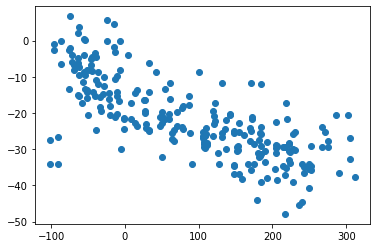

subject_15_stim_period_11_component_2   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=-0.7650091259166236, pvalue=2.21927875295636e-47)   2.8404577907314428


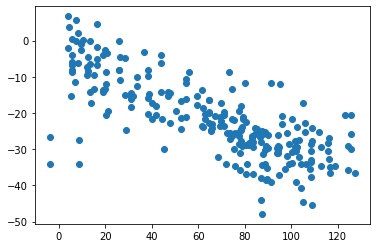

subject_15_stim_period_11_component_2   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=-0.8341991785142269, pvalue=1.871052214204091e-63)   3.4303983670978706


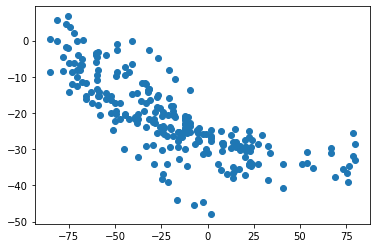

subject_15_stim_period_11_component_2   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=-0.8048829927986586, pvalue=7.396762496143778e-56)   2.746422614470818


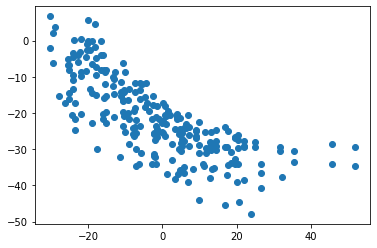

subject_15_stim_period_11_component_2   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=-0.846485222055503, pvalue=4.284400058345475e-67)   2.7265076474862635


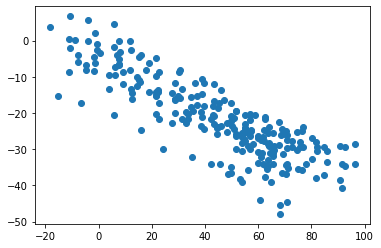

subject_15_stim_period_11_component_2   subject_12_stim_period_9_component_5   SpearmanrResult(correlation=-0.8199981337681138, pvalue=1.333249333594025e-59)   2.8404577907314428


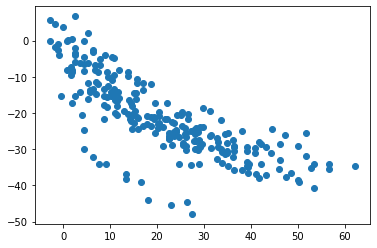

subject_15_stim_period_11_component_2   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=-0.7657608897622215, pvalue=1.592942319499619e-47)   2.759132849637063


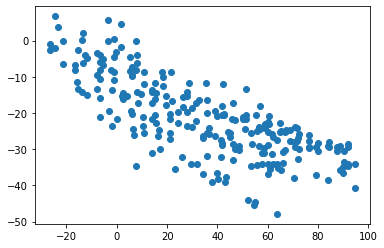

subject_15_stim_period_11_component_2   subject_15_stimulus_10_component_0   SpearmanrResult(correlation=-0.7669794614489834, pvalue=9.281384693253839e-48)   3.675917022440573


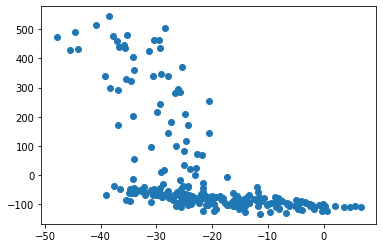

subject_15_stim_period_11_component_2   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=-0.897678779145471, pvalue=1.1325588984444683e-86)   2.2170418864620585


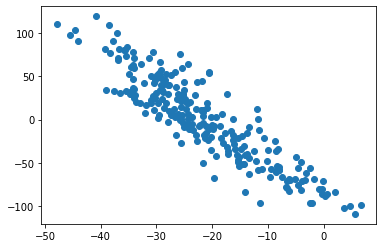

subject_15_stim_period_11_component_2   subject_15_stimulus_9_component_1   SpearmanrResult(correlation=0.8335943332349519, pvalue=2.7767873893556834e-63)   3.5535095016071097


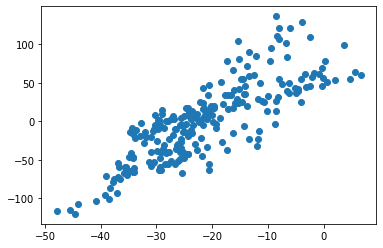

subject_15_stim_period_11_component_2   subject_15_stim_period_0_component_1   SpearmanrResult(correlation=0.7588504691836048, pvalue=4.7322501569953444e-63)   2.6827925845579808


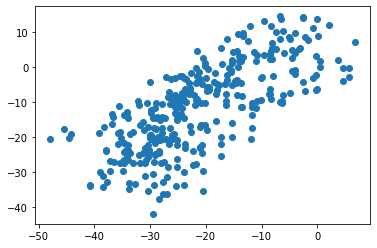

subject_15_stim_period_11_component_2   subject_15_stim_period_0_component_4   SpearmanrResult(correlation=0.8151339032520447, pvalue=9.065572894261591e-80)   2.9019931223158366


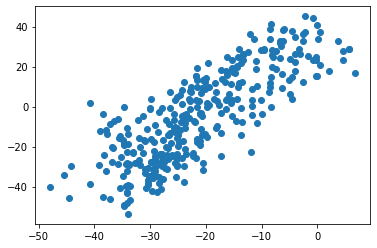

subject_15_stim_period_11_component_2   subject_15_stim_period_10_component_0   SpearmanrResult(correlation=-0.7693718640948626, pvalue=3.1831539952187575e-48)   3.675917022440573


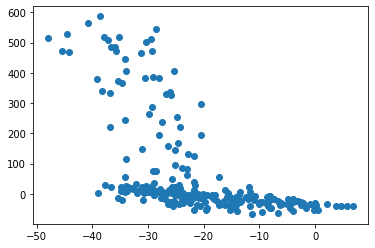

subject_15_stim_period_11_component_2   subject_15_stim_period_10_component_3   SpearmanrResult(correlation=-0.8442212538412124, pvalue=2.1195256215114958e-66)   1.919771157974983


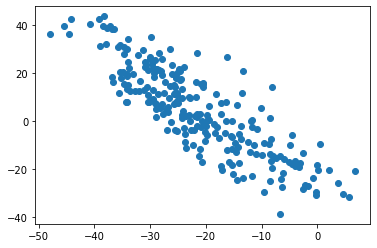

subject_15_stim_period_11_component_3   subject_15_stimulus_10_component_0   SpearmanrResult(correlation=0.8264848348061596, pvalue=2.5620785919975705e-61)   2.2243768864288214


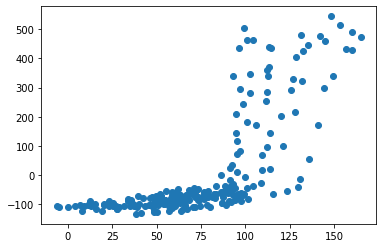

subject_15_stim_period_11_component_3   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=0.8853825587249777, pvalue=3.880968451562986e-81)   1.8344879023167215


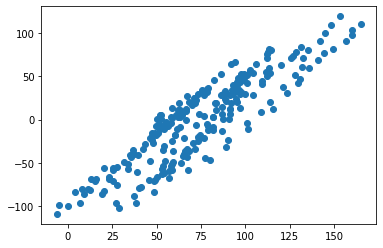

subject_15_stim_period_11_component_3   subject_15_stimulus_9_component_1   SpearmanrResult(correlation=-0.7884459799649297, pvalue=3.8466699191994896e-52)   2.144174645921238


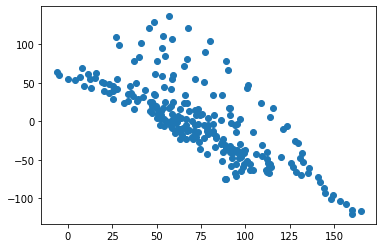

subject_15_stim_period_11_component_3   subject_15_stim_period_10_component_0   SpearmanrResult(correlation=0.8149203979235748, pvalue=2.6356646880156484e-58)   2.2243768864288214


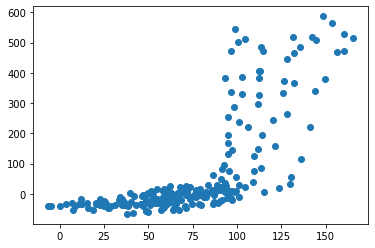

subject_15_stim_period_11_component_3   subject_15_stim_period_10_component_2   SpearmanrResult(correlation=0.7964912585287938, pvalue=6.440961626638552e-54)   1.919771157974983


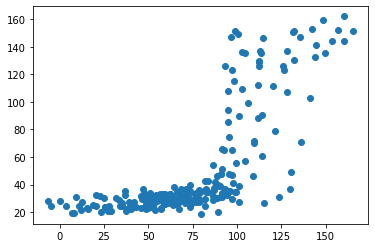

subject_15_stim_period_11_component_3   subject_15_stim_period_10_component_3   SpearmanrResult(correlation=0.8124255629438009, pvalue=1.1043596077175849e-57)   2.2243768864288214


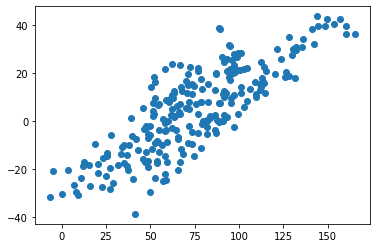

subject_15_stim_period_11_component_3   subject_15_stim_period_11_component_2   SpearmanrResult(correlation=-0.7542952134585669, pvalue=2.1965082718024017e-45)   1.919771157974983


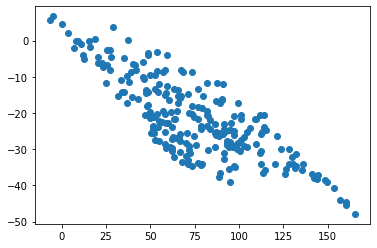

subject_15_stim_period_11_component_4   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=-0.8736763293715063, pvalue=1.9889460934756333e-76)   4.656323466640281


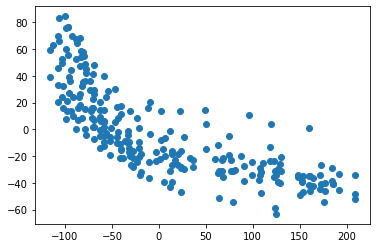

subject_15_stim_period_11_component_4   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=-0.8099482838368375, pvalue=4.485509143985033e-57)   4.655762299412446


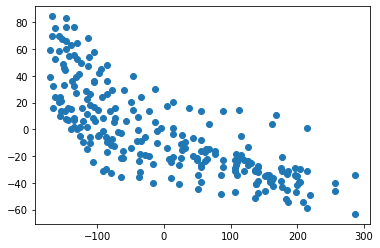

subject_15_stim_period_11_component_4   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=-0.8050444570888216, pvalue=6.7731976397950855e-56)   4.64249389576373


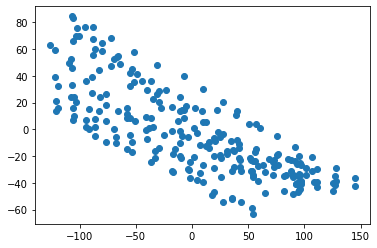

subject_15_stim_period_11_component_4   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=-0.8701883534689523, pvalue=4.0896455357912454e-75)   4.655762299412446


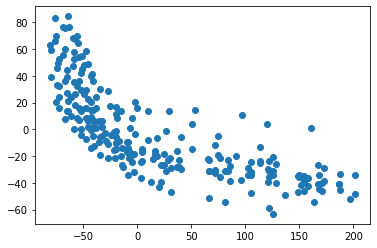

subject_15_stim_period_11_component_4   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.8524463794778124, pvalue=5.605530116346197e-69)   3.133050419221698


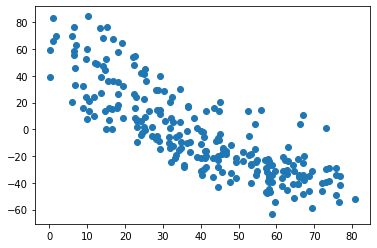

subject_15_stim_period_11_component_4   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=-0.8061530049304246, pvalue=3.6917146036253152e-56)   4.655762299412446


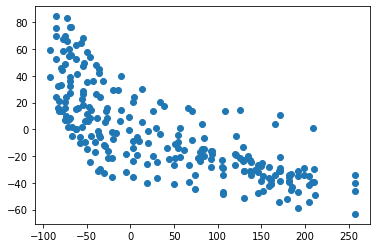

subject_15_stim_period_11_component_4   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=-0.8212759586881138, pvalue=6.199066498719136e-60)   2.9699116157548757


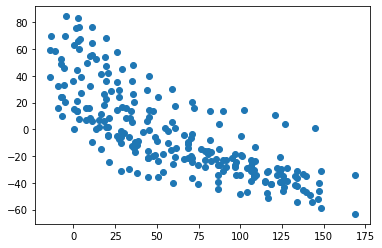

subject_15_stim_period_11_component_4   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=-0.7957897753822191, pvalue=9.267864483084115e-54)   1.6955622136919384


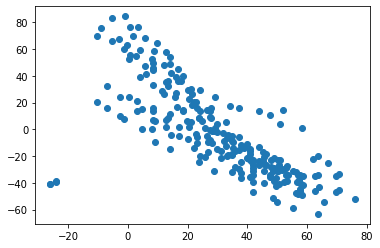

subject_15_stim_period_11_component_4   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=-0.7675118224141506, pvalue=7.322811066264702e-48)   2.9699116157548757


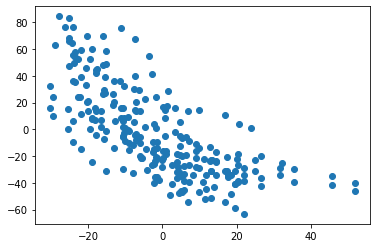

subject_15_stim_period_11_component_4   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=-0.7592953734550482, pvalue=2.6510994897570163e-46)   3.1731085479830687


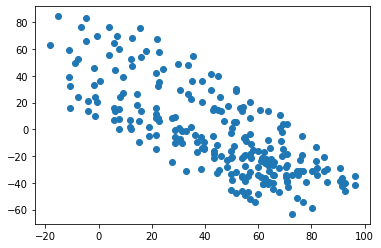

subject_15_stim_period_11_component_4   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=-0.7768802235939325, pvalue=1.0162738734550722e-49)   3.313413237672461


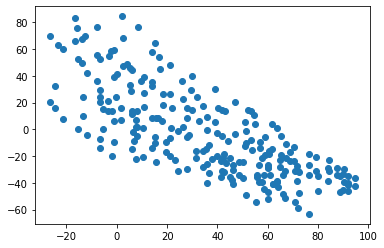

subject_15_stim_period_11_component_4   subject_14_stimulus_11_component_2   SpearmanrResult(correlation=-0.7704765126169795, pvalue=1.9335928811552163e-48)   1.962480157509738


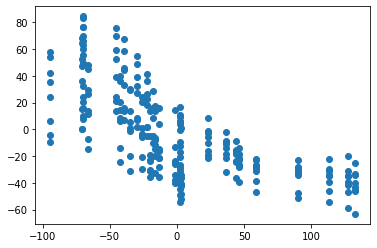

subject_15_stim_period_11_component_4   subject_15_stimulus_0_component_0   SpearmanrResult(correlation=-0.7686764951631121, pvalue=1.2688243526802865e-65)   4.728956320101579


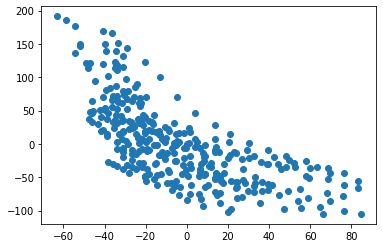

subject_15_stim_period_11_component_4   subject_15_stimulus_12_component_0   SpearmanrResult(correlation=0.8296098890605739, pvalue=3.597898366472133e-62)   1.9429657817208543


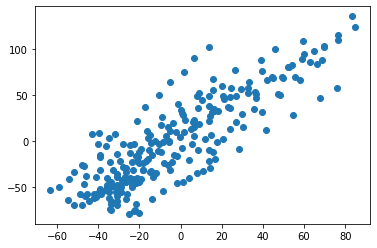

subject_15_stim_period_11_component_4   subject_15_stim_period_0_component_1   SpearmanrResult(correlation=0.7586177246682878, pvalue=5.426035833759404e-63)   3.0060370970534507


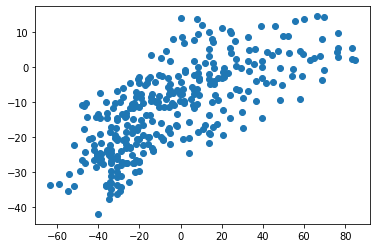

subject_15_stim_period_11_component_4   subject_15_stim_period_0_component_4   SpearmanrResult(correlation=0.8173070758570415, pvalue=1.582131225917934e-80)   4.74145632010158


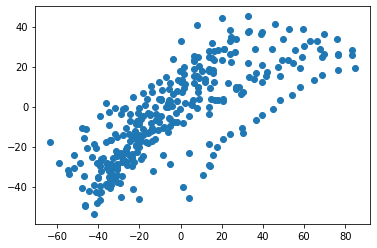

subject_15_stim_period_11_component_4   subject_15_stim_period_10_component_4   SpearmanrResult(correlation=0.7677468358825672, pvalue=6.594002370000834e-48)   4.74145632010158


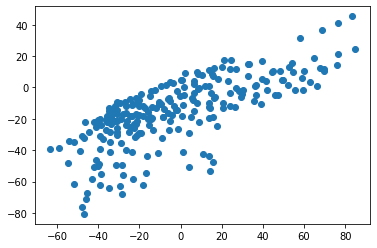

subject_15_stim_period_11_component_6   subject_15_stimulus_11_component_1   SpearmanrResult(correlation=0.9074558586086562, pvalue=1.332265077630692e-91)   3.1401848170056734


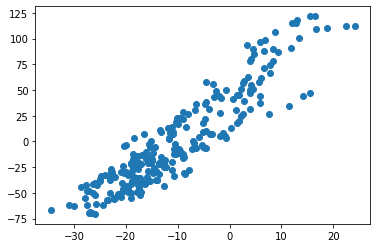

subject_15_stim_period_11_component_6   subject_15_stim_period_11_component_4   SpearmanrResult(correlation=0.8206149412316185, pvalue=9.219401240714318e-60)   2.8658894659811134


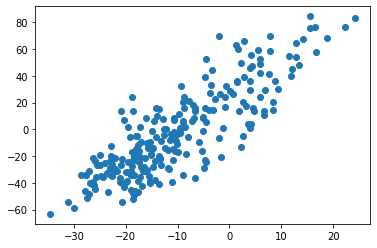

subject_15_stim_period_11_component_7   subject_15_stim_period_11_component_2   SpearmanrResult(correlation=-0.7501345509470649, pvalue=1.228007031170358e-44)   2.9236721040073808


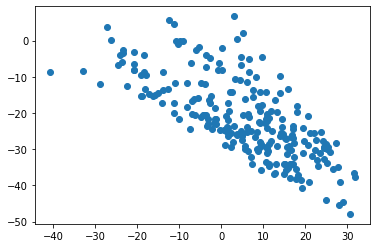

subject_15_stim_period_12_component_1   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.7838327370343395, pvalue=3.7066869778195035e-51)   2.6409439863920894


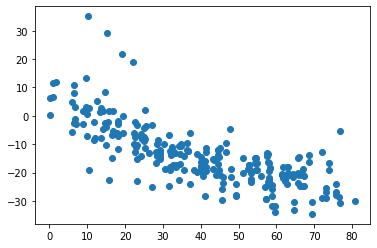

subject_15_stim_period_12_component_1   subject_15_stimulus_12_component_0   SpearmanrResult(correlation=0.8091416517647874, pvalue=7.048324648645972e-57)   1.9154663607505542


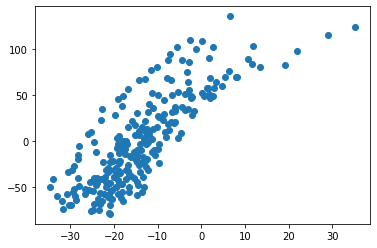

subject_15_stim_period_12_component_2   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.9003917246928358, pvalue=5.468018383063833e-88)   3.4115284429568624


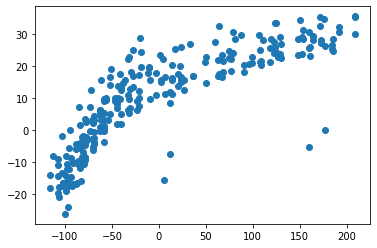

subject_15_stim_period_12_component_2   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8479948263597693, pvalue=1.4542313991647612e-67)   3.407808005652088


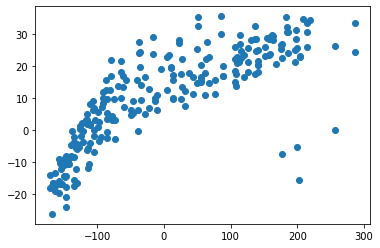

subject_15_stim_period_12_component_2   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.8258264737904504, pvalue=3.854983163721611e-61)   3.2859036412862888


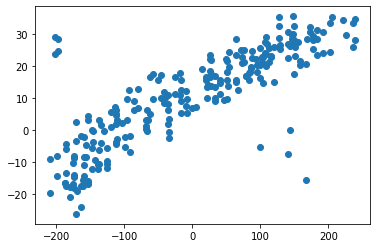

subject_15_stim_period_12_component_2   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.8258594611185482, pvalue=3.777026967102955e-61)   3.412589725122562


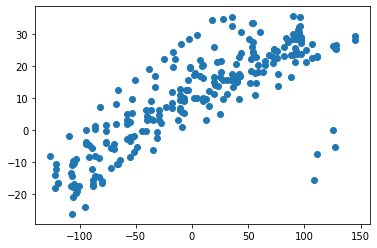

subject_15_stim_period_12_component_2   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.890632684101369, pvalue=2.027203879625833e-83)   3.4303983670978706


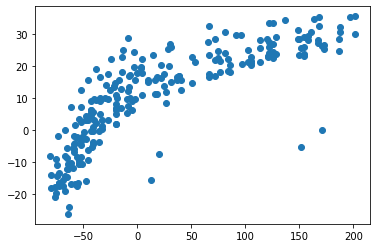

subject_15_stim_period_12_component_2   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8970487194163959, pvalue=2.2618277645592404e-86)   2.8404577907314428


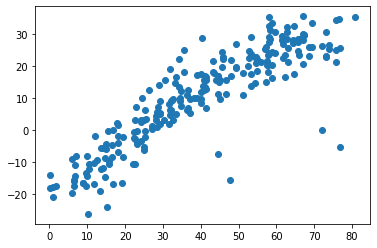

subject_15_stim_period_12_component_2   subject_12_stim_period_10_component_9   SpearmanrResult(correlation=-0.7921932885319748, pvalue=5.855748234565628e-53)   3.4303983670978706


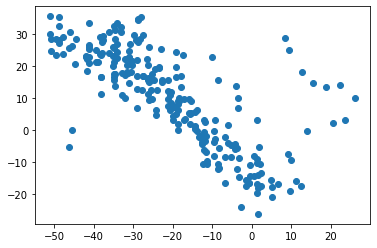

subject_15_stim_period_12_component_2   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.8425241384210197, pvalue=6.910521162364441e-66)   3.4303983670978706


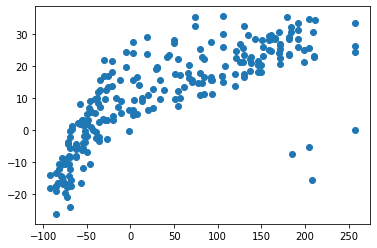

subject_15_stim_period_12_component_2   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.8634858492520234, pvalue=1.0746663794829759e-72)   2.746422614470818


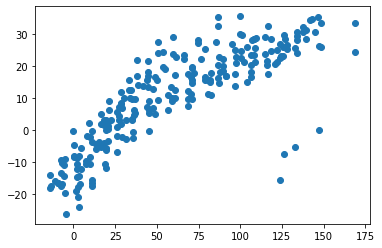

subject_15_stim_period_12_component_2   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=0.8414077777911828, pvalue=1.4922330525095912e-65)   2.7265076474862635


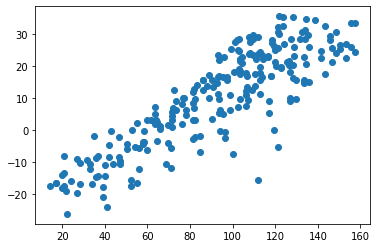

subject_15_stim_period_12_component_2   subject_12_stim_period_11_component_5   SpearmanrResult(correlation=0.7613622899866512, pvalue=1.0895466480330311e-46)   2.8404577907314428


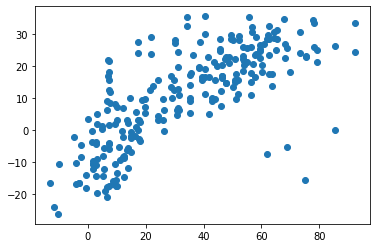

subject_15_stim_period_12_component_2   subject_12_stim_period_12_component_0   SpearmanrResult(correlation=0.8213245715926789, pvalue=6.020342413260179e-60)   3.4303983670978706


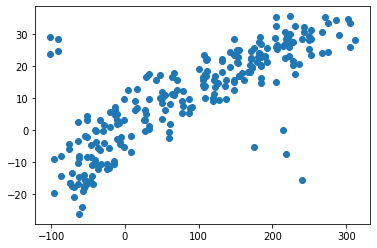

subject_15_stim_period_12_component_2   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=0.8162696976054782, pvalue=1.2034670123335866e-58)   2.8404577907314428


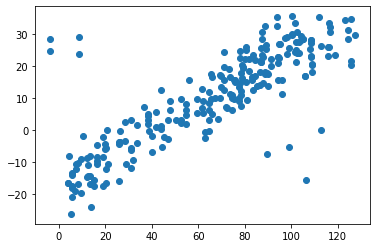

subject_15_stim_period_12_component_2   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=0.8126480362153699, pvalue=9.727553826941881e-58)   1.7443988060514803


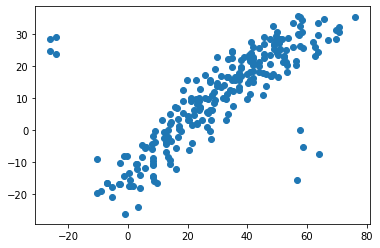

subject_15_stim_period_12_component_2   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=0.7893815528554261, pvalue=2.4129305155677624e-52)   2.746422614470818


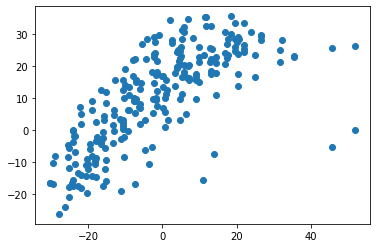

subject_15_stim_period_12_component_2   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=0.7966344245990397, pvalue=5.978913311542472e-54)   2.7265076474862635


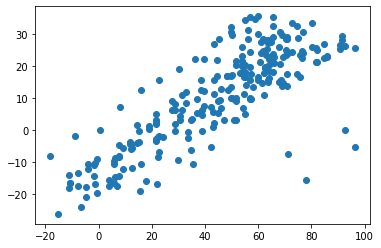

subject_15_stim_period_12_component_2   subject_12_stim_period_9_component_5   SpearmanrResult(correlation=0.770792325384721, pvalue=1.6758993906538057e-48)   2.8404577907314428


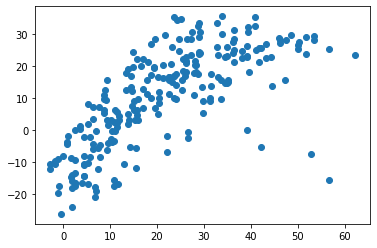

subject_15_stim_period_12_component_2   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=0.7606096580534719, pvalue=1.5077172326230746e-46)   2.759132849637063


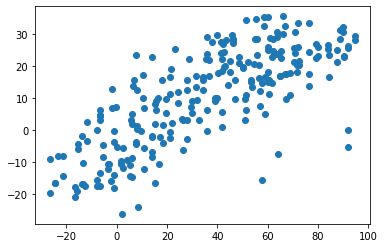

subject_15_stim_period_12_component_2   subject_15_stimulus_0_component_0   SpearmanrResult(correlation=0.7807140949230271, pvalue=5.936724456106966e-69)   3.675917022440573


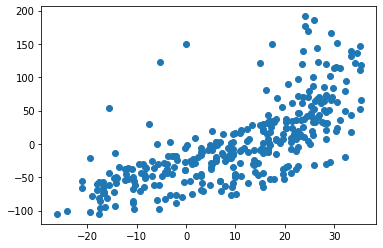

subject_15_stim_period_12_component_2   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=0.7536606538307955, pvalue=2.862171589754421e-45)   2.2170418864620585


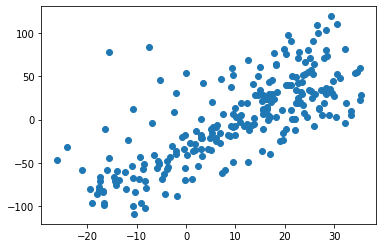

subject_15_stim_period_12_component_2   subject_15_stimulus_12_component_0   SpearmanrResult(correlation=-0.9176287782774005, pvalue=2.379332035946637e-97)   2.238032866492018


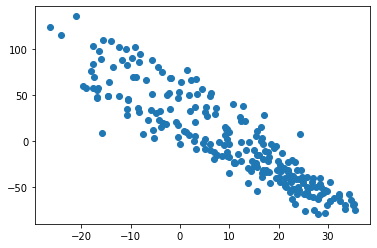

subject_15_stim_period_12_component_2   subject_15_stimulus_9_component_1   SpearmanrResult(correlation=-0.7591520686123022, pvalue=2.8187488462398295e-46)   3.5535095016071097


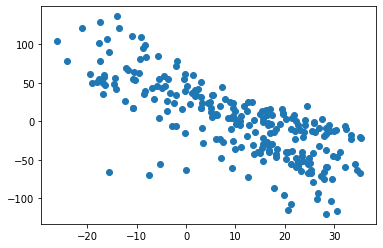

subject_15_stim_period_12_component_2   subject_15_stim_period_0_component_1   SpearmanrResult(correlation=-0.8392351487865014, pvalue=8.611699647866525e-89)   2.6827925845579808


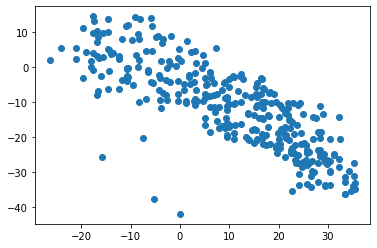

subject_15_stim_period_12_component_2   subject_15_stim_period_0_component_4   SpearmanrResult(correlation=-0.8288367783317383, pvalue=1.0014077232844736e-84)   2.9019931223158366


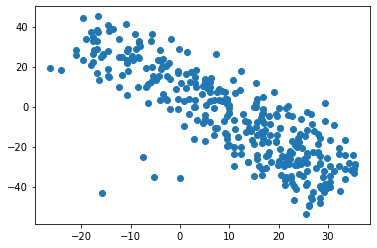

subject_15_stim_period_12_component_2   subject_15_stim_period_0_component_6   SpearmanrResult(correlation=0.7514662570753388, pvalue=3.371662961863551e-61)   2.6157615155809526


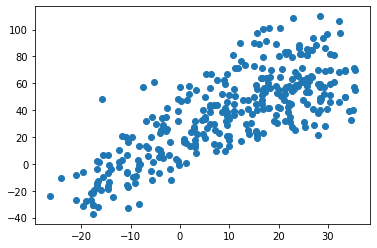

subject_15_stim_period_12_component_2   subject_15_stim_period_10_component_4   SpearmanrResult(correlation=-0.8118760742373998, pvalue=1.5097501646003282e-57)   2.9019931223158366


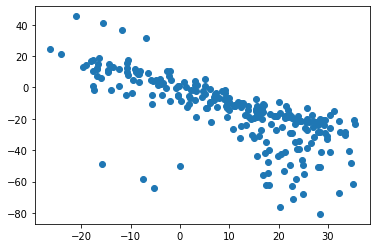

subject_15_stim_period_12_component_2   subject_15_stim_period_11_component_4   SpearmanrResult(correlation=-0.7893435649924476, pvalue=2.4591713434446584e-52)   2.9019931223158366


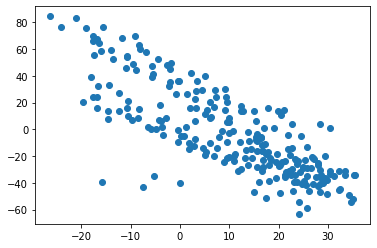

subject_15_stim_period_12_component_2   subject_15_stim_period_12_component_1   SpearmanrResult(correlation=-0.8270239066650461, pvalue=1.8312708535441043e-61)   2.6827925845579808


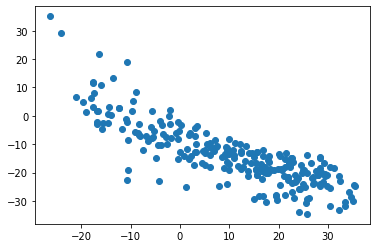

subject_15_stim_period_12_component_3   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=-0.8071074672263079, pvalue=2.1823738568217547e-56)   2.0042114166031735


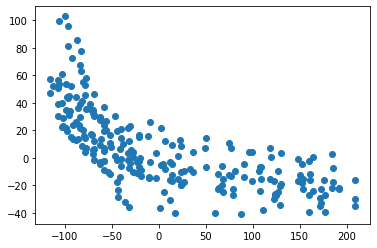

subject_15_stim_period_12_component_3   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=-0.7529058148112578, pvalue=3.917369709302943e-45)   2.043469572823561


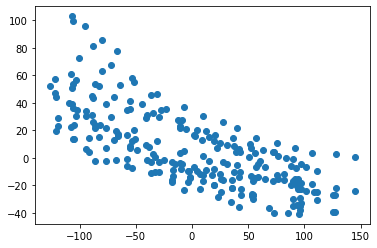

subject_15_stim_period_12_component_3   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=-0.8082707045855468, pvalue=1.1454133733823195e-56)   2.043469572823561


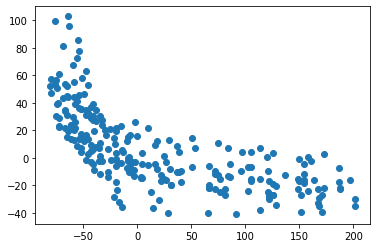

subject_15_stim_period_12_component_3   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.811861982910302, pvalue=1.5218841396440118e-57)   1.898368363651394


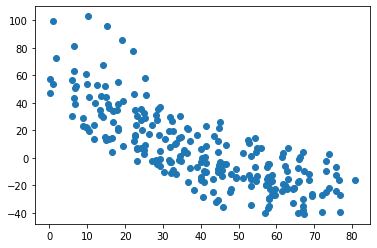

subject_15_stim_period_12_component_3   subject_12_stim_period_9_component_5   SpearmanrResult(correlation=-0.7511175543933232, pvalue=8.202365055929906e-45)   1.898368363651394


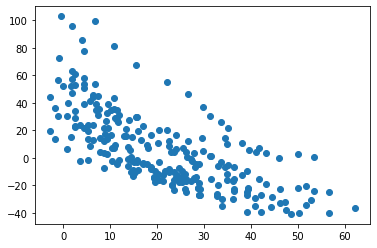

subject_15_stim_period_12_component_3   subject_15_stimulus_12_component_0   SpearmanrResult(correlation=0.8886525807739716, pvalue=1.5171147342369988e-82)   1.875811549461802


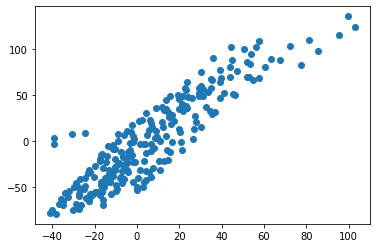

subject_15_stim_period_12_component_3   subject_15_stim_period_0_component_4   SpearmanrResult(correlation=0.7612700771577606, pvalue=1.1307465210051713e-63)   1.6107468900801596


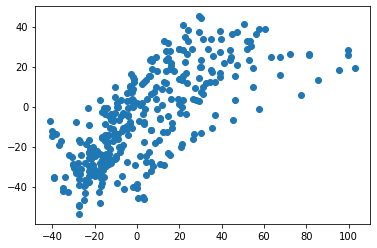

subject_15_stim_period_12_component_3   subject_15_stim_period_11_component_4   SpearmanrResult(correlation=0.8634203718814562, pvalue=1.1331111881282203e-72)   1.6107468900801596


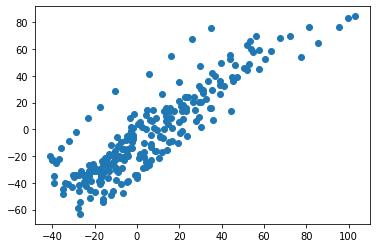

subject_15_stim_period_12_component_3   subject_15_stim_period_11_component_6   SpearmanrResult(correlation=0.803389815795413, pvalue=1.6636413001910148e-55)   1.6705353223965609


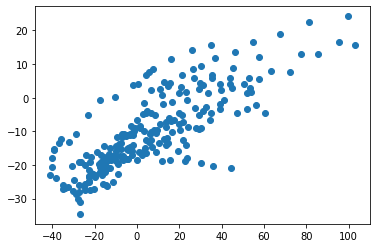

subject_15_stim_period_12_component_5   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=-0.7839989758062009, pvalue=3.419413299903583e-51)   2.8634261668185053


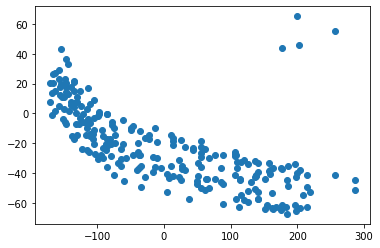

subject_15_stim_period_12_component_5   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.7639965017527787, pvalue=3.4621492240549583e-47)   2.5823939652762786


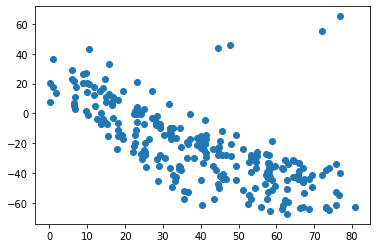

subject_15_stim_period_12_component_5   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=-0.7766801294063918, pvalue=1.1159066421386441e-49)   2.8923751520420273


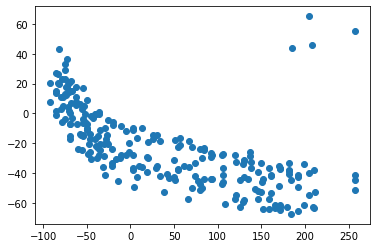

subject_15_stim_period_12_component_5   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=-0.7861422840449779, pvalue=1.2007676575083314e-51)   2.5257852148120397


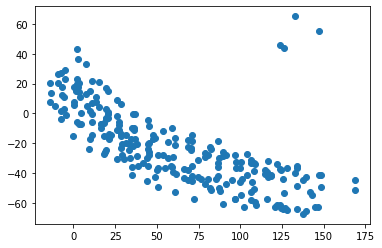

subject_15_stim_period_12_component_5   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=-0.7730567318411203, pvalue=5.9693414348031445e-49)   2.5206128960173433


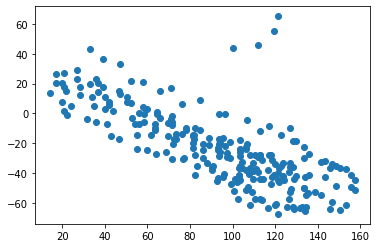

subject_15_stim_period_12_component_5   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=-0.761391370920632, pvalue=1.075930934885415e-46)   2.5823939652762786


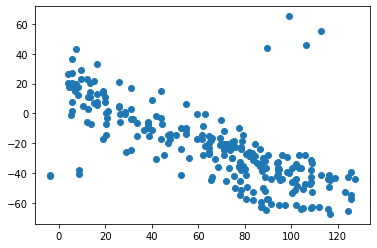

subject_15_stim_period_12_component_5   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=-0.8274726991788051, pvalue=1.3834094349815934e-61)   2.246092399248787


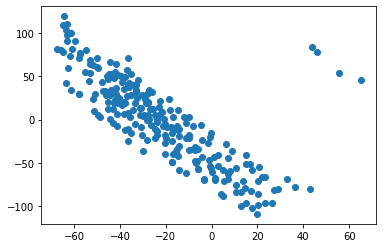

subject_15_stim_period_12_component_5   subject_15_stimulus_12_component_0   SpearmanrResult(correlation=0.7725420580218405, pvalue=7.555793167739742e-49)   2.3032119247396667


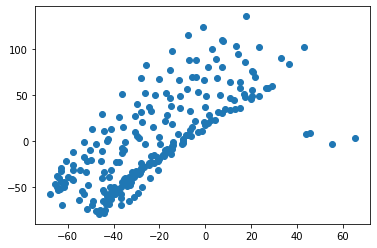

subject_15_stim_period_12_component_5   subject_15_stimulus_9_component_1   SpearmanrResult(correlation=0.8106338651712701, pvalue=3.049671018087688e-57)   3.0079951137030445


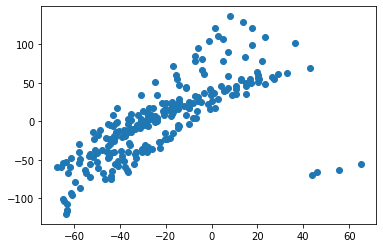

subject_15_stim_period_12_component_5   subject_15_stim_period_0_component_1   SpearmanrResult(correlation=0.7644360036279473, pvalue=1.6928992976060318e-64)   2.361729380880392


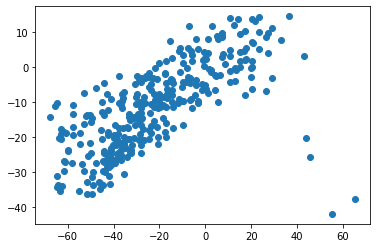

subject_15_stim_period_12_component_5   subject_15_stim_period_10_component_2   SpearmanrResult(correlation=-0.7664013264119168, pvalue=1.199741848127208e-47)   2.627889464537732


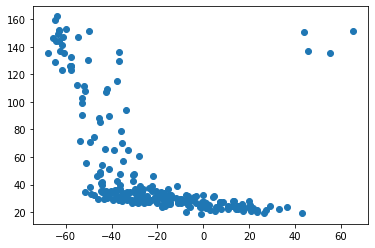

subject_15_stim_period_12_component_5   subject_15_stim_period_10_component_4   SpearmanrResult(correlation=0.7710923800760427, pvalue=1.4626416992470533e-48)   2.4779307688958


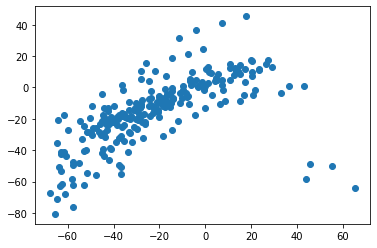

subject_15_stim_period_12_component_5   subject_15_stim_period_11_component_2   SpearmanrResult(correlation=0.7681782669838016, pvalue=5.437867828922294e-48)   2.627889464537732


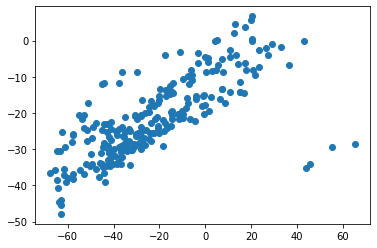

subject_15_stim_period_12_component_5   subject_15_stim_period_12_component_2   SpearmanrResult(correlation=-0.8593117936075279, pvalue=2.978420620979157e-71)   2.627889464537732


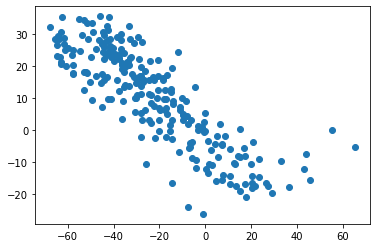

subject_15_stim_period_12_component_5   subject_15_stim_period_12_component_4   SpearmanrResult(correlation=-0.7773720029861628, pvalue=8.072444550865587e-50)   2.4779307688958


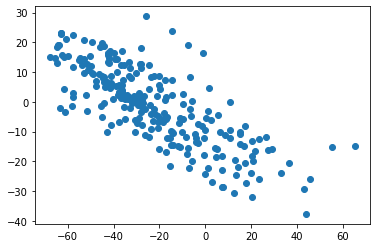

subject_15_stim_period_12_component_6   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=0.8084616838534816, pvalue=1.0299458270420335e-56)   3.1002562548065056


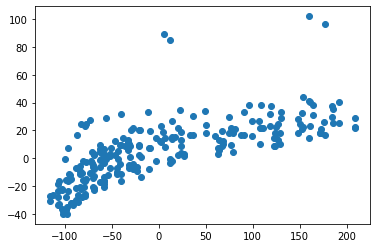

subject_15_stim_period_12_component_6   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=0.8658960944221183, pvalue=1.500599208405637e-73)   3.1002562548065056


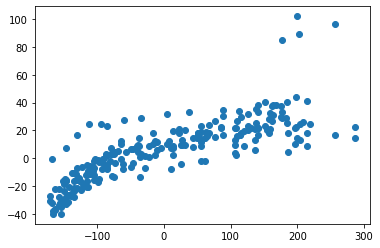

subject_15_stim_period_12_component_6   subject_12_stimulus_12_component_0   SpearmanrResult(correlation=0.7581186807382954, pvalue=4.380673666127053e-46)   3.0853082888651624


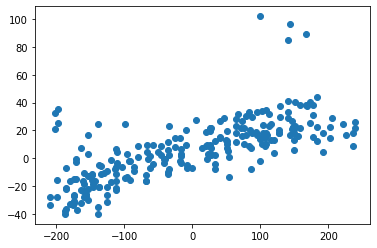

subject_15_stim_period_12_component_6   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=0.8272965801097574, pvalue=1.5445117743389682e-61)   3.0931807831083926


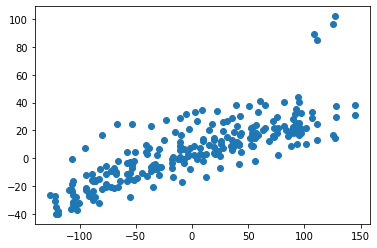

subject_15_stim_period_12_component_6   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=0.7943977969452491, pvalue=1.8999327408776486e-53)   3.1002562548065056


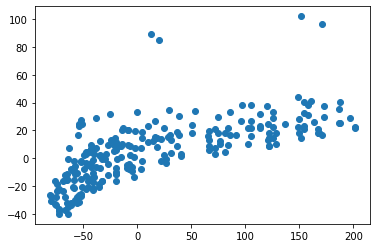

subject_15_stim_period_12_component_6   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=0.8062315668565525, pvalue=3.5357765509271735e-56)   2.681120501116906


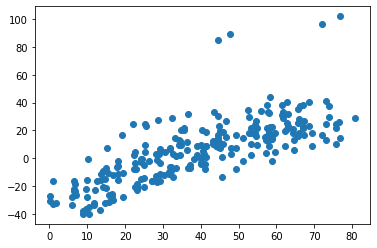

subject_15_stim_period_12_component_6   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=0.8680862793902976, pvalue=2.425402869397779e-74)   3.1002562548065056


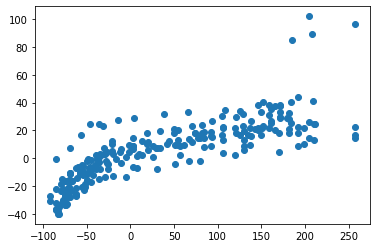

subject_15_stim_period_12_component_6   subject_12_stim_period_11_component_1   SpearmanrResult(correlation=0.8139644910327475, pvalue=4.5751335838586545e-58)   2.7335800674239437


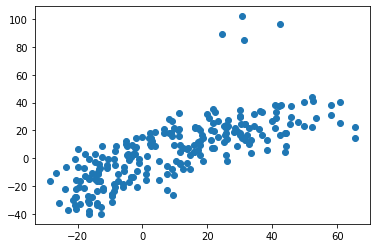

subject_15_stim_period_12_component_6   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=0.8654229866901891, pvalue=2.2151312477406832e-73)   2.45991644566301


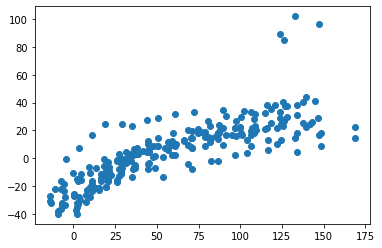

subject_15_stim_period_12_component_6   subject_12_stim_period_11_component_3   SpearmanrResult(correlation=0.8084547391528295, pvalue=1.033935378268452e-56)   2.268223995032806


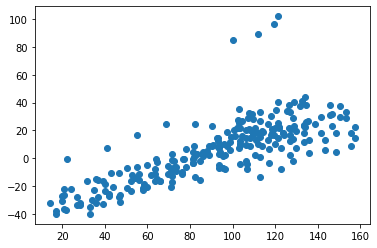

subject_15_stim_period_12_component_6   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=0.7841482868702228, pvalue=3.180228198439073e-51)   2.681120501116906


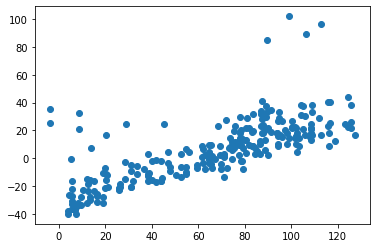

subject_15_stim_period_12_component_6   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=0.7559050574054151, pvalue=1.1181463043260133e-45)   1.5738097590697748


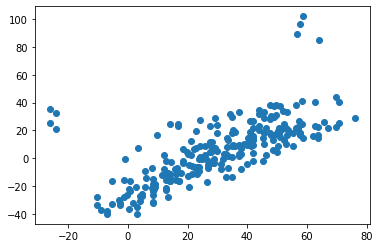

subject_15_stim_period_12_component_6   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=0.7625303018275885, pvalue=6.565616997085527e-47)   3.1002562548065056


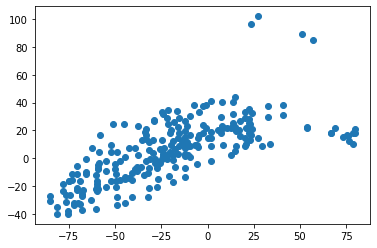

subject_15_stim_period_12_component_6   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=0.7858540789679128, pvalue=1.383175795856551e-51)   2.621331757149763


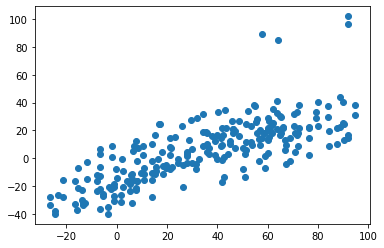

subject_15_stim_period_12_component_6   subject_15_stimulus_10_component_0   SpearmanrResult(correlation=0.8485859129498774, pvalue=9.495189951352956e-68)   3.2556656059636575


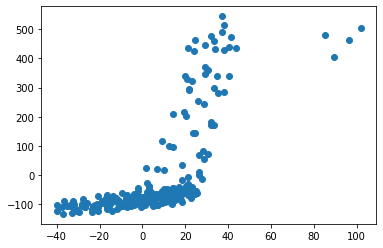

subject_15_stim_period_12_component_6   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=0.9268268546328928, pvalue=3.162536675325272e-103)   1.8389656547893622


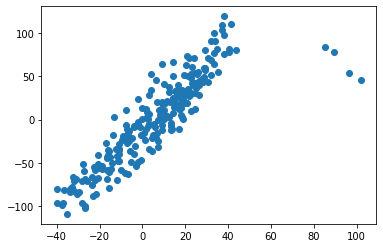

subject_15_stim_period_12_component_6   subject_15_stimulus_9_component_1   SpearmanrResult(correlation=-0.8995112762374345, pvalue=1.4760752895899412e-87)   3.1819199991609075


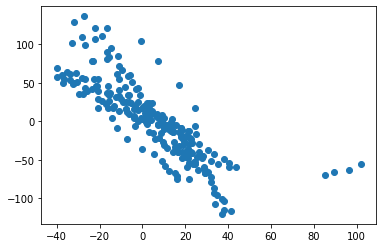

subject_15_stim_period_12_component_6   subject_15_stim_period_0_component_4   SpearmanrResult(correlation=-0.7614326977875444, pvalue=1.0263973647751942e-63)   2.8658894659811134


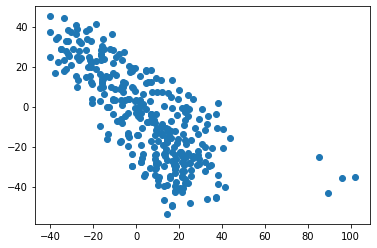

subject_15_stim_period_12_component_6   subject_15_stim_period_10_component_0   SpearmanrResult(correlation=0.8419503810830047, pvalue=1.0272190958774565e-65)   3.2556656059636575


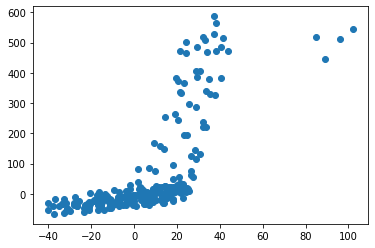

subject_15_stim_period_12_component_6   subject_15_stim_period_10_component_2   SpearmanrResult(correlation=0.8062014965537594, pvalue=3.594678050905086e-56)   2.6157615155809526


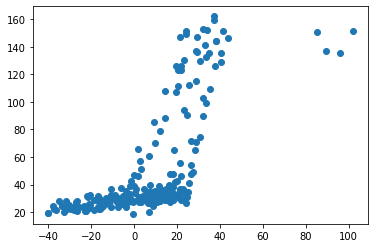

subject_15_stim_period_12_component_6   subject_15_stim_period_10_component_3   SpearmanrResult(correlation=0.7918687824441394, pvalue=6.903040238848993e-53)   1.6705353223965609


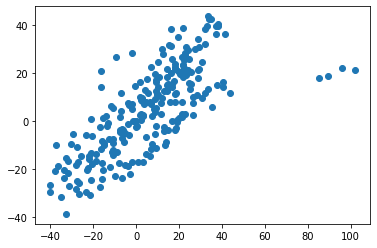

subject_15_stim_period_12_component_6   subject_15_stim_period_10_component_4   SpearmanrResult(correlation=-0.8075721800725705, pvalue=1.68776380766467e-56)   2.8658894659811134


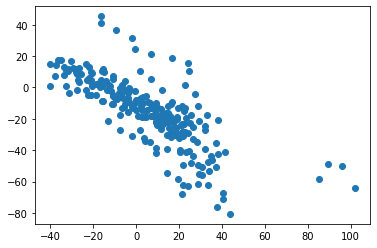

subject_15_stim_period_12_component_6   subject_15_stim_period_11_component_2   SpearmanrResult(correlation=-0.833099532978003, pvalue=3.8308281620305134e-63)   2.6157615155809526


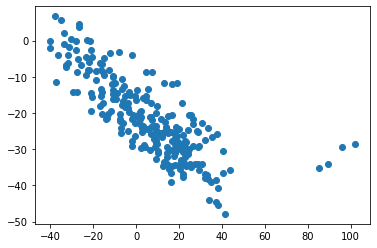

subject_15_stim_period_12_component_6   subject_15_stim_period_11_component_3   SpearmanrResult(correlation=0.8473419677424954, pvalue=2.323788611275284e-67)   1.6705353223965609


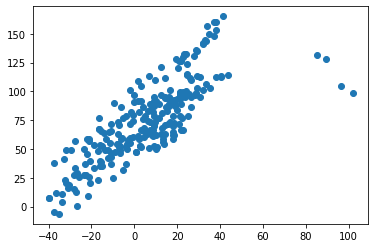

subject_15_stim_period_12_component_6   subject_15_stim_period_12_component_2   SpearmanrResult(correlation=0.7507291793260298, pvalue=9.62235010651873e-45)   2.6157615155809526


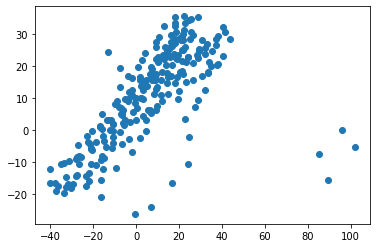

subject_15_stim_period_12_component_6   subject_15_stim_period_12_component_5   SpearmanrResult(correlation=-0.8275525616764179, pvalue=1.315949476046607e-61)   2.3473445414473577


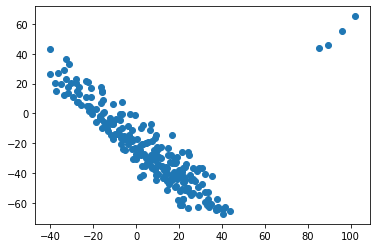

subject_15_stim_period_14_component_0   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.768384522970645, pvalue=7.309775160706169e-11)   5.41438820785841


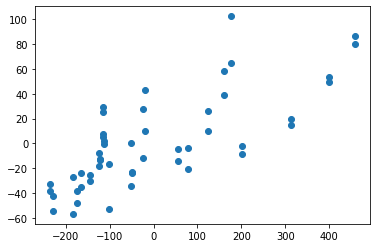

subject_15_stim_period_14_component_0   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.7655016395678037, pvalue=9.492048844243989e-11)   2.437889610964711


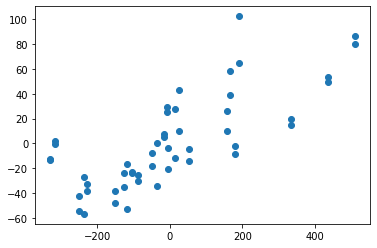

subject_15_stim_period_14_component_0   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.8191232708606525, pvalue=3.592693218668214e-13)   12.738704229100335


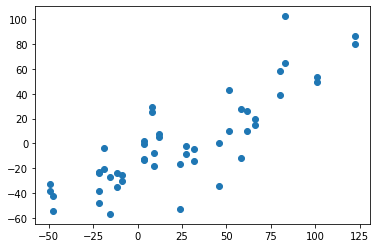

subject_15_stim_period_14_component_0   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.781261402170003, pvalue=2.1704527691880634e-11)   4.748588229066787


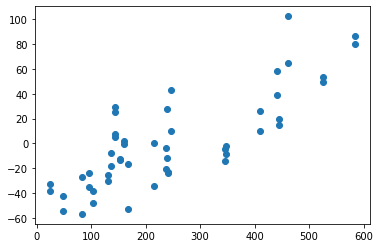

subject_15_stim_period_14_component_0   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.7751112509106081, pvalue=3.915022730933498e-11)   4.222003016344844


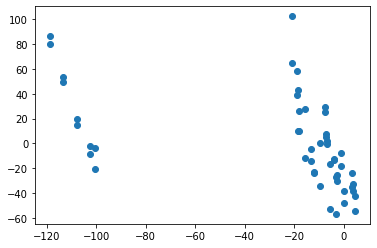

subject_15_stim_period_14_component_0   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.8936938548808152, pvalue=2.503460125112525e-18)   1.8385207449272798


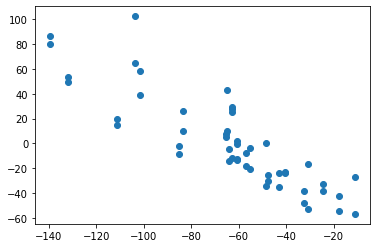

subject_15_stim_period_14_component_0   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.783567708892276, pvalue=1.7312309270915494e-11)   9.757612631521523


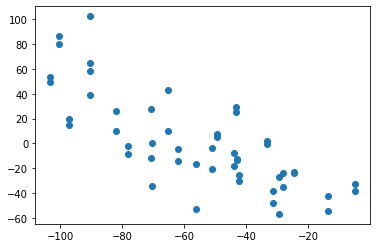

subject_15_stim_period_14_component_0   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.8075917372492872, pvalue=1.3776026843960739e-12)   12.738704229100335


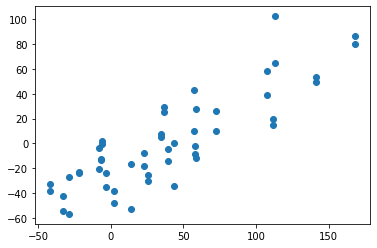

subject_15_stim_period_14_component_0   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=-0.7549310670907187, pvalue=2.3987037399424493e-10)   3.7382314619963006


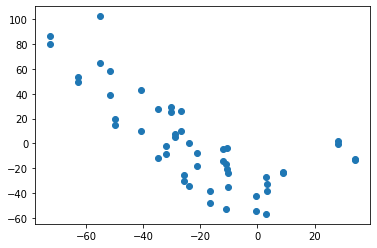

subject_15_stim_period_14_component_0   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.7503001200480192, pvalue=3.548571065875906e-10)   1.1704381930355783


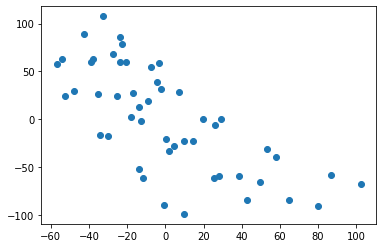

subject_15_stim_period_14_component_0   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.8801440576230493, pvalue=3.805643235424032e-17)   2.52484617672903


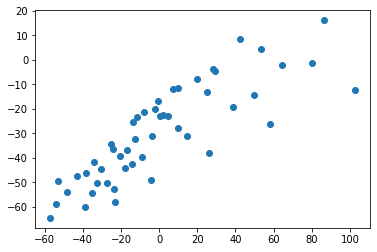

subject_15_stim_period_14_component_0   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.7935174069627852, pvalue=6.319255372949359e-12)   2.52484617672903


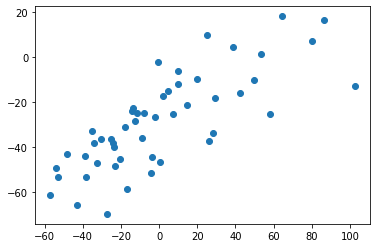

subject_15_stim_period_14_component_0   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=-0.7841800538376912, pvalue=5.001577614523441e-22)   4.1287067083632305


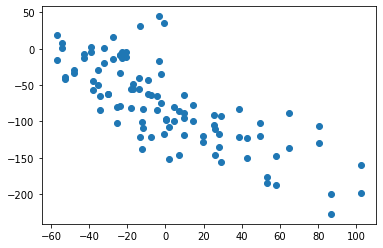

subject_15_stim_period_14_component_0   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=0.7984153661464586, pvalue=3.770117244425641e-12)   2.52484617672903


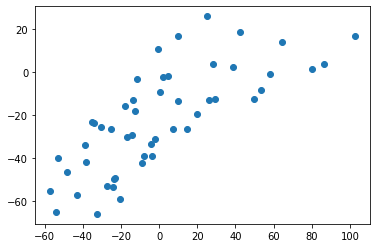

subject_15_stim_period_14_component_0   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.8401153984171491, pvalue=2.392259078929402e-14)   5.330381431026131


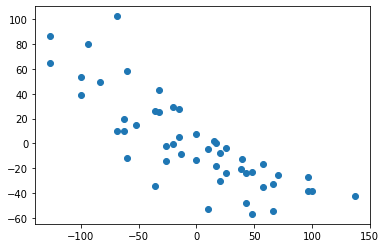

subject_15_stim_period_14_component_0   subject_14_stim_period_11_component_5   SpearmanrResult(correlation=0.7612299701446633, pvalue=1.3884954926896962e-10)   1.4096197383938618


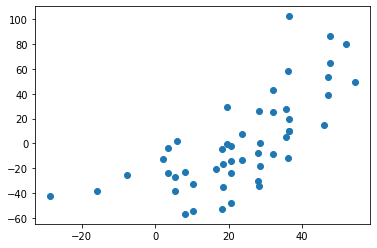

subject_15_stim_period_14_component_0   subject_14_stim_period_14_component_8   SpearmanrResult(correlation=0.7761287447634716, pvalue=3.555556370440779e-11)   5.8797009807126415


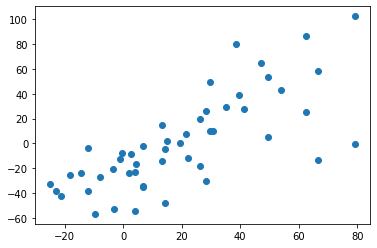

subject_15_stim_period_14_component_0   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.9389195678271309, pvalue=7.052697666400162e-24)   4.5772989738426695


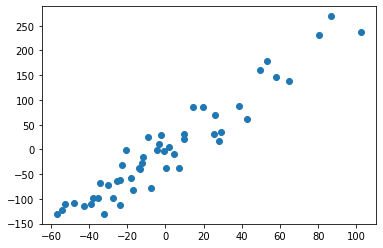

subject_15_stim_period_14_component_0   subject_15_stimulus_15_component_0   SpearmanrResult(correlation=0.8582472989195679, pvalue=1.6505430628442601e-15)   4.37095473073406


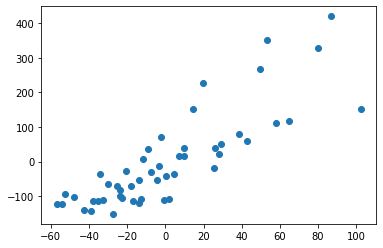

subject_15_stim_period_14_component_1   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8318079578331544, pvalue=7.306259945004405e-14)   2.97293646793067


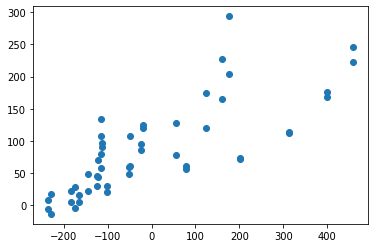

subject_15_stim_period_14_component_1   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.783567708892276, pvalue=1.7312309270915494e-11)   2.1274198726492553


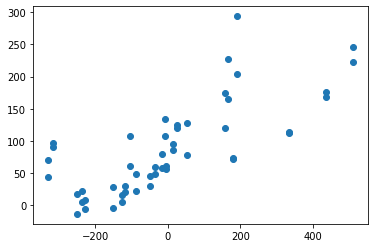

subject_15_stim_period_14_component_1   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.8075917372492872, pvalue=1.3776026843960739e-12)   3.2919237108479162


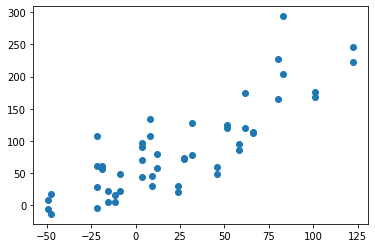

subject_15_stim_period_14_component_1   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.8671713275746749, pvalue=3.850843300378657e-16)   2.6462079176553974


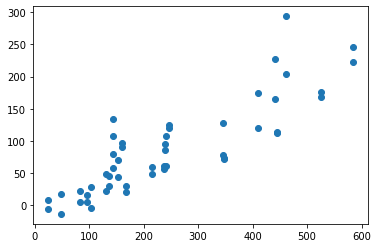

subject_15_stim_period_14_component_1   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.8279641132960326, pvalue=1.2001251227057973e-13)   2.7891209172035367


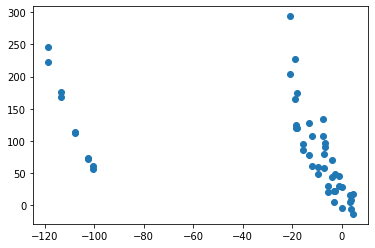

subject_15_stim_period_14_component_1   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.8704385954312284, pvalue=2.201106335556888e-16)   1.6481190748977765


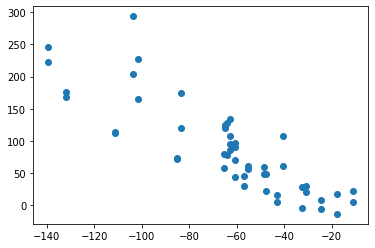

subject_15_stim_period_14_component_1   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.7776097498597372, pvalue=3.087711414365482e-11)   3.2919237108479162


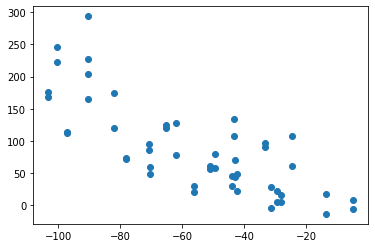

subject_15_stim_period_14_component_1   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.800480624855612, pvalue=3.0194372384631637e-12)   3.2919237108479162


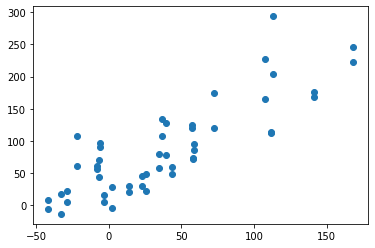

subject_15_stim_period_14_component_1   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.7626187561649622, pvalue=1.2280548508248388e-10)   2.6462079176553974


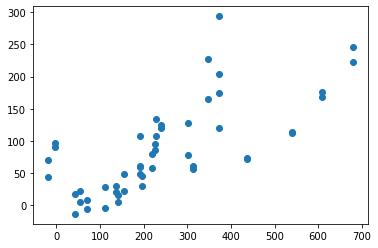

subject_15_stim_period_14_component_1   subject_12_stim_period_15_component_2   SpearmanrResult(correlation=-0.7681923307437889, pvalue=7.439063242094828e-11)   2.7644270770848585


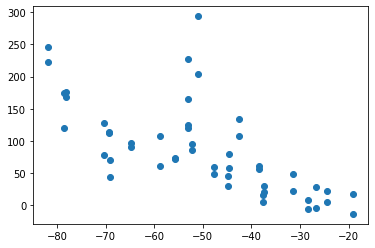

subject_15_stim_period_14_component_1   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.8505886160562489, pvalue=5.329947324028708e-15)   3.1045737432110116


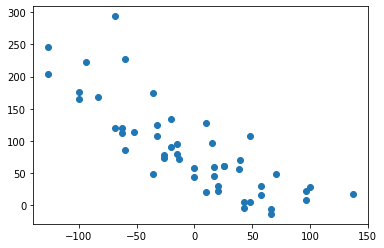

subject_15_stim_period_14_component_1   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.9552460984393756, pvalue=4.862830602681563e-27)   3.0454820226254604


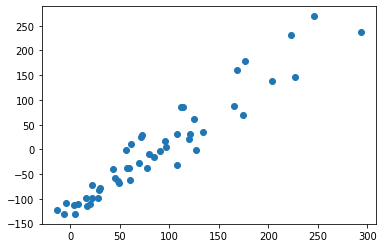

subject_15_stim_period_14_component_1   subject_15_stimulus_15_component_0   SpearmanrResult(correlation=0.8222328931572629, pvalue=2.4599093176692455e-13)   2.4914433148054798


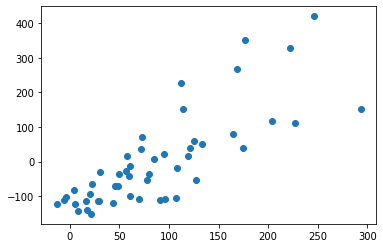

subject_15_stim_period_14_component_1   subject_15_stim_period_14_component_0   SpearmanrResult(correlation=0.9215366146458582, pvalue=2.3582660220726675e-21)   3.389313613223156


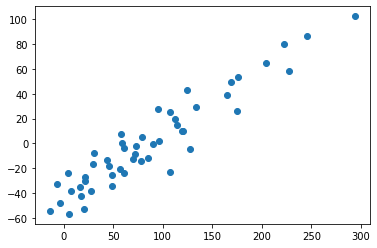

subject_15_stim_period_14_component_3   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=-0.8335376878748593, pvalue=5.820120981155754e-14)   2.0185208373485093


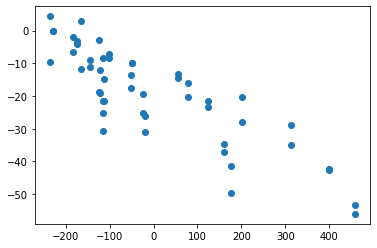

subject_15_stim_period_14_component_3   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=-0.8047088538464459, pvalue=1.900909124532233e-12)   1.436554547417094


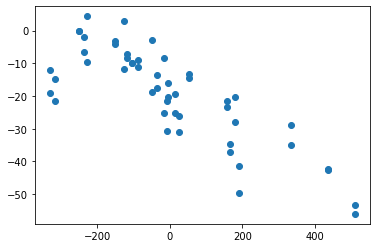

subject_15_stim_period_14_component_3   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=-0.8198920397680769, pvalue=3.2737455131092037e-13)   2.043469572823561


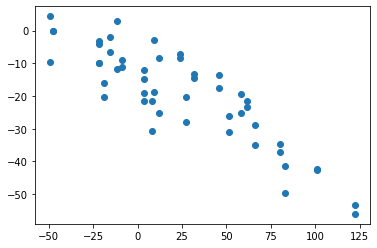

subject_15_stim_period_14_component_3   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=-0.8320001500600106, pvalue=7.124865640823167e-14)   1.9381237055672074


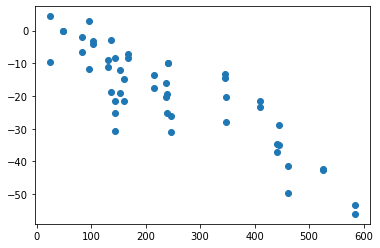

subject_15_stim_period_14_component_3   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=0.8496818349307708, pvalue=6.097047002968099e-15)   1.7779453312277227


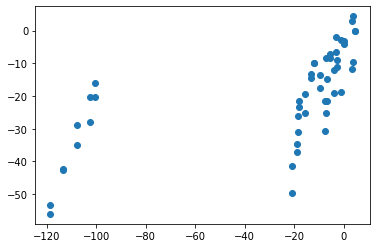

subject_15_stim_period_14_component_3   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=0.8919641248391104, pvalue=3.614488700326142e-18)   1.4114328655423236


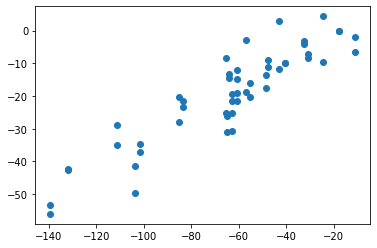

subject_15_stim_period_14_component_3   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=0.8295016511108814, pvalue=9.854990641679807e-14)   2.043469572823561


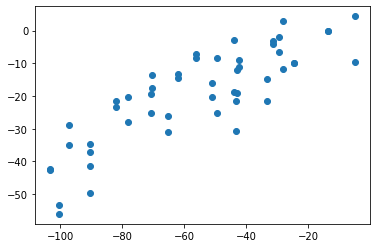

subject_15_stim_period_14_component_3   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=-0.826426575481184, pvalue=1.45867369415051e-13)   2.043469572823561


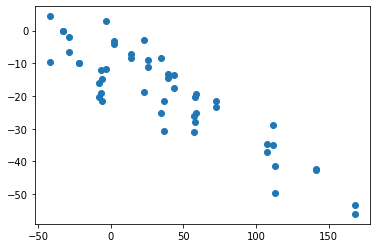

subject_15_stim_period_14_component_3   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=-0.7822223633042835, pvalue=1.9759665406416058e-11)   1.9381237055672074


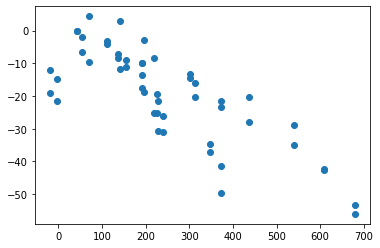

subject_15_stim_period_14_component_3   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=0.7722283675077668, pvalue=5.129500724385125e-11)   1.898368363651394


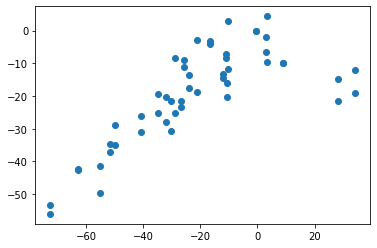

subject_15_stim_period_14_component_3   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=0.804657863145258, pvalue=1.9116741827433638e-12)   0.9584192311742299


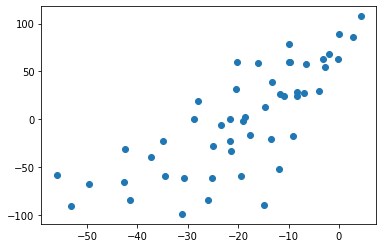

subject_15_stim_period_14_component_3   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=-0.7972629051620648, pvalue=4.262676540093625e-12)   1.4459954229381784


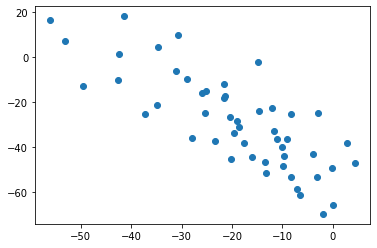

subject_15_stim_period_14_component_3   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=-0.7715246098439374, pvalue=5.4759722107265145e-11)   1.4459954229381784


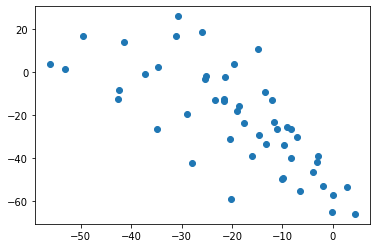

subject_15_stim_period_14_component_3   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=0.8834495374559933, pvalue=2.0216066743380725e-17)   2.0315723791081854


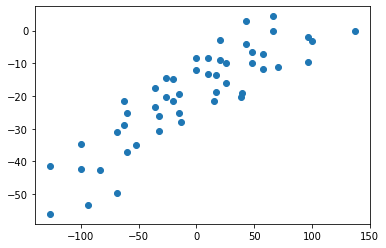

subject_15_stim_period_14_component_3   subject_14_stim_period_11_component_5   SpearmanrResult(correlation=-0.7856354497807307, pvalue=1.4102605143266275e-11)   1.0882834891668494


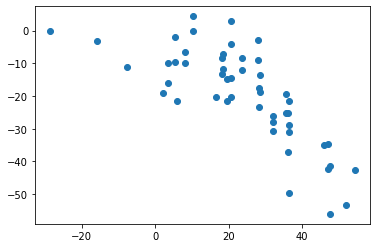

subject_15_stim_period_14_component_3   subject_14_stim_period_11_component_7   SpearmanrResult(correlation=-0.7825607436848483, pvalue=1.911499941815908e-11)   1.0097610780990327


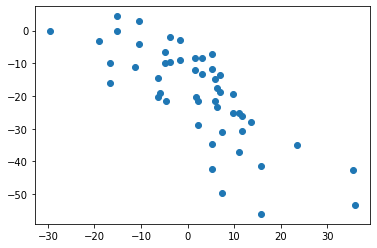

subject_15_stim_period_14_component_3   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=-0.9425690276110443, pvalue=1.6757273099665937e-24)   1.8742814801009815


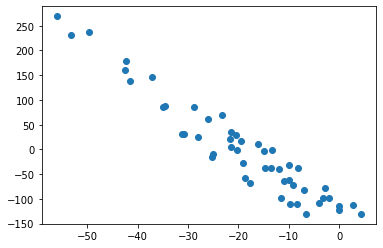

subject_15_stim_period_14_component_3   subject_15_stimulus_15_component_0   SpearmanrResult(correlation=-0.846530612244898, pvalue=9.663206289546315e-15)   2.011615823231916


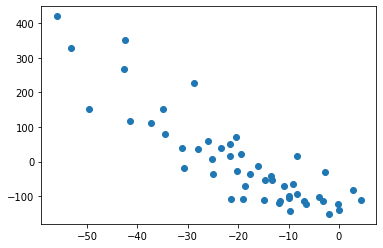

subject_15_stim_period_14_component_3   subject_15_stim_period_14_component_0   SpearmanrResult(correlation=-0.8561344537815125, pvalue=2.2961171307733973e-15)   2.2243768864288214


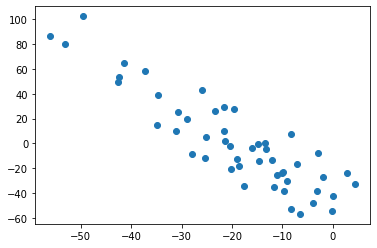

subject_15_stim_period_14_component_3   subject_15_stim_period_14_component_1   SpearmanrResult(correlation=-0.8925330132052821, pvalue=3.2054353829804487e-18)   1.7255348465874574


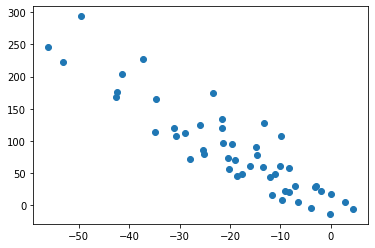

subject_15_stim_period_14_component_4   subject_13_stim_period_10_component_4   SpearmanrResult(correlation=-0.7961104441776711, pvalue=4.815812420653258e-12)   1.625258343877302


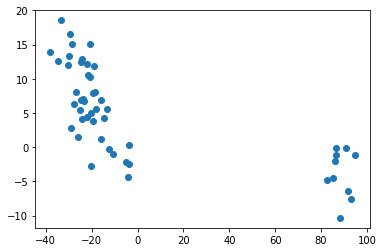

subject_15_stim_period_14_component_5   subject_12_stim_period_14_component_8   SpearmanrResult(correlation=-0.8304626122451617, pvalue=8.704467223040594e-14)   2.3066009044207707


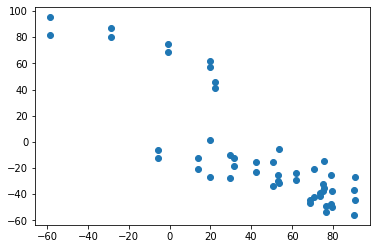

subject_15_stim_period_14_component_5   subject_15_stimulus_14_component_1   SpearmanrResult(correlation=0.8981032412965185, pvalue=9.532278934738684e-19)   2.861160263290186


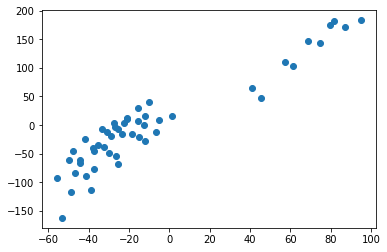

subject_15_stim_period_14_component_6   subject_12_stim_period_14_component_8   SpearmanrResult(correlation=0.7722283675077668, pvalue=5.129500724385125e-11)   2.621331757149763


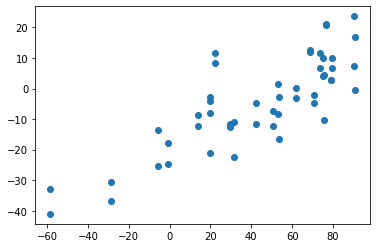

subject_15_stim_period_14_component_6   subject_12_stim_period_15_component_9   SpearmanrResult(correlation=0.7789550954477299, pvalue=2.7137670635389493e-11)   3.0687601918143796


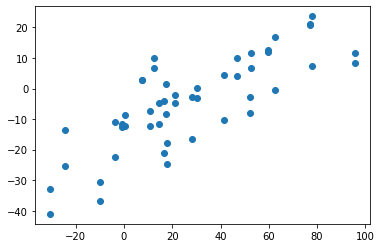

subject_15_stim_period_14_component_6   subject_13_stimulus_15_component_4   SpearmanrResult(correlation=-0.7861965579864196, pvalue=3.328872525515563e-22)   2.0514809916837486


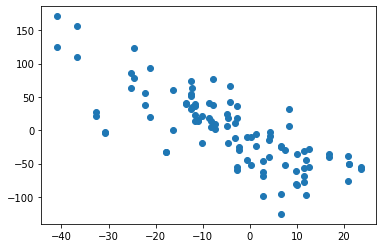

subject_15_stim_period_14_component_6   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=0.7914045618247298, pvalue=7.86285925543876e-12)   1.742392942871876


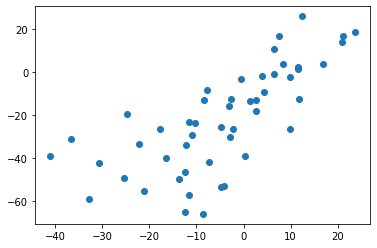

subject_15_stim_period_14_component_6   subject_13_stim_period_9_component_3   SpearmanrResult(correlation=0.7958223289315726, pvalue=4.964364100772878e-12)   2.0514809916837486


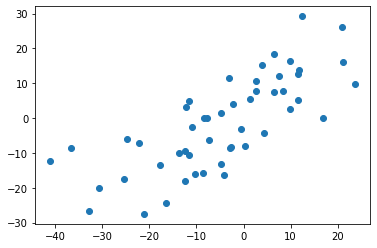

subject_15_stim_period_14_component_6   subject_14_stim_period_10_component_5   SpearmanrResult(correlation=0.7877012679389018, pvalue=1.1464274100128304e-11)   1.2981171129274576


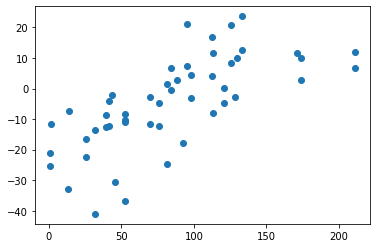

subject_15_stim_period_14_component_6   subject_14_stim_period_11_component_9   SpearmanrResult(correlation=-0.8246938256549884, pvalue=1.8132629681027416e-13)   2.066866525101611


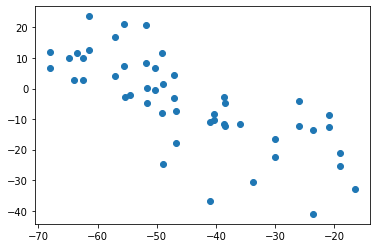

subject_15_stim_period_14_component_6   subject_14_stim_period_15_component_3   SpearmanrResult(correlation=-0.7589337394645469, pvalue=1.697978314458816e-10)   1.8197932683037097


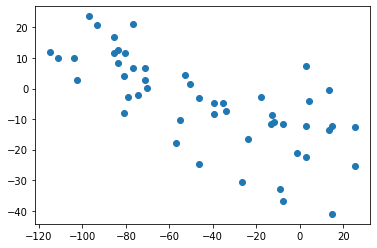

subject_15_stim_period_14_component_6   subject_14_stim_period_9_component_2   SpearmanrResult(correlation=0.7943311029581485, pvalue=5.805230698561327e-12)   3.137273782733125


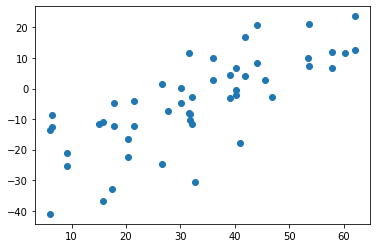

subject_15_stim_period_14_component_6   subject_14_stim_period_9_component_9   SpearmanrResult(correlation=-0.8175835678082601, pvalue=4.322301556837944e-13)   2.066866525101611


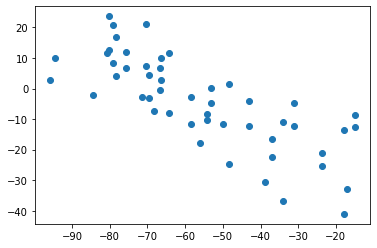

subject_15_stim_period_14_component_6   subject_15_stim_period_14_component_2   SpearmanrResult(correlation=-0.8009123649459783, pvalue=2.881548021912297e-12)   2.6157615155809526


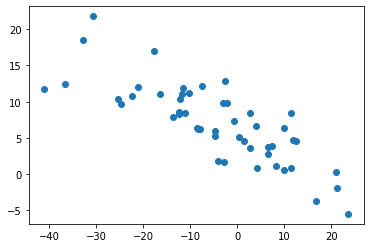

subject_15_stim_period_14_component_7   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.7528169525953018, pvalue=2.8713136993859634e-10)   3.684154402444655


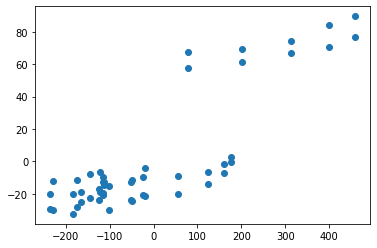

subject_15_stim_period_14_component_7   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.7608890261232574, pvalue=1.430807446789536e-10)   2.9642612029964663


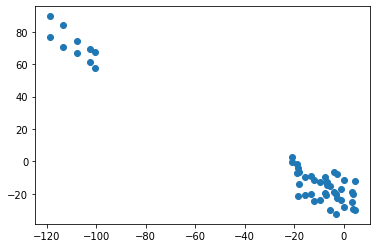

subject_15_stim_period_14_component_7   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.7511644657863146, pvalue=3.3005786231501945e-10)   3.6586688688919726


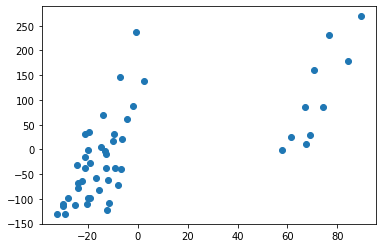

subject_15_stim_period_14_component_8   subject_13_stim_period_10_component_8   SpearmanrResult(correlation=-0.7994717887154862, pvalue=3.3664256048073355e-12)   1.9095224252452776


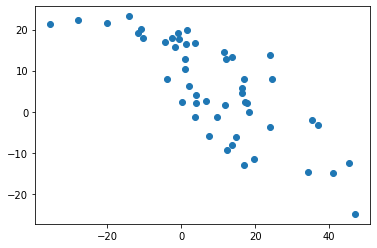

subject_15_stim_period_14_component_9   subject_15_stim_period_14_component_1   SpearmanrResult(correlation=-0.7506842737094839, pvalue=3.436255820142271e-10)   2.245523683723942


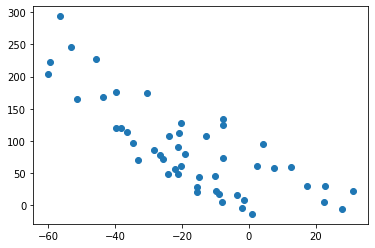

subject_15_stim_period_14_component_9   subject_15_stim_period_14_component_3   SpearmanrResult(correlation=0.8028331332533013, pvalue=2.3372730980568182e-12)   2.055274221847


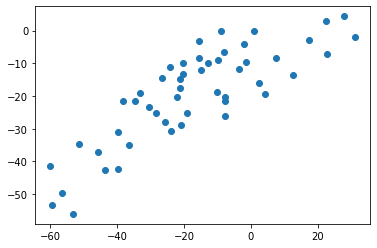

subject_15_stim_period_15_component_0   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8118199662401211, pvalue=8.506216414275752e-13)   5.41438820785841


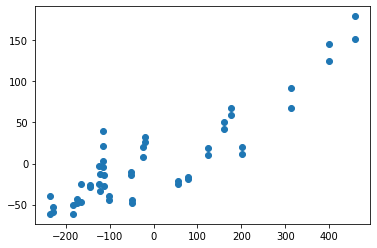

subject_15_stim_period_15_component_0   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.8556397939633095, pvalue=2.4787363384247134e-15)   2.437889610964711


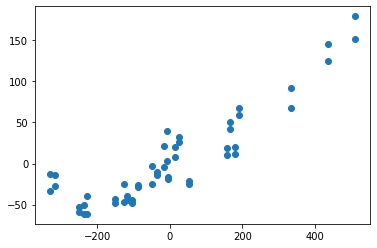

subject_15_stim_period_15_component_0   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.8742824399683502, pvalue=1.1176611300495517e-16)   12.738704229100335


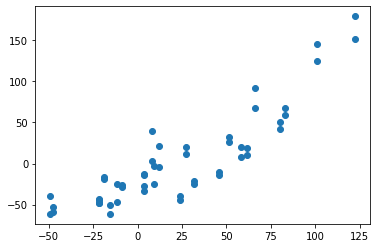

subject_15_stim_period_15_component_0   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.798558702587051, pvalue=3.7127721665436625e-12)   4.748588229066787


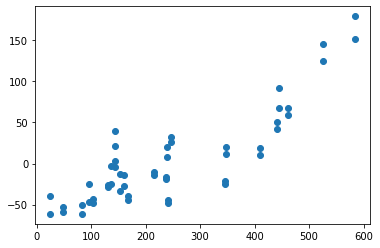

subject_15_stim_period_15_component_0   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.8168169641383795, pvalue=4.736015965627048e-13)   4.222003016344844


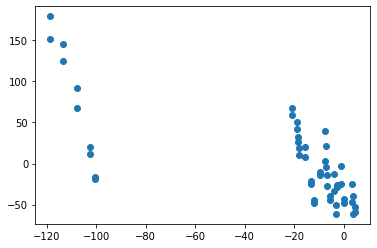

subject_15_stim_period_15_component_0   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.936168337016011, pvalue=1.9678388474521992e-23)   1.8385207449272798


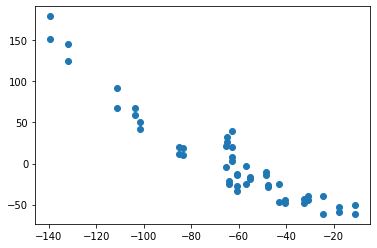

subject_15_stim_period_15_component_0   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.8775497078249036, pvalue=6.172473553957624e-17)   9.757612631521523


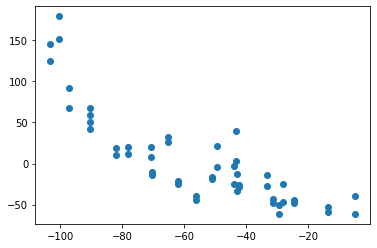

subject_15_stim_period_15_component_0   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.8965767382836565, pvalue=1.3381427565368084e-18)   12.738704229100335


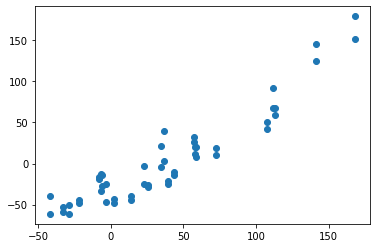

subject_15_stim_period_15_component_0   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.8262343832543277, pvalue=1.4944843411070185e-13)   4.748588229066787


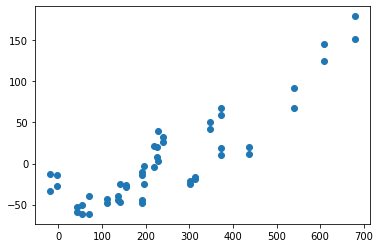

subject_15_stim_period_15_component_0   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=-0.8660181742135383, pvalue=4.674790168699979e-16)   3.7382314619963006


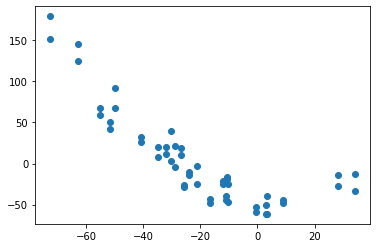

subject_15_stim_period_15_component_0   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=0.7549310670907187, pvalue=2.3987037399424493e-10)   1.8385207449272798


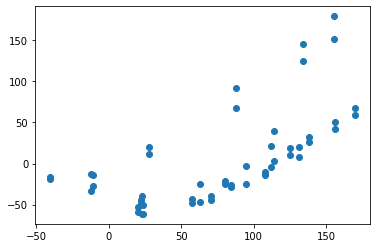

subject_15_stim_period_15_component_0   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.8595918367346939, pvalue=1.3340925329709767e-15)   2.52484617672903


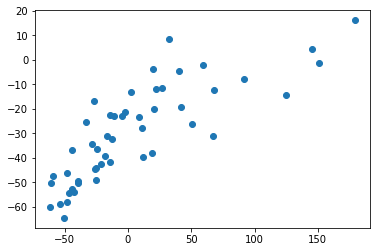

subject_15_stim_period_15_component_0   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.7884273709483793, pvalue=1.0653526935796771e-11)   2.52484617672903


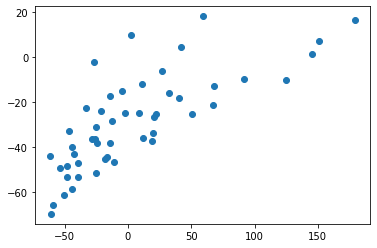

subject_15_stim_period_15_component_0   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=-0.7855483959386141, pvalue=3.7960884088114324e-22)   4.1287067083632305


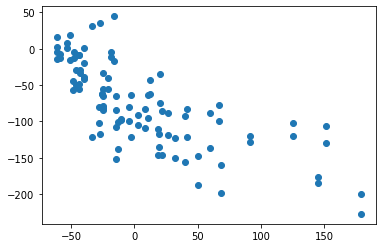

subject_15_stim_period_15_component_0   subject_14_stimulus_11_component_1   SpearmanrResult(correlation=-0.7913044391450141, pvalue=7.94422017990638e-12)   9.33907572472858


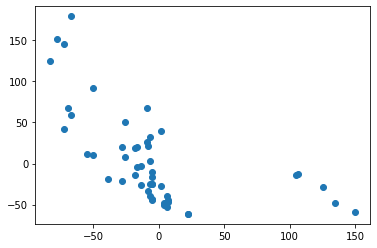

subject_15_stim_period_15_component_0   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.8937305859641004, pvalue=2.483841350792312e-18)   5.330381431026131


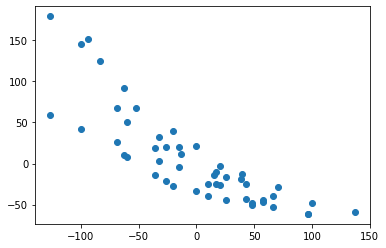

subject_15_stim_period_15_component_0   subject_14_stim_period_11_component_5   SpearmanrResult(correlation=0.840403652113638, pvalue=2.2987483494925747e-14)   1.4096197383938618


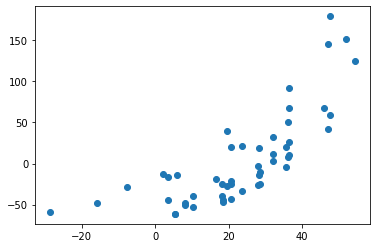

subject_15_stim_period_15_component_0   subject_14_stim_period_9_component_5   SpearmanrResult(correlation=0.8119626207267249, pvalue=8.367210807286869e-13)   1.4096197383938618


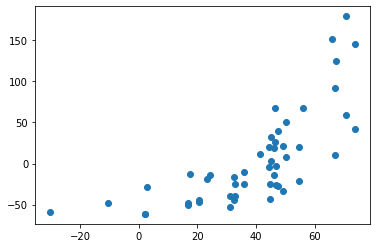

subject_15_stim_period_15_component_0   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.8984873949579832, pvalue=8.74499960546064e-19)   4.5772989738426695


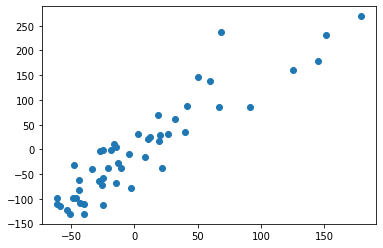

subject_15_stim_period_15_component_0   subject_15_stimulus_15_component_0   SpearmanrResult(correlation=0.962641056422569, pvalue=6.927232861943769e-29)   4.37095473073406


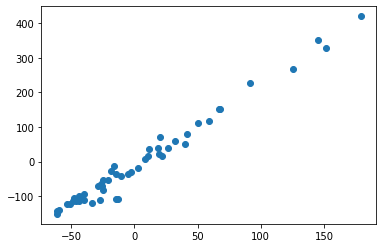

subject_15_stim_period_15_component_0   subject_15_stim_period_14_component_0   SpearmanrResult(correlation=0.9123169267707082, pvalue=3.0520649480926915e-20)   18.05541073359642


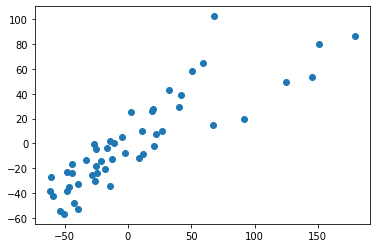

subject_15_stim_period_15_component_0   subject_15_stim_period_14_component_1   SpearmanrResult(correlation=0.8333733493397358, pvalue=5.947900122280753e-14)   3.389313613223156


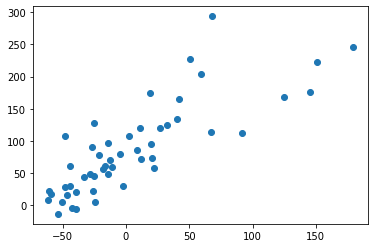

subject_15_stim_period_15_component_0   subject_15_stim_period_14_component_3   SpearmanrResult(correlation=-0.8645858343337334, pvalue=5.933036360845208e-16)   2.2243768864288214


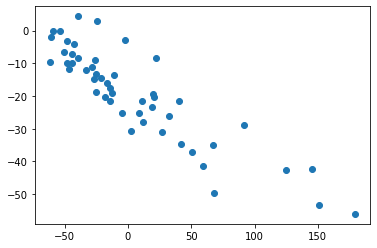

subject_15_stim_period_15_component_1   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8368049557314127, pvalue=3.760698491905515e-14)   2.97293646793067


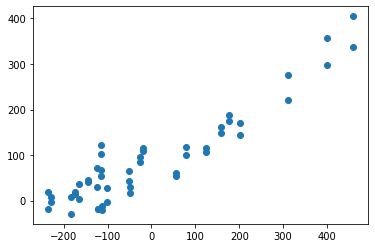

subject_15_stim_period_15_component_1   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.9559641363821882, pvalue=3.325207773045492e-27)   2.1274198726492553


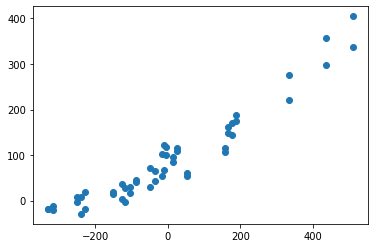

subject_15_stim_period_15_component_1   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.7803004410357225, pvalue=2.382963757858704e-11)   3.2919237108479162


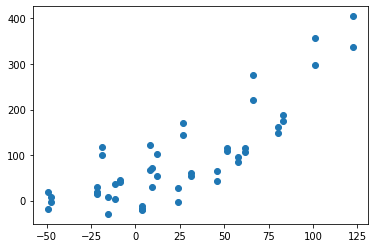

subject_15_stim_period_15_component_1   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.7960602036379218, pvalue=4.841409412217275e-12)   2.6462079176553974


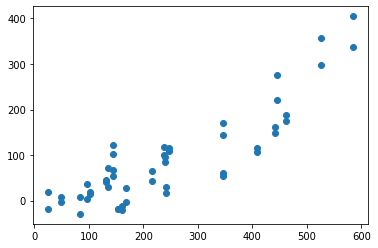

subject_15_stim_period_15_component_1   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.8510271805187634, pvalue=4.992765868384686e-15)   2.7891209172035367


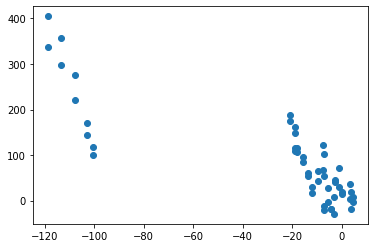

subject_15_stim_period_15_component_1   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.8475677204353537, pvalue=8.313712569871583e-15)   1.6481190748977765


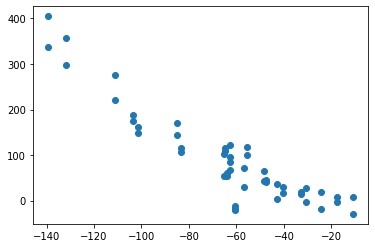

subject_15_stim_period_15_component_1   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.8560241784170217, pvalue=2.3356843992236916e-15)   3.2919237108479162


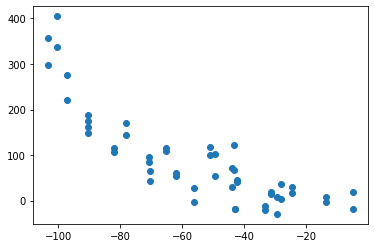

subject_15_stim_period_15_component_1   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.8606367918615678, pvalue=1.1289636274905885e-15)   3.2919237108479162


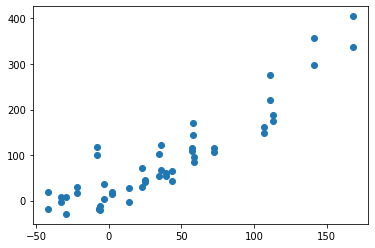

subject_15_stim_period_15_component_1   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.9507749462570737, pvalue=4.544673766964873e-26)   2.6462079176553974


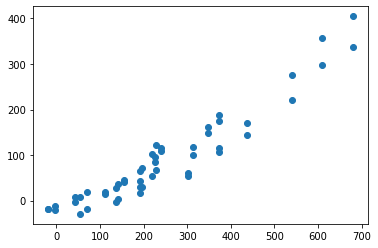

subject_15_stim_period_15_component_1   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=-0.9013815439550588, pvalue=4.516742980782273e-19)   2.6409439863920894


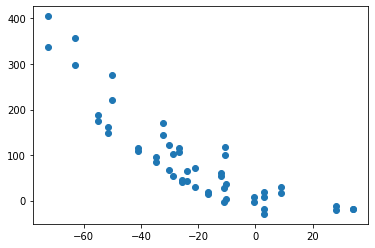

subject_15_stim_period_15_component_1   subject_12_stim_period_15_component_6   SpearmanrResult(correlation=-0.8815857445888815, pvalue=2.894731392473284e-17)   1.542302383930191


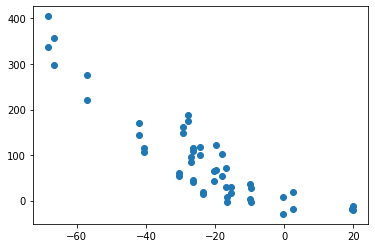

subject_15_stim_period_15_component_1   subject_14_stimulus_11_component_1   SpearmanrResult(correlation=-0.8423253434235647, pvalue=1.7585952167229756e-14)   3.333246024897503


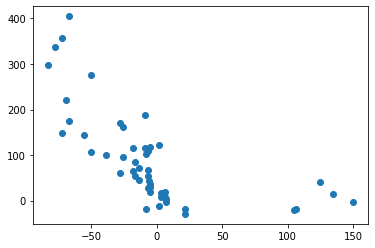

subject_15_stim_period_15_component_1   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.8129234663816881, pvalue=7.485579701566789e-13)   3.1045737432110116


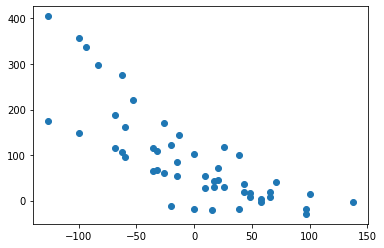

subject_15_stim_period_15_component_1   subject_14_stim_period_11_component_5   SpearmanrResult(correlation=0.7809273060714107, pvalue=2.242215000008747e-11)   1.2585608383230367


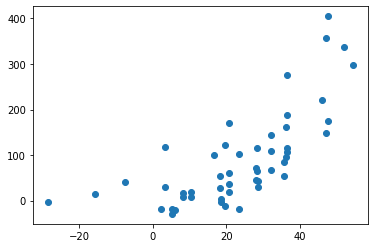

subject_15_stim_period_15_component_1   subject_14_stim_period_9_component_5   SpearmanrResult(correlation=0.7647850990680274, pvalue=1.012301683996167e-10)   1.2585608383230367


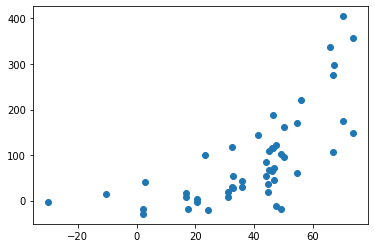

subject_15_stim_period_15_component_1   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.8219447779111644, pvalue=2.5485550245106405e-13)   3.0454820226254604


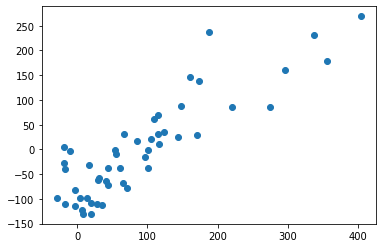

subject_15_stim_period_15_component_1   subject_15_stimulus_15_component_0   SpearmanrResult(correlation=0.9734933973589435, pvalue=2.0720505509316065e-32)   2.4914433148054798


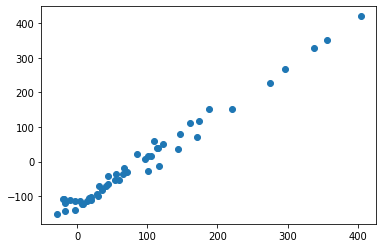

subject_15_stim_period_15_component_1   subject_15_stim_period_14_component_0   SpearmanrResult(correlation=0.7689315726290517, pvalue=6.953304376295678e-11)   3.389313613223156


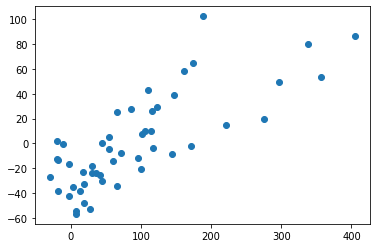

subject_15_stim_period_15_component_1   subject_15_stim_period_14_component_3   SpearmanrResult(correlation=-0.7760384153661464, pvalue=3.586159368269802e-11)   1.7255348465874574


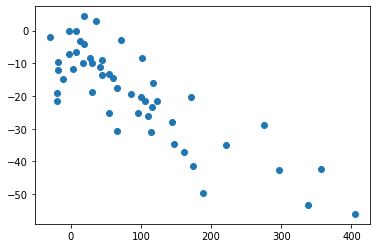

subject_15_stim_period_15_component_1   subject_15_stim_period_15_component_0   SpearmanrResult(correlation=0.9000240096038417, pvalue=6.173114164587031e-19)   3.389313613223156


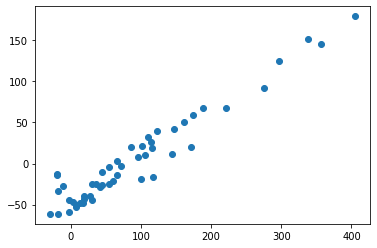

subject_15_stim_period_15_component_2   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=-0.8156638107772429, pvalue=5.429780334352424e-13)   3.4303983670978706


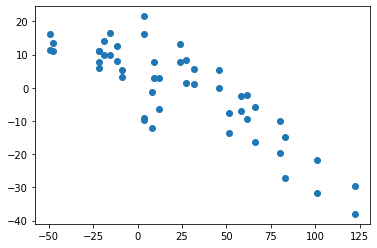

subject_15_stim_period_15_component_2   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=0.8106668128789846, pvalue=9.713122621637827e-13)   1.7443988060514803


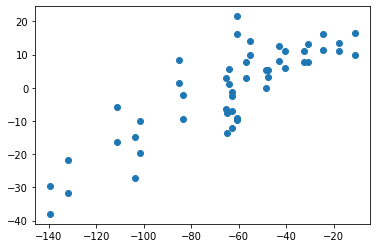

subject_15_stim_period_15_component_2   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=0.757621758266704, pvalue=1.9029615371800391e-10)   3.4303983670978706


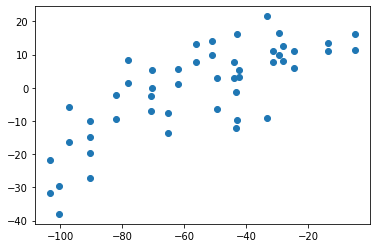

subject_15_stim_period_15_component_2   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=-0.832961111194291, pvalue=6.280262637098505e-14)   3.4303983670978706


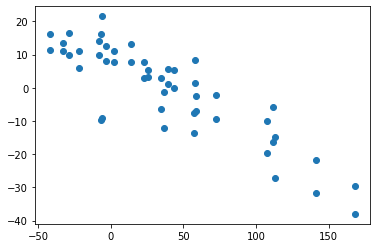

subject_15_stim_period_15_component_2   subject_12_stim_period_15_component_3   SpearmanrResult(correlation=-0.7624265639381063, pvalue=1.2491628700351994e-10)   2.7265076474862635


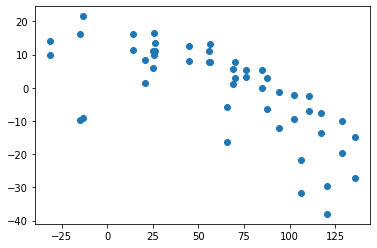

subject_15_stim_period_15_component_2   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=0.7916397824202318, pvalue=7.674810433391044e-12)   2.8404577907314428


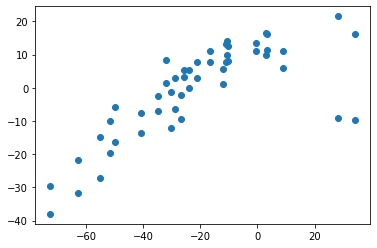

subject_15_stim_period_15_component_2   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=-0.7872193612025418, pvalue=1.203424946539076e-11)   1.7443988060514803


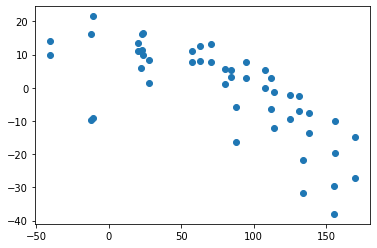

subject_15_stim_period_15_component_2   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=-0.7754621848739495, pvalue=3.787326596669229e-11)   1.816750683361978


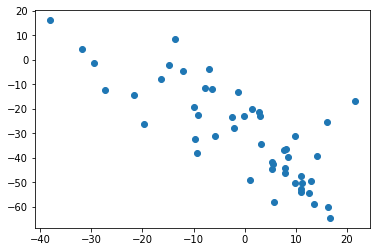

subject_15_stim_period_15_component_2   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=0.8503886067209444, pvalue=4.3965038945042404e-29)   1.8267727879008016


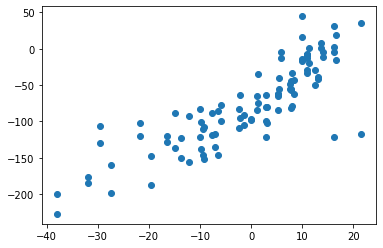

subject_15_stim_period_15_component_2   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=0.7568581224145804, pvalue=2.0328116383149185e-10)   3.43196490155092


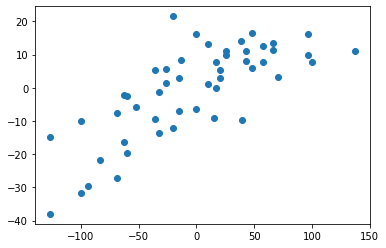

subject_15_stim_period_15_component_2   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=-0.8222328931572629, pvalue=2.4599093176692455e-13)   2.9946468442612186


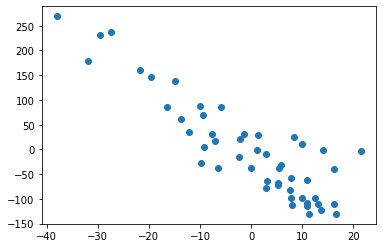

subject_15_stim_period_15_component_2   subject_15_stimulus_15_component_0   SpearmanrResult(correlation=-0.8244417767106842, pvalue=1.8712049377704768e-13)   2.625886318476502


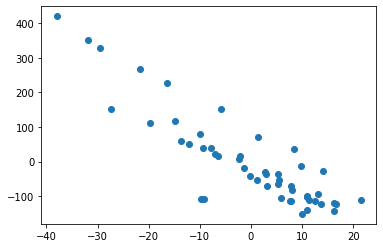

subject_15_stim_period_15_component_2   subject_15_stim_period_14_component_0   SpearmanrResult(correlation=-0.8634333733493396, pvalue=7.173210199939934e-16)   3.675917022440573


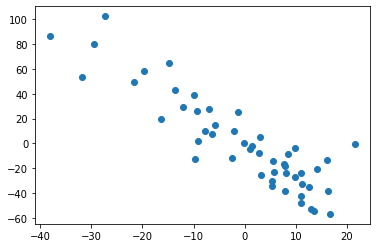

subject_15_stim_period_15_component_2   subject_15_stim_period_14_component_1   SpearmanrResult(correlation=-0.8404801920768307, pvalue=2.2745085018135425e-14)   2.6827925845579808


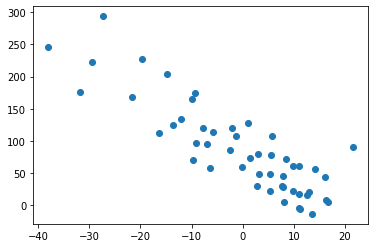

subject_15_stim_period_15_component_2   subject_15_stim_period_14_component_3   SpearmanrResult(correlation=0.766626650660264, pvalue=8.575854562092592e-11)   1.919771157974983


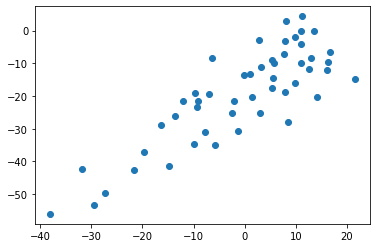

subject_15_stim_period_15_component_2   subject_15_stim_period_15_component_0   SpearmanrResult(correlation=-0.88062424969988, pvalue=3.475536558575289e-17)   3.675917022440573


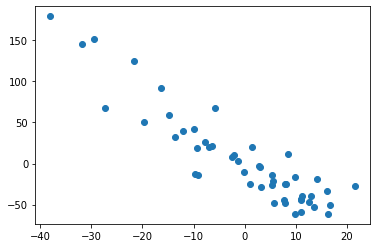

subject_15_stim_period_15_component_3   subject_12_stim_period_15_component_3   SpearmanrResult(correlation=0.8177779252726599, pvalue=4.222998712759519e-13)   1.7779453312277227


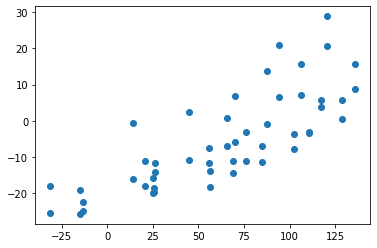

subject_15_stim_period_15_component_3   subject_12_stim_period_15_component_5   SpearmanrResult(correlation=-0.8014415859898922, pvalue=2.720662437771477e-12)   1.898368363651394


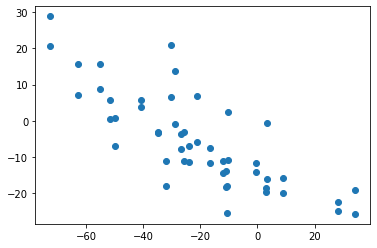

subject_15_stim_period_15_component_3   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=0.8452614137130808, pvalue=1.159887376463289e-14)   1.4114328655423236


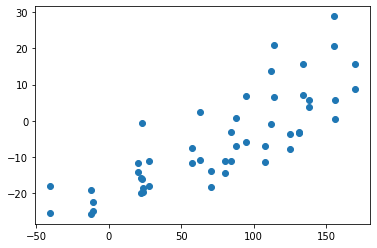

subject_15_stim_period_15_component_3   subject_12_stim_period_15_component_9   SpearmanrResult(correlation=0.7731893286420471, pvalue=4.689770965854716e-11)   2.043469572823561


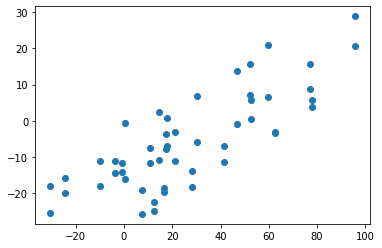

subject_15_stim_period_15_component_3   subject_13_stim_period_12_component_0   SpearmanrResult(correlation=0.836734693877551, pvalue=3.796564999965311e-14)   1.4459954229381784


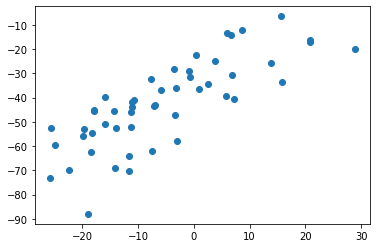

subject_15_stim_period_15_component_4   subject_12_stimulus_15_component_1   SpearmanrResult(correlation=0.7724205597346229, pvalue=5.038549111613583e-11)   3.5489352903364013


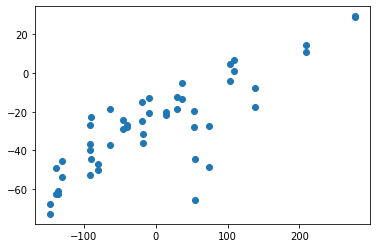

subject_15_stim_period_15_component_4   subject_12_stim_period_15_component_3   SpearmanrResult(correlation=-0.9027268895430514, pvalue=3.299223148861414e-19)   3.1731085479830687


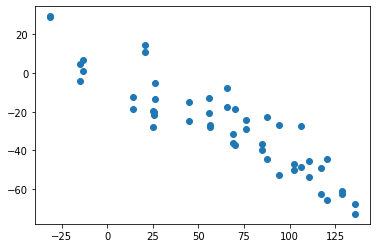

subject_15_stim_period_15_component_4   subject_12_stim_period_15_component_4   SpearmanrResult(correlation=-0.8454536059399368, pvalue=1.1283764226685102e-14)   1.1979935164227973


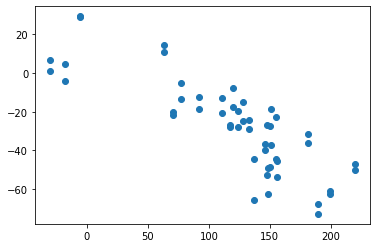

subject_15_stim_period_15_component_4   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=-0.8767809389174793, pvalue=7.108625809067862e-17)   1.6955622136919384


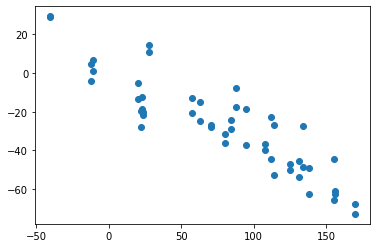

subject_15_stim_period_15_component_4   subject_12_stim_period_15_component_9   SpearmanrResult(correlation=-0.7774175576328811, pvalue=3.144953437981455e-11)   4.590126461790123


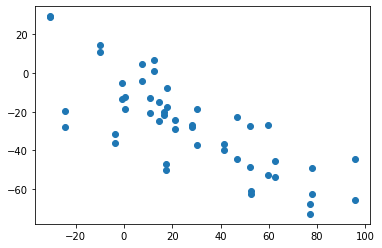

subject_15_stim_period_15_component_4   subject_13_stim_period_11_component_1   SpearmanrResult(correlation=-0.7857382953181272, pvalue=1.395868227940406e-11)   2.644288851178242


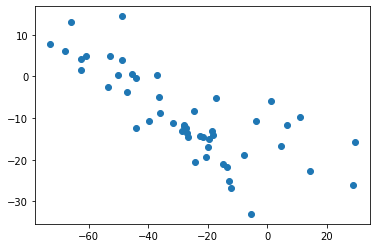

subject_15_stim_period_15_component_4   subject_15_stimulus_15_component_1   SpearmanrResult(correlation=0.7841056422569028, pvalue=1.6416482918129058e-11)   2.914607696365159


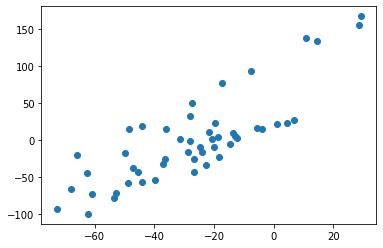

subject_15_stim_period_15_component_5   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.7680001385169327, pvalue=7.570511390571251e-11)   2.5206128960173433


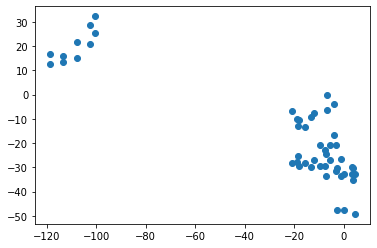

subject_15_stim_period_15_component_6   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.826426575481184, pvalue=1.45867369415051e-13)   3.1002562548065056


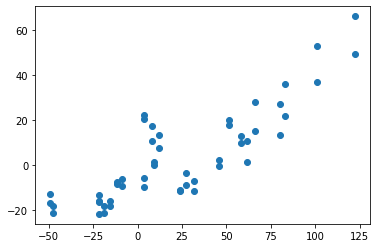

subject_15_stim_period_15_component_6   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.8254656143469035, pvalue=1.646251022774603e-13)   1.5738097590697748


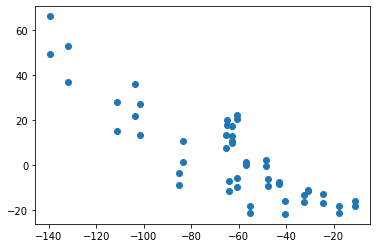

subject_15_stim_period_15_component_6   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.8056698149807262, pvalue=1.7084688068221317e-12)   3.1002562548065056


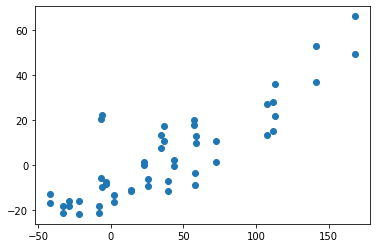

subject_15_stim_period_15_component_6   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=0.7533935292758701, pvalue=2.73436782649573e-10)   1.5738097590697748


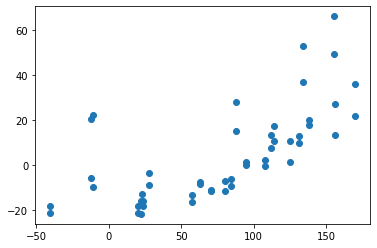

subject_15_stim_period_15_component_6   subject_12_stim_period_15_component_9   SpearmanrResult(correlation=0.763964101752955, pvalue=1.0894665238111118e-10)   3.0687601918143796


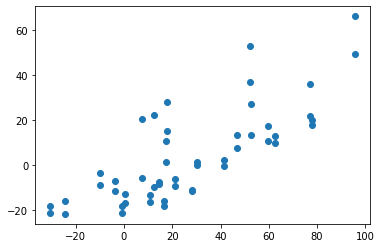

subject_15_stim_period_15_component_6   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.7691236494597838, pvalue=6.832089429830626e-11)   1.0280588391308296


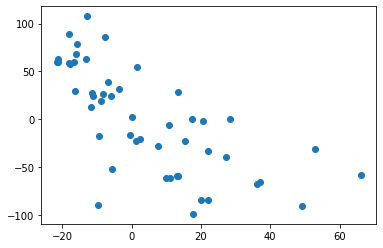

subject_15_stim_period_15_component_6   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.828859543817527, pvalue=1.0702742557752405e-13)   1.742392942871876


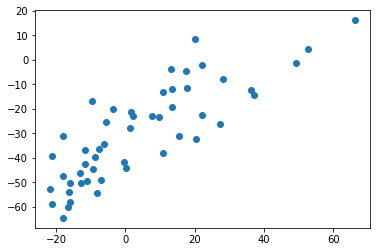

subject_15_stim_period_15_component_6   subject_13_stim_period_11_component_0   SpearmanrResult(correlation=0.788811524609844, pvalue=1.0246863126116218e-11)   1.742392942871876


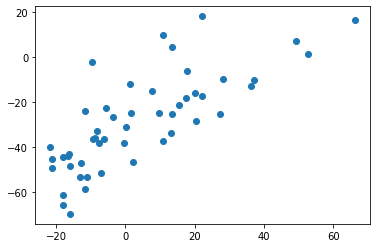

subject_15_stim_period_15_component_6   subject_13_stim_period_14_component_2   SpearmanrResult(correlation=0.8098424697304388, pvalue=1.974826723872769e-24)   1.7058746067626687


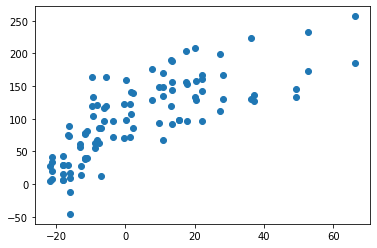

subject_15_stim_period_15_component_6   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=-0.8878379694830456, pvalue=8.326160416268181e-35)   1.7058746067626687


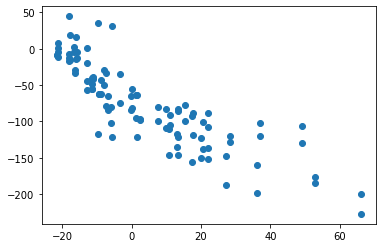

subject_15_stim_period_15_component_6   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=0.8017767106842737, pvalue=2.623227027496075e-12)   1.742392942871876


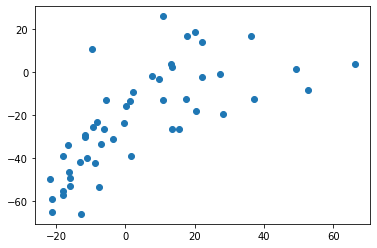

subject_15_stim_period_15_component_6   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=0.7854913229324862, pvalue=1.430666323557701e-11)   3.174636420095762


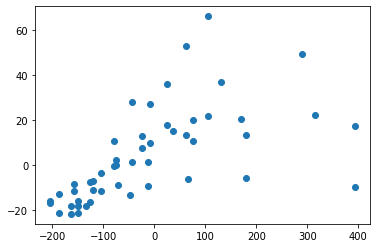

subject_15_stim_period_15_component_6   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.7877973525043982, pvalue=1.1353729956858955e-11)   3.089194104307898


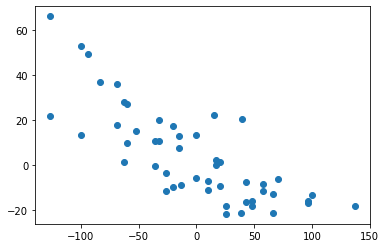

subject_15_stim_period_15_component_6   subject_14_stim_period_10_component_0   SpearmanrResult(correlation=0.772231652893993, pvalue=5.127933010268797e-11)   3.174636420095762


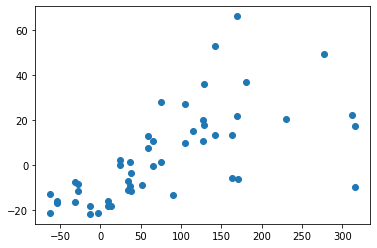

subject_15_stim_period_15_component_6   subject_14_stim_period_11_component_5   SpearmanrResult(correlation=0.7521499787052603, pvalue=3.037805646132728e-10)   1.2981171129274576


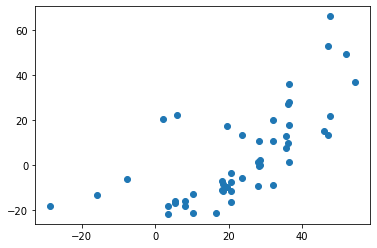

subject_15_stim_period_15_component_6   subject_14_stim_period_11_component_9   SpearmanrResult(correlation=-0.751765640443275, pvalue=3.137842507990169e-10)   2.066866525101611


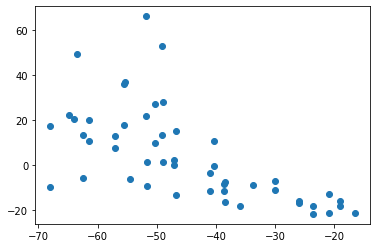

subject_15_stim_period_15_component_6   subject_14_stim_period_15_component_3   SpearmanrResult(correlation=-0.7634005983829826, pvalue=1.1456118956856191e-10)   1.8197932683037097


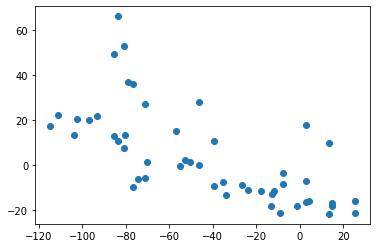

subject_15_stim_period_15_component_6   subject_14_stim_period_9_component_2   SpearmanrResult(correlation=0.7672352554881838, pvalue=8.115728636964942e-11)   3.137273782733125


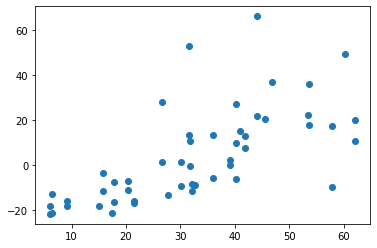

subject_15_stim_period_15_component_6   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.7814165666266506, pvalue=2.137868566140964e-11)   2.9253993595262844


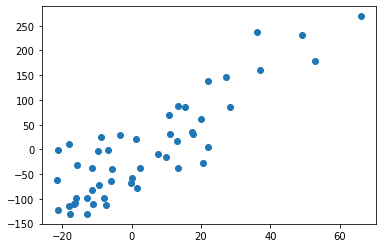

subject_15_stim_period_15_component_6   subject_15_stimulus_15_component_0   SpearmanrResult(correlation=0.7644177671068426, pvalue=1.0461653720125645e-10)   2.0868284954349146


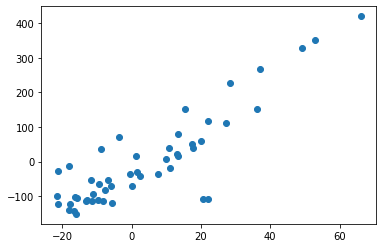

subject_15_stim_period_15_component_6   subject_15_stim_period_14_component_0   SpearmanrResult(correlation=0.8516206482593036, pvalue=4.5686744196177166e-15)   3.2556656059636575


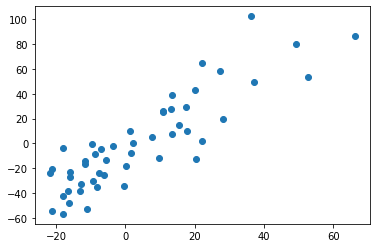

subject_15_stim_period_15_component_6   subject_15_stim_period_14_component_1   SpearmanrResult(correlation=0.773829531812725, pvalue=4.4168763703459335e-11)   2.5050375977433923


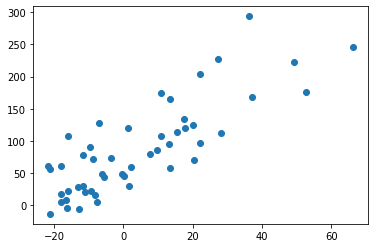

subject_15_stim_period_15_component_6   subject_15_stim_period_14_component_3   SpearmanrResult(correlation=-0.786314525810324, pvalue=1.3177682390954932e-11)   1.6705353223965609


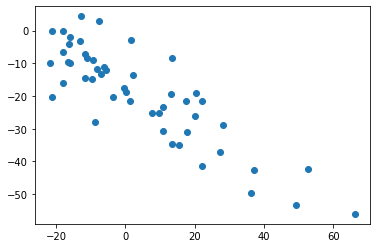

subject_15_stim_period_15_component_6   subject_15_stim_period_15_component_0   SpearmanrResult(correlation=0.881296518607443, pvalue=3.058923152081648e-17)   3.2556656059636575


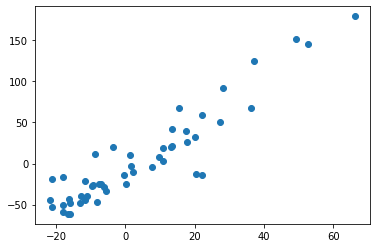

subject_15_stim_period_15_component_6   subject_15_stim_period_15_component_2   SpearmanrResult(correlation=-0.9179831932773109, pvalue=6.5547992961403096e-21)   2.6157615155809526


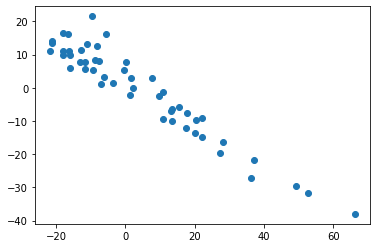

subject_15_stim_period_15_component_7   subject_12_stimulus_15_component_1   SpearmanrResult(correlation=0.9459701405856715, pvalue=4.023885159083355e-25)   3.3623039211208985


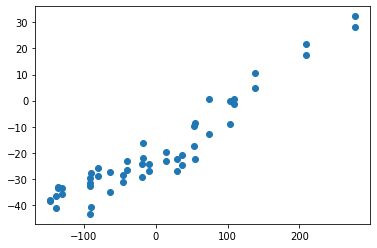

subject_15_stim_period_15_component_7   subject_15_stimulus_15_component_1   SpearmanrResult(correlation=0.9359423769507803, pvalue=2.1365103504731342e-23)   2.820925822254986


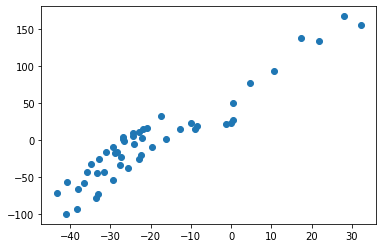

subject_15_stim_period_15_component_9   subject_12_stim_period_14_component_0   SpearmanrResult(correlation=0.8108590051058406, pvalue=9.501285131144864e-13)   3.340389736843476


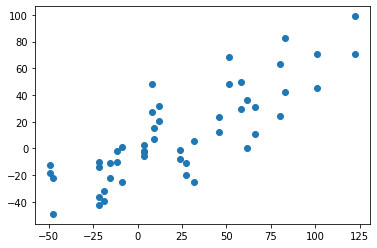

subject_15_stim_period_15_component_9   subject_12_stim_period_15_component_0   SpearmanrResult(correlation=0.774919058683752, pvalue=3.986672094452165e-11)   3.340389736843476


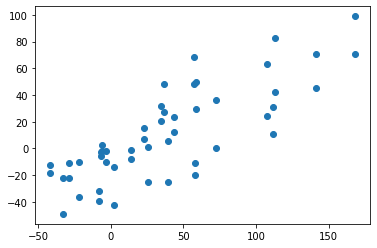

subject_15_stim_period_15_component_9   subject_12_stim_period_15_component_3   SpearmanrResult(correlation=0.8156638107772429, pvalue=5.429780334352424e-13)   2.6352296097835937


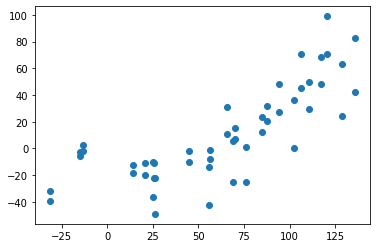

subject_15_stim_period_15_component_9   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=0.8519881416530438, pvalue=4.3234884183574116e-15)   1.6333838974368333


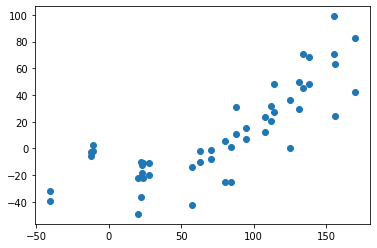

subject_15_stim_period_15_component_9   subject_12_stim_period_15_component_9   SpearmanrResult(correlation=0.8708229798849406, pvalue=2.058882787394537e-16)   3.376931541806334


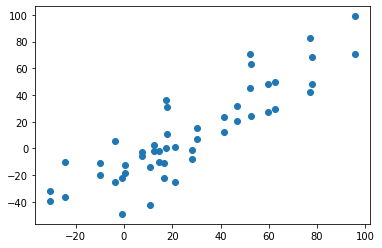

subject_15_stim_period_15_component_9   subject_13_stimulus_14_component_0   SpearmanrResult(correlation=0.756045019762574, pvalue=9.63597211667152e-20)   1.5040694272371966


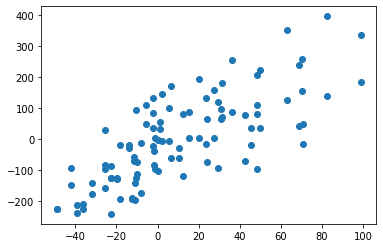

subject_15_stim_period_15_component_9   subject_13_stimulus_9_component_0   SpearmanrResult(correlation=-0.7563505402160864, pvalue=2.123704673142661e-10)   1.1076601783254816


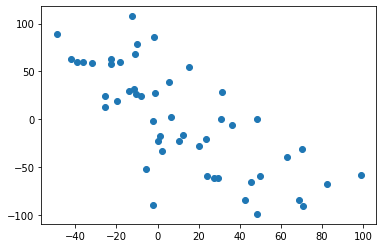

subject_15_stim_period_15_component_9   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.7838175270108042, pvalue=1.6890677516513856e-11)   1.773566218265596


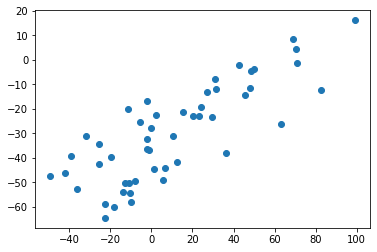

subject_15_stim_period_15_component_9   subject_13_stim_period_11_component_1   SpearmanrResult(correlation=0.7669147659063624, pvalue=8.355038317354347e-11)   2.4016778354223556


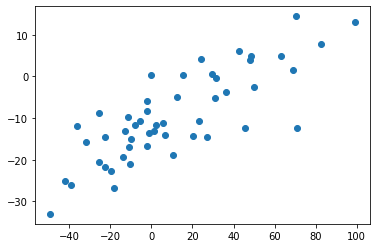

subject_15_stim_period_15_component_9   subject_13_stim_period_14_component_2   SpearmanrResult(correlation=0.7612303161450188, pvalue=3.8599072149933134e-20)   1.520855263640322


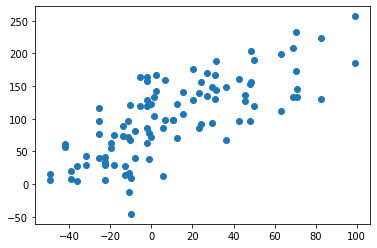

subject_15_stim_period_15_component_9   subject_13_stim_period_15_component_2   SpearmanrResult(correlation=-0.8216294165997924, pvalue=1.1637421751371289e-25)   1.520855263640322


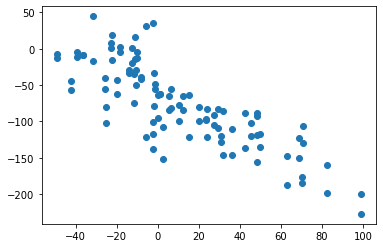

subject_15_stim_period_15_component_9   subject_13_stim_period_9_component_0   SpearmanrResult(correlation=0.8070588235294118, pvalue=1.462680313871224e-12)   1.773566218265596


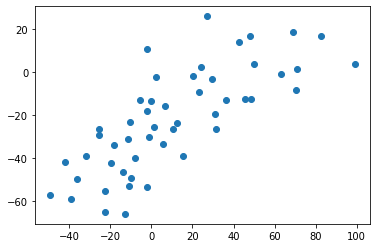

subject_15_stim_period_15_component_9   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.780735136940418, pvalue=2.2845033912751554e-11)   3.015091665448718


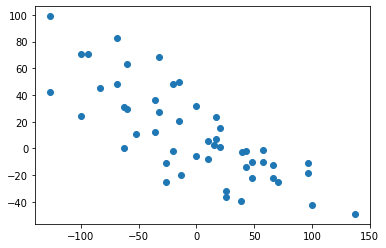

subject_15_stim_period_15_component_9   subject_14_stim_period_11_component_5   SpearmanrResult(correlation=0.8034110943975515, pvalue=2.193602747835802e-12)   1.1875969262690356


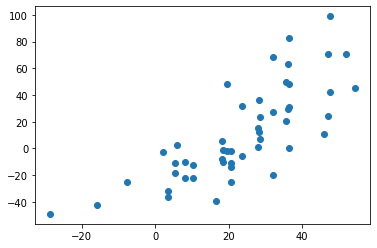

subject_15_stim_period_15_component_9   subject_14_stim_period_11_component_7   SpearmanrResult(correlation=0.7820803208573666, pvalue=2.0036364554243417e-11)   1.1351592315275532


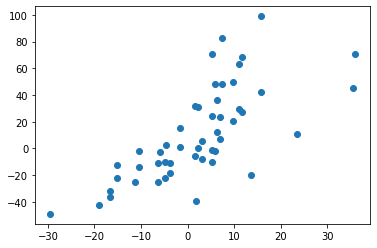

subject_15_stim_period_15_component_9   subject_14_stim_period_14_component_3   SpearmanrResult(correlation=0.7576369094559688, pvalue=1.900466283755611e-10)   1.2140264884503313


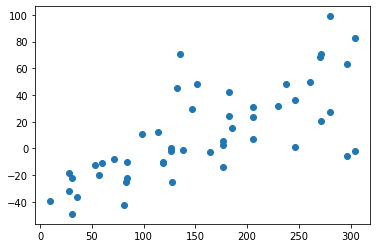

subject_15_stim_period_15_component_9   subject_14_stim_period_14_component_8   SpearmanrResult(correlation=0.7872238459479731, pvalue=1.2028823547164015e-11)   3.304650034223256


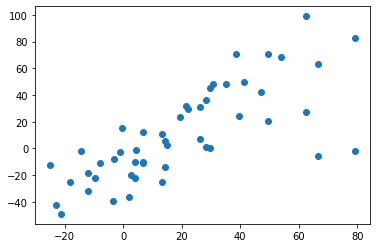

subject_15_stim_period_15_component_9   subject_15_stim_period_14_component_0   SpearmanrResult(correlation=0.8327971188475389, pvalue=6.417323770533216e-14)   3.914979564963942


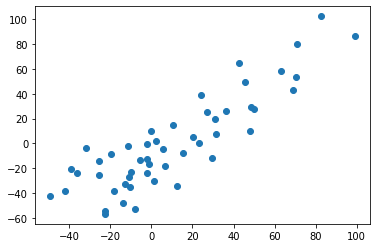

subject_15_stim_period_15_component_9   subject_15_stim_period_15_component_0   SpearmanrResult(correlation=0.8161824729891957, pvalue=5.1065853391888e-13)   3.914979564963942


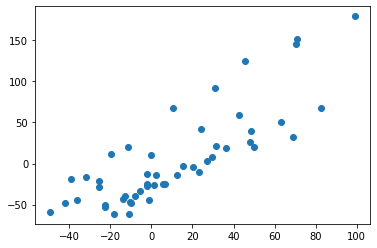

subject_15_stim_period_15_component_9   subject_15_stim_period_15_component_2   SpearmanrResult(correlation=-0.840672268907563, pvalue=2.2147440193898204e-14)   2.533545795637383


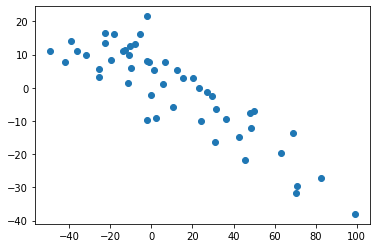

subject_15_stim_period_15_component_9   subject_15_stim_period_15_component_3   SpearmanrResult(correlation=0.7917887154861944, pvalue=7.557956128259398e-12)   2.055274221847


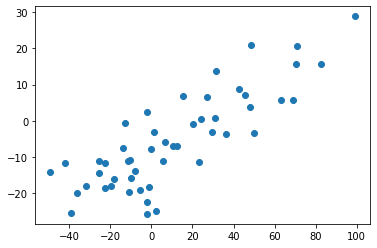

subject_15_stim_period_15_component_9   subject_15_stim_period_15_component_6   SpearmanrResult(correlation=0.8956062424969988, pvalue=1.6556408924552444e-18)   2.1253621260919653


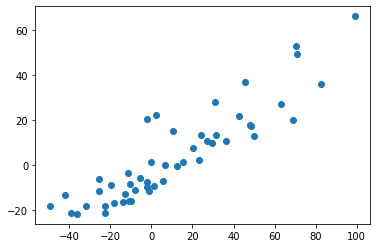

subject_15_stim_period_1_component_0   subject_15_stimulus_1_component_1   SpearmanrResult(correlation=0.7731972874801811, pvalue=3.7674306994489285e-145)   6.700801468861963


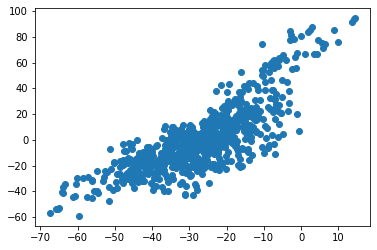

subject_15_stim_period_1_component_4   subject_15_stimulus_1_component_0   SpearmanrResult(correlation=0.7754005879120619, pvalue=1.726420196149914e-146)   4.439420274004368


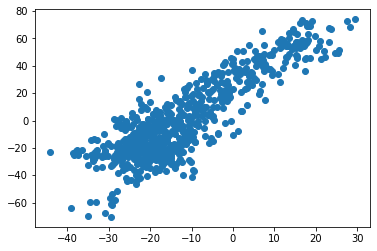

subject_15_stim_period_2_component_3   subject_15_stimulus_2_component_0   SpearmanrResult(correlation=-0.7695427228169395, pvalue=5.804784440694193e-143)   0.9257263794621424


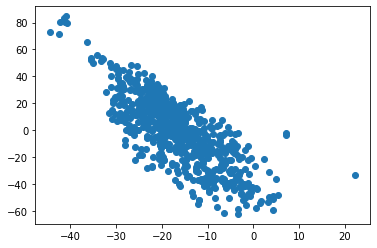

subject_15_stim_period_2_component_5   subject_15_stimulus_2_component_0   SpearmanrResult(correlation=-0.8209489725709264, pvalue=4.0399945333709485e-178)   1.2632860972680076


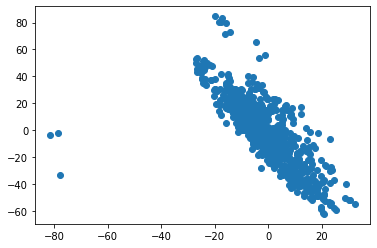

subject_15_stim_period_3_component_0   subject_15_stimulus_3_component_0   SpearmanrResult(correlation=0.9980397286714227, pvalue=0.0)   17.375805841654927


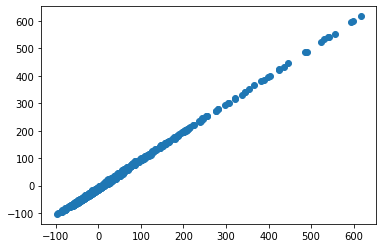

subject_15_stim_period_3_component_1   subject_15_stimulus_3_component_1   SpearmanrResult(correlation=0.9732245562747023, pvalue=0.0)   2.984328986120496


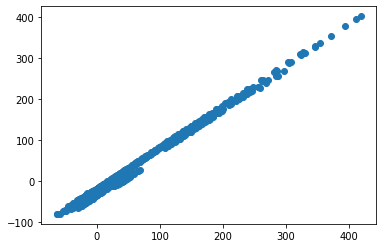

subject_15_stim_period_3_component_4   subject_15_stimulus_3_component_2   SpearmanrResult(correlation=0.8707098342865071, pvalue=0.0)   4.336978113388536


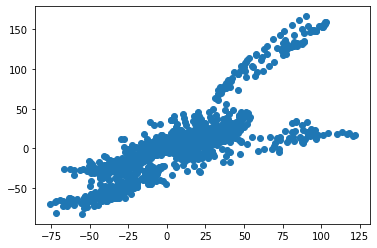

subject_15_stim_period_4_component_0   subject_15_stimulus_4_component_0   SpearmanrResult(correlation=0.9948680413001145, pvalue=0.0)   14.0930792733779


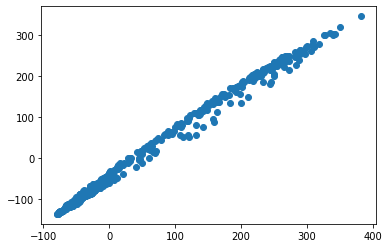

subject_15_stim_period_4_component_2   subject_15_stimulus_4_component_0   SpearmanrResult(correlation=-0.8439907888633023, pvalue=6.317799314428814e-164)   3.675917022440573


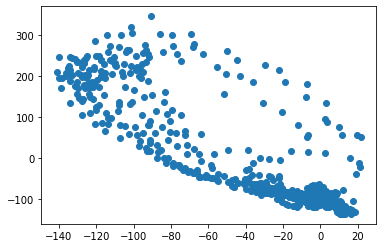

subject_15_stim_period_4_component_2   subject_15_stim_period_4_component_0   SpearmanrResult(correlation=-0.8188708301967504, pvalue=2.624966375233775e-146)   3.675917022440573


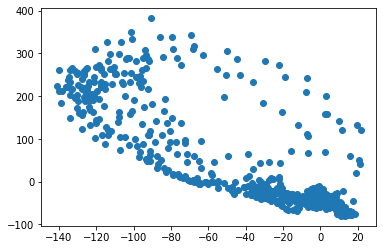

subject_15_stim_period_4_component_7   subject_15_stimulus_4_component_1   SpearmanrResult(correlation=-0.7973821593948871, pvalue=2.7889609293344682e-133)   3.3736078056516607


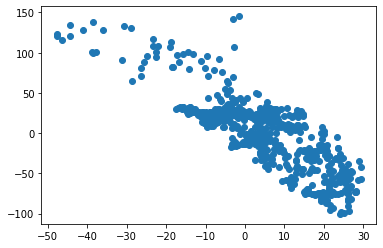

subject_15_stim_period_9_component_0   subject_15_stimulus_11_component_1   SpearmanrResult(correlation=0.8787270612337018, pvalue=2.1207653127256337e-78)   6.1525931262410625


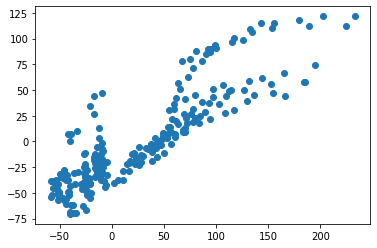

subject_15_stim_period_9_component_0   subject_15_stimulus_9_component_0   SpearmanrResult(correlation=0.9847228250490457, pvalue=1.1148896181670827e-182)   12.385322573183297


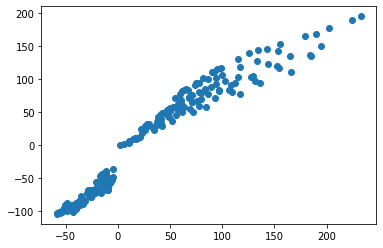

subject_15_stim_period_9_component_2   subject_12_stimulus_10_component_0   SpearmanrResult(correlation=-0.8327737787053683, pvalue=4.732032522780967e-63)   3.4115284429568624


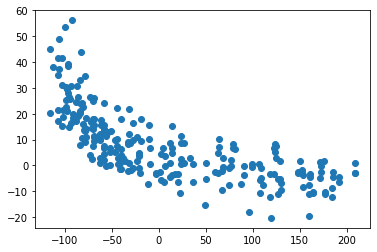

subject_15_stim_period_9_component_2   subject_12_stimulus_11_component_0   SpearmanrResult(correlation=-0.8324777608400693, pvalue=5.731330783165395e-63)   3.407808005652088


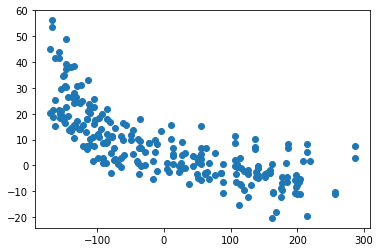

subject_15_stim_period_9_component_2   subject_12_stimulus_9_component_0   SpearmanrResult(correlation=-0.8898244945629724, pvalue=4.631193992359115e-83)   3.412589725122562


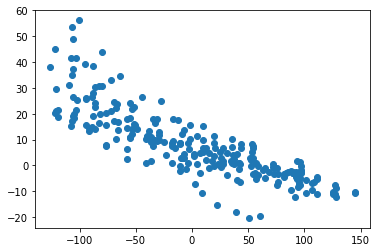

subject_15_stim_period_9_component_2   subject_12_stim_period_10_component_0   SpearmanrResult(correlation=-0.8208427829849344, pvalue=8.04206685539122e-60)   3.4303983670978706


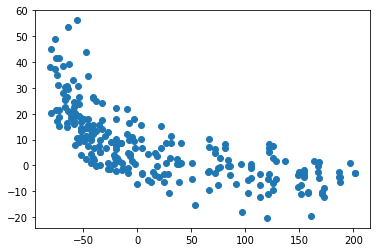

subject_15_stim_period_9_component_2   subject_12_stim_period_10_component_5   SpearmanrResult(correlation=-0.8290245084407761, pvalue=5.21268422854225e-62)   2.8404577907314428


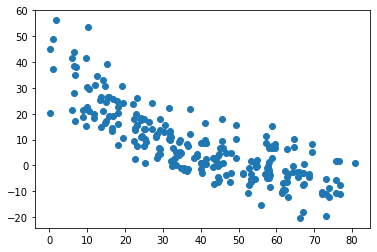

subject_15_stim_period_9_component_2   subject_12_stim_period_11_component_0   SpearmanrResult(correlation=-0.8350776831467268, pvalue=1.0515223148817263e-63)   3.4303983670978706


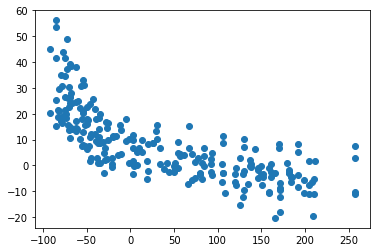

subject_15_stim_period_9_component_2   subject_12_stim_period_11_component_2   SpearmanrResult(correlation=-0.8296634209007762, pvalue=3.47771508072445e-62)   2.746422614470818


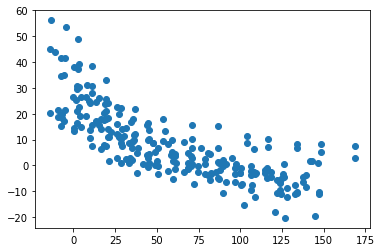

subject_15_stim_period_9_component_2   subject_12_stim_period_11_component_9   SpearmanrResult(correlation=0.8076556645340387, pvalue=1.6114900729233139e-56)   3.4303983670978706


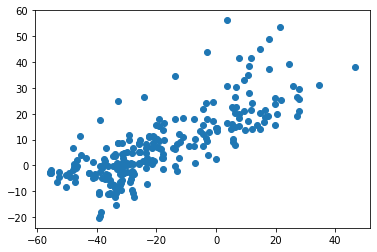

subject_15_stim_period_9_component_2   subject_12_stim_period_12_component_5   SpearmanrResult(correlation=-0.7816547052923016, pvalue=1.0596283563159547e-50)   2.8404577907314428


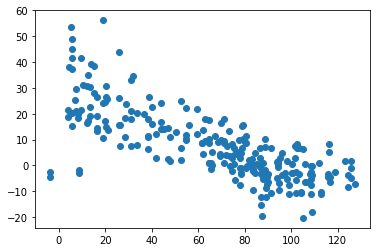

subject_15_stim_period_9_component_2   subject_12_stim_period_12_component_7   SpearmanrResult(correlation=-0.7755320835798294, pvalue=1.9048367825128818e-49)   1.7443988060514803


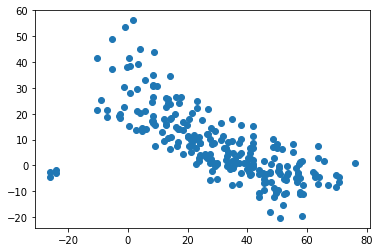

subject_15_stim_period_9_component_2   subject_12_stim_period_9_component_0   SpearmanrResult(correlation=-0.8549039354211002, pvalue=8.869188245063599e-70)   3.4303983670978706


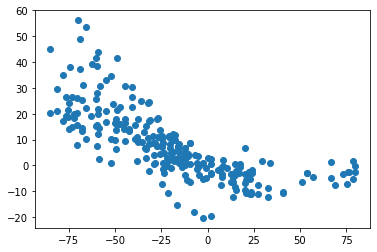

subject_15_stim_period_9_component_2   subject_12_stim_period_9_component_2   SpearmanrResult(correlation=-0.8051321339345553, pvalue=6.456686496507817e-56)   2.746422614470818


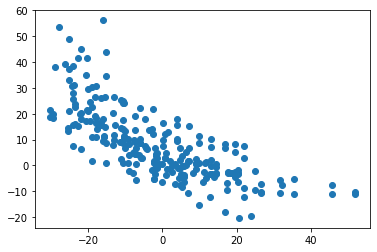

subject_15_stim_period_9_component_2   subject_12_stim_period_9_component_3   SpearmanrResult(correlation=-0.8026424587507511, pvalue=2.4895159650035907e-55)   2.7265076474862635


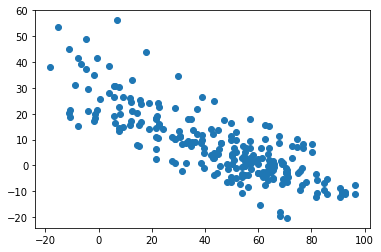

subject_15_stim_period_9_component_2   subject_12_stim_period_9_component_5   SpearmanrResult(correlation=-0.8081938788345822, pvalue=1.195395601094878e-56)   2.8404577907314428


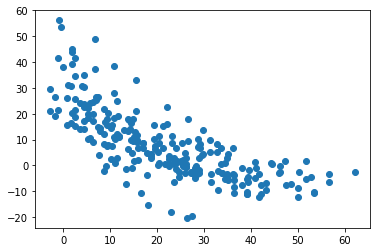

subject_15_stim_period_9_component_2   subject_12_stim_period_9_component_8   SpearmanrResult(correlation=-0.7973940012328711, pvalue=4.0240839451991667e-54)   2.759132849637063


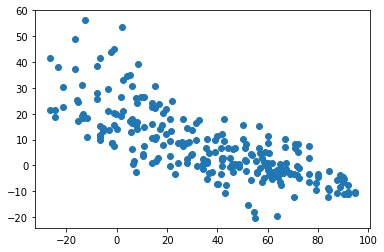

subject_15_stim_period_9_component_2   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=-0.8007031372072431, pvalue=7.028848379654123e-55)   2.2170418864620585


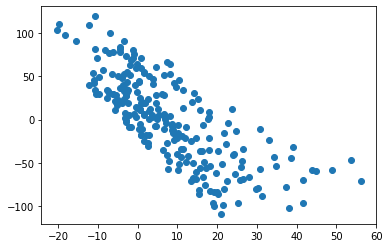

subject_15_stim_period_9_component_2   subject_15_stimulus_12_component_0   SpearmanrResult(correlation=0.8044167433462385, pvalue=9.534258805689676e-56)   2.238032866492018


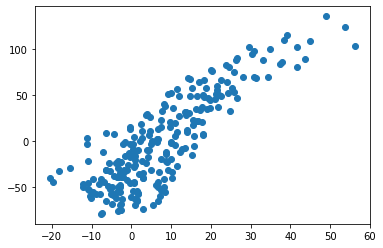

subject_15_stim_period_9_component_2   subject_15_stimulus_9_component_1   SpearmanrResult(correlation=0.8955120748624106, pvalue=1.1995125051496665e-85)   3.5535095016071097


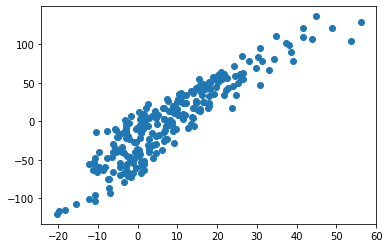

subject_15_stim_period_9_component_2   subject_15_stim_period_0_component_4   SpearmanrResult(correlation=0.7749452366065054, pvalue=2.4838737923533122e-67)   2.9019931223158366


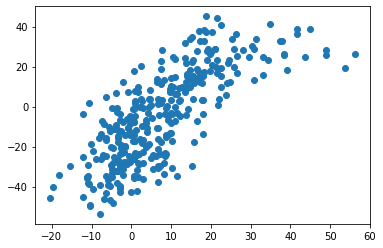

subject_15_stim_period_9_component_2   subject_15_stim_period_10_component_0   SpearmanrResult(correlation=-0.7536485008420283, pvalue=2.8766962111446293e-45)   3.675917022440573


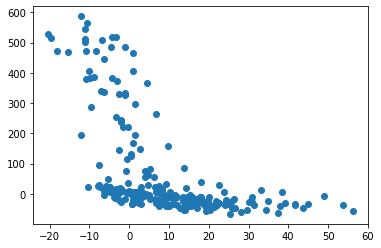

subject_15_stim_period_9_component_2   subject_15_stim_period_11_component_2   SpearmanrResult(correlation=0.8132172433549192, pvalue=7.025461508155843e-58)   3.675917022440573


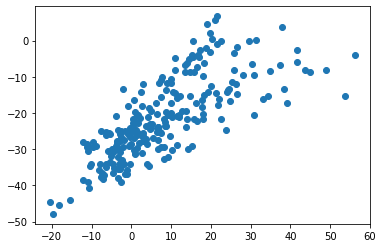

subject_15_stim_period_9_component_2   subject_15_stim_period_12_component_6   SpearmanrResult(correlation=-0.7995902706644211, pvalue=1.2685661305964122e-54)   2.6157615155809526


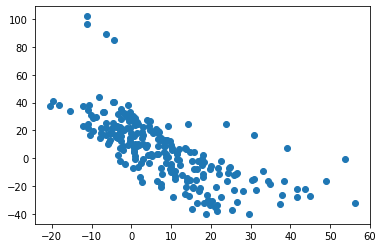

subject_15_stim_period_9_component_3   subject_15_stimulus_10_component_0   SpearmanrResult(correlation=0.770908349103283, pvalue=1.5900187886016246e-48)   2.2243768864288214


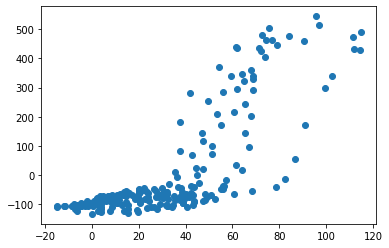

subject_15_stim_period_9_component_3   subject_15_stimulus_11_component_0   SpearmanrResult(correlation=0.7902194482543098, pvalue=1.5858928838442623e-52)   1.8344879023167215


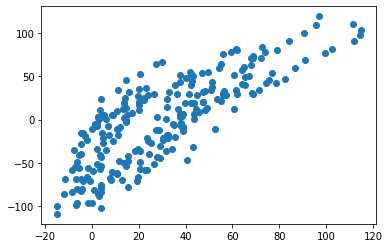

subject_15_stim_period_9_component_3   subject_15_stim_period_10_component_0   SpearmanrResult(correlation=0.7594341915658257, pvalue=2.4981105940240153e-46)   2.2243768864288214


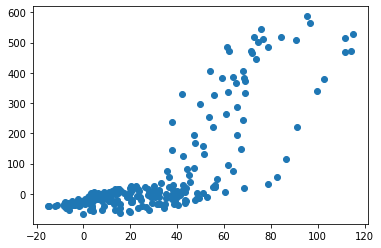

subject_15_stim_period_9_component_3   subject_15_stim_period_10_component_2   SpearmanrResult(correlation=0.7520989947742146, pvalue=5.471875166046166e-45)   1.919771157974983


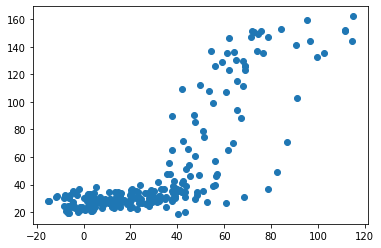

subject_15_stim_period_9_component_3   subject_15_stim_period_10_component_3   SpearmanrResult(correlation=0.7787565756349935, pvalue=4.2079167274612313e-50)   2.2243768864288214


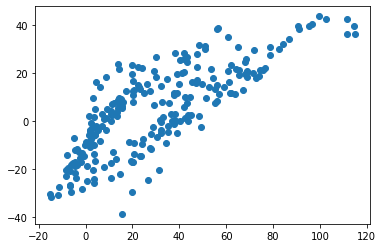

subject_15_stim_period_9_component_3   subject_15_stim_period_11_component_3   SpearmanrResult(correlation=0.9436205489678637, pvalue=2.9263228856443897e-116)   2.2243768864288214


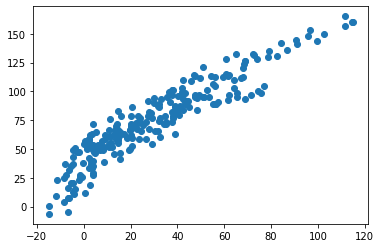

subject_15_stim_period_9_component_3   subject_15_stim_period_12_component_6   SpearmanrResult(correlation=0.773868469938714, pvalue=4.110987785459945e-49)   1.6705353223965609


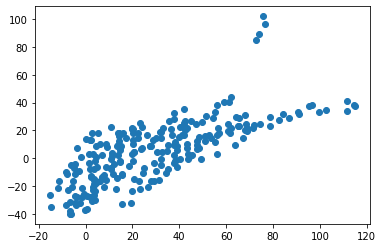

subject_15_stim_period_9_component_4   subject_15_stimulus_9_component_0   SpearmanrResult(correlation=0.7750403652841193, pvalue=2.3927827108184446e-49)   4.74145632010158


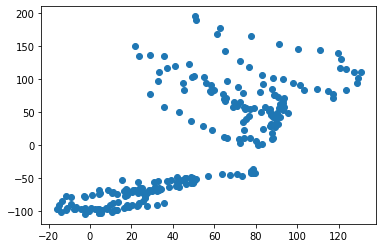

subject_15_stim_period_9_component_4   subject_15_stim_period_11_component_3   SpearmanrResult(correlation=0.8827149776905847, pvalue=5.082674853639753e-80)   1.6107468900801596


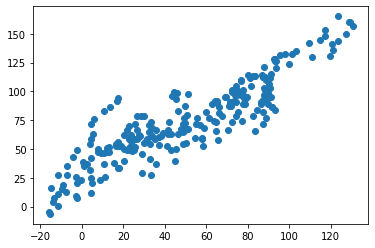

subject_15_stim_period_9_component_4   subject_15_stim_period_9_component_3   SpearmanrResult(correlation=0.9168961266688656, pvalue=6.526715574285826e-97)   1.6107468900801596


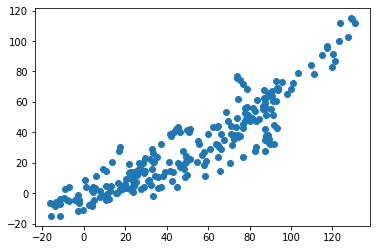

subject_15_stim_period_9_component_5   subject_15_stim_period_11_component_3   SpearmanrResult(correlation=-0.766026319901387, pvalue=1.4165233741424487e-47)   1.9793434321151606


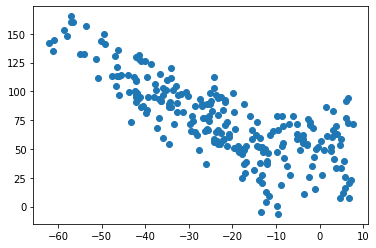

subject_15_stim_period_9_component_5   subject_15_stim_period_9_component_3   SpearmanrResult(correlation=-0.7654863799718744, pvalue=1.7982461480987238e-47)   1.9793434321151606


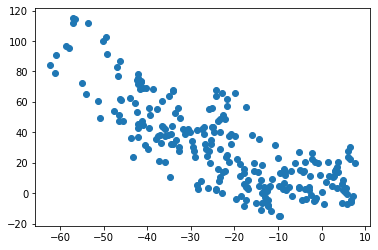

subject_15_stim_period_9_component_5   subject_15_stim_period_9_component_4   SpearmanrResult(correlation=-0.7943558047882774, pvalue=1.9413582692806757e-53)   2.4779307688958


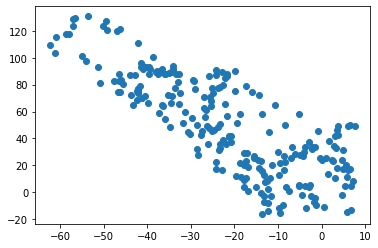

subject_15_stim_period_9_component_6   subject_15_stim_period_9_component_3   SpearmanrResult(correlation=0.753562561850032, pvalue=2.9815061702814025e-45)   1.6705353223965609


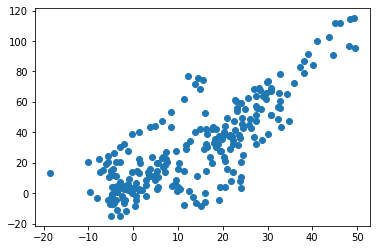

subject_15_stim_period_9_component_6   subject_15_stim_period_9_component_4   SpearmanrResult(correlation=0.8165350092883555, pvalue=1.0307675968499848e-58)   2.8658894659811134


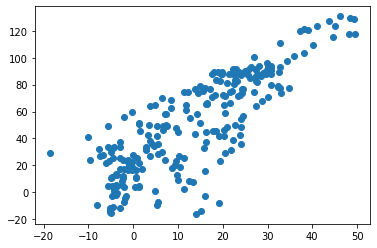

subject_15_stim_period_9_component_6   subject_15_stim_period_9_component_5   SpearmanrResult(correlation=-0.7639655202347262, pvalue=3.5094533183046046e-47)   2.3473445414473577


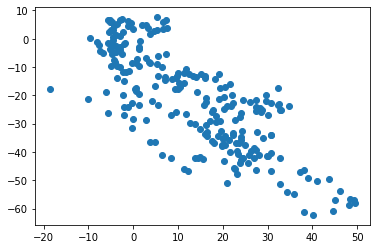

subject_15_stim_period_9_component_7   subject_15_stimulus_12_component_1   SpearmanrResult(correlation=-0.7666322331984929, pvalue=1.0829376099110638e-47)   4.579088861326003


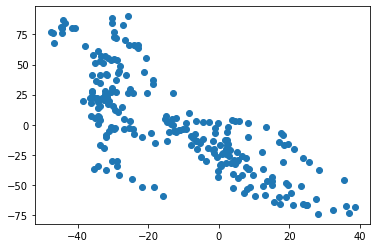

subject_15_stim_period_9_component_7   subject_15_stim_period_9_component_4   SpearmanrResult(correlation=-0.7777704474036006, pvalue=6.695635991660902e-50)   3.8970670294866694


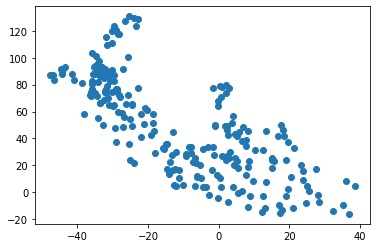

subject_16_stimulus_10_component_4   subject_10_stimulus_15_component_3   SpearmanrResult(correlation=-0.8111137385907473, pvalue=7.487507256424547e-20)   6.01790498541315


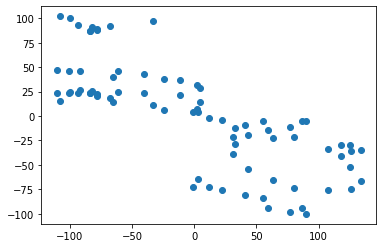

subject_16_stimulus_10_component_4   subject_14_stimulus_14_component_4   SpearmanrResult(correlation=0.7594373010624473, pvalue=3.2180389117078945e-16)   3.7849526978559105


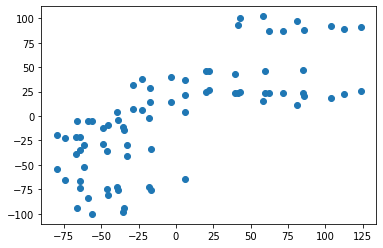

subject_16_stimulus_10_component_5   subject_12_stimulus_10_component_9   SpearmanrResult(correlation=0.7542244520684059, pvalue=7.917187042485324e-29)   4.160922947264403


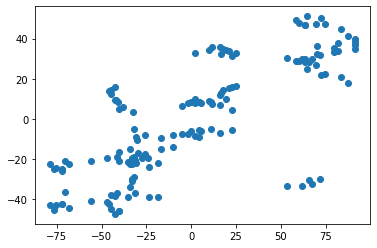

subject_16_stimulus_11_component_0   subject_16_stimulus_10_component_0   SpearmanrResult(correlation=0.909001406469761, pvalue=2.2315075048789584e-31)   0.3938980492041887


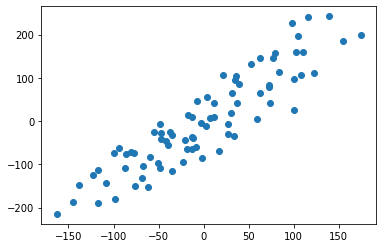

subject_16_stimulus_11_component_8   subject_10_stim_period_10_component_3   SpearmanrResult(correlation=0.7518219236856041, pvalue=2.6558940641264e-41)   4.761722343873342


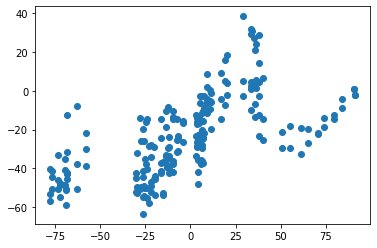

subject_16_stimulus_11_component_8   subject_10_stim_period_12_component_2   SpearmanrResult(correlation=0.7729112446776725, pvalue=5.95620638891768e-45)   3.2712778188928606


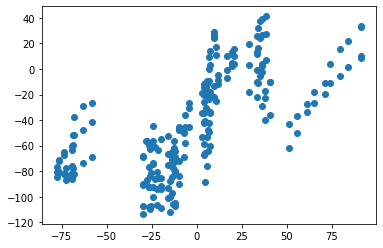

subject_16_stimulus_11_component_8   subject_10_stim_period_12_component_7   SpearmanrResult(correlation=0.7808650344989602, pvalue=1.9712249620451138e-46)   1.45567655059679


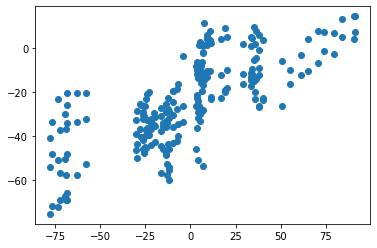

subject_16_stimulus_12_component_4   subject_16_stimulus_10_component_7   SpearmanrResult(correlation=-0.7614627285513361, pvalue=2.414125144619641e-16)   6.981733322585748


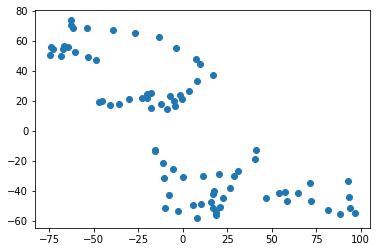

subject_16_stimulus_12_component_5   subject_13_stimulus_14_component_1   SpearmanrResult(correlation=0.7725636115686879, pvalue=4.808676556863409e-21)   3.5890207556874016


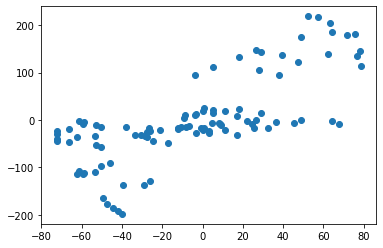

subject_16_stimulus_12_component_8   subject_10_stimulus_12_component_0   SpearmanrResult(correlation=-0.7705533973904208, pvalue=1.5931350878786335e-44)   3.449627943483884


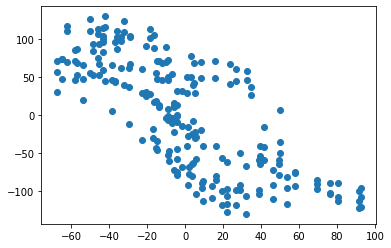

subject_16_stimulus_12_component_8   subject_10_stim_period_10_component_3   SpearmanrResult(correlation=0.7802783903722803, pvalue=2.5469496954984974e-46)   5.0745025156469294


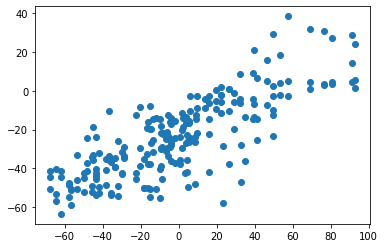

subject_16_stimulus_12_component_8   subject_10_stim_period_12_component_2   SpearmanrResult(correlation=0.7760366321191392, pvalue=1.5870415958028483e-45)   3.3228906609553883


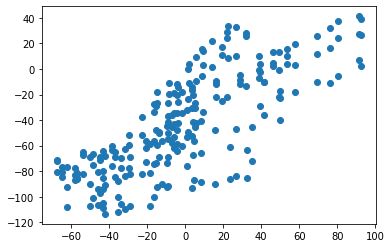

subject_16_stimulus_12_component_8   subject_10_stim_period_12_component_6   SpearmanrResult(correlation=-0.7521645554137707, pvalue=2.3327821423494824e-41)   2.2966562233760817


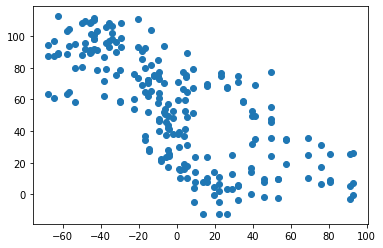

subject_16_stimulus_12_component_8   subject_16_stimulus_10_component_8   SpearmanrResult(correlation=0.7887482419127988, pvalue=3.723542228243837e-18)   6.491316919856709


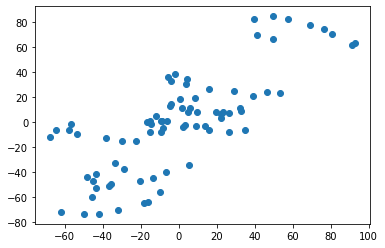

subject_16_stimulus_9_component_1   subject_16_stimulus_11_component_3   SpearmanrResult(correlation=-0.7513127051101736, pvalue=9.914251506979117e-16)   5.130230719708727


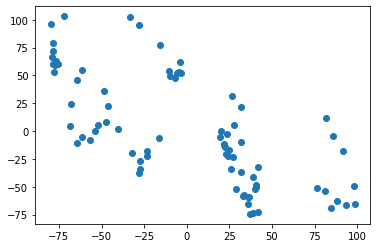

subject_16_stimulus_9_component_1   subject_16_stimulus_12_component_1   SpearmanrResult(correlation=-0.7800515705578998, pvalue=1.5008413285677782e-17)   6.857999606734364


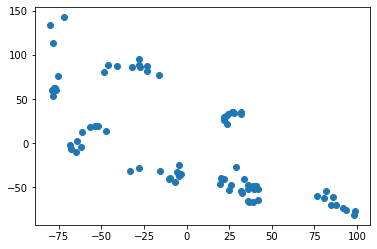

subject_16_stimulus_9_component_4   subject_16_stimulus_11_component_5   SpearmanrResult(correlation=-0.8340834505391469, pvalue=7.585612666137211e-22)   6.33885132859079


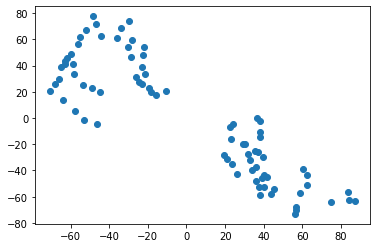

subject_16_stimulus_9_component_7   subject_10_stimulus_12_component_0   SpearmanrResult(correlation=0.8009123718308642, pvalue=1.8708946917463239e-50)   3.398311976309314


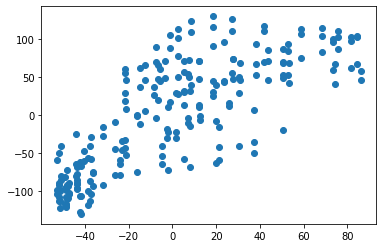

subject_16_stimulus_9_component_7   subject_10_stim_period_12_component_1   SpearmanrResult(correlation=0.7528791228994864, pvalue=1.7786309441082807e-41)   5.879627692243561


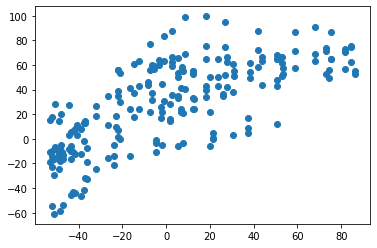

subject_16_stimulus_9_component_7   subject_10_stim_period_12_component_2   SpearmanrResult(correlation=-0.7858658798209177, pvalue=2.1475096137564294e-47)   3.438291330995185


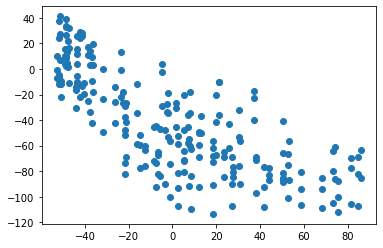

subject_16_stimulus_9_component_7   subject_10_stim_period_12_component_6   SpearmanrResult(correlation=0.833186815422686, pvalue=5.287492862669414e-58)   2.280888431478032


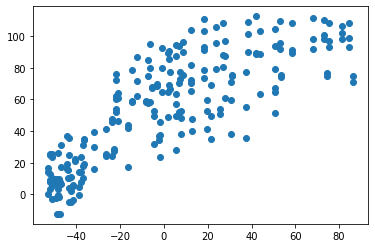

subject_16_stim_period_10_component_0   subject_16_stimulus_10_component_0   SpearmanrResult(correlation=-0.9813408345053916, pvalue=1.2843330658007366e-57)   0.5110256023795091


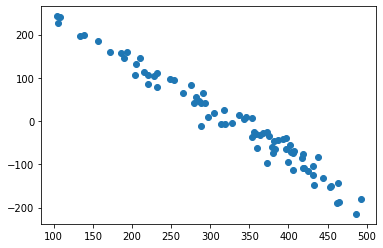

subject_16_stim_period_10_component_0   subject_16_stimulus_11_component_0   SpearmanrResult(correlation=-0.8870135958743555, pvalue=6.735329098103706e-28)   1.4981437036604417


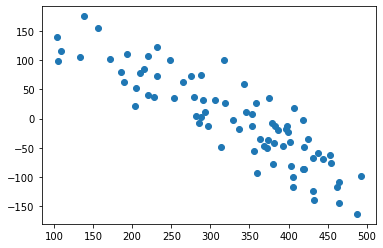

subject_16_stim_period_10_component_1   subject_13_stimulus_9_component_1   SpearmanrResult(correlation=0.7636480980844854, pvalue=1.7647303314483397e-16)   4.702654025212111


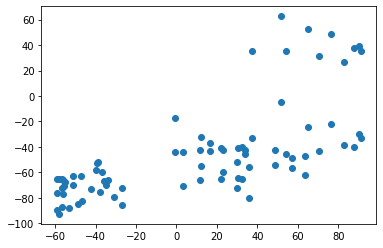

subject_16_stim_period_10_component_1   subject_16_stimulus_10_component_1   SpearmanrResult(correlation=0.8371776840131271, pvalue=3.8737711016789932e-22)   6.144106853096748


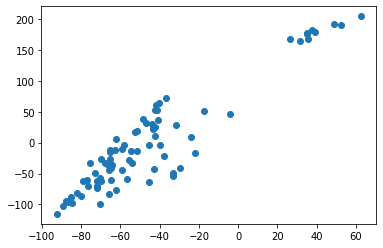

subject_16_stim_period_10_component_3   subject_16_stimulus_10_component_2   SpearmanrResult(correlation=0.9149085794655416, pvalue=1.8255405478118966e-32)   9.729569177493383


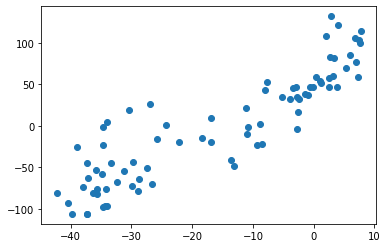

subject_16_stim_period_10_component_6   subject_13_stimulus_9_component_1   SpearmanrResult(correlation=0.7621475998489909, pvalue=2.189122036353275e-16)   4.05169750673694


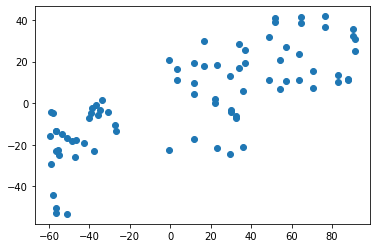

subject_16_stim_period_10_component_6   subject_16_stim_period_10_component_1   SpearmanrResult(correlation=0.8076887013595875, pvalue=1.4074034252093227e-19)   5.093335817785599


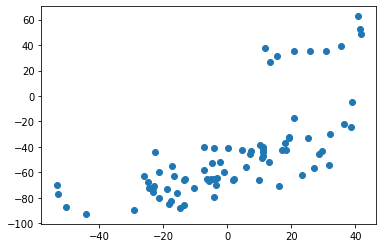

subject_16_stim_period_10_component_9   subject_16_stimulus_11_component_3   SpearmanrResult(correlation=0.8764650726676044, pvalue=1.7791907682611077e-26)   3.676111165662717


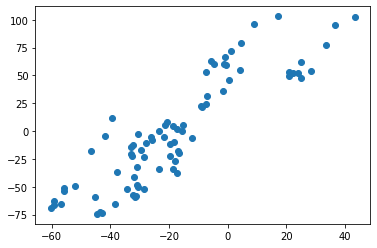

subject_16_stim_period_10_component_9   subject_16_stimulus_9_component_1   SpearmanrResult(correlation=-0.7537271448663855, pvalue=7.128776319597249e-16)   3.97498321947523


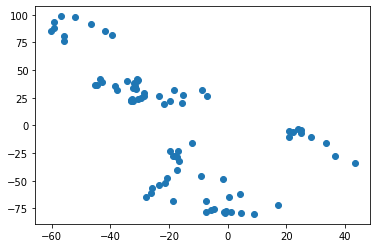

subject_16_stim_period_11_component_0   subject_10_stim_period_15_component_6   SpearmanrResult(correlation=0.758640114639597, pvalue=3.6007071993712105e-16)   2.3368071352481685


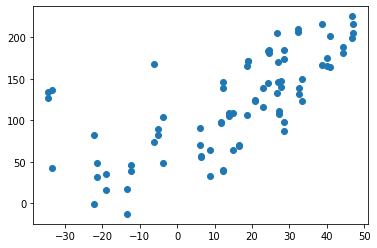

subject_16_stim_period_11_component_0   subject_16_stimulus_10_component_0   SpearmanrResult(correlation=-0.8887482419127989, pvalue=3.811067683832726e-28)   0.5110256023795091


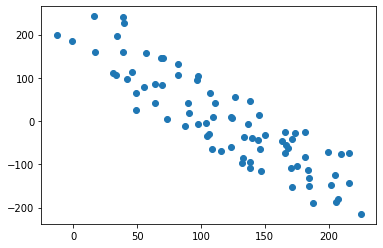

subject_16_stim_period_11_component_0   subject_16_stimulus_11_component_0   SpearmanrResult(correlation=-0.9716830754805438, pvalue=1.2448018488773528e-50)   1.4981437036604417


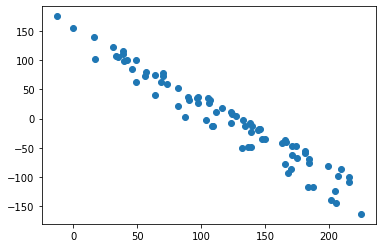

subject_16_stim_period_11_component_0   subject_16_stim_period_10_component_0   SpearmanrResult(correlation=0.9023441162681669, pvalue=3.0790075032096414e-30)   13.793036620202967


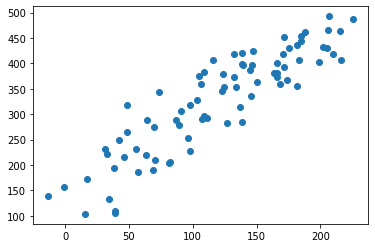

subject_16_stim_period_11_component_2   subject_16_stimulus_11_component_1   SpearmanrResult(correlation=0.928973277074543, pvalue=2.0835859362574035e-35)   4.939101147946631


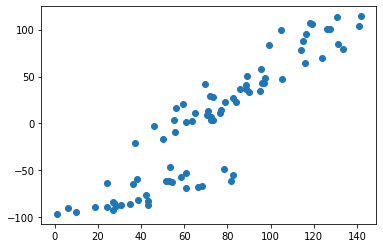

subject_16_stim_period_11_component_3   subject_16_stimulus_10_component_2   SpearmanrResult(correlation=0.7834739803094233, pvalue=8.73819717291147e-18)   9.729569177493383


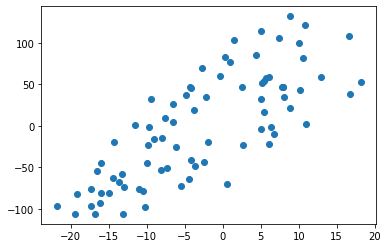

subject_16_stim_period_11_component_3   subject_16_stim_period_10_component_3   SpearmanrResult(correlation=0.7807782466010316, pvalue=1.3390842462584985e-17)   13.443978954991046


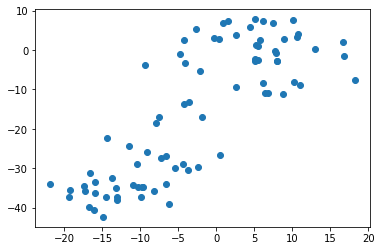

subject_16_stim_period_11_component_5   subject_16_stimulus_10_component_1   SpearmanrResult(correlation=0.8847398030942335, pvalue=1.4011698407128685e-27)   5.449688252635607


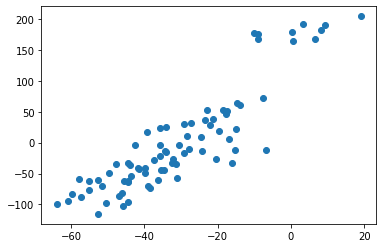

subject_16_stim_period_11_component_6   subject_15_stimulus_14_component_3   SpearmanrResult(correlation=0.7573764843658173, pvalue=4.2988414670163923e-16)   3.275802948107479


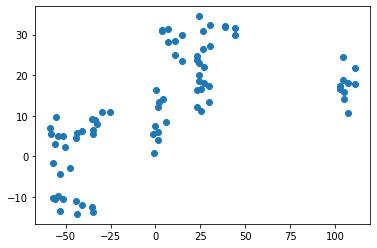

subject_16_stim_period_11_component_6   subject_16_stimulus_9_component_0   SpearmanrResult(correlation=0.7596343178621661, pvalue=3.1296993790842504e-16)   6.0657524692726215


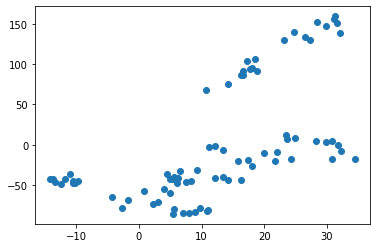

subject_16_stim_period_11_component_8   subject_10_stim_period_14_component_3   SpearmanrResult(correlation=0.7540445693784597, pvalue=6.824332657137718e-16)   3.14596818143405


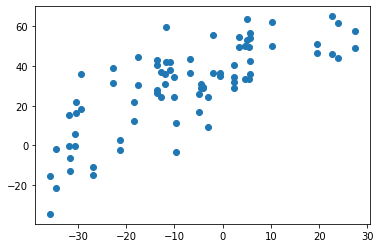

subject_16_stim_period_11_component_9   subject_10_stim_period_14_component_5   SpearmanrResult(correlation=0.7529191297226709, pvalue=7.964088585134215e-16)   1.6603984864348806


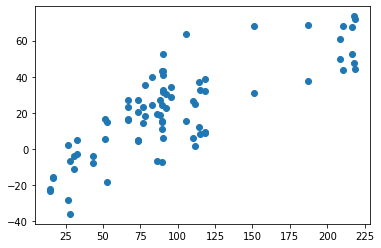

subject_16_stim_period_11_component_9   subject_10_stim_period_14_component_8   SpearmanrResult(correlation=0.811535778461668, pvalue=6.921167051307121e-20)   2.7839113361106502


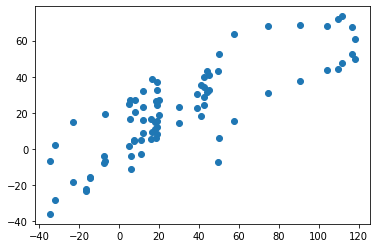

subject_16_stim_period_11_component_9   subject_16_stimulus_11_component_0   SpearmanrResult(correlation=-0.7696436943272386, pvalue=7.340096443379588e-17)   1.3175996991487275


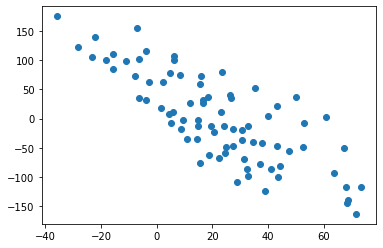

subject_16_stim_period_12_component_0   subject_16_stimulus_12_component_0   SpearmanrResult(correlation=0.9487107360525083, pvalue=9.288511514987174e-41)   12.374679325833847


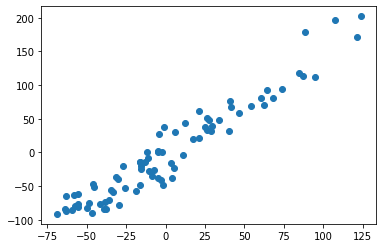

subject_16_stim_period_12_component_2   subject_16_stimulus_12_component_1   SpearmanrResult(correlation=0.7721518987341772, pvalue=5.0454772068886063e-17)   4.728108872870045


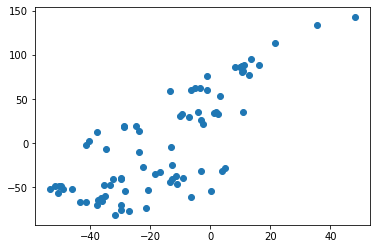

subject_16_stim_period_12_component_7   subject_16_stim_period_11_component_7   SpearmanrResult(correlation=0.8112986404125645, pvalue=7.234069915383076e-20)   7.420118881792466


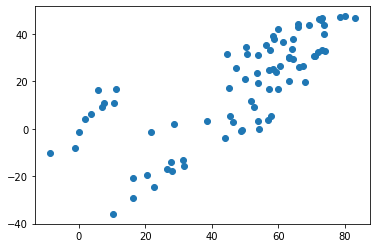

subject_16_stim_period_12_component_7   subject_16_stim_period_12_component_3   SpearmanrResult(correlation=0.7665260196905768, pvalue=1.1620472478956754e-16)   7.171799744897029


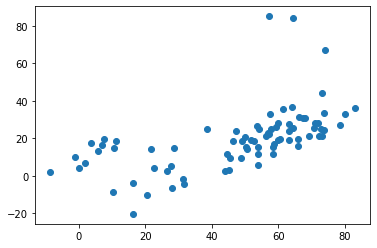

subject_16_stim_period_1_component_1   subject_16_stimulus_1_component_0   SpearmanrResult(correlation=0.9195808842320469, pvalue=6.264762014026486e-123)   7.735705138654857


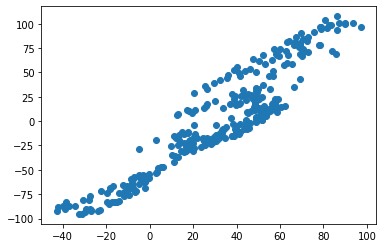

subject_16_stim_period_1_component_2   subject_16_stimulus_1_component_1   SpearmanrResult(correlation=0.7668876320848009, pvalue=2.39933318135138e-59)   4.942756934580558


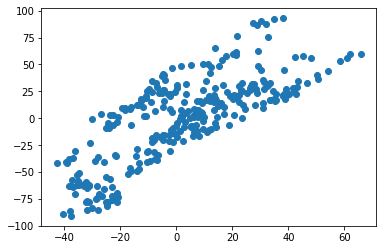

subject_16_stim_period_1_component_3   subject_16_stimulus_1_component_0   SpearmanrResult(correlation=0.7568039644884943, pvalue=5.697707659536702e-57)   10.130545388677447


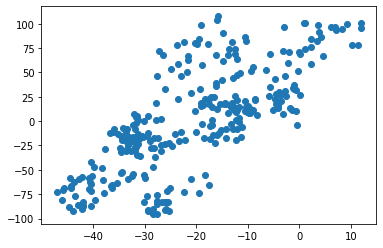

subject_16_stim_period_1_component_4   subject_16_stim_period_1_component_0   SpearmanrResult(correlation=-0.8008822320248001, pvalue=2.4819742894548224e-68)   4.108698656064207


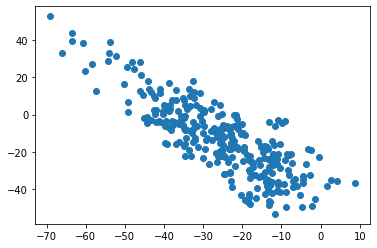

subject_16_stim_period_1_component_8   subject_16_stimulus_1_component_0   SpearmanrResult(correlation=-0.8230429226991411, pvalue=3.4627262379373123e-75)   3.625798252237894


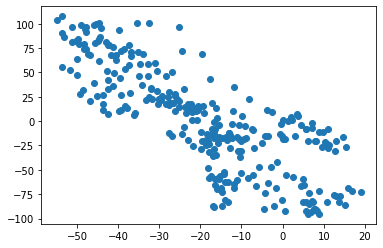

subject_16_stim_period_2_component_0   subject_16_stimulus_2_component_1   SpearmanrResult(correlation=-0.8438738208202312, pvalue=1.4435749659715226e-82)   1.7925695225131515


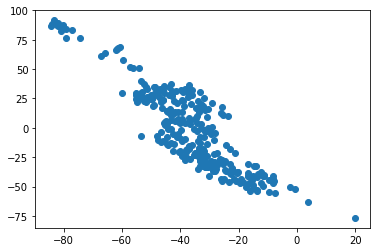

subject_16_stim_period_2_component_1   subject_16_stimulus_2_component_0   SpearmanrResult(correlation=-0.9362406248958322, pvalue=2.1226581776777593e-137)   5.409894362567211


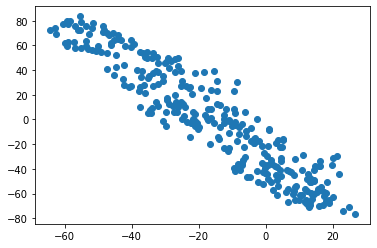

subject_16_stim_period_2_component_2   subject_16_stimulus_2_component_0   SpearmanrResult(correlation=0.9719196879965332, pvalue=2.6738315990741257e-189)   4.542425135586974


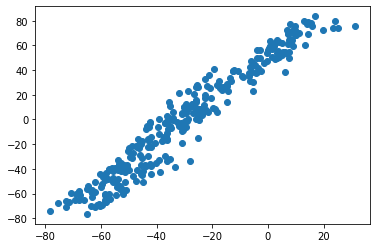

subject_16_stim_period_2_component_2   subject_16_stim_period_2_component_1   SpearmanrResult(correlation=-0.8827564750719451, pvalue=9.052886528347951e-100)   4.49957606360397


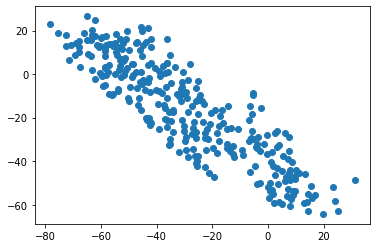

subject_16_stim_period_3_component_0   subject_16_stimulus_3_component_0   SpearmanrResult(correlation=0.8918403973724507, pvalue=5.35022437022431e-153)   12.445295968442988


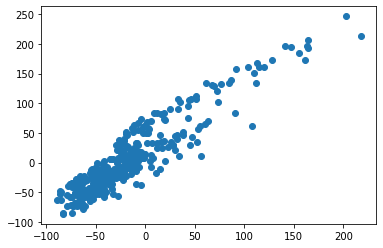

subject_16_stim_period_3_component_1   subject_16_stimulus_3_component_1   SpearmanrResult(correlation=0.8306726790944169, pvalue=1.8367385937601914e-113)   7.59273568416356


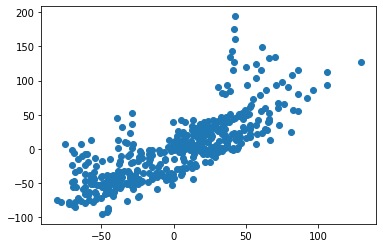

subject_16_stim_period_3_component_4   subject_16_stimulus_3_component_3   SpearmanrResult(correlation=0.7676244571135558, pvalue=1.1728238583259989e-86)   2.16034444335146


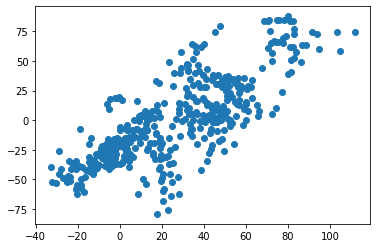

subject_16_stim_period_4_component_0   subject_16_stimulus_4_component_0   SpearmanrResult(correlation=0.7862555487493637, pvalue=9.400327701702977e-110)   11.820931303279856


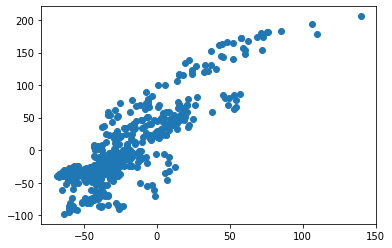

subject_16_stim_period_4_component_1   subject_16_stimulus_4_component_1   SpearmanrResult(correlation=-0.803949283662297, pvalue=2.527979057344164e-118)   4.654921252817879


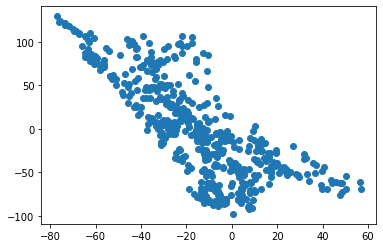

subject_16_stim_period_4_component_2   subject_16_stimulus_4_component_1   SpearmanrResult(correlation=0.9052975522545044, pvalue=1.2367532820059578e-193)   4.1688174507199465


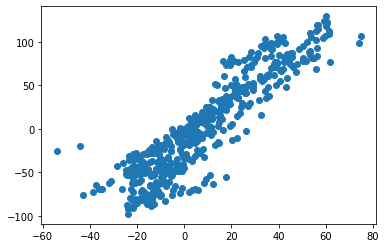

subject_16_stim_period_4_component_2   subject_16_stim_period_4_component_1   SpearmanrResult(correlation=-0.799299006622114, pvalue=5.47337045225287e-116)   4.49957606360397


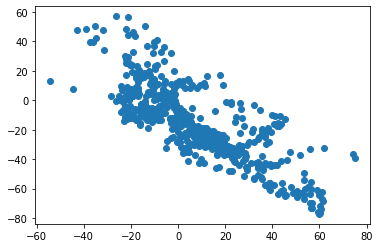

subject_16_stim_period_4_component_3   subject_16_stimulus_4_component_0   SpearmanrResult(correlation=0.7920967260403182, pvalue=1.7235128057441036e-112)   11.811206414509874


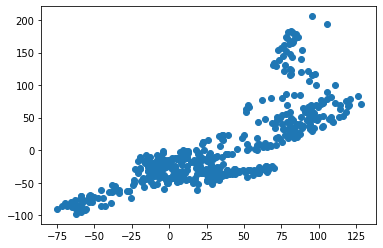

subject_16_stim_period_4_component_8   subject_16_stimulus_4_component_3   SpearmanrResult(correlation=-0.8975181444256158, pvalue=2.9312721547370008e-185)   3.694763769479273


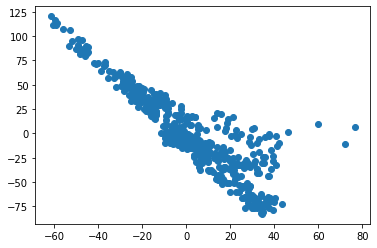

subject_16_stim_period_9_component_0   subject_16_stimulus_9_component_2   SpearmanrResult(correlation=-0.7811767463666199, pvalue=1.2576737856178997e-17)   3.5971610583689677


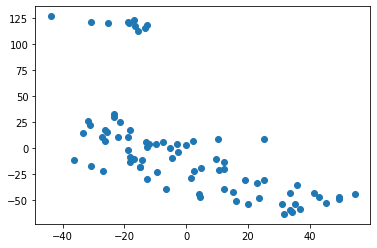

subject_16_stim_period_9_component_1   subject_16_stimulus_9_component_0   SpearmanrResult(correlation=0.9374355368026255, pvalue=1.7396348576662182e-37)   7.006028627120136


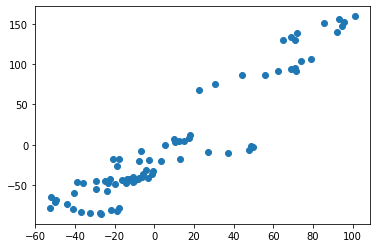

subject_16_stim_period_9_component_2   subject_16_stimulus_10_component_1   SpearmanrResult(correlation=-0.7654242850445382, pvalue=1.364564445386311e-16)   4.450170563006446


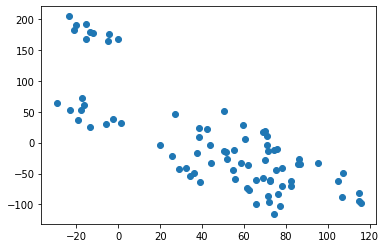

subject_16_stim_period_9_component_2   subject_16_stimulus_9_component_0   SpearmanrResult(correlation=-0.8430379746835444, pvalue=1.0430302268682061e-22)   4.750659173483493


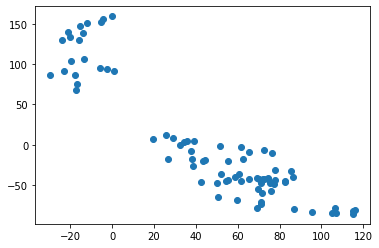

subject_16_stim_period_9_component_2   subject_16_stim_period_10_component_1   SpearmanrResult(correlation=-0.8438349742147211, pvalue=8.689635685798092e-23)   4.49957606360397


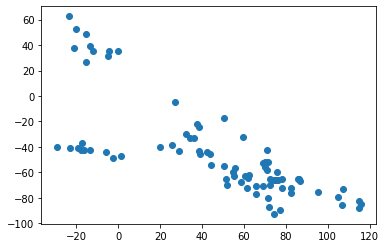

subject_16_stim_period_9_component_3   subject_16_stimulus_10_component_2   SpearmanrResult(correlation=0.7736521331458042, pvalue=4.0228553815963474e-17)   9.729569177493383


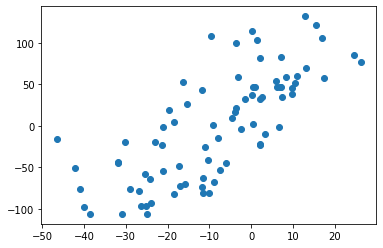

subject_16_stim_period_9_component_3   subject_16_stimulus_9_component_1   SpearmanrResult(correlation=0.790365682137834, pvalue=2.8525244410988458e-18)   8.681513958012156


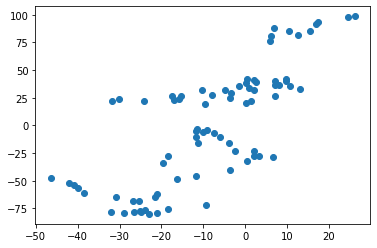

subject_16_stim_period_9_component_3   subject_16_stim_period_10_component_3   SpearmanrResult(correlation=0.7662212845757149, pvalue=1.2149547599903677e-16)   13.443978954991046


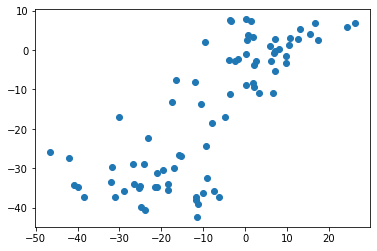

subject_16_stim_period_9_component_6   subject_16_stim_period_10_component_7   SpearmanrResult(correlation=-0.751851851851852, pvalue=9.213299654435593e-16)   5.48275829463178


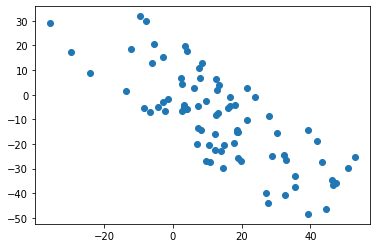

subject_16_stim_period_9_component_6   subject_16_stim_period_11_component_6   SpearmanrResult(correlation=0.8742147210501642, pvalue=3.441445045044228e-26)   6.372648322993216


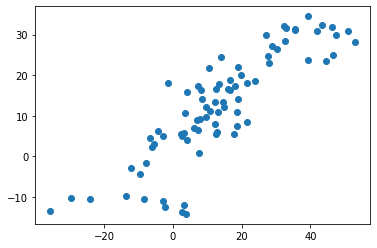

subject_16_stim_period_9_component_7   subject_16_stim_period_11_component_7   SpearmanrResult(correlation=0.7833098921706516, pvalue=8.969775392338325e-18)   7.420118881792466


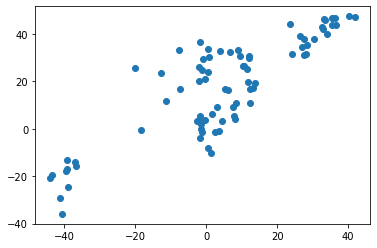

subject_16_stim_period_9_component_9   subject_16_stim_period_9_component_8   SpearmanrResult(correlation=-0.8007735583684952, pvalue=4.846643033199561e-19)   2.7236250172311696


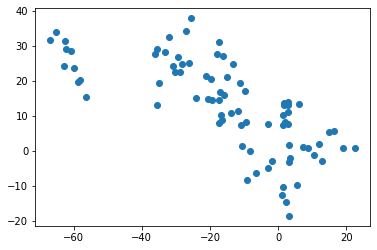

subject_17_stimulus_11_component_0   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=0.8925701245150967, pvalue=1.2234721462426675e-67)   5.843122636677988


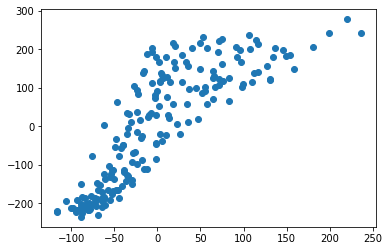

subject_17_stimulus_12_component_0   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=0.8792183218945828, pvalue=4.3168968989386276e-63)   5.729578061452917


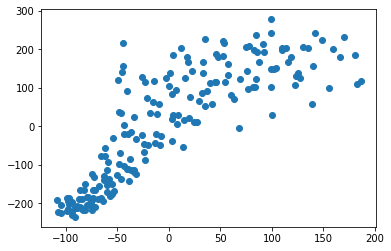

subject_17_stimulus_12_component_0   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=0.875645972926783, pvalue=5.767618736214259e-62)   5.024332557662765


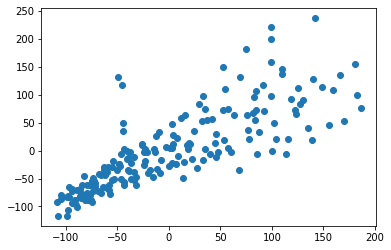

subject_17_stimulus_14_component_0   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.914834999834985, pvalue=1.56119832714672e-20)   5.13382155692844


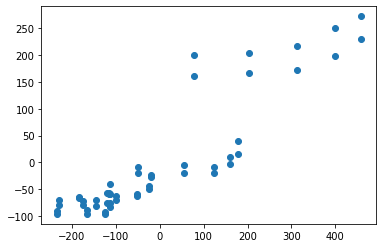

subject_17_stimulus_14_component_0   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.766270408475228, pvalue=8.856515954894064e-11)   2.5703167803688993


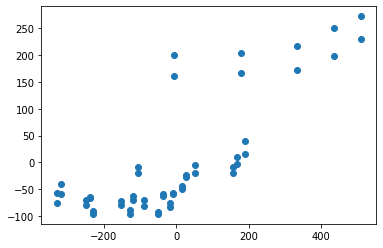

subject_17_stimulus_14_component_0   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.8929250859733909, pvalue=2.9496374482976864e-18)   4.642433411205414


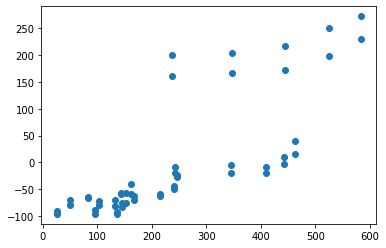

subject_17_stimulus_14_component_0   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.9352073758817304, pvalue=2.7860366276735636e-23)   4.343797779363593


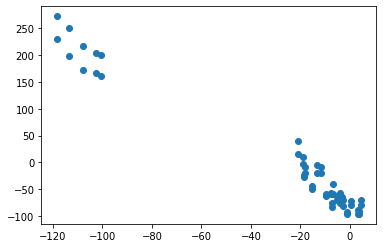

subject_17_stimulus_14_component_0   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.7789550954477299, pvalue=2.7137670635389493e-11)   4.642433411205414


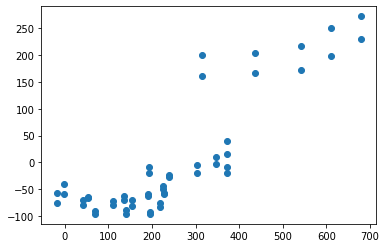

subject_17_stimulus_14_component_0   subject_14_stimulus_12_component_2   SpearmanrResult(correlation=-0.764640972219783, pvalue=1.0254630634122266e-10)   4.620597963161797


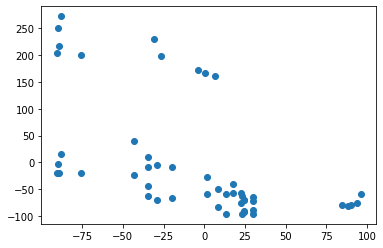

subject_17_stimulus_14_component_0   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.8150300120048019, pvalue=5.851097436636853e-13)   3.7430279152946415


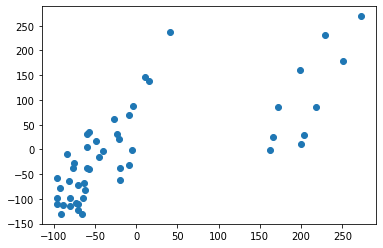

subject_17_stimulus_14_component_0   subject_15_stim_period_14_component_1   SpearmanrResult(correlation=0.7607683073229292, pvalue=1.4460788408005707e-10)   2.9174190260053363


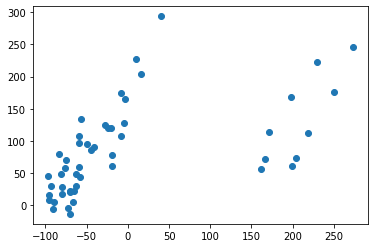

subject_17_stimulus_14_component_0   subject_15_stim_period_14_component_7   SpearmanrResult(correlation=0.7670108043217286, pvalue=8.282635283759228e-11)   4.062331236194481


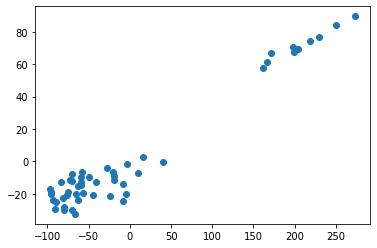

subject_17_stimulus_14_component_0   subject_15_stim_period_15_component_5   SpearmanrResult(correlation=0.776422569027611, pvalue=3.457710756190443e-11)   2.488228174730623


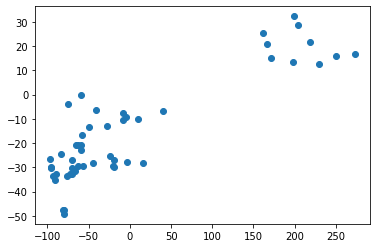

subject_17_stimulus_14_component_1   subject_12_stimulus_14_component_1   SpearmanrResult(correlation=-0.7933695124619365, pvalue=6.417196990938052e-12)   2.627391641654542


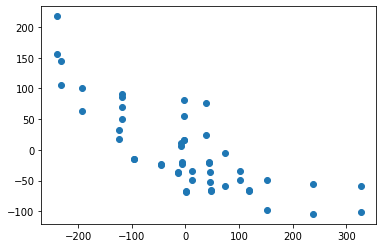

subject_17_stimulus_14_component_2   subject_14_stim_period_14_component_9   SpearmanrResult(correlation=-0.7599904157678328, pvalue=1.548240990147608e-10)   3.032718604191595


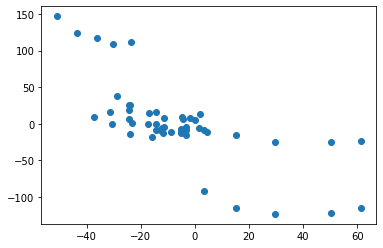

subject_17_stimulus_14_component_2   subject_16_stimulus_11_component_4   SpearmanrResult(correlation=0.7690522362607584, pvalue=8.01295733588997e-17)   5.16792151391986


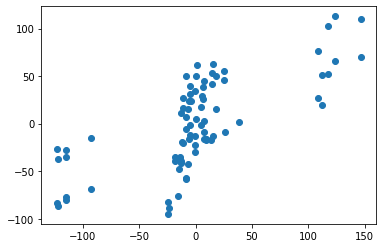

subject_17_stimulus_14_component_3   subject_12_stimulus_14_component_2   SpearmanrResult(correlation=0.8393034546805419, pvalue=2.675486113319742e-14)   2.9269443443834544


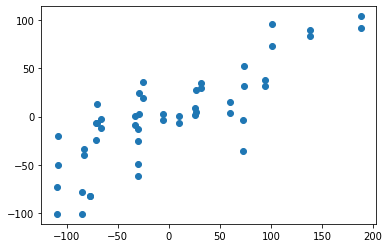

subject_17_stimulus_14_component_3   subject_15_stimulus_14_component_2   SpearmanrResult(correlation=0.7969747899159663, pvalue=4.395020774280983e-12)   2.31597521801388


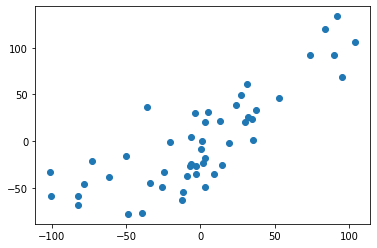

subject_17_stimulus_14_component_5   subject_12_stimulus_14_component_3   SpearmanrResult(correlation=0.770690829692918, pvalue=5.915101023023679e-11)   3.893554713073619


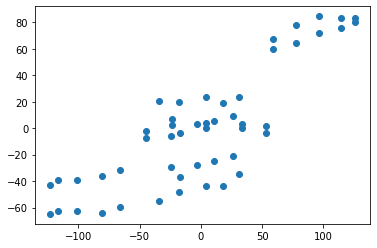

subject_17_stimulus_14_component_5   subject_13_stimulus_11_component_6   SpearmanrResult(correlation=0.9368067226890756, pvalue=1.5573139469956245e-23)   3.530858129766412


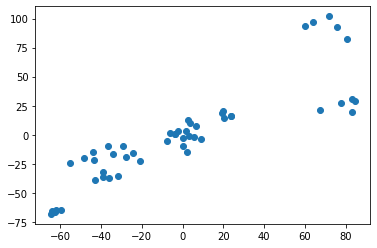

subject_17_stimulus_14_component_6   subject_13_stimulus_11_component_5   SpearmanrResult(correlation=-0.7575990396158462, pvalue=1.906708878293623e-10)   4.036173351917817


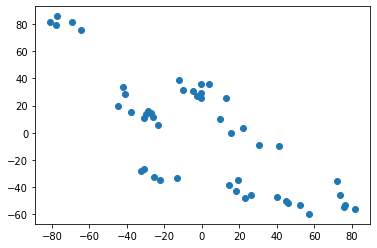

subject_17_stimulus_14_component_6   subject_13_stim_period_11_component_8   SpearmanrResult(correlation=0.7965906362545019, pvalue=4.577545661836731e-12)   3.7649170996604777


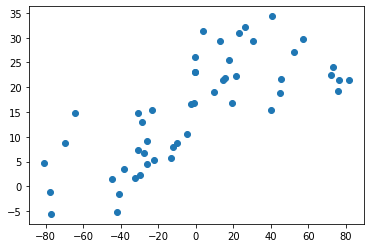

subject_17_stimulus_14_component_8   subject_15_stimulus_14_component_9   SpearmanrResult(correlation=0.7992797118847538, pvalue=3.436636103740453e-12)   3.568322108174706


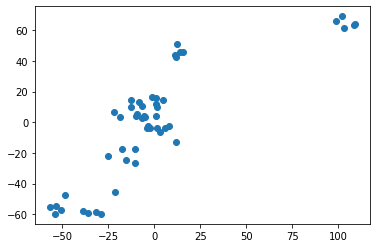

subject_17_stimulus_15_component_0   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8147028496429625, pvalue=6.080538622058337e-13)   2.837906389905525


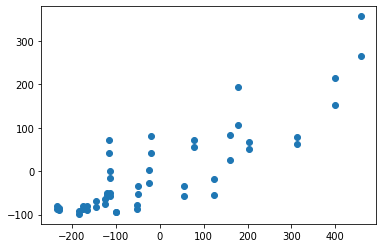

subject_17_stimulus_15_component_0   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.8033635082584532, pvalue=2.2051079148770647e-12)   1.9833127778484725


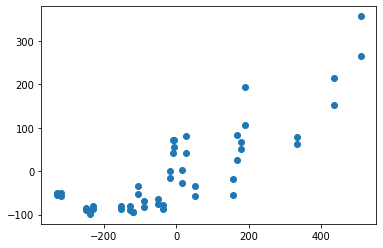

subject_17_stimulus_15_component_0   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.7906788212859513, pvalue=8.47094956972049e-12)   2.6568488014859653


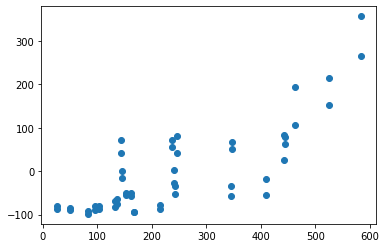

subject_17_stimulus_15_component_0   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.8598680229541434, pvalue=1.2766711593159814e-15)   2.513544548400267


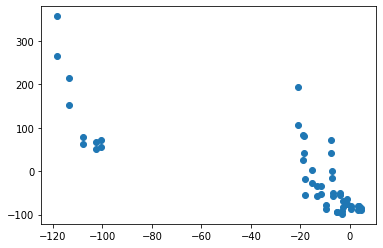

subject_17_stimulus_15_component_0   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.8737058632877819, pvalue=1.2389936056945161e-16)   1.9779539792156242


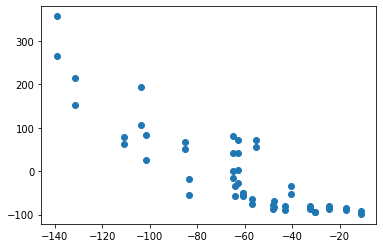

subject_17_stimulus_15_component_0   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.8131653118281138, pvalue=7.277979089978547e-13)   2.6568488014859653


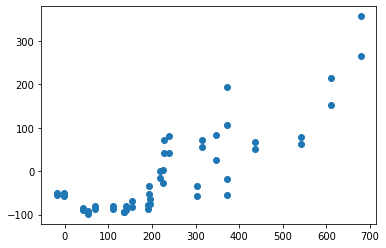

subject_17_stimulus_15_component_0   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.779015606242497, pvalue=2.6979988966243638e-11)   1.8744942400177287


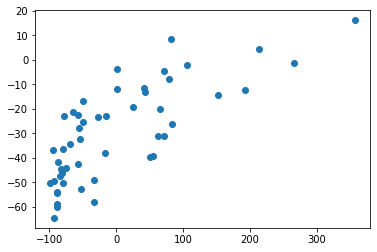

subject_17_stimulus_15_component_0   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.7707903844115479, pvalue=5.860969532897727e-11)   2.974139704047211


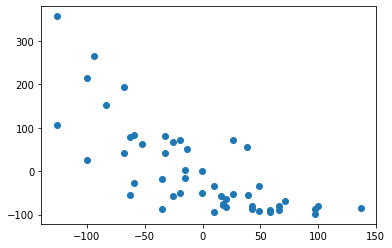

subject_17_stimulus_15_component_0   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.927875150060024, pvalue=3.358209790475972e-22)   2.061273963195657


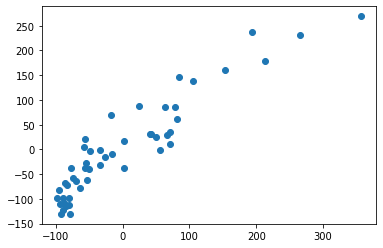

subject_17_stimulus_15_component_0   subject_15_stimulus_15_component_0   SpearmanrResult(correlation=0.8801440576230493, pvalue=3.805643235424032e-17)   1.7659010857070903


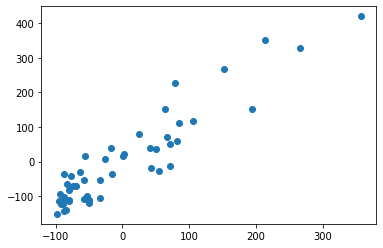

subject_17_stimulus_15_component_0   subject_15_stim_period_14_component_0   SpearmanrResult(correlation=0.8772629051620647, pvalue=6.50707884484558e-17)   2.2880624739449527


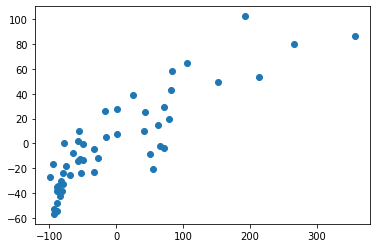

subject_17_stimulus_15_component_0   subject_15_stim_period_14_component_1   SpearmanrResult(correlation=0.8569027611044417, pvalue=2.037630562636029e-15)   1.8479753953119211


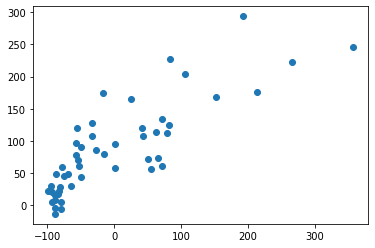

subject_17_stimulus_15_component_0   subject_15_stim_period_14_component_3   SpearmanrResult(correlation=-0.8487394957983193, pvalue=7.0049018265321205e-15)   1.4811358122203675


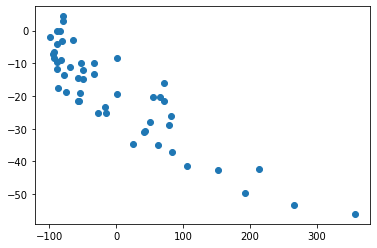

subject_17_stimulus_15_component_0   subject_15_stim_period_15_component_0   SpearmanrResult(correlation=0.8689075630252101, pvalue=2.866017755005596e-16)   2.2880624739449527


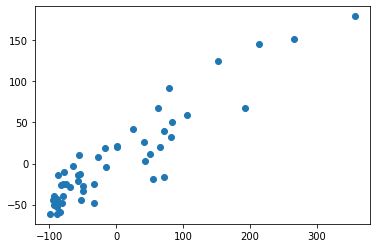

subject_17_stimulus_15_component_0   subject_15_stim_period_15_component_1   SpearmanrResult(correlation=0.8482593037214886, pvalue=7.515600900701674e-15)   1.8479753953119211


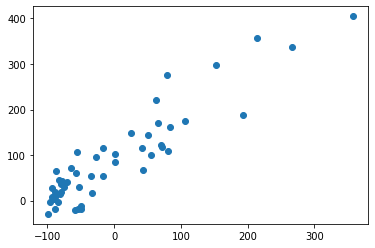

subject_17_stimulus_15_component_0   subject_17_stimulus_14_component_0   SpearmanrResult(correlation=0.7868907563025209, pvalue=1.2438183644678173e-11)   3.032127564049794


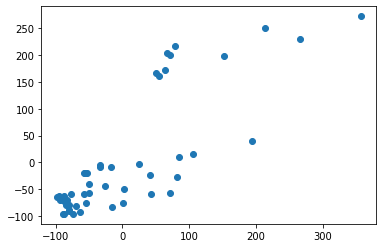

subject_17_stimulus_15_component_1   subject_12_stimulus_15_component_1   SpearmanrResult(correlation=0.8487208737964903, pvalue=7.024076102310029e-15)   4.025383575647438


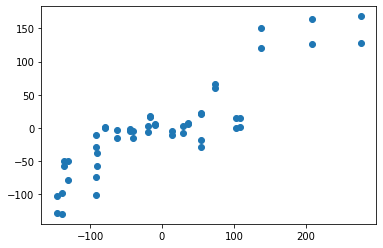

subject_17_stimulus_15_component_1   subject_12_stim_period_15_component_9   SpearmanrResult(correlation=-0.7937538969156488, pvalue=6.165579558500607e-12)   4.841665184710212


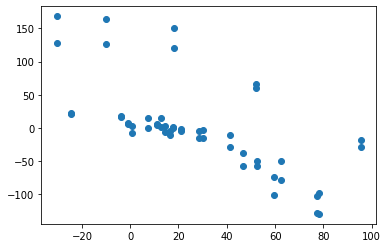

subject_17_stimulus_15_component_1   subject_13_stimulus_10_component_1   SpearmanrResult(correlation=0.7519327731092437, pvalue=3.0939643710670983e-10)   2.339972998787209


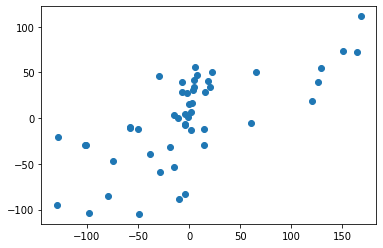

subject_17_stimulus_15_component_1   subject_15_stimulus_15_component_1   SpearmanrResult(correlation=0.914141656662665, pvalue=1.8815232013765998e-20)   2.5543842633701264


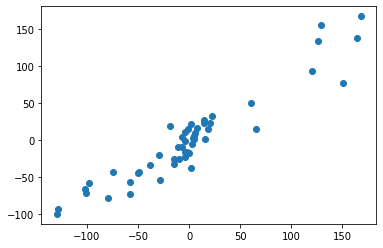

subject_17_stimulus_15_component_1   subject_15_stim_period_14_component_6   SpearmanrResult(correlation=-0.8124369747899159, pvalue=7.920324583112831e-13)   2.6160720546009912


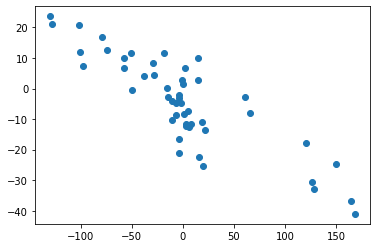

subject_17_stimulus_15_component_1   subject_15_stim_period_15_component_7   SpearmanrResult(correlation=0.8647779111644658, pvalue=5.7473045232178655e-16)   3.5420542885221


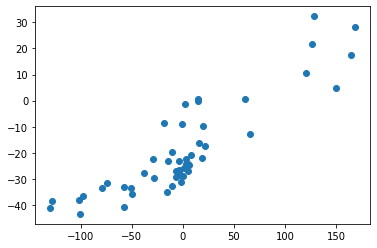

subject_17_stimulus_15_component_4   subject_12_stimulus_15_component_3   SpearmanrResult(correlation=0.7697298685586376, pvalue=6.462491087778748e-11)   4.120252275615282


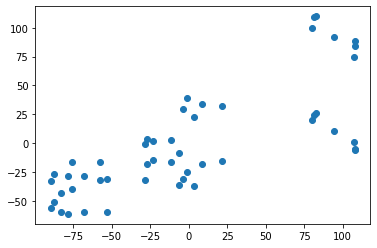

subject_17_stimulus_15_component_5   subject_15_stimulus_14_component_3   SpearmanrResult(correlation=-0.7630732292917167, pvalue=1.1794742141269023e-10)   3.2403895959509628


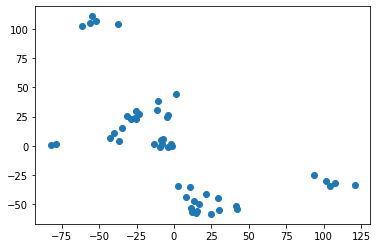

subject_17_stimulus_15_component_7   subject_13_stimulus_9_component_2   SpearmanrResult(correlation=-0.8387515006002401, pvalue=2.885917184172035e-14)   3.069367933663409


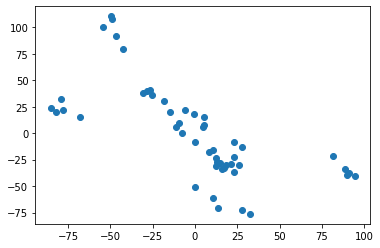

subject_17_stimulus_9_component_1   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=-0.8619296449013918, pvalue=6.050524829867778e-58)   5.121111502037491


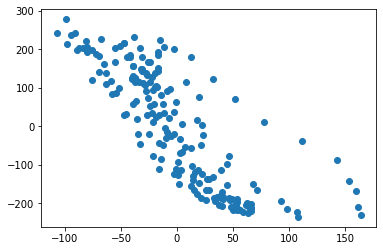

subject_17_stimulus_9_component_1   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=-0.7928512329436022, pvalue=9.885563132068571e-43)   4.683087705539297


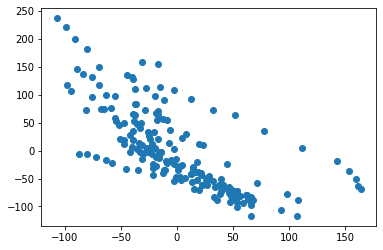

subject_17_stim_period_0_component_0   subject_17_stimulus_0_component_0   SpearmanrResult(correlation=0.9289966014470262, pvalue=3.700334238388511e-153)   8.461608279851884


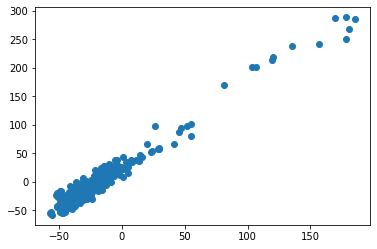

subject_17_stim_period_0_component_3   subject_17_stimulus_0_component_0   SpearmanrResult(correlation=0.8467957522490099, pvalue=5.5850180391387085e-98)   4.828932809590598


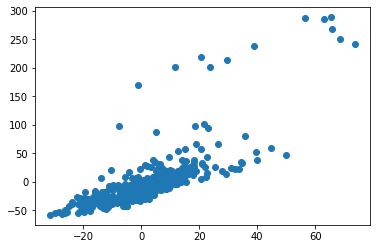

subject_17_stim_period_0_component_3   subject_17_stim_period_0_component_0   SpearmanrResult(correlation=0.8288655788655787, pvalue=2.6693394162785667e-90)   4.835924250451968


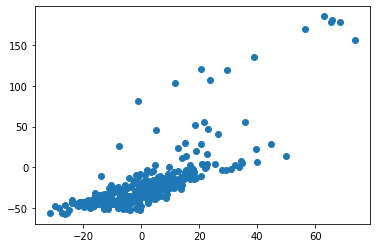

subject_17_stim_period_0_component_5   subject_17_stimulus_0_component_1   SpearmanrResult(correlation=-0.9064704574619588, pvalue=4.248940016457613e-133)   1.7248642679157902


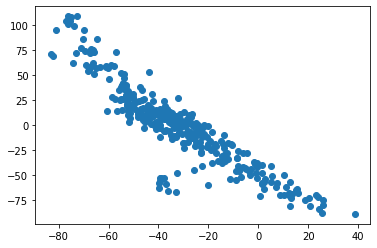

subject_17_stim_period_0_component_6   subject_17_stimulus_0_component_1   SpearmanrResult(correlation=0.8388623101795905, pvalue=1.8238849565278351e-94)   3.66548361643023


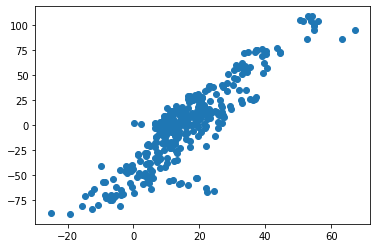

subject_17_stim_period_0_component_6   subject_17_stim_period_0_component_5   SpearmanrResult(correlation=-0.8203953349137485, pvalue=5.617686909049096e-87)   1.8150147334673


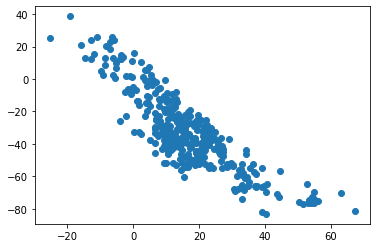

subject_17_stim_period_10_component_0   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=0.9995812196511408, pvalue=2.7547327470913795e-294)   6.868215672287933


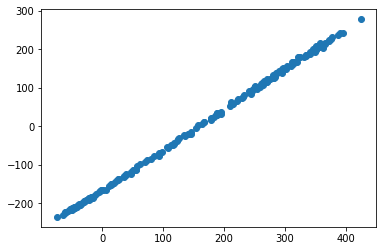

subject_17_stim_period_10_component_0   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=0.8932771342538591, pvalue=6.764616430076289e-68)   6.93195656619309


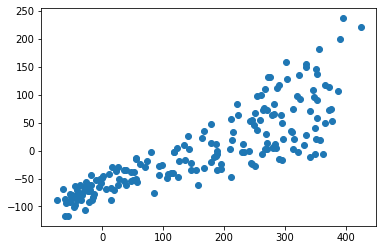

subject_17_stim_period_10_component_0   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=0.8787758050077314, pvalue=5.977981319836391e-63)   6.197233086841039


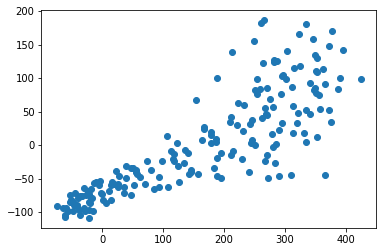

subject_17_stim_period_10_component_0   subject_17_stimulus_9_component_1   SpearmanrResult(correlation=-0.8654307842552154, pvalue=6.278651432565912e-59)   5.3258914515264415


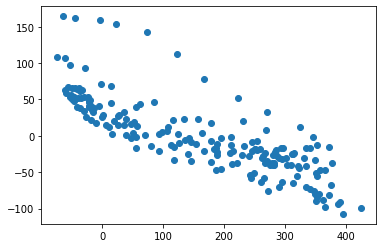

subject_17_stim_period_10_component_2   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=-0.924327916881426, pvalue=2.0007103186447193e-81)   2.935093151517457


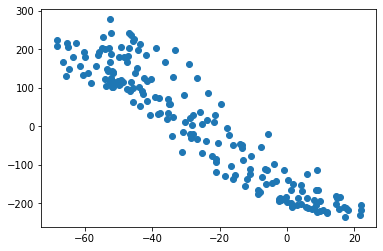

subject_17_stim_period_10_component_2   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=-0.8358584488511517, pvalue=2.2354902391688215e-51)   2.3016196814105725


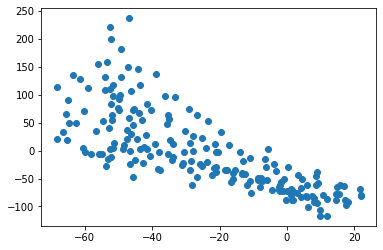

subject_17_stim_period_10_component_2   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=-0.8533302362802812, pvalue=1.224355811290301e-55)   3.641855082707294


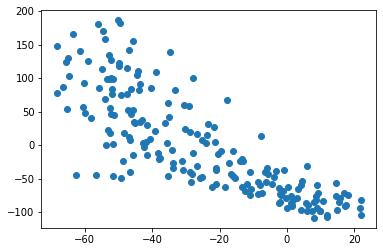

subject_17_stim_period_10_component_2   subject_17_stimulus_9_component_1   SpearmanrResult(correlation=0.8001993869191331, pvalue=4.673987445764455e-44)   2.76791576857897


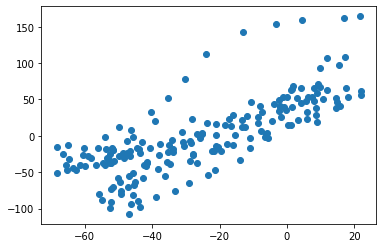

subject_17_stim_period_10_component_2   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=-0.922306920218105, pvalue=2.2192256212011545e-80)   3.071571977888851


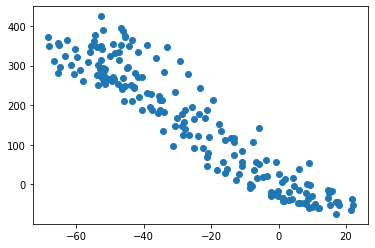

subject_17_stim_period_10_component_3   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=-0.8681401405203051, pvalue=1.040546597114071e-59)   4.174831447344299


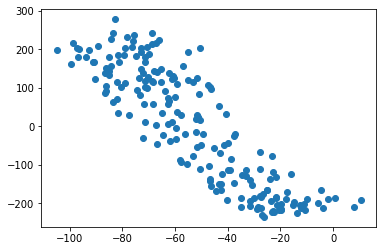

subject_17_stim_period_10_component_3   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=-0.7965490464693598, pvalue=2.1620837670386186e-43)   4.365899612857882


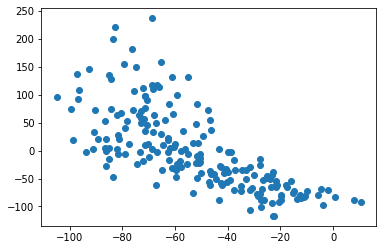

subject_17_stim_period_10_component_3   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=-0.7937464395193012, pvalue=6.861669069250838e-43)   4.327875496874086


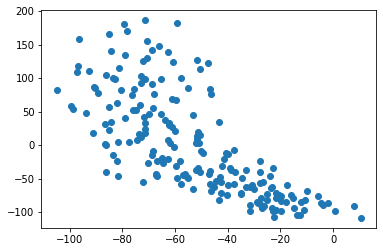

subject_17_stim_period_10_component_3   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=-0.8612124623606329, pvalue=9.55008770349593e-58)   4.835924250451968


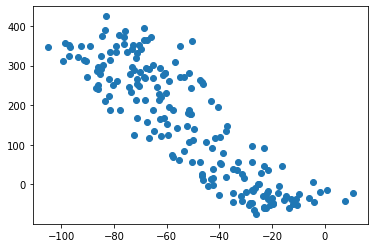

subject_17_stim_period_10_component_3   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=0.7933802186474244, pvalue=7.968833027124886e-43)   2.471787774458021


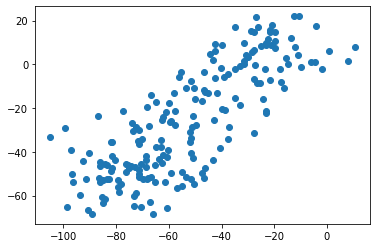

subject_17_stim_period_10_component_4   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=0.8234103301413342, pvalue=1.2331893960746396e-48)   4.84715025055787


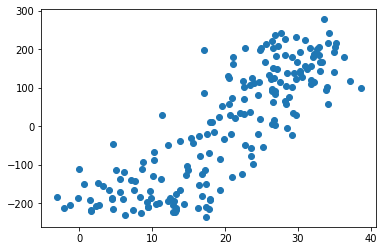

subject_17_stim_period_10_component_4   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=0.8205755093182868, pvalue=4.845877719302965e-48)   5.254935659089215


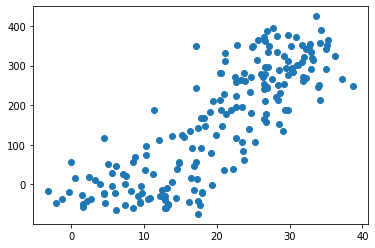

subject_17_stim_period_10_component_4   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=-0.8085139570843395, pvalue=1.2639154794767926e-45)   2.70799015194447


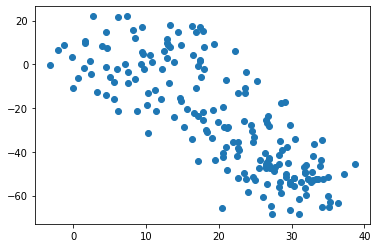

subject_17_stim_period_10_component_8   subject_17_stimulus_10_component_1   SpearmanrResult(correlation=0.7994364267693895, pvalue=6.454364639444746e-44)   4.89594777614071


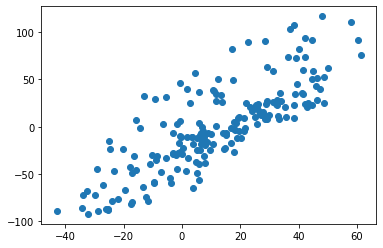

subject_17_stim_period_11_component_0   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=0.8125356048069882, pvalue=2.0677609877180146e-46)   6.868215672287933


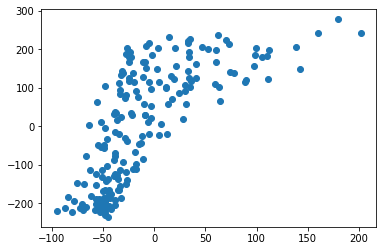

subject_17_stim_period_11_component_0   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=0.9602548625993546, pvalue=3.027512440421191e-107)   6.93195656619309


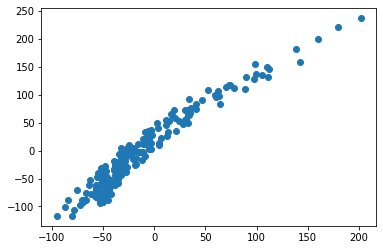

subject_17_stim_period_11_component_0   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=0.7861982204378374, pvalue=1.410798993505738e-41)   6.197233086841039


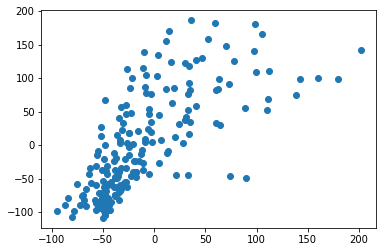

subject_17_stim_period_11_component_0   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=0.8138173778585576, pvalue=1.1506031840528535e-46)   9.444687907518151


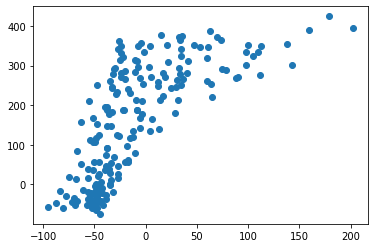

subject_17_stim_period_11_component_0   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=-0.7587096139760736, pvalue=3.273475292196655e-37)   3.071571977888851


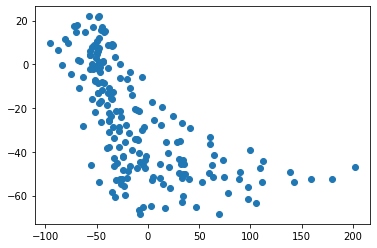

subject_17_stim_period_11_component_1   subject_17_stimulus_11_component_2   SpearmanrResult(correlation=0.8245683341019451, pvalue=7.001291182871977e-49)   4.8258910400858


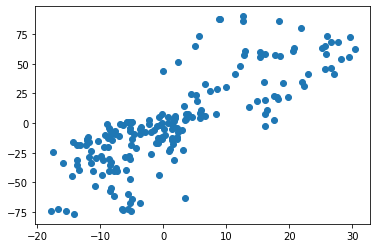

subject_17_stim_period_11_component_2   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=-0.9268422944415811, pvalue=9.114000217555237e-83)   2.935093151517457


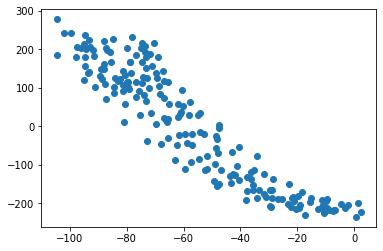

subject_17_stim_period_11_component_2   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=-0.9567740688495241, pvalue=7.465392565810375e-104)   2.3016196814105725


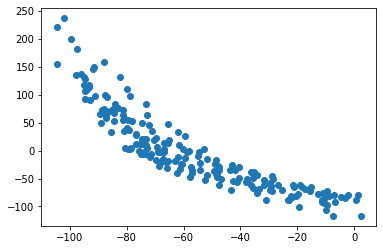

subject_17_stim_period_11_component_2   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=-0.8869445650109867, pvalue=1.1838313306832897e-65)   3.641855082707294


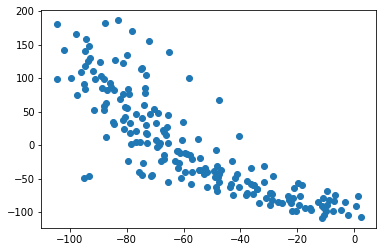

subject_17_stim_period_11_component_2   subject_17_stimulus_9_component_1   SpearmanrResult(correlation=0.7940482326452, pvalue=6.064498076228749e-43)   2.76791576857897


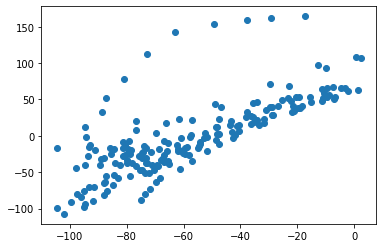

subject_17_stim_period_11_component_2   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=-0.9266388384016494, pvalue=1.1749739620818447e-82)   3.071571977888851


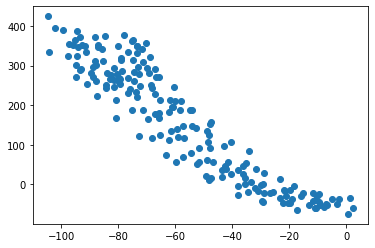

subject_17_stim_period_11_component_2   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=0.8790911618696254, pvalue=4.7408442924403945e-63)   3.6521643610578094


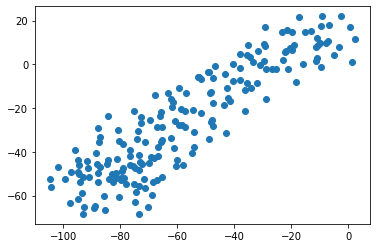

subject_17_stim_period_11_component_2   subject_17_stim_period_10_component_3   SpearmanrResult(correlation=0.858152144426661, pvalue=6.508875575726464e-57)   2.471787774458021


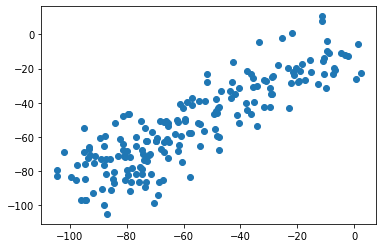

subject_17_stim_period_11_component_2   subject_17_stim_period_10_component_4   SpearmanrResult(correlation=-0.7506798822667716, pvalue=4.801625383728718e-36)   2.70799015194447


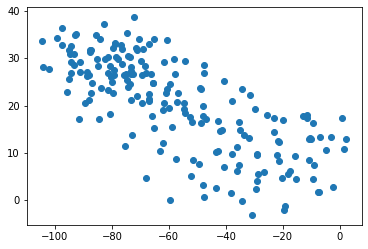

subject_17_stim_period_11_component_2   subject_17_stim_period_11_component_0   SpearmanrResult(correlation=-0.8771295065512846, pvalue=1.9848481170947986e-62)   3.071571977888851


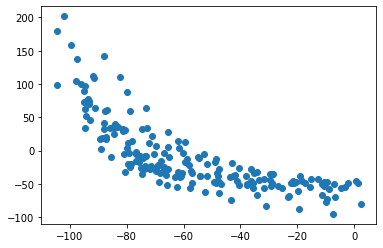

subject_17_stim_period_11_component_4   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=-0.8663700729728998, pvalue=3.382064133776737e-59)   4.84715025055787


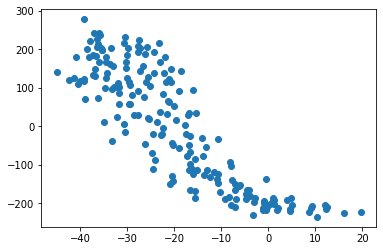

subject_17_stim_period_11_component_4   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=-0.8957677752760222, pvalue=8.109980429422369e-69)   4.6087644079329815


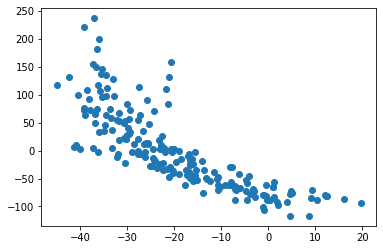

subject_17_stim_period_11_component_4   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=-0.8375640886525786, pvalue=9.033337932549901e-52)   5.069604764062476


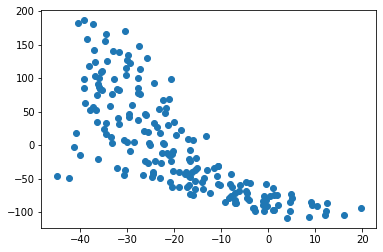

subject_17_stim_period_11_component_4   subject_17_stimulus_9_component_1   SpearmanrResult(correlation=0.756393606054852, pvalue=7.179079140015656e-37)   4.53745830597781


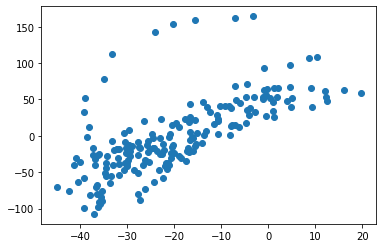

subject_17_stim_period_11_component_4   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=-0.8668176762607495, pvalue=2.5143488933341045e-59)   5.254935659089215


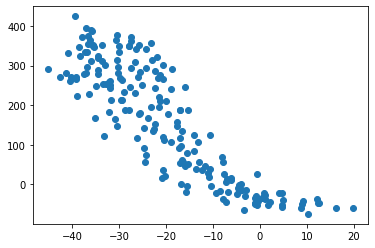

subject_17_stim_period_11_component_4   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=0.7929343108265741, pvalue=9.556930629525639e-43)   2.70799015194447


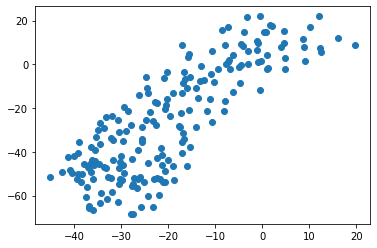

subject_17_stim_period_11_component_4   subject_17_stim_period_10_component_3   SpearmanrResult(correlation=0.7901469630795107, pvalue=2.946510704414207e-42)   4.260710085028884


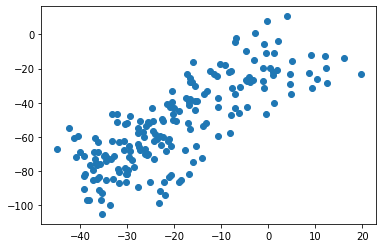

subject_17_stim_period_11_component_4   subject_17_stim_period_11_component_0   SpearmanrResult(correlation=-0.7961183978515042, pvalue=2.5849476836138813e-43)   5.254935659089215


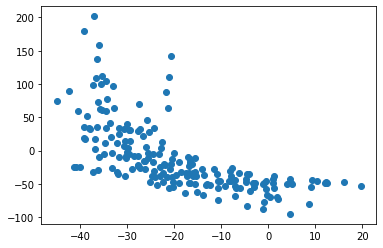

subject_17_stim_period_11_component_4   subject_17_stim_period_11_component_2   SpearmanrResult(correlation=0.9045265577950792, pvalue=2.976340125976854e-72)   2.70799015194447


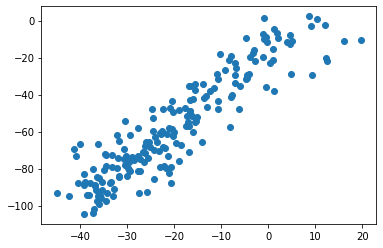

subject_17_stim_period_11_component_7   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=0.821324905732035, pvalue=3.382826455174711e-48)   5.007145272696534


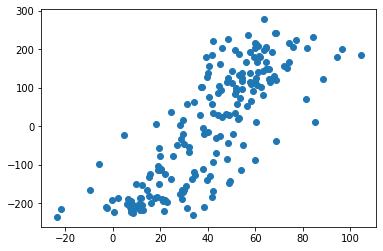

subject_17_stim_period_11_component_7   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=0.8038259908309145, pvalue=9.886210782617494e-45)   5.084101608204616


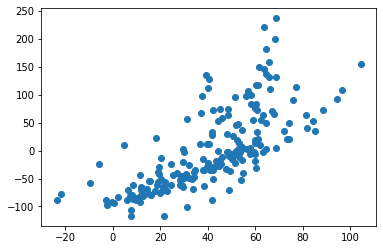

subject_17_stim_period_11_component_7   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=0.8008996147898978, pvalue=3.4714491652003826e-44)   4.79799518438133


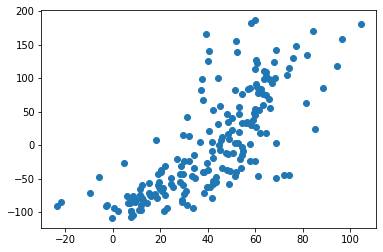

subject_17_stim_period_11_component_7   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=0.8218267639638662, pvalue=2.6566718949207227e-48)   5.472627914067792


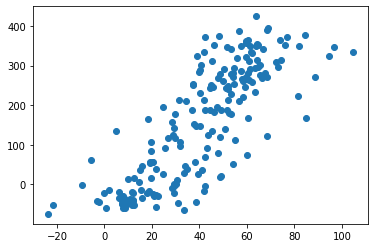

subject_17_stim_period_11_component_7   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=-0.8229457721834903, pvalue=1.5458024978876333e-48)   2.607916520340215


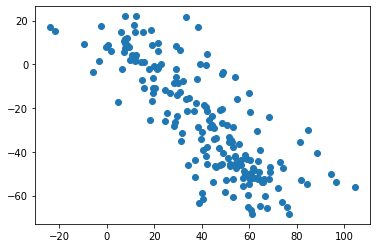

subject_17_stim_period_11_component_7   subject_17_stim_period_11_component_2   SpearmanrResult(correlation=-0.8245802023709411, pvalue=6.960638557580902e-49)   2.607916520340215


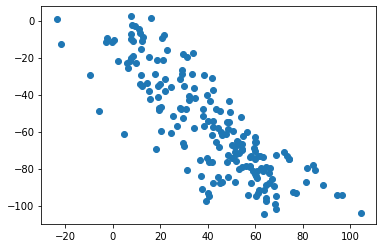

subject_17_stim_period_11_component_7   subject_17_stim_period_11_component_4   SpearmanrResult(correlation=-0.7735788595610775, pvalue=1.697823486762611e-39)   4.3717903521596515


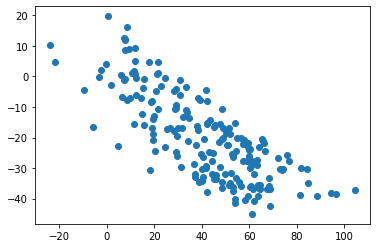

subject_17_stim_period_11_component_9   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=-0.809812684805903, pvalue=7.077332788314591e-46)   3.1917081101150564


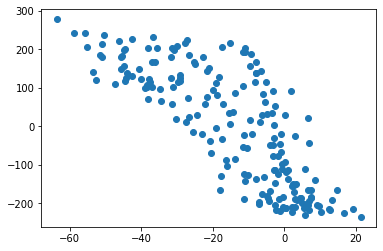

subject_17_stim_period_11_component_9   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=-0.8391205273580555, pvalue=3.915169112789543e-52)   2.922532205226013


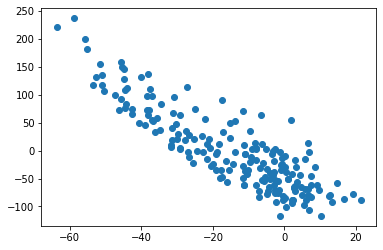

subject_17_stim_period_11_component_9   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=-0.8033563464720724, pvalue=1.2111297142891167e-44)   3.2179442409401195


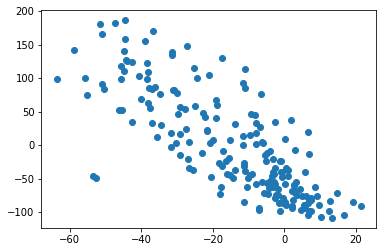

subject_17_stim_period_11_component_9   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=-0.8085682120283213, pvalue=1.2337737352860568e-45)   3.257226799699331


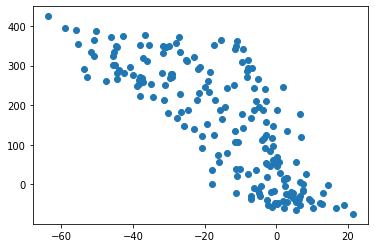

subject_17_stim_period_11_component_9   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=0.7727633399343515, pvalue=2.2892994526880206e-39)   2.2498724595719364


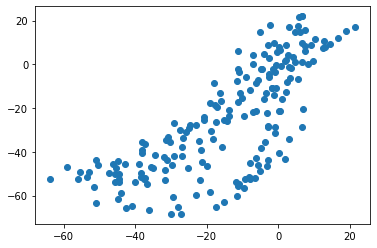

subject_17_stim_period_11_component_9   subject_17_stim_period_11_component_2   SpearmanrResult(correlation=0.8344783387136154, pvalue=4.61850306467906e-51)   2.2498724595719364


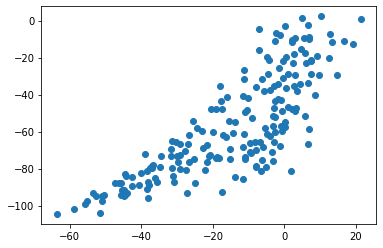

subject_17_stim_period_11_component_9   subject_17_stim_period_11_component_4   SpearmanrResult(correlation=0.8489321948837589, pvalue=1.6258196844922312e-54)   3.082233103032313


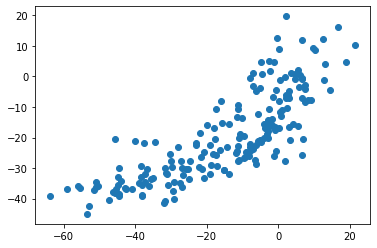

subject_17_stim_period_12_component_0   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=0.8646712150394705, pvalue=1.0319611455849924e-58)   6.868215672287933


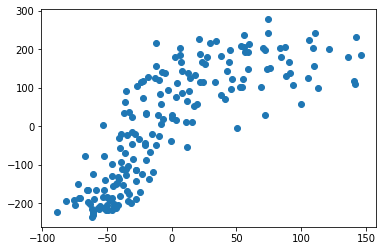

subject_17_stim_period_12_component_0   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=0.8736707538724467, pvalue=2.3371021833663366e-61)   6.93195656619309


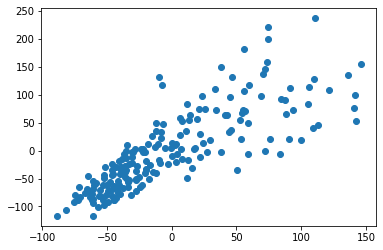

subject_17_stim_period_12_component_0   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=0.9758768955321054, pvalue=1.5879115261434404e-127)   6.197233086841039


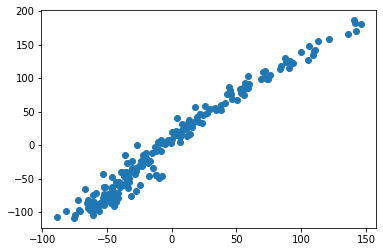

subject_17_stim_period_12_component_0   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=0.8651289911293168, pvalue=7.651815181866307e-59)   9.444687907518151


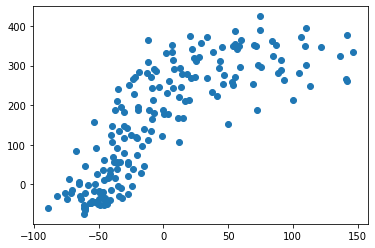

subject_17_stim_period_12_component_0   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=-0.8419502617801048, pvalue=8.36740668995369e-53)   3.071571977888851


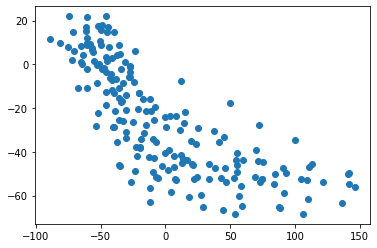

subject_17_stim_period_12_component_0   subject_17_stim_period_11_component_0   SpearmanrResult(correlation=0.7956877492336489, pvalue=3.0891903689020996e-43)   9.444687907518151


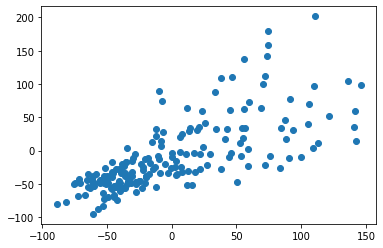

subject_17_stim_period_12_component_0   subject_17_stim_period_11_component_2   SpearmanrResult(correlation=-0.8690828201719885, pvalue=5.515611243793279e-60)   3.071571977888851


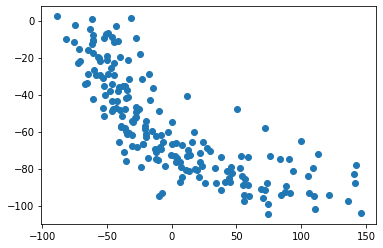

subject_17_stim_period_12_component_0   subject_17_stim_period_11_component_4   SpearmanrResult(correlation=-0.8212214822450697, pvalue=3.555210797498185e-48)   5.254935659089215


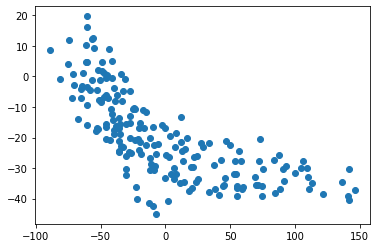

subject_17_stim_period_12_component_0   subject_17_stim_period_11_component_7   SpearmanrResult(correlation=0.8088411822152294, pvalue=1.0925580631552395e-45)   5.472627914067792


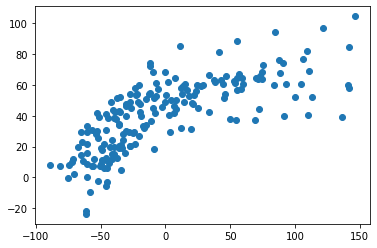

subject_17_stim_period_12_component_0   subject_17_stim_period_11_component_9   SpearmanrResult(correlation=-0.8124847407970053, pvalue=2.1162264699822155e-46)   3.257226799699331


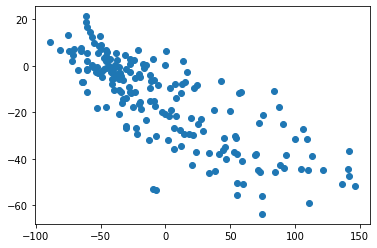

subject_17_stim_period_12_component_2   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=0.8225252963676317, pvalue=1.8954836621183622e-48)   2.935093151517457


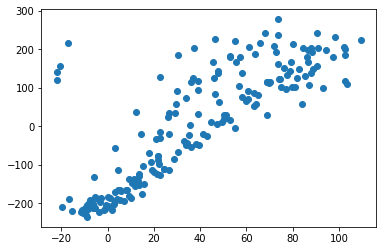

subject_17_stim_period_12_component_2   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=0.812003228169167, pvalue=2.6342816247474266e-46)   2.3016196814105725


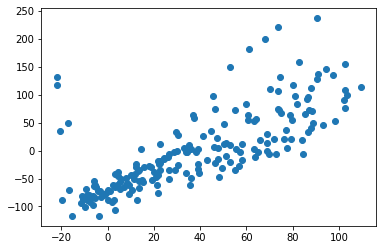

subject_17_stim_period_12_component_2   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=0.9620944442937365, pvalue=3.662319865229539e-109)   3.641855082707294


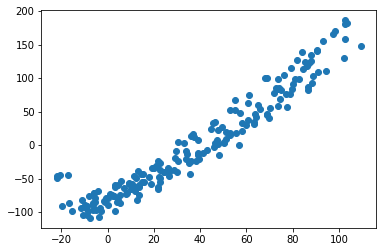

subject_17_stim_period_12_component_2   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=0.8219708786588179, pvalue=2.4782301957477523e-48)   3.071571977888851


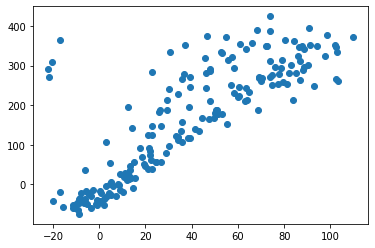

subject_17_stim_period_12_component_2   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=-0.8097092613189378, pvalue=7.413039769759541e-46)   3.6521643610578094


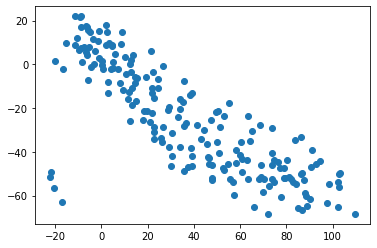

subject_17_stim_period_12_component_2   subject_17_stim_period_10_component_3   SpearmanrResult(correlation=-0.7675650381140983, pvalue=1.4949081861273246e-38)   2.471787774458021


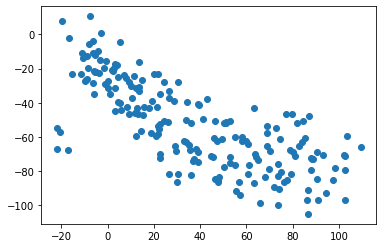

subject_17_stim_period_12_component_2   subject_17_stim_period_11_component_2   SpearmanrResult(correlation=-0.8372453408566857, pvalue=1.0708655954203575e-51)   3.6521643610578094


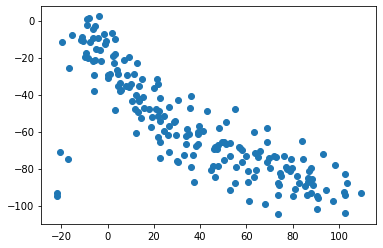

subject_17_stim_period_12_component_2   subject_17_stim_period_11_component_4   SpearmanrResult(correlation=-0.766440943493476, pvalue=2.228655262804163e-38)   2.70799015194447


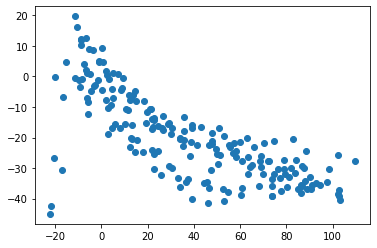

subject_17_stim_period_12_component_2   subject_17_stim_period_12_component_0   SpearmanrResult(correlation=0.8982872392371756, pvalue=8.976090600195214e-70)   3.071571977888851


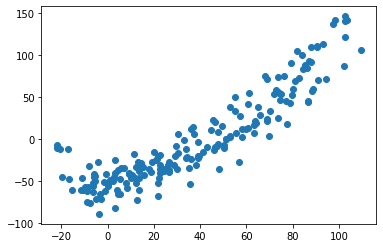

subject_17_stim_period_12_component_2   subject_17_stim_period_12_component_1   SpearmanrResult(correlation=-0.7585231126061364, pvalue=3.4883164262827555e-37)   3.0149878343952587


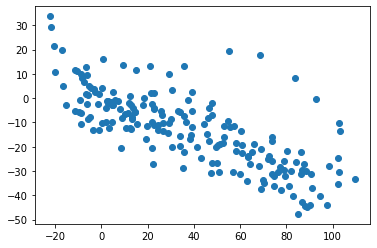

subject_17_stim_period_12_component_4   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=-0.8262671920353744, pvalue=3.0283855708985602e-49)   4.84715025055787


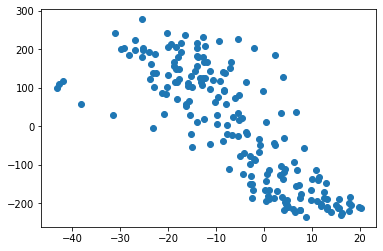

subject_17_stim_period_12_component_4   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=-0.8179916176111549, pvalue=1.6521204699715686e-47)   4.6087644079329815


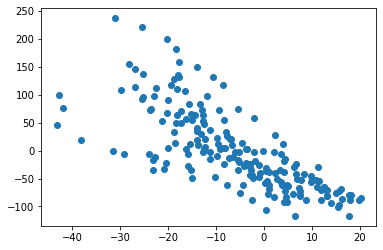

subject_17_stim_period_12_component_4   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=-0.8766835987304344, pvalue=2.739056777074549e-62)   5.069604764062476


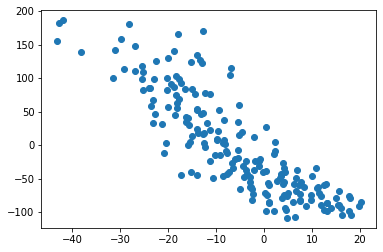

subject_17_stim_period_12_component_4   subject_17_stimulus_9_component_1   SpearmanrResult(correlation=0.7513835010715353, pvalue=3.8103659456772464e-36)   4.53745830597781


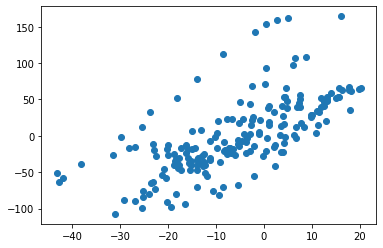

subject_17_stim_period_12_component_4   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=-0.8269402924341481, pvalue=2.16724676914323e-49)   5.254935659089215


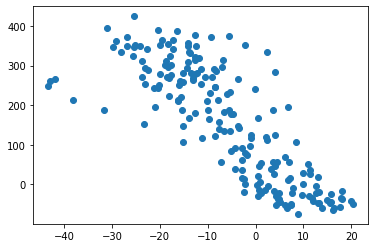

subject_17_stim_period_12_component_4   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=0.802401798551393, pvalue=1.826604105768428e-44)   2.70799015194447


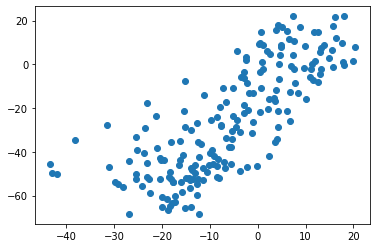

subject_17_stim_period_12_component_4   subject_17_stim_period_11_component_0   SpearmanrResult(correlation=-0.7501441146949517, pvalue=5.723071537050839e-36)   5.254935659089215


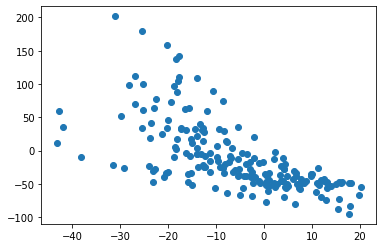

subject_17_stim_period_12_component_4   subject_17_stim_period_11_component_2   SpearmanrResult(correlation=0.8259874399804684, pvalue=3.478703977200584e-49)   2.70799015194447


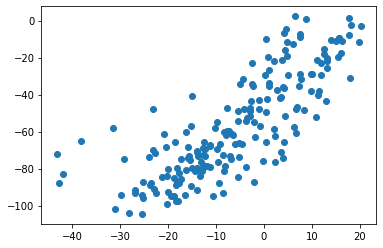

subject_17_stim_period_12_component_4   subject_17_stim_period_11_component_4   SpearmanrResult(correlation=0.8199566638634948, pvalue=6.51215467771172e-48)   5.632243513851697


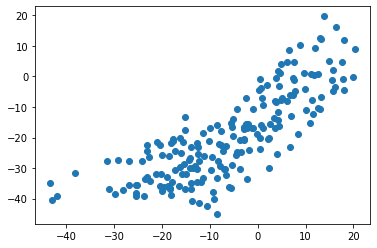

subject_17_stim_period_12_component_4   subject_17_stim_period_11_component_9   SpearmanrResult(correlation=0.7511664812956081, pvalue=4.0923796992798695e-36)   3.082233103032313


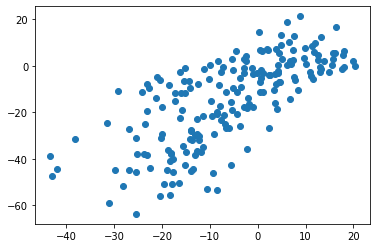

subject_17_stim_period_12_component_4   subject_17_stim_period_12_component_0   SpearmanrResult(correlation=-0.8310738409787594, pvalue=2.68910475827614e-50)   5.254935659089215


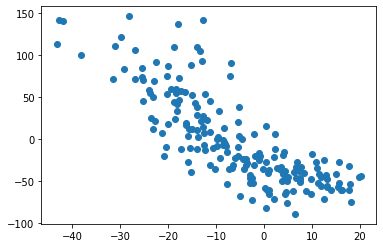

subject_17_stim_period_12_component_4   subject_17_stim_period_12_component_2   SpearmanrResult(correlation=-0.8593660987982531, pvalue=3.056574023165412e-57)   2.70799015194447


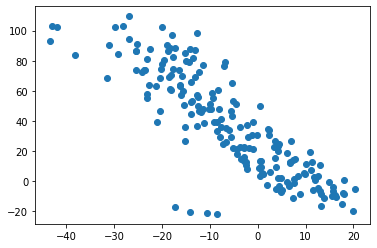

subject_17_stim_period_12_component_6   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=0.8242478908390528, pvalue=8.192015562969895e-49)   4.790344370729594


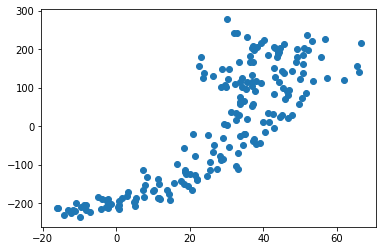

subject_17_stim_period_12_component_6   subject_17_stimulus_9_component_1   SpearmanrResult(correlation=-0.7543370045845428, pvalue=1.4313389041013007e-36)   4.417930055672679


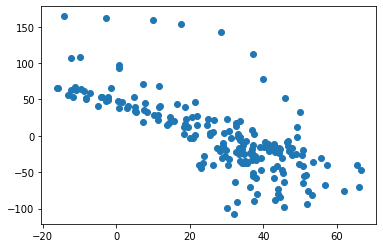

subject_17_stim_period_12_component_6   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=0.8238375878251906, pvalue=1.0012208110108009e-48)   5.25470485989964


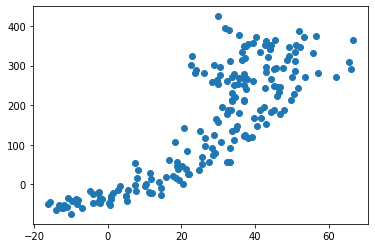

subject_17_stim_period_12_component_6   subject_17_stim_period_10_component_3   SpearmanrResult(correlation=-0.7810677372975614, pvalue=1.0278702340267073e-40)   4.23264097061724


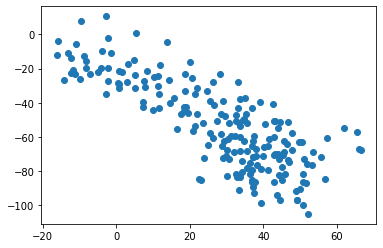

subject_17_stim_period_12_component_6   subject_17_stim_period_11_component_2   SpearmanrResult(correlation=-0.7699030871063127, pvalue=6.46757792147003e-39)   3.082494207333249


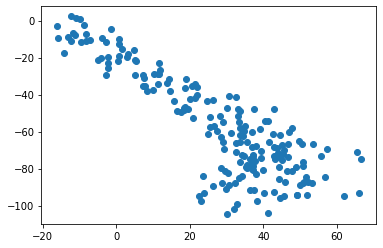

subject_17_stim_period_12_component_6   subject_17_stim_period_11_component_4   SpearmanrResult(correlation=-0.7878631690312782, pvalue=7.319026673614354e-42)   4.738079314087944


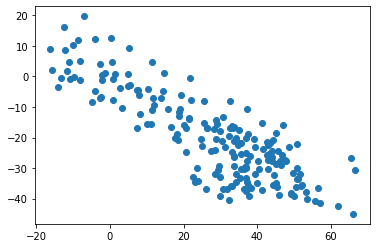

subject_17_stim_period_12_component_6   subject_17_stim_period_11_component_6   SpearmanrResult(correlation=0.7735466456880884, pvalue=1.7180288592719695e-39)   5.924322838958252


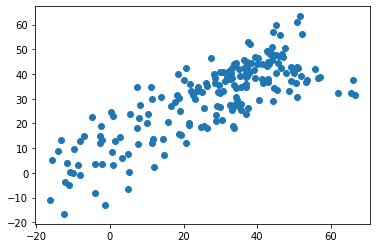

subject_17_stim_period_12_component_7   subject_17_stimulus_12_component_2   SpearmanrResult(correlation=-0.8445782356292219, pvalue=1.9422020202674242e-53)   4.682396149375075


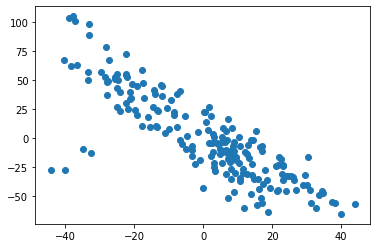

subject_17_stim_period_12_component_9   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=0.7545947155684563, pvalue=1.3132669635280192e-36)   3.1917081101150564


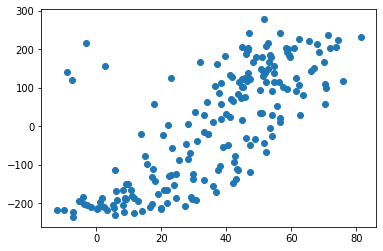

subject_17_stim_period_12_component_9   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=0.8477436725171583, pvalue=3.224543456865917e-54)   3.2179442409401195


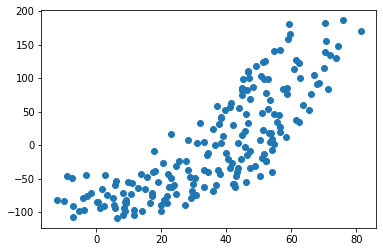

subject_17_stim_period_12_component_9   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=0.7544031277975206, pvalue=1.4000822275252182e-36)   3.257226799699331


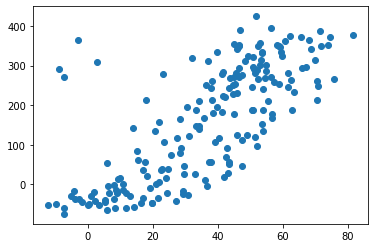

subject_17_stim_period_12_component_9   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=-0.7606848330304099, pvalue=1.6637211271339418e-37)   2.2498724595719364


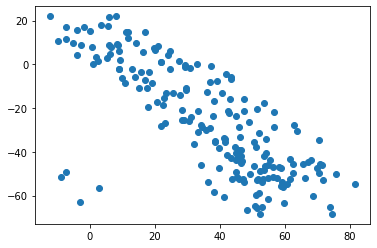

subject_17_stim_period_12_component_9   subject_17_stim_period_12_component_0   SpearmanrResult(correlation=0.8167149309605838, pvalue=3.0068880484673894e-47)   3.257226799699331


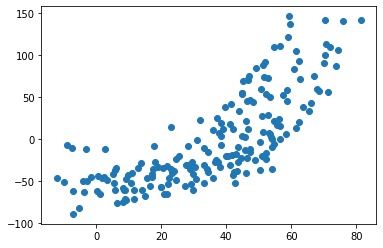

subject_17_stim_period_12_component_9   subject_17_stim_period_12_component_2   SpearmanrResult(correlation=0.8527012180234925, pvalue=1.7814825856983e-55)   2.2498724595719364


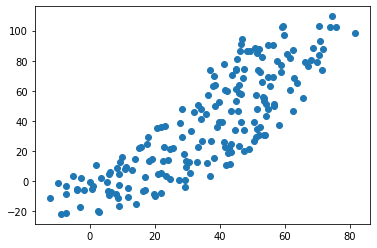

subject_17_stim_period_14_component_0   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8712073643386529, pvalue=1.9254381106527735e-16)   5.38658129833968


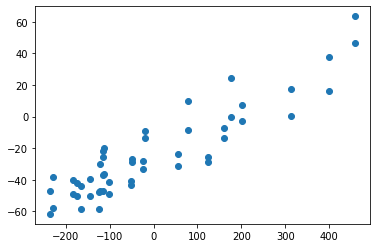

subject_17_stim_period_14_component_0   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.777033173179169, pvalue=3.262463442072997e-11)   2.4677274402619647


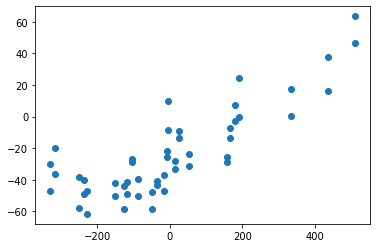

subject_17_stim_period_14_component_0   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.8454536059399368, pvalue=1.1283764226685102e-14)   4.878807904512358


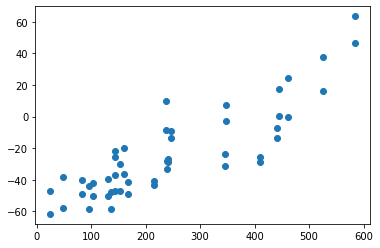

subject_17_stim_period_14_component_0   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.9065707340801732, pvalue=1.310548537970944e-19)   4.783776602028273


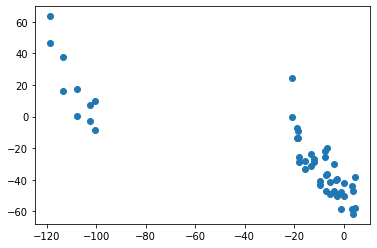

subject_17_stim_period_14_component_0   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.7806848254894347, pvalue=2.2956988896102914e-11)   2.3372843115822124


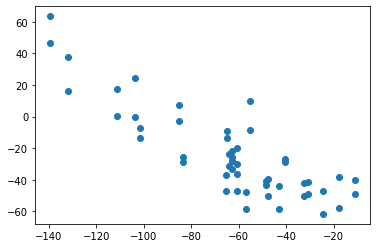

subject_17_stim_period_14_component_0   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.787603745656254, pvalue=1.1577514075372112e-11)   4.878807904512358


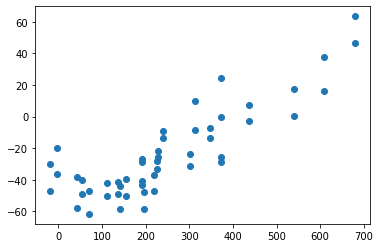

subject_17_stim_period_14_component_0   subject_14_stimulus_9_component_1   SpearmanrResult(correlation=-0.7834735470570634, pvalue=1.747380171851892e-11)   5.7258548547722175


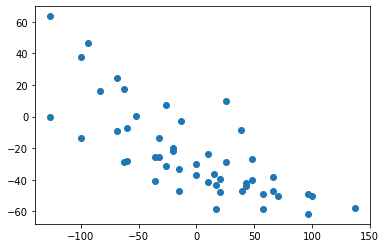

subject_17_stim_period_14_component_0   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.8591116446578632, pvalue=1.4398254983752165e-15)   3.462795721446186


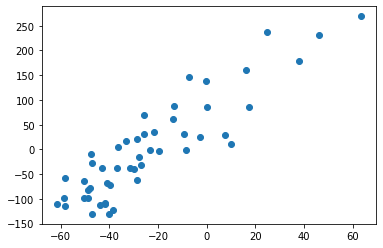

subject_17_stim_period_14_component_0   subject_15_stimulus_15_component_0   SpearmanrResult(correlation=0.8103241296518606, pvalue=1.0101995167705362e-12)   3.1670157375457735


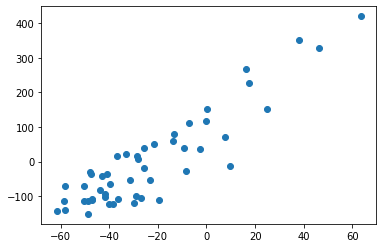

subject_17_stim_period_14_component_0   subject_15_stim_period_14_component_1   SpearmanrResult(correlation=0.7893877551020407, pvalue=9.664330672645211e-12)   2.8153231099938223


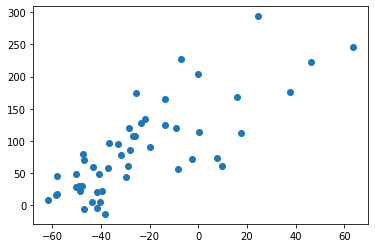

subject_17_stim_period_14_component_0   subject_15_stim_period_14_component_3   SpearmanrResult(correlation=-0.7777671068427371, pvalue=3.0415801025679786e-11)   1.7629777522124657


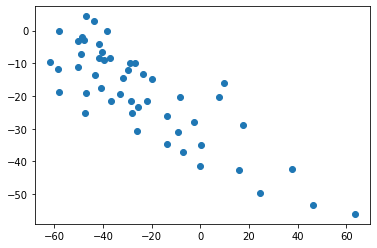

subject_17_stim_period_14_component_0   subject_15_stim_period_14_component_7   SpearmanrResult(correlation=0.7559663865546218, pvalue=2.1950330511034236e-10)   3.524689200570539


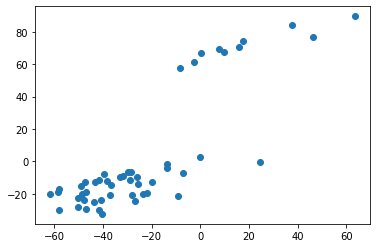

subject_17_stim_period_14_component_0   subject_15_stim_period_15_component_0   SpearmanrResult(correlation=0.7669147659063624, pvalue=8.355038317354347e-11)   6.964791340011596


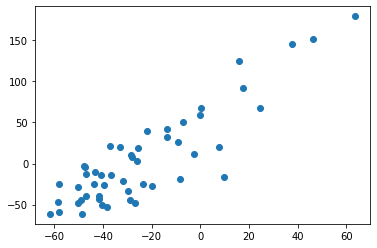

subject_17_stim_period_14_component_0   subject_15_stim_period_15_component_1   SpearmanrResult(correlation=0.8090756302521008, pvalue=1.164742128055993e-12)   2.8153231099938223


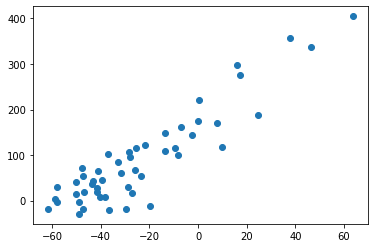

subject_17_stim_period_14_component_0   subject_17_stimulus_14_component_0   SpearmanrResult(correlation=0.9411284513805521, pvalue=2.987641955413351e-24)   6.0126644295530465


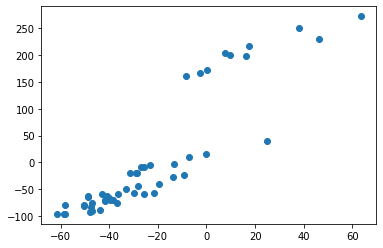

subject_17_stim_period_14_component_0   subject_17_stimulus_15_component_0   SpearmanrResult(correlation=0.880048019207683, pvalue=3.875155434024353e-17)   3.047246532985683


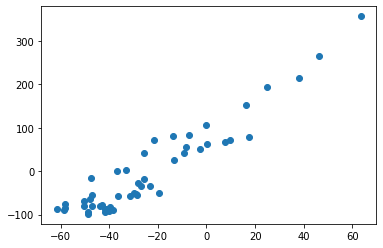

subject_17_stim_period_14_component_1   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.912913077566424, pvalue=2.6089429295168016e-20)   4.291686925159791


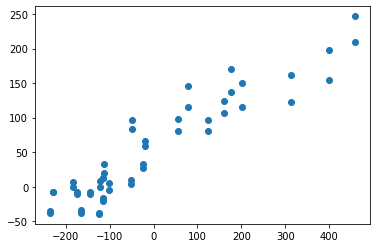

subject_17_stim_period_14_component_1   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.7649250628872354, pvalue=9.996734100692107e-11)   2.4418324768625395


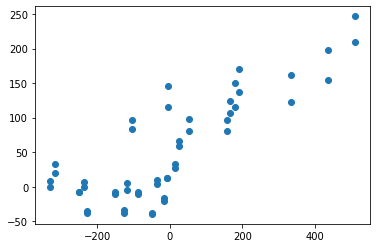

subject_17_stim_period_14_component_1   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.9027268895430514, pvalue=3.299223148861414e-19)   3.969230652633102


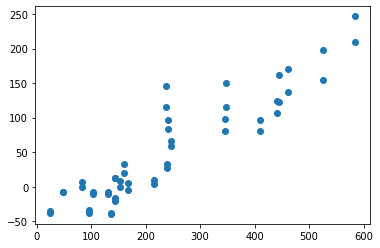

subject_17_stim_period_14_component_1   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.9282884557149114, pvalue=2.9393900645241435e-22)   3.663941195110474


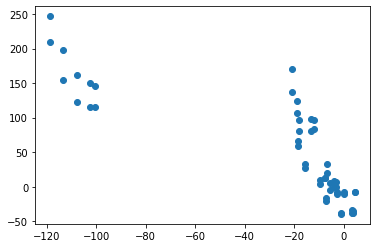

subject_17_stim_period_14_component_1   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.7704986374660621, pvalue=6.020943062064776e-11)   3.969230652633102


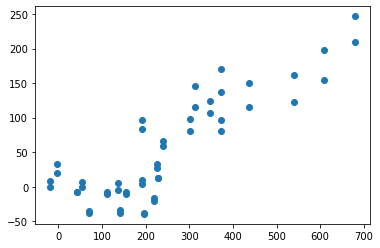

subject_17_stim_period_14_component_1   subject_14_stimulus_12_component_2   SpearmanrResult(correlation=-0.759932828510463, pvalue=1.5560690643798456e-10)   3.957126320706423


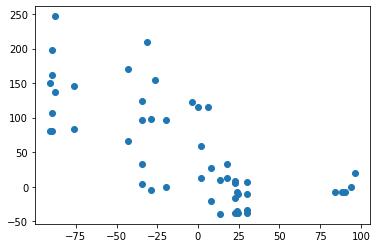

subject_17_stim_period_14_component_1   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.8382713085234094, pvalue=3.0816974262890563e-14)   3.2850967177898545


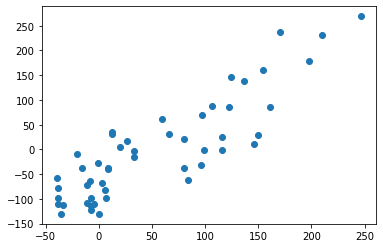

subject_17_stim_period_14_component_1   subject_15_stim_period_14_component_1   SpearmanrResult(correlation=0.801296518607443, pvalue=2.763895257318999e-12)   2.6475877139683353


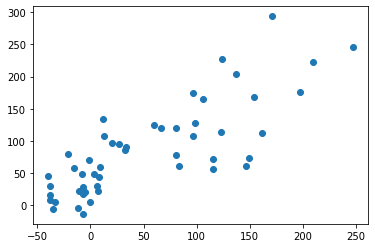

subject_17_stim_period_14_component_1   subject_15_stim_period_14_component_3   SpearmanrResult(correlation=-0.757406962785114, pvalue=1.9386709019316576e-10)   1.619020367455624


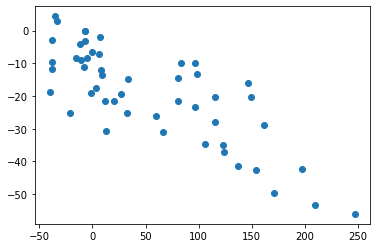

subject_17_stim_period_14_component_1   subject_15_stim_period_15_component_5   SpearmanrResult(correlation=0.768547418967587, pvalue=7.201861104178388e-11)   2.297742724950417


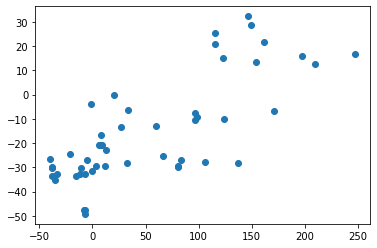

subject_17_stim_period_14_component_1   subject_17_stimulus_14_component_0   SpearmanrResult(correlation=0.9886674669867946, pvalue=3.4130861894095763e-41)   5.011856753114476


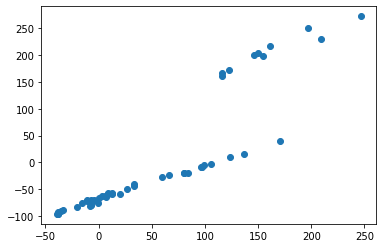

subject_17_stim_period_14_component_1   subject_17_stimulus_15_component_0   SpearmanrResult(correlation=0.7963985594237694, pvalue=4.671479687611538e-12)   2.9527375741747055


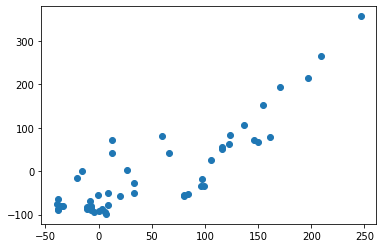

subject_17_stim_period_14_component_1   subject_17_stim_period_14_component_0   SpearmanrResult(correlation=0.9280672268907562, pvalue=3.1569346563186057e-22)   4.683530767730707


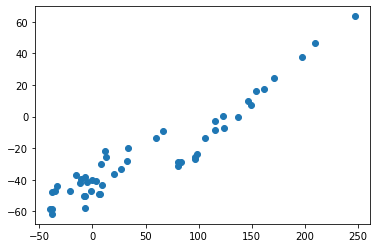

subject_17_stim_period_14_component_2   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.921561727774948, pvalue=2.340890876066694e-21)   2.906229046804418


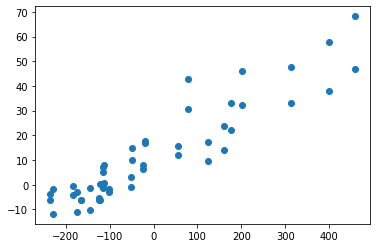

subject_17_stim_period_14_component_2   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.8233514998514865, pvalue=2.1427113029322113e-13)   1.8584399482418137


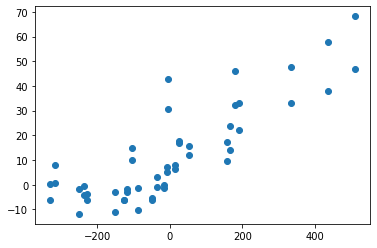

subject_17_stim_period_14_component_2   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.8910031637048299, pvalue=4.4207724940286495e-18)   2.641307734218433


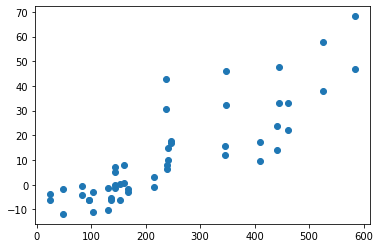

subject_17_stim_period_14_component_2   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.9507749462570737, pvalue=4.544673766964873e-26)   2.0335324519884774


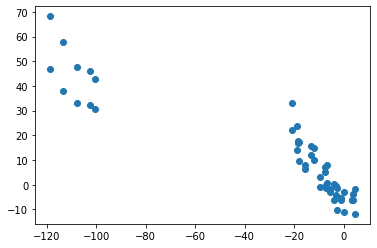

subject_17_stim_period_14_component_2   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.7799160565820105, pvalue=2.4733617847825967e-11)   1.3731183873969932


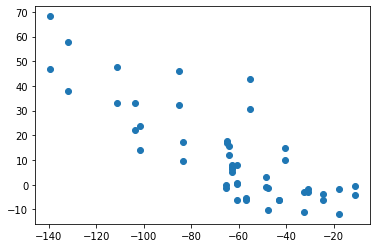

subject_17_stim_period_14_component_2   subject_12_stim_period_14_component_9   SpearmanrResult(correlation=-0.7680001385169327, pvalue=7.570511390571251e-11)   3.3514352562505567


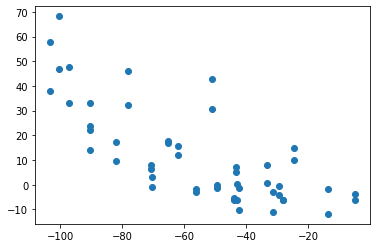

subject_17_stim_period_14_component_2   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.8375737246388372, pvalue=3.3887284738898694e-14)   2.641307734218433


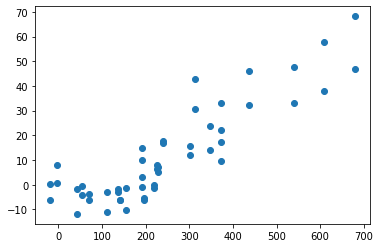

subject_17_stim_period_14_component_2   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.8790876350540217, pvalue=4.640157218805915e-17)   2.597040676316103


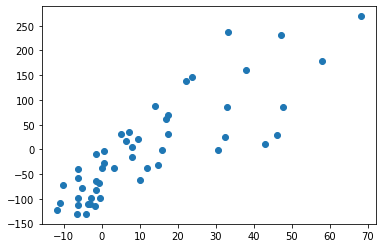

subject_17_stim_period_14_component_2   subject_15_stimulus_15_component_0   SpearmanrResult(correlation=0.8001440576230492, pvalue=3.1312444842788214e-12)   1.3992448805247002


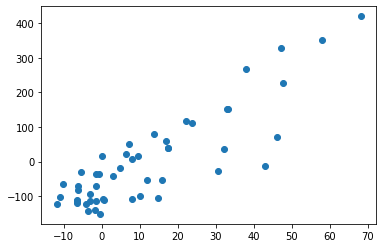

subject_17_stim_period_14_component_2   subject_15_stim_period_14_component_0   SpearmanrResult(correlation=0.7538535414165666, pvalue=2.629556116800444e-10)   3.332022753868565


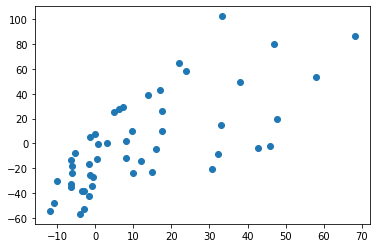

subject_17_stim_period_14_component_2   subject_15_stim_period_14_component_1   SpearmanrResult(correlation=0.8370228091236495, pvalue=3.651526852256081e-14)   1.962793071036546


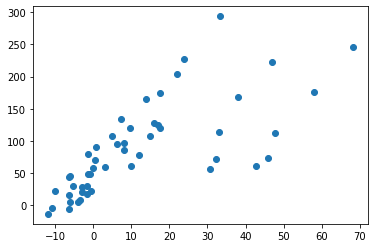

subject_17_stim_period_14_component_2   subject_15_stim_period_14_component_3   SpearmanrResult(correlation=-0.8017767106842737, pvalue=2.623227027496075e-12)   1.0328547858622905


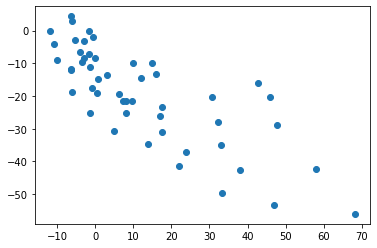

subject_17_stim_period_14_component_2   subject_15_stim_period_15_component_1   SpearmanrResult(correlation=0.7806482593037215, pvalue=2.303868302943859e-11)   1.962793071036546


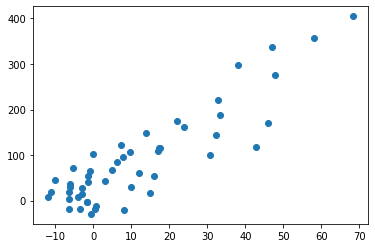

subject_17_stim_period_14_component_2   subject_15_stim_period_15_component_5   SpearmanrResult(correlation=0.7761344537815126, pvalue=3.5536305185718676e-11)   1.5121608066668046


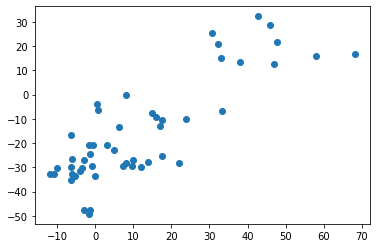

subject_17_stim_period_14_component_2   subject_17_stimulus_14_component_0   SpearmanrResult(correlation=0.9227851140456182, pvalue=1.6278632250680609e-21)   3.4837649528882864


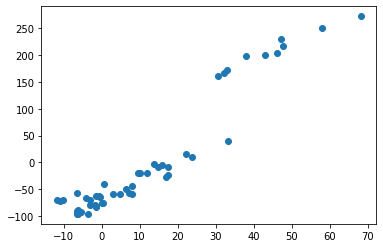

subject_17_stim_period_14_component_2   subject_17_stimulus_15_component_0   SpearmanrResult(correlation=0.8559423769507803, pvalue=2.36545331713283e-15)   1.8082595786363573


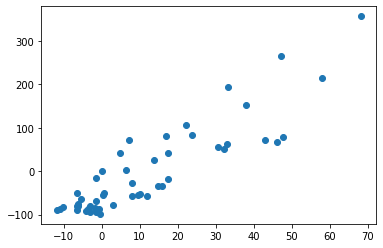

subject_17_stim_period_14_component_2   subject_17_stim_period_14_component_0   SpearmanrResult(correlation=0.874765906362545, pvalue=1.0247306328790499e-16)   3.071571977888851


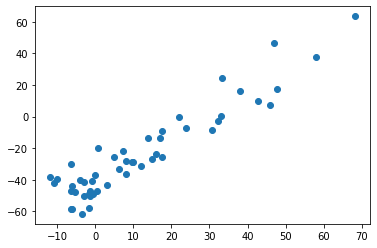

subject_17_stim_period_14_component_2   subject_17_stim_period_14_component_1   SpearmanrResult(correlation=0.9387274909963984, pvalue=7.588100120077412e-24)   3.0149878343952587


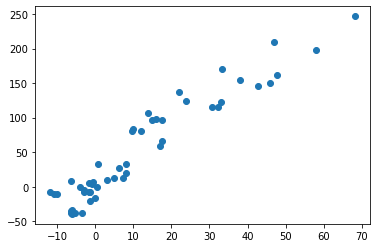

subject_17_stim_period_14_component_4   subject_12_stimulus_14_component_1   SpearmanrResult(correlation=0.8491052582502026, pvalue=6.638231496084522e-15)   2.741336260141889


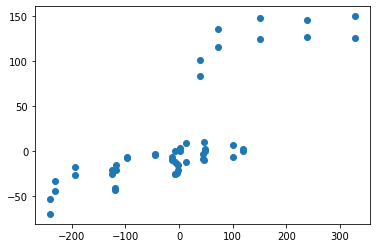

subject_17_stim_period_14_component_4   subject_12_stim_period_14_component_2   SpearmanrResult(correlation=0.8462223748473611, pvalue=1.0102856673433983e-14)   3.454086445943809


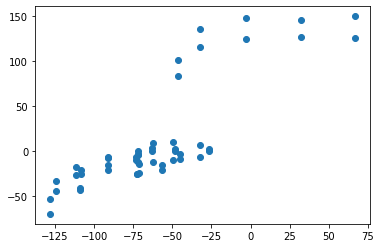

subject_17_stim_period_14_component_4   subject_12_stim_period_14_component_4   SpearmanrResult(correlation=-0.755699835998143, pvalue=2.2458485889962195e-10)   1.3585441322436327


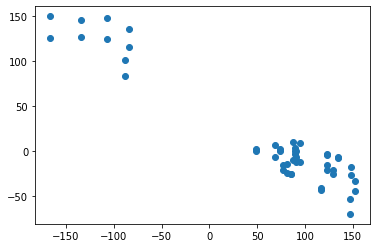

subject_17_stim_period_14_component_4   subject_15_stimulus_14_component_1   SpearmanrResult(correlation=0.927875150060024, pvalue=3.358209790475972e-22)   3.2384640777217886


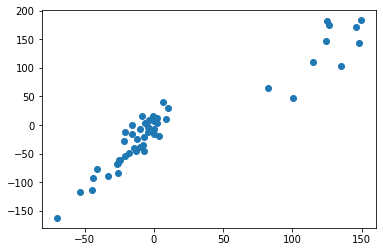

subject_17_stim_period_14_component_4   subject_15_stim_period_14_component_5   SpearmanrResult(correlation=0.7914045618247298, pvalue=7.86285925543876e-12)   2.413667495321995


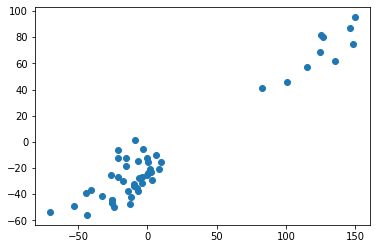

subject_17_stim_period_14_component_4   subject_17_stimulus_14_component_1   SpearmanrResult(correlation=-0.7866026410564226, pvalue=1.2802878130682534e-11)   3.641812257803452


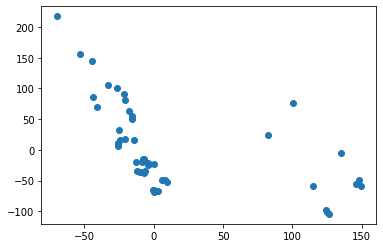

subject_17_stim_period_14_component_7   subject_10_stim_period_14_component_9   SpearmanrResult(correlation=0.7580691861254949, pvalue=1.8305628984278714e-10)   4.965484397975966


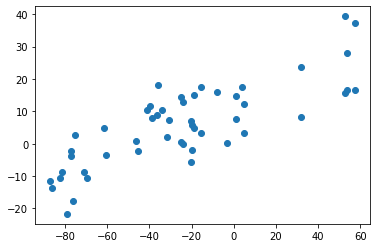

subject_17_stim_period_14_component_8   subject_15_stimulus_15_component_4   SpearmanrResult(correlation=-0.7906362545018008, pvalue=8.507964494623148e-12)   3.91954157943301


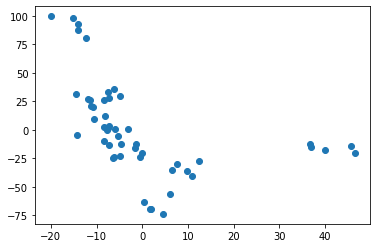

subject_17_stim_period_14_component_9   subject_17_stimulus_14_component_2   SpearmanrResult(correlation=-0.8011044417767106, pvalue=2.8221404935829443e-12)   3.261063116834881


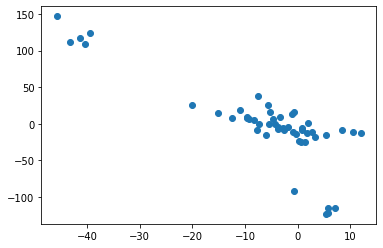

subject_17_stim_period_15_component_0   subject_13_stim_period_10_component_0   SpearmanrResult(correlation=0.790252100840336, pvalue=8.849015569436863e-12)   2.6780362402841025


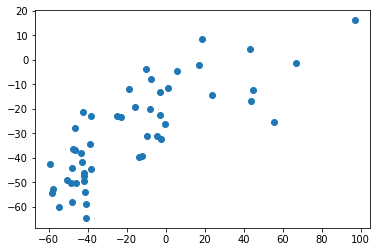

subject_17_stim_period_15_component_0   subject_14_stimulus_10_component_0   SpearmanrResult(correlation=0.7621427735168785, pvalue=1.2809587684743245e-10)   7.376190536391238


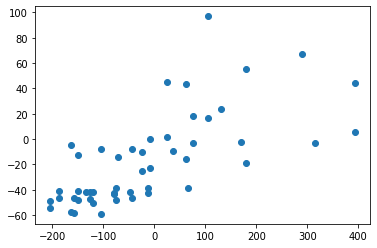

subject_17_stim_period_15_component_1   subject_12_stimulus_14_component_0   SpearmanrResult(correlation=0.8054776227538702, pvalue=1.7454138528230452e-12)   4.291686925159791


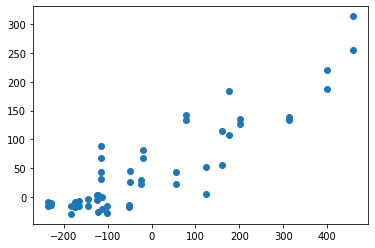

subject_17_stim_period_15_component_1   subject_12_stimulus_15_component_0   SpearmanrResult(correlation=0.845837990393649, pvalue=1.0677797616798846e-14)   2.4418324768625395


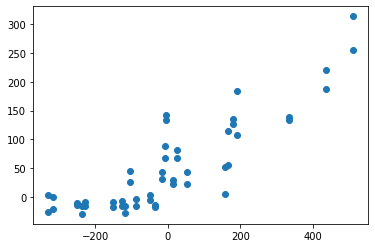

subject_17_stim_period_15_component_1   subject_12_stim_period_14_component_1   SpearmanrResult(correlation=0.7612734105769697, pvalue=1.3831901553130925e-10)   3.969230652633102


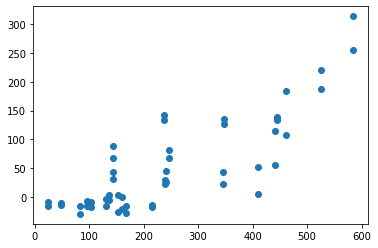

subject_17_stim_period_15_component_1   subject_12_stim_period_14_component_3   SpearmanrResult(correlation=-0.8471833359816416, pvalue=8.791504085321968e-15)   3.663941195110474


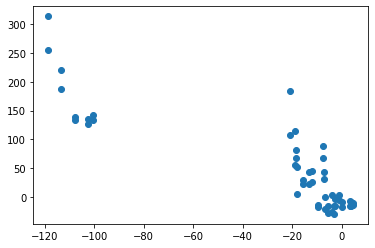

subject_17_stim_period_15_component_1   subject_12_stim_period_14_component_7   SpearmanrResult(correlation=-0.8022103548973166, pvalue=2.5020510087771945e-12)   2.1615663080110856


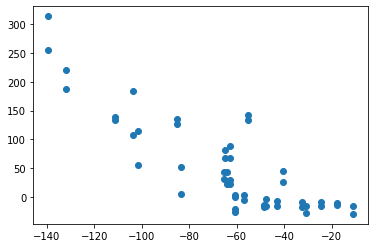

subject_17_stim_period_15_component_1   subject_12_stim_period_15_component_1   SpearmanrResult(correlation=0.8763965544637671, pvalue=7.625983277645068e-17)   3.969230652633102


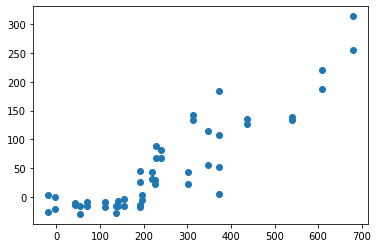

subject_17_stim_period_15_component_1   subject_15_stimulus_14_component_0   SpearmanrResult(correlation=0.8491236494597839, pvalue=6.620285306625981e-15)   3.2850967177898545


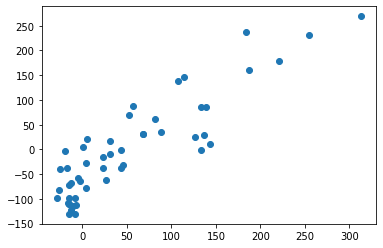

subject_17_stim_period_15_component_1   subject_15_stimulus_15_component_0   SpearmanrResult(correlation=0.8691956782713085, pvalue=2.727821607852297e-16)   2.3024675153623813


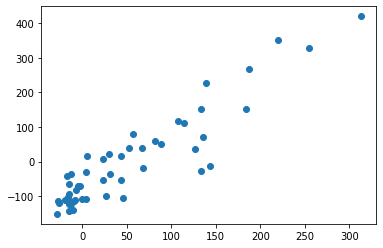

subject_17_stim_period_15_component_1   subject_15_stim_period_14_component_0   SpearmanrResult(correlation=0.7524129651860745, pvalue=2.971098238335747e-10)   4.099049116854716


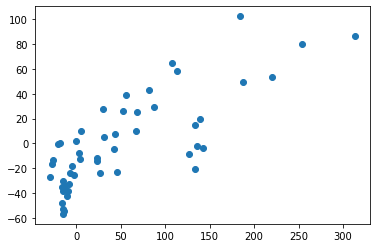

subject_17_stim_period_15_component_1   subject_15_stim_period_14_component_1   SpearmanrResult(correlation=0.7769987995198078, pvalue=3.2731717605565287e-11)   2.6475877139683353


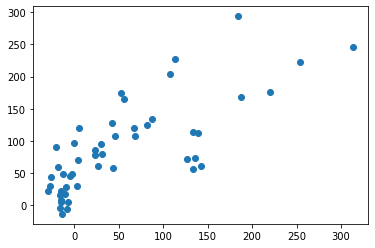

subject_17_stim_period_15_component_1   subject_15_stim_period_14_component_3   SpearmanrResult(correlation=-0.7820888355342136, pvalue=2.0019675125522867e-11)   1.619020367455624


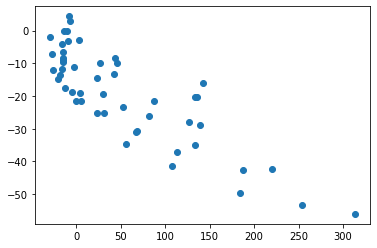

subject_17_stim_period_15_component_1   subject_15_stim_period_15_component_0   SpearmanrResult(correlation=0.812533013205282, pvalue=7.832647501544892e-13)   4.099049116854716


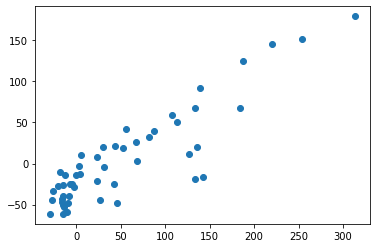

subject_17_stim_period_15_component_1   subject_15_stim_period_15_component_1   SpearmanrResult(correlation=0.8782232893157261, pvalue=5.449886055057994e-17)   2.6475877139683353


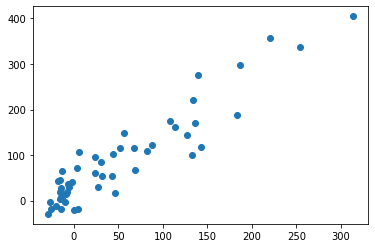

subject_17_stim_period_15_component_1   subject_17_stimulus_14_component_0   SpearmanrResult(correlation=0.7672028811524609, pvalue=8.139605050040431e-11)   5.011856753114476


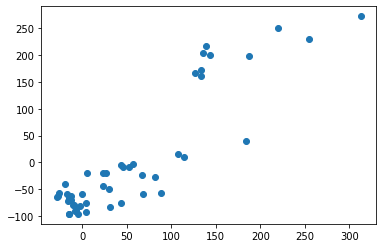

subject_17_stim_period_15_component_1   subject_17_stimulus_15_component_0   SpearmanrResult(correlation=0.9266266506602642, pvalue=4.9979936751923015e-22)   2.9527375741747055


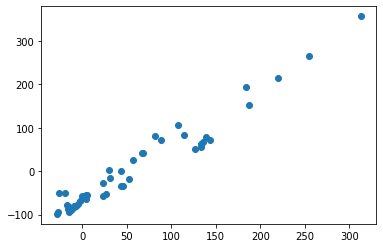

subject_17_stim_period_15_component_1   subject_17_stim_period_14_component_0   SpearmanrResult(correlation=0.8330852340936375, pvalue=6.178377548384954e-14)   4.683530767730707


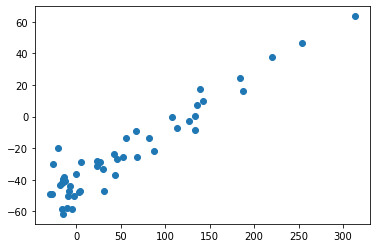

subject_17_stim_period_15_component_1   subject_17_stim_period_14_component_1   SpearmanrResult(correlation=0.7773829531812725, pvalue=3.1553660270607694e-11)   5.242241503699913


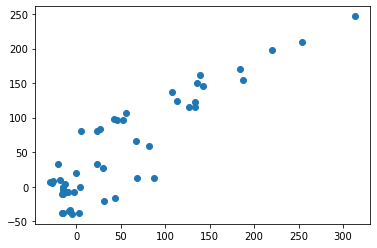

subject_17_stim_period_15_component_1   subject_17_stim_period_14_component_2   SpearmanrResult(correlation=0.8744777911164465, pvalue=1.0791839412380794e-16)   3.0149878343952587


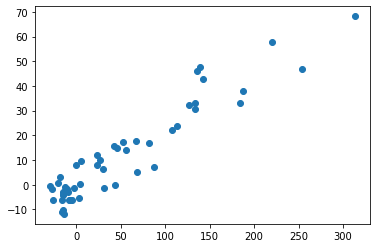

subject_17_stim_period_15_component_2   subject_12_stimulus_15_component_1   SpearmanrResult(correlation=0.8104746206521285, pvalue=9.929435393809078e-13)   2.741279364645754


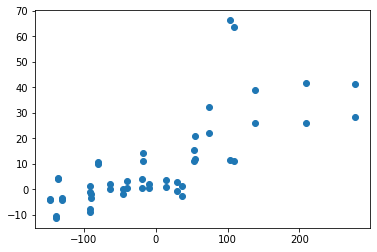

subject_17_stim_period_15_component_2   subject_15_stimulus_15_component_1   SpearmanrResult(correlation=0.7741176470588236, pvalue=4.299028411420036e-11)   2.0282395102917543


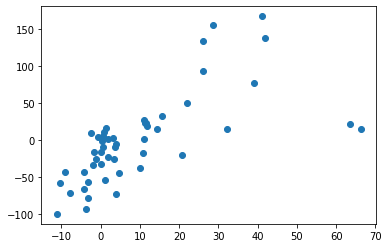

subject_17_stim_period_15_component_2   subject_15_stim_period_15_component_7   SpearmanrResult(correlation=0.87015606242497, pvalue=2.3115588562684337e-16)   3.0182997912373177


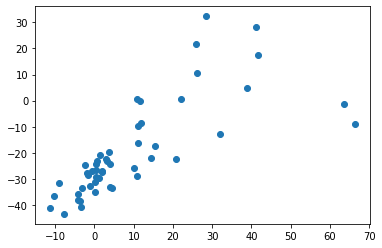

subject_17_stim_period_15_component_2   subject_17_stimulus_15_component_1   SpearmanrResult(correlation=0.7607683073229292, pvalue=1.4460788408005707e-10)   3.110882961524645


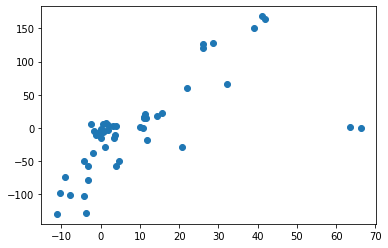

subject_17_stim_period_15_component_3   subject_17_stimulus_15_component_2   SpearmanrResult(correlation=0.769315726290516, pvalue=6.712874525688718e-11)   4.7145056715538765


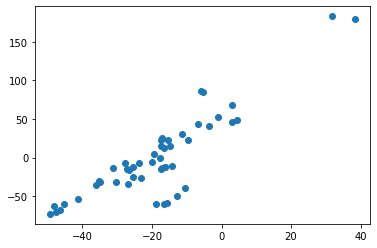

subject_17_stim_period_15_component_4   subject_12_stim_period_15_component_3   SpearmanrResult(correlation=-0.7766487887254568, pvalue=3.384119657943785e-11)   4.021957468001148


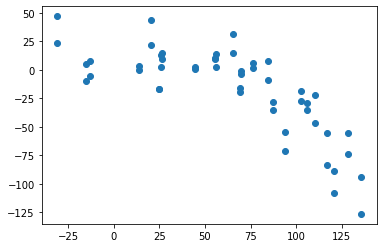

subject_17_stim_period_15_component_4   subject_12_stim_period_15_component_7   SpearmanrResult(correlation=-0.7612734105769697, pvalue=1.3831901553130925e-10)   2.233504503862678


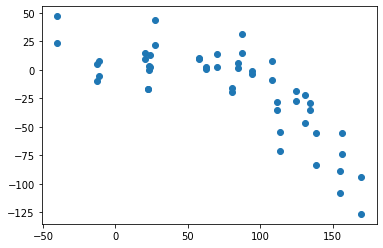

subject_17_stim_period_15_component_4   subject_15_stim_period_14_component_6   SpearmanrResult(correlation=-0.7851620648259303, pvalue=1.4783372839389887e-11)   2.5720733677996988


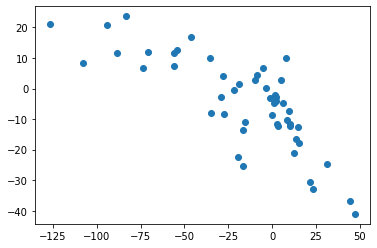

subject_17_stim_period_15_component_4   subject_15_stim_period_15_component_4   SpearmanrResult(correlation=0.8158943577430973, pvalue=5.283793225341823e-13)   3.3749630534061987


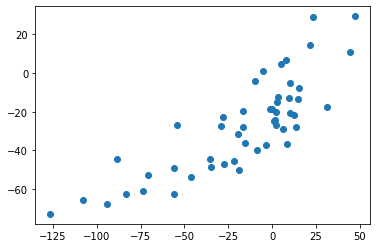

subject_17_stim_period_15_component_4   subject_15_stim_period_15_component_9   SpearmanrResult(correlation=-0.7523169267707083, pvalue=2.9952967401721436e-10)   2.211703973192024


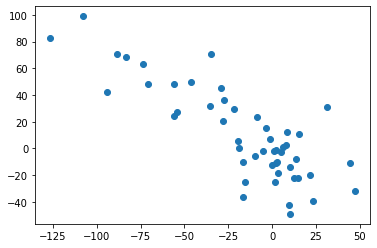

subject_17_stim_period_15_component_5   subject_17_stim_period_15_component_3   SpearmanrResult(correlation=-0.8292436974789916, pvalue=1.0187592993684008e-13)   1.8690653269748387


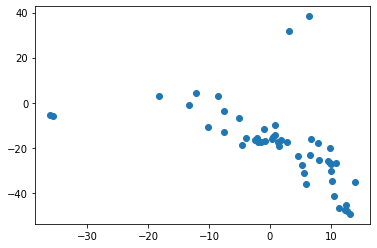

subject_17_stim_period_15_component_6   subject_12_stimulus_15_component_1   SpearmanrResult(correlation=0.8318079578331544, pvalue=7.306259945004405e-14)   4.538658801508327


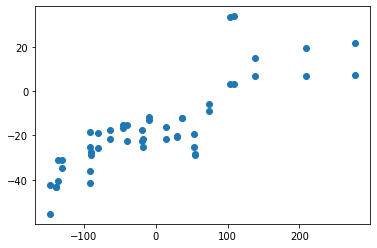

subject_17_stim_period_15_component_6   subject_15_stimulus_15_component_1   SpearmanrResult(correlation=0.8148379351740697, pvalue=5.984786209967852e-13)   2.6053181602372346


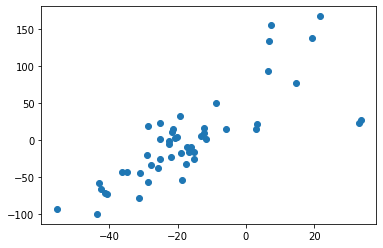

subject_17_stim_period_15_component_6   subject_15_stim_period_15_component_4   SpearmanrResult(correlation=0.7969747899159663, pvalue=4.395020774280983e-12)   3.6387248657225904


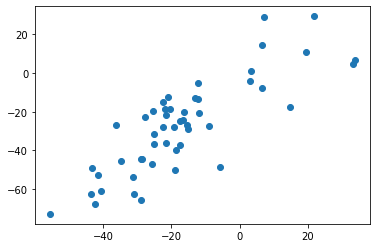

subject_17_stim_period_15_component_6   subject_15_stim_period_15_component_7   SpearmanrResult(correlation=0.773829531812725, pvalue=4.4168763703459335e-11)   3.5810945020437748


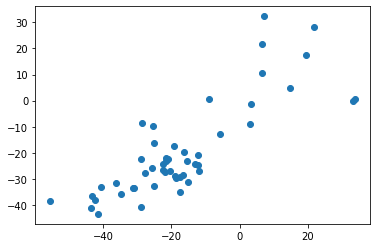

subject_17_stim_period_15_component_6   subject_17_stimulus_15_component_1   SpearmanrResult(correlation=0.8155102040816327, pvalue=5.529163193534232e-13)   4.753390625001128


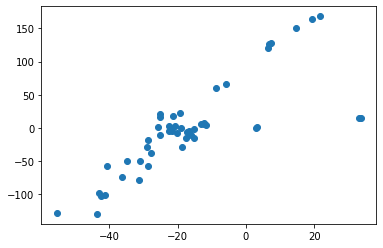

subject_17_stim_period_15_component_6   subject_17_stim_period_15_component_4   SpearmanrResult(correlation=0.7768067226890756, pvalue=3.333623626617687e-11)   4.738079314087944


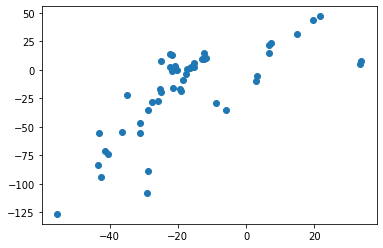

subject_17_stim_period_15_component_9   subject_17_stim_period_15_component_8   SpearmanrResult(correlation=-0.872845138055222, pvalue=1.4437131943702158e-16)   3.279932682052272


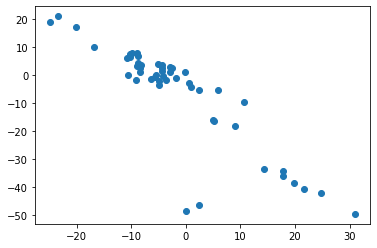

subject_17_stim_period_1_component_2   subject_17_stimulus_1_component_1   SpearmanrResult(correlation=0.9034974559538956, pvalue=1.3396275815774545e-289)   3.5233703882701364


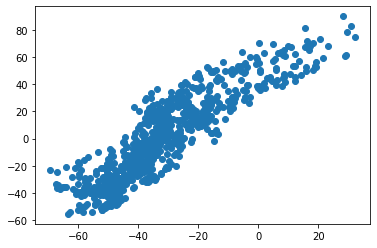

subject_17_stim_period_1_component_3   subject_17_stim_period_1_component_0   SpearmanrResult(correlation=0.7831340182249811, pvalue=2.7001705066954685e-163)   4.835924250451968


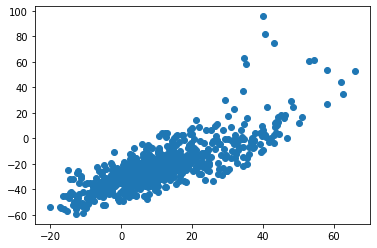

subject_17_stim_period_2_component_0   subject_17_stimulus_2_component_0   SpearmanrResult(correlation=0.8934724814463516, pvalue=9.947867870835923e-274)   6.110760815538811


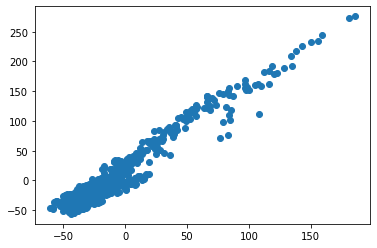

subject_17_stim_period_2_component_2   subject_17_stimulus_1_component_1   SpearmanrResult(correlation=-0.843463097382881, pvalue=5.718370601242774e-213)   3.5233703882701364


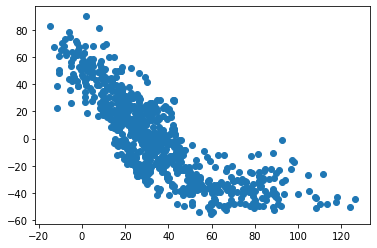

subject_17_stim_period_2_component_2   subject_17_stimulus_2_component_0   SpearmanrResult(correlation=0.8451718518491853, pvalue=1.1274076896547038e-214)   3.6107959131852967


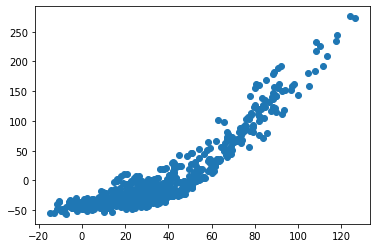

subject_17_stim_period_2_component_2   subject_17_stim_period_1_component_2   SpearmanrResult(correlation=-0.8216797963563236, pvalue=7.057552179226281e-193)   3.6521643610578094


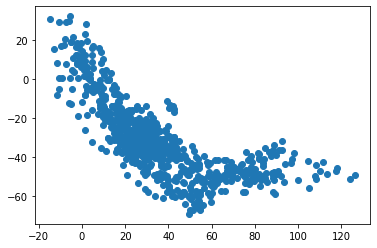

subject_17_stim_period_2_component_2   subject_17_stim_period_2_component_1   SpearmanrResult(correlation=-0.7737868760697681, pvalue=5.0314637221613426e-157)   3.0149878343952587


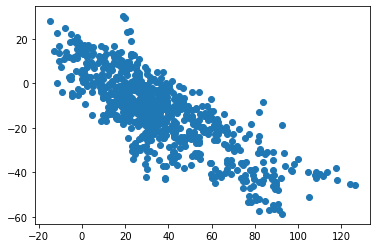

subject_17_stim_period_2_component_4   subject_17_stimulus_1_component_1   SpearmanrResult(correlation=0.7745170282005855, pvalue=1.6703274604599457e-157)   4.687596922403854


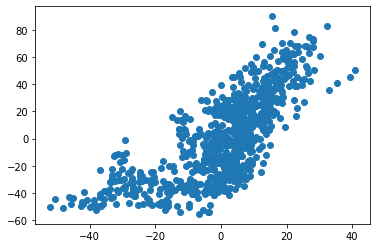

subject_17_stim_period_2_component_4   subject_17_stimulus_2_component_0   SpearmanrResult(correlation=-0.8133685508186282, pvalue=6.357617380305618e-186)   5.0801818765068


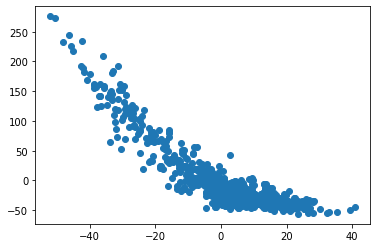

subject_17_stim_period_2_component_4   subject_17_stim_period_2_component_1   SpearmanrResult(correlation=0.7678191216516591, pvalue=3.544307915885138e-153)   4.151201484965451


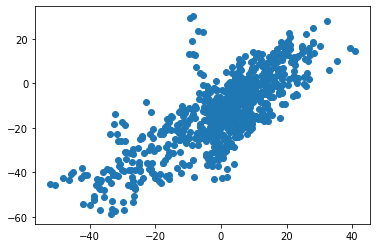

subject_17_stim_period_2_component_4   subject_17_stim_period_2_component_2   SpearmanrResult(correlation=-0.8734023094495169, pvalue=2.977026937182609e-246)   2.70799015194447


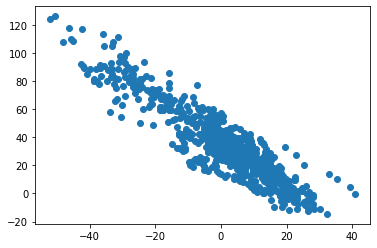

subject_17_stim_period_3_component_0   subject_17_stimulus_3_component_0   SpearmanrResult(correlation=0.9850468021314895, pvalue=0.0)   8.323564914382683


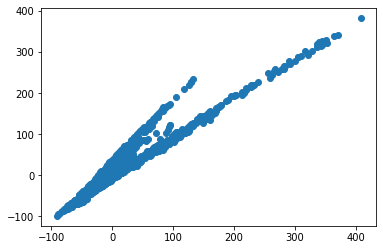

subject_17_stim_period_3_component_1   subject_17_stimulus_3_component_1   SpearmanrResult(correlation=0.8788794198529349, pvalue=0.0)   3.520675879598681


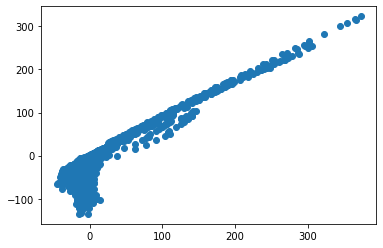

subject_17_stim_period_3_component_2   subject_17_stimulus_3_component_3   SpearmanrResult(correlation=0.8394143503319899, pvalue=0.0)   3.4273759187865362


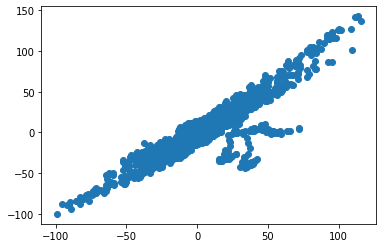

subject_17_stim_period_3_component_5   subject_17_stimulus_3_component_5   SpearmanrResult(correlation=-0.8227163063140263, pvalue=0.0)   1.7759553361612783


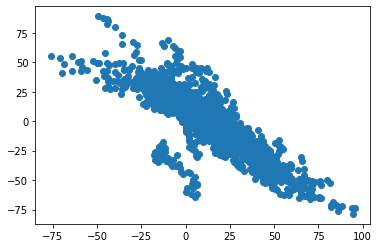

subject_17_stim_period_4_component_0   subject_17_stimulus_4_component_0   SpearmanrResult(correlation=0.9844142725223008, pvalue=0.0)   6.433875305556824


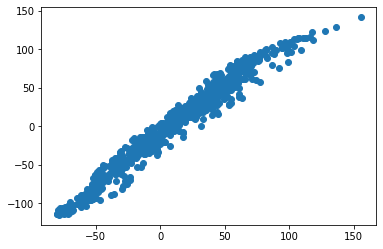

subject_17_stim_period_4_component_2   subject_17_stimulus_4_component_1   SpearmanrResult(correlation=0.769810507516418, pvalue=9.097873717186968e-158)   3.187630340729556


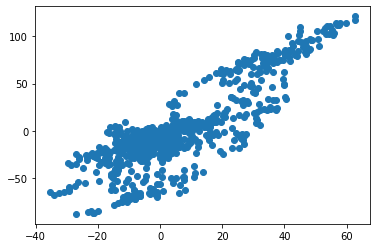

subject_17_stim_period_4_component_3   subject_17_stimulus_4_component_0   SpearmanrResult(correlation=0.9303825240351938, pvalue=0.0)   4.277026440656402


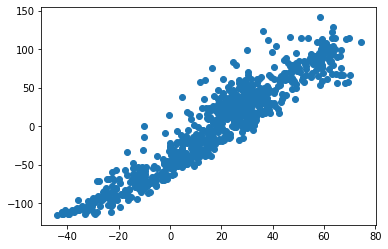

subject_17_stim_period_4_component_3   subject_17_stim_period_4_component_0   SpearmanrResult(correlation=0.8870916595182181, pvalue=3.817472649191301e-270)   4.835924250451968


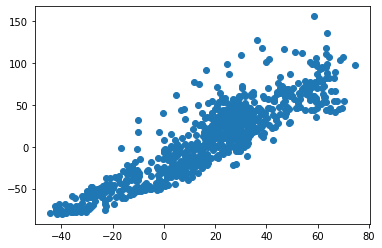

subject_17_stim_period_4_component_6   subject_17_stim_period_4_component_3   SpearmanrResult(correlation=-0.7530294891085767, pvalue=3.242436766229554e-147)   4.23264097061724


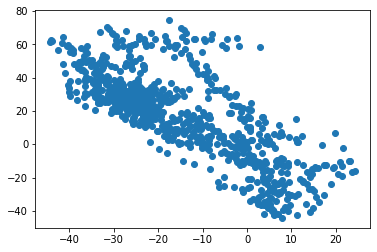

subject_17_stim_period_4_component_7   subject_17_stimulus_4_component_1   SpearmanrResult(correlation=0.8895629133795523, pvalue=9.38697394722784e-274)   3.3418602609070094


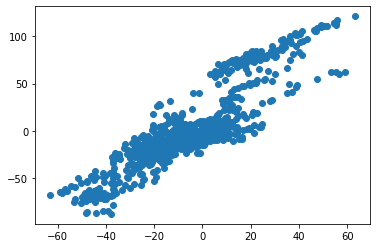

subject_17_stim_period_9_component_0   subject_17_stimulus_9_component_0   SpearmanrResult(correlation=0.9247941703062692, pvalue=1.1375378726295176e-81)   6.157106179390309


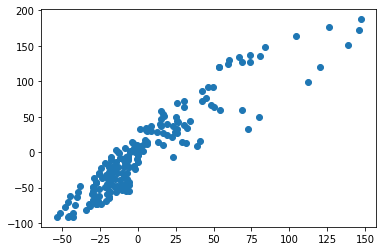

subject_17_stim_period_9_component_3   subject_17_stimulus_9_component_0   SpearmanrResult(correlation=0.9477728345495485, pvalue=3.099802370311319e-96)   4.589952585116874


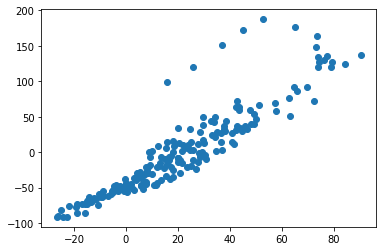

subject_17_stim_period_9_component_3   subject_17_stim_period_9_component_0   SpearmanrResult(correlation=0.877059992404308, pvalue=2.087221271631989e-62)   4.835924250451968


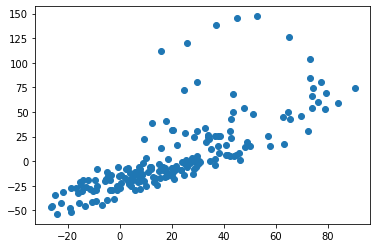

subject_17_stim_period_9_component_4   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=-0.8926142066570817, pvalue=1.1792363724567463e-67)   4.84715025055787


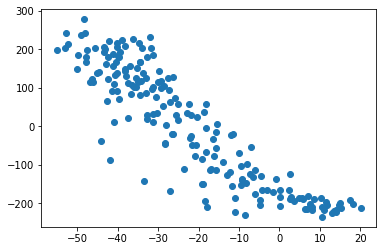

subject_17_stim_period_9_component_4   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=-0.8763902829395329, pvalue=3.383090810052108e-62)   4.6087644079329815


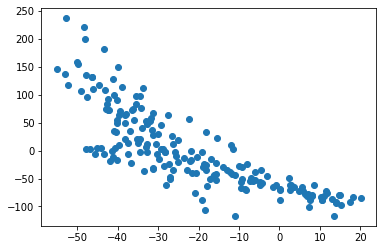

subject_17_stim_period_9_component_4   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=-0.8339137482028052, pvalue=6.202711368059185e-51)   5.069604764062476


subject_17_stim_period_9_component_4   subject_17_stimulus_9_component_1   SpearmanrResult(correlation=0.7561138539999459, pvalue=7.88873044814714e-37)   4.53745830597781


subject_17_stim_period_9_component_4   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=-0.8934755038927923, pvalue=5.724157279300232e-68)   5.254935659089215


subject_17_stim_period_9_component_4   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=0.8533031088082902, pvalue=1.2443643605966879e-55)   2.70799015194447


subject_17_stim_period_9_component_4   subject_17_stim_period_10_component_3   SpearmanrResult(correlation=0.8246056343759326, pvalue=6.874308729435985e-49)   4.260710085028884


subject_17_stim_period_9_component_4   subject_17_stim_period_11_component_0   SpearmanrResult(correlation=-0.7906962943873261, pvalue=2.363346367243627e-42)   5.254935659089215


subject_17_stim_period_9_component_4   subject_17_stim_period_11_component_2   SpearmanrResult(correlation=0.9248772481892414, pvalue=1.028267902173224e-81)   2.70799015194447


subject_17_stim_period_9_component_4   subject_17_stim_period_11_component_4   SpearmanrResult(correlation=0.8339391802077966, pvalue=6.121002356318129e-51)   5.632243513851697


subject_17_stim_period_9_component_4   subject_17_stim_period_11_component_7   SpearmanrResult(correlation=-0.8612294170306269, pvalue=9.447877844169253e-58)   4.3717903521596515


subject_17_stim_period_9_component_4   subject_17_stim_period_12_component_0   SpearmanrResult(correlation=-0.8143141496893904, pvalue=9.15654038838208e-47)   5.254935659089215


subject_17_stim_period_9_component_4   subject_17_stim_period_12_component_2   SpearmanrResult(correlation=-0.7879716789192417, pvalue=7.011150000881843e-42)   2.70799015194447


subject_17_stim_period_9_component_4   subject_17_stim_period_12_component_4   SpearmanrResult(correlation=0.8164334834386785, pvalue=3.429086438425295e-47)   5.632243513851697


subject_17_stim_period_9_component_4   subject_17_stim_period_12_component_6   SpearmanrResult(correlation=-0.7716155087757374, pvalue=3.479323276946893e-39)   4.738079314087944


subject_17_stim_period_9_component_5   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=0.824390310067005, pvalue=7.639961266061266e-49)   1.7642812722663628


subject_17_stim_period_9_component_5   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=0.7856692347340153, pvalue=1.7357455585306162e-41)   1.8787543221901495


subject_17_stim_period_9_component_5   subject_17_stim_period_11_component_0   SpearmanrResult(correlation=0.7951808046008194, pvalue=3.8081251451121504e-43)   1.8901179585537857


subject_17_stim_period_9_component_5   subject_17_stim_period_11_component_2   SpearmanrResult(correlation=-0.8002722920001086, pvalue=4.531710097199796e-44)   1.3443317469123772


subject_17_stim_period_9_component_5   subject_17_stim_period_11_component_4   SpearmanrResult(correlation=-0.8189851612728211, pvalue=1.0333062412307003e-47)   1.87777227954144


subject_17_stim_period_9_component_5   subject_17_stim_period_12_component_0   SpearmanrResult(correlation=0.7698064454873452, pvalue=6.696798947153179e-39)   1.8901179585537857


subject_17_stim_period_9_component_5   subject_17_stim_period_12_component_4   SpearmanrResult(correlation=-0.7866051325177008, pvalue=1.2023866469950338e-41)   1.87777227954144


subject_17_stim_period_9_component_6   subject_17_stimulus_10_component_0   SpearmanrResult(correlation=0.9404026395030248, pvalue=6.09083071116879e-91)   4.790344370729594


subject_17_stim_period_9_component_6   subject_17_stimulus_11_component_0   SpearmanrResult(correlation=0.8938383338306705, pvalue=4.21381262494096e-68)   4.459161525119461


subject_17_stim_period_9_component_6   subject_17_stimulus_12_component_0   SpearmanrResult(correlation=0.8579639475897242, pvalue=7.313475195596607e-57)   5.3190654628874725


subject_17_stim_period_9_component_6   subject_17_stimulus_9_component_1   SpearmanrResult(correlation=-0.913982177250902, pvalue=2.3475305590568767e-76)   4.417930055672679


subject_17_stim_period_9_component_6   subject_17_stim_period_10_component_0   SpearmanrResult(correlation=0.9417200173615823, pvalue=7.759860378680428e-92)   5.25470485989964


subject_17_stim_period_9_component_6   subject_17_stim_period_10_component_2   SpearmanrResult(correlation=-0.8942554187125302, pvalue=2.959022024062113e-68)   3.082494207333249


subject_17_stim_period_9_component_6   subject_17_stim_period_10_component_3   SpearmanrResult(correlation=-0.8158027697148903, pvalue=4.599337538811755e-47)   4.23264097061724


subject_17_stim_period_9_component_6   subject_17_stim_period_11_component_0   SpearmanrResult(correlation=0.8220692157447849, pvalue=2.3633142277375065e-48)   5.25470485989964


subject_17_stim_period_9_component_6   subject_17_stim_period_11_component_2   SpearmanrResult(correlation=-0.9275798225863333, pvalue=3.606700853429987e-83)   3.082494207333249


subject_17_stim_period_9_component_6   subject_17_stim_period_11_component_4   SpearmanrResult(correlation=-0.8500901988443698, pvalue=8.295476630416904e-55)   4.738079314087944


subject_17_stim_period_9_component_6   subject_17_stim_period_11_component_7   SpearmanrResult(correlation=0.8257551610015464, pvalue=3.9023409506729974e-49)   4.6058695477901725


subject_17_stim_period_9_component_6   subject_17_stim_period_11_component_9   SpearmanrResult(correlation=-0.769569080107425, pvalue=7.294348148770742e-39)   3.211310663001229


subject_17_stim_period_9_component_6   subject_17_stim_period_12_component_0   SpearmanrResult(correlation=0.8396545994628761, pvalue=2.9326858783770583e-52)   5.25470485989964


subject_17_stim_period_9_component_6   subject_17_stim_period_12_component_2   SpearmanrResult(correlation=0.8164673927786671, pvalue=3.3752720796685175e-47)   3.082494207333249


subject_17_stim_period_9_component_6   subject_17_stim_period_12_component_4   SpearmanrResult(correlation=-0.8512956758809648, pvalue=4.092585802216351e-55)   4.738079314087944


subject_17_stim_period_9_component_6   subject_17_stim_period_12_component_6   SpearmanrResult(correlation=0.8081714727504545, pvalue=1.4716743069500078e-45)   5.924322838958252


subject_17_stim_period_9_component_6   subject_17_stim_period_9_component_4   SpearmanrResult(correlation=-0.9347618207959202, pvalue=2.5017967790776057e-87)   4.738079314087944


subject_1_stim_period_0_component_0   subject_1_stimulus_0_component_0   SpearmanrResult(correlation=0.996557702979108, pvalue=0.0)   14.70734875950731


subject_1_stim_period_0_component_1   subject_1_stimulus_0_component_1   SpearmanrResult(correlation=-0.8339850514114933, pvalue=1.3939170882314464e-187)   2.214594450033147


subject_1_stim_period_0_component_6   subject_1_stimulus_0_component_3   SpearmanrResult(correlation=0.7613498804331541, pvalue=2.92902663859097e-137)   6.943182837801064


subject_1_stim_period_1_component_0   subject_1_stimulus_1_component_0   SpearmanrResult(correlation=0.8942394436203259, pvalue=7.13608675849945e-253)   15.97825281843635


subject_1_stim_period_1_component_1   subject_1_stimulus_1_component_1   SpearmanrResult(correlation=-0.8274864856349389, pvalue=3.8092360289251765e-182)   2.992357567220951


subject_1_stim_period_1_component_2   subject_1_stimulus_1_component_0   SpearmanrResult(correlation=0.8028147559441022, pvalue=2.066044158992361e-163)   9.636841973187753


subject_1_stim_period_2_component_0   subject_1_stimulus_2_component_0   SpearmanrResult(correlation=0.9919822376200571, pvalue=0.0)   14.718648082172294


subject_1_stim_period_2_component_2   subject_1_stimulus_2_component_1   SpearmanrResult(correlation=0.8936421559455169, pvalue=4.815278564924385e-252)   8.723514477669795


subject_1_stim_period_2_component_4   subject_1_stimulus_2_component_2   SpearmanrResult(correlation=-0.8834412296320016, pvalue=1.332948463990376e-238)   2.2784752926019585


subject_1_stim_period_3_component_0   subject_1_stimulus_3_component_0   SpearmanrResult(correlation=0.9514427754168763, pvalue=0.0)   16.130542049050014


subject_1_stim_period_3_component_2   subject_1_stimulus_3_component_0   SpearmanrResult(correlation=0.92554579902096, pvalue=4.680436604303392e-305)   9.730438383188464


subject_1_stim_period_3_component_2   subject_1_stim_period_3_component_0   SpearmanrResult(correlation=0.8104341443559883, pvalue=6.676923887568658e-169)   9.44452096362135


subject_2_stimulus_1_component_1   subject_16_stimulus_9_component_7   SpearmanrResult(correlation=-0.7762077098071309, pvalue=4.4620126131031915e-178)   6.776756323812329


subject_2_stimulus_1_component_1   subject_16_stim_period_10_component_6   SpearmanrResult(correlation=0.765330109653599, pvalue=3.4138172816362794e-170)   5.813935105065525


subject_2_stimulus_2_component_1   subject_10_stimulus_23_component_2   SpearmanrResult(correlation=0.7888968482983808, pvalue=7.428088419464775e-188)   2.0991485823830476


subject_2_stim_period_0_component_0   subject_2_stimulus_0_component_0   SpearmanrResult(correlation=0.9888050663100734, pvalue=0.0)   18.715835027227524


subject_2_stim_period_0_component_1   subject_2_stimulus_0_component_1   SpearmanrResult(correlation=-0.8401182371455447, pvalue=1.739914862670335e-235)   4.781993690991666


subject_2_stim_period_1_component_0   subject_2_stimulus_1_component_0   SpearmanrResult(correlation=0.9920693631154904, pvalue=0.0)   13.950990717958103


subject_2_stim_period_1_component_1   subject_2_stimulus_1_component_2   SpearmanrResult(correlation=-0.7847744802450322, pvalue=1.3196826908435026e-184)   5.57553357946828


subject_2_stim_period_1_component_2   subject_2_stimulus_1_component_1   SpearmanrResult(correlation=-0.9350776009407412, pvalue=0.0)   4.73941620636821


subject_2_stim_period_1_component_5   subject_2_stimulus_1_component_3   SpearmanrResult(correlation=0.7703125027514005, pvalue=9.46860292099095e-174)   3.568567292759664


subject_2_stim_period_1_component_6   subject_2_stimulus_1_component_1   SpearmanrResult(correlation=-0.7787209764663248, pvalue=5.813954084259413e-180)   4.314860235777237


subject_2_stim_period_2_component_0   subject_2_stimulus_2_component_0   SpearmanrResult(correlation=0.9836801183885826, pvalue=0.0)   22.32152359892621


subject_2_stim_period_2_component_2   subject_14_stimulus_15_component_5   SpearmanrResult(correlation=-0.7507771070879352, pvalue=2.720361709867412e-160)   3.623720334718768


subject_2_stim_period_3_component_0   subject_2_stimulus_3_component_0   SpearmanrResult(correlation=0.9944439318279547, pvalue=0.0)   15.991892925535822


subject_2_stim_period_3_component_1   subject_2_stimulus_3_component_2   SpearmanrResult(correlation=-0.8540322413075992, pvalue=2.0450093538776528e-251)   4.845461238211682


subject_2_stim_period_3_component_2   subject_2_stimulus_3_component_1   SpearmanrResult(correlation=0.75085241469954, pvalue=2.42753190146152e-160)   2.702760506241196


subject_2_stim_period_3_component_6   subject_2_stimulus_3_component_5   SpearmanrResult(correlation=0.8587488373681925, pvalue=3.391726100555816e-257)   4.326873248949431


subject_3_stimulus_0_component_1   subject_16_stimulus_11_component_8   SpearmanrResult(correlation=-0.8204548725029425, pvalue=4.610581027662817e-157)   2.1272417550564486


subject_3_stimulus_0_component_3   subject_10_stim_period_14_component_3   SpearmanrResult(correlation=-0.7865712647001375, pvalue=1.0699570532136665e-135)   2.8774743594805905


subject_3_stimulus_0_component_3   subject_10_stim_period_14_component_8   SpearmanrResult(correlation=0.8509779481408433, pvalue=1.3712041214195828e-180)   2.7461802920258966


subject_3_stimulus_2_component_0   subject_10_stim_period_14_component_9   SpearmanrResult(correlation=-0.7581949294404715, pvalue=1.3210596143414157e-120)   6.200778037978999


subject_3_stim_period_0_component_1   subject_10_stimulus_15_component_2   SpearmanrResult(correlation=-0.7805217591299467, pvalue=2.7227232842675894e-132)   5.762962292722104


subject_3_stim_period_0_component_1   subject_16_stimulus_11_component_8   SpearmanrResult(correlation=0.8272116342288721, pvalue=7.231005338927717e-162)   5.200583036428965


subject_3_stim_period_0_component_1   subject_3_stimulus_0_component_1   SpearmanrResult(correlation=-0.9762127104802504, pvalue=0.0)   2.1522474613599667


subject_3_stim_period_1_component_0   subject_3_stimulus_1_component_0   SpearmanrResult(correlation=0.9476123904111096, pvalue=2.031776e-318)   7.555404603655753


subject_3_stim_period_1_component_1   subject_10_stimulus_23_component_2   SpearmanrResult(correlation=-0.7542263408853361, pvalue=1.1626054297085577e-118)   6.517079341772621


subject_3_stim_period_1_component_1   subject_2_stimulus_2_component_1   SpearmanrResult(correlation=-0.7941019243099949, pvalue=4.593468771840128e-192)   2.036132655611169


subject_3_stim_period_1_component_1   subject_3_stimulus_1_component_2   SpearmanrResult(correlation=-0.8157396014150426, pvalue=7.913433046909862e-154)   2.536150168356716


subject_3_stim_period_2_component_0   subject_3_stimulus_2_component_1   SpearmanrResult(correlation=0.9365012945588248, pvalue=1.4737559396559845e-292)   8.287875244047386


subject_3_stim_period_2_component_1   subject_10_stim_period_14_component_9   SpearmanrResult(correlation=-0.7835490761961968, pvalue=5.552206527478264e-134)   6.036378788278101


subject_3_stim_period_2_component_1   subject_3_stimulus_2_component_0   SpearmanrResult(correlation=0.9677073491390362, pvalue=0.0)   10.233688261581253


subject_3_stim_period_3_component_0   subject_3_stimulus_3_component_0   SpearmanrResult(correlation=0.9889673650326297, pvalue=0.0)   7.866861237476338


subject_4_stimulus_2_component_0   subject_10_stimulus_15_component_2   SpearmanrResult(correlation=-0.7599332721450097, pvalue=1.8400336093903997e-136)   8.494678062512499


subject_4_stimulus_2_component_0   subject_2_stimulus_2_component_1   SpearmanrResult(correlation=-0.7848547488416121, pvalue=1.1425659012476209e-184)   2.2602603547851263


subject_4_stimulus_2_component_1   subject_4_stimulus_1_component_0   SpearmanrResult(correlation=-0.8375347303267687, pvalue=1.1859448338640287e-190)   5.737835040598952


subject_4_stimulus_3_component_0   subject_16_stimulus_9_component_1   SpearmanrResult(correlation=-0.7566724049699083, pvalue=1.2051992628681174e-134)   7.774891724213942


subject_4_stim_period_0_component_0   subject_4_stimulus_0_component_0   SpearmanrResult(correlation=0.7780999127441732, pvalue=3.86450192100074e-147)   10.56005521833545


subject_4_stim_period_0_component_3   subject_4_stimulus_0_component_0   SpearmanrResult(correlation=0.7954526018247206, pvalue=2.4902364119038373e-158)   3.6680513149053544


subject_4_stim_period_0_component_6   subject_4_stimulus_0_component_2   SpearmanrResult(correlation=0.7794046027609364, pvalue=6.043935702151226e-148)   12.874743175623923


subject_4_stim_period_1_component_0   subject_4_stimulus_1_component_0   SpearmanrResult(correlation=0.9518852917025945, pvalue=0.0)   11.07756755978114


subject_4_stim_period_1_component_0   subject_4_stimulus_2_component_1   SpearmanrResult(correlation=-0.7762822652049868, pvalue=5.018329870841957e-146)   5.778510264575322


subject_4_stim_period_1_component_3   subject_4_stimulus_1_component_0   SpearmanrResult(correlation=-0.7579775745452182, pvalue=2.278106715984601e-135)   3.608569128577562


subject_4_stim_period_1_component_4   subject_4_stimulus_1_component_1   SpearmanrResult(correlation=0.7805801773022966, pvalue=1.1234341622744294e-148)   4.357799792336941


subject_4_stim_period_2_component_0   subject_4_stimulus_2_component_0   SpearmanrResult(correlation=0.9134109697999675, pvalue=1.703249159994137e-282)   13.218551414926804


subject_4_stim_period_2_component_1   subject_2_stimulus_2_component_1   SpearmanrResult(correlation=-0.7503341127067877, pvalue=5.311587158461892e-160)   2.186884886453014


subject_4_stim_period_2_component_1   subject_4_stimulus_2_component_0   SpearmanrResult(correlation=0.8715448267968623, pvalue=1.9722145099095142e-224)   6.555295881802879


subject_4_stim_period_2_component_2   subject_4_stimulus_2_component_4   SpearmanrResult(correlation=-0.8037351859603638, pvalue=4.6211415735957744e-164)   2.8576912174506277


subject_4_stim_period_3_component_0   subject_16_stimulus_9_component_1   SpearmanrResult(correlation=-0.7833391553131176, pvalue=2.0775868204973693e-150)   7.345177695265415


subject_4_stim_period_3_component_0   subject_4_stimulus_3_component_0   SpearmanrResult(correlation=0.9491895238995445, pvalue=0.0)   13.022230462610999


subject_4_stim_period_3_component_2   subject_4_stimulus_1_component_0   SpearmanrResult(correlation=-0.8101663647756522, pvalue=1.0513357321529767e-168)   6.953565356820553


subject_4_stim_period_3_component_2   subject_4_stim_period_1_component_0   SpearmanrResult(correlation=-0.7857492652056299, pvalue=6.063660837671677e-152)   7.052106157677175


subject_4_stim_period_3_component_3   subject_4_stimulus_3_component_0   SpearmanrResult(correlation=-0.7784965827480376, pvalue=2.2013693796229004e-147)   3.6983543452083847


subject_5_stimulus_0_component_1   subject_1_stimulus_1_component_0   SpearmanrResult(correlation=-0.7951186891435618, pvalue=4.185366312788925e-158)   4.549575489832883


subject_5_stim_period_0_component_0   subject_5_stimulus_0_component_0   SpearmanrResult(correlation=0.9900483990131154, pvalue=0.0)   9.253015727690423


subject_5_stim_period_0_component_1   subject_1_stimulus_1_component_0   SpearmanrResult(correlation=0.7779285839671758, pvalue=4.926039916707732e-147)   6.424871101606179


subject_5_stim_period_0_component_1   subject_5_stimulus_0_component_1   SpearmanrResult(correlation=-0.794056540746928, pvalue=2.1688268576355387e-157)   4.088210903171082


subject_5_stim_period_0_component_4   subject_5_stimulus_0_component_0   SpearmanrResult(correlation=0.7899568672007469, pvalue=1.1349811013162549e-154)   5.170045690925223


subject_5_stim_period_1_component_0   subject_5_stimulus_1_component_0   SpearmanrResult(correlation=0.9736666158692434, pvalue=0.0)   11.59591006584579


subject_5_stim_period_1_component_2   subject_5_stimulus_1_component_2   SpearmanrResult(correlation=-0.7505381954826301, pvalue=2.636004104394279e-131)   5.55082899634816


subject_5_stim_period_2_component_0   subject_5_stimulus_2_component_0   SpearmanrResult(correlation=0.9142386784439527, pvalue=6.320912565551585e-284)   10.67282391166212


subject_5_stim_period_3_component_0   subject_5_stimulus_3_component_0   SpearmanrResult(correlation=0.9256738213872583, pvalue=2.5838934833671853e-305)   10.081369887962953


subject_5_stim_period_3_component_7   subject_1_stimulus_1_component_1   SpearmanrResult(correlation=-0.7545840816308159, pvalue=1.6950248455471908e-133)   3.3194693622153206


subject_6_stim_period_1_component_0   subject_6_stimulus_1_component_0   SpearmanrResult(correlation=0.9569604016769179, pvalue=0.0)   9.967874792552898


subject_6_stim_period_1_component_1   subject_6_stimulus_1_component_0   SpearmanrResult(correlation=0.8642543322558479, pvalue=0.0)   9.168517518072244


subject_6_stim_period_1_component_1   subject_6_stim_period_1_component_0   SpearmanrResult(correlation=0.7628975638315495, pvalue=2.0402482691587932e-206)   5.426298431920467


subject_6_stim_period_2_component_0   subject_6_stimulus_2_component_0   SpearmanrResult(correlation=0.9952474810649414, pvalue=0.0)   11.278519512307517


subject_6_stim_period_2_component_2   subject_6_stimulus_2_component_1   SpearmanrResult(correlation=0.7722267899368531, pvalue=1.3910375371793119e-214)   4.694694878835074


subject_6_stim_period_2_component_3   subject_6_stim_period_2_component_1   SpearmanrResult(correlation=0.8216500623809785, pvalue=1.9832882089263007e-265)   3.3348888371666536


subject_6_stim_period_3_component_0   subject_6_stimulus_3_component_0   SpearmanrResult(correlation=0.9643881950933583, pvalue=0.0)   12.234244066613472


subject_6_stim_period_3_component_2   subject_6_stimulus_3_component_1   SpearmanrResult(correlation=0.928227667730007, pvalue=0.0)   4.963616489392403


subject_6_stim_period_3_component_5   subject_6_stimulus_3_component_2   SpearmanrResult(correlation=-0.8567356536077755, pvalue=0.0)   5.290792515778106


subject_7_stimulus_2_component_0   subject_7_stimulus_1_component_0   SpearmanrResult(correlation=0.944583077509798, pvalue=2.8411650422460846e-267)   6.810907097724776


subject_7_stimulus_2_component_4   subject_7_stimulus_1_component_3   SpearmanrResult(correlation=0.8296396111301946, pvalue=7.875348116600594e-141)   6.906659116703892


subject_7_stimulus_3_component_0   subject_7_stimulus_1_component_0   SpearmanrResult(correlation=0.9385488336700738, pvalue=2.4303680105959085e-255)   5.2478359335886395


subject_7_stimulus_3_component_0   subject_7_stimulus_2_component_0   SpearmanrResult(correlation=0.971140905349349, pvalue=0.0)   5.626272738989746


subject_7_stimulus_3_component_2   subject_7_stimulus_1_component_2   SpearmanrResult(correlation=0.8366177739430543, pvalue=2.3374959520267016e-145)   9.299292202028099


subject_7_stimulus_3_component_2   subject_7_stimulus_2_component_3   SpearmanrResult(correlation=0.7505772551013692, pvalue=1.1181405568211978e-100)   8.624754244160629


subject_7_stimulus_3_component_4   subject_7_stimulus_1_component_3   SpearmanrResult(correlation=0.9185074871772678, pvalue=5.589509664980174e-223)   8.666371397530547


subject_7_stimulus_3_component_4   subject_7_stimulus_2_component_4   SpearmanrResult(correlation=0.8791368265980744, pvalue=1.5893522320739383e-178)   6.709943615162455


subject_7_stim_period_1_component_0   subject_7_stimulus_1_component_0   SpearmanrResult(correlation=0.9751147126256464, pvalue=0.0)   5.169665709704909


subject_7_stim_period_1_component_0   subject_7_stimulus_2_component_0   SpearmanrResult(correlation=0.9661368437281085, pvalue=0.0)   5.4173824547113085


subject_7_stim_period_1_component_0   subject_7_stimulus_3_component_0   SpearmanrResult(correlation=0.9709054124596654, pvalue=0.0)   4.952346352958109


subject_7_stim_period_1_component_1   subject_7_stimulus_1_component_1   SpearmanrResult(correlation=0.8524865326376736, pvalue=1.6831853847951927e-156)   6.857794899247995


subject_7_stim_period_1_component_3   subject_10_stimulus_4_component_4   SpearmanrResult(correlation=0.7585351160581087, pvalue=1.1145797202237547e-135)   6.424147789626474


subject_7_stim_period_1_component_3   subject_7_stimulus_1_component_2   SpearmanrResult(correlation=0.9015747189547434, pvalue=1.4637412714897754e-201)   9.450531861076213


subject_7_stim_period_1_component_3   subject_7_stimulus_2_component_2   SpearmanrResult(correlation=-0.7890189990109658, pvalue=4.942666214722555e-118)   6.60648816180601


subject_7_stim_period_1_component_3   subject_7_stimulus_3_component_2   SpearmanrResult(correlation=0.7887343880024847, pvalue=6.848597764097355e-118)   12.614257940022814


subject_7_stim_period_1_component_4   subject_7_stimulus_1_component_3   SpearmanrResult(correlation=0.8940030996345893, pvalue=3.261742450016475e-193)   10.022939653795206


subject_7_stim_period_1_component_4   subject_7_stimulus_2_component_4   SpearmanrResult(correlation=0.8698350377717251, pvalue=2.7424962038034984e-170)   7.01365657424582


subject_7_stim_period_1_component_4   subject_7_stimulus_3_component_4   SpearmanrResult(correlation=0.883311001178366, pvalue=1.909202965030516e-182)   8.80651022516214


subject_7_stim_period_1_component_5   subject_7_stimulus_1_component_4   SpearmanrResult(correlation=0.8957225222983457, pvalue=4.7257703455219114e-195)   7.674200222159669


subject_7_stim_period_1_component_5   subject_7_stimulus_3_component_5   SpearmanrResult(correlation=0.762239959320677, pvalue=1.3600786260281903e-105)   11.113048971262593


subject_7_stim_period_2_component_0   subject_7_stimulus_1_component_0   SpearmanrResult(correlation=0.9428723821476195, pvalue=9.276133855171841e-264)   5.169665709704909


subject_7_stim_period_2_component_0   subject_7_stimulus_2_component_0   SpearmanrResult(correlation=0.9822828565323583, pvalue=0.0)   5.4173824547113085


subject_7_stim_period_2_component_0   subject_7_stimulus_3_component_0   SpearmanrResult(correlation=0.9847126526939683, pvalue=0.0)   4.952346352958109


subject_7_stim_period_2_component_0   subject_7_stim_period_1_component_0   SpearmanrResult(correlation=0.9747491036033478, pvalue=0.0)   5.4671484250311355


subject_7_stim_period_2_component_2   subject_7_stimulus_2_component_1   SpearmanrResult(correlation=0.8808316541392023, pvalue=4.238381980771148e-180)   16.15142287512483


subject_7_stim_period_2_component_3   subject_7_stimulus_1_component_2   SpearmanrResult(correlation=0.803161627281112, pvalue=2.326414671153302e-125)   9.450531861076213


subject_7_stim_period_2_component_3   subject_7_stimulus_2_component_2   SpearmanrResult(correlation=-0.8970492885175579, pvalue=1.711302915699623e-196)   6.60648816180601


subject_7_stim_period_2_component_4   subject_7_stimulus_1_component_3   SpearmanrResult(correlation=0.9155751859735676, pvalue=5.933320664440072e-219)   10.022939653795206


subject_7_stim_period_2_component_4   subject_7_stimulus_2_component_4   SpearmanrResult(correlation=0.7993187295284824, pvalue=2.6042385458864437e-123)   7.01365657424582


subject_7_stim_period_2_component_4   subject_7_stimulus_3_component_4   SpearmanrResult(correlation=0.8519447908017127, pvalue=4.244395526221718e-156)   8.80651022516214


subject_7_stim_period_2_component_4   subject_7_stim_period_1_component_4   SpearmanrResult(correlation=0.7790437654339352, pvalue=3.398852803859658e-113)   11.61015467283705


subject_7_stim_period_2_component_7   subject_13_stimulus_14_component_1   SpearmanrResult(correlation=-0.7544655353931907, pvalue=2.7581474937939176e-102)   3.1725747011583296


subject_7_stim_period_2_component_7   subject_13_stimulus_9_component_1   SpearmanrResult(correlation=0.7846365206532665, pvalue=7.09535890204737e-116)   3.479017455153537


subject_7_stim_period_2_component_7   subject_13_stim_period_10_component_6   SpearmanrResult(correlation=0.7650755509488986, pvalue=7.862582502719382e-107)   3.3722577833663854


subject_7_stim_period_2_component_7   subject_13_stim_period_14_component_1   SpearmanrResult(correlation=-0.7605121963209326, pvalue=7.575653282744075e-105)   3.5001339923202464


subject_7_stim_period_3_component_0   subject_7_stimulus_1_component_0   SpearmanrResult(correlation=0.9448012600492445, pvalue=9.938468639837567e-268)   5.169665709704909


subject_7_stim_period_3_component_0   subject_7_stimulus_2_component_0   SpearmanrResult(correlation=0.9800145515131681, pvalue=0.0)   5.4173824547113085


subject_7_stim_period_3_component_0   subject_7_stimulus_3_component_0   SpearmanrResult(correlation=0.993978378290657, pvalue=0.0)   4.952346352958109


subject_7_stim_period_3_component_0   subject_7_stim_period_1_component_0   SpearmanrResult(correlation=0.9761263583440846, pvalue=0.0)   5.4671484250311355


subject_7_stim_period_3_component_0   subject_7_stim_period_2_component_0   SpearmanrResult(correlation=0.9880748997216819, pvalue=0.0)   5.4671484250311355


subject_7_stim_period_3_component_1   subject_7_stimulus_3_component_3   SpearmanrResult(correlation=0.8652076926475187, pvalue=2.0065879120942372e-166)   6.89136978191909


subject_7_stim_period_3_component_2   subject_7_stimulus_3_component_1   SpearmanrResult(correlation=0.9728176291491873, pvalue=0.0)   14.907047588369158


subject_7_stim_period_3_component_3   subject_10_stimulus_4_component_4   SpearmanrResult(correlation=0.7584411085466707, pvalue=1.2575283196387831e-135)   6.424147789626474


subject_7_stim_period_3_component_3   subject_7_stimulus_1_component_2   SpearmanrResult(correlation=0.7991298303315202, pvalue=3.2752700897618287e-123)   9.450531861076213


subject_7_stim_period_3_component_3   subject_7_stimulus_3_component_2   SpearmanrResult(correlation=0.9549836408174452, pvalue=2.233454856765222e-291)   12.614257940022814


subject_7_stim_period_3_component_3   subject_7_stim_period_1_component_3   SpearmanrResult(correlation=0.8259421203195564, pvalue=1.6313440264441142e-138)   13.26947631711672


subject_7_stim_period_3_component_4   subject_7_stimulus_1_component_3   SpearmanrResult(correlation=0.8891981791675344, pvalue=3.0834305911636477e-188)   10.022939653795206


subject_7_stim_period_3_component_4   subject_7_stimulus_2_component_4   SpearmanrResult(correlation=0.8890325768169333, pvalue=4.5331570166444035e-188)   7.01365657424582


subject_7_stim_period_3_component_4   subject_7_stimulus_3_component_4   SpearmanrResult(correlation=0.965607363390232, pvalue=1e-322)   8.80651022516214


subject_7_stim_period_3_component_4   subject_7_stim_period_1_component_4   SpearmanrResult(correlation=0.9195941444134, pvalue=1.6474613028427236e-224)   11.61015467283705


subject_7_stim_period_3_component_4   subject_7_stim_period_2_component_4   SpearmanrResult(correlation=0.8050307844744189, pvalue=2.257311780909122e-126)   11.61015467283705


subject_7_stim_period_3_component_5   subject_7_stimulus_3_component_5   SpearmanrResult(correlation=0.9190941637973858, pvalue=8.388953424894789e-224)   11.113048971262593


subject_7_stim_period_3_component_5   subject_7_stim_period_1_component_5   SpearmanrResult(correlation=0.7692778428418546, pvalue=1.0673558376207976e-108)   12.706511811758293


subject_7_stim_period_3_component_8   subject_7_stim_period_1_component_8   SpearmanrResult(correlation=0.7652964622873284, pvalue=6.286105724750018e-107)   6.916262645745194


In [14]:
file_df, component_geography_dict = load_all_files()
file_df = file_df.set_index('file_name')
file_df['file_data'] = load_file_data(input_data_dir + file_df['path'])
analysis_df = correlate_all_models(file_df, component_geography_dict)

In [15]:
pickle_file(analysis_df, n_components)